In [1]:
import numpy as np
###list of data files
import pandas as pd
import numpy as np
from sklearn.preprocessing import MinMaxScaler
import time
import math
from itertools import groupby
from operator import itemgetter
import more_itertools as mit
import time
from numpy import array
from numpy.random import rand
import datetime

In [2]:
def transfer_to_list_of_pd(clusters_list):
    clusters_data_list = []
    for i in clusters_list:
        temp_data = pd.DataFrame(i, columns =['SecurityID', 'Sector', 'Industry','Sub_Industry','Seniority','Issuedby','Country','Rating','AmountIssued','Coupon','IssueDate','MaturityDate'])
        clusters_data_list.append(temp_data)
    return clusters_data_list

In [3]:
def assign_rating(x):
    x = float(x)
    if x < 0:
        return 'NR'
    elif x >0 and x<=0.5:
        return 'D'
    elif x > 0.5 and x<=1.5:
        return 'C'
    elif x > 1.5 and x<=2.5:
        return 'CC-'
    elif x > 2.5 and x<=3.5:
        return 'CC'
    elif x >3.5 and x<=4.5:
        return 'CC+'
    elif x >4.5 and x <=5.5:
        return 'CCC-'
    elif x >5.5 and x <=6.5:
        return 'CCC'
    elif x >6.5 and x<=7.5:
        return 'CCC+'
    elif x >7.5 and x <= 8.5:
        return 'B-'
    elif x>8.5 and x <=9.5:
        return 'B'
    elif x> 9.5 and x <= 10.5:
        return 'B+'
    elif x >10.5 and x<=11.5:
        return 'BB-'
    elif x > 11.5 and x<=12.5:
        return 'BB'
    elif x >12.5 and x<=13.5:
        return 'BB+'
    elif x>13.5 and x <=14.5:
        return 'BBB-'
    elif x>14.5 and x<=15.5:
        return 'BBB'
    elif x>15.5 and x<=16.5:
        return 'BBB+'
    elif x>16.5 and x<=17.5:
        return 'A-'
    elif x > 17.5 and x<=18.5:
        return 'A'
    elif x >18.5 and x<=19.5:
        return 'A+'
    elif x>19.5 and x<=20.5:
        return 'AA-'
    elif x >20.5 and x<=21.5:
        return 'AA'
    elif x>21.5 and x<=22.5:
        return 'AA+'
    else:
        return 'AAA'

In [4]:
def process_rating_data(data):
    #data = data[data['KeyDate']<=end_date]
    rating = data.groupby('SecurityID',as_index=False).mean()
    rating['RatingSP'] = rating['RatingSP'].apply(lambda x:assign_rating(x))
    return rating

In [5]:
def grab_clusters(clusters,bond_spread_list,security_data,rating_data):
    temp_list = []
    for cluster in clusters:
        temp_list2 = []
        for bond_index in cluster:
            bond_id = bond_spread_list[bond_index][1]
            bond_Sector = security_data[security_data['SecurityID']==bond_id].SecuritySector.iloc[0]
            bond_Industry = security_data[security_data['SecurityID'] == bond_id].SecurityIndustry.iloc[0]
            bond_sub_Industry = security_data[security_data['SecurityID'] == bond_id].SecuritySubIndustry.iloc[0]
            bond_Seniority = security_data[security_data['SecurityID'] == bond_id].Seniority.iloc[0]
            bond_Issuer =security_data[security_data['SecurityID'] == bond_id].Issuer.iloc[0]
            bond_countryrisk =security_data[security_data['SecurityID'] == bond_id].CountryRisk.iloc[0]
            bond_amountIssued =security_data[security_data['SecurityID'] == bond_id].AmountIssued.iloc[0]
            bond_coupon =security_data[security_data['SecurityID'] == bond_id].Coupon.iloc[0]
            bond_MaturityDate =security_data[security_data['SecurityID'] == bond_id].MaturityDate.iloc[0]
            bond_issuedate =security_data[security_data['SecurityID'] == bond_id].IssueDate.iloc[0][:4]
            try:
                bond_rating=rating_data[rating_data['SecurityID'] == bond_id].RatingSP.iloc[0]
            except:
                bond_rating = 'Not Founded'
            temp_tuple = (bond_id,bond_Sector,bond_Industry,bond_sub_Industry,bond_Seniority,bond_Issuer,bond_countryrisk,bond_rating,bond_amountIssued,bond_coupon,bond_issuedate,bond_MaturityDate)
            temp_list2.append(temp_tuple)
        temp_list.append(temp_list2)
    return temp_list

In [6]:
def merge_left_right(data1,data2):
    temp_data = data1.append(data2)
    return temp_data

def merg_sort(list_data):
    list_length = len(list_data)
    if list_length == 1:
        output = list_data[0][2]
        return output
    else:
        mid_point = math.floor(list_length/2)
        #print(len(list_data[:mid_point]))
        left = list_data[mid_point:]
        right = list_data[:mid_point]
        return merge_left_right(merg_sort(left), merg_sort(right))

In [7]:
def sliding_windows(data,period_of_time,start_date):
    #transfer start_date to datetime()
    time_list = start_date.split('-')
    year = int(time_list[0])
    month = int(time_list[1])
    date = int(time_list[2])
    start_datetime = datetime.datetime(year, month, date)
    data['KeyDate'] = pd.to_datetime(data['KeyDate'])
    data['MaturityDate'] = pd.to_datetime(data['MaturityDate'])
    data['IssueDate'] = pd.to_datetime(data['IssueDate'])
    ###find the end date:
    end_datetime = start_datetime + datetime.timedelta(days=period_of_time)
    end_date = str(end_datetime.date())
    #####select data before the end_date
    data = data[data['KeyDate'] <= end_date]
    data = data[data['IssueDate'] <= start_datetime]
    data = data[data['MaturityDate'] >= end_date]
    return data

In [8]:
def apply_fill(data_list,index):
    for i in data_list:
        try:
            fill_the_GSpeard(i)
        except:
            index.append(i)
    return index,data_list

In [11]:
def merge_data(lists,initial_data):
    data = initial_data
    for file in lists:
        path = 'C:\\Users\\y437l\\OneDrive\\MMAI\\Capstone\\Data\\{}'.format(file)
        #path = '/Users/yangli/OneDrive/MMAI/Capstone/Data/{}'.format(file)
        temp_data = pd.read_csv(path)
        print(len(temp_data))
        data = data.append(temp_data)
        print(len(data))
    return data

In [13]:
start_time = time.time()
security_data = pd.read_csv("C:/Users/y437l/OneDrive/MMAI/Capstone/Data/SecurityData - Copy-LAPTOP-OAEJRPE8.csv")
#security_data = pd.read_csv("/Users/yangli/OneDrive/MMAI/Capstone/Data/SecurityData - Copy-LAPTOP-OAEJRPE8.csv")
security_data =security_data[['SecurityID','Currency','IssueDate','MaturityDate']]
### merge spread data togther
sc = MinMaxScaler()
data = pd.read_csv("C:/Users/y437l/OneDrive/MMAI/Capstone/Data/1.csv")
#data = pd.read_csv("/Users/yangli/OneDrive/MMAI/Capstone/Data/1.csv")
file_lists = ['14426.csv','24001.csv','36128.csv','48087.csv','55086.csv']
final_data = merge_data(file_lists,data)
#final_data = data
###left join the currency data into the spread data
final_data = final_data.merge(security_data, on=['SecurityID'], how='left')
final_data.dropna(subset=["ZSpread"],inplace=True)
###select currency as USD
final_data_1 = final_data[final_data.Currency == 'USD']
final_data = final_data_1.groupby('SecurityID')
###create a list of bond with data
bonds_list = [final_data.get_group(x) for x in final_data.groups]

1054948
2103331
961878
3065209
1074473
4139682
869630
5009312
584171
5593483


In [14]:
final_data2 = merge_data(file_lists,data)

1054948
2103331
961878
3065209
1074473
4139682
869630
5009312
584171
5593483


In [15]:
final_data2[(final_data2.SecurityID == 39321)&(final_data2.GSpread < 0)]

,SecurityID,KeyDate,Price,YieldWorst,ModifiedDuration_Plain,WorkoutDate,AmtOutstanding,GSpread,OAS_Spread,ZSpread,AswUsd
106678,39321,2019-01-30 00:00:00,100.193,1.137320,1.85537,2021-02-15 00:00:00,300000000.0,-137.110000,-141.688,-179.772,-151.431
106679,39321,2019-01-31 00:00:00,100.320,-4.181400,1.84828,2021-02-15 00:00:00,300000000.0,-663.510000,-682.297,-721.877,-707.487
106680,39321,2019-02-01 00:00:00,100.266,-3.306180,1.84538,2021-02-15 00:00:00,300000000.0,-580.940000,-592.094,-631.384,-614.874
106681,39321,2019-02-04 00:00:00,100.142,0.432267,1.84209,2021-02-15 00:00:00,300000000.0,-210.270000,-210.429,-255.966,-224.229
106682,39321,2019-02-05 00:00:00,100.122,0.639026,1.83937,2021-02-15 00:00:00,300000000.0,-188.130000,-187.995,-232.031,-202.849
...,...,...,...,...,...,...,...,...,...,...,...
106910,39321,2020-01-03 00:00:00,100.083,-22.040200,1.04246,2021-02-15 00:00:00,151831000.0,-2354.092142,-2534.880,-2445.570,-2568.640
106911,39321,2020-01-06 00:00:00,100.098,-26.437700,1.03992,2021-02-15 00:00:00,151831000.0,-2796.075065,-3041.640,-2902.230,-3080.170
106912,39321,2020-01-07 00:00:00,100.125,-34.541200,1.03744,2021-02-15 00:00:00,151831000.0,-3604.575038,-4011.470,-3713.860,-4062.220
106913,39321,2020-01-08 00:00:00,100.094,-25.304900,1.03468,2021-02-15 00:00:00,151831000.0,-2683.392015,-673.805,-3194.290,-1097.140


In [18]:
security_data = pd.read_csv("C:/Users/y437l/OneDrive/MMAI/Capstone/Data/SecurityData - Copy-LAPTOP-OAEJRPE8.csv")
#security_data = pd.read_csv("/Users/yangli/OneDrive/MMAI/Capstone/Data/SecurityData - Copy-LAPTOP-OAEJRPE8.csv")
security_data[security_data.SecurityID == 39321]

,SecurityID,OfficialName,SecurityType,SecuritySubType,SecurityBBGType,SecurityBBGYellowKey,Series,SecuritySector,SecurityIndustry,SecuritySubIndustry,...,Seniority,PaymentRank,IsBailIn,QuoteSize,AmountIssued,MinIncrement,MinPiece,BBGDescription,CallSchedule,AdditionalData
15287,39321,CACC 6.125 02/15/21,Bond,Bond,GLOBAL,Corp,NaN,Financials,Consumer Finance,Finance-Auto Loans,...,Sr Unsecured,Sr Unsecured,N,100,300000000.0,1000.0,2000.0,NaN,"[[2017-02-15T00:00:00""",103.063]


In [19]:
def fill_the_GSpeard(data):
    ##calucate the spread between gspread and z spread if the gspread is not 0.
    data['Spread_G_Z'] = data.GSpread - data.ZSpread
    ###find the nan data's index in the data:
    index_with_indicator = data.GSpread.isna()
    index_with_indicator = index_with_indicator.tolist()
    index_list = []
    for indx in range(0,len(index_with_indicator)):
        if index_with_indicator[indx] == True:
            index_list.append(indx)
    #print(index_list)
    ##find concustive missing value:
    ##example:[(22, 39), 303, (326, 343), 607]
    star_end_dates = find_ranges(index_list)
    missing_date_dict={}
    for periods in star_end_dates:
        if type(periods) !=tuple:
            missing_date_dict[str(periods)] = spread_slope(data,periods)
            value = data.Spread_G_Z.iloc[periods-1]+missing_date_dict[str(periods)][3]
            print(value)
            data.GSpread.iloc[periods] = data.ZSpread.iloc[periods]+value
            print(data.GSpread.iloc[periods])
        else:
            missing_date_dict['{}-{}'.format(periods[0],periods[1])] = spread_slope(data, periods)
            star = missing_date_dict['{}-{}'.format(periods[0],periods[1])][0]
            end = missing_date_dict['{}-{}'.format(periods[0],periods[1])][1]
            slope = missing_date_dict['{}-{}'.format(periods[0],periods[1])][3]
            for days in range(star+1,end):
                value = data.Spread_G_Z.iloc[star] + (days-star)*slope
                data.GSpread.iloc[days] = data.ZSpread.iloc[days]+value
    print(missing_date_dict)
    #if missing_date_dict['{}-{}'.format(periods[0],periods[1])][3] >=1:
        #print(missing_date_dict)
        #print("Warning {}".format(data.SecurityID.iloc[0]))
    return data

In [20]:
def find_ranges(iterable):
    """Yield range of consecutive numbers."""
    for group in mit.consecutive_groups(iterable):
        group = list(group)
        if len(group) == 1:
            yield group[0]
        else:
            yield group[0], group[-1]

In [21]:
def spread_slope(data,input):
    if type(input) != tuple:
        star = input-1
        end = input+1
    else:
        star = input[0] - 1
        end = input[1] + 1
    if end == len(data):
        slope = data.Spread_G_Z.iloc[star]
        end = 'None'
        gap = 1
    else:
        print(input)
        star_point = data.Spread_G_Z.iloc[star]
        print(star_point)
        end_point = data.Spread_G_Z.iloc[end]
        print(end_point)
        gap = (end-star)
        print(gap)
        slope = (end_point - star_point) / gap
        print(slope)
    return (star, end, gap,slope)

In [22]:
def select_data(num,listoftuble):
    temp_list = []
    for i in listoftuble:
        if i[0] == num:
            temp_list.append(i)
    return temp_list

## Select the data with only spread percentage change.
def select_spread_data(listoftuble):
    temp_list = []
    for i in listoftuble:
        temp_list.append(i[2])
    return temp_list

In [23]:
problemtic_data_index =[]
problem_data_index,bonds_list = apply_fill(bonds_list,problemtic_data_index)
print("--- %s seconds ---" % (time.time() - start_time),'Next Step:Percentage Changed')

c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  This is separate from the ipykernel package so we can avoid doing imports until
c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\pandas\core\indexing.py:671: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_with_indexer(indexer, value)
c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:21: SettingWithCopyWarning: 
A value is trying to be set on a 

{}
{}
{}
{}
{}
{}
{}
276
26.775600999999995
-0.94667400000003
2
-13.861137500000012
12.914463499999982
271.48346349999997
{'276': (275, 277, 2, -13.861137500000012)}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
276
41.79283500000008
59.27663600000005
2
8.741900499999986
50.53473550000007
-2845.6052645
{'276': (275, 277, 2, 8.741900499999986)}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
255
112.42378400000052
190.6316340000003
2
39.10392499999989
151.5277090000004
-4344.442290999999
{'255': (254, 256, 2, 39.10392499999989)}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
(130, 134)
-26.62099999999998
-26.424000000000035


{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
(128, 132)
3.847999999999999
2.032900000000012
6
-0.3025166666666645
{'128-132': (127, 133, 6, -0.3025166666666645)}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
276
42.64007899999979
60.16580799999974
2
8.762864499999978
51.402943499999765
-5408.9070565
{'276': (275, 277, 2, 8.762864499999978)}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{

{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
276
2.2673340000000053
0.23536999999998898
2
-1.0159820000000082
1.2513519999999971
559.035352
284
2.312563999999952
1.9879750000000058
2
-0.16229449999997314
2.150269499999979
515.0222695
{'276': (275, 277, 2, -1.0159820000000082), '284': (283, 285, 2, -0.16229449999997314)}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
276
-1.1562940000000026
-8.070697999999993
2
-3.4572019999999952
-4.613495999999998
262.051504
{'276': (275, 277, 2, -3.4572019999999952)}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
(130, 134)
1.5690999999999988
5.146099999999997
6
0.5961666666666664
{'130-134': (129, 135, 6, 0.5961666666

70.37992399999999
86.33183
2
7.975953000000004
78.35587699999999
227.486877
{'0-92': (-1, 93, 94, 0.06955929787234025), '95': (94, 96, 2, -9.600747500000004), '157': (156, 158, 2, 19.025344000000004), '177-180': (176, 181, 5, -0.2888698000000005), '182-184': (181, 185, 4, -0.3515292499999987), '187': (186, 188, 2, 3.1914804999999973), '190': (189, 191, 2, -3.08465249999999), '192-210': (191, 211, 20, 0.6710425499999992), '212-218': (211, 219, 8, 1.1778400000000033), '220-222': (219, 223, 4, 1.569269749999993), '225': (224, 226, 2, 7.975953000000004)}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
284
1.4555910000000267
1.2790840000000

256
3.2141129999999976
-0.23811000000000604
2
-1.7261115000000018
1.4880014999999958
476.8840015
264
2.189093000000014
-0.3694340000000125
2
-1.2792635000000132
0.9098295000000007
498.0778295
(270, 271)
6.295763000000079
8.286532999999963
3
0.6635899999999614
{'0-228': (-1, 229, 230, 0.014137347826086803), '256': (255, 257, 2, -1.7261115000000018), '264': (263, 265, 2, -1.2792635000000132), '270-271': (269, 272, 3, 0.6635899999999614)}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
252
-7.211455000000001
-8.765715999999998
2
-0.7771304999999984
-7.988585499999999
640.4084145
{'252': (251, 253, 2, -0.7771304999999984)}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
276
2.715071999999992
-0.6564500000000066
2
-1.6857609999999994
1.0293109999999928
145.510311
284
1.885645

{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
276
2.3037959999999913
-0.9023819999999887
2
-1.60308899999999
0.7007070000000013
82.779607
{'276': (275, 277, 2, -1.60308899999999)}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
284
1.6689509999999927
0.689884999999947
2
-0.48953300000002287
1.1794179999999699
499.98241799999994
{'284': (283, 285, 2, -0.48953300000002287)}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
(0, 84)
2.7160499999999956
1.6339999999999861
86
-0.012581976744186157
193
1.8113799999999856
-0.4745229999999765
2
-1.142951499999981
0.6684285000000045
238.0154285
{'0-84': (-1, 85, 86, -0.012581976744186157), '193': (192, 194, 2, -1.142951499999981)}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}


(290, 291)
19.18956300000002
30.006518000000028
3
3.605651666666669
{'290-291': (289, 292, 3, 3.605651666666669)}
{}
{}
{}
{}
{}
252
5.018744999999967
1.7731069999999818
2
-1.6228189999999927
3.3959259999999745
328.685926
{'252': (251, 253, 2, -1.6228189999999927)}
{}
{}
{}
{}
{}
{}
{}
{}
(100, 126)
1.3767359999999371
2.742704999999944
28
0.048784607142857386
(141, 142)
-1.185167999999976
0.5296160000000327
3
0.5715946666666696
(149, 227)
-0.7685410000000275
6.796993999999984
80
0.09456918750000014
{'100-126': (99, 127, 28, 0.048784607142857386), '141-142': (140, 143, 3, 0.5715946666666696), '149-227': (148, 228, 80, 0.09456918750000014)}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
276
41.12670600000001
9.285302000000001
2
-15.920702000000006
25.206004000000007
-568.429996
{'276': (275, 277, 2, -15.920702000000006)}
{}
{}
{}
{}
{}
{}
{}
{}
252
25.52742999999998
19.78664500000002
2
-2.87039249999998
22.6570375
610.8060375
{'252': (251, 253, 2, -2.87039249999998)}
249
-8.559409999

{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
252
117.26143000000002
114.37064500000042
2
-1.445392499999798
115.81603750000022
-4578.353962499999
{'252': (251, 253, 2, -1.445392499999798)}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
252
-12.623970000000043
-16.149389000000042
2
-1.7627094999999997
-14.386679500000042
295.7943204999999
276
-13.475033999999994
-16.87120699999997
2
-1.698086499999988
-15.173120499999982
310.4298795
{'252': (251, 253, 2, -1.7627094999999997), '276': (275, 277, 2, -1.698086499999988)}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
276
5.576534999999922
3.694159000

279
2.187647999999996
-0.6333049999999787
2
-1.4104764999999873
0.7771715000000086
249.61317150000002
{'279': (278, 280, 2, -1.4104764999999873)}
{}
{}
{}
{}
252
117.26142999999956
114.36064499999975
2
-1.4503924999999072
115.81103749999966
-7473.0889625
276
44.603831999999784
62.517227999998795
2
8.956697999999506
53.56052999999929
-9154.75947
(290, 291)
25.79925800000001
281.74619600000005
3
85.31564600000002
{'252': (251, 253, 2, -1.4503924999999072), '276': (275, 277, 2, 8.956697999999506), '290-291': (289, 292, 3, 85.31564600000002)}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
284
13.962666000000013
-5.59838000000002
2
-9.780523000000017
4.182142999999996
307.153143
{'284': (283, 285, 2, -9.780523000000017)}
{}
{}
276
0.705756000000008
-2.1267270000000167
2
-1.4162415000000124
-0.7104855000000043
354.7515145
{'276': (275, 277, 2, -1.4162415000000124)}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
250
8.265312000000051
3.0353529999999864

{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
278
12.321050000000014
26.028377999999975
2
6.853663999999981
19.174713999999994
1008.901714
{'278': (277, 279, 2, 6.853663999999981)}
{}
{}
{}
{}
{}
252
8.536833999999999
7.904088999999999
2
-0.31637249999999995
8.220461499999999
347.2884615
{'252': (251, 253, 2, -0.31637249999999995)}
{}
{}
{}
{}
{}
{}
{}
{}
254
11.37431400000014
9.669178999999986
2
-0.8525675000000774
10.521746500000063
2744.7517465
{'254': (253, 255, 2, -0.8525675000000774)}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
136
0.9757789999999886
-0.8259139999998979
2
-0.9008464999999433
0.07493250000004537
603.8999325000001
{'136': (135, 137, 2, -0.9008464999999433)}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{

(74, 77)
9.755930000000035
8.229626999999937
5
-0.30526060000001964
{'15-23': (14, 24, 10, -0.04203770000000304), '51-70': (50, 71, 21, 0.014740904761901047), '74-77': (73, 78, 5, -0.30526060000001964)}
{}
(16, 25)
7.084604000000013
9.41853900000001
11
0.2121759090909088
(51, 68)
7.010353000000009
16.58711500000004
19
0.5040401052631595
(74, 77)
6.776405999999952
6.237144999999941
5
-0.10785220000000209
{'16-25': (15, 26, 11, 0.2121759090909088), '51-68': (50, 69, 19, 0.5040401052631595), '74-77': (73, 78, 5, -0.10785220000000209)}
{}
{}
{}
{}
{}
{}
{}
{}
{}
255
3.316184000000021
1.9451769999999442
2
-0.6855035000000385
2.6306804999999827
488.3036805
276
4.173095999999987
1.5560800000000086
2
-1.3085079999999891
2.8645879999999977
505.94458799999995
{'255': (254, 256, 2, -0.6855035000000385), '276': (275, 277, 2, -1.3085079999999891)}
{}
{}
{}
{}
{}
{}
{}
{}
{}
252
107.16431399999965
181.1991790000011
2
37.01743250000072
144.18174650000037
-11161.3182535
{'252': (251, 253, 2, 37.017432

{}
{}
{}
{}
185
5.388386999999966
3.1208339999999453
2
-1.1337765000000104
4.254610499999956
464.9556105
{'185': (184, 186, 2, -1.1337765000000104)}
{}
{}
273
5.066660000000013
-4.988607000000002
2
-5.027633500000007
0.039026500000005626
262.74202649999995
{'273': (272, 274, 2, -5.027633500000007)}
{}
{}
{}
{}
{}
{}
{}
{}
{}
(287, 288)
-10.913746000000003
0.3989040000000159
3
3.7708833333333396
{'287-288': (286, 289, 3, 3.7708833333333396)}
{}
{}
{}
{}
{}
(290, 291)
12.708665999999994
14.095094000000017
3
0.46214266666667453
{'290-291': (289, 292, 3, 0.46214266666667453)}
{}
{}
{}
{}
{}
{}
{}
255
10.849818000000027
8.130043
2
-1.3598875000000135
9.489930500000014
262.6459305
(290, 291)
17.734263
14.191369000000066
3
-1.1809646666666442
{'255': (254, 256, 2, -1.3598875000000135), '290-291': (289, 292, 3, -1.1809646666666442)}
{}
{}
{}
(106, 115)
-1.0160209999999665
-0.7930740000000469
11
0.020267909090901783
(159, 165)
-6.847319000000084
-6.894134000000008
8
-0.005851874999990514
(167, 

{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
(286, 287)
-34.16696400000001
-17.303950999999984
3
5.6210043333333415
{'286-287': (285, 288, 3, 5.6210043333333415)}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
(266, 267)
-0.31987799999996014
14.187621999999976
3
4.835833333333312
{'266-267': (265, 268, 3, 4.835833333333312)}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
252
112.11924400000001
190.271429
2
39.0760925
151.1953365
-364.5216635
{'252': (251, 253, 2, 39.0760925)}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
276
44.603831999999784
62.517227999999704
2
8.95669799999996
53.560529999999744
-5466.55947
{'276': (275, 277, 2, 8.95669799999996)}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}


(90, 228)
2.844358999999997
7.060428999999999
140
0.03011478571428573
{'36': (35, 37, 2, -0.8096444999999903), '38': (37, 39, 2, -0.17860300000000962), '40-86': (39, 87, 48, -0.06651950000000184), '90-228': (89, 229, 140, 0.03011478571428573)}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
245
-10.441749000000073
-12.966992000000005
2
-1.262621499999966
-11.704370500000039
814.6366295
{'245': (244, 246, 2, -1.262621499999966)}
{}
{}
{}
{}
{}
{}
{}
{}
(290, 291)
-3.4173720000000003
4.326636000000008
3
2.5813360000000025
{'290-291': (289, 292, 3, 2.5813360000000025)}
289
29.211420000000032
40.096022000000005
2
5.442300999999986
34.65372100000002
459.757721
{'289': (288, 290, 2, 5.442300999999986)}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
(222, 223)
4.932700000000011
10.271473000000128
3
1.779591000000039
{'222-223': (221, 224, 3, 1.779591000000039)}
{}
252
5.98298699999998
2.3942910000000097
2
-1.7943479999999852
4.188638999999995
422.287639

{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
(290, 291)
-0.8008779999999547
12.903621999999928
3
4.568166666666627
{'290-291': (289, 292, 3, 4.568166666666627)}
{}
{}
254
21.35128400000002
20.47323800000001
2
-0.43902300000000594
20.912261000000015
210.640261
275
-2.6065810000000056
-9.71561299999999
2
-3.5545159999999925
-6.161096999999998
205.79990300000003
(289, 290)
15.951189999999968
8.56207599999999
3
-2.4630379999999925
{'254': (253, 255, 2, -0.43902300000000594), '275': (274, 276, 2, -3.5545159999999925), '289-290': (288, 291, 3, -2.4630379999999925)}
{}
{}
{}
{}
3
9.793296999999995
10.022299000000032
2
0.1145010000000184
9.907798000000014
316.141798
(6, 78)
10.435987999999952
-0.6252269999999953
74
-0.14947587837837767
80
-0.6252269999999953
4.487760999999978
2
2.5564939999999865
1.9312669999999912
366.347267
(82, 131)
4.487760999999978
-1.864781999999991
51
-0.12455966666666606
(135, 168)
-1.5608309999999506
2.546973000000037
35
0.11736582857142822
(191, 225)
0.5734459999999899
8.4814870

{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
255
107.23442400000022
182.71731200000022
2
37.741444
144.97586800000022
-3920.8641319999997
{'255': (254, 256, 2, 37.741444)}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
213
1.375536000000011
11.60081799999989
2
5.11264099999994
6.488176999999951
535.488177
{'213': (212, 214, 2, 5.11264099999994)}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
214
2.3418340000000057
-0.23702299999996512
2
-1.2894284999999854
1.0524055000000203
328.1954055
222
1.9770669999999768
1.4447910000000

{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
(0, 178)
7.404119999999693
1.2022710000001098
180
-0.03445471666666435
{'0-178': (-1, 179, 180, -0.03445471666666435)}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
276
3.444952999999998
-0.03079000000002452
2
-1.7378715000000113
1.7070814999999868
526.9110814999999
(290, 291)
6.499748000000068
8.348389999999995
3
0.6162139999999757
{'276': (275, 277, 2, -1.7378715000000113), '290-291': (289, 292, 3, 0.6162139999999757)}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
255
11

{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
255
3.741016000000002
2.5659320000000037
2
-0.5875419999999991
3.1534740000000028
237.168474
276
2.799351999999999
-0.6241779999999721
2
-1.7117649999999855
1.0875870000000134
270.899587
{'255': (254, 256, 2, -0.5875419999999991), '276': (275, 277, 2, -1.7117649999999855)}
254
107.16915900000004
182.7058879999995
2
37.768364499999734
144.93752349999977
-3187.2824765
275
15.571157000000028
17.548622999999992
2
0.9887329999999821
16.55989000000001
-787.77011
{'254': (253, 255, 2, 37.768364499999734), '275': (274, 276, 2, 0.9887329999999821)}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
230
2.4239849999999024
-0.49388299999998253
2
-1.4589339999999424
0.9650509999999599
935.306051
{'230': (229, 231, 2, -1.4589339999999424)}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
232
10.603811000000007
7.416377000000011
2
-1.593716999999998
9.01009400000001
392.

{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
(211, 261)
-2.053341000000003
4.970364000000004
52
0.13507125000000014
{'211-261': (210, 262, 52, 0.13507125000000014)}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
213
23.722488999999996
663.7173509999993
2
319.99743099999966
343.71991999999966
-2565.7000800000005
{'213': (212, 214, 2, 319.99743099999966)}
213
0.8237629999999854
-0.5716449999999895
2
-0.6977039999999874
0.12605899999999792
358.695059
276
-10.649252999999987
-17.918573000000038
2
-3.634660000000025
-14.283913000000013
308.66508699999997
{'213': (212, 214, 2, -0.6977039999999874), '276': (275, 277, 2, -3.634660000000025)}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
284
363.64174000000094
31.143581000000268
2
-166.24907950000033
197.3926605000006
-8775.137339500001
{'284': (283, 285, 2, -166.24907950000033)}
{}
{}
{}
{}
{}
{}
{}
{}
{}
255
4.396265000000028
3.4795100000000048
2
-0.45837750000001165
3.93788

{'22-39': (21, 40, 19, -0.14878947368421117)}
(22, 39)
18.644999999999982
15.506
19
-0.1652105263157885
{'22-39': (21, 40, 19, -0.1652105263157885)}
(22, 39)
13.598800000000004
11.313400000000009
19
-0.12028421052631556
{'22-39': (21, 40, 19, -0.12028421052631556)}
(22, 39)
13.527999999999992
8.710000000000008
19
-0.2535789473684202
{'22-39': (21, 40, 19, -0.2535789473684202)}
(22, 39)
10.603000000000009
7.276999999999987
19
-0.17505263157894851
{'22-39': (21, 40, 19, -0.17505263157894851)}
(22, 39)
18.600499999999997
14.921100000000003
19
-0.19365263157894705
{'22-39': (21, 40, 19, -0.19365263157894705)}
(22, 39)
3.7889999999999873
-1.5209999999999582
19
-0.27947368421052343
{'22-39': (21, 40, 19, -0.27947368421052343)}
(22, 39)
13.634999999999991
10.93440000000001
19
-0.14213684210526212
{'22-39': (21, 40, 19, -0.14213684210526212)}
(22, 39)
9.581999999999994
6.772999999999968
19
-0.14784210526315925
{'22-39': (21, 40, 19, -0.14784210526315925)}
(22, 39)
3.25
-1.8470000000000937
19
-

{'22-39': (21, 40, 19, -0.2407368421052623)}
(22, 39)
17.923000000000002
15.088000000000022
19
-0.1492105263157884
{'22-39': (21, 40, 19, -0.1492105263157884)}
(22, 39)
13.013000000000034
8.413000000000011
19
-0.24210526315789593
{'22-39': (21, 40, 19, -0.24210526315789593)}
(22, 39)
13.570400000000006
11.18050000000001
19
-0.12578421052631564
{'22-39': (21, 40, 19, -0.12578421052631564)}
(22, 39)
14.961000000000013
9.581999999999994
19
-0.28310526315789575
{'22-39': (21, 40, 19, -0.28310526315789575)}
(22, 39)
4.471000000000004
-0.681999999999988
19
-0.271210526315789
{'22-39': (21, 40, 19, -0.271210526315789)}
(22, 39)
1.8689999999999998
-1.9050000000000011
19
-0.19863157894736846
{'22-39': (21, 40, 19, -0.19863157894736846)}
{}
(22, 39)
8.442000000000007
4.079000000000008
19
-0.2296315789473684
284
-2.0161720000000116
13.232634000000019
2
7.624403000000015
5.6082310000000035
218.055231
{'22-39': (21, 40, 19, -0.2296315789473684), '284': (283, 285, 2, 7.624403000000015)}
(22, 39)
7.0

{'22-39': (21, 40, 19, -0.18147368421052595)}
(22, 39)
14.611199999999997
14.16680000000001
19
-0.023389473684209867
{'22-39': (21, 40, 19, -0.023389473684209867)}
{}
(22, 39)
-1.9159999999999826
-0.29000000000000625
19
0.08557894736841981
{'22-39': (21, 40, 19, 0.08557894736841981)}
(22, 39)
9.689999999999827
6.860000000000127
19
-0.14894736842103684
{'22-39': (21, 40, 19, -0.14894736842103684)}
(22, 39)
8.90100000000001
4.821999999999974
19
-0.2146842105263177
{'22-39': (21, 40, 19, -0.2146842105263177)}
(9, 26)
11.347000000000008
7.643000000000001
19
-0.19494736842105304
{'9-26': (8, 27, 19, -0.19494736842105304)}
(9, 26)
9.099999999999994
5.281000000000006
19
-0.2009999999999994
{'9-26': (8, 27, 19, -0.2009999999999994)}
(22, 39)
9.576000000000022
6.328999999999951
19
-0.17089473684210899
{'22-39': (21, 40, 19, -0.17089473684210899)}
(22, 39)
-2.573000000000036
-0.45999999999997954
19
0.11121052631579244
{'22-39': (21, 40, 19, 0.11121052631579244)}
(22, 39)
12.619
12.38000000000002

{'22-39': (21, 40, 19, -0.2118947368421058)}
(22, 39)
3.609000000000009
-1.2580000000000098
19
-0.2561578947368431
{'22-39': (21, 40, 19, -0.2561578947368431)}
(22, 39)
16.03800000000001
13.99899999999991
19
-0.10731578947368953
{'22-39': (21, 40, 19, -0.10731578947368953)}
(22, 39)
18.072599999999994
16.108599999999996
19
-0.10336842105263151
{'22-39': (21, 40, 19, -0.10336842105263151)}
(22, 39)
17.213000000000022
15.16700000000003
19
-0.10768421052631538
{'22-39': (21, 40, 19, -0.10768421052631538)}
(22, 39)
15.963999999999999
13.954999999999984
19
-0.10573684210526392
{'22-39': (21, 40, 19, -0.10573684210526392)}
(22, 39)
11.846000000000004
7.836999999999989
19
-0.21100000000000077
{'22-39': (21, 40, 19, -0.21100000000000077)}
(22, 39)
15.796999999999969
13.865999999999985
19
-0.10163157894736753
{'22-39': (21, 40, 19, -0.10163157894736753)}
(22, 39)
8.958000000000027
6.09699999999998
19
-0.1505789473684235
{'22-39': (21, 40, 19, -0.1505789473684235)}
(22, 39)
11.557000000000016
7.

227
55.06216399999994
46.058216000000016
2
-4.5019739999999615
50.56018999999998
-750.3788099999999
{'0-180': (-1, 181, 182, 0.18360817032967108), '205-225': (204, 226, 22, 0.7229114090908979), '227': (226, 228, 2, -4.5019739999999615)}
(22, 39)
8.869999999999976
4.901999999999987
19
-0.20884210526315733
{'22-39': (21, 40, 19, -0.20884210526315733)}
(22, 39)
-8.009999999999991
-1.3230000000000075
19
0.35194736842105173
{'22-39': (21, 40, 19, 0.35194736842105173)}
(22, 39)
9.185000000000002
5.646000000000015
19
-0.18626315789473616
{'22-39': (21, 40, 19, -0.18626315789473616)}
(22, 39)
1.5389999999999873
-1.6650000000000205
19
-0.16863157894736883
{'22-39': (21, 40, 19, -0.16863157894736883)}
(22, 39)
-20.555000000000007
-20.57800000000003
19
-0.0012105263157907661
{'22-39': (21, 40, 19, -0.0012105263157907661)}
(22, 39)
13.583000000000027
13.430999999999983
19
-0.008000000000002297
{'22-39': (21, 40, 19, -0.008000000000002297)}
(22, 39)
14.623999999999995
9.216000000000008
19
-0.284631

{'22-39': (21, 40, 19, -0.12663157894736873)}
(22, 39)
9.108000000000004
5.652000000000001
19
-0.18189473684210541
{'22-39': (21, 40, 19, -0.18189473684210541)}
(22, 39)
1.6529999999999916
-0.6879999999999882
19
-0.12321052631578841
{'22-39': (21, 40, 19, -0.12321052631578841)}
(22, 39)
9.296999999999997
5.838999999999999
19
-0.1819999999999999
{'22-39': (21, 40, 19, -0.1819999999999999)}
(22, 39)
12.896999999999991
8.331999999999994
19
-0.24026315789473673
{'22-39': (21, 40, 19, -0.24026315789473673)}
(22, 39)
12.744
8.242999999999995
19
-0.23689473684210552
{'22-39': (21, 40, 19, -0.23689473684210552)}
(22, 39)
12.782000000000039
8.272999999999996
19
-0.23731578947368648
{'22-39': (21, 40, 19, -0.23731578947368648)}
{}
{}
(13, 30)
9.177999999999997
5.36699999999999
19
-0.2005789473684214
{'13-30': (12, 31, 19, -0.2005789473684214)}
(7, 24)
9.228000000000009
5.357000000000028
19
-0.20373684210526216
{'7-24': (6, 25, 19, -0.20373684210526216)}
(22, 39)
12.200999999999965
11.69499999999

{'0-9': (-1, 10, 11, -0.9514805454545425)}
(0, 6)
8.350203000000079
6.642999999999972
8
-0.2134003750000133
218
9.995366999999987
6.114238999999998
2
-1.9405639999999948
8.054802999999993
354.242803
250
3.5255149999999844
1.4541879999999878
2
-1.0356634999999983
2.489851499999986
351.8888515
{'0-6': (-1, 7, 8, -0.2134003750000133), '218': (217, 219, 2, -1.9405639999999948), '250': (249, 251, 2, -1.0356634999999983)}
(0, 8)
5.6869319999999846
5.375
10
-0.031193199999998457
{'0-8': (-1, 9, 10, -0.031193199999998457)}
(0, 9)
8.089255999999978
7.0330000000000155
11
-0.09602327272726928
{'0-9': (-1, 10, 11, -0.09602327272726928)}
(0, 7)
5.6049860000000535
5.298000000000002
9
-0.034109555555561305
{'0-7': (-1, 8, 9, -0.034109555555561305)}
(0, 8)
14.301973000000089
7.961999999999989
10
-0.63399730000001
{'0-8': (-1, 9, 10, -0.63399730000001)}
(0, 2)
5.575879999999984
5.243999999999971
4
-0.0829700000000031
{'0-2': (-1, 3, 4, -0.0829700000000031)}
{}
{}
(22, 39)
13.149000000000001
12.99700000

{}
(22, 39)
9.22399999999999
5.930000000000007
19
-0.17336842105263067
{'22-39': (21, 40, 19, -0.17336842105263067)}
(22, 39)
6.050000000000011
0.9089999999999918
19
-0.2705789473684221
{'22-39': (21, 40, 19, -0.2705789473684221)}
(22, 39)
9.101999999999975
5.904999999999973
19
-0.16826315789473698
{'22-39': (21, 40, 19, -0.16826315789473698)}
(22, 39)
1.7870000000000346
-0.8779999999999859
19
-0.14026315789473792
{'22-39': (21, 40, 19, -0.14026315789473792)}
(22, 39)
31.759100000000004
25.969800000000006
19
-0.30469999999999986
{'22-39': (21, 40, 19, -0.30469999999999986)}
(22, 39)
5.211999999999989
-0.05099999999998772
19
-0.2769999999999988
{'22-39': (21, 40, 19, -0.2769999999999988)}
(22, 39)
12.209000000000003
8.449000000000012
19
-0.1978947368421048
{'22-39': (21, 40, 19, -0.1978947368421048)}
(22, 39)
7.59699999999998
2.8899999999999864
19
-0.2477368421052628
{'22-39': (21, 40, 19, -0.2477368421052628)}
(22, 39)
-0.3240000000000123
2.214999999999975
19
0.13363157894736774
284
36

{}
{}
{}
{}
{}
{}
{}
{}
{}
(173, 174)
5.761051000000009
9.973445999999967
3
1.4041316666666528
{'173-174': (172, 175, 3, 1.4041316666666528)}
138
-4.6621159999999975
-5.595049000000046
2
-0.4664665000000241
-5.128582500000022
211.07341749999998
159
-3.6080060000000174
-1.2784149999999954
2
1.164795500000011
-2.4432105000000064
237.1017895
{'138': (137, 139, 2, -0.4664665000000241), '159': (158, 160, 2, 1.164795500000011)}
{}
{}
161
3.316225000000003
-2.3368589999999756
2
-2.8265419999999892
0.48968300000001364
238.44368300000002
{'161': (160, 162, 2, -2.8265419999999892)}
{}
{}
158
1.8463649999999916
-1.0962309999999889
2
-1.4712979999999902
0.37506700000000137
308.226067
{'158': (157, 159, 2, -1.4712979999999902)}
136
-14.663397999999972
-15.51938100000001
2
-0.42799150000001873
-15.091389499999991
291.4386105
(171, 172)
5.898973000000012
9.566309999999987
3
1.2224456666666583
{'136': (135, 137, 2, -0.42799150000001873), '171-172': (170, 173, 3, 1.2224456666666583)}
(172, 173)
4.61160

-9.414915000000065
3
-0.8399806666666715
{'134': (133, 135, 2, -0.6611874999999827), '158': (157, 159, 2, -1.3253089999999474), '172-173': (171, 174, 3, -0.8399806666666715)}
137
-9.579116000000056
-10.617049000000009
2
-0.5189664999999763
-10.098082500000032
336.8389175
{'137': (136, 138, 2, -0.5189664999999763)}
{}
{}
{}
{}
{}
{}
{}
{}
(22, 39)
4.151999999999987
3.105000000000018
19
-0.05510526315789308
252
7.127979000000039
3.2396650000000022
2
-1.9441570000000183
5.183822000000021
407.21682200000004
(290, 291)
-10.892938999999956
21.74487799999997
3
10.87927233333331
{'22-39': (21, 40, 19, -0.05510526315789308), '252': (251, 253, 2, -1.9441570000000183), '290-291': (289, 292, 3, 10.87927233333331)}
(22, 39)
8.15300000000002
3.5230000000000246
19
-0.24368421052631556
(290, 291)
-3.1773960000000443
-4.242003000000068
3
-0.3548690000000079
{'22-39': (21, 40, 19, -0.24368421052631556), '290-291': (289, 292, 3, -0.3548690000000079)}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}


{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
95
1.3145740000000217
-1.5512930000000438
2
-1.4329335000000327
-0.11835950000001105
261.0646405
{'95': (94, 96, 2, -1.4329335000000327)}
{}
{}
{}
{}
{}
{}
{}
98
-21.62154700000002
-23.85071499999998
2
-1.1145839999999794
-22.736131
329.740869
{'98': (97, 99, 2, -1.1145839999999794)}
{}
{}
96
-5.995471000000009
-9.412824
2
-1.7086764999999957
-7.704147500000005
271.26585250000005
{'96': (95, 97, 2, -1.7086764999999957)}
{}
{}
{}
{}
{}
{}
76
4.282618000000014
5.36493200000001
2
0.5411569999999983
4.823775000000012
265.89477500000004
{'76': (75, 77, 2, 0.5411569999999983)}
{}
{}
{}
{}
{}
97
-21.62154700000002
-23.85071499999998
2
-1.1145839999999794
-22.736131
331.433869
{'97': (96, 98, 2, -1.1145839999999794)}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
96
3.237952999999976
-0.27579000000000065
2
-1.7568714999999884
1.4810814999999877
268.7390815
(110, 111)
6.382747999999992
10.544389999999964
3
1.3872139999999906
{'96':

{'22-39': (21, 40, 19, -0.31926315789473547)}
(22, 39)
1.4139999999999873
-1.6440000000000055
19
-0.16094736842105226
{'22-39': (21, 40, 19, -0.16094736842105226)}
{}
(22, 39)
1.6113
-5.081600000000002
19
-0.3522578947368422
{'22-39': (21, 40, 19, -0.3522578947368422)}
(22, 39)
0.6439999999999984
-5.9666
19
-0.3479263157894736
{'22-39': (21, 40, 19, -0.3479263157894736)}
(22, 39)
6.170000000000016
1.0769999999999982
19
-0.2680526315789483
{'22-39': (21, 40, 19, -0.2680526315789483)}
(22, 39)
58.75999999999931
14.975000000000023
19
-2.304473684210489
{'22-39': (21, 40, 19, -2.304473684210489)}
(22, 39)
3.4583999999999975
-3.6051
19
-0.37176315789473674
{'22-39': (21, 40, 19, -0.37176315789473674)}
(22, 39)
5.960999999999984
0.8559999999999945
19
-0.26868421052631525
{'22-39': (21, 40, 19, -0.26868421052631525)}
(22, 39)
14.1099999999999
9.078000000000088
19
-0.264842105263148
{'22-39': (21, 40, 19, -0.264842105263148)}
(22, 39)
-11.143000000000029
-6.90500000000003
19
0.2230526315789473

{'22-39': (21, 40, 19, 9.963157894736828)}
55
-13.203316000000086
-13.852896999999984
2
-0.32479049999994913
-13.528106500000035
679.9788934999999
76
-11.771058000000039
-15.16505799999993
2
-1.6969999999999459
-13.468057999999985
614.542942
(90, 91)
-8.367318000000068
-9.433494999999994
3
-0.3553923333333084
{'55': (54, 56, 2, -0.32479049999994913), '76': (75, 77, 2, -1.6969999999999459), '90-91': (89, 92, 3, -0.3553923333333084)}
{}
69
5.451550000000111
2.2607529999999088
2
-1.5953985000001012
3.85615150000001
959.5571515
93
2.797335999999973
-0.27155199999992874
2
-1.5344439999999508
1.262892000000022
1000.1408920000001
{'69': (68, 70, 2, -1.5953985000001012), '93': (92, 94, 2, -1.5344439999999508)}
{}
{}
(0, 13)
1.5307349999999929
0.5060000000000002
15
-0.06831566666666618
{'0-13': (-1, 14, 15, -0.06831566666666618)}
{}
{}
{}
{}
{}
68
-19.790859999999952
-20.73494400000004
2
-0.4720420000000445
-20.262901999999997
484.162098
89
-16.752867000000037
-19.22139599999997
2
-1.2342644999

{}
{}
47
3.0900060000000167
0.1754299999999489
2
-1.457288000000034
1.6327179999999828
369.18171799999993
50
0.9444110000000023
-0.211625999999967
2
-0.5780184999999847
0.36639250000001766
361.0583925
71
1.3993340000000103
-1.4386299999999892
2
-1.4189819999999997
-0.01964799999998945
370.07635200000004
{'47': (46, 48, 2, -1.457288000000034), '50': (49, 51, 2, -0.5780184999999847), '71': (70, 72, 2, -1.4189819999999997)}
{}
44
3.079131999999987
0.09818199999998001
2
-1.4904750000000035
1.5886569999999836
222.25365699999998
68
1.3009180000000242
-1.5687200000000416
2
-1.434819000000033
-0.1339010000000087
262.14209900000003
76
0.003489999999999327
-1.0559690000000046
2
-0.529729500000002
-0.5262395000000026
263.51676050000003
{'44': (43, 45, 2, -1.4904750000000035), '68': (67, 69, 2, -1.434819000000033), '76': (75, 77, 2, -0.529729500000002)}
{}
{}
{}
{}
{}
{}
{}
35
-10.19747000000001
-13.793786000000011
2
-1.7981580000000008
-11.99562800000001
300.269372
{'35': (34, 36, 2, -1.798158000

{}
{}
{}
{}
{}
{}
{}
{}
0
2.061105999999995
25.84598600000001
2
11.892440000000008
13.953546000000003
408.900546
2
25.84598600000001
28.449900000000014
2
1.3019570000000016
27.147943000000012
-811.081057
4
28.449900000000014
24.14904899999999
2
-2.1504255000000114
26.299474500000002
-1395.6005255
(7, 8)
24.31969000000001
22.634648999999996
3
-0.5616803333333374
(13, 14)
25.328519
30.82340099999999
3
1.83162733333333
34
30.557485000000014
30.17323199999999
2
-0.1921265000000112
30.365358500000003
-236.16864149999998
{'0': (-1, 1, 2, 11.892440000000008), '2': (1, 3, 2, 1.3019570000000016), '4': (3, 5, 2, -2.1504255000000114), '7-8': (6, 9, 3, -0.5616803333333374), '13-14': (12, 15, 3, 1.83162733333333), '34': (33, 35, 2, -0.1921265000000112)}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
(86, 88)
52.332023000000845
568.292945000001
4
128.99023050000005
{'86-88': (85, 89, 4, 128.99023050000005)}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}

{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{

In [24]:
bond_spread_list = []
for bond in bonds_list:
    try:
        bond['avg_GSpread'] = bond['GSpread'].rolling(window=7).mean()
        bond.dropna(subset=['avg_GSpread'],inplace=True)
        bond = sliding_windows(bond, 90, '2019-01-15')
        bond_spread_list.append((len(bond.GSpread.values),bond.SecurityID.iloc[0],bond))
    except:
        pass

c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  after removing the cwd from sys.path.
c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  """
c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value inst

In [25]:
bond_spread_list

[(67,
  64,
      SecurityID    KeyDate    Price  YieldWorst  ModifiedDuration_Plain  \
  6           64 2019-01-09  94.7400     5.86738                 6.08968   
  7           64 2019-01-10  94.3312     5.93815                 6.07661   
  8           64 2019-01-11  94.4928     5.91076                 6.07625   
  9           64 2019-01-14  94.0064     5.99462                 6.06718   
  10          64 2019-01-15  93.9685     6.00149                 6.06413   
  ..         ...        ...      ...         ...                     ...   
  68          64 2019-04-09  98.2207     5.29441                 6.02718   
  69          64 2019-04-10  98.7497     5.20595                 6.03090   
  70          64 2019-04-11  99.2241     5.12712                 6.02884   
  71          64 2019-04-12  99.4689     5.08654                 6.02916   
  72          64 2019-04-15  99.4793     5.08484                 6.02674   
  
          WorkoutDate  AmtOutstanding  GSpread  OAS_Spread  ZSpread   Asw

In [26]:
sc = MinMaxScaler()

In [27]:
new_data = merg_sort(bond_spread_list)

In [28]:
from scipy.stats import norm, kurtosis
from scipy.stats import skew 
kurtosis_dict = {}
skewness_dict = {}
mean_dict = {}
for i in bond_spread_list:
    security = i[1]
    a = kurtosis(i[2].GSpread.values)
    b = skew(i[2].GSpread.values)
    c = np.mean(i[2].GSpread.values)
    kurtosis_dict[security] = a
    skewness_dict[security] = b
    mean_dict[security] = c

In [29]:
mean_data = pd.DataFrame(mean_dict.items(),columns = ['SecurityID','mean'])
mean_data.head()

,SecurityID,mean
0,64,308.189254
1,72,239.556119
2,78,144.264776
3,82,224.960746
4,83,130.172985


In [30]:
kurtosis_data = pd.DataFrame(kurtosis_dict.items(),columns = ['SecurityID','kurtosis'])
kurtosis_data.head()

,SecurityID,kurtosis
0,64,0.780266
1,72,0.062736
2,78,-0.600873
3,82,1.445507
4,83,-0.714453


In [31]:
skewness_data = pd.DataFrame(skewness_dict.items(),columns = ['SecurityID','skewness'])
skewness_data.head()

,SecurityID,skewness
0,64,-0.581124
1,72,0.588129
2,78,0.495845
3,82,-1.281871
4,83,0.746923


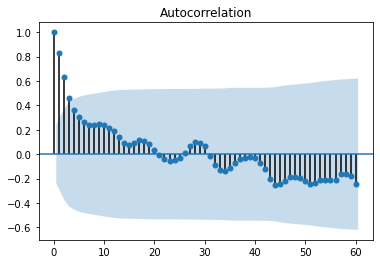

In [32]:
import pandas as pd
import numpy as np
import matplotlib
import matplotlib.pyplot as plt
from statsmodels.graphics.tsaplots import plot_pacf
from statsmodels.graphics.tsaplots import plot_acf
from scipy.stats import linregress
import statistics 
plot_acf(bond_spread_list[0][2].GSpread.values, lags=60)
plt.show()

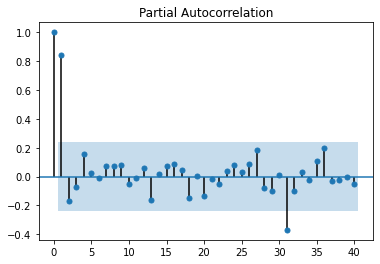

In [33]:
plot_pacf(bond_spread_list[0][2].GSpread.values, lags=40)
plt.show()

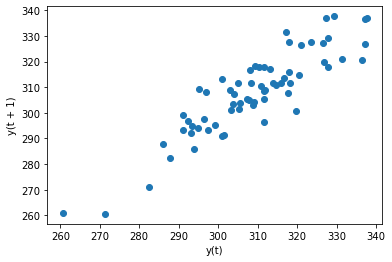

In [34]:
from pandas import read_csv
from matplotlib import pyplot
from pandas.plotting import lag_plot
series = bond_spread_list[0][2].GSpread
lag_plot(series)
pyplot.show()

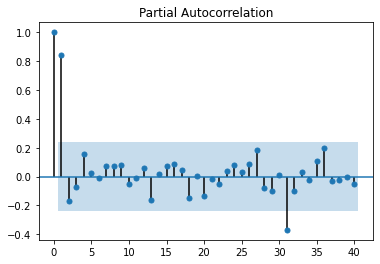

In [35]:
plot_pacf(bond_spread_list[0][2].GSpread.values, lags=40)
plt.show()

In [36]:
from statsmodels.tsa.seasonal import seasonal_decompose
from matplotlib import pyplot
import statistics 

from scipy import stats
def get_trend_seasonal(x):
    try:
        xt, _ = stats.boxcox(x[2].GSpread.values)
        result = seasonal_decompose(xt,model='additive', freq=2)
        xt = result.resid + result.seasonal
        zt = result.resid + result.trend
        yt = result.resid
        yt[1:-1]
        m_seasonal = 1- np.var(yt[1:-1])/np.var(xt[1:-1])
        m_trend = 1- np.var(yt[1:-1])/np.var(zt[1:-1])
        return m_trend,m_seasonal
    except:
        print(x)

In [33]:
get_trend_seasonal(bond_spread_list[10000])

/Library/Frameworks/Python.framework/Versions/3.6/lib/python3.6/site-packages/ipykernel_launcher.py:9: FutureWarning: the 'freq'' keyword is deprecated, use 'period' instead
  if __name__ == '__main__':


(0.8788768748606955, 0.11663141453015824)

In [98]:
trend_seasonal = pd.DataFrame(columns=['SecurityID', 'm_trend','m_seasonal'])

In [99]:
for i in bond_spread_list:
    try:
        security = i[1]
        m_trend,m_seasonal = get_trend_seasonal(i)
        temp_dict= {'SecurityID':security,'m_trend':m_trend,'m_seasonal':m_seasonal}
        temp_df = pd.DataFrame([temp_dict])
        trend_seasonal = trend_seasonal.append(temp_df)
    except:
        pass

(67, 402,        SecurityID    KeyDate    Price  YieldWorst  ModifiedDuration_Plain  \
22541         402 2019-01-09  100.894     3.41804                1.209780   
22542         402 2019-01-10  100.912     3.38165                1.201910   
22543         402 2019-01-11  100.960     3.31236                1.199500   
22544         402 2019-01-14  100.900     3.38836                1.196550   
22545         402 2019-01-15  100.935     3.33645                1.194080   
...           ...        ...      ...         ...                     ...   
22603         402 2019-04-09  101.009     2.62495                0.971723   
22604         402 2019-04-10  101.043     2.54568                0.969244   
22605         402 2019-04-11  100.981     2.63775                0.971186   
22606         402 2019-04-12  101.022     2.54393                0.968736   
22607         402 2019-04-15  101.115     2.34403                0.966542   

           WorkoutDate  AmtOutstanding  GSpread  OAS_Spread   ZSp

(67, 3126,         SecurityID    KeyDate    Price  YieldWorst  ModifiedDuration_Plain  \
155057        3126 2019-01-09  125.168     5.73847                 17.0462   
155058        3126 2019-01-10  123.762     5.80497                 16.8729   
155059        3126 2019-01-11  116.344     6.18120                 15.9705   
155060        3126 2019-01-14  120.834     5.94816                 16.5387   
155061        3126 2019-01-15  119.850     5.99777                 16.4148   
...            ...        ...      ...         ...                     ...   
155119        3126 2019-04-09  124.696     5.75987                 17.0031   
155120        3126 2019-04-10  124.811     5.75445                 17.0170   
155121        3126 2019-04-11  127.727     5.62030                 17.3731   
155122        3126 2019-04-12  127.709     5.62113                 17.3706   
155123        3126 2019-04-15  127.969     5.60941                 17.4021   

            WorkoutDate  AmtOutstanding  GSpread  OA

(67, 4825,         SecurityID    KeyDate     Price  YieldWorst  ModifiedDuration_Plain  \
318761        4825 2019-01-09  100.0210   -0.918386                 1.78019   
318762        4825 2019-01-10  100.1110  -30.705800                 1.77289   
318763        4825 2019-01-11  100.2230  -61.262000                 1.77089   
318764        4825 2019-01-14   99.4683    6.796570                 1.76428   
318765        4825 2019-01-15  100.2690  -72.221500                 1.76595   
...            ...        ...       ...         ...                     ...   
318823        4825 2019-04-09  100.4500 -106.477000                 1.54894   
318824        4825 2019-04-10  100.4290 -102.963000                 1.54624   
318825        4825 2019-04-11  100.4410 -104.904000                 1.53851   
318826        4825 2019-04-12  100.4550 -107.140000                 1.53599   
318827        4825 2019-04-15  100.4480 -106.088000                 1.53336   

            WorkoutDate  AmtOutstanding 

(67, 6425,         SecurityID    KeyDate    Price  YieldWorst  ModifiedDuration_Plain  \
454949        6425 2019-01-09  98.6616     2.82542                1.049210   
454950        6425 2019-01-10  98.7631     2.73704                1.041510   
454951        6425 2019-01-11  98.7958     2.70840                1.038940   
454952        6425 2019-01-14  98.8103     2.69732                1.036280   
454953        6425 2019-01-15  98.7898     2.72034                1.033440   
...            ...        ...      ...         ...                     ...   
455011        6425 2019-04-09  99.1590     2.58907                0.809272   
455012        6425 2019-04-10  99.1612     2.58980                0.806548   
455013        6425 2019-04-11  99.1546     2.60875                0.798311   
455014        6425 2019-04-12  99.1588     2.60698                0.795597   
455015        6425 2019-04-15  99.1437     2.62988                0.792787   

            WorkoutDate  AmtOutstanding  GSpread  OA

(67, 6997,         SecurityID    KeyDate     Price  YieldWorst  ModifiedDuration_Plain  \
514236        6997 2019-01-09   99.0250     6.37684                 3.79440   
514237        6997 2019-01-10   99.1355     6.34868                 3.78768   
514238        6997 2019-01-11   99.3750     6.28662                 3.87687   
514239        6997 2019-01-14   99.2740     6.31288                 3.87352   
514240        6997 2019-01-15   99.2640     6.31552                 3.87088   
...            ...        ...       ...         ...                     ...   
514298        6997 2019-04-09  101.9900     4.24207                 3.67652   
514299        6997 2019-04-10  101.9890     4.22623                 3.67395   
514300        6997 2019-04-11  101.9550     4.30290                 3.66600   
514301        6997 2019-04-12  101.9710     4.21840                 3.66356   
514302        6997 2019-04-15  101.9760     4.18022                 3.66103   

            WorkoutDate  AmtOutstanding 

(67, 9345,         SecurityID    KeyDate    Price  YieldWorst  ModifiedDuration_Plain  \
693342        9345 2019-01-09  98.7351     2.77185                 1.30336   
693343        9345 2019-01-10  98.7359     2.77725                 1.29518   
693344        9345 2019-01-11  98.7790     2.74551                 1.29267   
693345        9345 2019-01-14  98.7968     2.73359                 1.29004   
693346        9345 2019-01-15  98.7776     2.75056                 1.28721   
...            ...        ...      ...         ...                     ...   
693404        9345 2019-04-09  99.1362     2.61309                 1.05988   
693405        9345 2019-04-10  99.2048     2.55006                 1.05750   
693406        9345 2019-04-11  99.1770     2.58247                 1.04917   
693407        9345 2019-04-12  99.1658     2.59531                 1.04639   
693408        9345 2019-04-15  99.2758     2.49163                 1.04421   

            WorkoutDate  AmtOutstanding  GSpread  OA

(67, 11667,         SecurityID    KeyDate    Price  YieldWorst  ModifiedDuration_Plain  \
794618       11667 2019-01-09  100.379     5.01243                 3.30542   
794619       11667 2019-01-10  100.347     5.03090                 3.29738   
794620       11667 2019-01-11  100.402     4.99695                 3.29515   
794621       11667 2019-01-14  100.280     5.07147                 3.29172   
794622       11667 2019-01-15  100.404     4.99470                 3.28995   
...            ...        ...      ...         ...                     ...   
794680       11667 2019-04-09  101.729     3.36962                 3.14181   
794681       11667 2019-04-10  101.750     3.31308                 3.13933   
794682       11667 2019-04-11  101.779    -5.13918                 3.13168   
794683       11667 2019-04-12  101.600     3.59491                 3.12794   
794684       11667 2019-04-15  101.608     3.56734                 3.12538   

            WorkoutDate  AmtOutstanding  GSpread  O

(67, 12095,         SecurityID    KeyDate    Price  YieldWorst  ModifiedDuration_Plain  \
860563       12095 2019-01-09  104.081     5.57060                 17.8087   
860564       12095 2019-01-10  107.540     5.38999                 18.3624   
860565       12095 2019-01-11  104.442     5.55126                 17.8663   
860566       12095 2019-01-14  104.018     5.57406                 17.7979   
860567       12095 2019-01-15  103.563     5.59868                 17.7245   
...            ...        ...      ...         ...                     ...   
860625       12095 2019-04-09  121.510     4.76166                 20.5487   
860626       12095 2019-04-10  121.812     4.74957                 20.5944   
860627       12095 2019-04-11  123.377     4.68792                 20.8304   
860628       12095 2019-04-12  122.782     4.71118                 20.7403   
860629       12095 2019-04-15  122.832     4.70921                 20.7476   

            WorkoutDate  AmtOutstanding  GSpread  O

(67, 12255,         SecurityID    KeyDate     Price  YieldWorst  ModifiedDuration_Plain  \
885501       12255 2019-01-09   99.0000     7.51973                 1.87627   
885502       12255 2019-01-10   98.4814     7.79777                 1.86560   
885503       12255 2019-01-11   98.0370     8.03698                 1.86048   
885504       12255 2019-01-14   98.2177     7.94131                 1.85895   
885505       12255 2019-01-15   97.9688     8.07663                 1.85495   
...            ...        ...       ...         ...                     ...   
885563       12255 2019-04-09  101.8130   -14.51260                 1.70170   
885564       12255 2019-04-10  101.6880     4.91703                 1.69847   
885565       12255 2019-04-11  101.6850     4.90024                 1.69071   
885566       12255 2019-04-12  101.7500     4.81375                 1.68847   
885567       12255 2019-04-15  101.7760    -2.23546                 1.68602   

            WorkoutDate  AmtOutstanding

(67, 13247,         SecurityID    KeyDate    Price  YieldWorst  ModifiedDuration_Plain  \
970889       13247 2019-01-09  99.1031     2.70584                1.045560   
970890       13247 2019-01-10  99.1010     2.71458                1.037370   
970891       13247 2019-01-11  99.1203     2.69807                1.034740   
970892       13247 2019-01-14  99.1157     2.70484                1.031990   
970893       13247 2019-01-15  99.1519     2.67179                1.029450   
...            ...        ...      ...         ...                     ...   
970951       13247 2019-04-09  99.5473     2.40963                0.806809   
970952       13247 2019-04-10  99.4796     2.49601                0.803746   
970953       13247 2019-04-11  99.4719     2.51235                0.795527   
970954       13247 2019-04-12  99.4091     2.59412                0.792489   
970955       13247 2019-04-15  99.4128     2.59207                0.789780   

            WorkoutDate  AmtOutstanding  GSpread  O

(3, 13414,          SecurityID    KeyDate    Price  YieldWorst  ModifiedDuration_Plain  \
1003503       13414 2019-01-28  88.4642     7.51861                 10.1568   
1003546       13414 2019-03-29  92.0116     6.99304                 10.0172   
1003548       13414 2019-04-02  92.3621     6.96766                 10.0142   

             WorkoutDate  AmtOutstanding  GSpread  OAS_Spread  ZSpread  \
1003503  06/19/2032 0:00    1.000000e+09   468.43     456.190  469.397   
1003546  06/19/2032 0:00    1.000000e+09   450.21     438.930  451.541   
1003548  06/19/2032 0:00    1.000000e+09   440.37     429.781  443.682   

          AswUsd Currency  IssueDate MaturityDate  Spread_G_Z  avg_GSpread  
1003503  431.077      USD 2017-06-19   2032-06-19      -0.967   473.238571  
1003546  423.275      USD 2017-06-19   2032-06-19      -1.331   468.837143  
1003548  417.145      USD 2017-06-19   2032-06-19      -3.312   463.790000  )
(67, 14897,          SecurityID    KeyDate     Price  YieldWorst  

(67, 15489,          SecurityID    KeyDate    Price  YieldWorst  ModifiedDuration_Plain  \
1211296       15489 2019-01-09  98.6151     2.77689                 1.78601   
1211297       15489 2019-01-10  98.7621     2.69679                 1.77860   
1211298       15489 2019-01-11  98.8016     2.67534                 1.77609   
1211299       15489 2019-01-14  98.7939     2.68072                 1.77333   
1211300       15489 2019-01-15  98.8226     2.66537                 1.77075   
...             ...        ...      ...         ...                     ...   
1211358       15489 2019-04-09  99.1659     2.53837                 1.54388   
1211359       15489 2019-04-10  99.2056     2.51343                 1.54137   
1211360       15489 2019-04-11  99.1208     2.57165                 1.53277   
1211361       15489 2019-04-12  99.1107     2.57927                 1.52999   
1211362       15489 2019-04-15  99.1006     2.58695                 1.52722   

                 WorkoutDate  AmtOutsta

(67, 17354,          SecurityID    KeyDate    Price  YieldWorst  ModifiedDuration_Plain  \
1447995       17354 2019-01-09  101.615     5.02452                 3.29942   
1447996       17354 2019-01-10  101.563     5.05156                 3.29132   
1447997       17354 2019-01-11  101.514     5.07902                 3.28840   
1447998       17354 2019-01-14  101.866     4.86785                 3.28825   
1447999       17354 2019-01-15  101.934     4.82544                 3.28614   
...             ...        ...      ...         ...                     ...   
1448057       17354 2019-04-09  103.499  -111.70100                 3.08013   
1448058       17354 2019-04-10  103.500  -111.83800                 3.07756   
1448059       17354 2019-04-11  103.317   -81.48870                 3.13647   
1448060       17354 2019-04-12  103.211   -57.43550                 3.13321   
1448061       17354 2019-04-15  103.197   -53.87670                 3.13053   

                 WorkoutDate  AmtOutsta

(67, 18002,          SecurityID    KeyDate    Price  YieldWorst  ModifiedDuration_Plain  \
1488729       18002 2019-01-09  100.959     3.06506                 2.85139   
1488730       18002 2019-01-10  100.972     3.05980                 2.84344   
1488731       18002 2019-01-11  101.062     3.02870                 2.84129   
1488732       18002 2019-01-14  101.099     3.01564                 2.83883   
1488733       18002 2019-01-15  101.130     3.00469                 2.83634   
...             ...        ...      ...         ...                     ...   
1488791       18002 2019-04-09  102.438     2.49050                 2.65550   
1488792       18002 2019-04-10  102.535     2.45413                 2.65336   
1488793       18002 2019-04-11  102.422     2.49278                 2.64470   
1488794       18002 2019-04-12  102.315     2.53122                 2.64144   
1488795       18002 2019-04-15  102.336     2.52283                 2.63887   

                 WorkoutDate  AmtOutsta

(67, 19810,          SecurityID    KeyDate    Price  YieldWorst  ModifiedDuration_Plain  \
1682417       19810 2019-01-09  101.468     4.58721                 2.71941   
1682418       19810 2019-01-10  101.314     4.66589                 2.71066   
1682419       19810 2019-01-11  101.375     4.63227                 2.70840   
1682420       19810 2019-01-14  101.089     4.78449                 2.70410   
1682421       19810 2019-01-15  101.365     4.63570                 2.70311   
...             ...        ...      ...         ...                     ...   
1682479       19810 2019-04-09  102.558     3.59982                 2.49025   
1682480       19810 2019-04-10  102.596     3.54086                 2.48785   
1682481       19810 2019-04-11  102.670     3.41712                 2.48043   
1682482       19810 2019-04-12  102.707    -1.45718                 2.47803   
1682483       19810 2019-04-15  102.609     3.48954                 2.47484   

                 WorkoutDate  AmtOutsta

(67, 22471,          SecurityID    KeyDate    Price  YieldWorst  ModifiedDuration_Plain  \
2007326       22471 2019-01-09  102.591     4.87202                 3.91308   
2007327       22471 2019-01-10  102.651     4.75627                 3.90589   
2007328       22471 2019-01-11  102.548     4.91921                 3.90251   
2007329       22471 2019-01-14  102.460     4.97024                 3.89924   
2007330       22471 2019-01-15  102.795     4.49226                 3.89938   
...             ...        ...      ...         ...                     ...   
2007388       22471 2019-04-09  102.758     3.67495                 3.77012   
2007389       22471 2019-04-10  102.900     3.24947                 3.76860   
2007390       22471 2019-04-11  102.861     3.30003                 3.76060   
2007391       22471 2019-04-12  103.012     1.73776                 3.75916   
2007392       22471 2019-04-15  102.953     2.98122                 3.75615   

                 WorkoutDate  AmtOutsta

(53, 26508,          SecurityID    KeyDate    Price  YieldWorst  ModifiedDuration_Plain  \
2166358       26508 2019-01-09  106.688     6.27637                 3.50553   
2166359       26508 2019-01-10  107.086     5.46357                 3.50192   
2166360       26508 2019-01-11  107.170     5.28106                 3.61586   
2166361       26508 2019-01-14  107.255     5.09392                 3.61416   
2166362       26508 2019-01-15  107.430     4.73246                 3.61320   
2166363       26508 2019-01-16  107.740   -59.61610                 3.61336   
2166364       26508 2019-01-17  107.125     5.20021                 3.59865   
2166365       26508 2019-01-18  107.250     4.92552                 3.59728   
2166366       26508 2019-01-22  107.250     4.89894                 3.59488   
2166367       26508 2019-01-23  107.188     4.99821                 3.59196   
2166368       26508 2019-01-24  107.875   -87.83760                 3.59041   
2166369       26508 2019-01-25  107.875 

(67, 28968,          SecurityID    KeyDate     Price  YieldWorst  ModifiedDuration_Plain  \
2288374       28968 2019-01-09  100.0620     6.03182                 1.89435   
2288375       28968 2019-01-10  100.0620     5.97338                 1.88661   
2288376       28968 2019-01-11   99.9417     6.77612                 1.88335   
2288377       28968 2019-01-14  100.0620     5.92835                 1.88144   
2288378       28968 2019-01-15  100.0420     6.15403                 1.87875   
...             ...        ...       ...         ...                     ...   
2288436       28968 2019-04-09  100.2660   -71.10290                 1.70377   
2288437       28968 2019-04-10  100.1410   -39.00830                 1.70052   
2288438       28968 2019-04-11  100.2500   -67.43250                 1.69334   
2288439       28968 2019-04-12  100.2140   -58.55240                 1.69056   
2288440       28968 2019-04-15  100.1260   -34.60250                 1.68751   

                 WorkoutDat

(67, 30725,          SecurityID    KeyDate    Price  YieldWorst  ModifiedDuration_Plain  \
2410307       30725 2019-01-09  100.390    -97.3343                 1.79008   
2410308       30725 2019-01-10  100.388    -96.8968                 1.78227   
2410309       30725 2019-01-11  100.433   -104.8950                 1.77991   
2410310       30725 2019-01-14  100.334    -86.5185                 1.77678   
2410311       30725 2019-01-15  100.357    -91.0142                 1.77430   
...             ...        ...      ...         ...                     ...   
2410369       30725 2019-04-09  100.620   -130.7340                 1.55712   
2410370       30725 2019-04-10  100.501   -114.5450                 1.55389   
2410371       30725 2019-04-11  100.777   -147.3490                 1.54753   
2410372       30725 2019-04-12  100.553   -122.0720                 1.54375   
2410373       30725 2019-04-15  100.438   -104.4860                 1.54055   

                 WorkoutDate  AmtOutsta

(67, 32177,          SecurityID    KeyDate    Price  YieldWorst  ModifiedDuration_Plain  \
2470735       32177 2019-01-09  102.003     6.41107                0.856163   
2470736       32177 2019-01-10  102.001     6.39202                0.848516   
2470737       32177 2019-01-11  102.000     6.38628                0.845964   
2470738       32177 2019-01-14  102.031     6.34278                0.843569   
2470739       32177 2019-01-15  102.095     6.26079                0.841331   
...             ...        ...      ...         ...                     ...   
2470797       32177 2019-04-09  101.948     5.63595                0.626673   
2470798       32177 2019-04-10  101.979     5.57447                0.624274   
2470799       32177 2019-04-11  101.973     5.54500                0.616603   
2470800       32177 2019-04-12  101.978     5.52392                0.614079   
2470801       32177 2019-04-15  101.948     5.55787                0.611391   

                 WorkoutDate  AmtOutsta

(67, 32511,          SecurityID    KeyDate    Price  YieldWorst  ModifiedDuration_Plain  \
2511806       32511 2019-01-09  102.306     5.93422                 2.56282   
2511807       32511 2019-01-10  102.533     5.80118                 2.55653   
2511808       32511 2019-01-11  102.184     5.99561                 2.55186   
2511809       32511 2019-01-14  102.331     5.91105                 2.55019   
2511810       32511 2019-01-15  102.457     5.83801                 2.54840   
...             ...        ...      ...         ...                     ...   
2511868       32511 2019-04-09  103.265     4.80390                 2.33842   
2511869       32511 2019-04-10  103.266     4.79218                 2.33587   
2511870       32511 2019-04-11  103.242     4.80068                 2.32806   
2511871       32511 2019-04-12  103.340     4.63534                 2.32608   
2511872       32511 2019-04-15  103.368     4.57933                 2.32369   

                 WorkoutDate  AmtOutsta

(67, 33290,          SecurityID    KeyDate    Price  YieldWorst  ModifiedDuration_Plain  \
2681614       33290 2019-01-09  101.870     4.85155                 3.25637   
2681615       33290 2019-01-10  102.002     4.65140                 3.24956   
2681616       33290 2019-01-11  101.952     4.71760                 3.24663   
2681617       33290 2019-01-14  101.731     5.02737                 3.24253   
2681618       33290 2019-01-15  101.827     4.88626                 3.24062   
...             ...        ...      ...         ...                     ...   
2681676       33290 2019-04-09  102.140   -26.65480                 3.09588   
2681677       33290 2019-04-10  102.132   -24.23220                 3.09324   
2681678       33290 2019-04-11  102.238   -53.86500                 3.08617   
2681679       33290 2019-04-12  102.253   -57.72570                 3.08368   
2681680       33290 2019-04-15  102.202   -44.32860                 3.08077   

                 WorkoutDate  AmtOutsta

(67, 33818,          SecurityID    KeyDate    Price  YieldWorst  ModifiedDuration_Plain  \
2781314       33818 2019-01-09  98.0325     2.36961                 23.5313   
2781315       33818 2019-01-10  98.0592     2.36848                 23.5261   
2781316       33818 2019-01-11  97.9715     2.37226                 23.5179   
2781317       33818 2019-01-14  97.9865     2.37162                 23.5166   
2781318       33818 2019-01-15  97.9867     2.37162                 23.5143   
...             ...        ...      ...         ...                     ...   
2781376       33818 2019-04-09  98.4613     2.35149                 23.5453   
2781377       33818 2019-04-10  98.4857     2.35044                 23.5445   
2781378       33818 2019-04-11  98.4503     2.35197                 23.5352   
2781379       33818 2019-04-12  98.4050     2.35393                 23.5299   
2781380       33818 2019-04-15  98.4189     2.35333                 23.5285   

                 WorkoutDate  AmtOutsta

(47, 34365,          SecurityID    KeyDate     Price  YieldWorst  ModifiedDuration_Plain  \
2870838       34365 2019-02-07   97.4265     8.28920                 3.25725   
2870839       34365 2019-02-08   97.0541     8.40619                 3.25252   
2870840       34365 2019-02-11   96.9886     8.42733                 3.24953   
2870841       34365 2019-02-12   96.9915     8.42702                 3.24694   
2870842       34365 2019-02-13   96.6795     8.52586                 3.24254   
2870843       34365 2019-02-14   96.4314     8.60714                 3.23067   
2870844       34365 2019-02-15   96.2889     8.65314                 3.22724   
2870845       34365 2019-02-19   96.6719     8.53235                 3.22683   
2870846       34365 2019-02-20   96.4878     8.59142                 3.22317   
2870847       34365 2019-02-21   97.3750     8.31286                 3.22041   
2870848       34365 2019-02-22   97.2500     8.35283                 3.21709   
2870849       34365 2019-02-

(67, 34591,          SecurityID    KeyDate    Price  YieldWorst  ModifiedDuration_Plain  \
2901468       34591 2019-01-09  100.595     5.78492                 4.26028   
2901469       34591 2019-01-10  100.754     5.72789                 4.25407   
2901470       34591 2019-01-11  100.725     5.73803                 4.25126   
2901471       34591 2019-01-14  100.757     5.72628                 4.24901   
2901472       34591 2019-01-15  100.757     5.72609                 4.24647   
...             ...        ...      ...         ...                     ...   
2901530       34591 2019-04-09  103.982     4.49041                 4.15447   
2901531       34591 2019-04-10  104.000     4.48241                 4.15206   
2901532       34591 2019-04-11  104.125     4.42305                 4.14538   
2901533       34591 2019-04-12  104.576   -19.24450                 4.14640   
2901534       34591 2019-04-15  104.375     4.15952                 4.14225   

                 WorkoutDate  AmtOutsta

(47, 35696,          SecurityID    KeyDate    Price  YieldWorst  ModifiedDuration_Plain  \
3036418       35696 2019-02-07  109.573    1.796860                 4.26441   
3036419       35696 2019-02-08  109.743    1.692730                 4.26471   
3036420       35696 2019-02-11  109.743    1.706770                 4.25979   
3036421       35696 2019-02-12  109.741    1.715080                 4.25582   
3036422       35696 2019-02-13  109.579    1.818560                 4.24909   
3036423       35696 2019-02-14  110.059    1.532930                 4.24560   
3036424       35696 2019-02-15  109.565    1.779090                 4.23821   
3036425       35696 2019-02-19  109.798    1.630730                 4.29401   
3036426       35696 2019-02-20  109.763    1.635240                 4.29150   
3036427       35696 2019-02-21  109.763    1.627960                 4.28192   
3036428       35696 2019-02-22  109.756    1.598920                 4.28237   
3036429       35696 2019-02-25  110.040 

(67, 36476,          SecurityID    KeyDate    Price  YieldWorst  ModifiedDuration_Plain  \
3082847       36476 2019-01-09  98.2476     2.71853                 18.7750   
3082848       36476 2019-01-10  98.1533     2.72364                 18.7633   
3082849       36476 2019-01-11  98.2587     2.71795                 18.7659   
3082850       36476 2019-01-14  98.3078     2.71531                 18.7658   
3082851       36476 2019-01-15  98.3069     2.71536                 18.7634   
...             ...        ...      ...         ...                     ...   
3082909       36476 2019-04-09  98.9702     2.68008                 18.5932   
3082910       36476 2019-04-10  98.9785     2.67964                 18.5911   
3082911       36476 2019-04-11  98.9940     2.67883                 18.5847   
3082912       36476 2019-04-12  98.9627     2.68052                 18.5808   
3082913       36476 2019-04-15  98.9582     2.68077                 18.5782   

                 WorkoutDate  AmtOutsta

(67, 39465,          SecurityID    KeyDate    Price  YieldWorst  ModifiedDuration_Plain  \
3198654       39465 2019-01-09  107.770     5.23587                 18.6769   
3198655       39465 2019-01-10  107.121     5.26826                 18.5764   
3198656       39465 2019-01-11  107.469     5.25083                 18.6296   
3198657       39465 2019-01-14  106.955     5.27660                 18.5502   
3198658       39465 2019-01-15  106.643     5.29233                 18.5020   
...             ...        ...      ...         ...                     ...   
3198716       39465 2019-04-09  115.157     4.89155                 19.8100   
3198717       39465 2019-04-10  115.950     4.85701                 19.9270   
3198718       39465 2019-04-11  115.623     4.87117                 19.8776   
3198719       39465 2019-04-12  114.730     4.91029                 19.7448   
3198720       39465 2019-04-15  115.010     4.89794                 19.7860   

                 WorkoutDate  AmtOutsta

(67, 40207,          SecurityID    KeyDate    Price  YieldWorst  ModifiedDuration_Plain  \
3333043       40207 2019-01-09  131.776     5.19208                 18.6066   
3333044       40207 2019-01-10  131.448     5.20544                 18.5655   
3333045       40207 2019-01-11  131.031     5.22258                 18.5139   
3333046       40207 2019-01-14  132.085     5.17947                 18.6427   
3333047       40207 2019-01-15  129.711     5.27744                 18.3509   
...             ...        ...      ...         ...                     ...   
3333105       40207 2019-04-09  135.069     5.06049                 18.9707   
3333106       40207 2019-04-10  135.338     5.05004                 19.0024   
3333107       40207 2019-04-11  134.635     5.07745                 18.9170   
3333108       40207 2019-04-12  133.752     5.11224                 18.8105   
3333109       40207 2019-04-15  133.977     5.10335                 18.8371   

                 WorkoutDate  AmtOutsta

(67, 40473,          SecurityID    KeyDate     Price  YieldWorst  ModifiedDuration_Plain  \
3396933       40473 2019-01-09   94.6964     6.33680                 15.7521   
3396934       40473 2019-01-10   95.0472     6.31342                 15.8085   
3396935       40473 2019-01-11   95.0874     6.31076                 15.8150   
3396936       40473 2019-01-14   94.7496     6.33332                 15.7604   
3396937       40473 2019-01-15   93.3261     6.43011                 15.5304   
...             ...        ...       ...         ...                     ...   
3396995       40473 2019-04-09  103.7270     5.78291                 17.1992   
3396996       40473 2019-04-10  103.9590     5.76992                 17.2359   
3396997       40473 2019-04-11  103.4850     5.79648                 17.1606   
3396998       40473 2019-04-12  102.8780     5.83086                 17.0642   
3396999       40473 2019-04-15  104.3900     5.74596                 17.3039   

                 WorkoutDat

(67, 42015,          SecurityID    KeyDate    Price  YieldWorst  ModifiedDuration_Plain  \
3551128       42015 2019-01-09  102.017     5.59738                 3.79754   
3551129       42015 2019-01-10  102.000     5.60187                 3.78977   
3551130       42015 2019-01-11  102.151     5.53395                 3.78838   
3551131       42015 2019-01-14  102.023     5.58948                 3.78485   
3551132       42015 2019-01-15  101.787     5.69325                 3.78049   
...             ...        ...      ...         ...                     ...   
3551190       42015 2019-04-09  103.566     4.50343                 3.57989   
3551191       42015 2019-04-10  104.000     2.09382                 3.58059   
3551192       42015 2019-04-11  103.917     2.36591                 3.57232   
3551193       42015 2019-04-12  103.588     4.22803                 3.56730   
3551194       42015 2019-04-15  103.621     3.99007                 3.56501   

                 WorkoutDate  AmtOutsta

(67, 42290,          SecurityID    KeyDate    Price  YieldWorst  ModifiedDuration_Plain  \
3601811       42290 2019-01-09  100.677     6.20544                 3.24925   
3601812       42290 2019-01-10  100.350     6.40274                 3.23924   
3601813       42290 2019-01-11  100.522     6.29732                 3.23792   
3601814       42290 2019-01-14  100.436     6.34978                 3.23474   
3601815       42290 2019-01-15  100.610     6.24264                 3.23344   
...             ...        ...      ...         ...                     ...   
3601873       42290 2019-04-09  102.428   -58.28490                 3.03157   
3601874       42290 2019-04-10  102.318   -28.83930                 3.02824   
3601875       42290 2019-04-11  102.331   -33.69880                 3.09415   
3601876       42290 2019-04-12  102.415   -56.56570                 3.09213   
3601877       42290 2019-04-15  102.396   -51.52680                 3.08943   

                 WorkoutDate  AmtOutsta

(67, 43052,          SecurityID    KeyDate    Price  YieldWorst  ModifiedDuration_Plain  \
3672491       43052 2019-01-09  104.023     5.65362                 4.51369   
3672492       43052 2019-01-10  103.973     5.68195                 4.50574   
3672493       43052 2019-01-11  103.781     5.77626                 4.50148   
3672494       43052 2019-01-14  103.836     5.75135                 4.49948   
3672495       43052 2019-01-15  103.741     5.78852                 4.49611   
...             ...        ...      ...         ...                     ...   
3672553       43052 2019-04-09  104.412     2.73465                 4.29231   
3672554       43052 2019-04-10  104.333     3.02555                 4.28910   
3672555       43052 2019-04-11  104.394     2.60942                 4.28215   
3672556       43052 2019-04-12  104.324     2.87353                 4.27902   
3672557       43052 2019-04-15  104.055     4.07730                 4.27407   

                 WorkoutDate  AmtOutsta

(67, 44148,          SecurityID    KeyDate    Price  YieldWorst  ModifiedDuration_Plain  \
3767670       44148 2019-01-09  101.458     7.99709                 2.68125   
3767671       44148 2019-01-10  101.688     7.87891                 2.67534   
3767672       44148 2019-01-11  101.791     7.82590                 2.67355   
3767673       44148 2019-01-14  101.708     7.86654                 2.67049   
3767674       44148 2019-01-15  101.689     7.87525                 2.66787   
...             ...        ...      ...         ...                     ...   
3767732       44148 2019-04-09  103.939     6.53751                 2.54909   
3767733       44148 2019-04-10  103.947     6.52968                 2.54663   
3767734       44148 2019-04-11  104.446   -15.41800                 2.54218   
3767735       44148 2019-04-12  104.290     6.20236                 2.53871   
3767736       44148 2019-04-15  104.375     6.10141                 2.53673   

                 WorkoutDate  AmtOutsta

(67, 46425,          SecurityID    KeyDate    Price  YieldWorst  ModifiedDuration_Plain  \
3930726       46425 2019-01-09  104.250     7.53483                 3.16831   
3930727       46425 2019-01-10  104.351     7.46748                 3.16180   
3930728       46425 2019-01-11  104.387     7.44360                 3.15965   
3930729       46425 2019-01-14  104.152     7.57311                 3.15542   
3930730       46425 2019-01-15  104.100     7.59903                 3.15260   
...             ...        ...      ...         ...                     ...   
3930788       46425 2019-04-09  105.389   -89.91830                 2.95833   
3930789       46425 2019-04-10  105.433   -97.73750                 2.95624   
3930790       46425 2019-04-11  105.425   -96.24380                 2.94888   
3930791       46425 2019-04-12  105.625  -125.35300                 2.94794   
3930792       46425 2019-04-15  105.599  -122.01500                 2.94531   

                 WorkoutDate  AmtOutsta

(67, 46887,          SecurityID    KeyDate    Price  YieldWorst  ModifiedDuration_Plain  \
4012196       46887 2019-01-09  104.400     3.52225                 4.06579   
4012197       46887 2019-01-10  104.000     5.92897                 4.05465   
4012198       46887 2019-01-11  103.996     5.92880                 4.05216   
4012199       46887 2019-01-14  103.875     5.98725                 4.04856   
4012200       46887 2019-01-15  103.875     5.98490                 4.04611   
...             ...        ...      ...         ...                     ...   
4012258       46887 2019-04-09  104.250   -64.46210                 3.95543   
4012259       46887 2019-04-10  104.260   -66.74360                 3.95305   
4012260       46887 2019-04-11  104.125   -32.19420                 3.94446   
4012261       46887 2019-04-12  104.250   -64.40660                 3.94308   
4012262       46887 2019-04-15  104.250   -64.39550                 3.94061   

                 WorkoutDate  AmtOutsta

(67, 47488,          SecurityID    KeyDate    Price  YieldWorst  ModifiedDuration_Plain  \
4097604       47488 2019-01-09  101.820     5.05374                 3.81529   
4097605       47488 2019-01-10  101.723     5.09418                 3.80684   
4097606       47488 2019-01-11  101.769     5.07299                 3.80461   
4097607       47488 2019-01-14  101.824     5.04710                 3.80245   
4097608       47488 2019-01-15  101.787     5.06307                 3.79960   
...             ...        ...      ...         ...                     ...   
4097666       47488 2019-04-09  102.076     4.82012                 3.58555   
4097667       47488 2019-04-10  102.024     4.86235                 3.58259   
4097668       47488 2019-04-11  102.042     4.84184                 3.57500   
4097669       47488 2019-04-12  102.065     4.81847                 3.57260   
4097670       47488 2019-04-15  101.930     4.90321                 3.56902   

                 WorkoutDate  AmtOutsta

(67, 48167,          SecurityID    KeyDate     Price  YieldWorst  ModifiedDuration_Plain  \
4149149       48167 2019-01-09  101.4400     4.62538                 21.3028   
4149150       48167 2019-01-10   99.4058     4.72133                 20.9134   
4149151       48167 2019-01-11   99.7690     4.70392                 20.9829   
4149152       48167 2019-01-14   99.2319     4.72970                 20.8796   
4149153       48167 2019-01-15   98.9091     4.74531                 20.8173   
...             ...        ...       ...         ...                     ...   
4149211       48167 2019-04-09  104.1590     4.50247                 21.7930   
4149212       48167 2019-04-10  102.8260     4.56182                 21.5432   
4149213       48167 2019-04-11  102.0670     4.59629                 21.3995   
4149214       48167 2019-04-12  102.7710     4.56429                 21.5318   
4149215       48167 2019-04-15  101.5400     4.62051                 21.2995   

                 WorkoutDat

[67 rows x 16 columns])
(67, 48426,          SecurityID    KeyDate     Price  YieldWorst  ModifiedDuration_Plain  \
4204409       48426 2019-01-09   99.1250     6.76074                 3.28771   
4204410       48426 2019-01-10   99.1033     6.76778                 3.27988   
4204411       48426 2019-01-11   99.0150     6.79487                 3.27668   
4204412       48426 2019-01-14   99.0681     6.77885                 3.27451   
4204413       48426 2019-01-15   99.3782     6.68452                 3.27419   
...             ...        ...       ...         ...                     ...   
4204471       48426 2019-04-09  101.1370     5.72256                 3.07168   
4204472       48426 2019-04-10  101.1260     5.72899                 3.06904   
4204473       48426 2019-04-11  101.2920     5.61272                 3.06253   
4204474       48426 2019-04-12  101.3770     5.55353                 3.06057   
4204475       48426 2019-04-15  101.4830     5.47954                 3.05876   

   

(67, 48655,          SecurityID    KeyDate    Price  YieldWorst  ModifiedDuration_Plain  \
4235517       48655 2019-01-09  100.961     5.52101                 2.82119   
4235518       48655 2019-01-10  101.000     5.50018                 2.81368   
4235519       48655 2019-01-11  100.775     5.61055                 2.80964   
4235520       48655 2019-01-14  100.875     5.56072                 2.80770   
4235521       48655 2019-01-15  101.000     5.49849                 2.80591   
...             ...        ...      ...         ...                     ...   
4235579       48655 2019-04-09  102.375     4.69467                 2.65532   
4235580       48655 2019-04-10  102.964     4.29934                 2.65619   
4235581       48655 2019-04-11  102.977     4.27132                 2.64847   
4235582       48655 2019-04-12  102.750     4.48199                 2.64454   
4235583       48655 2019-04-15  102.813     4.44210                 2.64231   

                 WorkoutDate  AmtOutsta

(67, 49247,          SecurityID    KeyDate    Price  YieldWorst  ModifiedDuration_Plain  \
4283431       49247 2019-01-09  101.940     5.37553                 3.34365   
4283432       49247 2019-01-10  101.902     5.39233                 3.33570   
4283433       49247 2019-01-11  102.094     5.17760                 3.33448   
4283434       49247 2019-01-14  101.625     5.54841                 3.32862   
4283435       49247 2019-01-15  102.015     5.26593                 3.32881   
...             ...        ...      ...         ...                     ...   
4283493       49247 2019-04-09  102.327   -43.14760                 3.11587   
4283494       49247 2019-04-10  102.356   -50.96190                 3.11352   
4283495       49247 2019-04-11  102.299   -35.59710                 3.10544   
4283496       49247 2019-04-12  102.269   -26.87640                 3.10267   
4283497       49247 2019-04-15  102.275   -28.58470                 3.10015   

                 WorkoutDate  AmtOutsta

(67, 49790,          SecurityID    KeyDate    Price  YieldWorst  ModifiedDuration_Plain  \
4387341       49790 2019-01-09  102.750     6.84483                 2.44121   
4387342       49790 2019-01-10  103.377     6.46948                 2.43752   
4387343       49790 2019-01-11  103.156     6.59628                 2.43364   
4387344       49790 2019-01-14  103.190     6.57353                 2.43134   
4387345       49790 2019-01-15  103.245     6.53839                 2.42916   
...             ...        ...      ...         ...                     ...   
4387403       49790 2019-04-09  104.531   -69.72670                 2.22543   
4387404       49790 2019-04-10  104.352   -24.34340                 2.22183   
4387405       49790 2019-04-11  104.364   -27.80820                 2.21435   
4387406       49790 2019-04-12  104.367   -28.82880                 2.21185   
4387407       49790 2019-04-15  104.352   -24.31850                 2.20924   

                 WorkoutDate  AmtOutsta

(67, 50445,          SecurityID    KeyDate    Price  YieldWorst  ModifiedDuration_Plain  \
4416541       50445 2019-01-09  102.026     2.73018                 2.24143   
4416542       50445 2019-01-10  101.641     2.89578                 2.23136   
4416543       50445 2019-01-11  101.842     2.80660                 2.22975   
4416544       50445 2019-01-14  101.668     2.88223                 2.22615   
4416545       50445 2019-01-15  101.691     2.87112                 2.22360   
...             ...        ...      ...         ...                     ...   
4416603       50445 2019-04-09  101.978     2.65189                 2.00048   
4416604       50445 2019-04-10  102.161     2.56174                 1.99877   
4416605       50445 2019-04-11  102.277     2.50147                 1.99136   
4416606       50445 2019-04-12  102.200     2.53735                 1.98828   
4416607       50445 2019-04-15  102.213     2.52991                 1.98567   

                 WorkoutDate  AmtOutsta

(67, 50607,          SecurityID    KeyDate     Price  YieldWorst  ModifiedDuration_Plain  \
4443775       50607 2019-01-09  100.3020     4.73547                 20.8592   
4443776       50607 2019-01-10   99.7315     4.76285                 20.7499   
4443777       50607 2019-01-11  100.0640     4.74684                 20.8132   
4443778       50607 2019-01-14   99.5313     4.77253                 20.7113   
4443779       50607 2019-01-15   99.3471     4.78147                 20.6760   
...             ...        ...       ...         ...                     ...   
4443837       50607 2019-04-09  103.2610     4.59767                 21.3986   
4443838       50607 2019-04-10  103.3810     4.59224                 21.4208   
4443839       50607 2019-04-11  102.8860     4.61467                 21.3275   
4443840       50607 2019-04-12  102.1270     4.64945                 21.1850   
4443841       50607 2019-04-15  102.3200     4.64058                 21.2209   

                 WorkoutDat

(67, 51088,          SecurityID    KeyDate     Price  YieldWorst  ModifiedDuration_Plain  \
4515913       51088 2019-01-09   95.9157     6.24438                 3.00911   
4515914       51088 2019-01-10   95.6750     6.33066                 2.99967   
4515915       51088 2019-01-11   96.2549     6.13160                 3.00082   
4515916       51088 2019-01-14   95.8750     6.26360                 2.99572   
4515917       51088 2019-01-15   96.2645     6.13017                 2.99563   
...             ...        ...       ...         ...                     ...   
4515975       51088 2019-04-09  101.1960     3.74590                 2.80625   
4515976       51088 2019-04-10  101.1690     3.76883                 2.80346   
4515977       51088 2019-04-11  101.2050     3.72708                 2.79580   
4515978       51088 2019-04-12  101.2620     3.67058                 2.79352   
4515979       51088 2019-04-15  101.2250     3.70210                 2.79067   

                 WorkoutDat

(67, 52047,          SecurityID    KeyDate     Price  YieldWorst  ModifiedDuration_Plain  \
4658995       52047 2019-01-09   97.6562     6.80015                 4.20305   
4658996       52047 2019-01-10   97.9167     6.73886                 4.19790   
4658997       52047 2019-01-11   97.6810     6.79543                 4.19316   
4658998       52047 2019-01-14   97.6250     6.80914                 4.19010   
4658999       52047 2019-01-15   98.3333     6.64045                 4.19420   
...             ...        ...       ...         ...                     ...   
4659057       52047 2019-04-09  102.4690     5.30014                 4.11610   
4659058       52047 2019-04-10  102.4650     5.30069                 4.11353   
4659059       52047 2019-04-11  103.1710    -9.76338                 4.11166   
4659060       52047 2019-04-12  103.0620     4.91979                 4.10822   
4659061       52047 2019-04-15  102.8670     5.13254                 4.10409   

                 WorkoutDat

(67, 52596,          SecurityID    KeyDate     Price  YieldWorst  ModifiedDuration_Plain  \
4722911       52596 2019-01-09   99.1500     6.87846                 2.24288   
4722912       52596 2019-01-10   99.1724     6.86920                 2.23526   
4722913       52596 2019-01-11   99.0907     6.90631                 2.23220   
4722914       52596 2019-01-14   98.9753     6.95878                 2.22896   
4722915       52596 2019-01-15   98.9089     6.98922                 2.22599   
...             ...        ...       ...         ...                     ...   
4722973       52596 2019-04-09  100.1120   -30.71050                 2.01551   
4722974       52596 2019-04-10  100.0630   -15.10630                 2.01264   
4722975       52596 2019-04-11  100.3400   -86.70810                 2.00643   
4722976       52596 2019-04-12  100.0630   -15.09600                 2.00228   
4722977       52596 2019-04-15  100.0770   -19.79230                 1.99978   

                 WorkoutDat

(67, 52845,          SecurityID    KeyDate    Price  YieldWorst  ModifiedDuration_Plain  \
4764798       52845 2019-01-09  144.225     5.45203                 17.7892   
4764799       52845 2019-01-10  144.578     5.43827                 17.8268   
4764800       52845 2019-01-11  144.992     5.42226                 17.8715   
4764801       52845 2019-01-14  144.329     5.44796                 17.7990   
4764802       52845 2019-01-15  144.099     5.45689                 17.7738   
...             ...        ...      ...         ...                     ...   
4764860       52845 2019-04-09  148.792     5.27905                 18.2503   
4764861       52845 2019-04-10  149.056     5.26937                 18.2780   
4764862       52845 2019-04-11  148.110     5.30422                 18.1762   
4764863       52845 2019-04-12  147.165     5.33944                 18.0750   
4764864       52845 2019-04-15  147.460     5.32842                 18.1061   

                 WorkoutDate  AmtOutsta

(3, 53275,          SecurityID    KeyDate    Price  YieldWorst  ModifiedDuration_Plain  \
4793457       53275 2019-04-11  99.5090     2.77276                0.961837   
4793458       53275 2019-04-12  99.4695     2.81549                0.958926   
4793459       53275 2019-04-15  99.5070     2.77767                0.956397   

                 WorkoutDate  AmtOutstanding  GSpread  OAS_Spread  ZSpread  \
4793457  2020-04-08 00:00:00     300000000.0    36.46     31.5739  18.6439   
4793458  2020-04-08 00:00:00     300000000.0    40.32     35.0477  20.6112   
4793459  2020-04-08 00:00:00     300000000.0    35.78     30.8298  16.9699   

          AswUsd Currency  IssueDate MaturityDate  Spread_G_Z  avg_GSpread  
4793457  18.4929      USD 2017-04-12   2020-04-08     17.8161    43.920000  
4793458  20.4872      USD 2017-04-12   2020-04-08     19.7088    42.440000  
4793459  16.6017      USD 2017-04-12   2020-04-08     18.8101    40.115714  )
(5, 53282,          SecurityID    KeyDate    Price

(67, 53671,          SecurityID    KeyDate    Price  YieldWorst  ModifiedDuration_Plain  \
4866251       53671 2019-01-09  98.1015     5.30226                 18.5382   
4866252       53671 2019-01-10  97.8490     5.31618                 18.4947   
4866253       53671 2019-01-11  97.9990     5.30793                 18.5586   
4866254       53671 2019-01-14  97.7575     5.32123                 18.5173   
4866255       53671 2019-01-15  97.6730     5.32589                 18.5027   
...             ...        ...      ...         ...                     ...   
4866313       53671 2019-04-09  99.8305     5.20854                 18.8463   
4866314       53671 2019-04-10  99.8905     5.20536                 18.8561   
4866315       53671 2019-04-11  99.8820     5.20581                 18.8538   
4866316       53671 2019-04-12  99.5435     5.22382                 18.7968   
4866317       53671 2019-04-15  99.6310     5.21915                 18.8112   

                 WorkoutDate  AmtOutsta

(67, 55084,          SecurityID    KeyDate    Price  YieldWorst  ModifiedDuration_Plain  \
5008984       55084 2019-01-09  101.680     8.24913                 2.64686   
5008985       55084 2019-01-10  101.735     8.21821                 2.63980   
5008986       55084 2019-01-11  101.807     8.18060                 2.63781   
5008987       55084 2019-01-14  101.688     8.24061                 2.63451   
5008988       55084 2019-01-15  101.820     8.17182                 2.63294   
...             ...        ...      ...         ...                     ...   
5009046       55084 2019-04-09  104.329     6.60180                 2.51893   
5009047       55084 2019-04-10  104.375     6.54385                 2.51672   
5009048       55084 2019-04-11  104.245     6.66759                 2.50842   
5009049       55084 2019-04-12  104.237     6.66926                 2.50588   
5009050       55084 2019-04-15  104.271     6.62396                 2.50359   

                 WorkoutDate  AmtOutsta

(67, 56186,          SecurityID    KeyDate    Price  YieldWorst  ModifiedDuration_Plain  \
5103971       56186 2019-01-09  102.746     5.88188                 4.15395   
5103972       56186 2019-01-10  102.766     5.87274                 4.14661   
5103973       56186 2019-01-11  102.837     5.84674                 4.14476   
5103974       56186 2019-01-14  102.170     6.08417                 4.13614   
5103975       56186 2019-01-15  102.228     6.06290                 4.13417   
...             ...        ...      ...         ...                     ...   
5104033       56186 2019-04-09  103.236     5.54042                 4.03552   
5104034       56186 2019-04-10  103.293     5.46572                 4.03349   
5104035       56186 2019-04-11  103.335     5.40132                 4.02628   
5104036       56186 2019-04-12  103.333     5.39892                 4.02374   
5104037       56186 2019-04-15  103.438     5.26462                 4.02209   

                 WorkoutDate  AmtOutsta

(2, 61199,          SecurityID    KeyDate    Price  YieldWorst  ModifiedDuration_Plain  \
5331997       61199 2019-04-12  110.156     10.4006                 2.25462   
5331998       61199 2019-04-15  110.156     10.3992                 2.25217   

                 WorkoutDate  AmtOutstanding  GSpread  OAS_Spread  ZSpread  \
5331997  2020-06-21 00:00:00     100000000.0   802.68     499.867  781.921   
5331998  2020-06-21 00:00:00     100000000.0   799.10     499.709  782.007   

          AswUsd Currency  IssueDate MaturityDate  Spread_G_Z  avg_GSpread  
5331997  463.959      USD 2017-06-21   2022-06-21      20.759   803.714286  
5331998  462.804      USD 2017-06-21   2022-06-21      17.093   802.751429  )
(2, 61201,          SecurityID    KeyDate    Price  YieldWorst  ModifiedDuration_Plain  \
5332585       61201 2019-04-12  97.8935     7.86083                 2.88096   
5332586       61201 2019-04-15  97.4165     8.02955                 2.87517   

                 WorkoutDate  AmtOu

(67, 62177,          SecurityID    KeyDate   Price  YieldWorst  ModifiedDuration_Plain  \
5389421       62177 2019-01-09  102.93  -134.59000                 5.30848   
5389422       62177 2019-01-10  102.93  -227.51800                 5.30128   
5389423       62177 2019-01-11  102.93  -287.90900                 5.29888   
5389424       62177 2019-01-14  102.93  -369.23500                 5.29648   
5389425       62177 2019-01-15  102.93    -3.07976                 5.37664   
...             ...        ...     ...         ...                     ...   
5389483       62177 2019-04-09  102.93  -132.91200                 5.17285   
5389484       62177 2019-04-10  102.93  -154.64000                 5.17042   
5389485       62177 2019-04-11  102.93  -285.67200                 5.16314   
5389486       62177 2019-04-12  102.93  -367.98100                 5.16071   
5389487       62177 2019-04-15  102.93    -2.95476                 5.24175   

                 WorkoutDate  AmtOutstanding   GSpr

In [100]:
trend_seasonal

,SecurityID,m_trend,m_seasonal
0,64,0.969848,0.035364
0,72,0.993533,0.003840
0,78,0.996602,0.013542
0,82,0.987229,0.017719
0,83,0.993551,0.123906
...,...,...,...
0,64585,0.956955,0.141298
0,64586,0.712938,0.005830
0,64587,0.966162,0.110414
0,64588,0.842530,0.046052


In [40]:
import warnings
import itertools
import numpy as np
import matplotlib.pyplot as plt
warnings.filterwarnings("ignore")
plt.style.use('fivethirtyeight')
import pandas as pd
import statsmodels.api as sm
import matplotlib

In [61]:
import itertools 
from arch import arch_model
from sklearn.preprocessing import MinMaxScaler
def get_garchparmater(x):
    train = x[2].GSpread.pct_change().dropna()
    #train = x[2].GSpread.values
    min_aic = 1000000000
    min_pdq = ()
    p = range(1, 3)
    q = range(0, 3)
    pd = list(itertools.product(p,q))
    #for parm in pd:
    try:
        for param in pd:
            garch11 = arch_model(train, p=param[0], q=param[1])
            res = garch11.fit(update_freq=0)
            if res.aic < min_aic:
                min_aic = res.aic
                min_pd = (param[0],param[1])
        return min_pd,res.params
    except:
        pass

In [62]:
start_time = time.time()
min_pdq,res = get_garchparmater(bond_spread_list[2])
min_pdq
print("--- %s seconds ---" % (time.time() - start_time))

Optimization terminated successfully    (Exit mode 0)
            Current function value: -154.58569794974076
            Iterations: 9
            Function evaluations: 50
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -155.33297176401217
            Iterations: 8
            Function evaluations: 50
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -155.33845772952589
            Iterations: 19
            Function evaluations: 143
            Gradient evaluations: 17
Optimization terminated successfully    (Exit mode 0)
            Current function value: -154.58569754133086
            Iterations: 9
            Function evaluations: 59
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -155.2873386374271
            Iterations: 12
            Function eval

In [63]:
res

mu         -1.010374e-02
omega       8.748398e-06
alpha[1]    5.497360e-11
alpha[2]    2.251078e-10
beta[1]     2.563956e-04
beta[2]     9.995025e-01
Name: params, dtype: float64

In [64]:
garch_data = pd.DataFrame(columns=['SecurityID', 'v_mu','omega','alpha1','alpha2','beta1','beta2','p','q'])

In [65]:
def merge_left_right(data1,data2):
    temp_data = data1.append(data2)
    return temp_data

def merg_sort_2(list_data):
    list_length = len(list_data)
    if list_length == 1:
        try:
            security = list_data[0][1]
            min_pdq,res = get_garchparmater(list_data[0])
            res = res.to_dict()
            print(res)
            temp_dict= {'SecurityID':security, 'p':min_pdq[0],'q':min_pdq[1],
                    'v_mu':res["mu"],'omega':res["omega"],
                    'alpha1':res["alpha[1]"],'alpha2':res["alpha[2]"],
                    'beta1':res["beta[1]"],
                    'beta2':res["beta[2]"]
                   }
            temp_df = pd.DataFrame([temp_dict])
            return temp_df
        except:
            garch_data = pd.DataFrame(columns=['SecurityID', 'v_mu','omega','alpha1','alpha2','beta1','beta2','p','q'])
            return garch_data
    else:
        mid_point = math.floor(list_length/2)
        #print(len(list_data[:mid_point]))
        left = list_data[mid_point:]
        right = list_data[:mid_point]
        return merge_left_right(merg_sort_2(left), merg_sort_2(right))

In [ ]:
start_time = time.time()
garch_data = merg_sort_2(bond_spread_list)
print("--- %s seconds ---" % (time.time() - start_time),'Next Step:Percentage Changed')

Optimization terminated successfully    (Exit mode 0)
            Current function value: -97.32314149678501
            Iterations: 10
            Function evaluations: 51
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -99.5454748936846
            Iterations: 8
            Function evaluations: 55
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -99.70963069151121
            Iterations: 21
            Function evaluations: 146
            Gradient evaluations: 21
Optimization terminated successfully    (Exit mode 0)
            Current function value: -98.75526992351004
            Iterations: 9
            Function evaluations: 58
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -99.54547515398265
            Iterations: 10
            Function evaluat

Optimization terminated successfully    (Exit mode 0)
            Current function value: -98.4047622719327
            Iterations: 11
            Function evaluations: 57
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -98.40476262547087
            Iterations: 11
            Function evaluations: 62
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -98.40468598783835
            Iterations: 12
            Function evaluations: 80
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -98.40476275768366
            Iterations: 14
            Function evaluations: 85
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -98.40476271670023
            Iterations: 12
            Function eval

Optimization terminated successfully    (Exit mode 0)
            Current function value: -133.30985631865664
            Iterations: 13
            Function evaluations: 95
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -133.30985599385733
            Iterations: 16
            Function evaluations: 110
            Gradient evaluations: 16
Optimization terminated successfully    (Exit mode 0)
            Current function value: -131.5502579799544
            Iterations: 6
            Function evaluations: 18
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -131.91811378649953
            Iterations: 27
            Function evaluations: 233
            Gradient evaluations: 23
{'mu': -0.0037096850515149385, 'omega': 5.349749201822337e-06, 'alpha[1]': 1.0105902319359825e-12, 'alpha[2]': 2.6052739038821954e-12, 'beta[1]': 0.071144902

Optimization terminated successfully    (Exit mode 0)
            Current function value: -121.08686274469395
            Iterations: 13
            Function evaluations: 107
            Gradient evaluations: 12
{'mu': -0.003989181236963374, 'omega': 0.00010007000180242863, 'alpha[1]': 0.6298793320374755, 'alpha[2]': 0.0, 'beta[1]': 0.15197304538004813, 'beta[2]': 0.08692973846827537}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -128.88295008845822
            Iterations: 10
            Function evaluations: 48
            Gradient evaluations: 6
Optimization terminated successfully    (Exit mode 0)
            Current function value: -132.95617463083636
            Iterations: 14
            Function evaluations: 96
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -132.95608028225507
            Iterations: 20
            Function evaluations: 142
            Grad

Optimization terminated successfully    (Exit mode 0)
            Current function value: -76.32715803448272
            Iterations: 14
            Function evaluations: 81
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -76.3271580286562
            Iterations: 19
            Function evaluations: 127
            Gradient evaluations: 19
Optimization terminated successfully    (Exit mode 0)
            Current function value: -76.32715797336228
            Iterations: 17
            Function evaluations: 131
            Gradient evaluations: 17
{'mu': -0.0038127949678571776, 'omega': 0.001354675156688119, 'alpha[1]': 0.8720790153723896, 'alpha[2]': 0.06580068767825256, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -117.40442760863068
            Iterations: 6
            Function evaluations: 14
            Gradient evaluations: 2
O

Optimization terminated successfully    (Exit mode 0)
            Current function value: -123.1847576011464
            Iterations: 12
            Function evaluations: 78
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -123.25789397101755
            Iterations: 22
            Function evaluations: 162
            Gradient evaluations: 18
Optimization terminated successfully    (Exit mode 0)
            Current function value: -124.21681912267405
            Iterations: 16
            Function evaluations: 129
            Gradient evaluations: 16
{'mu': -0.0026397987657953642, 'omega': 1.0663332792910126e-05, 'alpha[1]': 0.0, 'alpha[2]': 0.11376204168829536, 'beta[1]': 0.0, 'beta[2]': 0.8862380115161638}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -82.38672244310962
            Iterations: 10
            Function evaluations: 50
            Gradient evaluations

Optimization terminated successfully    (Exit mode 0)
            Current function value: 68.91751216802881
            Iterations: 19
            Function evaluations: 113
            Gradient evaluations: 15
Optimization terminated successfully    (Exit mode 0)
            Current function value: 68.70037938341612
            Iterations: 22
            Function evaluations: 165
            Gradient evaluations: 21
{'mu': -0.0037373009449090957, 'omega': 0.0, 'alpha[1]': 0.44463749320396667, 'alpha[2]': 0.30501149393507165, 'beta[1]': 1.735604646519898e-10, 'beta[2]': 0.25035086999112005}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -137.49681102395203
            Iterations: 17
            Function evaluations: 98
            Gradient evaluations: 16
Optimization terminated successfully    (Exit mode 0)
            Current function value: -136.4990640362804
            Iterations: 6
            Function evaluations: 16
            Gradient

Optimization terminated successfully    (Exit mode 0)
            Current function value: -118.99577000534653
            Iterations: 18
            Function evaluations: 143
            Gradient evaluations: 17
{'mu': -0.0005799849486453322, 'omega': 7.875829538740337e-05, 'alpha[1]': 5.857002015968746e-09, 'alpha[2]': 0.13669757213360786, 'beta[1]': 0.6205150293334524, 'beta[2]': 3.513221074617318e-08}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -105.6471774809104
            Iterations: 11
            Function evaluations: 58
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -107.67259865561795
            Iterations: 12
            Function evaluations: 74
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -107.67259863053282
            Iterations: 13
            Function evaluations: 

Positive directional derivative for linesearch    (Exit mode 8)
            Current function value: -120.39238707744494
            Iterations: 13
            Function evaluations: 91
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -116.54714657290627
            Iterations: 8
            Function evaluations: 34
            Gradient evaluations: 4
{'mu': -0.0020254860694988133, 'omega': 0.0003613004925735546, 'alpha[1]': 0.28586610864621176, 'alpha[2]': 0.005969591888477413, 'beta[1]': 0.008954176616045223, 'beta[2]': 0.008954217512149143}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -126.46966752058978
            Iterations: 6
            Function evaluations: 14
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -131.09519067828003
            Iterations: 12
            Function evaluati

/Library/Frameworks/Python.framework/Versions/3.6/lib/python3.6/site-packages/arch/univariate/base.py:709: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning,


Optimization terminated successfully    (Exit mode 0)
            Current function value: -132.17135988911073
            Iterations: 12
            Function evaluations: 103
            Gradient evaluations: 12
{'mu': -0.0014724988844197616, 'omega': 1.6445743737991365e-05, 'alpha[1]': 0.3942281842094096, 'alpha[2]': 3.590799971864477e-11, 'beta[1]': 1.1538932098246415e-10, 'beta[2]': 0.6057718156242962}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -102.00596295498953
            Iterations: 9
            Function evaluations: 52
            Gradient evaluations: 7
Optimization terminated successfully    (Exit mode 0)
            Current function value: -104.45145089196352
            Iterations: 12
            Function evaluations: 72
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -104.45145054284649
            Iterations: 13
            Function evaluations: 

Optimization terminated successfully    (Exit mode 0)
            Current function value: -132.14573265280805
            Iterations: 8
            Function evaluations: 49
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -132.31650702964433
            Iterations: 9
            Function evaluations: 70
            Gradient evaluations: 7
Optimization terminated successfully    (Exit mode 0)
            Current function value: -125.96268396748214
            Iterations: 6
            Function evaluations: 16
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -132.0682592879767
            Iterations: 2
            Function evaluations: 21
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -132.14573298546256
            Iterations: 7
            Function evaluati

Optimization terminated successfully    (Exit mode 0)
            Current function value: -109.80641031210244
            Iterations: 15
            Function evaluations: 104
            Gradient evaluations: 15
Optimization terminated successfully    (Exit mode 0)
            Current function value: -109.8064104713057
            Iterations: 15
            Function evaluations: 119
            Gradient evaluations: 15
{'mu': -0.0011948353736242667, 'omega': 0.00020383384864845305, 'alpha[1]': 0.9999999999995612, 'alpha[2]': 3.82790826876144e-13, 'beta[1]': 4.311313286956936e-13, 'beta[2]': 0.0}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -97.03060384868776
            Iterations: 12
            Function evaluations: 62
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -98.3077915653915
            Iterations: 13
            Function evaluations: 79
            Gra

Optimization terminated successfully    (Exit mode 0)
            Current function value: -79.80833599365648
            Iterations: 15
            Function evaluations: 119
            Gradient evaluations: 15
{'mu': -0.010109360461610843, 'omega': 0.000799566648670042, 'alpha[1]': 0.19006615296889048, 'alpha[2]': 0.4163002514060994, 'beta[1]': 0.0, 'beta[2]': 0.18113345178509627}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -116.1117735283159
            Iterations: 6
            Function evaluations: 14
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -121.16597029675145
            Iterations: 6
            Function evaluations: 38
            Gradient evaluations: 6
Optimization terminated successfully    (Exit mode 0)
            Current function value: -121.2011263962679
            Iterations: 12
            Function evaluations: 67
            Gradient eval

Optimization terminated successfully    (Exit mode 0)
            Current function value: -132.0061871574808
            Iterations: 17
            Function evaluations: 102
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -134.39091761714238
            Iterations: 20
            Function evaluations: 154
            Gradient evaluations: 18
Optimization terminated successfully    (Exit mode 0)
            Current function value: -134.47623523892366
            Iterations: 22
            Function evaluations: 191
            Gradient evaluations: 18
{'mu': 0.0014183909066079533, 'omega': 1.381430711120318e-05, 'alpha[1]': 0.0, 'alpha[2]': 0.08582901517900766, 'beta[1]': 0.0, 'beta[2]': 0.8946663276978887}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -127.94498486450678
            Iterations: 6
            Function evaluations: 14
            Gradient evaluations:

/Library/Frameworks/Python.framework/Versions/3.6/lib/python3.6/site-packages/arch/univariate/base.py:709: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning,


Optimization terminated successfully    (Exit mode 0)
            Current function value: -133.8896692174286
            Iterations: 10
            Function evaluations: 52
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -136.1920581676809
            Iterations: 12
            Function evaluations: 84
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -138.69469380838842
            Iterations: 20
            Function evaluations: 142
            Gradient evaluations: 19
Optimization terminated successfully    (Exit mode 0)
            Current function value: -133.88966895815182
            Iterations: 12
            Function evaluations: 72
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -136.19205825462504
            Iterations: 26
            Function

/Library/Frameworks/Python.framework/Versions/3.6/lib/python3.6/site-packages/arch/univariate/base.py:709: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning,



            Current function value: -90.46132530767574
            Iterations: 10
            Function evaluations: 48
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -90.92205555908424
            Iterations: 17
            Function evaluations: 100
            Gradient evaluations: 16
Optimization terminated successfully    (Exit mode 0)
            Current function value: -90.9778252605743
            Iterations: 9
            Function evaluations: 63
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -90.46132500403984
            Iterations: 8
            Function evaluations: 49
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -90.92205566396856
            Iterations: 17
            Function evaluations: 119
            Gradient evaluations: 17
Optimi

Optimization terminated successfully    (Exit mode 0)
            Current function value: -72.00359777573267
            Iterations: 15
            Function evaluations: 104
            Gradient evaluations: 15
Optimization terminated successfully    (Exit mode 0)
            Current function value: -71.83150816343291
            Iterations: 13
            Function evaluations: 76
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -71.83150828813017
            Iterations: 13
            Function evaluations: 89
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -71.98497920053636
            Iterations: 20
            Function evaluations: 153
            Gradient evaluations: 20
{'mu': 0.004642760256559182, 'omega': 0.0012213567608708085, 'alpha[1]': 2.3489113459946446e-10, 'alpha[2]': 8.59458961595638e-06, 'beta[1]': 0.0, 'beta[2]': 

Optimization terminated successfully    (Exit mode 0)
            Current function value: -189.73638020817523
            Iterations: 24
            Function evaluations: 155
            Gradient evaluations: 20
Optimization terminated successfully    (Exit mode 0)
            Current function value: -188.87962196122135
            Iterations: 9
            Function evaluations: 79
            Gradient evaluations: 7
Optimization terminated successfully    (Exit mode 0)
            Current function value: -189.73637959555225
            Iterations: 10
            Function evaluations: 83
            Gradient evaluations: 10
{'mu': -0.0008175867457049888, 'omega': 0.00015683811307479336, 'alpha[1]': 0.1754634776789683, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -134.6305057984037
            Iterations: 12
            Function evaluations: 61
            Gradient evaluations: 12
Optimization 

Optimization terminated successfully    (Exit mode 0)
            Current function value: -140.0082650645294
            Iterations: 14
            Function evaluations: 113
            Gradient evaluations: 14
{'mu': -0.0007716442640426788, 'omega': 0.0004482911470167596, 'alpha[1]': 0.053171680957971375, 'alpha[2]': 0.15244515189980534, 'beta[1]': 0.1436492630315405, 'beta[2]': 0.1869485097177965}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -71.93558365496726
            Iterations: 10
            Function evaluations: 51
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -72.5585754008596
            Iterations: 8
            Function evaluations: 52
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -72.5585753437357
            Iterations: 12
            Function evaluations: 82
        

Optimization terminated successfully    (Exit mode 0)
            Current function value: -169.33190434700123
            Iterations: 9
            Function evaluations: 47
            Gradient evaluations: 5
Optimization terminated successfully    (Exit mode 0)
            Current function value: -178.42717334853947
            Iterations: 16
            Function evaluations: 127
            Gradient evaluations: 15
Optimization terminated successfully    (Exit mode 0)
            Current function value: -178.69637742115896
            Iterations: 22
            Function evaluations: 189
            Gradient evaluations: 20
{'mu': -0.000949246228501087, 'omega': 5.060935020257959e-05, 'alpha[1]': 8.453652378059239e-13, 'alpha[2]': 1.1539451170959213e-12, 'beta[1]': 3.1835709701981972e-12, 'beta[2]': 0.8220814445583374}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -150.92455368934165
            Iterations: 6
            Function evaluations

Optimization terminated successfully    (Exit mode 0)
            Current function value: -186.84842006115963
            Iterations: 6
            Function evaluations: 18
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -187.88193699353795
            Iterations: 21
            Function evaluations: 139
            Gradient evaluations: 20
Optimization terminated successfully    (Exit mode 0)
            Current function value: -187.88193697540763
            Iterations: 16
            Function evaluations: 112
            Gradient evaluations: 16
Optimization terminated successfully    (Exit mode 0)
            Current function value: -188.44220819297865
            Iterations: 13
            Function evaluations: 106
            Gradient evaluations: 13
{'mu': 0.002419009150381244, 'omega': 7.142691429179881e-05, 'alpha[1]': 0.6641781002387543, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 0.1594695982211204

Optimization terminated successfully    (Exit mode 0)
            Current function value: -91.64568935890914
            Iterations: 20
            Function evaluations: 159
            Gradient evaluations: 20
{'mu': -0.009178465361473131, 'omega': 0.0010181393727017372, 'alpha[1]': 0.14384326593458602, 'alpha[2]': 0.8302232098912677, 'beta[1]': 0.009732030141467698, 'beta[2]': 0.01620149403267853}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -114.36714031496302
            Iterations: 11
            Function evaluations: 58
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -115.2263993877238
            Iterations: 27
            Function evaluations: 166
            Gradient evaluations: 25
Optimization terminated successfully    (Exit mode 0)
            Current function value: -115.27040620232813
            Iterations: 15
            Function evaluations: 116


/Library/Frameworks/Python.framework/Versions/3.6/lib/python3.6/site-packages/arch/univariate/base.py:709: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning,


Optimization terminated successfully    (Exit mode 0)
            Current function value: -124.92911151605107
            Iterations: 21
            Function evaluations: 166
            Gradient evaluations: 17
{'mu': -0.0017549149584827836, 'omega': 1.9844496083717957e-05, 'alpha[1]': 7.957092173520651e-10, 'alpha[2]': 8.0578416317136e-10, 'beta[1]': 0.5357234419117269, 'beta[2]': 0.4641065166491625}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -150.30527278440502
            Iterations: 12
            Function evaluations: 68
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -151.41446606313872
            Iterations: 9
            Function evaluations: 60
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -151.40761107237554
            Iterations: 11
            Function evaluations: 85


Optimization terminated successfully    (Exit mode 0)
            Current function value: -117.47990167950095
            Iterations: 13
            Function evaluations: 79
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -117.47990182021964
            Iterations: 17
            Function evaluations: 115
            Gradient evaluations: 17
Optimization terminated successfully    (Exit mode 0)
            Current function value: -119.25938156913948
            Iterations: 16
            Function evaluations: 95
            Gradient evaluations: 16
Optimization terminated successfully    (Exit mode 0)
            Current function value: -120.59038415196221
            Iterations: 29
            Function evaluations: 203
            Gradient evaluations: 28
Optimization terminated successfully    (Exit mode 0)
            Current function value: -120.59038413912783
            Iterations: 25
            Funct

/Library/Frameworks/Python.framework/Versions/3.6/lib/python3.6/site-packages/arch/univariate/base.py:709: ConvergenceWarning: The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning,
/Library/Frameworks/Python.framework/Versions/3.6/lib/python3.6/site-packages/arch/univariate/base.py:709: ConvergenceWarning: The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning,
/Library/Frameworks/Python.framework/Versions/3.6/lib/python3.6/site-packages/arch/univariate/base.py:709: ConvergenceWarning: The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning,
/Library/Frameworks/Python.framework/Versions/3.6/lib/python3.6/site-packages/arch/univariate/base.py:709: ConvergenceWarning: The optimizer returned code 4.

Optimization terminated successfully    (Exit mode 0)
            Current function value: -159.48179745892992
            Iterations: 8
            Function evaluations: 27
            Gradient evaluations: 4
Optimization terminated successfully    (Exit mode 0)
            Current function value: -159.7493166982814
            Iterations: 16
            Function evaluations: 131
            Gradient evaluations: 16
Optimization terminated successfully    (Exit mode 0)
            Current function value: -153.46005547919847
            Iterations: 6
            Function evaluations: 16
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -159.74662480421154
            Iterations: 16
            Function evaluations: 130
            Gradient evaluations: 15
Optimization terminated successfully    (Exit mode 0)
            Current function value: -159.74931705303837
            Iterations: 25
            Function e

Optimization terminated successfully    (Exit mode 0)
            Current function value: -212.2364404081571
            Iterations: 10
            Function evaluations: 93
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -222.8034854819376
            Iterations: 20
            Function evaluations: 126
            Gradient evaluations: 17
Optimization terminated successfully    (Exit mode 0)
            Current function value: -222.8034850422883
            Iterations: 14
            Function evaluations: 104
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -219.82832825400487
            Iterations: 4
            Function evaluations: 45
            Gradient evaluations: 4
Optimization terminated successfully    (Exit mode 0)
            Current function value: -223.2243196113145
            Iterations: 9
            Function eval

Optimization terminated successfully    (Exit mode 0)
            Current function value: -124.8142221552816
            Iterations: 12
            Function evaluations: 76
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -124.81422215993315
            Iterations: 14
            Function evaluations: 100
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -120.93411937627339
            Iterations: 10
            Function evaluations: 62
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -124.50152621442766
            Iterations: 14
            Function evaluations: 98
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -124.48390942130875
            Iterations: 11
            Functio

Optimization terminated successfully    (Exit mode 0)
            Current function value: -198.21960823027476
            Iterations: 19
            Function evaluations: 147
            Gradient evaluations: 15
Optimization terminated successfully    (Exit mode 0)
            Current function value: -200.24822597904878
            Iterations: 11
            Function evaluations: 63
            Gradient evaluations: 7
Optimization terminated successfully    (Exit mode 0)
            Current function value: -199.67412909578647
            Iterations: 6
            Function evaluations: 20
            Gradient evaluations: 2
{'mu': 0.00543154796119907, 'omega': 7.31032480232732e-05, 'alpha[1]': 0.09999982678090176, 'alpha[2]': 0.10000155897294129, 'beta[1]': 0.14999974017117645, 'beta[2]': 0.14999974017117645}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -78.08080420891424
            Iterations: 9
            Function evaluations: 45
        

Optimization terminated successfully    (Exit mode 0)
            Current function value: -131.76321525545575
            Iterations: 20
            Function evaluations: 136
            Gradient evaluations: 19
Optimization terminated successfully    (Exit mode 0)
            Current function value: -132.04548613560138
            Iterations: 15
            Function evaluations: 119
            Gradient evaluations: 15
{'mu': -0.002485930823807264, 'omega': 0.00023407887981593945, 'alpha[1]': 0.20198155053026326, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 0.6120628690695502}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -170.18285772066577
            Iterations: 7
            Function evaluations: 24
            Gradient evaluations: 3
Optimization terminated successfully    (Exit mode 0)
            Current function value: -175.87693260890478
            Iterations: 12
            Function evaluations: 82
            Gradient evaluations:

/Library/Frameworks/Python.framework/Versions/3.6/lib/python3.6/site-packages/arch/univariate/base.py:709: ConvergenceWarning: The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning,
/Library/Frameworks/Python.framework/Versions/3.6/lib/python3.6/site-packages/arch/univariate/base.py:709: ConvergenceWarning: The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning,
/Library/Frameworks/Python.framework/Versions/3.6/lib/python3.6/site-packages/arch/univariate/base.py:709: ConvergenceWarning: The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning,
/Library/Frameworks/Python.framework/Versions/3.6/lib/python3.6/site-packages/arch/univariate/base.py:709: ConvergenceWarning: The optimizer returned code 4.

Optimization terminated successfully    (Exit mode 0)
            Current function value: -187.37230411286822
            Iterations: 21
            Function evaluations: 164
            Gradient evaluations: 17
Optimization terminated successfully    (Exit mode 0)
            Current function value: -191.58277471126215
            Iterations: 7
            Function evaluations: 30
            Gradient evaluations: 3
Optimization terminated successfully    (Exit mode 0)
            Current function value: -191.66832877611046
            Iterations: 6
            Function evaluations: 20
            Gradient evaluations: 2
{'mu': -0.0006508517421351882, 'omega': 1.85385145472714e-05, 'alpha[1]': 0.0049999847199413425, 'alpha[2]': 0.0049999847199413425, 'beta[1]': 0.4449986400747795, 'beta[2]': 0.4449986400747795}
Inequality constraints incompatible    (Exit mode 4)
            Current function value: nan
            Iterations: 1
            Function evaluations: 9
            Gradient 

/Library/Frameworks/Python.framework/Versions/3.6/lib/python3.6/site-packages/arch/univariate/base.py:709: ConvergenceWarning: The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning,
/Library/Frameworks/Python.framework/Versions/3.6/lib/python3.6/site-packages/arch/univariate/base.py:709: ConvergenceWarning: The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning,
/Library/Frameworks/Python.framework/Versions/3.6/lib/python3.6/site-packages/arch/univariate/base.py:709: ConvergenceWarning: The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning,
/Library/Frameworks/Python.framework/Versions/3.6/lib/python3.6/site-packages/arch/univariate/base.py:709: ConvergenceWarning: The optimizer returned code 4.

Optimization terminated successfully    (Exit mode 0)
            Current function value: -156.09248225739753
            Iterations: 18
            Function evaluations: 111
            Gradient evaluations: 18
Optimization terminated successfully    (Exit mode 0)
            Current function value: -156.0924822159239
            Iterations: 13
            Function evaluations: 89
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -156.09248226620707
            Iterations: 25
            Function evaluations: 199
            Gradient evaluations: 24
{'mu': 0.002807225739222116, 'omega': 0.00018637738872610474, 'alpha[1]': 0.13834892362564613, 'alpha[2]': 0.861651076373775, 'beta[1]': 0.0, 'beta[2]': 3.947263054613607e-13}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -116.38631181744108
            Iterations: 6
            Function evaluations: 14
            Gradi

Optimization terminated successfully    (Exit mode 0)
            Current function value: -153.2533982552434
            Iterations: 12
            Function evaluations: 65
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -153.79256365964775
            Iterations: 13
            Function evaluations: 84
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -153.414434087384
            Iterations: 2
            Function evaluations: 22
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -153.25339230026486
            Iterations: 21
            Function evaluations: 128
            Gradient evaluations: 17
Optimization terminated successfully    (Exit mode 0)
            Current function value: -153.79258012149424
            Iterations: 13
            Function ev

Optimization terminated successfully    (Exit mode 0)
            Current function value: -210.11094091877243
            Iterations: 16
            Function evaluations: 111
            Gradient evaluations: 15
Optimization terminated successfully    (Exit mode 0)
            Current function value: -210.1109412292543
            Iterations: 16
            Function evaluations: 132
            Gradient evaluations: 14
{'mu': -1.614783861809991e-05, 'omega': 6.353569166270803e-05, 'alpha[1]': 0.6452309400725117, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -111.74644783037908
            Iterations: 9
            Function evaluations: 47
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -127.41759624038752
            Iterations: 6
            Function evaluations: 18
            Gradient evaluations: 2
Optimization te

Optimization terminated successfully    (Exit mode 0)
            Current function value: -143.45193873637453
            Iterations: 13
            Function evaluations: 92
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -143.45193872102854
            Iterations: 14
            Function evaluations: 82
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -143.45193850365135
            Iterations: 13
            Function evaluations: 91
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -143.45193873638527
            Iterations: 13
            Function evaluations: 104
            Gradient evaluations: 12
{'mu': -0.0036921240951542007, 'omega': 0.00046304640605105026, 'alpha[1]': 0.4952478370675733, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimizati

Optimization terminated successfully    (Exit mode 0)
            Current function value: -130.48421550324522
            Iterations: 10
            Function evaluations: 52
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -131.22056793766686
            Iterations: 7
            Function evaluations: 48
            Gradient evaluations: 7
Optimization terminated successfully    (Exit mode 0)
            Current function value: -131.32259328020672
            Iterations: 14
            Function evaluations: 94
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -132.5344531471248
            Iterations: 11
            Function evaluations: 70
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -132.53445258378878
            Iterations: 11
            Function e

Optimization terminated successfully    (Exit mode 0)
            Current function value: -131.27873138616616
            Iterations: 10
            Function evaluations: 75
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -131.5382781494484
            Iterations: 13
            Function evaluations: 103
            Gradient evaluations: 13
{'mu': -0.0021389754733988193, 'omega': 0.00021994614411350802, 'alpha[1]': 0.11932581730316406, 'alpha[2]': 1.9383873544843993e-11, 'beta[1]': 9.509698535656334e-10, 'beta[2]': 0.6974869631321605}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -161.66628713351133
            Iterations: 12
            Function evaluations: 60
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -161.66628712843604
            Iterations: 7
            Function evaluations:

Optimization terminated successfully    (Exit mode 0)
            Current function value: -120.69370071800162
            Iterations: 14
            Function evaluations: 88
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -120.69370060117475
            Iterations: 13
            Function evaluations: 87
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -120.69370072751177
            Iterations: 13
            Function evaluations: 102
            Gradient evaluations: 13
{'mu': -0.0007124805536419083, 'omega': 0.0002503340995750014, 'alpha[1]': 0.23663059825426017, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -84.11845355923495
            Iterations: 11
            Function evaluations: 55
            Gradient evaluations: 10
Optimizatio

Optimization terminated successfully    (Exit mode 0)
            Current function value: -173.39300766510382
            Iterations: 13
            Function evaluations: 81
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -176.48340740735145
            Iterations: 17
            Function evaluations: 108
            Gradient evaluations: 15
Optimization terminated successfully    (Exit mode 0)
            Current function value: -176.48340797935325
            Iterations: 16
            Function evaluations: 123
            Gradient evaluations: 15
Optimization terminated successfully    (Exit mode 0)
            Current function value: -175.53888472244964
            Iterations: 15
            Function evaluations: 97
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -176.69744217279845
            Iterations: 12
            Funct

Optimization terminated successfully    (Exit mode 0)
            Current function value: -199.6327177337025
            Iterations: 6
            Function evaluations: 47
            Gradient evaluations: 4
Optimization terminated successfully    (Exit mode 0)
            Current function value: -192.45973921041997
            Iterations: 2
            Function evaluations: 25
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -199.41234041647994
            Iterations: 13
            Function evaluations: 101
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -199.6051779229816
            Iterations: 11
            Function evaluations: 77
            Gradient evaluations: 7
{'mu': -0.0010979424281537496, 'omega': 1.2882850662269334e-05, 'alpha[1]': 0.004622528315385469, 'alpha[2]': 0.00462252831679452, 'beta[1]': 0.4395210779279338, '

Optimization terminated successfully    (Exit mode 0)
            Current function value: -154.73925503395606
            Iterations: 12
            Function evaluations: 77
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -155.02455416254531
            Iterations: 18
            Function evaluations: 124
            Gradient evaluations: 17
Optimization terminated successfully    (Exit mode 0)
            Current function value: -154.61408633775662
            Iterations: 5
            Function evaluations: 7
            Gradient evaluations: 1
{'mu': -0.005093934567235503, 'omega': 5.5244844900087856e-05, 'alpha[1]': 0.025, 'alpha[2]': 0.025, 'beta[1]': 0.425, 'beta[2]': 0.425}
Optimization terminated successfully    (Exit mode 0)
            Current function value: 4.0899308019506835
            Iterations: 11
            Function evaluations: 50
            Gradient evaluations: 11
Optimization terminate

Optimization terminated successfully    (Exit mode 0)
            Current function value: -179.68168890071752
            Iterations: 10
            Function evaluations: 94
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -179.6809864631414
            Iterations: 18
            Function evaluations: 158
            Gradient evaluations: 18
{'mu': -0.0005242578214052117, 'omega': 5.708600156342162e-06, 'alpha[1]': 4.1087473419826114e-08, 'alpha[2]': 4.032093895310545e-08, 'beta[1]': 0.9832456071544865, 'beta[2]': 0.00011014561496613322}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -183.24296286170167
            Iterations: 7
            Function evaluations: 24
            Gradient evaluations: 3
Optimization terminated successfully    (Exit mode 0)
            Current function value: -189.31411279855087
            Iterations: 16
            Function evaluations

Optimization terminated successfully    (Exit mode 0)
            Current function value: -138.4825299305734
            Iterations: 13
            Function evaluations: 79
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -143.62825427882063
            Iterations: 12
            Function evaluations: 87
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -143.93534875622083
            Iterations: 29
            Function evaluations: 225
            Gradient evaluations: 25
{'mu': 0.00013413437339881176, 'omega': 0.00013408418871174203, 'alpha[1]': 0.5942704235572711, 'alpha[2]': 0.150353692296243, 'beta[1]': 0.0, 'beta[2]': 0.2553758841470829}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -20.943461356086544
            Iterations: 13
            Function evaluations: 63
            Gradien

Optimization terminated successfully    (Exit mode 0)
            Current function value: -173.03545068818096
            Iterations: 11
            Function evaluations: 81
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -173.03545090058273
            Iterations: 13
            Function evaluations: 107
            Gradient evaluations: 13
{'mu': -0.004092651135262124, 'omega': 9.643635369087685e-05, 'alpha[1]': 0.0858320657730768, 'alpha[2]': 0.16661390178689253, 'beta[1]': 0.42724078902937623, 'beta[2]': 0.0}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -143.30616637641646
            Iterations: 11
            Function evaluations: 56
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -143.3076778297105
            Iterations: 11
            Function evaluations: 69
            Gradie

Optimization terminated successfully    (Exit mode 0)
            Current function value: -145.49991307942713
            Iterations: 15
            Function evaluations: 91
            Gradient evaluations: 15
Optimization terminated successfully    (Exit mode 0)
            Current function value: -145.49991302756416
            Iterations: 18
            Function evaluations: 122
            Gradient evaluations: 18
Optimization terminated successfully    (Exit mode 0)
            Current function value: -145.49990958524333
            Iterations: 31
            Function evaluations: 268
            Gradient evaluations: 29
{'mu': 0.0017515609920077484, 'omega': 0.00036188811442183875, 'alpha[1]': 0.9578594077413903, 'alpha[2]': 0.04214059225924512, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -121.55028308937317
            Iterations: 16
            Function evaluations: 84
            Gradient evaluation

Optimization terminated successfully    (Exit mode 0)
            Current function value: -45.157998671812166
            Iterations: 14
            Function evaluations: 79
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -45.15800000139752
            Iterations: 17
            Function evaluations: 112
            Gradient evaluations: 16
Optimization terminated successfully    (Exit mode 0)
            Current function value: -45.15799987042586
            Iterations: 13
            Function evaluations: 78
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -45.15799999504327
            Iterations: 17
            Function evaluations: 112
            Gradient evaluations: 16
Optimization terminated successfully    (Exit mode 0)
            Current function value: -45.157999994489415
            Iterations: 17
            Function

Optimization terminated successfully    (Exit mode 0)
            Current function value: -144.59897506089834
            Iterations: 11
            Function evaluations: 70
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -144.731539194939
            Iterations: 13
            Function evaluations: 91
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -144.94889858424284
            Iterations: 13
            Function evaluations: 103
            Gradient evaluations: 13
{'mu': -0.005408656572869445, 'omega': 0.0003136888757328475, 'alpha[1]': 0.35881409446287105, 'alpha[2]': 1.653505678391073e-08, 'beta[1]': 0.07850140832107119, 'beta[2]': 0.1838108716224736}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -150.99382175848436
            Iterations: 12
            Function evaluations: 61
 

Optimization terminated successfully    (Exit mode 0)
            Current function value: -204.61464882258247
            Iterations: 9
            Function evaluations: 78
            Gradient evaluations: 9
{'mu': -0.0010483951911536204, 'omega': 5.6599409415951206e-05, 'alpha[1]': 0.0, 'alpha[2]': 0.07846613526349767, 'beta[1]': 6.407528009042965e-11, 'beta[2]': 0.45617707503364446}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -166.55027649664416
            Iterations: 9
            Function evaluations: 42
            Gradient evaluations: 5
Optimization terminated successfully    (Exit mode 0)
            Current function value: -173.66894425107986
            Iterations: 24
            Function evaluations: 164
            Gradient evaluations: 21
Optimization terminated successfully    (Exit mode 0)
            Current function value: -173.66893560950632
            Iterations: 22
            Function evaluations: 154
            Gra

Optimization terminated successfully    (Exit mode 0)
            Current function value: -115.11652879604374
            Iterations: 16
            Function evaluations: 127
            Gradient evaluations: 16
{'mu': -0.00539733011988568, 'omega': 0.0007069104044789506, 'alpha[1]': 0.19582864634924943, 'alpha[2]': 0.3011408036616274, 'beta[1]': 0.1945500526955236, 'beta[2]': 0.0}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -152.6742679017043
            Iterations: 9
            Function evaluations: 49
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -154.2421532000678
            Iterations: 12
            Function evaluations: 73
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -154.24215362187908
            Iterations: 13
            Function evaluations: 93
            Gradient ev

Optimization terminated successfully    (Exit mode 0)
            Current function value: -177.78583915870448
            Iterations: 19
            Function evaluations: 112
            Gradient evaluations: 16
Optimization terminated successfully    (Exit mode 0)
            Current function value: -177.7858395610767
            Iterations: 17
            Function evaluations: 115
            Gradient evaluations: 16
Optimization terminated successfully    (Exit mode 0)
            Current function value: -177.97046782278122
            Iterations: 15
            Function evaluations: 92
            Gradient evaluations: 15
Optimization terminated successfully    (Exit mode 0)
            Current function value: -177.97044049342347
            Iterations: 15
            Function evaluations: 104
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -177.97046783549862
            Iterations: 21
            Funct

/Library/Frameworks/Python.framework/Versions/3.6/lib/python3.6/site-packages/arch/univariate/base.py:709: ConvergenceWarning: The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning,



            Current function value: -140.24494293547616
            Iterations: 19
            Function evaluations: 149
            Gradient evaluations: 17
{'mu': -0.002830248328517699, 'omega': 2.751971943980538e-05, 'alpha[1]': 0.05584762955713993, 'alpha[2]': 0.0, 'beta[1]': 6.371837672117784e-13, 'beta[2]': 0.9375844366207708}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -154.74918427281798
            Iterations: 13
            Function evaluations: 78
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -160.3553471179765
            Iterations: 11
            Function evaluations: 88
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -160.35534590609353
            Iterations: 23
            Function evaluations: 146
            Gradient evaluations: 19
Optimization terminated successf

Optimization terminated successfully    (Exit mode 0)
            Current function value: -160.07733286468567
            Iterations: 9
            Function evaluations: 59
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -160.89238283774154
            Iterations: 12
            Function evaluations: 87
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -159.54743465437153
            Iterations: 17
            Function evaluations: 105
            Gradient evaluations: 17
Optimization terminated successfully    (Exit mode 0)
            Current function value: -160.07733247335707
            Iterations: 11
            Function evaluations: 81
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -160.9466959792677
            Iterations: 16
            Function 

Optimization terminated successfully    (Exit mode 0)
            Current function value: -165.9460939988413
            Iterations: 11
            Function evaluations: 69
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -165.9460938936294
            Iterations: 12
            Function evaluations: 84
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -166.60063399196355
            Iterations: 13
            Function evaluations: 83
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -165.42672506485667
            Iterations: 8
            Function evaluations: 38
            Gradient evaluations: 4
Optimization terminated successfully    (Exit mode 0)
            Current function value: -166.60063423819742
            Iterations: 16
            Function ev

Optimization terminated successfully    (Exit mode 0)
            Current function value: -140.09801651393622
            Iterations: 12
            Function evaluations: 65
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -140.2435970596096
            Iterations: 11
            Function evaluations: 83
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -128.49188825585657
            Iterations: 9
            Function evaluations: 54
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -140.06882488137424
            Iterations: 13
            Function evaluations: 84
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -140.24359455509406
            Iterations: 16
            Function eva

Optimization terminated successfully    (Exit mode 0)
            Current function value: -156.27136232412352
            Iterations: 10
            Function evaluations: 62
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -156.27136238961734
            Iterations: 10
            Function evaluations: 69
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -156.2713623131212
            Iterations: 11
            Function evaluations: 89
            Gradient evaluations: 11
{'mu': -6.541344937595671e-05, 'omega': 0.0004055699835493982, 'alpha[1]': 0.2774966429719332, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -156.04594185144623
            Iterations: 11
            Function evaluations: 60
            Gradient evaluations: 11
Optimization 

Optimization terminated successfully    (Exit mode 0)
            Current function value: -183.82438745344672
            Iterations: 12
            Function evaluations: 96
            Gradient evaluations: 12
{'mu': -0.00494933426403522, 'omega': 0.00010618781164432576, 'alpha[1]': 0.05111123589748301, 'alpha[2]': 0.15786308416501618, 'beta[1]': 0.3324208914744691, 'beta[2]': 0.0}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -237.57218553755877
            Iterations: 2
            Function evaluations: 26
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -245.15390481340472
            Iterations: 7
            Function evaluations: 28
            Gradient evaluations: 3
Optimization terminated successfully    (Exit mode 0)
            Current function value: -245.38537294253499
            Iterations: 5
            Function evaluations: 6
            Gradient eva

Optimization terminated successfully    (Exit mode 0)
            Current function value: -161.69780889312236
            Iterations: 15
            Function evaluations: 97
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -160.7965343426091
            Iterations: 6
            Function evaluations: 18
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -160.67387009686323
            Iterations: 16
            Function evaluations: 102
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -161.1048805166124
            Iterations: 13
            Function evaluations: 83
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -160.79420972585189
            Iterations: 5
            Function eva

Optimization terminated successfully    (Exit mode 0)
            Current function value: -150.85972938009323
            Iterations: 12
            Function evaluations: 67
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -153.05813609227863
            Iterations: 10
            Function evaluations: 54
            Gradient evaluations: 6
Optimization terminated successfully    (Exit mode 0)
            Current function value: -152.9166994798833
            Iterations: 8
            Function evaluations: 40
            Gradient evaluations: 4
Optimization terminated successfully    (Exit mode 0)
            Current function value: -150.90818233117798
            Iterations: 10
            Function evaluations: 64
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -152.92243530605694
            Iterations: 12
            Function ev

Optimization terminated successfully    (Exit mode 0)
            Current function value: -129.1689709827671
            Iterations: 16
            Function evaluations: 132
            Gradient evaluations: 15
{'mu': -0.005538244717249525, 'omega': 2.05713514273429e-05, 'alpha[1]': 4.519219565659962e-06, 'alpha[2]': 2.8400468328944953e-05, 'beta[1]': 0.7046093491558185, 'beta[2]': 0.2953477204389861}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -156.6802251862878
            Iterations: 7
            Function evaluations: 24
            Gradient evaluations: 3
Optimization terminated successfully    (Exit mode 0)
            Current function value: -166.3442579098338
            Iterations: 13
            Function evaluations: 82
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -166.3442580069482
            Iterations: 14
            Function evaluations: 101
   

Optimization terminated successfully    (Exit mode 0)
            Current function value: -143.31781849592738
            Iterations: 14
            Function evaluations: 87
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -143.3861122653136
            Iterations: 12
            Function evaluations: 88
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -143.5530827060731
            Iterations: 10
            Function evaluations: 67
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -143.5530827663285
            Iterations: 13
            Function evaluations: 88
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -143.38611196224662
            Iterations: 19
            Function e

Optimization terminated successfully    (Exit mode 0)
            Current function value: -184.7932348135909
            Iterations: 26
            Function evaluations: 229
            Gradient evaluations: 25
{'mu': -0.00556906282011732, 'omega': 9.22813155802442e-06, 'alpha[1]': 5.256354088942304e-22, 'alpha[2]': 3.5216004931854927e-22, 'beta[1]': 0.9666075798353547, 'beta[2]': 7.937924160537157e-20}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -170.09180411930805
            Iterations: 10
            Function evaluations: 57
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -169.84908234412754
            Iterations: 7
            Function evaluations: 23
            Gradient evaluations: 3
Optimization terminated successfully    (Exit mode 0)
            Current function value: -170.14450183760795
            Iterations: 13
            Function evaluations: 94

Optimization terminated successfully    (Exit mode 0)
            Current function value: -131.03976980297787
            Iterations: 11
            Function evaluations: 77
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -131.10634914234342
            Iterations: 10
            Function evaluations: 66
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -131.1063487764167
            Iterations: 11
            Function evaluations: 76
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -131.10634910869135
            Iterations: 11
            Function evaluations: 88
            Gradient evaluations: 11
{'mu': -0.00023734312462873013, 'omega': 0.0009201460751172725, 'alpha[1]': 0.10730240543898008, 'alpha[2]': 0.06508035248624905, 'beta[1]': 7.13314478752036

Optimization terminated successfully    (Exit mode 0)
            Current function value: -158.37704538923182
            Iterations: 14
            Function evaluations: 110
            Gradient evaluations: 14
{'mu': -0.004499750261767982, 'omega': 0.0002957582398624456, 'alpha[1]': 0.15849658485944287, 'alpha[2]': 0.08572152696905233, 'beta[1]': 0.16734506842377433, 'beta[2]': 9.538346172759555e-13}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -137.4573372499059
            Iterations: 9
            Function evaluations: 49
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -137.72080473529468
            Iterations: 7
            Function evaluations: 50
            Gradient evaluations: 7
Optimization terminated successfully    (Exit mode 0)
            Current function value: -138.3376534535529
            Iterations: 10
            Function evaluations: 73
    

Optimization terminated successfully    (Exit mode 0)
            Current function value: -160.58485181935293
            Iterations: 8
            Function evaluations: 38
            Gradient evaluations: 4
Optimization terminated successfully    (Exit mode 0)
            Current function value: -162.7198433318766
            Iterations: 14
            Function evaluations: 87
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -162.7260924258136
            Iterations: 18
            Function evaluations: 125
            Gradient evaluations: 17
Optimization terminated successfully    (Exit mode 0)
            Current function value: -161.91696979876386
            Iterations: 8
            Function evaluations: 40
            Gradient evaluations: 4
{'mu': -0.001201858365387277, 'omega': 0.0001349178182755634, 'alpha[1]': 0.3156516070275345, 'alpha[2]': 0.07603871423839022, 'beta[1]': 0.19009677823783785, 'b

Optimization terminated successfully    (Exit mode 0)
            Current function value: -184.2398816302838
            Iterations: 8
            Function evaluations: 37
            Gradient evaluations: 4
Optimization terminated successfully    (Exit mode 0)
            Current function value: -184.40593926566333
            Iterations: 7
            Function evaluations: 31
            Gradient evaluations: 3
Optimization terminated successfully    (Exit mode 0)
            Current function value: -176.30122087342534
            Iterations: 12
            Function evaluations: 79
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -184.26805434206608
            Iterations: 8
            Function evaluations: 41
            Gradient evaluations: 4
Optimization terminated successfully    (Exit mode 0)
            Current function value: -184.43579088079807
            Iterations: 3
            Function evaluat

Optimization terminated successfully    (Exit mode 0)
            Current function value: -169.8473374174743
            Iterations: 11
            Function evaluations: 78
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -172.295058444164
            Iterations: 12
            Function evaluations: 81
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -172.34453298733408
            Iterations: 12
            Function evaluations: 86
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -172.34453348065836
            Iterations: 13
            Function evaluations: 102
            Gradient evaluations: 12
{'mu': -0.0057764598078187835, 'omega': 0.00022209253975480301, 'alpha[1]': 1.6024068404024343e-21, 'alpha[2]': 0.30443535937479665, 'beta[1]': 0.039103212463

Optimization terminated successfully    (Exit mode 0)
            Current function value: -147.51503441952752
            Iterations: 19
            Function evaluations: 163
            Gradient evaluations: 19
{'mu': -0.0013527264587992792, 'omega': 1.610669739432276e-05, 'alpha[1]': 2.353424839918034e-13, 'alpha[2]': 0.0, 'beta[1]': 0.05486564362635077, 'beta[2]': 0.9451343563748457}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -160.28298470177543
            Iterations: 6
            Function evaluations: 14
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -171.47057473907492
            Iterations: 14
            Function evaluations: 120
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -170.80862981009003
            Iterations: 8
            Function evaluations: 76
            Grad

/Library/Frameworks/Python.framework/Versions/3.6/lib/python3.6/site-packages/arch/univariate/base.py:709: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning,


Optimization terminated successfully    (Exit mode 0)
            Current function value: -135.54814799159806
            Iterations: 17
            Function evaluations: 140
            Gradient evaluations: 16
{'mu': -0.003002970922301782, 'omega': 1.7105807383132078e-05, 'alpha[1]': 1.6188013526300835e-10, 'alpha[2]': 0.017095477940632868, 'beta[1]': 3.885069092537948e-12, 'beta[2]': 0.9829045220202677}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -132.3308787382932
            Iterations: 8
            Function evaluations: 43
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -132.51912705236424
            Iterations: 10
            Function evaluations: 62
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -132.51912689399583
            Iterations: 11
            Function evaluations: 

Optimization terminated successfully    (Exit mode 0)
            Current function value: -172.42517258007192
            Iterations: 12
            Function evaluations: 84
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -174.63852517112178
            Iterations: 16
            Function evaluations: 99
            Gradient evaluations: 16
Optimization terminated successfully    (Exit mode 0)
            Current function value: -172.51163011758862
            Iterations: 8
            Function evaluations: 40
            Gradient evaluations: 4
Optimization terminated successfully    (Exit mode 0)
            Current function value: -172.27797672719817
            Iterations: 6
            Function evaluations: 20
            Gradient evaluations: 2
{'mu': -0.0012817737857225605, 'omega': 0.00010824071549933222, 'alpha[1]': 0.09999963125001282, 'alpha[2]': 0.10000331875132466, 'beta[1]': 0.24999907812556565

Optimization terminated successfully    (Exit mode 0)
            Current function value: -177.52607212549472
            Iterations: 12
            Function evaluations: 97
            Gradient evaluations: 12
{'mu': -0.004820061431126348, 'omega': 0.0001739198444614057, 'alpha[1]': 0.20700882168137286, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 0.17499517611301363}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -170.4966743390795
            Iterations: 6
            Function evaluations: 14
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -171.87747933512654
            Iterations: 11
            Function evaluations: 66
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -171.87747998804738
            Iterations: 12
            Function evaluations: 82
            Gradient evaluations: 12

Optimization terminated successfully    (Exit mode 0)
            Current function value: -116.3972221527989
            Iterations: 12
            Function evaluations: 85
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -116.39722215287178
            Iterations: 11
            Function evaluations: 88
            Gradient evaluations: 11
{'mu': -0.0031662757626082223, 'omega': 0.0012548907028720683, 'alpha[1]': 0.13512184284659753, 'alpha[2]': 0.15088446116333518, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -155.28082695206632
            Iterations: 11
            Function evaluations: 57
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -159.17757616355803
            Iterations: 6
            Function evaluations: 16
            Gradient evaluations: 

Optimization terminated successfully    (Exit mode 0)
            Current function value: -174.60062320225245
            Iterations: 11
            Function evaluations: 63
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -175.7329904507256
            Iterations: 8
            Function evaluations: 33
            Gradient evaluations: 4
Optimization terminated successfully    (Exit mode 0)
            Current function value: -175.91669248026503
            Iterations: 16
            Function evaluations: 114
            Gradient evaluations: 15
Optimization terminated successfully    (Exit mode 0)
            Current function value: -177.15505118197188
            Iterations: 13
            Function evaluations: 88
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -177.1550504021679
            Iterations: 14
            Function e

Optimization terminated successfully    (Exit mode 0)
            Current function value: -173.81520505064557
            Iterations: 21
            Function evaluations: 133
            Gradient evaluations: 21
Optimization terminated successfully    (Exit mode 0)
            Current function value: -173.51431916865525
            Iterations: 14
            Function evaluations: 101
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -172.00048501346396
            Iterations: 28
            Function evaluations: 245
            Gradient evaluations: 24
{'mu': 0.0010447080526440637, 'omega': 0.00018891559991902028, 'alpha[1]': 1.0, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -151.2191765378579
            Iterations: 5
            Function evaluations: 4
            Gradient evaluations: 1
Optimization terminated succ

Optimization terminated successfully    (Exit mode 0)
            Current function value: -159.8198816755496
            Iterations: 8
            Function evaluations: 55
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -159.81988166983746
            Iterations: 13
            Function evaluations: 91
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -160.8414971390371
            Iterations: 13
            Function evaluations: 81
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -160.8414967105525
            Iterations: 12
            Function evaluations: 84
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -160.84149709490492
            Iterations: 12
            Function eva

/Library/Frameworks/Python.framework/Versions/3.6/lib/python3.6/site-packages/arch/univariate/base.py:709: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning,


Optimization terminated successfully    (Exit mode 0)
            Current function value: -8.637927935576812
            Iterations: 7
            Function evaluations: 38
            Gradient evaluations: 7
Optimization terminated successfully    (Exit mode 0)
            Current function value: -18.62911479660691
            Iterations: 26
            Function evaluations: 146
            Gradient evaluations: 22
Optimization terminated successfully    (Exit mode 0)
            Current function value: -18.723928877770877
            Iterations: 26
            Function evaluations: 174
            Gradient evaluations: 22
Optimization terminated successfully    (Exit mode 0)
            Current function value: -9.374231971085932
            Iterations: 10
            Function evaluations: 60
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -18.597810260073928
            Iterations: 24
            Function e

/Library/Frameworks/Python.framework/Versions/3.6/lib/python3.6/site-packages/arch/univariate/base.py:709: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning,


Optimization terminated successfully    (Exit mode 0)
            Current function value: -117.82773882960349
            Iterations: 8
            Function evaluations: 53
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -118.06882506939588
            Iterations: 11
            Function evaluations: 82
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -118.11628401697135
            Iterations: 13
            Function evaluations: 77
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -117.82773881604956
            Iterations: 10
            Function evaluations: 72
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -118.06882477594628
            Iterations: 11
            Function 

Optimization terminated successfully    (Exit mode 0)
            Current function value: -179.2686965816157
            Iterations: 13
            Function evaluations: 87
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -179.26835667815072
            Iterations: 21
            Function evaluations: 138
            Gradient evaluations: 19
Optimization terminated successfully    (Exit mode 0)
            Current function value: -179.62027856815084
            Iterations: 10
            Function evaluations: 53
            Gradient evaluations: 6
Optimization terminated successfully    (Exit mode 0)
            Current function value: -179.78064171387143
            Iterations: 42
            Function evaluations: 364
            Gradient evaluations: 38
{'mu': -0.0010306259477057091, 'omega': 5.846226596007979e-06, 'alpha[1]': 1.3938199757958526e-11, 'alpha[2]': 0.0, 'beta[1]': 0.057086334649965244, 'beta[2

Optimization terminated successfully    (Exit mode 0)
            Current function value: -149.98409389462628
            Iterations: 13
            Function evaluations: 82
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -149.98409387021246
            Iterations: 8
            Function evaluations: 57
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -150.11500887964843
            Iterations: 31
            Function evaluations: 241
            Gradient evaluations: 29
{'mu': -0.011671131718453805, 'omega': 4.893906269163523e-05, 'alpha[1]': 3.072890143189406e-09, 'alpha[2]': 3.0152976602651826e-09, 'beta[1]': 0.9257185203060259, 'beta[2]': 6.439423366039497e-05}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -140.8945102403381
            Iterations: 7
            Function evaluations: 3

Optimization terminated successfully    (Exit mode 0)
            Current function value: -92.57441947508495
            Iterations: 9
            Function evaluations: 58
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -92.5744192464516
            Iterations: 12
            Function evaluations: 84
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -92.59512820794842
            Iterations: 11
            Function evaluations: 68
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -93.73276962684507
            Iterations: 13
            Function evaluations: 92
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -93.73276961327439
            Iterations: 13
            Function evalua

Optimization terminated successfully    (Exit mode 0)
            Current function value: -127.67902928213682
            Iterations: 9
            Function evaluations: 65
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -131.34592092426382
            Iterations: 18
            Function evaluations: 109
            Gradient evaluations: 18
Optimization terminated successfully    (Exit mode 0)
            Current function value: -131.34592122552428
            Iterations: 12
            Function evaluations: 84
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -131.37228110726252
            Iterations: 16
            Function evaluations: 128
            Gradient evaluations: 16
{'mu': -0.005834504063473319, 'omega': 0.0003923453723866825, 'alpha[1]': 0.07840638063675863, 'alpha[2]': 0.9029310229022318, 'beta[1]': 3.913572086997836e

Optimization terminated successfully    (Exit mode 0)
            Current function value: -130.49235031195266
            Iterations: 15
            Function evaluations: 114
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -130.48262341597868
            Iterations: 11
            Function evaluations: 92
            Gradient evaluations: 9
{'mu': -0.005630047284561419, 'omega': 0.0, 'alpha[1]': 0.0, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 0.9860583346759251}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -159.87042431961638
            Iterations: 13
            Function evaluations: 67
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -159.93255461079383
            Iterations: 10
            Function evaluations: 65
            Gradient evaluations: 10
Optimization terminated success

{'mu': 8.954477201167034e-05, 'omega': 0.0006700340236864932, 'alpha[1]': 0.25789568871118257, 'alpha[2]': 0.11091674097412887, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -139.28121730773628
            Iterations: 12
            Function evaluations: 60
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -139.41154666794523
            Iterations: 13
            Function evaluations: 77
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -139.41154627514112
            Iterations: 16
            Function evaluations: 108
            Gradient evaluations: 15
Optimization terminated successfully    (Exit mode 0)
            Current function value: -139.42283819360895
            Iterations: 13
            Function evaluations: 82
            Gradient evaluations

Optimization terminated successfully    (Exit mode 0)
            Current function value: -107.88533706198588
            Iterations: 11
            Function evaluations: 77
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -107.88533698707823
            Iterations: 11
            Function evaluations: 88
            Gradient evaluations: 11
{'mu': 0.000760199672936828, 'omega': 0.001870582155795501, 'alpha[1]': 0.20051951337407284, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -142.19154835755558
            Iterations: 6
            Function evaluations: 14
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -153.8570673408176
            Iterations: 13
            Function evaluations: 83
            Gradient evaluations: 13
Optimization term

Optimization terminated successfully    (Exit mode 0)
            Current function value: -152.6075695541351
            Iterations: 11
            Function evaluations: 78
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -149.44344920507126
            Iterations: 2
            Function evaluations: 22
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -152.6075696908625
            Iterations: 12
            Function evaluations: 86
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -152.6075693036583
            Iterations: 9
            Function evaluations: 77
            Gradient evaluations: 9
{'mu': -0.0003107704155791474, 'omega': 0.000509952891643669, 'alpha[1]': 0.12595684312365035, 'alpha[2]': 0.0, 'beta[1]': 8.660436097457392e-15, 'beta[2]': 1.3920

Optimization terminated successfully    (Exit mode 0)
            Current function value: -138.7782057509076
            Iterations: 26
            Function evaluations: 210
            Gradient evaluations: 25
{'mu': -0.0035715835806439437, 'omega': 0.00038196131772062823, 'alpha[1]': 0.7660008543525021, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 0.04025610887020597}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -113.82650667968758
            Iterations: 12
            Function evaluations: 60
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -121.02478072354236
            Iterations: 18
            Function evaluations: 111
            Gradient evaluations: 15
Optimization terminated successfully    (Exit mode 0)
            Current function value: -121.02302666787034
            Iterations: 17
            Function evaluations: 122
            Gradient evaluatio

Optimization terminated successfully    (Exit mode 0)
            Current function value: -180.57783716452744
            Iterations: 14
            Function evaluations: 97
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -178.78905550827156
            Iterations: 13
            Function evaluations: 115
            Gradient evaluations: 9
{'mu': -0.003376934110325801, 'omega': 2.7314756232966774e-05, 'alpha[1]': 0.004998860301846058, 'alpha[2]': 0.004998848536869524, 'beta[1]': 0.4449313483221748, 'beta[2]': 0.44509603148808496}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -48.55578876354565
            Iterations: 8
            Function evaluations: 43
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -49.23003497827995
            Iterations: 11
            Function evaluations: 64
   

Optimization terminated successfully    (Exit mode 0)
            Current function value: -160.9019636680928
            Iterations: 12
            Function evaluations: 65
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -160.90196360400697
            Iterations: 13
            Function evaluations: 76
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -161.06813473235673
            Iterations: 14
            Function evaluations: 96
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -160.9019635038346
            Iterations: 13
            Function evaluations: 86
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -160.90196367332283
            Iterations: 15
            Function 

Optimization terminated successfully    (Exit mode 0)
            Current function value: -113.45776336363927
            Iterations: 14
            Function evaluations: 96
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -109.31807588041005
            Iterations: 12
            Function evaluations: 70
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -112.30535440012207
            Iterations: 12
            Function evaluations: 87
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -113.45776311549987
            Iterations: 18
            Function evaluations: 140
            Gradient evaluations: 17
{'mu': -0.005302393954747106, 'omega': 0.0005819108636207649, 'alpha[1]': 0.46034423113714407, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 0.30347678016864

Optimization terminated successfully    (Exit mode 0)
            Current function value: -109.75110881894516
            Iterations: 9
            Function evaluations: 66
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -110.87764664778965
            Iterations: 14
            Function evaluations: 110
            Gradient evaluations: 14
{'mu': -0.0025548834692279538, 'omega': 0.001146926644825198, 'alpha[1]': 0.15562274064945253, 'alpha[2]': 2.796034924183478e-12, 'beta[1]': 7.767480973366157e-12, 'beta[2]': 0.3257600882079185}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -129.86831540439405
            Iterations: 10
            Function evaluations: 51
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -129.9793501164249
            Iterations: 28
            Function evaluations: 191


Optimization terminated successfully    (Exit mode 0)
            Current function value: -148.02308706940562
            Iterations: 14
            Function evaluations: 95
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -148.02859696116593
            Iterations: 13
            Function evaluations: 102
            Gradient evaluations: 13
{'mu': -0.0021896277365214614, 'omega': 0.0003140702444834593, 'alpha[1]': 0.3995785023631193, 'alpha[2]': 0.19563800646429252, 'beta[1]': 2.805479428178415e-07, 'beta[2]': 0.022561599820156937}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -143.23912704560183
            Iterations: 9
            Function evaluations: 51
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -146.74310306150082
            Iterations: 16
            Function evaluations: 96

Optimization terminated successfully    (Exit mode 0)
            Current function value: -159.73902032359706
            Iterations: 14
            Function evaluations: 98
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -159.73902013394343
            Iterations: 11
            Function evaluations: 88
            Gradient evaluations: 11
{'mu': 4.2113631114038805e-05, 'omega': 0.00040673242814956087, 'alpha[1]': 0.06605367790873667, 'alpha[2]': 0.06059097190286043, 'beta[1]': 1.6864010293697578e-10, 'beta[2]': 1.6944718528517831e-10}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -147.07381498178307
            Iterations: 6
            Function evaluations: 14
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -157.93188327748842
            Iterations: 3
            Function evaluations:

Optimization terminated successfully    (Exit mode 0)
            Current function value: -113.54055412373326
            Iterations: 10
            Function evaluations: 84
            Gradient evaluations: 10
{'mu': 0.00016996061824448412, 'omega': 0.0009402291405365232, 'alpha[1]': 0.11867237325930903, 'alpha[2]': 0.0, 'beta[1]': 2.651142172680859e-15, 'beta[2]': 0.387123896244333}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -180.43854947947972
            Iterations: 6
            Function evaluations: 14
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -184.97764068809693
            Iterations: 14
            Function evaluations: 97
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -184.97239928242635
            Iterations: 10
            Function evaluations: 84
            Gradie

Optimization terminated successfully    (Exit mode 0)
            Current function value: -199.46584579526842
            Iterations: 5
            Function evaluations: 36
            Gradient evaluations: 5
Optimization terminated successfully    (Exit mode 0)
            Current function value: -199.53598991246162
            Iterations: 15
            Function evaluations: 103
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -193.63782630638292
            Iterations: 6
            Function evaluations: 16
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -199.3731617274546
            Iterations: 7
            Function evaluations: 29
            Gradient evaluations: 3
Optimization terminated successfully    (Exit mode 0)
            Current function value: -199.4094101558301
            Iterations: 13
            Function evalu

Optimization terminated successfully    (Exit mode 0)
            Current function value: -140.77511041679176
            Iterations: 10
            Function evaluations: 61
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -140.7751101836052
            Iterations: 10
            Function evaluations: 72
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -140.77511036893287
            Iterations: 12
            Function evaluations: 71
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -140.77510420471074
            Iterations: 13
            Function evaluations: 89
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -140.77511042355266
            Iterations: 10
            Function

Optimization terminated successfully    (Exit mode 0)
            Current function value: -160.88816106443815
            Iterations: 11
            Function evaluations: 69
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -160.88816104530395
            Iterations: 12
            Function evaluations: 82
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -160.8830263116094
            Iterations: 15
            Function evaluations: 92
            Gradient evaluations: 15
Optimization terminated successfully    (Exit mode 0)
            Current function value: -160.8881610330271
            Iterations: 12
            Function evaluations: 85
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -160.88816103180594
            Iterations: 12
            Function 

Optimization terminated successfully    (Exit mode 0)
            Current function value: -182.85260631931544
            Iterations: 13
            Function evaluations: 107
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -182.15122375782346
            Iterations: 2
            Function evaluations: 27
            Gradient evaluations: 2
{'mu': -0.0030136839895966655, 'omega': 2.3793304119117033e-05, 'alpha[1]': 0.00499997695861044, 'alpha[2]': 0.00499997695861044, 'beta[1]': 0.444999995564694, 'beta[2]': 0.44500053310911303}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -99.52893983905768
            Iterations: 12
            Function evaluations: 61
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -99.52894008254033
            Iterations: 13
            Function evaluations: 76
    

/Library/Frameworks/Python.framework/Versions/3.6/lib/python3.6/site-packages/arch/univariate/base.py:709: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning,


Optimization terminated successfully    (Exit mode 0)
            Current function value: -136.0822740280423
            Iterations: 10
            Function evaluations: 54
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -136.71062579974043
            Iterations: 9
            Function evaluations: 59
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -136.71062555923626
            Iterations: 13
            Function evaluations: 89
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -137.68473942555627
            Iterations: 12
            Function evaluations: 73
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -138.23384776343653
            Iterations: 10
            Function ev

Optimization terminated successfully    (Exit mode 0)
            Current function value: -136.16734000657965
            Iterations: 11
            Function evaluations: 69
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -137.68202833793745
            Iterations: 10
            Function evaluations: 71
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -136.19822888615406
            Iterations: 13
            Function evaluations: 78
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -136.167340080292
            Iterations: 12
            Function evaluations: 86
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -137.68202832682277
            Iterations: 12
            Function 

Optimization terminated successfully    (Exit mode 0)
            Current function value: -173.83883525266089
            Iterations: 18
            Function evaluations: 121
            Gradient evaluations: 14
{'mu': -0.002625922989965639, 'omega': 0.00012003596819430629, 'alpha[1]': 0.8851667270271888, 'alpha[2]': 0.002730297334043061, 'beta[1]': 0.004095369320780386, 'beta[2]': 0.004095383676194702}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -146.19014204876692
            Iterations: 16
            Function evaluations: 81
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -146.19819188174455
            Iterations: 9
            Function evaluations: 56
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -146.1981921281765
            Iterations: 10
            Function evaluations: 71


Optimization terminated successfully    (Exit mode 0)
            Current function value: -129.16979574463087
            Iterations: 12
            Function evaluations: 67
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -130.93261187734402
            Iterations: 10
            Function evaluations: 73
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -130.9326117164822
            Iterations: 17
            Function evaluations: 131
            Gradient evaluations: 17
{'mu': -0.000668340564740706, 'omega': 1.403653597933127e-05, 'alpha[1]': 3.9778532818702463e-10, 'alpha[2]': 1.7732449959704127e-10, 'beta[1]': 0.9999984365743069, 'beta[2]': 1.5599375673202736e-06}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -90.23070269329486
            Iterations: 7
            Function evaluations

/Library/Frameworks/Python.framework/Versions/3.6/lib/python3.6/site-packages/arch/univariate/base.py:709: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning,


Optimization terminated successfully    (Exit mode 0)
            Current function value: -126.80743990028648
            Iterations: 10
            Function evaluations: 59
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -127.62929054325609
            Iterations: 9
            Function evaluations: 65
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -127.63303054918555
            Iterations: 10
            Function evaluations: 82
            Gradient evaluations: 10
{'mu': -0.0023768119006261795, 'omega': 2.2534837737058256e-05, 'alpha[1]': 0.0, 'alpha[2]': 1.1216626541657725e-14, 'beta[1]': 1.371492411497068e-13, 'beta[2]': 0.9999999999998361}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -152.60914748196208
            Iterations: 11
            Function evaluations: 62
            G

Optimization terminated successfully    (Exit mode 0)
            Current function value: -150.66450502226968
            Iterations: 12
            Function evaluations: 75
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -161.73558563857145
            Iterations: 6
            Function evaluations: 18
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -158.0126701316862
            Iterations: 6
            Function evaluations: 20
            Gradient evaluations: 2
{'mu': 0.0008282321369694171, 'omega': 6.370086571289245e-05, 'alpha[1]': 0.09999951667566519, 'alpha[2]': 0.10000434987908217, 'beta[1]': 0.34999830889259886, 'beta[2]': 0.3499983089676873}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -132.45061053933617
            Iterations: 10
            Function evaluations: 54
       

Optimization terminated successfully    (Exit mode 0)
            Current function value: -169.9338505261963
            Iterations: 11
            Function evaluations: 58
            Gradient evaluations: 7
Optimization terminated successfully    (Exit mode 0)
            Current function value: -175.55999497738188
            Iterations: 14
            Function evaluations: 85
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -175.5599945140839
            Iterations: 13
            Function evaluations: 91
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -168.9740052944024
            Iterations: 2
            Function evaluations: 24
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -175.80286847333423
            Iterations: 20
            Function eval

Optimization terminated successfully    (Exit mode 0)
            Current function value: -152.64164468562726
            Iterations: 16
            Function evaluations: 116
            Gradient evaluations: 16
Optimization terminated successfully    (Exit mode 0)
            Current function value: -147.0420444837396
            Iterations: 12
            Function evaluations: 73
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -151.3652075403248
            Iterations: 12
            Function evaluations: 86
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -150.03120789789466
            Iterations: 6
            Function evaluations: 20
            Gradient evaluations: 2
{'mu': -0.002630559971849856, 'omega': 1.6061277777562465e-05, 'alpha[1]': 0.09999933515959941, 'alpha[2]': 0.09999933519247949, 'beta[1]': 0.38999740692844354

Optimization terminated successfully    (Exit mode 0)
            Current function value: -158.61778693822126
            Iterations: 6
            Function evaluations: 14
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -165.0005912977251
            Iterations: 16
            Function evaluations: 104
            Gradient evaluations: 15
Optimization terminated successfully    (Exit mode 0)
            Current function value: -165.33469985519906
            Iterations: 19
            Function evaluations: 126
            Gradient evaluations: 18
Optimization terminated successfully    (Exit mode 0)
            Current function value: -157.47954951464985
            Iterations: 6
            Function evaluations: 16
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -164.99927442279
            Iterations: 20
            Function eval

Optimization terminated successfully    (Exit mode 0)
            Current function value: -160.86774985203098
            Iterations: 16
            Function evaluations: 108
            Gradient evaluations: 15
Optimization terminated successfully    (Exit mode 0)
            Current function value: -160.86780709000436
            Iterations: 18
            Function evaluations: 145
            Gradient evaluations: 17
{'mu': -0.0034603875191004663, 'omega': 0.00016946457399872163, 'alpha[1]': 0.5772088376493768, 'alpha[2]': 0.37079996866267717, 'beta[1]': 8.635435062210958e-15, 'beta[2]': 1.979859915381426e-14}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -153.4486872210101
            Iterations: 11
            Function evaluations: 59
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -153.44868722720344
            Iterations: 13
            Function evaluations

Optimization terminated successfully    (Exit mode 0)
            Current function value: -122.56183341272323
            Iterations: 3
            Function evaluations: 24
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -126.86376278613571
            Iterations: 6
            Function evaluations: 18
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -126.87584035803802
            Iterations: 6
            Function evaluations: 20
            Gradient evaluations: 2
{'mu': -0.0003291010716361568, 'omega': 7.109010352671641e-05, 'alpha[1]': 0.0049999738895714395, 'alpha[2]': 0.004999973889552768, 'beta[1]': 0.34499819837550255, 'beta[2]': 0.34499819837550194}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -116.96080790992501
            Iterations: 8
            Function evaluations: 43
    

Optimization terminated successfully    (Exit mode 0)
            Current function value: -164.1464452157269
            Iterations: 19
            Function evaluations: 135
            Gradient evaluations: 17
Optimization terminated successfully    (Exit mode 0)
            Current function value: -167.28556374323307
            Iterations: 17
            Function evaluations: 101
            Gradient evaluations: 17
Optimization terminated successfully    (Exit mode 0)
            Current function value: -167.28556379118987
            Iterations: 19
            Function evaluations: 128
            Gradient evaluations: 17
Optimization terminated successfully    (Exit mode 0)
            Current function value: -167.2855603942014
            Iterations: 19
            Function evaluations: 155
            Gradient evaluations: 17
{'mu': -0.0012112534746607508, 'omega': 0.00013533519466356835, 'alpha[1]': 0.30428806110328316, 'alpha[2]': 0.6173434082777397, 'beta[1]': 1.327994366706

Optimization terminated successfully    (Exit mode 0)
            Current function value: -135.00873516080193
            Iterations: 11
            Function evaluations: 56
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -135.0973246308037
            Iterations: 9
            Function evaluations: 67
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -135.09520363414444
            Iterations: 13
            Function evaluations: 89
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -135.00861804916406
            Iterations: 9
            Function evaluations: 55
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -135.0973220040803
            Iterations: 10
            Function eval

Optimization terminated successfully    (Exit mode 0)
            Current function value: -154.2675627062672
            Iterations: 14
            Function evaluations: 111
            Gradient evaluations: 14
{'mu': -0.004716657175040904, 'omega': 0.00027781873759348503, 'alpha[1]': 0.19779990793782118, 'alpha[2]': 0.14845362784378352, 'beta[1]': 0.17526487761010334, 'beta[2]': 1.0371331632555272e-10}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -154.6787969608631
            Iterations: 6
            Function evaluations: 14
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -159.12667922329766
            Iterations: 8
            Function evaluations: 52
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -159.46679092327244
            Iterations: 15
            Function evaluations: 104
 

Optimization terminated successfully    (Exit mode 0)
            Current function value: -169.54236459479395
            Iterations: 6
            Function evaluations: 16
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -179.63561084074666
            Iterations: 7
            Function evaluations: 51
            Gradient evaluations: 7
Optimization terminated successfully    (Exit mode 0)
            Current function value: -179.6356108576391
            Iterations: 6
            Function evaluations: 51
            Gradient evaluations: 6
{'mu': 0.0013776333423982758, 'omega': 0.00025317916843946954, 'alpha[1]': 0.0, 'alpha[2]': 0.0, 'beta[1]': 4.402061135632861e-12, 'beta[2]': 1.0068345018966243e-11}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -158.08191770519588
            Iterations: 8
            Function evaluations: 32
            Gradient evaluations: 4

Optimization terminated successfully    (Exit mode 0)
            Current function value: -154.48208438745334
            Iterations: 17
            Function evaluations: 104
            Gradient evaluations: 16
Optimization terminated successfully    (Exit mode 0)
            Current function value: -153.84161911310767
            Iterations: 13
            Function evaluations: 97
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -153.83409840357177
            Iterations: 18
            Function evaluations: 139
            Gradient evaluations: 15
{'mu': -0.00473500185646558, 'omega': 1.5420723220182863e-05, 'alpha[1]': 0.005134532170572975, 'alpha[2]': 1.4736656339664483e-17, 'beta[1]': 6.79234446465671e-19, 'beta[2]': 0.9881586426001074}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -164.73147997055761
            Iterations: 11
            Function evaluations

Optimization terminated successfully    (Exit mode 0)
            Current function value: -114.87250605562504
            Iterations: 9
            Function evaluations: 46
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -111.57656221471727
            Iterations: 37
            Function evaluations: 256
            Gradient evaluations: 33
Optimization terminated successfully    (Exit mode 0)
            Current function value: -111.60630872591481
            Iterations: 12
            Function evaluations: 86
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -114.87250595934191
            Iterations: 10
            Function evaluations: 64
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -111.62454281885393
            Iterations: 27
            Function

Optimization terminated successfully    (Exit mode 0)
            Current function value: -158.8996279356926
            Iterations: 11
            Function evaluations: 71
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -158.67102261232165
            Iterations: 15
            Function evaluations: 107
            Gradient evaluations: 15
Optimization terminated successfully    (Exit mode 0)
            Current function value: -158.91352634085098
            Iterations: 23
            Function evaluations: 169
            Gradient evaluations: 19
{'mu': -0.002608159709561847, 'omega': 4.184355578862963e-05, 'alpha[1]': 0.11342516315933178, 'alpha[2]': 0.0, 'beta[1]': 0.3837483216831128, 'beta[2]': 0.39147463306807273}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -167.15264673462505
            Iterations: 6
            Function evaluations: 14
            Gradie

Optimization terminated successfully    (Exit mode 0)
            Current function value: -196.2943899291784
            Iterations: 10
            Function evaluations: 61
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -196.40274471808846
            Iterations: 12
            Function evaluations: 88
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -192.32273365362389
            Iterations: 15
            Function evaluations: 107
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -196.29439008682613
            Iterations: 14
            Function evaluations: 98
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -196.4027443777723
            Iterations: 13
            Function

Optimization terminated successfully    (Exit mode 0)
            Current function value: -166.06172134252623
            Iterations: 13
            Function evaluations: 85
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -166.06172137948508
            Iterations: 14
            Function evaluations: 97
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -166.06172134606226
            Iterations: 14
            Function evaluations: 110
            Gradient evaluations: 14
{'mu': -0.002163799782973189, 'omega': 0.0003192664772003081, 'alpha[1]': 0.1809068414192751, 'alpha[2]': 0.016500369827699535, 'beta[1]': 0.0, 'beta[2]': 9.2768152231119e-16}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -128.08032773916446
            Iterations: 11
            Function evaluations: 59
            Grad

Optimization terminated successfully    (Exit mode 0)
            Current function value: -143.2930376106728
            Iterations: 18
            Function evaluations: 104
            Gradient evaluations: 18
Optimization terminated successfully    (Exit mode 0)
            Current function value: -143.29303735084974
            Iterations: 15
            Function evaluations: 99
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -143.29303543009206
            Iterations: 15
            Function evaluations: 116
            Gradient evaluations: 14
{'mu': -0.0035802060072142117, 'omega': 0.0003155943000029594, 'alpha[1]': 0.5939082875804939, 'alpha[2]': 0.35131842118906853, 'beta[1]': 3.508304757815496e-19, 'beta[2]': 1.5099033134902134e-18}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -57.200025861069236
            Iterations: 8
            Function evaluations:

Optimization terminated successfully    (Exit mode 0)
            Current function value: -182.28457180739045
            Iterations: 2
            Function evaluations: 30
            Gradient evaluations: 2
{'mu': -8.959197510052467e-06, 'omega': 2.374368576647167e-05, 'alpha[1]': 0.004999983087313681, 'alpha[2]': 0.004999983087213443, 'beta[1]': 0.44500007419837867, 'beta[2]': 0.44500029744716746}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -160.8808454834164
            Iterations: 10
            Function evaluations: 60
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -161.51631197805457
            Iterations: 9
            Function evaluations: 75
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -161.51634170131746
            Iterations: 13
            Function evaluations: 108
   

Optimization terminated successfully    (Exit mode 0)
            Current function value: -149.64959744060073
            Iterations: 11
            Function evaluations: 68
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -149.807972867663
            Iterations: 12
            Function evaluations: 88
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -150.04913823737016
            Iterations: 14
            Function evaluations: 114
            Gradient evaluations: 14
{'mu': -0.004430626405552314, 'omega': 0.0002363186340353143, 'alpha[1]': 0.11839811753125336, 'alpha[2]': 0.29677646317445217, 'beta[1]': 0.0, 'beta[2]': 0.24316346623103777}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -128.5462347163639
            Iterations: 13
            Function evaluations: 63
            Gradien

Optimization terminated successfully    (Exit mode 0)
            Current function value: -171.24120192214446
            Iterations: 10
            Function evaluations: 71
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -171.67699016849608
            Iterations: 20
            Function evaluations: 129
            Gradient evaluations: 18
Optimization terminated successfully    (Exit mode 0)
            Current function value: -171.24210729204148
            Iterations: 12
            Function evaluations: 100
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -171.8552849425297
            Iterations: 21
            Function evaluations: 169
            Gradient evaluations: 20
{'mu': -0.0044565639149178335, 'omega': 0.00012452126514084325, 'alpha[1]': 0.0, 'alpha[2]': 0.14883414018865757, 'beta[1]': 0.0, 'beta[2]': 0.46458525331

Optimization terminated successfully    (Exit mode 0)
            Current function value: -128.16232390045698
            Iterations: 15
            Function evaluations: 118
            Gradient evaluations: 15
{'mu': -0.0070443396016408675, 'omega': 0.0002184514885655065, 'alpha[1]': 0.0701310923787616, 'alpha[2]': 2.7171107840416574e-08, 'beta[1]': 0.4848448716724898, 'beta[2]': 0.2576388396555812}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -173.16037357957833
            Iterations: 17
            Function evaluations: 95
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -173.3977791391793
            Iterations: 19
            Function evaluations: 125
            Gradient evaluations: 18
Optimization terminated successfully    (Exit mode 0)
            Current function value: -173.10198444300607
            Iterations: 8
            Function evaluations: 41


Optimization terminated successfully    (Exit mode 0)
            Current function value: -159.1220847283758
            Iterations: 6
            Function evaluations: 17
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -159.11326885468148
            Iterations: 6
            Function evaluations: 19
            Gradient evaluations: 2
{'mu': -0.002009635205225757, 'omega': 4.75086851717872e-05, 'alpha[1]': 0.00499995, 'alpha[2]': 0.00499995, 'beta[1]': 0.44499555, 'beta[2]': 0.44499555}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -74.00072189040912
            Iterations: 11
            Function evaluations: 54
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -74.43753896840987
            Iterations: 14
            Function evaluations: 82
            Gradient evaluations: 14
Optimiza

Optimization terminated successfully    (Exit mode 0)
            Current function value: -117.79266541708064
            Iterations: 11
            Function evaluations: 75
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -117.20002999903778
            Iterations: 11
            Function evaluations: 66
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -117.8247604721651
            Iterations: 11
            Function evaluations: 77
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -117.79266282770016
            Iterations: 12
            Function evaluations: 94
            Gradient evaluations: 12
{'mu': -0.005306746963845499, 'omega': 0.00015949972564015225, 'alpha[1]': 0.0, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 0.8800263115637589}
Optimization 

Optimization terminated successfully    (Exit mode 0)
            Current function value: -160.32606446674586
            Iterations: 6
            Function evaluations: 14
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -169.48846890120973
            Iterations: 21
            Function evaluations: 144
            Gradient evaluations: 19
Optimization terminated successfully    (Exit mode 0)
            Current function value: -169.48463345963663
            Iterations: 23
            Function evaluations: 136
            Gradient evaluations: 19
Optimization terminated successfully    (Exit mode 0)
            Current function value: -163.43170901897247
            Iterations: 6
            Function evaluations: 16
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -169.54044061607422
            Iterations: 12
            Function 

Optimization terminated successfully    (Exit mode 0)
            Current function value: -160.11170922897242
            Iterations: 15
            Function evaluations: 93
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -161.06351847186596
            Iterations: 13
            Function evaluations: 96
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -161.06351876519798
            Iterations: 16
            Function evaluations: 121
            Gradient evaluations: 15
{'mu': -0.0020159556314225985, 'omega': 9.36021178610164e-05, 'alpha[1]': 0.05692657937577912, 'alpha[2]': 0.28301090967897186, 'beta[1]': 0.4667912799416112, 'beta[2]': 0.0}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -142.9031335717074
            Iterations: 14
            Function evaluations: 71
            Gradie

Optimization terminated successfully    (Exit mode 0)
            Current function value: -192.12498236768667
            Iterations: 19
            Function evaluations: 124
            Gradient evaluations: 18
Optimization terminated successfully    (Exit mode 0)
            Current function value: -192.11520788003395
            Iterations: 22
            Function evaluations: 165
            Gradient evaluations: 21
Optimization terminated successfully    (Exit mode 0)
            Current function value: -190.55428399548802
            Iterations: 10
            Function evaluations: 67
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -192.19953231837442
            Iterations: 11
            Function evaluations: 84
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -192.1995353928881
            Iterations: 13
            Functio

Optimization terminated successfully    (Exit mode 0)
            Current function value: -102.92480867313951
            Iterations: 13
            Function evaluations: 99
            Gradient evaluations: 12
{'mu': 0.0017995722242165764, 'omega': 0.0014358382600591667, 'alpha[1]': 0.585060308815983, 'alpha[2]': 1.3907092148926377e-07, 'beta[1]': 3.475485424709977e-07, 'beta[2]': 7.037376576096818e-08}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -49.977690036848735
            Iterations: 10
            Function evaluations: 51
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -50.105245826557585
            Iterations: 7
            Function evaluations: 46
            Gradient evaluations: 7
Optimization terminated successfully    (Exit mode 0)
            Current function value: -50.37838412319691
            Iterations: 13
            Function evaluations: 89

Optimization terminated successfully    (Exit mode 0)
            Current function value: -168.50175794230705
            Iterations: 12
            Function evaluations: 69
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -169.008025071744
            Iterations: 9
            Function evaluations: 63
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -166.7410056266788
            Iterations: 6
            Function evaluations: 16
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -169.00803225961127
            Iterations: 11
            Function evaluations: 79
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -169.00803218249337
            Iterations: 11
            Function evalua

Optimization terminated successfully    (Exit mode 0)
            Current function value: -136.0564716818275
            Iterations: 11
            Function evaluations: 59
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -136.89556177337303
            Iterations: 7
            Function evaluations: 49
            Gradient evaluations: 7
Optimization terminated successfully    (Exit mode 0)
            Current function value: -137.20125825754135
            Iterations: 13
            Function evaluations: 93
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -136.41277120306574
            Iterations: 9
            Function evaluations: 59
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -136.9054182481554
            Iterations: 12
            Function eval

Optimization terminated successfully    (Exit mode 0)
            Current function value: -148.63294176836544
            Iterations: 14
            Function evaluations: 87
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -149.07878163872715
            Iterations: 5
            Function evaluations: 6
            Gradient evaluations: 1
Optimization terminated successfully    (Exit mode 0)
            Current function value: -149.82484715720926
            Iterations: 17
            Function evaluations: 142
            Gradient evaluations: 16
{'mu': -0.004070699434556835, 'omega': 8.349930915962976e-05, 'alpha[1]': 1.3119531117808824e-12, 'alpha[2]': 0.00584691984378804, 'beta[1]': 1.0145527675936954e-13, 'beta[2]': 0.8309946087223732}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -198.51010993161714
            Iterations: 6
            Function evaluations: 14

Optimization terminated successfully    (Exit mode 0)
            Current function value: -175.96215881475175
            Iterations: 15
            Function evaluations: 113
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -175.9621587692722
            Iterations: 20
            Function evaluations: 158
            Gradient evaluations: 18
{'mu': -0.002847169556424054, 'omega': 6.817064627485711e-05, 'alpha[1]': 0.0, 'alpha[2]': 0.30042479837598873, 'beta[1]': 0.47986909036427144, 'beta[2]': 0.0}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -142.96376222390398
            Iterations: 10
            Function evaluations: 49
            Gradient evaluations: 6
Optimization terminated successfully    (Exit mode 0)
            Current function value: -147.5034063233296
            Iterations: 9
            Function evaluations: 57
            Gradient evaluations: 9

Optimization terminated successfully    (Exit mode 0)
            Current function value: -117.43251565976655
            Iterations: 9
            Function evaluations: 56
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -117.69752905812615
            Iterations: 10
            Function evaluations: 69
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -117.43251571117199
            Iterations: 10
            Function evaluations: 62
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -117.43251573842308
            Iterations: 13
            Function evaluations: 88
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -117.69752917013676
            Iterations: 12
            Function 

Optimization terminated successfully    (Exit mode 0)
            Current function value: -131.939554657575
            Iterations: 11
            Function evaluations: 57
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -131.32595449400176
            Iterations: 9
            Function evaluations: 58
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -131.70306972613713
            Iterations: 10
            Function evaluations: 75
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -131.93955467550006
            Iterations: 13
            Function evaluations: 78
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -131.35323733350896
            Iterations: 9
            Function eva

Optimization terminated successfully    (Exit mode 0)
            Current function value: -150.0536650835957
            Iterations: 9
            Function evaluations: 59
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -151.04791940717698
            Iterations: 16
            Function evaluations: 125
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -150.9662742518228
            Iterations: 14
            Function evaluations: 95
            Gradient evaluations: 10
{'mu': -0.0019267529738662015, 'omega': 5.71254712769235e-05, 'alpha[1]': 9.018129242528671e-12, 'alpha[2]': 9.64821598684963e-12, 'beta[1]': 5.2543833016413694e-12, 'beta[2]': 0.88923419867645}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -143.03304620562156
            Iterations: 12
            Function evaluations: 59
 

Optimization terminated successfully    (Exit mode 0)
            Current function value: -139.72606879031233
            Iterations: 11
            Function evaluations: 81
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -137.7117118810499
            Iterations: 11
            Function evaluations: 69
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -139.71622586206328
            Iterations: 11
            Function evaluations: 80
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -139.72606822901548
            Iterations: 14
            Function evaluations: 114
            Gradient evaluations: 14
{'mu': -0.0033677517491306794, 'omega': 8.785728501161939e-05, 'alpha[1]': 0.2223785619269566, 'alpha[2]': 1.1838627105769617e-17, 'beta[1]': 0.569594373895

Optimization terminated successfully    (Exit mode 0)
            Current function value: -103.54106499905724
            Iterations: 12
            Function evaluations: 95
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -103.54089827367211
            Iterations: 18
            Function evaluations: 143
            Gradient evaluations: 17
{'mu': -0.006744596677474447, 'omega': 0.0001070808242437829, 'alpha[1]': 4.633401240687402e-07, 'alpha[2]': 5.011724930265506e-07, 'beta[1]': 0.9580736583171254, 'beta[2]': 0.005728861791203979}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -111.67315811168564
            Iterations: 11
            Function evaluations: 56
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -113.60561870377816
            Iterations: 17
            Function evaluations:

Optimization terminated successfully    (Exit mode 0)
            Current function value: -159.0854982455778
            Iterations: 11
            Function evaluations: 80
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -159.13123365155556
            Iterations: 20
            Function evaluations: 167
            Gradient evaluations: 20
{'mu': -0.0008402014647136114, 'omega': 2.8729526721424688e-05, 'alpha[1]': 4.357572994564554e-21, 'alpha[2]': 4.8804556430928156e-21, 'beta[1]': 0.9461643642365828, 'beta[2]': 8.01596234285469e-18}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -195.19387723473298
            Iterations: 6
            Function evaluations: 14
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -201.72596596951252
            Iterations: 14
            Function evaluations:

Optimization terminated successfully    (Exit mode 0)
            Current function value: -133.43317584924063
            Iterations: 10
            Function evaluations: 71
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -133.40728077820805
            Iterations: 12
            Function evaluations: 76
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -133.40728153180245
            Iterations: 13
            Function evaluations: 90
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -132.84002191417977
            Iterations: 8
            Function evaluations: 42
            Gradient evaluations: 4
{'mu': 0.0011207635967650884, 'omega': 0.0001046255774135712, 'alpha[1]': 0.004999134619092068, 'alpha[2]': 0.004999134628198595, 'beta[1]': 0.444922977887084

Optimization terminated successfully    (Exit mode 0)
            Current function value: -131.7769958300135
            Iterations: 11
            Function evaluations: 85
            Gradient evaluations: 11
{'mu': 0.0033726879222257446, 'omega': 0.0008305785606580547, 'alpha[1]': 0.32431807362006787, 'alpha[2]': 0.0, 'beta[1]': 3.0087024752064975e-09, 'beta[2]': 3.1141762002034626e-09}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -142.65294973560856
            Iterations: 17
            Function evaluations: 84
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -142.66416822306846
            Iterations: 8
            Function evaluations: 55
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -146.07056427652512
            Iterations: 20
            Function evaluations: 135
            G

Optimization terminated successfully    (Exit mode 0)
            Current function value: -147.62524432771193
            Iterations: 13
            Function evaluations: 78
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -147.72812714717546
            Iterations: 13
            Function evaluations: 97
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -148.43330184059477
            Iterations: 14
            Function evaluations: 113
            Gradient evaluations: 14
{'mu': -0.0033168987431017416, 'omega': 2.599539426264986e-05, 'alpha[1]': 0.18066757346119325, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 0.8181995494508809}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -67.5382413923966
            Iterations: 11
            Function evaluations: 55
            Gradient evaluations: 

Optimization terminated successfully    (Exit mode 0)
            Current function value: -154.6870332048769
            Iterations: 12
            Function evaluations: 75
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -154.47967686005606
            Iterations: 13
            Function evaluations: 90
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -155.64099773316016
            Iterations: 14
            Function evaluations: 114
            Gradient evaluations: 14
{'mu': 0.0005080339672662737, 'omega': 8.130077635475674e-05, 'alpha[1]': 0.23171619926238407, 'alpha[2]': 0.0, 'beta[1]': 2.5137220561568176e-14, 'beta[2]': 0.6585194009462995}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -203.60923060519957
            Iterations: 9
            Function evaluations: 43
            Grad

Optimization terminated successfully    (Exit mode 0)
            Current function value: -138.33842639363345
            Iterations: 15
            Function evaluations: 88
            Gradient evaluations: 15
Optimization terminated successfully    (Exit mode 0)
            Current function value: -138.43302761075842
            Iterations: 12
            Function evaluations: 87
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -138.32561896682705
            Iterations: 11
            Function evaluations: 70
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -138.33842595609903
            Iterations: 15
            Function evaluations: 105
            Gradient evaluations: 15
Optimization terminated successfully    (Exit mode 0)
            Current function value: -138.43302762081888
            Iterations: 15
            Functi

Optimization terminated successfully    (Exit mode 0)
            Current function value: -177.1572710933829
            Iterations: 12
            Function evaluations: 88
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -177.20250357418078
            Iterations: 14
            Function evaluations: 92
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -178.10531578638816
            Iterations: 14
            Function evaluations: 103
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -178.1053156170369
            Iterations: 17
            Function evaluations: 130
            Gradient evaluations: 16
{'mu': 0.00012756467231448397, 'omega': 7.404086698986082e-05, 'alpha[1]': 0.02743728193279608, 'alpha[2]': 0.20503095545369404, 'beta[1]': 0.51592368304914

Optimization terminated successfully    (Exit mode 0)
            Current function value: -133.9055424366157
            Iterations: 13
            Function evaluations: 91
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -131.58323710702663
            Iterations: 13
            Function evaluations: 73
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -133.92648179294846
            Iterations: 22
            Function evaluations: 154
            Gradient evaluations: 22
Optimization terminated successfully    (Exit mode 0)
            Current function value: -133.90048559127337
            Iterations: 16
            Function evaluations: 129
            Gradient evaluations: 16
{'mu': -0.0036496620927805074, 'omega': 2.725520380750997e-05, 'alpha[1]': 1.6493396011459683e-14, 'alpha[2]': 0.00963160030228171, 'beta[1]': 0.1848913143

Optimization terminated successfully    (Exit mode 0)
            Current function value: -173.87338971134164
            Iterations: 11
            Function evaluations: 60
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -173.87435997977244
            Iterations: 11
            Function evaluations: 68
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -173.87435938414453
            Iterations: 11
            Function evaluations: 79
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -173.87361896158157
            Iterations: 12
            Function evaluations: 78
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -173.87435989976115
            Iterations: 12
            Functio

/Library/Frameworks/Python.framework/Versions/3.6/lib/python3.6/site-packages/arch/univariate/base.py:709: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning,


Optimization terminated successfully    (Exit mode 0)
            Current function value: -109.53109493578867
            Iterations: 5
            Function evaluations: 7
            Gradient evaluations: 1
{'mu': -0.001939037692647892, 'omega': 5.1091177685180516e-05, 'alpha[1]': 0.005, 'alpha[2]': 0.005, 'beta[1]': 0.445, 'beta[2]': 0.445}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -136.04979862454874
            Iterations: 9
            Function evaluations: 80
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -139.3882535432878
            Iterations: 5
            Function evaluations: 39
            Gradient evaluations: 5
Optimization terminated successfully    (Exit mode 0)
            Current function value: -139.38818396578787
            Iterations: 10
            Function evaluations: 73
            Gradient evaluations: 9
Optimization terminated succ

Optimization terminated successfully    (Exit mode 0)
            Current function value: -184.4722886166127
            Iterations: 6
            Function evaluations: 20
            Gradient evaluations: 2
{'mu': -0.0007209359081786346, 'omega': 2.5743819136551257e-05, 'alpha[1]': 0.1000015796142758, 'alpha[2]': 0.09999974780269341, 'beta[1]': 0.3499991172659324, 'beta[2]': 0.34999911727617156}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -133.07731263787508
            Iterations: 10
            Function evaluations: 52
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -136.26788287955003
            Iterations: 6
            Function evaluations: 15
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -136.77657232005726
            Iterations: 16
            Function evaluations: 115
     

Optimization terminated successfully    (Exit mode 0)
            Current function value: -105.33052209415106
            Iterations: 11
            Function evaluations: 64
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -103.81701448521315
            Iterations: 16
            Function evaluations: 112
            Gradient evaluations: 16
Optimization terminated successfully    (Exit mode 0)
            Current function value: -105.33052204955135
            Iterations: 16
            Function evaluations: 98
            Gradient evaluations: 16
Optimization terminated successfully    (Exit mode 0)
            Current function value: -105.33052207054635
            Iterations: 15
            Function evaluations: 104
            Gradient evaluations: 15
Optimization terminated successfully    (Exit mode 0)
            Current function value: -105.3305221109398
            Iterations: 17
            Functi

/Library/Frameworks/Python.framework/Versions/3.6/lib/python3.6/site-packages/arch/univariate/base.py:709: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning,


Optimization terminated successfully    (Exit mode 0)
            Current function value: -126.77979587415282
            Iterations: 10
            Function evaluations: 52
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -133.44282771933638
            Iterations: 20
            Function evaluations: 119
            Gradient evaluations: 20
Optimization terminated successfully    (Exit mode 0)
            Current function value: -127.03925626751972
            Iterations: 15
            Function evaluations: 104
            Gradient evaluations: 15
Optimization terminated successfully    (Exit mode 0)
            Current function value: -144.28449817236776
            Iterations: 26
            Function evaluations: 164
            Gradient evaluations: 25
Optimization terminated successfully    (Exit mode 0)
            Current function value: -144.2844980946477
            Iterations: 37
            Functi

Optimization terminated successfully    (Exit mode 0)
            Current function value: -69.02958833867305
            Iterations: 14
            Function evaluations: 109
            Gradient evaluations: 14
{'mu': -0.004176649748671021, 'omega': 0.00014319702943417468, 'alpha[1]': 6.22371258631329e-13, 'alpha[2]': 8.851674596766651e-13, 'beta[1]': 0.033496119484281564, 'beta[2]': 0.9591541123297287}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -137.23836108664352
            Iterations: 9
            Function evaluations: 51
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -138.88698808198717
            Iterations: 9
            Function evaluations: 55
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -138.8529837832385
            Iterations: 11
            Function evaluations: 78
  

Optimization terminated successfully    (Exit mode 0)
            Current function value: -36.89465710868194
            Iterations: 15
            Function evaluations: 77
            Gradient evaluations: 15
Optimization terminated successfully    (Exit mode 0)
            Current function value: -36.89554247894173
            Iterations: 20
            Function evaluations: 115
            Gradient evaluations: 20
Optimization terminated successfully    (Exit mode 0)
            Current function value: -36.89554387850226
            Iterations: 17
            Function evaluations: 114
            Gradient evaluations: 16
Optimization terminated successfully    (Exit mode 0)
            Current function value: -36.89550038062941
            Iterations: 14
            Function evaluations: 84
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -36.89554253120083
            Iterations: 17
            Function e

Optimization terminated successfully    (Exit mode 0)
            Current function value: -213.99532258169458
            Iterations: 8
            Function evaluations: 45
            Gradient evaluations: 4
Optimization terminated successfully    (Exit mode 0)
            Current function value: -213.6865632183951
            Iterations: 16
            Function evaluations: 106
            Gradient evaluations: 16
Optimization terminated successfully    (Exit mode 0)
            Current function value: -216.05125148810282
            Iterations: 6
            Function evaluations: 20
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -213.51347746835984
            Iterations: 10
            Function evaluations: 73
            Gradient evaluations: 6
{'mu': 3.400814063939155e-05, 'omega': 3.6367447325891744e-06, 'alpha[1]': 0.09985933985050917, 'alpha[2]': 0.09985934127006388, 'beta[1]': 0.38945136242364015, 

Optimization terminated successfully    (Exit mode 0)
            Current function value: -126.01475408873218
            Iterations: 15
            Function evaluations: 101
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -126.01475412668005
            Iterations: 13
            Function evaluations: 103
            Gradient evaluations: 13
{'mu': -0.001354115570780673, 'omega': 0.0007171884650311383, 'alpha[1]': 0.0, 'alpha[2]': 0.19486253291731073, 'beta[1]': 0.29377214494194337, 'beta[2]': 0.0}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -133.28582770349274
            Iterations: 9
            Function evaluations: 45
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -133.32501746276438
            Iterations: 17
            Function evaluations: 104
            Gradient evaluations

Optimization terminated successfully    (Exit mode 0)
            Current function value: -155.96276237326182
            Iterations: 13
            Function evaluations: 86
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -155.97506707223863
            Iterations: 22
            Function evaluations: 151
            Gradient evaluations: 22
Optimization terminated successfully    (Exit mode 0)
            Current function value: -156.31816883773556
            Iterations: 15
            Function evaluations: 119
            Gradient evaluations: 15
{'mu': -0.0027653396722045554, 'omega': 0.00023146738660408467, 'alpha[1]': 0.19761178276463565, 'alpha[2]': 0.014121537021448657, 'beta[1]': 1.2878581656036606e-16, 'beta[2]': 0.3577849679198082}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -166.089871168072
            Iterations: 9
            Function evaluations: 

Optimization terminated successfully    (Exit mode 0)
            Current function value: -178.94100082507407
            Iterations: 6
            Function evaluations: 16
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -178.912230118844
            Iterations: 7
            Function evaluations: 60
            Gradient evaluations: 5
Optimization terminated successfully    (Exit mode 0)
            Current function value: -174.02658120730615
            Iterations: 15
            Function evaluations: 106
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -178.89886787928387
            Iterations: 6
            Function evaluations: 18
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -178.87365761025535
            Iterations: 6
            Function evalua

Optimization terminated successfully    (Exit mode 0)
            Current function value: -126.35208372302395
            Iterations: 12
            Function evaluations: 84
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -126.24174537575253
            Iterations: 14
            Function evaluations: 115
            Gradient evaluations: 14
{'mu': -0.002681148215530617, 'omega': 0.00015837060870686547, 'alpha[1]': 0.0, 'alpha[2]': 0.0, 'beta[1]': 0.41907628552444637, 'beta[2]': 0.45063874543629723}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -108.00454801340878
            Iterations: 7
            Function evaluations: 39
            Gradient evaluations: 7
Optimization terminated successfully    (Exit mode 0)
            Current function value: -108.10860251031595
            Iterations: 8
            Function evaluations: 51
            Gradient evaluations: 

Optimization terminated successfully    (Exit mode 0)
            Current function value: -168.20018657337687
            Iterations: 20
            Function evaluations: 127
            Gradient evaluations: 19
Optimization terminated successfully    (Exit mode 0)
            Current function value: -164.25826721021105
            Iterations: 14
            Function evaluations: 79
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -164.21796742660385
            Iterations: 18
            Function evaluations: 133
            Gradient evaluations: 14
{'mu': 0.0002161466857648753, 'omega': 4.784644026236494e-06, 'alpha[1]': 0.0009596384483933372, 'alpha[2]': 3.425584550292289e-07, 'beta[1]': 0.5463888128594845, 'beta[2]': 0.4520533346717996}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -155.5856095069427
            Iterations: 6
            Function evaluations: 14

/Library/Frameworks/Python.framework/Versions/3.6/lib/python3.6/site-packages/arch/univariate/base.py:709: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning,


Optimization terminated successfully    (Exit mode 0)
            Current function value: -191.10913866372553
            Iterations: 10
            Function evaluations: 73
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -191.10913869096146
            Iterations: 10
            Function evaluations: 83
            Gradient evaluations: 10
{'mu': 2.933687116220895e-06, 'omega': 0.00013723895093707965, 'alpha[1]': 0.2818810133052593, 'alpha[2]': 0.0, 'beta[1]': 2.5141563189248135e-16, 'beta[2]': 0.0}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -127.98683348743714
            Iterations: 10
            Function evaluations: 51
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -128.07687792620735
            Iterations: 9
            Function evaluations: 58
            Gradient evaluation

Optimization terminated successfully    (Exit mode 0)
            Current function value: -135.5464303845122
            Iterations: 11
            Function evaluations: 77
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -135.5464303850188
            Iterations: 12
            Function evaluations: 99
            Gradient evaluations: 12
{'mu': -0.004890507370219263, 'omega': 0.0006213007769510788, 'alpha[1]': 0.0, 'alpha[2]': 0.4125429686244285, 'beta[1]': 0.0381012509410147, 'beta[2]': 1.2607536666620607e-15}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -154.92977499095275
            Iterations: 11
            Function evaluations: 58
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -154.929774899024
            Iterations: 11
            Function evaluations: 67
            Gradient

Optimization terminated successfully    (Exit mode 0)
            Current function value: -115.35097017698428
            Iterations: 21
            Function evaluations: 162
            Gradient evaluations: 20
{'mu': -0.004126559867775269, 'omega': 0.0008748561408959621, 'alpha[1]': 0.07658470702879958, 'alpha[2]': 0.9234152929686209, 'beta[1]': 3.4020383822638196e-13, 'beta[2]': 7.591699113272599e-13}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -162.66519201980108
            Iterations: 11
            Function evaluations: 65
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -161.81399779381104
            Iterations: 9
            Function evaluations: 46
            Gradient evaluations: 5
Optimization terminated successfully    (Exit mode 0)
            Current function value: -162.08439395278148
            Iterations: 6
            Function evaluations: 18

Optimization terminated successfully    (Exit mode 0)
            Current function value: -173.9651471170849
            Iterations: 35
            Function evaluations: 391
            Gradient evaluations: 34
Optimization terminated successfully    (Exit mode 0)
            Current function value: -171.93611699756008
            Iterations: 13
            Function evaluations: 86
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -173.94171202924238
            Iterations: 9
            Function evaluations: 67
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -173.96514731935926
            Iterations: 14
            Function evaluations: 114
            Gradient evaluations: 14
{'mu': -0.0009261264156945856, 'omega': 9.6392139038218e-06, 'alpha[1]': 0.02811895335291099, 'alpha[2]': 0.0, 'beta[1]': 2.6670212715907523e-07, 'beta[2]': 

{'mu': -0.0006380753155953583, 'omega': 1.3195614515599764e-05, 'alpha[1]': 0.0038462920787714454, 'alpha[2]': 0.0, 'beta[1]': 2.3837112771420614e-12, 'beta[2]': 0.996153708097139}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -140.58267445411263
            Iterations: 12
            Function evaluations: 60
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -141.362999815099
            Iterations: 16
            Function evaluations: 108
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -141.3629874282306
            Iterations: 23
            Function evaluations: 162
            Gradient evaluations: 22
Optimization terminated successfully    (Exit mode 0)
            Current function value: -140.58267421080654
            Iterations: 8
            Function evaluations: 50
            Gr

Optimization terminated successfully    (Exit mode 0)
            Current function value: -170.7952379848221
            Iterations: 16
            Function evaluations: 99
            Gradient evaluations: 15
Optimization terminated successfully    (Exit mode 0)
            Current function value: -170.79523797840187
            Iterations: 11
            Function evaluations: 77
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -170.79523783369538
            Iterations: 12
            Function evaluations: 94
            Gradient evaluations: 12
{'mu': -0.004540549013749797, 'omega': 0.00021484655608420102, 'alpha[1]': 0.4319944635362208, 'alpha[2]': 4.718209210602156e-09, 'beta[1]': 7.065699126547432e-09, 'beta[2]': 7.07156661409299e-09}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -213.425483176784
            Iterations: 9
            Function evaluations: 63


Optimization terminated successfully    (Exit mode 0)
            Current function value: -199.39631685036872
            Iterations: 7
            Function evaluations: 27
            Gradient evaluations: 3
Optimization terminated successfully    (Exit mode 0)
            Current function value: -202.5135282322979
            Iterations: 2
            Function evaluations: 27
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -202.64663297217385
            Iterations: 2
            Function evaluations: 29
            Gradient evaluations: 2
{'mu': -0.0027640621025609626, 'omega': 1.2915797008567688e-05, 'alpha[1]': 0.005001807657606492, 'alpha[2]': 0.004999990912398464, 'beta[1]': 0.44499919133541327, 'beta[2]': 0.44499919133539895}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -177.69759511896615
            Iterations: 11
            Function evaluations: 61
    

Optimization terminated successfully    (Exit mode 0)
            Current function value: -132.32603835492895
            Iterations: 19
            Function evaluations: 154
            Gradient evaluations: 18
{'mu': -0.0008728887844410994, 'omega': 0.0003211247406583346, 'alpha[1]': 0.5922437850723501, 'alpha[2]': 0.04275232041399707, 'beta[1]': 1.65613414594914e-17, 'beta[2]': 0.25381962800060015}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -167.0959712828466
            Iterations: 11
            Function evaluations: 60
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -167.09596435297848
            Iterations: 10
            Function evaluations: 61
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -167.0959713655428
            Iterations: 13
            Function evaluations: 90
  

Optimization terminated successfully    (Exit mode 0)
            Current function value: -206.75907174265987
            Iterations: 15
            Function evaluations: 130
            Gradient evaluations: 14
{'mu': -0.00040582909701822204, 'omega': 1.380617356415321e-05, 'alpha[1]': 0.2794911908673928, 'alpha[2]': 4.111961543781286e-07, 'beta[1]': 1.982376360844598e-16, 'beta[2]': 0.6573482583886179}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -182.54499541185794
            Iterations: 15
            Function evaluations: 80
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -182.55268635861148
            Iterations: 4
            Function evaluations: 33
            Gradient evaluations: 3
Optimization terminated successfully    (Exit mode 0)
            Current function value: -182.81870597197744
            Iterations: 2
            Function evaluations: 27

Optimization terminated successfully    (Exit mode 0)
            Current function value: -143.21466167527194
            Iterations: 14
            Function evaluations: 111
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -144.97762797179027
            Iterations: 12
            Function evaluations: 75
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -144.97766254880707
            Iterations: 14
            Function evaluations: 98
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -144.9776625836547
            Iterations: 11
            Function evaluations: 90
            Gradient evaluations: 11
{'mu': -0.004737860747933277, 'omega': 0.0004795811865553822, 'alpha[1]': 0.027374007350035038, 'alpha[2]': 0.40850383098712834, 'beta[1]': 0.00171274549527

Optimization terminated successfully    (Exit mode 0)
            Current function value: -180.29694285577793
            Iterations: 17
            Function evaluations: 108
            Gradient evaluations: 16
Optimization terminated successfully    (Exit mode 0)
            Current function value: -178.45268302351388
            Iterations: 6
            Function evaluations: 18
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -180.29694287115322
            Iterations: 15
            Function evaluations: 109
            Gradient evaluations: 13
{'mu': -0.0033289171417829454, 'omega': 0.00015287522282347632, 'alpha[1]': 0.01624657600904771, 'alpha[2]': 0.44370711696545273, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -166.56051713706754
            Iterations: 10
            Function evaluations: 56
            Gradient evaluation

Optimization terminated successfully    (Exit mode 0)
            Current function value: -118.26246826477332
            Iterations: 19
            Function evaluations: 149
            Gradient evaluations: 19
{'mu': -0.002167550084536024, 'omega': 0.0001469106071446913, 'alpha[1]': 0.5562536129349, 'alpha[2]': 1.1778015806499186e-07, 'beta[1]': 0.2715437587008131, 'beta[2]': 0.1359998684963404}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -114.46969721497649
            Iterations: 9
            Function evaluations: 45
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -117.68217658790985
            Iterations: 10
            Function evaluations: 62
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -117.4782388263685
            Iterations: 12
            Function evaluations: 69
       

Optimization terminated successfully    (Exit mode 0)
            Current function value: -170.59993093605505
            Iterations: 13
            Function evaluations: 95
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -170.5999576077685
            Iterations: 15
            Function evaluations: 120
            Gradient evaluations: 14
{'mu': -0.0024675815152622846, 'omega': 0.00018371870618135022, 'alpha[1]': 0.6137304883594645, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -160.89021066485867
            Iterations: 12
            Function evaluations: 63
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -160.89680920694636
            Iterations: 15
            Function evaluations: 90
            Gradient evaluations: 15
Optimizatio

Optimization terminated successfully    (Exit mode 0)
            Current function value: -178.80931596459754
            Iterations: 17
            Function evaluations: 122
            Gradient evaluations: 15
Optimization terminated successfully    (Exit mode 0)
            Current function value: -177.00651593509778
            Iterations: 9
            Function evaluations: 52
            Gradient evaluations: 5
{'mu': 0.000622540277125686, 'omega': 0.00017024441064539606, 'alpha[1]': 0.5036941037893137, 'alpha[2]': 0.05514472295683234, 'beta[1]': 0.08271708112248746, 'beta[2]': 0.08271708659250761}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -121.61506076468652
            Iterations: 12
            Function evaluations: 59
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -117.58574359953852
            Iterations: 6
            Function evaluations: 38
    

Optimization terminated successfully    (Exit mode 0)
            Current function value: -86.98014775971244
            Iterations: 12
            Function evaluations: 82
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -86.9791224312989
            Iterations: 13
            Function evaluations: 79
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -86.97912230261053
            Iterations: 12
            Function evaluations: 82
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -86.98022954750913
            Iterations: 14
            Function evaluations: 109
            Gradient evaluations: 14
{'mu': -0.00832136408432501, 'omega': 0.0025394367406062464, 'alpha[1]': 0.5016206888437835, 'alpha[2]': 0.003578486231759676, 'beta[1]': 2.1085941664867815e-14

Optimization terminated successfully    (Exit mode 0)
            Current function value: -162.5204303867611
            Iterations: 12
            Function evaluations: 80
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -162.7072926154069
            Iterations: 13
            Function evaluations: 101
            Gradient evaluations: 12
{'mu': -0.0032996713280898306, 'omega': 0.00019069270307840413, 'alpha[1]': 0.48848630098225065, 'alpha[2]': 2.5025346193518903e-07, 'beta[1]': 3.753603390395202e-07, 'beta[2]': 0.14361612714169433}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -154.1119024506284
            Iterations: 10
            Function evaluations: 56
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -154.23907596663423
            Iterations: 10
            Function evaluations:

Optimization terminated successfully    (Exit mode 0)
            Current function value: -186.91627386087785
            Iterations: 19
            Function evaluations: 134
            Gradient evaluations: 17
Optimization terminated successfully    (Exit mode 0)
            Current function value: -187.27103984540557
            Iterations: 13
            Function evaluations: 84
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -187.27055382188337
            Iterations: 11
            Function evaluations: 77
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -184.55597915273387
            Iterations: 8
            Function evaluations: 42
            Gradient evaluations: 4
{'mu': -0.001148970456038327, 'omega': 0.0001457934917390268, 'alpha[1]': 0.19824304843160043, 'alpha[2]': 0.0890838847740266, 'beta[1]': 0.1336258271628454,

/Library/Frameworks/Python.framework/Versions/3.6/lib/python3.6/site-packages/arch/univariate/base.py:709: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning,


Optimization terminated successfully    (Exit mode 0)
            Current function value: -173.391913489436
            Iterations: 18
            Function evaluations: 124
            Gradient evaluations: 18
Optimization terminated successfully    (Exit mode 0)
            Current function value: -175.57377425771767
            Iterations: 21
            Function evaluations: 133
            Gradient evaluations: 18
Optimization terminated successfully    (Exit mode 0)
            Current function value: -175.57377477242872
            Iterations: 11
            Function evaluations: 79
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -175.57377463719897
            Iterations: 8
            Function evaluations: 70
            Gradient evaluations: 8
{'mu': 0.0009163968200742102, 'omega': 0.00025672872183823243, 'alpha[1]': 0.0, 'alpha[2]': 0.14192589533954733, 'beta[1]': 0.0, 'beta[2]': 1.7723248484710848

Optimization terminated successfully    (Exit mode 0)
            Current function value: -171.7568182274687
            Iterations: 6
            Function evaluations: 14
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -178.20333366691978
            Iterations: 6
            Function evaluations: 16
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -181.49252739861487
            Iterations: 18
            Function evaluations: 136
            Gradient evaluations: 17
Optimization terminated successfully    (Exit mode 0)
            Current function value: -174.63826484403538
            Iterations: 20
            Function evaluations: 130
            Gradient evaluations: 17
Optimization terminated successfully    (Exit mode 0)
            Current function value: -177.79326635826206
            Iterations: 7
            Function ev

Optimization terminated successfully    (Exit mode 0)
            Current function value: -51.88069851636305
            Iterations: 10
            Function evaluations: 64
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -51.88069869285491
            Iterations: 11
            Function evaluations: 76
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -51.88069857523289
            Iterations: 12
            Function evaluations: 95
            Gradient evaluations: 12
{'mu': 0.012930826041845188, 'omega': 0.0075183082957440426, 'alpha[1]': 0.4531782111893079, 'alpha[2]': 0.022304201104985034, 'beta[1]': 0.0, 'beta[2]': 7.570285240570762e-16}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -88.3138066348784
            Iterations: 10
            Function evaluations: 53
            Gradient 

Optimization terminated successfully    (Exit mode 0)
            Current function value: -113.11911029277148
            Iterations: 13
            Function evaluations: 103
            Gradient evaluations: 13
{'mu': -0.003628509619070532, 'omega': 0.0005939161860270742, 'alpha[1]': 0.580461037864706, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 0.23115930198900073}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -117.6335004370211
            Iterations: 9
            Function evaluations: 49
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -123.38236781549388
            Iterations: 12
            Function evaluations: 74
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -123.38236782539819
            Iterations: 14
            Function evaluations: 99
            Gradient evaluations: 14


/Library/Frameworks/Python.framework/Versions/3.6/lib/python3.6/site-packages/arch/univariate/base.py:709: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning,


Optimization terminated successfully    (Exit mode 0)
            Current function value: -153.74647383787791
            Iterations: 21
            Function evaluations: 144
            Gradient evaluations: 19
Optimization terminated successfully    (Exit mode 0)
            Current function value: -153.3072788359731
            Iterations: 12
            Function evaluations: 81
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -153.74646679560078
            Iterations: 29
            Function evaluations: 214
            Gradient evaluations: 25
Optimization terminated successfully    (Exit mode 0)
            Current function value: -153.746470430955
            Iterations: 18
            Function evaluations: 142
            Gradient evaluations: 18
{'mu': -0.001114423211765637, 'omega': 1.7512856007600893e-05, 'alpha[1]': 1.613924866475446e-10, 'alpha[2]': 1.4442428592184372e-10, 'beta[1]': 0.977515192

Optimization terminated successfully    (Exit mode 0)
            Current function value: -111.4205921867887
            Iterations: 10
            Function evaluations: 71
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -111.60784149742781
            Iterations: 11
            Function evaluations: 70
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -111.6078412563038
            Iterations: 10
            Function evaluations: 71
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -111.607841864474
            Iterations: 11
            Function evaluations: 88
            Gradient evaluations: 11
{'mu': -0.008613338299174284, 'omega': 0.0016820177254022275, 'alpha[1]': 0.06766959047405093, 'alpha[2]': 0.09778964375706446, 'beta[1]': 0.0, 'beta[2]': 0.0}


Optimization terminated successfully    (Exit mode 0)
            Current function value: 26.90948720551298
            Iterations: 11
            Function evaluations: 67
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: 26.909487445765528
            Iterations: 19
            Function evaluations: 127
            Gradient evaluations: 18
Optimization terminated successfully    (Exit mode 0)
            Current function value: 24.83468437156608
            Iterations: 11
            Function evaluations: 62
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: 26.909486668427732
            Iterations: 10
            Function evaluations: 72
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: 26.90948708198931
            Iterations: 19
            Function evalu

Optimization terminated successfully    (Exit mode 0)
            Current function value: -176.7125749000376
            Iterations: 8
            Function evaluations: 71
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -175.44103767642326
            Iterations: 2
            Function evaluations: 28
            Gradient evaluations: 2
{'mu': -0.0011373580108510258, 'omega': 2.9404580675445863e-05, 'alpha[1]': 0.0049999778824644445, 'alpha[2]': 0.004999977913681484, 'beta[1]': 0.44499971632423085, 'beta[2]': 0.4450007682693884}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -138.58939680474225
            Iterations: 6
            Function evaluations: 14
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -152.6493224457275
            Iterations: 11
            Function evaluations: 86
     

{'mu': -0.0017070532543395926, 'omega': 0.00025087572645214026, 'alpha[1]': 0.4482148022791193, 'alpha[2]': 0.06328704471833843, 'beta[1]': 1.22018202739767e-07, 'beta[2]': 1.220420560871685e-07}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -179.85088080030823
            Iterations: 6
            Function evaluations: 14
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -184.2892681683318
            Iterations: 9
            Function evaluations: 60
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -184.2892660777392
            Iterations: 12
            Function evaluations: 84
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -183.86259623435186
            Iterations: 14
            Function evaluations: 99
   

Optimization terminated successfully    (Exit mode 0)
            Current function value: -125.27932310184029
            Iterations: 17
            Function evaluations: 103
            Gradient evaluations: 17
Optimization terminated successfully    (Exit mode 0)
            Current function value: -125.3288355375494
            Iterations: 11
            Function evaluations: 77
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -124.84430354515479
            Iterations: 8
            Function evaluations: 51
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -125.4687170485406
            Iterations: 12
            Function evaluations: 84
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -125.32883569380648
            Iterations: 12
            Function e

Optimization terminated successfully    (Exit mode 0)
            Current function value: -188.9770947137275
            Iterations: 17
            Function evaluations: 112
            Gradient evaluations: 16
Optimization terminated successfully    (Exit mode 0)
            Current function value: -189.73275037322398
            Iterations: 10
            Function evaluations: 73
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -189.73275063926314
            Iterations: 18
            Function evaluations: 147
            Gradient evaluations: 17
{'mu': -0.0005403732122021328, 'omega': 6.035236533781622e-05, 'alpha[1]': 2.4312098553839413e-16, 'alpha[2]': 0.14463705308093638, 'beta[1]': 0.5439127443290659, 'beta[2]': 1.1501272068253028e-15}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -165.82399403981597
            Iterations: 13
            Function evaluation

{'mu': -0.003485964772500465, 'omega': 0.00018047088187005673, 'alpha[1]': 0.26296712305308, 'alpha[2]': 0.05489167209468098, 'beta[1]': 0.10641522013381326, 'beta[2]': 0.41363214819745825}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -150.72624261004987
            Iterations: 6
            Function evaluations: 14
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -157.16762472455082
            Iterations: 16
            Function evaluations: 101
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -157.16762725146782
            Iterations: 21
            Function evaluations: 141
            Gradient evaluations: 19
Optimization terminated successfully    (Exit mode 0)
            Current function value: -155.98412735370576
            Iterations: 11
            Function evaluations: 76
   

Optimization terminated successfully    (Exit mode 0)
            Current function value: -183.20700991504637
            Iterations: 19
            Function evaluations: 121
            Gradient evaluations: 18
Optimization terminated successfully    (Exit mode 0)
            Current function value: -183.231067898926
            Iterations: 14
            Function evaluations: 100
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -183.56439955810973
            Iterations: 15
            Function evaluations: 122
            Gradient evaluations: 15
{'mu': -0.002625086025276202, 'omega': 7.312127662358903e-05, 'alpha[1]': 0.9436520785809865, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 0.05634792141904117}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -187.03959997389714
            Iterations: 17
            Function evaluations: 114
            Gradient evaluations

Optimization terminated successfully    (Exit mode 0)
            Current function value: -123.7201087393146
            Iterations: 12
            Function evaluations: 83
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -123.72010897391914
            Iterations: 13
            Function evaluations: 78
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -123.72010871155967
            Iterations: 17
            Function evaluations: 114
            Gradient evaluations: 16
Optimization terminated successfully    (Exit mode 0)
            Current function value: -123.72010900257376
            Iterations: 14
            Function evaluations: 109
            Gradient evaluations: 13
{'mu': -0.0016310404316487496, 'omega': 0.0008098149712136771, 'alpha[1]': 0.657283043537988, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization

Optimization terminated successfully    (Exit mode 0)
            Current function value: -177.57365584163875
            Iterations: 13
            Function evaluations: 106
            Gradient evaluations: 13
{'mu': -0.0038725463798115556, 'omega': 0.00010805944173353512, 'alpha[1]': 1.4032080942544639e-15, 'alpha[2]': 0.1188604673876672, 'beta[1]': 0.0, 'beta[2]': 0.49081414409185636}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -175.72316468198494
            Iterations: 12
            Function evaluations: 70
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -177.54725119909108
            Iterations: 14
            Function evaluations: 102
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -177.58300091630346
            Iterations: 18
            Function evaluations: 129
          

/Library/Frameworks/Python.framework/Versions/3.6/lib/python3.6/site-packages/arch/univariate/base.py:709: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning,


Optimization terminated successfully    (Exit mode 0)
            Current function value: -183.45388353718386
            Iterations: 12
            Function evaluations: 82
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -183.43001504815518
            Iterations: 16
            Function evaluations: 111
            Gradient evaluations: 15
Optimization terminated successfully    (Exit mode 0)
            Current function value: -183.4300150353085
            Iterations: 9
            Function evaluations: 66
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -183.45388367636264
            Iterations: 11
            Function evaluations: 90
            Gradient evaluations: 11
{'mu': -0.002405868192103264, 'omega': 0.0001620831978331114, 'alpha[1]': 0.16265783707762768, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 0.14401354960215043

Optimization terminated successfully    (Exit mode 0)
            Current function value: -138.4695580044112
            Iterations: 10
            Function evaluations: 71
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -138.46955800328786
            Iterations: 11
            Function evaluations: 65
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -138.46955802145078
            Iterations: 10
            Function evaluations: 69
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -138.46955799875587
            Iterations: 9
            Function evaluations: 72
            Gradient evaluations: 9
{'mu': -0.001596451537433312, 'omega': 0.0007186901882795707, 'alpha[1]': 0.21849163293950996, 'alpha[2]': 9.211021827618935e-15, 'beta[1]': 0.0, 'beta[2]': 0.

Optimization terminated successfully    (Exit mode 0)
            Current function value: -177.41086025506084
            Iterations: 8
            Function evaluations: 37
            Gradient evaluations: 4
Optimization terminated successfully    (Exit mode 0)
            Current function value: -174.51292464584668
            Iterations: 17
            Function evaluations: 108
            Gradient evaluations: 17
Optimization terminated successfully    (Exit mode 0)
            Current function value: -178.2186210401567
            Iterations: 6
            Function evaluations: 18
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -178.02162209964186
            Iterations: 6
            Function evaluations: 20
            Gradient evaluations: 2
{'mu': -1.4644358220752666e-05, 'omega': 6.883488320610709e-06, 'alpha[1]': 0.09999982673265617, 'alpha[2]': 0.09999982671736948, 'beta[1]': 0.38999932411419896, 

Optimization terminated successfully    (Exit mode 0)
            Current function value: -152.67342781804004
            Iterations: 23
            Function evaluations: 178
            Gradient evaluations: 21
{'mu': -0.004251293134764829, 'omega': 4.375830336214501e-06, 'alpha[1]': 8.131163198588433e-10, 'alpha[2]': 2.0980875241298736e-09, 'beta[1]': 0.9999451165502974, 'beta[2]': 5.488281067710066e-05}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -122.9130015632514
            Iterations: 8
            Function evaluations: 45
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -123.70007465591496
            Iterations: 8
            Function evaluations: 52
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -123.70007467901931
            Iterations: 10
            Function evaluations: 69

Optimization terminated successfully    (Exit mode 0)
            Current function value: -208.88067521348958
            Iterations: 8
            Function evaluations: 78
            Gradient evaluations: 6
Optimization terminated successfully    (Exit mode 0)
            Current function value: -198.71998291951235
            Iterations: 5
            Function evaluations: 5
            Gradient evaluations: 1
Optimization terminated successfully    (Exit mode 0)
            Current function value: -208.70498829147903
            Iterations: 10
            Function evaluations: 60
            Gradient evaluations: 6
Optimization terminated successfully    (Exit mode 0)
            Current function value: -208.93606708348233
            Iterations: 10
            Function evaluations: 91
            Gradient evaluations: 7
{'mu': 0.000557508232606555, 'omega': 1.0511503848344324e-05, 'alpha[1]': 0.004989018479764911, 'alpha[2]': 0.004988942338769753, 'beta[1]': 0.44477873976741744, '

Optimization terminated successfully    (Exit mode 0)
            Current function value: -191.29707520067544
            Iterations: 4
            Function evaluations: 38
            Gradient evaluations: 3
Optimization terminated successfully    (Exit mode 0)
            Current function value: -191.80656731485195
            Iterations: 26
            Function evaluations: 177
            Gradient evaluations: 22
Optimization terminated successfully    (Exit mode 0)
            Current function value: -192.0128765859027
            Iterations: 8
            Function evaluations: 71
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -192.01286618506285
            Iterations: 21
            Function evaluations: 167
            Gradient evaluations: 17
{'mu': -0.001205171232346792, 'omega': 1.7353215858715996e-06, 'alpha[1]': 2.2829059550680051e-07, 'alpha[2]': 2.276611862374518e-07, 'beta[1]': 0.999873864706

Optimization terminated successfully    (Exit mode 0)
            Current function value: -186.33321793567035
            Iterations: 12
            Function evaluations: 81
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -186.33321806931957
            Iterations: 11
            Function evaluations: 79
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -186.33321768377698
            Iterations: 10
            Function evaluations: 82
            Gradient evaluations: 10
{'mu': -0.0041548385713617575, 'omega': 0.0001765199877954609, 'alpha[1]': 0.15694784411222834, 'alpha[2]': 0.0, 'beta[1]': 1.4813743786041933e-15, 'beta[2]': 1.5102707742320035e-15}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -209.59320349988823
            Iterations: 10
            Function evaluations: 56
          

Optimization terminated successfully    (Exit mode 0)
            Current function value: -168.64104841640207
            Iterations: 15
            Function evaluations: 74
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -168.66278104461196
            Iterations: 6
            Function evaluations: 16
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -168.93914949798372
            Iterations: 13
            Function evaluations: 96
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -168.43712762726364
            Iterations: 6
            Function evaluations: 16
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -169.40715845637743
            Iterations: 16
            Function ev

Optimization terminated successfully    (Exit mode 0)
            Current function value: -130.20967787700144
            Iterations: 9
            Function evaluations: 67
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -130.18963370207226
            Iterations: 12
            Function evaluations: 76
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -130.20603335984597
            Iterations: 9
            Function evaluations: 64
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -130.209679054198
            Iterations: 10
            Function evaluations: 84
            Gradient evaluations: 10
{'mu': -0.0009606694195963556, 'omega': 0.00047375237469308404, 'alpha[1]': 0.009060238456774249, 'alpha[2]': 0.0, 'beta[1]': 0.20717691033040272, 'beta[2]': 0.36

Optimization terminated successfully    (Exit mode 0)
            Current function value: -188.2221242596115
            Iterations: 17
            Function evaluations: 98
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -188.59310591131248
            Iterations: 2
            Function evaluations: 24
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -189.03646542812746
            Iterations: 16
            Function evaluations: 131
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -193.40480370652892
            Iterations: 22
            Function evaluations: 146
            Gradient evaluations: 20
Optimization terminated successfully    (Exit mode 0)
            Current function value: -193.92038864678045
            Iterations: 21
            Function

Optimization terminated successfully    (Exit mode 0)
            Current function value: -108.44071140149599
            Iterations: 13
            Function evaluations: 106
            Gradient evaluations: 13
{'mu': -0.004348036105259307, 'omega': 0.000281482666792776, 'alpha[1]': 0.5896709735405399, 'alpha[2]': 2.2235885151516265e-05, 'beta[1]': 0.0, 'beta[2]': 0.41030679057440206}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -134.52675017276192
            Iterations: 11
            Function evaluations: 56
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -134.5267503458833
            Iterations: 11
            Function evaluations: 67
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -134.52674288937965
            Iterations: 13
            Function evaluations: 91
            Grad

Optimization terminated successfully    (Exit mode 0)
            Current function value: 69.08580213851972
            Iterations: 11
            Function evaluations: 77
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: 69.19820372397527
            Iterations: 10
            Function evaluations: 78
            Gradient evaluations: 9
{'mu': -0.04045696858850903, 'omega': 0.029764937071205522, 'alpha[1]': 4.6093119760035425e-14, 'alpha[2]': 1.0208367488913034e-11, 'beta[1]': 1.2551453216302841e-11, 'beta[2]': 0.9999999999999492}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -175.87623614271934
            Iterations: 6
            Function evaluations: 14
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -185.07737266347095
            Iterations: 7
            Function evaluations: 26
   

Optimization terminated successfully    (Exit mode 0)
            Current function value: -117.22083642972197
            Iterations: 17
            Function evaluations: 103
            Gradient evaluations: 17
Optimization terminated successfully    (Exit mode 0)
            Current function value: -117.22083660743384
            Iterations: 17
            Function evaluations: 120
            Gradient evaluations: 16
Optimization terminated successfully    (Exit mode 0)
            Current function value: -117.22083683272362
            Iterations: 18
            Function evaluations: 142
            Gradient evaluations: 17
{'mu': -0.0032503950078589506, 'omega': 0.0005292694602490275, 'alpha[1]': 0.29250265116910473, 'alpha[2]': 0.7074973488431483, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -113.96134383733619
            Iterations: 10
            Function evaluations: 52
            Gradient evaluatio

Optimization terminated successfully    (Exit mode 0)
            Current function value: -81.13331923964435
            Iterations: 31
            Function evaluations: 270
            Gradient evaluations: 29
Optimization terminated successfully    (Exit mode 0)
            Current function value: -74.66051148888894
            Iterations: 12
            Function evaluations: 71
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -81.0556524744085
            Iterations: 15
            Function evaluations: 104
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -81.05571834454226
            Iterations: 27
            Function evaluations: 210
            Gradient evaluations: 25
{'mu': 0.0032472320811335813, 'omega': 0.00014755776521723564, 'alpha[1]': 0.0, 'alpha[2]': 0.0, 'beta[1]': 0.9999999978021435, 'beta[2]': 0.0}
Optimization t

/Library/Frameworks/Python.framework/Versions/3.6/lib/python3.6/site-packages/arch/univariate/base.py:709: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning,


Optimization terminated successfully    (Exit mode 0)
            Current function value: -163.6020891225386
            Iterations: 27
            Function evaluations: 221
            Gradient evaluations: 23
{'mu': -0.0014450117487859071, 'omega': 1.119141726480481e-05, 'alpha[1]': 3.347393585795067e-07, 'alpha[2]': 1.6960687848318616e-07, 'beta[1]': 0.9928984118737818, 'beta[2]': 0.007098560148340542}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -106.13017839022179
            Iterations: 8
            Function evaluations: 43
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -106.13017851370176
            Iterations: 8
            Function evaluations: 50
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -106.13017861988352
            Iterations: 10
            Function evaluations: 70

Optimization terminated successfully    (Exit mode 0)
            Current function value: -140.69131326665783
            Iterations: 22
            Function evaluations: 154
            Gradient evaluations: 20
Optimization terminated successfully    (Exit mode 0)
            Current function value: -134.638457449022
            Iterations: 10
            Function evaluations: 62
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -138.9346093405509
            Iterations: 14
            Function evaluations: 97
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -140.691313018761
            Iterations: 14
            Function evaluations: 113
            Gradient evaluations: 14
{'mu': -0.0029533817167617968, 'omega': 0.00010281968755108407, 'alpha[1]': 0.38648949814366423, 'alpha[2]': 0.0, 'beta[1]': 0.059031944919282146, 'beta[2]': 0

Optimization terminated successfully    (Exit mode 0)
            Current function value: 3.413305752663738
            Iterations: 12
            Function evaluations: 93
            Gradient evaluations: 12
{'mu': 0.025268741948652015, 'omega': 0.057894106224974845, 'alpha[1]': 0.125582727902274, 'alpha[2]': 3.2700598159839965e-12, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -161.27005406007584
            Iterations: 6
            Function evaluations: 14
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -169.37430116121132
            Iterations: 10
            Function evaluations: 69
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -169.37432585655517
            Iterations: 21
            Function evaluations: 153
            Gradient evaluations: 21


Optimization terminated successfully    (Exit mode 0)
            Current function value: -193.92737293419862
            Iterations: 13
            Function evaluations: 94
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -194.5716065925252
            Iterations: 13
            Function evaluations: 104
            Gradient evaluations: 12
{'mu': 0.0005067260676835872, 'omega': 8.163160333106777e-05, 'alpha[1]': 0.11897700840974251, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 0.39342989564583386}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -123.66115121265796
            Iterations: 12
            Function evaluations: 60
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -124.249782263383
            Iterations: 13
            Function evaluations: 78
            Gradient evaluations: 1

Optimization terminated successfully    (Exit mode 0)
            Current function value: -51.65776168807614
            Iterations: 16
            Function evaluations: 119
            Gradient evaluations: 14
{'mu': 0.013080219387786257, 'omega': 0.0075727796717718916, 'alpha[1]': 1.0, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -155.48532217250133
            Iterations: 15
            Function evaluations: 80
            Gradient evaluations: 15
Optimization terminated successfully    (Exit mode 0)
            Current function value: -155.48532221822614
            Iterations: 9
            Function evaluations: 55
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -155.48532230047195
            Iterations: 13
            Function evaluations: 93
            Gradient evaluations: 13
Optimization terminated success

/Library/Frameworks/Python.framework/Versions/3.6/lib/python3.6/site-packages/arch/univariate/base.py:709: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning,



            Current function value: -113.33281750978662
            Iterations: 16
            Function evaluations: 95
            Gradient evaluations: 16
Optimization terminated successfully    (Exit mode 0)
            Current function value: -115.66069730724222
            Iterations: 16
            Function evaluations: 102
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -118.40145732690151
            Iterations: 32
            Function evaluations: 293
            Gradient evaluations: 30
{'mu': -0.0021583711661920663, 'omega': 8.365258867302332e-05, 'alpha[1]': 0.43328398700632165, 'alpha[2]': 0.16152821168693804, 'beta[1]': 2.4468848495663008e-14, 'beta[2]': 0.40518780130672494}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -137.66145782521502
            Iterations: 12
            Function evaluations: 60
            Gradient evaluations: 12
Optimizatio

Optimization terminated successfully    (Exit mode 0)
            Current function value: -164.29898710502707
            Iterations: 9
            Function evaluations: 58
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -164.29898713413175
            Iterations: 10
            Function evaluations: 75
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -164.60693711450028
            Iterations: 13
            Function evaluations: 84
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -164.60693749443797
            Iterations: 12
            Function evaluations: 83
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -164.6069374981996
            Iterations: 11
            Function ev

Optimization terminated successfully    (Exit mode 0)
            Current function value: 345.61558397932066
            Iterations: 23
            Function evaluations: 95
            Gradient evaluations: 23
Optimization terminated successfully    (Exit mode 0)
            Current function value: 339.4691037514253
            Iterations: 9
            Function evaluations: 50
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: 339.4691038973111
            Iterations: 14
            Function evaluations: 87
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: 335.5351657917309
            Iterations: 30
            Function evaluations: 156
            Gradient evaluations: 30
Optimization terminated successfully    (Exit mode 0)
            Current function value: 335.5351659616265
            Iterations: 31
            Function evaluati

Optimization terminated successfully    (Exit mode 0)
            Current function value: -161.32685398186837
            Iterations: 12
            Function evaluations: 73
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -161.3268541407529
            Iterations: 11
            Function evaluations: 80
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -161.32685408447188
            Iterations: 11
            Function evaluations: 71
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -161.3268540474311
            Iterations: 12
            Function evaluations: 81
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -161.32685385982325
            Iterations: 13
            Function 

Optimization terminated successfully    (Exit mode 0)
            Current function value: -123.91182529923054
            Iterations: 15
            Function evaluations: 101
            Gradient evaluations: 15
Optimization terminated successfully    (Exit mode 0)
            Current function value: -123.9118121181524
            Iterations: 17
            Function evaluations: 133
            Gradient evaluations: 16
{'mu': -0.0080261437939627, 'omega': 0.0006756382886974691, 'alpha[1]': 0.2940495126253208, 'alpha[2]': 0.3913903887830746, 'beta[1]': 1.139833025900516e-18, 'beta[2]': 2.82229133227315e-19}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -157.40744183719272
            Iterations: 11
            Function evaluations: 58
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -158.42137211908425
            Iterations: 11
            Function evaluations: 68
 

Optimization terminated successfully    (Exit mode 0)
            Current function value: -163.1505589875214
            Iterations: 7
            Function evaluations: 29
            Gradient evaluations: 3
Optimization terminated successfully    (Exit mode 0)
            Current function value: -168.4534505981069
            Iterations: 15
            Function evaluations: 93
            Gradient evaluations: 15
Optimization terminated successfully    (Exit mode 0)
            Current function value: -164.19080557442192
            Iterations: 6
            Function evaluations: 18
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -163.81318980975
            Iterations: 6
            Function evaluations: 20
            Gradient evaluations: 2
{'mu': -2.6392392087129773e-05, 'omega': 4.6638766988478917e-05, 'alpha[1]': 0.09999952401191557, 'alpha[2]': 0.09999952401191557, 'beta[1]': 0.3499983340417045, 'beta

Optimization terminated successfully    (Exit mode 0)
            Current function value: -206.69092882154527
            Iterations: 5
            Function evaluations: 5
            Gradient evaluations: 1
Optimization terminated successfully    (Exit mode 0)
            Current function value: -206.80033205419807
            Iterations: 6
            Function evaluations: 18
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -203.2396659334481
            Iterations: 21
            Function evaluations: 176
            Gradient evaluations: 17
Optimization terminated successfully    (Exit mode 0)
            Current function value: -206.74690880321236
            Iterations: 5
            Function evaluations: 6
            Gradient evaluations: 1
Optimization terminated successfully    (Exit mode 0)
            Current function value: -206.87786365860202
            Iterations: 6
            Function evaluat

Optimization terminated successfully    (Exit mode 0)
            Current function value: -164.26132981487407
            Iterations: 11
            Function evaluations: 86
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -164.2613292409746
            Iterations: 16
            Function evaluations: 123
            Gradient evaluations: 15
Optimization terminated successfully    (Exit mode 0)
            Current function value: -159.85541941378494
            Iterations: 11
            Function evaluations: 66
            Gradient evaluations: 7
Optimization terminated successfully    (Exit mode 0)
            Current function value: -164.26132991467657
            Iterations: 12
            Function evaluations: 99
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -163.1581809597139
            Iterations: 3
            Function e

Optimization terminated successfully    (Exit mode 0)
            Current function value: -112.01043537589605
            Iterations: 12
            Function evaluations: 74
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -112.01043524795057
            Iterations: 13
            Function evaluations: 90
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -112.01043535555667
            Iterations: 13
            Function evaluations: 104
            Gradient evaluations: 13
{'mu': -0.008627020981454596, 'omega': 0.0010230468872531693, 'alpha[1]': 0.12980689506876, 'alpha[2]': 0.490275273215804, 'beta[1]': 0.0, 'beta[2]': 4.679881291760133e-12}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -180.37512370032744
            Iterations: 11
            Function evaluations: 92
            Gradien

Optimization terminated successfully    (Exit mode 0)
            Current function value: -159.98419562387443
            Iterations: 11
            Function evaluations: 88
            Gradient evaluations: 11
{'mu': -0.0005346202496522134, 'omega': 0.0004156002034022411, 'alpha[1]': 0.10851046414827979, 'alpha[2]': 1.816039598315337e-11, 'beta[1]': 7.118010935923227e-11, 'beta[2]': 7.165893140555267e-11}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -91.42330344951013
            Iterations: 13
            Function evaluations: 62
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -91.43455171670311
            Iterations: 16
            Function evaluations: 92
            Gradient evaluations: 16
Optimization terminated successfully    (Exit mode 0)
            Current function value: -91.43455162832846
            Iterations: 15
            Function evaluations: 

Optimization terminated successfully    (Exit mode 0)
            Current function value: -81.44602771416484
            Iterations: 11
            Function evaluations: 57
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -85.56143201097399
            Iterations: 10
            Function evaluations: 64
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -85.77930720909508
            Iterations: 13
            Function evaluations: 92
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -84.87821645214649
            Iterations: 11
            Function evaluations: 69
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -85.83953047409915
            Iterations: 20
            Function eva

Optimization terminated successfully    (Exit mode 0)
            Current function value: -155.5016226896077
            Iterations: 21
            Function evaluations: 172
            Gradient evaluations: 21
{'mu': -0.006762357001998687, 'omega': 0.0002415520632709826, 'alpha[1]': 0.2684221641419906, 'alpha[2]': 1.4117131961278015e-13, 'beta[1]': 0.0, 'beta[2]': 0.3071575184732707}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -119.24606080812705
            Iterations: 10
            Function evaluations: 50
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -120.24024897848982
            Iterations: 13
            Function evaluations: 73
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -120.08168488521218
            Iterations: 17
            Function evaluations: 110
            Gradi

Optimization terminated successfully    (Exit mode 0)
            Current function value: -125.86813239551213
            Iterations: 11
            Function evaluations: 78
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -125.91883968936696
            Iterations: 16
            Function evaluations: 130
            Gradient evaluations: 16
{'mu': -0.0056527324519815535, 'omega': 5.671422762349416e-05, 'alpha[1]': 0.03421094705513693, 'alpha[2]': 0.1034146441322398, 'beta[1]': 1.0235297489672422e-16, 'beta[2]': 0.8533187027118387}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -110.13310205980699
            Iterations: 9
            Function evaluations: 48
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -111.03166371989425
            Iterations: 8
            Function evaluations: 50
 

Optimization terminated successfully    (Exit mode 0)
            Current function value: -119.99254392143965
            Iterations: 14
            Function evaluations: 99
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -120.09715594921288
            Iterations: 11
            Function evaluations: 68
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -120.82894012903405
            Iterations: 16
            Function evaluations: 111
            Gradient evaluations: 16
Optimization terminated successfully    (Exit mode 0)
            Current function value: -124.3711511157666
            Iterations: 21
            Function evaluations: 168
            Gradient evaluations: 21
{'mu': 0.004792132357485835, 'omega': 0.00013946492117923066, 'alpha[1]': 0.00013015937236252905, 'alpha[2]': 0.36479682439261313, 'beta[1]': 0.0, 'beta[2]

Optimization terminated successfully    (Exit mode 0)
            Current function value: -164.20579242232367
            Iterations: 6
            Function evaluations: 18
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -163.51132991277737
            Iterations: 7
            Function evaluations: 32
            Gradient evaluations: 3
{'mu': -0.0017244569744952832, 'omega': 5.060946150160835e-06, 'alpha[1]': 0.09999868908600354, 'alpha[2]': 0.09999868911197815, 'beta[1]': 0.3899948872448544, 'beta[2]': 0.38999488725456477}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -114.02869271711239
            Iterations: 10
            Function evaluations: 52
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -115.49694911045448
            Iterations: 12
            Function evaluations: 74
     

/Library/Frameworks/Python.framework/Versions/3.6/lib/python3.6/site-packages/arch/univariate/base.py:709: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning,


Optimization terminated successfully    (Exit mode 0)
            Current function value: -161.785289144255
            Iterations: 20
            Function evaluations: 152
            Gradient evaluations: 18
{'mu': -0.0019015326618969464, 'omega': 9.508511310166641e-05, 'alpha[1]': 0.4473202860349856, 'alpha[2]': 0.20635075679475878, 'beta[1]': 0.2807693015562879, 'beta[2]': 0.0}
Optimization terminated successfully    (Exit mode 0)
            Current function value: 61.470895249693456
            Iterations: 11
            Function evaluations: 53
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: 52.63743453862816
            Iterations: 11
            Function evaluations: 66
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: 52.622214981506
            Iterations: 8
            Function evaluations: 56
            Gradient evaluat

/Library/Frameworks/Python.framework/Versions/3.6/lib/python3.6/site-packages/arch/univariate/base.py:709: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning,
/Library/Frameworks/Python.framework/Versions/3.6/lib/python3.6/site-packages/arch/univariate/base.py:709: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning,


Optimization terminated successfully    (Exit mode 0)
            Current function value: -148.3646118492555
            Iterations: 15
            Function evaluations: 90
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -150.44571455131424
            Iterations: 12
            Function evaluations: 92
            Gradient evaluations: 11
Positive directional derivative for linesearch    (Exit mode 8)
            Current function value: -150.453439627935
            Iterations: 14
            Function evaluations: 86
            Gradient evaluations: 10
{'mu': -0.0018766960469936073, 'omega': 2.6220112259832953e-05, 'alpha[1]': 0.01582293911285077, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 0.9863934891777836}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -121.62128159620026
            Iterations: 10
            Function evaluations: 49
            Gradient eval

Optimization terminated successfully    (Exit mode 0)
            Current function value: -34.823830796285634
            Iterations: 20
            Function evaluations: 161
            Gradient evaluations: 20
{'mu': 0.019625835239766114, 'omega': 0.000988028751071819, 'alpha[1]': 0.0, 'alpha[2]': 0.09665491878368809, 'beta[1]': 3.882160848720796e-11, 'beta[2]': 0.8315359064991147}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -185.39040863173832
            Iterations: 12
            Function evaluations: 76
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -185.50390071048415
            Iterations: 12
            Function evaluations: 79
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -185.50390063984503
            Iterations: 10
            Function evaluations: 71
            Gradi

Optimization terminated successfully    (Exit mode 0)
            Current function value: -146.08745209376255
            Iterations: 6
            Function evaluations: 45
            Gradient evaluations: 6
Optimization terminated successfully    (Exit mode 0)
            Current function value: -146.32864864840127
            Iterations: 22
            Function evaluations: 155
            Gradient evaluations: 18
{'mu': -0.004972516029733628, 'omega': 1.7323107808210234e-09, 'alpha[1]': 1.9898417358671965e-09, 'alpha[2]': 1.9814987807327838e-09, 'beta[1]': 0.32136969544494565, 'beta[2]': 0.670700836393461}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -107.02300806582757
            Iterations: 12
            Function evaluations: 61
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -111.85237023988014
            Iterations: 12
            Function evaluations: 

Optimization terminated successfully    (Exit mode 0)
            Current function value: -134.4857386953561
            Iterations: 14
            Function evaluations: 109
            Gradient evaluations: 14
{'mu': -0.0013458465770994968, 'omega': 0.0004907192877852851, 'alpha[1]': 0.9457223432303228, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -118.3077435744618
            Iterations: 12
            Function evaluations: 59
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -118.89806212080337
            Iterations: 11
            Function evaluations: 72
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -118.89806208884477
            Iterations: 14
            Function evaluations: 97
            Gradient evaluations: 14
Optimization 

Optimization terminated successfully    (Exit mode 0)
            Current function value: -172.74954273578186
            Iterations: 12
            Function evaluations: 67
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -174.02807145843843
            Iterations: 14
            Function evaluations: 87
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -174.02807141037178
            Iterations: 12
            Function evaluations: 86
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -174.0241318076755
            Iterations: 16
            Function evaluations: 102
            Gradient evaluations: 16
Optimization terminated successfully    (Exit mode 0)
            Current function value: -172.36204766258152
            Iterations: 6
            Function

Optimization terminated successfully    (Exit mode 0)
            Current function value: -139.4403394097206
            Iterations: 9
            Function evaluations: 64
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -138.9538975164576
            Iterations: 11
            Function evaluations: 69
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -139.2795619445132
            Iterations: 11
            Function evaluations: 81
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -139.44033930655934
            Iterations: 11
            Function evaluations: 87
            Gradient evaluations: 11
{'mu': -0.005676206619335671, 'omega': 0.0004627605094538587, 'alpha[1]': 0.19139654794694608, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 0.28499096439464583}
O

Optimization terminated successfully    (Exit mode 0)
            Current function value: -111.32011738357183
            Iterations: 9
            Function evaluations: 48
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -111.32011739483693
            Iterations: 10
            Function evaluations: 61
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -111.32011738672959
            Iterations: 12
            Function evaluations: 84
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -111.32011738685654
            Iterations: 10
            Function evaluations: 62
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -111.32011729473017
            Iterations: 11
            Function 

Optimization terminated successfully    (Exit mode 0)
            Current function value: -187.85179765898917
            Iterations: 15
            Function evaluations: 106
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -187.8517976743616
            Iterations: 18
            Function evaluations: 146
            Gradient evaluations: 17
{'mu': -0.0019823899422697615, 'omega': 0.00010064803610101881, 'alpha[1]': 0.3419283690020581, 'alpha[2]': 0.2691572564822434, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -177.60611377006578
            Iterations: 6
            Function evaluations: 14
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -182.4856410856166
            Iterations: 7
            Function evaluations: 53
            Gradient evaluations: 7


/Library/Frameworks/Python.framework/Versions/3.6/lib/python3.6/site-packages/arch/univariate/base.py:709: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning,


Optimization terminated successfully    (Exit mode 0)
            Current function value: -190.35740440663025
            Iterations: 6
            Function evaluations: 16
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -190.72195471228224
            Iterations: 8
            Function evaluations: 43
            Gradient evaluations: 4
Optimization terminated successfully    (Exit mode 0)
            Current function value: -190.0815744932428
            Iterations: 23
            Function evaluations: 168
            Gradient evaluations: 22
Optimization terminated successfully    (Exit mode 0)
            Current function value: -189.84531589606124
            Iterations: 7
            Function evaluations: 30
            Gradient evaluations: 3
Optimization terminated successfully    (Exit mode 0)
            Current function value: -189.91319287940593
            Iterations: 7
            Function evalu

Optimization terminated successfully    (Exit mode 0)
            Current function value: -153.16739874818683
            Iterations: 23
            Function evaluations: 155
            Gradient evaluations: 23
Optimization terminated successfully    (Exit mode 0)
            Current function value: -153.27115802241653
            Iterations: 15
            Function evaluations: 120
            Gradient evaluations: 15
{'mu': -0.0005384423063332681, 'omega': 0.00015036187451378827, 'alpha[1]': 0.5125658937727536, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 0.3497896496254073}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -144.76711688996573
            Iterations: 10
            Function evaluations: 48
            Gradient evaluations: 6
Optimization terminated successfully    (Exit mode 0)
            Current function value: -153.142956881535
            Iterations: 5
            Function evaluations: 5
            Gradient evaluations: 1


Optimization terminated successfully    (Exit mode 0)
            Current function value: -170.41178180829348
            Iterations: 13
            Function evaluations: 92
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -170.41085541999234
            Iterations: 17
            Function evaluations: 103
            Gradient evaluations: 17
Optimization terminated successfully    (Exit mode 0)
            Current function value: -170.411781752129
            Iterations: 20
            Function evaluations: 139
            Gradient evaluations: 20
Optimization terminated successfully    (Exit mode 0)
            Current function value: -170.41178177352543
            Iterations: 17
            Function evaluations: 133
            Gradient evaluations: 17
{'mu': 0.0008747961199808066, 'omega': 0.00014834120793987663, 'alpha[1]': 0.988477525995281, 'alpha[2]': 0.0, 'beta[1]': 0.011522474000887791, 'beta[2]': 

Optimization terminated successfully    (Exit mode 0)
            Current function value: -125.71946833182554
            Iterations: 13
            Function evaluations: 90
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -125.7194687196518
            Iterations: 11
            Function evaluations: 88
            Gradient evaluations: 11
{'mu': -0.005331344414598512, 'omega': 0.0008946264265576836, 'alpha[1]': 0.1968083252702236, 'alpha[2]': 0.14271193297220994, 'beta[1]': 5.182255078976683e-10, 'beta[2]': 5.184477111859854e-10}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -191.33459215139675
            Iterations: 11
            Function evaluations: 66
            Gradient evaluations: 7
Optimization terminated successfully    (Exit mode 0)
            Current function value: -194.90160143958738
            Iterations: 6
            Function evaluations: 16
 

Optimization terminated successfully    (Exit mode 0)
            Current function value: -172.7679175452346
            Iterations: 15
            Function evaluations: 108
            Gradient evaluations: 15
Optimization terminated successfully    (Exit mode 0)
            Current function value: -171.56268889942345
            Iterations: 14
            Function evaluations: 94
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -172.5121165457474
            Iterations: 12
            Function evaluations: 101
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -172.76914704923664
            Iterations: 16
            Function evaluations: 135
            Gradient evaluations: 16
{'mu': 2.9738007270525943e-05, 'omega': 6.631592048357922e-05, 'alpha[1]': 0.16213207914834124, 'alpha[2]': 0.005908335409821439, 'beta[1]': 6.565886776470

Optimization terminated successfully    (Exit mode 0)
            Current function value: -203.37499983064157
            Iterations: 17
            Function evaluations: 130
            Gradient evaluations: 16
Optimization terminated successfully    (Exit mode 0)
            Current function value: -203.4884887982907
            Iterations: 22
            Function evaluations: 200
            Gradient evaluations: 21
{'mu': -4.990960267898309e-05, 'omega': 1.791751086229035e-05, 'alpha[1]': 0.27847624733759746, 'alpha[2]': 1.4422380063571962e-13, 'beta[1]': 0.3264194818149627, 'beta[2]': 0.3315032003141979}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -194.06181372372293
            Iterations: 18
            Function evaluations: 110
            Gradient evaluations: 16
Optimization terminated successfully    (Exit mode 0)
            Current function value: -194.06181361605599
            Iterations: 14
            Function evaluations: 

Optimization terminated successfully    (Exit mode 0)
            Current function value: -170.2153607691422
            Iterations: 10
            Function evaluations: 63
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -170.37196624933034
            Iterations: 12
            Function evaluations: 87
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -167.71607581734705
            Iterations: 15
            Function evaluations: 96
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -170.21536120389692
            Iterations: 16
            Function evaluations: 117
            Gradient evaluations: 16
Optimization terminated successfully    (Exit mode 0)
            Current function value: -170.3719662387517
            Iterations: 12
            Function

Optimization terminated successfully    (Exit mode 0)
            Current function value: -133.67377094984914
            Iterations: 14
            Function evaluations: 83
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -135.01459025357596
            Iterations: 17
            Function evaluations: 120
            Gradient evaluations: 16
Optimization terminated successfully    (Exit mode 0)
            Current function value: -130.17469171646562
            Iterations: 15
            Function evaluations: 89
            Gradient evaluations: 15
Optimization terminated successfully    (Exit mode 0)
            Current function value: -133.69198480976067
            Iterations: 29
            Function evaluations: 219
            Gradient evaluations: 27
Optimization terminated successfully    (Exit mode 0)
            Current function value: -135.0145902686546
            Iterations: 24
            Functi

Optimization terminated successfully    (Exit mode 0)
            Current function value: -99.13709493897487
            Iterations: 11
            Function evaluations: 67
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -99.7211951345446
            Iterations: 11
            Function evaluations: 78
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -98.57823814195372
            Iterations: 12
            Function evaluations: 72
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -99.79207317116526
            Iterations: 13
            Function evaluations: 92
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -99.7211953800767
            Iterations: 15
            Function evalu

Optimization terminated successfully    (Exit mode 0)
            Current function value: -146.5569800632822
            Iterations: 10
            Function evaluations: 56
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -146.93640542494802
            Iterations: 8
            Function evaluations: 52
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -146.94312245107523
            Iterations: 13
            Function evaluations: 105
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -147.52558727600686
            Iterations: 11
            Function evaluations: 74
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -147.52558725378103
            Iterations: 11
            Function 

Optimization terminated successfully    (Exit mode 0)
            Current function value: -171.17503510130118
            Iterations: 21
            Function evaluations: 168
            Gradient evaluations: 19
{'mu': -0.0062404769325130685, 'omega': 2.978768504353045e-06, 'alpha[1]': 0.0, 'alpha[2]': 0.0, 'beta[1]': 1.0, 'beta[2]': 1.4263412499715411e-12}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -161.28679771038605
            Iterations: 6
            Function evaluations: 14
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -171.2074554401154
            Iterations: 7
            Function evaluations: 55
            Gradient evaluations: 7
Optimization terminated successfully    (Exit mode 0)
            Current function value: -171.20742696529317
            Iterations: 13
            Function evaluations: 97
            Gradient evaluations: 13
Optimization

Optimization terminated successfully    (Exit mode 0)
            Current function value: -156.18769412371532
            Iterations: 8
            Function evaluations: 44
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -156.18769337913892
            Iterations: 10
            Function evaluations: 68
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -156.18769422627773
            Iterations: 12
            Function evaluations: 85
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -156.18769408255233
            Iterations: 9
            Function evaluations: 57
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -156.1876942353121
            Iterations: 11
            Function eval

Optimization terminated successfully    (Exit mode 0)
            Current function value: -169.05569571615447
            Iterations: 14
            Function evaluations: 76
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -169.05569584436216
            Iterations: 24
            Function evaluations: 142
            Gradient evaluations: 20
Optimization terminated successfully    (Exit mode 0)
            Current function value: -169.090235632811
            Iterations: 20
            Function evaluations: 139
            Gradient evaluations: 17
Optimization terminated successfully    (Exit mode 0)
            Current function value: -169.0556958312898
            Iterations: 17
            Function evaluations: 110
            Gradient evaluations: 17
Optimization terminated successfully    (Exit mode 0)
            Current function value: -169.0556958222439
            Iterations: 13
            Function

Optimization terminated successfully    (Exit mode 0)
            Current function value: -119.12853569558365
            Iterations: 12
            Function evaluations: 60
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -118.41920579070567
            Iterations: 5
            Function evaluations: 5
            Gradient evaluations: 1
Optimization terminated successfully    (Exit mode 0)
            Current function value: -118.54340249672813
            Iterations: 6
            Function evaluations: 17
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -119.12853575154787
            Iterations: 9
            Function evaluations: 56
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -120.03472430366568
            Iterations: 19
            Function evalu

Optimization terminated successfully    (Exit mode 0)
            Current function value: -114.06058606521933
            Iterations: 16
            Function evaluations: 78
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -122.89729494725897
            Iterations: 8
            Function evaluations: 37
            Gradient evaluations: 4
Optimization terminated successfully    (Exit mode 0)
            Current function value: -117.12957535203167
            Iterations: 7
            Function evaluations: 32
            Gradient evaluations: 3
Optimization terminated successfully    (Exit mode 0)
            Current function value: -132.1238446238239
            Iterations: 21
            Function evaluations: 127
            Gradient evaluations: 18
Optimization terminated successfully    (Exit mode 0)
            Current function value: -129.01481187471583
            Iterations: 10
            Function ev

Optimization terminated successfully    (Exit mode 0)
            Current function value: -171.26528517420255
            Iterations: 18
            Function evaluations: 129
            Gradient evaluations: 18
Optimization terminated successfully    (Exit mode 0)
            Current function value: -171.26512715744548
            Iterations: 13
            Function evaluations: 114
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -167.95611368842452
            Iterations: 2
            Function evaluations: 23
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -170.86368330056666
            Iterations: 2
            Function evaluations: 25
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -171.2634109800593
            Iterations: 18
            Function e

Optimization terminated successfully    (Exit mode 0)
            Current function value: -134.5666871022222
            Iterations: 15
            Function evaluations: 102
            Gradient evaluations: 15
Optimization terminated successfully    (Exit mode 0)
            Current function value: -134.56668719390888
            Iterations: 12
            Function evaluations: 96
            Gradient evaluations: 12
{'mu': -0.004931262419445631, 'omega': 0.0007273447946789421, 'alpha[1]': 0.21303074526417462, 'alpha[2]': 0.08105022275940185, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -42.73450757660548
            Iterations: 7
            Function evaluations: 37
            Gradient evaluations: 7
Optimization terminated successfully    (Exit mode 0)
            Current function value: -46.71478228943103
            Iterations: 12
            Function evaluations: 71
            Gradient evaluations: 12


Optimization terminated successfully    (Exit mode 0)
            Current function value: -147.1491342425408
            Iterations: 12
            Function evaluations: 87
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -147.14913409013374
            Iterations: 12
            Function evaluations: 100
            Gradient evaluations: 11
{'mu': 0.0003284555333094538, 'omega': 0.0005756535249366953, 'alpha[1]': 0.1753432935042403, 'alpha[2]': 4.0508904400122486e-13, 'beta[1]': 7.136871984247405e-14, 'beta[2]': 1.0284725566014518e-13}
Optimization terminated successfully    (Exit mode 0)
            Current function value: 10.118100862254655
            Iterations: 10
            Function evaluations: 50
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: 6.351114186934998
            Iterations: 12
            Function evaluations: 

Optimization terminated successfully    (Exit mode 0)
            Current function value: -193.25127821507692
            Iterations: 10
            Function evaluations: 72
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -193.25126432441974
            Iterations: 15
            Function evaluations: 116
            Gradient evaluations: 14
{'mu': -0.001858057237282953, 'omega': 0.00015071091811233664, 'alpha[1]': 0.13878182366040961, 'alpha[2]': 5.0531463583403256e-08, 'beta[1]': 2.669099204709026e-06, 'beta[2]': 2.669585565805385e-06}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -152.5377015464702
            Iterations: 6
            Function evaluations: 14
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -160.3721082484792
            Iterations: 10
            Function evaluations:

Optimization terminated successfully    (Exit mode 0)
            Current function value: -177.25829972285302
            Iterations: 28
            Function evaluations: 265
            Gradient evaluations: 27
{'mu': 0.0016358996691291483, 'omega': 7.835296776249155e-05, 'alpha[1]': 0.713381431695321, 'alpha[2]': 0.05565424720948663, 'beta[1]': 0.0, 'beta[2]': 0.2309643210951948}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -143.034533099793
            Iterations: 14
            Function evaluations: 71
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -143.0624580781461
            Iterations: 10
            Function evaluations: 63
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -143.43998776192
            Iterations: 10
            Function evaluations: 77
            Gradient eval

Optimization terminated successfully    (Exit mode 0)
            Current function value: -179.20650816637178
            Iterations: 8
            Function evaluations: 41
            Gradient evaluations: 4
Optimization terminated successfully    (Exit mode 0)
            Current function value: -178.26754106987215
            Iterations: 13
            Function evaluations: 76
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -179.14939055872745
            Iterations: 9
            Function evaluations: 53
            Gradient evaluations: 5
Optimization terminated successfully    (Exit mode 0)
            Current function value: -179.21621015538386
            Iterations: 6
            Function evaluations: 20
            Gradient evaluations: 2
{'mu': -0.002688616771651722, 'omega': 2.638149300947383e-05, 'alpha[1]': 0.004999987840707188, 'alpha[2]': 0.004999987793533309, 'beta[1]': 0.44499881132463864, '

Optimization terminated successfully    (Exit mode 0)
            Current function value: -166.0083855801858
            Iterations: 20
            Function evaluations: 123
            Gradient evaluations: 18
Optimization terminated successfully    (Exit mode 0)
            Current function value: -166.0083356961572
            Iterations: 13
            Function evaluations: 78
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -166.00838489925673
            Iterations: 15
            Function evaluations: 103
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -166.0083851659551
            Iterations: 27
            Function evaluations: 184
            Gradient evaluations: 23
Optimization terminated successfully    (Exit mode 0)
            Current function value: -166.00838545489307
            Iterations: 12
            Functio

Optimization terminated successfully    (Exit mode 0)
            Current function value: -101.11368053538534
            Iterations: 8
            Function evaluations: 55
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -101.11368012362661
            Iterations: 13
            Function evaluations: 88
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -101.35622190434452
            Iterations: 10
            Function evaluations: 64
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -101.3562215915073
            Iterations: 10
            Function evaluations: 71
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -101.35622168779393
            Iterations: 10
            Function e

Optimization terminated successfully    (Exit mode 0)
            Current function value: 94.28417913064628
            Iterations: 21
            Function evaluations: 168
            Gradient evaluations: 21
{'mu': 0.0262948205612972, 'omega': 0.0008825065606918195, 'alpha[1]': 0.02053468479799904, 'alpha[2]': 0.48379696558464746, 'beta[1]': 0.020479802479728082, 'beta[2]': 0.47518854770737956}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -90.7315647788156
            Iterations: 11
            Function evaluations: 56
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -94.26937062103495
            Iterations: 12
            Function evaluations: 75
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -94.36280876826173
            Iterations: 13
            Function evaluations: 92
        

Optimization terminated successfully    (Exit mode 0)
            Current function value: -165.59681140384853
            Iterations: 18
            Function evaluations: 106
            Gradient evaluations: 16
Optimization terminated successfully    (Exit mode 0)
            Current function value: -162.54453177329472
            Iterations: 6
            Function evaluations: 18
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -165.59681125974197
            Iterations: 16
            Function evaluations: 97
            Gradient evaluations: 16
Optimization terminated successfully    (Exit mode 0)
            Current function value: -165.5968114433808
            Iterations: 12
            Function evaluations: 84
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -165.59681103579402
            Iterations: 17
            Function 

Optimization terminated successfully    (Exit mode 0)
            Current function value: -140.22270021969857
            Iterations: 11
            Function evaluations: 67
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -140.52046255731963
            Iterations: 11
            Function evaluations: 77
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -138.70486106721097
            Iterations: 6
            Function evaluations: 19
            Gradient evaluations: 2
{'mu': -0.007116893529401832, 'omega': 0.00028556740356531487, 'alpha[1]': 0.004999925905848698, 'alpha[2]': 0.004999925905848698, 'beta[1]': 0.3449948875035601, 'beta[2]': 0.3449948875035601}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -207.97404510139503
            Iterations: 17
            Function evaluations: 97
  

/Library/Frameworks/Python.framework/Versions/3.6/lib/python3.6/site-packages/arch/univariate/base.py:709: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning,



            Current function value: -159.60996426677318
            Iterations: 9
            Function evaluations: 40
            Gradient evaluations: 5
Optimization terminated successfully    (Exit mode 0)
            Current function value: -163.64417309977634
            Iterations: 28
            Function evaluations: 164
            Gradient evaluations: 28
Optimization terminated successfully    (Exit mode 0)
            Current function value: -163.64184529564346
            Iterations: 26
            Function evaluations: 197
            Gradient evaluations: 24
Optimization terminated successfully    (Exit mode 0)
            Current function value: -156.36657332563925
            Iterations: 6
            Function evaluations: 16
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -163.6442154369919
            Iterations: 27
            Function evaluations: 203
            Gradient evaluations: 26


Optimization terminated successfully    (Exit mode 0)
            Current function value: -54.240911974888796
            Iterations: 9
            Function evaluations: 48
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -54.20666174799396
            Iterations: 8
            Function evaluations: 51
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -54.49018525672908
            Iterations: 11
            Function evaluations: 76
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -54.240911720910475
            Iterations: 9
            Function evaluations: 55
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -54.206662197650495
            Iterations: 9
            Function evaluat

Optimization terminated successfully    (Exit mode 0)
            Current function value: -178.755044770448
            Iterations: 23
            Function evaluations: 153
            Gradient evaluations: 20
Optimization terminated successfully    (Exit mode 0)
            Current function value: -175.92095705105285
            Iterations: 5
            Function evaluations: 6
            Gradient evaluations: 1
Optimization terminated successfully    (Exit mode 0)
            Current function value: -176.02667851018242
            Iterations: 5
            Function evaluations: 7
            Gradient evaluations: 1
{'mu': -0.005167478533341883, 'omega': 2.82534536016011e-05, 'alpha[1]': 0.005, 'alpha[2]': 0.005, 'beta[1]': 0.445, 'beta[2]': 0.445}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -182.59096204243818
            Iterations: 9
            Function evaluations: 52
            Gradient evaluations: 9
Optimization terminated succes

Optimization terminated successfully    (Exit mode 0)
            Current function value: -46.03182367109579
            Iterations: 10
            Function evaluations: 71
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -46.8034372693007
            Iterations: 11
            Function evaluations: 88
            Gradient evaluations: 11
{'mu': -0.0009287077722260021, 'omega': 0.002474367776638903, 'alpha[1]': 0.2877303715727015, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 0.6040448252605325}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -190.33168660169366
            Iterations: 5
            Function evaluations: 41
            Gradient evaluations: 4
Optimization terminated successfully    (Exit mode 0)
            Current function value: -194.8797638031295
            Iterations: 6
            Function evaluations: 40
            Gradient evaluations: 6
Optimi

/Library/Frameworks/Python.framework/Versions/3.6/lib/python3.6/site-packages/arch/univariate/base.py:709: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning,


Optimization terminated successfully    (Exit mode 0)
            Current function value: -165.7091523910596
            Iterations: 9
            Function evaluations: 59
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -165.7091519253772
            Iterations: 11
            Function evaluations: 82
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -165.70262045123334
            Iterations: 11
            Function evaluations: 72
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -165.70915204479994
            Iterations: 11
            Function evaluations: 82
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -165.71146091438155
            Iterations: 13
            Function ev

Optimization terminated successfully    (Exit mode 0)
            Current function value: -105.14072075258171
            Iterations: 16
            Function evaluations: 125
            Gradient evaluations: 16
{'mu': -0.006127971242140104, 'omega': 0.0008278278786203382, 'alpha[1]': 0.8380007740586077, 'alpha[2]': 2.391629493401505e-10, 'beta[1]': 3.183866199504222e-10, 'beta[2]': 0.16199922404060516}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -159.14868369503256
            Iterations: 13
            Function evaluations: 71
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -159.69042065455332
            Iterations: 16
            Function evaluations: 117
            Gradient evaluations: 16
Optimization terminated successfully    (Exit mode 0)
            Current function value: -159.31521748638602
            Iterations: 3
            Function evaluations: 

Optimization terminated successfully    (Exit mode 0)
            Current function value: -132.2204902895438
            Iterations: 11
            Function evaluations: 78
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -132.2204905534278
            Iterations: 12
            Function evaluations: 97
            Gradient evaluations: 12
{'mu': -0.0028845456246264344, 'omega': 0.000656488884402818, 'alpha[1]': 0.1890142266568777, 'alpha[2]': 0.26801676578194905, 'beta[1]': 1.1595717861292084e-08, 'beta[2]': 1.1603477518576845e-08}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -95.80932015601122
            Iterations: 11
            Function evaluations: 56
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -97.06572859959869
            Iterations: 13
            Function evaluations: 78


Optimization terminated successfully    (Exit mode 0)
            Current function value: -178.69976787325774
            Iterations: 11
            Function evaluations: 68
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -178.69976786486376
            Iterations: 12
            Function evaluations: 84
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -178.81681773229894
            Iterations: 16
            Function evaluations: 108
            Gradient evaluations: 15
Optimization terminated successfully    (Exit mode 0)
            Current function value: -178.81681748997372
            Iterations: 13
            Function evaluations: 92
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -178.81681622212722
            Iterations: 12
            Functi

Optimization terminated successfully    (Exit mode 0)
            Current function value: -47.58253242995928
            Iterations: 10
            Function evaluations: 50
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -48.520021419236336
            Iterations: 16
            Function evaluations: 99
            Gradient evaluations: 16
Optimization terminated successfully    (Exit mode 0)
            Current function value: -48.52002099955614
            Iterations: 14
            Function evaluations: 95
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -47.58253233789714
            Iterations: 8
            Function evaluations: 52
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -48.52002136964047
            Iterations: 16
            Function eval

Optimization terminated successfully    (Exit mode 0)
            Current function value: -124.53509063883723
            Iterations: 10
            Function evaluations: 80
            Gradient evaluations: 10
{'mu': -0.00012805482024462217, 'omega': 0.0008608290577665846, 'alpha[1]': 0.2903277702827393, 'alpha[2]': 0.11085077091907493, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -126.93883075532696
            Iterations: 8
            Function evaluations: 44
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -127.31238772558864
            Iterations: 9
            Function evaluations: 56
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -127.3123878360065
            Iterations: 9
            Function evaluations: 63
            Gradient evaluations: 9
Op

Optimization terminated successfully    (Exit mode 0)
            Current function value: -192.67005874451826
            Iterations: 8
            Function evaluations: 74
            Gradient evaluations: 7
Optimization terminated successfully    (Exit mode 0)
            Current function value: -193.2716622791351
            Iterations: 20
            Function evaluations: 166
            Gradient evaluations: 19
{'mu': -0.0004830217225282861, 'omega': 4.383701283001873e-05, 'alpha[1]': 0.5519260244020368, 'alpha[2]': 0.07412891616147065, 'beta[1]': 0.0, 'beta[2]': 0.2641820815936162}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -150.8469227261137
            Iterations: 6
            Function evaluations: 14
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -156.64877142506168
            Iterations: 17
            Function evaluations: 113
            Gradient e

Optimization terminated successfully    (Exit mode 0)
            Current function value: -169.7310306305323
            Iterations: 11
            Function evaluations: 58
            Gradient evaluations: 7
Optimization terminated successfully    (Exit mode 0)
            Current function value: -166.04012315931467
            Iterations: 6
            Function evaluations: 51
            Gradient evaluations: 5
Optimization terminated successfully    (Exit mode 0)
            Current function value: -169.81070401990166
            Iterations: 15
            Function evaluations: 106
            Gradient evaluations: 15
Optimization terminated successfully    (Exit mode 0)
            Current function value: -169.86867454203588
            Iterations: 18
            Function evaluations: 161
            Gradient evaluations: 16
{'mu': -0.0046034311327725905, 'omega': 4.318432763662108e-05, 'alpha[1]': 3.941818263965176e-09, 'alpha[2]': 5.852306664669594e-09, 'beta[1]': 0.0, 'beta[2]'

Optimization terminated successfully    (Exit mode 0)
            Current function value: -164.93100256059915
            Iterations: 11
            Function evaluations: 60
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -165.8067561724541
            Iterations: 9
            Function evaluations: 72
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -165.80661823460005
            Iterations: 13
            Function evaluations: 103
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -161.18247493255024
            Iterations: 6
            Function evaluations: 16
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -165.80671588443892
            Iterations: 13
            Function ev

Optimization terminated successfully    (Exit mode 0)
            Current function value: -135.10948385965827
            Iterations: 17
            Function evaluations: 102
            Gradient evaluations: 17
Optimization terminated successfully    (Exit mode 0)
            Current function value: -135.1094839207528
            Iterations: 12
            Function evaluations: 85
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -135.10948392195783
            Iterations: 20
            Function evaluations: 156
            Gradient evaluations: 19
{'mu': -0.0015944065598230384, 'omega': 0.00022912415394564563, 'alpha[1]': 0.7146906441853259, 'alpha[2]': 0.2853093558146746, 'beta[1]': 1.1174356594930293e-16, 'beta[2]': 0.0}
Optimization terminated successfully    (Exit mode 0)
            Current function value: 34.27668050925604
            Iterations: 19
            Function evaluations: 93
            Gra

Optimization terminated successfully    (Exit mode 0)
            Current function value: -187.23997863224648
            Iterations: 18
            Function evaluations: 115
            Gradient evaluations: 15
Optimization terminated successfully    (Exit mode 0)
            Current function value: -186.81154386789223
            Iterations: 6
            Function evaluations: 18
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -180.48909297536343
            Iterations: 6
            Function evaluations: 57
            Gradient evaluations: 5
Optimization terminated successfully    (Exit mode 0)
            Current function value: -187.23997934935457
            Iterations: 16
            Function evaluations: 120
            Gradient evaluations: 15
Optimization terminated successfully    (Exit mode 0)
            Current function value: -186.72326024839813
            Iterations: 7
            Function e

Optimization terminated successfully    (Exit mode 0)
            Current function value: -167.19535184744095
            Iterations: 11
            Function evaluations: 52
            Gradient evaluations: 7
Optimization terminated successfully    (Exit mode 0)
            Current function value: -169.53169942083534
            Iterations: 11
            Function evaluations: 71
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -169.53169977711332
            Iterations: 12
            Function evaluations: 86
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -169.52592510536425
            Iterations: 12
            Function evaluations: 78
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -169.5316998917617
            Iterations: 12
            Function 

Optimization terminated successfully    (Exit mode 0)
            Current function value: -185.37459266682575
            Iterations: 17
            Function evaluations: 114
            Gradient evaluations: 16
Optimization terminated successfully    (Exit mode 0)
            Current function value: -185.37459264689437
            Iterations: 11
            Function evaluations: 77
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -185.37459264518685
            Iterations: 10
            Function evaluations: 81
            Gradient evaluations: 10
{'mu': 0.00042079125885969074, 'omega': 0.0001827698841225669, 'alpha[1]': 0.17683570595660814, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -211.78916116666113
            Iterations: 12
            Function evaluations: 76
            Gradient evaluations: 8
Optimizatio

/Library/Frameworks/Python.framework/Versions/3.6/lib/python3.6/site-packages/arch/univariate/base.py:709: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning,


Optimization terminated successfully    (Exit mode 0)
            Current function value: -143.41763797264255
            Iterations: 17
            Function evaluations: 138
            Gradient evaluations: 17
{'mu': -0.0013759541146305576, 'omega': 2.1456158958822965e-05, 'alpha[1]': 2.871648590446967e-10, 'alpha[2]': 2.630080557798601e-10, 'beta[1]': 0.09506613213596342, 'beta[2]': 0.8952818901274956}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -144.83282358102682
            Iterations: 7
            Function evaluations: 24
            Gradient evaluations: 3
Optimization terminated successfully    (Exit mode 0)
            Current function value: -154.39465027744455
            Iterations: 18
            Function evaluations: 103
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -154.39465024756942
            Iterations: 18
            Function evaluations:

Optimization terminated successfully    (Exit mode 0)
            Current function value: -174.2390264617914
            Iterations: 6
            Function evaluations: 47
            Gradient evaluations: 6
Optimization terminated successfully    (Exit mode 0)
            Current function value: -171.33845594355108
            Iterations: 6
            Function evaluations: 16
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -175.32530744047997
            Iterations: 12
            Function evaluations: 87
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -175.32530746549557
            Iterations: 9
            Function evaluations: 78
            Gradient evaluations: 9
{'mu': -0.0029794068593371643, 'omega': 0.00026142852468692083, 'alpha[1]': 0.0044845860460269275, 'alpha[2]': 0.11354479909062941, 'beta[1]': 4.2216623810431674e-

Optimization terminated successfully    (Exit mode 0)
            Current function value: -113.35886985591334
            Iterations: 9
            Function evaluations: 58
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -113.35887023183966
            Iterations: 12
            Function evaluations: 84
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -113.39661288479961
            Iterations: 11
            Function evaluations: 68
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -113.39661298444936
            Iterations: 11
            Function evaluations: 80
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -113.3966131248455
            Iterations: 12
            Function e

Optimization terminated successfully    (Exit mode 0)
            Current function value: -128.66224451083642
            Iterations: 10
            Function evaluations: 79
            Gradient evaluations: 10
{'mu': -0.004754356579936278, 'omega': 0.0009429792558364188, 'alpha[1]': 0.24089933529609076, 'alpha[2]': 8.568472049925277e-16, 'beta[1]': 5.72232148899048e-17, 'beta[2]': 5.456903315883638e-16}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -183.60256270298615
            Iterations: 9
            Function evaluations: 41
            Gradient evaluations: 5
Optimization terminated successfully    (Exit mode 0)
            Current function value: -191.24139273312815
            Iterations: 5
            Function evaluations: 43
            Gradient evaluations: 4
Optimization terminated successfully    (Exit mode 0)
            Current function value: -191.31447379211886
            Iterations: 18
            Function evaluations: 150

Optimization terminated successfully    (Exit mode 0)
            Current function value: -181.70050123214028
            Iterations: 16
            Function evaluations: 99
            Gradient evaluations: 16
Optimization terminated successfully    (Exit mode 0)
            Current function value: -178.04222428530886
            Iterations: 7
            Function evaluations: 27
            Gradient evaluations: 3
Optimization terminated successfully    (Exit mode 0)
            Current function value: -181.70050119154607
            Iterations: 17
            Function evaluations: 135
            Gradient evaluations: 16
{'mu': -0.0032873922339636285, 'omega': 7.134241360241766e-05, 'alpha[1]': 0.6369762410159221, 'alpha[2]': 0.3630237589838996, 'beta[1]': 6.130128930961516e-14, 'beta[2]': 2.2384061901212044e-13}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -163.43279133358584
            Iterations: 12
            Function evaluations: 6

Optimization terminated successfully    (Exit mode 0)
            Current function value: -161.68547153078234
            Iterations: 24
            Function evaluations: 177
            Gradient evaluations: 22
Optimization terminated successfully    (Exit mode 0)
            Current function value: -161.5551566292194
            Iterations: 13
            Function evaluations: 80
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -161.55515675873323
            Iterations: 14
            Function evaluations: 94
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -161.67704168385083
            Iterations: 16
            Function evaluations: 141
            Gradient evaluations: 15
{'mu': -0.0041621272706443115, 'omega': 5.506025985796569e-05, 'alpha[1]': 9.027321846247901e-15, 'alpha[2]': 1.129063843655168e-14, 'beta[1]': 0.206686663

Optimization terminated successfully    (Exit mode 0)
            Current function value: -134.09282978519892
            Iterations: 14
            Function evaluations: 102
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -134.09271583041522
            Iterations: 17
            Function evaluations: 136
            Gradient evaluations: 16
{'mu': -0.003618104146658816, 'omega': 9.281601524628392e-05, 'alpha[1]': 1.654267974163953e-06, 'alpha[2]': 1.6527763667731498e-06, 'beta[1]': 0.898872060257868, 'beta[2]': 0.0012487203090699149}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -144.11454838230796
            Iterations: 11
            Function evaluations: 59
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -144.21440242405438
            Iterations: 28
            Function evaluation

Optimization terminated successfully    (Exit mode 0)
            Current function value: -122.38128239592788
            Iterations: 10
            Function evaluations: 71
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -122.39918606399304
            Iterations: 10
            Function evaluations: 64
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -122.39918650848406
            Iterations: 12
            Function evaluations: 84
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -122.39918645056332
            Iterations: 11
            Function evaluations: 88
            Gradient evaluations: 11
{'mu': -0.005094298722148687, 'omega': 0.0009512042552934196, 'alpha[1]': 0.36972616350961685, 'alpha[2]': 0.046773623295467026, 'beta[1]': 0.0, 'beta[2]': 

Optimization terminated successfully    (Exit mode 0)
            Current function value: -105.33920071896017
            Iterations: 18
            Function evaluations: 145
            Gradient evaluations: 17
{'mu': -0.004625316203212219, 'omega': 2.1268469603696733e-05, 'alpha[1]': 5.5418114755818285e-11, 'alpha[2]': 8.358808019661652e-11, 'beta[1]': 0.09894125701738299, 'beta[2]': 0.9010587427319169}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -89.69548442745389
            Iterations: 13
            Function evaluations: 67
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -91.52029207459714
            Iterations: 12
            Function evaluations: 76
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -91.49430775562523
            Iterations: 13
            Function evaluations: 9

Optimization terminated successfully    (Exit mode 0)
            Current function value: -172.08105653692044
            Iterations: 11
            Function evaluations: 66
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -172.08105678323713
            Iterations: 11
            Function evaluations: 87
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -172.08105679825513
            Iterations: 14
            Function evaluations: 95
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -172.0810564589008
            Iterations: 12
            Function evaluations: 81
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -172.08105663309829
            Iterations: 10
            Function

Optimization terminated successfully    (Exit mode 0)
            Current function value: -159.76386341756907
            Iterations: 19
            Function evaluations: 116
            Gradient evaluations: 19
Optimization terminated successfully    (Exit mode 0)
            Current function value: -159.7638633697936
            Iterations: 18
            Function evaluations: 128
            Gradient evaluations: 17
Optimization terminated successfully    (Exit mode 0)
            Current function value: -159.76386342081005
            Iterations: 24
            Function evaluations: 198
            Gradient evaluations: 22
{'mu': -0.00030327355785021227, 'omega': 0.00012442201101086278, 'alpha[1]': 0.3090852630809337, 'alpha[2]': 0.6909147369192532, 'beta[1]': 5.5511026535137905e-17, 'beta[2]': 0.0}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -88.09865588794267
            Iterations: 11
            Function evaluations: 59
            

Optimization terminated successfully    (Exit mode 0)
            Current function value: -168.55957100770948
            Iterations: 10
            Function evaluations: 68
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -168.55955615719085
            Iterations: 13
            Function evaluations: 104
            Gradient evaluations: 12
{'mu': -0.00394491987641619, 'omega': 0.0003144482242769298, 'alpha[1]': 0.12762035743617717, 'alpha[2]': 6.127080573882053e-17, 'beta[1]': 7.508167765654316e-18, 'beta[2]': 9.477438065434927e-18}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -161.85198217642417
            Iterations: 6
            Function evaluations: 14
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -167.69450766797877
            Iterations: 12
            Function evaluations: 

Optimization terminated successfully    (Exit mode 0)
            Current function value: -196.03307239746349
            Iterations: 17
            Function evaluations: 133
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -195.63394730660886
            Iterations: 6
            Function evaluations: 20
            Gradient evaluations: 2
{'mu': -0.003418081980558413, 'omega': 2.1193763768657055e-05, 'alpha[1]': 0.10000157877288693, 'alpha[2]': 0.09999982457503928, 'beta[1]': 0.3499993860402414, 'beta[2]': 0.3499993860455559}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -216.6651463866768
            Iterations: 10
            Function evaluations: 55
            Gradient evaluations: 6
Optimization terminated successfully    (Exit mode 0)
            Current function value: -221.07025572543182
            Iterations: 6
            Function evaluations: 41
      

/Library/Frameworks/Python.framework/Versions/3.6/lib/python3.6/site-packages/arch/univariate/base.py:709: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning,



            Current function value: -126.98298555683222
            Iterations: 11
            Function evaluations: 56
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -129.93389466482904
            Iterations: 12
            Function evaluations: 77
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -131.28052481137027
            Iterations: 16
            Function evaluations: 112
            Gradient evaluations: 15
Optimization terminated successfully    (Exit mode 0)
            Current function value: -126.98298566151712
            Iterations: 13
            Function evaluations: 78
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -129.93389467497835
            Iterations: 14
            Function evaluations: 98
            Gradient evaluations: 

Optimization terminated successfully    (Exit mode 0)
            Current function value: -127.98488343167394
            Iterations: 10
            Function evaluations: 72
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -127.82544145084216
            Iterations: 10
            Function evaluations: 62
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -127.82545818185261
            Iterations: 13
            Function evaluations: 90
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -127.98488339952608
            Iterations: 12
            Function evaluations: 96
            Gradient evaluations: 12
{'mu': -0.00538728467552781, 'omega': 0.0008013900999769064, 'alpha[1]': 0.2332063522515251, 'alpha[2]': 0.0, 'beta[1]': 1.2092017006181003e-16, 'beta[2]': 

Optimization terminated successfully    (Exit mode 0)
            Current function value: -164.48856494108188
            Iterations: 14
            Function evaluations: 93
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -164.48856489692582
            Iterations: 11
            Function evaluations: 85
            Gradient evaluations: 11
{'mu': -0.00233589288666307, 'omega': 0.00036284656109879075, 'alpha[1]': 0.0, 'alpha[2]': 0.10789806088568935, 'beta[1]': 2.5057018875192025e-08, 'beta[2]': 2.7745800072055334e-08}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -123.96199183324104
            Iterations: 8
            Function evaluations: 44
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -123.96199149979462
            Iterations: 10
            Function evaluations: 60
            G

Optimization terminated successfully    (Exit mode 0)
            Current function value: 287.4792058769104
            Iterations: 32
            Function evaluations: 202
            Gradient evaluations: 32
Optimization terminated successfully    (Exit mode 0)
            Current function value: 309.19080601988185
            Iterations: 20
            Function evaluations: 101
            Gradient evaluations: 20
Optimization terminated successfully    (Exit mode 0)
            Current function value: 287.4792058773932
            Iterations: 10
            Function evaluations: 60
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: 287.4792069040258
            Iterations: 31
            Function evaluations: 228
            Gradient evaluations: 31
{'mu': -1.981017658244686, 'omega': 11.933014385215165, 'alpha[1]': 3.055050804327958e-09, 'alpha[2]': 0.0, 'beta[1]': 0.999998856109958, 'beta[2]': 1.144404532

Optimization terminated successfully    (Exit mode 0)
            Current function value: -163.7168969115388
            Iterations: 12
            Function evaluations: 81
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -162.7160232243213
            Iterations: 7
            Function evaluations: 26
            Gradient evaluations: 3
Optimization terminated successfully    (Exit mode 0)
            Current function value: -162.78737463061816
            Iterations: 5
            Function evaluations: 7
            Gradient evaluations: 1
{'mu': -0.0025039081450059, 'omega': 4.227780691814545e-05, 'alpha[1]': 0.005, 'alpha[2]': 0.005, 'beta[1]': 0.445, 'beta[2]': 0.445}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -160.81416554829522
            Iterations: 6
            Function evaluations: 14
            Gradient evaluations: 2
Optimization terminated success

Optimization terminated successfully    (Exit mode 0)
            Current function value: -130.89139439807235
            Iterations: 11
            Function evaluations: 78
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -130.89139411562758
            Iterations: 11
            Function evaluations: 88
            Gradient evaluations: 11
{'mu': -0.005175871773468646, 'omega': 0.0007483387684733218, 'alpha[1]': 0.2915320309369836, 'alpha[2]': 0.12225886627334721, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -174.93459613319263
            Iterations: 14
            Function evaluations: 80
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -174.62122140230747
            Iterations: 8
            Function evaluations: 35
            Gradient evaluations: 4

Optimization terminated successfully    (Exit mode 0)
            Current function value: -141.404773995461
            Iterations: 15
            Function evaluations: 86
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -141.40477397314731
            Iterations: 7
            Function evaluations: 52
            Gradient evaluations: 7
Optimization terminated successfully    (Exit mode 0)
            Current function value: -141.405435280959
            Iterations: 9
            Function evaluations: 83
            Gradient evaluations: 9
{'mu': -0.0011589975594175472, 'omega': 0.00029868557055652534, 'alpha[1]': 5.4927243132431754e-09, 'alpha[2]': 4.5787378371050523e-11, 'beta[1]': 8.417207581088611e-10, 'beta[2]': 0.6290947803716576}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -132.30075269260797
            Iterations: 8
            Function evaluations: 44
 

Optimization terminated successfully    (Exit mode 0)
            Current function value: -144.5193249881399
            Iterations: 12
            Function evaluations: 87
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -144.5814287008889
            Iterations: 16
            Function evaluations: 121
            Gradient evaluations: 15
{'mu': -0.0011929455257436842, 'omega': 3.5241734550393206e-06, 'alpha[1]': 2.401718934825202e-08, 'alpha[2]': 2.328524398176134e-08, 'beta[1]': 0.9993911419849612, 'beta[2]': 0.0006072785435979229}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -136.4467289728011
            Iterations: 9
            Function evaluations: 47
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -138.80926907907067
            Iterations: 20
            Function evaluations: 1

Optimization terminated successfully    (Exit mode 0)
            Current function value: -165.5350767777281
            Iterations: 6
            Function evaluations: 16
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -170.34515298978505
            Iterations: 9
            Function evaluations: 64
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -170.34515335905604
            Iterations: 8
            Function evaluations: 67
            Gradient evaluations: 8
{'mu': -0.003688877190611268, 'omega': 0.0003129891569829519, 'alpha[1]': 0.07007873355596149, 'alpha[2]': 2.2074119353386276e-12, 'beta[1]': 1.1890659947151313e-10, 'beta[2]': 1.1873003732385876e-10}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -147.39385427517846
            Iterations: 11
            Function evaluations: 60

Optimization terminated successfully    (Exit mode 0)
            Current function value: -128.85031342647818
            Iterations: 10
            Function evaluations: 79
            Gradient evaluations: 10
{'mu': -0.0011365696895020763, 'omega': 0.0008353646477039488, 'alpha[1]': 0.35430851051469797, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -181.0618508806731
            Iterations: 6
            Function evaluations: 14
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -188.2262640593846
            Iterations: 8
            Function evaluations: 35
            Gradient evaluations: 4
Optimization terminated successfully    (Exit mode 0)
            Current function value: -188.23567623689084
            Iterations: 10
            Function evaluations: 67
            Gradient evaluations: 6
Optimization termi

Optimization terminated successfully    (Exit mode 0)
            Current function value: -97.50353399261792
            Iterations: 15
            Function evaluations: 98
            Gradient evaluations: 15
Optimization terminated successfully    (Exit mode 0)
            Current function value: -97.73947004401425
            Iterations: 10
            Function evaluations: 61
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -97.73947009023104
            Iterations: 10
            Function evaluations: 72
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -97.73946853926894
            Iterations: 15
            Function evaluations: 115
            Gradient evaluations: 14
{'mu': -0.012871009393367662, 'omega': 0.0028443839605257933, 'alpha[1]': 2.931699823738079e-08, 'alpha[2]': 0.07039329095012498, 'beta[1]': 1.4978196094936165

Optimization terminated successfully    (Exit mode 0)
            Current function value: -137.9237655418123
            Iterations: 12
            Function evaluations: 85
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -136.33252657050852
            Iterations: 11
            Function evaluations: 65
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -135.5389898710714
            Iterations: 13
            Function evaluations: 92
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -137.923765188661
            Iterations: 12
            Function evaluations: 98
            Gradient evaluations: 12
{'mu': -0.00531510072667776, 'omega': 0.00015084601064353705, 'alpha[1]': 0.4894481474438981, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 0.452627506730471}
Opt

Optimization terminated successfully    (Exit mode 0)
            Current function value: -22.571376414973955
            Iterations: 7
            Function evaluations: 35
            Gradient evaluations: 7
Optimization terminated successfully    (Exit mode 0)
            Current function value: -24.585681100788168
            Iterations: 10
            Function evaluations: 62
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -24.5856788431695
            Iterations: 14
            Function evaluations: 97
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -32.53793127836528
            Iterations: 15
            Function evaluations: 89
            Gradient evaluations: 15
Optimization terminated successfully    (Exit mode 0)
            Current function value: -32.53793121527479
            Iterations: 12
            Function eval

Optimization terminated successfully    (Exit mode 0)
            Current function value: -173.05796314123072
            Iterations: 10
            Function evaluations: 58
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -173.88365615404527
            Iterations: 6
            Function evaluations: 16
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -176.08524318612874
            Iterations: 25
            Function evaluations: 182
            Gradient evaluations: 23
Optimization terminated successfully    (Exit mode 0)
            Current function value: -173.05796336510647
            Iterations: 13
            Function evaluations: 81
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -175.21972834670655
            Iterations: 13
            Function

Optimization terminated successfully    (Exit mode 0)
            Current function value: -132.76071050188904
            Iterations: 10
            Function evaluations: 73
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -132.86876889351808
            Iterations: 14
            Function evaluations: 113
            Gradient evaluations: 14
{'mu': -0.005653657290297927, 'omega': 0.0005074570425046757, 'alpha[1]': 0.1720614844539091, 'alpha[2]': 0.2596963472014007, 'beta[1]': 0.0, 'beta[2]': 0.16025487157666898}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -147.6605645776612
            Iterations: 17
            Function evaluations: 82
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -147.7098228523016
            Iterations: 11
            Function evaluations: 69
            Gradient

Optimization terminated successfully    (Exit mode 0)
            Current function value: -170.37309077673862
            Iterations: 9
            Function evaluations: 62
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -170.37309075857564
            Iterations: 11
            Function evaluations: 87
            Gradient evaluations: 11
{'mu': -0.0050042441797598205, 'omega': 0.0003216323119139627, 'alpha[1]': 0.041376727407934244, 'alpha[2]': 4.050485433555551e-11, 'beta[1]': 2.590544936961678e-09, 'beta[2]': 2.756656628321184e-09}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -197.97893278000788
            Iterations: 4
            Function evaluations: 33
            Gradient evaluations: 3
Optimization terminated successfully    (Exit mode 0)
            Current function value: -200.08498187329127
            Iterations: 14
            Function evaluations: 

Optimization terminated successfully    (Exit mode 0)
            Current function value: -192.4727261342549
            Iterations: 14
            Function evaluations: 113
            Gradient evaluations: 14
{'mu': -0.001856000212246079, 'omega': 9.568762637702793e-05, 'alpha[1]': 0.6583847663907564, 'alpha[2]': 2.094591667327946e-10, 'beta[1]': 4.2211142993222254e-10, 'beta[2]': 3.973454886908884e-10}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -137.14882888189476
            Iterations: 10
            Function evaluations: 52
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -139.78538149044658
            Iterations: 14
            Function evaluations: 86
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -139.78538123755519
            Iterations: 14
            Function evaluations

Optimization terminated successfully    (Exit mode 0)
            Current function value: -74.49419162417524
            Iterations: 10
            Function evaluations: 58
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -74.50079435712618
            Iterations: 9
            Function evaluations: 63
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -74.49419162443603
            Iterations: 9
            Function evaluations: 57
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -74.49419157340839
            Iterations: 10
            Function evaluations: 70
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -74.50079497115838
            Iterations: 11
            Function evaluat

Optimization terminated successfully    (Exit mode 0)
            Current function value: -73.5791849993409
            Iterations: 15
            Function evaluations: 117
            Gradient evaluations: 15
{'mu': -0.003190881484261234, 'omega': 0.0020213294940806493, 'alpha[1]': 0.2630728995142904, 'alpha[2]': 0.27770205665721925, 'beta[1]': 0.24099475050756344, 'beta[2]': 5.37312512679653e-15}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -106.43107196869732
            Iterations: 9
            Function evaluations: 48
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -107.69289885052487
            Iterations: 13
            Function evaluations: 78
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -108.69589160409188
            Iterations: 14
            Function evaluations: 99
    

Optimization terminated successfully    (Exit mode 0)
            Current function value: -143.29098434966357
            Iterations: 15
            Function evaluations: 106
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -141.82346053635717
            Iterations: 9
            Function evaluations: 58
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -143.29098468221056
            Iterations: 10
            Function evaluations: 72
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -143.2909827349503
            Iterations: 24
            Function evaluations: 190
            Gradient evaluations: 23
{'mu': -0.006434049072870684, 'omega': 7.694635015658647e-06, 'alpha[1]': 0.0, 'alpha[2]': 0.0, 'beta[1]': 1.0, 'beta[2]': 0.0}
Optimization terminated succes

Optimization terminated successfully    (Exit mode 0)
            Current function value: -115.52340650802793
            Iterations: 14
            Function evaluations: 87
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -115.52340651513232
            Iterations: 17
            Function evaluations: 118
            Gradient evaluations: 16
Optimization terminated successfully    (Exit mode 0)
            Current function value: -118.34971882464617
            Iterations: 20
            Function evaluations: 117
            Gradient evaluations: 20
Optimization terminated successfully    (Exit mode 0)
            Current function value: -118.3497189627123
            Iterations: 16
            Function evaluations: 111
            Gradient evaluations: 16
Optimization terminated successfully    (Exit mode 0)
            Current function value: -115.52340647299823
            Iterations: 15
            Funct

Optimization terminated successfully    (Exit mode 0)
            Current function value: -201.58075121224383
            Iterations: 8
            Function evaluations: 37
            Gradient evaluations: 4
Optimization terminated successfully    (Exit mode 0)
            Current function value: -201.00794436841497
            Iterations: 6
            Function evaluations: 18
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -203.75478545441916
            Iterations: 22
            Function evaluations: 148
            Gradient evaluations: 21
Optimization terminated successfully    (Exit mode 0)
            Current function value: -200.91631955928437
            Iterations: 8
            Function evaluations: 41
            Gradient evaluations: 4
Optimization terminated successfully    (Exit mode 0)
            Current function value: -202.3333065704622
            Iterations: 12
            Function eval

Optimization terminated successfully    (Exit mode 0)
            Current function value: -96.21794772685324
            Iterations: 16
            Function evaluations: 102
            Gradient evaluations: 15
Optimization terminated successfully    (Exit mode 0)
            Current function value: -96.20220973946988
            Iterations: 20
            Function evaluations: 146
            Gradient evaluations: 19
Optimization terminated successfully    (Exit mode 0)
            Current function value: -92.93905984014377
            Iterations: 12
            Function evaluations: 70
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -96.21794769315825
            Iterations: 10
            Function evaluations: 73
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -100.94451490355907
            Iterations: 16
            Function 

Optimization terminated successfully    (Exit mode 0)
            Current function value: -150.39414931383493
            Iterations: 19
            Function evaluations: 113
            Gradient evaluations: 15
Optimization terminated successfully    (Exit mode 0)
            Current function value: -150.41967062837946
            Iterations: 17
            Function evaluations: 150
            Gradient evaluations: 17
{'mu': -0.0037042229670704897, 'omega': 2.8157830060992276e-05, 'alpha[1]': 2.1477509194308304e-16, 'alpha[2]': 2.1957131584705958e-16, 'beta[1]': 0.9629627500103483, 'beta[2]': 5.709319823178866e-14}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -156.2980361273096
            Iterations: 11
            Function evaluations: 57
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -156.29803600818383
            Iterations: 16
            Function evaluat

/Library/Frameworks/Python.framework/Versions/3.6/lib/python3.6/site-packages/arch/univariate/base.py:709: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning,


Optimization terminated successfully    (Exit mode 0)
            Current function value: -162.32704961320076
            Iterations: 15
            Function evaluations: 95
            Gradient evaluations: 15
Optimization terminated successfully    (Exit mode 0)
            Current function value: -162.84088040213686
            Iterations: 12
            Function evaluations: 88
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -162.84087254795898
            Iterations: 20
            Function evaluations: 160
            Gradient evaluations: 19
{'mu': -0.002733548339790604, 'omega': 4.0322506372417744e-06, 'alpha[1]': 1.1811511975486006e-10, 'alpha[2]': 2.2615882093062448e-09, 'beta[1]': 0.9999589655455535, 'beta[2]': 4.102553063661569e-05}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -129.43464486863004
            Iterations: 10
            Function evaluati

Optimization terminated successfully    (Exit mode 0)
            Current function value: -118.54695573684046
            Iterations: 25
            Function evaluations: 206
            Gradient evaluations: 23
{'mu': -0.0014702012129850868, 'omega': 9.316417841918473e-06, 'alpha[1]': 7.864500708557203e-13, 'alpha[2]': 0.0180256422045186, 'beta[1]': 0.10725315277532403, 'beta[2]': 0.874721205019759}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -112.35189313914964
            Iterations: 13
            Function evaluations: 70
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -112.3532325580037
            Iterations: 9
            Function evaluations: 58
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -112.43640836880029
            Iterations: 12
            Function evaluations: 85
   

Optimization terminated successfully    (Exit mode 0)
            Current function value: -167.31120224479895
            Iterations: 6
            Function evaluations: 18
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -165.10314811902992
            Iterations: 18
            Function evaluations: 114
            Gradient evaluations: 16
Optimization terminated successfully    (Exit mode 0)
            Current function value: -170.8531173076989
            Iterations: 28
            Function evaluations: 203
            Gradient evaluations: 27
Optimization terminated successfully    (Exit mode 0)
            Current function value: -166.86301328029575
            Iterations: 6
            Function evaluations: 20
            Gradient evaluations: 2
{'mu': 0.0005953596818235201, 'omega': 4.429917206172091e-05, 'alpha[1]': 0.049999754222421804, 'alpha[2]': 0.04999975427305437, 'beta[1]': 0.39999803301867803

Optimization terminated successfully    (Exit mode 0)
            Current function value: -157.48648300216692
            Iterations: 11
            Function evaluations: 74
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -157.4864826166533
            Iterations: 12
            Function evaluations: 81
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -157.4864825948997
            Iterations: 13
            Function evaluations: 99
            Gradient evaluations: 13
{'mu': -0.0036567258096964904, 'omega': 0.00037175549081567264, 'alpha[1]': 0.31483677995537535, 'alpha[2]': 0.0, 'beta[1]': 9.5780186288813e-10, 'beta[2]': 9.844526016556434e-10}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -175.66757299808728
            Iterations: 14
            Function evaluations: 72
            Gra

/Library/Frameworks/Python.framework/Versions/3.6/lib/python3.6/site-packages/arch/univariate/base.py:709: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning,


Optimization terminated successfully    (Exit mode 0)
            Current function value: -155.61721243965906
            Iterations: 10
            Function evaluations: 69
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -155.61727421225993
            Iterations: 11
            Function evaluations: 65
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -155.6172742901629
            Iterations: 12
            Function evaluations: 86
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -155.61727428012063
            Iterations: 12
            Function evaluations: 97
            Gradient evaluations: 11
{'mu': -0.002170044445187903, 'omega': 0.00042971300354905815, 'alpha[1]': 0.23556784558762106, 'alpha[2]': 3.251052789822286e-13, 'beta[1]': 7.50700725879150

Optimization terminated successfully    (Exit mode 0)
            Current function value: -121.67318517465296
            Iterations: 18
            Function evaluations: 142
            Gradient evaluations: 17
{'mu': -0.005684778881623052, 'omega': 2.2968197348936757e-05, 'alpha[1]': 0.0, 'alpha[2]': 0.0, 'beta[1]': 1.0, 'beta[2]': 0.0}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -154.6957781527811
            Iterations: 10
            Function evaluations: 56
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -154.8135345007845
            Iterations: 6
            Function evaluations: 15
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -155.0289586662741
            Iterations: 21
            Function evaluations: 148
            Gradient evaluations: 19
Optimization terminated success

Optimization terminated successfully    (Exit mode 0)
            Current function value: -196.54895666874543
            Iterations: 6
            Function evaluations: 18
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -193.51078214512094
            Iterations: 19
            Function evaluations: 120
            Gradient evaluations: 19
Optimization terminated successfully    (Exit mode 0)
            Current function value: -196.69685049527513
            Iterations: 6
            Function evaluations: 18
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -195.58603372721896
            Iterations: 6
            Function evaluations: 20
            Gradient evaluations: 2
{'mu': 0.00027048668920646486, 'omega': 4.089393063353553e-06, 'alpha[1]': 0.09999985386238185, 'alpha[2]': 0.09999985399745541, 'beta[1]': 0.3899994299809518, '

Optimization terminated successfully    (Exit mode 0)
            Current function value: -169.23762022808407
            Iterations: 10
            Function evaluations: 55
            Gradient evaluations: 6
Optimization terminated successfully    (Exit mode 0)
            Current function value: -174.83292417737718
            Iterations: 8
            Function evaluations: 63
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -174.83292333507288
            Iterations: 11
            Function evaluations: 89
            Gradient evaluations: 11
{'mu': 0.0015201630999303471, 'omega': 9.190286304793233e-05, 'alpha[1]': 9.907337413929535e-12, 'alpha[2]': 0.06076136045496703, 'beta[1]': 0.6326979014263708, 'beta[2]': 2.822052588723589e-10}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -122.78402500360323
            Iterations: 11
            Function evaluations: 52
 

Optimization terminated successfully    (Exit mode 0)
            Current function value: -130.62016978844508
            Iterations: 10
            Function evaluations: 65
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -130.62016670256537
            Iterations: 13
            Function evaluations: 93
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -129.5659214831134
            Iterations: 15
            Function evaluations: 91
            Gradient evaluations: 15
Optimization terminated successfully    (Exit mode 0)
            Current function value: -130.79599976989238
            Iterations: 16
            Function evaluations: 112
            Gradient evaluations: 16
Optimization terminated successfully    (Exit mode 0)
            Current function value: -130.7959997514752
            Iterations: 16
            Function

Optimization terminated successfully    (Exit mode 0)
            Current function value: -63.93758851527252
            Iterations: 10
            Function evaluations: 69
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -62.16574376857877
            Iterations: 13
            Function evaluations: 78
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -63.24917907935571
            Iterations: 13
            Function evaluations: 92
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -63.937588963201236
            Iterations: 8
            Function evaluations: 67
            Gradient evaluations: 8
{'mu': -0.006168531141432512, 'omega': 0.0005373129380461568, 'alpha[1]': 0.17558404709935047, 'alpha[2]': 2.4673299833083627e-11, 'beta[1]': 6.328900062559698e-

Optimization terminated successfully    (Exit mode 0)
            Current function value: -136.5915879701641
            Iterations: 23
            Function evaluations: 168
            Gradient evaluations: 23
Optimization terminated successfully    (Exit mode 0)
            Current function value: -138.09202899720265
            Iterations: 12
            Function evaluations: 71
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -139.00532800249937
            Iterations: 12
            Function evaluations: 84
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -139.00530691421918
            Iterations: 13
            Function evaluations: 103
            Gradient evaluations: 12
{'mu': -0.003264599699846479, 'omega': 0.0004110377097435177, 'alpha[1]': 4.078531690312143e-06, 'alpha[2]': 0.35582161221039427, 'beta[1]': 0.224231965628

Positive directional derivative for linesearch    (Exit mode 8)
            Current function value: -169.68177204812906
            Iterations: 16
            Function evaluations: 114
            Gradient evaluations: 12
{'mu': -0.0028108796156165743, 'omega': 8.818329940205783e-05, 'alpha[1]': 0.966153378918857, 'alpha[2]': 0.02191711209689829, 'beta[1]': 0.03287558330787839, 'beta[2]': 0.032875640277254294}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -144.2844515301637
            Iterations: 6
            Function evaluations: 14
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -147.79135150673443
            Iterations: 10
            Function evaluations: 63
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -147.79135171298248
            Iterations: 13
            Function evaluatio

/Library/Frameworks/Python.framework/Versions/3.6/lib/python3.6/site-packages/arch/univariate/base.py:709: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning,



            Current function value: -169.57025953863712
            Iterations: 18
            Function evaluations: 127
            Gradient evaluations: 15
Optimization terminated successfully    (Exit mode 0)
            Current function value: -169.25078998342983
            Iterations: 14
            Function evaluations: 103
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -168.93657963734768
            Iterations: 16
            Function evaluations: 101
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -169.57047042357075
            Iterations: 9
            Function evaluations: 78
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -169.57011525202591
            Iterations: 10
            Function evaluations: 93
            Gradient evaluations: 

Optimization terminated successfully    (Exit mode 0)
            Current function value: -149.39674009716762
            Iterations: 21
            Function evaluations: 158
            Gradient evaluations: 19
{'mu': -0.001992455410339207, 'omega': 6.197767962423279e-06, 'alpha[1]': 0.0, 'alpha[2]': 0.0, 'beta[1]': 1.0, 'beta[2]': 0.0}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -140.76696941349022
            Iterations: 9
            Function evaluations: 49
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -140.77822859590103
            Iterations: 10
            Function evaluations: 63
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -140.7782282026097
            Iterations: 10
            Function evaluations: 71
            Gradient evaluations: 10
Optimization terminated succes

Optimization terminated successfully    (Exit mode 0)
            Current function value: -92.16201014624811
            Iterations: 8
            Function evaluations: 49
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -92.16073121962256
            Iterations: 8
            Function evaluations: 58
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -93.13827886900997
            Iterations: 12
            Function evaluations: 72
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -93.1382788803059
            Iterations: 13
            Function evaluations: 86
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -93.13827860839932
            Iterations: 14
            Function evaluati

Optimization terminated successfully    (Exit mode 0)
            Current function value: -106.84648990720868
            Iterations: 14
            Function evaluations: 87
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -107.8010626519566
            Iterations: 11
            Function evaluations: 76
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -108.51170291377159
            Iterations: 13
            Function evaluations: 98
            Gradient evaluations: 12
{'mu': -0.0014444703190227418, 'omega': 0.0009169491518781545, 'alpha[1]': 3.019806626980427e-20, 'alpha[2]': 0.13596584463428693, 'beta[1]': 3.1086244689504386e-21, 'beta[2]': 0.4408861137157056}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -162.3969974545781
            Iterations: 16
            Function evaluations: 8

Optimization terminated successfully    (Exit mode 0)
            Current function value: -180.9734878572935
            Iterations: 14
            Function evaluations: 89
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -181.67553592885827
            Iterations: 12
            Function evaluations: 88
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -181.78874749654108
            Iterations: 33
            Function evaluations: 262
            Gradient evaluations: 32
{'mu': -0.002297059356621745, 'omega': 3.491592995099315e-05, 'alpha[1]': 0.043888602510175866, 'alpha[2]': 0.4855326421760101, 'beta[1]': 1.4147373977533678e-14, 'beta[2]': 0.4408971548578677}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -163.00039432109867
            Iterations: 10
            Function evaluations: 51

Optimization terminated successfully    (Exit mode 0)
            Current function value: -131.7284841042958
            Iterations: 19
            Function evaluations: 131
            Gradient evaluations: 19
Optimization terminated successfully    (Exit mode 0)
            Current function value: -131.75826525675774
            Iterations: 22
            Function evaluations: 152
            Gradient evaluations: 21
Optimization terminated successfully    (Exit mode 0)
            Current function value: -121.15551815601408
            Iterations: 5
            Function evaluations: 5
            Gradient evaluations: 1
Optimization terminated successfully    (Exit mode 0)
            Current function value: -131.72847774979212
            Iterations: 35
            Function evaluations: 258
            Gradient evaluations: 33
Optimization terminated successfully    (Exit mode 0)
            Current function value: -131.75826481182227
            Iterations: 23
            Function

Optimization terminated successfully    (Exit mode 0)
            Current function value: -99.52855040120554
            Iterations: 10
            Function evaluations: 81
            Gradient evaluations: 10
{'mu': -0.004183638324755532, 'omega': 0.0010911828919129153, 'alpha[1]': 0.8457613947942155, 'alpha[2]': 4.843348984238717e-06, 'beta[1]': 1.2109609726236259e-05, 'beta[2]': 1.211172690611039e-05}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -167.09004047685644
            Iterations: 10
            Function evaluations: 55
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -167.11617162465515
            Iterations: 11
            Function evaluations: 67
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -167.12323841147102
            Iterations: 13
            Function evaluations:

Optimization terminated successfully    (Exit mode 0)
            Current function value: -134.5979840515549
            Iterations: 16
            Function evaluations: 107
            Gradient evaluations: 15
Optimization terminated successfully    (Exit mode 0)
            Current function value: -134.59798405898334
            Iterations: 11
            Function evaluations: 88
            Gradient evaluations: 10
{'mu': -0.003597436362736753, 'omega': 0.0006790077590510238, 'alpha[1]': 3.55679841048534e-13, 'alpha[2]': 0.44544558288675096, 'beta[1]': 3.1628036778127977e-13, 'beta[2]': 2.6914446149203797e-13}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -131.2786479376952
            Iterations: 9
            Function evaluations: 49
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -132.61676012984154
            Iterations: 7
            Function evaluations: 4

Optimization terminated successfully    (Exit mode 0)
            Current function value: -114.81035513230204
            Iterations: 10
            Function evaluations: 61
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -114.25517040268114
            Iterations: 11
            Function evaluations: 80
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -114.86901860262496
            Iterations: 23
            Function evaluations: 176
            Gradient evaluations: 23
{'mu': -0.002224820684624903, 'omega': 0.0011825845372903877, 'alpha[1]': 0.2544936509278782, 'alpha[2]': 5.689755631245936e-14, 'beta[1]': 0.0, 'beta[2]': 0.1366445305021317}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -141.19152985360222
            Iterations: 11
            Function evaluations: 57
            Grad

Optimization terminated successfully    (Exit mode 0)
            Current function value: -137.92115941735523
            Iterations: 14
            Function evaluations: 88
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -137.9211591960414
            Iterations: 12
            Function evaluations: 83
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -138.29160681684016
            Iterations: 13
            Function evaluations: 103
            Gradient evaluations: 13
{'mu': -0.004724278284123644, 'omega': 0.00034137386218537476, 'alpha[1]': 0.038383687189768215, 'alpha[2]': 0.660879249389929, 'beta[1]': 0.0, 'beta[2]': 0.09877101040403255}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -63.649266245944766
            Iterations: 21
            Function evaluations: 102
            Grad

Optimization terminated successfully    (Exit mode 0)
            Current function value: -147.02745995971483
            Iterations: 7
            Function evaluations: 53
            Gradient evaluations: 7
Optimization terminated successfully    (Exit mode 0)
            Current function value: -147.17901990555018
            Iterations: 27
            Function evaluations: 218
            Gradient evaluations: 27
{'mu': -0.0027830960309163295, 'omega': 4.955390460682685e-05, 'alpha[1]': 0.0, 'alpha[2]': 0.08718447005442716, 'beta[1]': 0.0, 'beta[2]': 0.868280218606097}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -164.00753753362528
            Iterations: 11
            Function evaluations: 59
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -164.96919092009122
            Iterations: 12
            Function evaluations: 77
            Gradient evaluations: 1

Optimization terminated successfully    (Exit mode 0)
            Current function value: -169.89032035109952
            Iterations: 16
            Function evaluations: 98
            Gradient evaluations: 16
Optimization terminated successfully    (Exit mode 0)
            Current function value: -169.8903200153971
            Iterations: 12
            Function evaluations: 84
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -170.0147209705647
            Iterations: 13
            Function evaluations: 104
            Gradient evaluations: 13
{'mu': -0.0023247037243204734, 'omega': 0.00016530694395196978, 'alpha[1]': 0.6979599024079677, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 0.041910779661142324}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -96.31744169994063
            Iterations: 9
            Function evaluations: 48
            Gradient evaluations: 

Optimization terminated successfully    (Exit mode 0)
            Current function value: -133.09716508445428
            Iterations: 10
            Function evaluations: 61
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -135.01513236794221
            Iterations: 12
            Function evaluations: 86
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -135.01513241779384
            Iterations: 17
            Function evaluations: 135
            Gradient evaluations: 17
{'mu': -0.0007748485343438872, 'omega': 7.736165084734896e-05, 'alpha[1]': 0.20781164159719046, 'alpha[2]': 0.0, 'beta[1]': 0.7534628624071897, 'beta[2]': 0.0}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -51.18912004670717
            Iterations: 15
            Function evaluations: 76
            Gradient evaluations:

/Library/Frameworks/Python.framework/Versions/3.6/lib/python3.6/site-packages/arch/univariate/base.py:709: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning,
/Library/Frameworks/Python.framework/Versions/3.6/lib/python3.6/site-packages/arch/univariate/base.py:709: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning,



            Current function value: -182.39354012253014
            Iterations: 14
            Function evaluations: 116
            Gradient evaluations: 14
{'mu': -0.0023908252515951554, 'omega': 0.0001040071287744421, 'alpha[1]': 0.3532295385763653, 'alpha[2]': 1.698025750610918e-15, 'beta[1]': 4.658226266896853e-15, 'beta[2]': 0.2683508901654821}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -139.88990176928687
            Iterations: 11
            Function evaluations: 56
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -143.63362253029857
            Iterations: 9
            Function evaluations: 59
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -143.6336225567551
            Iterations: 10
            Function evaluations: 76
            Gradient evaluations: 10
Optimization ter

Optimization terminated successfully    (Exit mode 0)
            Current function value: -156.45928964844293
            Iterations: 11
            Function evaluations: 66
            Gradient evaluations: 7
Optimization terminated successfully    (Exit mode 0)
            Current function value: -162.1423454797986
            Iterations: 18
            Function evaluations: 110
            Gradient evaluations: 18
Optimization terminated successfully    (Exit mode 0)
            Current function value: -162.14234550706632
            Iterations: 21
            Function evaluations: 140
            Gradient evaluations: 19
Optimization terminated successfully    (Exit mode 0)
            Current function value: -162.14230333320523
            Iterations: 15
            Function evaluations: 116
            Gradient evaluations: 14
{'mu': -0.004883735702222816, 'omega': 0.00018156808400939488, 'alpha[1]': 0.5686548690000869, 'alpha[2]': 0.32626783753988253, 'beta[1]': 0.0, 'beta[2]': 

Optimization terminated successfully    (Exit mode 0)
            Current function value: -93.75610410605833
            Iterations: 13
            Function evaluations: 80
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -94.1241363509199
            Iterations: 15
            Function evaluations: 104
            Gradient evaluations: 15
Optimization terminated successfully    (Exit mode 0)
            Current function value: -94.18443445647029
            Iterations: 16
            Function evaluations: 123
            Gradient evaluations: 16
{'mu': -0.005626250215267698, 'omega': 0.0009975398129059769, 'alpha[1]': 0.34489269063788597, 'alpha[2]': 0.2754150012012066, 'beta[1]': 0.0, 'beta[2]': 0.16976934828588547}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -179.86768127672676
            Iterations: 6
            Function evaluations: 14
            Gradient 

Optimization terminated successfully    (Exit mode 0)
            Current function value: -168.9782932753256
            Iterations: 6
            Function evaluations: 18
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -169.18013792003694
            Iterations: 33
            Function evaluations: 263
            Gradient evaluations: 29
{'mu': -0.004822806185322718, 'omega': 3.2686703100991686e-05, 'alpha[1]': 9.337588645388256e-09, 'alpha[2]': 1.0501696586059328e-08, 'beta[1]': 0.8705909845796576, 'beta[2]': 0.026924602354063354}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -180.826157566161
            Iterations: 13
            Function evaluations: 78
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -187.76858481732745
            Iterations: 6
            Function evaluations: 16
 

/Library/Frameworks/Python.framework/Versions/3.6/lib/python3.6/site-packages/arch/univariate/base.py:709: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning,



            Current function value: -155.62113966148942
            Iterations: 10
            Function evaluations: 71
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -154.24962861665782
            Iterations: 6
            Function evaluations: 19
            Gradient evaluations: 2
{'mu': -0.007278648276812583, 'omega': 5.460808635982416e-05, 'alpha[1]': 0.004999950009515285, 'alpha[2]': 0.00499995003048184, 'beta[1]': 0.44499555000941776, 'beta[2]': 0.4449955500092809}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -82.33227526901211
            Iterations: 8
            Function evaluations: 43
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -82.33227531708353
            Iterations: 9
            Function evaluations: 55
            Gradient evaluations: 9
Optimization terminated s

Optimization terminated successfully    (Exit mode 0)
            Current function value: -90.4323884235638
            Iterations: 15
            Function evaluations: 106
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -87.62182123435235
            Iterations: 10
            Function evaluations: 58
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -90.4375260481953
            Iterations: 18
            Function evaluations: 125
            Gradient evaluations: 18
Optimization terminated successfully    (Exit mode 0)
            Current function value: -90.43238872946975
            Iterations: 12
            Function evaluations: 96
            Gradient evaluations: 12
{'mu': 0.006625868412274779, 'omega': 0.0003793032510049697, 'alpha[1]': 0.0, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 0.9322384785255484}
Optimization termi

Optimization terminated successfully    (Exit mode 0)
            Current function value: -156.92068179966356
            Iterations: 12
            Function evaluations: 76
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -156.92068150566143
            Iterations: 9
            Function evaluations: 65
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -156.9206813617342
            Iterations: 9
            Function evaluations: 72
            Gradient evaluations: 9
{'mu': -0.0032443997436667938, 'omega': 0.00040769501210961276, 'alpha[1]': 0.21475282164794368, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization terminated successfully    (Exit mode 0)
            Current function value: 41.46788218559244
            Iterations: 19
            Function evaluations: 94
            Gradient evaluations: 19
Optimization term

Optimization terminated successfully    (Exit mode 0)
            Current function value: 85.89422181059739
            Iterations: 17
            Function evaluations: 92
            Gradient evaluations: 16
Optimization terminated successfully    (Exit mode 0)
            Current function value: 63.22909621772355
            Iterations: 18
            Function evaluations: 123
            Gradient evaluations: 18
Optimization terminated successfully    (Exit mode 0)
            Current function value: 63.120092231243405
            Iterations: 14
            Function evaluations: 111
            Gradient evaluations: 14
{'mu': -0.04411434465244175, 'omega': 0.020012626013517935, 'alpha[1]': 0.20503711436044125, 'alpha[2]': 0.0, 'beta[1]': 0.4701444014335732, 'beta[2]': 0.32481848404837005}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -172.40729183561817
            Iterations: 13
            Function evaluations: 72
            Gradient ev

Optimization terminated successfully    (Exit mode 0)
            Current function value: -174.03725312230466
            Iterations: 7
            Function evaluations: 56
            Gradient evaluations: 7
Optimization terminated successfully    (Exit mode 0)
            Current function value: -174.41693979915112
            Iterations: 11
            Function evaluations: 80
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -173.90823213721026
            Iterations: 16
            Function evaluations: 100
            Gradient evaluations: 16
Optimization terminated successfully    (Exit mode 0)
            Current function value: -174.03722948513052
            Iterations: 11
            Function evaluations: 81
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -174.41694207309342
            Iterations: 14
            Function

Optimization terminated successfully    (Exit mode 0)
            Current function value: -145.15915381799277
            Iterations: 12
            Function evaluations: 95
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -145.15911858661178
            Iterations: 18
            Function evaluations: 151
            Gradient evaluations: 17
{'mu': 0.00607838530562688, 'omega': 1.5976838122563394e-05, 'alpha[1]': 2.2810042101347155e-08, 'alpha[2]': 2.8710986512110082e-08, 'beta[1]': 0.9999234880028903, 'beta[2]': 7.621744975154309e-05}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -135.55176130392638
            Iterations: 12
            Function evaluations: 56
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -140.7327329216583
            Iterations: 13
            Function evaluations

/Library/Frameworks/Python.framework/Versions/3.6/lib/python3.6/site-packages/arch/univariate/base.py:709: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning,


Optimization terminated successfully    (Exit mode 0)
            Current function value: -169.99747409064622
            Iterations: 7
            Function evaluations: 29
            Gradient evaluations: 3
{'mu': -0.0008986116223689553, 'omega': 0.00020511403043246224, 'alpha[1]': 0.12309666794335838, 'alpha[2]': 0.09743370285900078, 'beta[1]': 0.14615055913837632, 'beta[2]': 0.14615056082274902}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -118.08570134855356
            Iterations: 8
            Function evaluations: 44
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -118.08570088366832
            Iterations: 9
            Function evaluations: 55
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -118.08570140854118
            Iterations: 9
            Function evaluations: 64
      

Optimization terminated successfully    (Exit mode 0)
            Current function value: -121.53486208187483
            Iterations: 17
            Function evaluations: 133
            Gradient evaluations: 16
{'mu': -0.0031709161825508128, 'omega': 0.0002864178156181935, 'alpha[1]': 0.0, 'alpha[2]': 0.41510832018582355, 'beta[1]': 0.0, 'beta[2]': 0.5415129077504394}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -78.7897234949802
            Iterations: 11
            Function evaluations: 58
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -97.06392019172863
            Iterations: 9
            Function evaluations: 59
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -97.18711673150476
            Iterations: 17
            Function evaluations: 142
            Gradient evaluations: 16


Optimization terminated successfully    (Exit mode 0)
            Current function value: -147.28727846548563
            Iterations: 29
            Function evaluations: 203
            Gradient evaluations: 26
Optimization terminated successfully    (Exit mode 0)
            Current function value: -161.16737105894535
            Iterations: 17
            Function evaluations: 102
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -159.6980920124522
            Iterations: 13
            Function evaluations: 80
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -172.42588512018634
            Iterations: 25
            Function evaluations: 208
            Gradient evaluations: 24
{'mu': 0.0011964853530179592, 'omega': 0.00010148983310109622, 'alpha[1]': 0.0, 'alpha[2]': 0.9588828461591753, 'beta[1]': 0.021420242102901974, 'beta[2]':

/Library/Frameworks/Python.framework/Versions/3.6/lib/python3.6/site-packages/arch/univariate/base.py:709: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning,


Optimization terminated successfully    (Exit mode 0)
            Current function value: -161.48410136913952
            Iterations: 37
            Function evaluations: 294
            Gradient evaluations: 33
{'mu': -0.005277802568842706, 'omega': 2.8542330968184955e-06, 'alpha[1]': 5.224697352365953e-10, 'alpha[2]': 5.730996144820831e-10, 'beta[1]': 0.9999946387153423, 'beta[2]': 5.360812338658919e-06}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -113.35228998867278
            Iterations: 9
            Function evaluations: 49
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -113.35229000811768
            Iterations: 9
            Function evaluations: 55
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -113.35228994182084
            Iterations: 10
            Function evaluations: 7

Optimization terminated successfully    (Exit mode 0)
            Current function value: -220.22415438221876
            Iterations: 13
            Function evaluations: 111
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -220.52979579906233
            Iterations: 8
            Function evaluations: 37
            Gradient evaluations: 4
{'mu': -0.001836142491499761, 'omega': 1.0511428559108782e-06, 'alpha[1]': 2.6745786948015327e-09, 'alpha[2]': 2.680376114637395e-09, 'beta[1]': 0.4197078006042145, 'beta[2]': 0.5802919275280927}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -158.1098186786881
            Iterations: 10
            Function evaluations: 51
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -158.47280552082415
            Iterations: 9
            Function evaluations: 66
 

Optimization terminated successfully    (Exit mode 0)
            Current function value: -20.232625471046383
            Iterations: 11
            Function evaluations: 81
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -20.096800426346167
            Iterations: 11
            Function evaluations: 91
            Gradient evaluations: 10
{'mu': -0.02372786521816809, 'omega': 0.0018999390019503871, 'alpha[1]': 2.9277273525094778e-15, 'alpha[2]': 7.033325506186514e-16, 'beta[1]': 3.698328503434789e-15, 'beta[2]': 0.9999999999994109}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -143.63292772267945
            Iterations: 18
            Function evaluations: 90
            Gradient evaluations: 18
Optimization terminated successfully    (Exit mode 0)
            Current function value: -143.63292751432112
            Iterations: 19
            Function evaluations:

Optimization terminated successfully    (Exit mode 0)
            Current function value: -120.12767179229401
            Iterations: 8
            Function evaluations: 49
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -126.93598323154005
            Iterations: 10
            Function evaluations: 73
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -126.91475318614269
            Iterations: 10
            Function evaluations: 83
            Gradient evaluations: 9
{'mu': 0.006445425113357285, 'omega': 5.5885451778854525e-05, 'alpha[1]': 0.0, 'alpha[2]': 0.0, 'beta[1]': 3.654619682727546e-13, 'beta[2]': 1.0}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -75.11634353537721
            Iterations: 10
            Function evaluations: 48
            Gradient evaluations: 10
Optimization t

Optimization terminated successfully    (Exit mode 0)
            Current function value: -130.19183824717618
            Iterations: 15
            Function evaluations: 107
            Gradient evaluations: 15
Optimization terminated successfully    (Exit mode 0)
            Current function value: -130.15183128135453
            Iterations: 14
            Function evaluations: 83
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -130.16897681411302
            Iterations: 17
            Function evaluations: 94
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -130.15180476137766
            Iterations: 10
            Function evaluations: 81
            Gradient evaluations: 9
{'mu': -0.005700693396947514, 'omega': 0.0010682130185803358, 'alpha[1]': 3.2180832101464877e-14, 'alpha[2]': 4.5266622254264064e-14, 'beta[1]': 0.058476427

Optimization terminated successfully    (Exit mode 0)
            Current function value: -190.85280176945554
            Iterations: 6
            Function evaluations: 18
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -190.92617860922223
            Iterations: 6
            Function evaluations: 20
            Gradient evaluations: 2
{'mu': -0.0017898735418533788, 'omega': 1.843619668952396e-05, 'alpha[1]': 0.004999988581708233, 'alpha[2]': 0.004999989197587862, 'beta[1]': 0.444998792979875, 'beta[2]': 0.4449987929775615}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -190.61769952395844
            Iterations: 6
            Function evaluations: 14
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -194.8686645751033
            Iterations: 6
            Function evaluations: 48
         

Optimization terminated successfully    (Exit mode 0)
            Current function value: -142.07889913071762
            Iterations: 10
            Function evaluations: 68
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -142.07889967553032
            Iterations: 10
            Function evaluations: 79
            Gradient evaluations: 10
{'mu': -0.002500184528141765, 'omega': 0.0007527672013551671, 'alpha[1]': 0.049379150290889295, 'alpha[2]': 7.550057149504024e-13, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -108.38763619646525
            Iterations: 10
            Function evaluations: 55
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -108.39020821420038
            Iterations: 10
            Function evaluations: 61
            Gradient evaluatio

Optimization terminated successfully    (Exit mode 0)
            Current function value: -200.9216051205153
            Iterations: 20
            Function evaluations: 123
            Gradient evaluations: 17
Optimization terminated successfully    (Exit mode 0)
            Current function value: -200.99237752386566
            Iterations: 13
            Function evaluations: 95
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -201.10202796353923
            Iterations: 28
            Function evaluations: 217
            Gradient evaluations: 24
{'mu': -0.0007404065548734297, 'omega': 3.993676468180705e-05, 'alpha[1]': 0.538341039978842, 'alpha[2]': 3.188589428151589e-14, 'beta[1]': 0.08611341134514106, 'beta[2]': 0.14518921490619047}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -131.65409268852085
            Iterations: 11
            Function evaluations: 53

Optimization terminated successfully    (Exit mode 0)
            Current function value: -105.04104867376464
            Iterations: 14
            Function evaluations: 103
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -105.04104736002364
            Iterations: 18
            Function evaluations: 142
            Gradient evaluations: 17
{'mu': -0.005214883880423676, 'omega': 1.0569580863273208e-05, 'alpha[1]': 1.6633928273534377e-08, 'alpha[2]': 1.209340257169895e-10, 'beta[1]': 0.9999746314785987, 'beta[2]': 2.5341252513803755e-05}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -153.39339127148898
            Iterations: 9
            Function evaluations: 49
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -153.72348053469534
            Iterations: 13
            Function evaluatio

Optimization terminated successfully    (Exit mode 0)
            Current function value: -132.73416326614958
            Iterations: 11
            Function evaluations: 76
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -132.73416325623313
            Iterations: 11
            Function evaluations: 67
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -132.73416331326231
            Iterations: 11
            Function evaluations: 76
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -132.73416317107998
            Iterations: 10
            Function evaluations: 80
            Gradient evaluations: 10
{'mu': -0.0072898606220471495, 'omega': 0.000705243359906669, 'alpha[1]': 0.4661788831239536, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization 

Optimization terminated successfully    (Exit mode 0)
            Current function value: -177.78478574503322
            Iterations: 20
            Function evaluations: 157
            Gradient evaluations: 16
Optimization terminated successfully    (Exit mode 0)
            Current function value: -177.0398489097974
            Iterations: 11
            Function evaluations: 72
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -177.7933089569838
            Iterations: 12
            Function evaluations: 106
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -177.802062840336
            Iterations: 15
            Function evaluations: 129
            Gradient evaluations: 13
{'mu': -0.0018638300265274117, 'omega': 6.590400991293934e-06, 'alpha[1]': 0.0, 'alpha[2]': 1.8394459342754603e-10, 'beta[1]': 0.0, 'beta[2]': 0.992541107275

Optimization terminated successfully    (Exit mode 0)
            Current function value: -97.45573447507648
            Iterations: 27
            Function evaluations: 183
            Gradient evaluations: 26
Optimization terminated successfully    (Exit mode 0)
            Current function value: -94.7467786838303
            Iterations: 8
            Function evaluations: 49
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -95.79591895320557
            Iterations: 9
            Function evaluations: 68
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -95.79591890771417
            Iterations: 15
            Function evaluations: 119
            Gradient evaluations: 14
{'mu': -0.0022724918534939654, 'omega': 3.117695079097309e-05, 'alpha[1]': 1.1404213048098305e-13, 'alpha[2]': 1.2573033414570237e-13, 'beta[1]': 0.999999999999975

Optimization terminated successfully    (Exit mode 0)
            Current function value: -197.67082081517995
            Iterations: 14
            Function evaluations: 89
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -196.3286944864497
            Iterations: 8
            Function evaluations: 41
            Gradient evaluations: 4
Optimization terminated successfully    (Exit mode 0)
            Current function value: -197.18659965449348
            Iterations: 9
            Function evaluations: 54
            Gradient evaluations: 5
{'mu': -0.0029758289449638973, 'omega': 4.511075508819999e-05, 'alpha[1]': 0.1900050565101885, 'alpha[2]': 0.08999943816564816, 'beta[1]': 0.2249985954138229, 'beta[2]': 0.22499859541389167}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -174.10726295860076
            Iterations: 11
            Function evaluations: 63
       

Optimization terminated successfully    (Exit mode 0)
            Current function value: -200.70710545252075
            Iterations: 7
            Function evaluations: 26
            Gradient evaluations: 3
Optimization terminated successfully    (Exit mode 0)
            Current function value: -200.80856081148312
            Iterations: 13
            Function evaluations: 89
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -196.58344126546456
            Iterations: 10
            Function evaluations: 65
            Gradient evaluations: 6
Optimization terminated successfully    (Exit mode 0)
            Current function value: -200.71576241413467
            Iterations: 6
            Function evaluations: 18
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -200.77087516072677
            Iterations: 6
            Function evalu

Optimization terminated successfully    (Exit mode 0)
            Current function value: -113.99132359897432
            Iterations: 10
            Function evaluations: 53
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -116.28002103738844
            Iterations: 8
            Function evaluations: 53
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -116.28002072239676
            Iterations: 12
            Function evaluations: 82
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -118.02502214365461
            Iterations: 12
            Function evaluations: 73
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -118.08926278507238
            Iterations: 14
            Function 

Optimization terminated successfully    (Exit mode 0)
            Current function value: -151.947544517076
            Iterations: 13
            Function evaluations: 105
            Gradient evaluations: 13
{'mu': -0.004584944951563002, 'omega': 0.00045245472658914576, 'alpha[1]': 0.2128678646001078, 'alpha[2]': 0.059101260858393435, 'beta[1]': 0.0, 'beta[2]': 5.06078465861087e-17}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -119.82875210797707
            Iterations: 23
            Function evaluations: 114
            Gradient evaluations: 23
Optimization terminated successfully    (Exit mode 0)
            Current function value: -100.3732524978118
            Iterations: 18
            Function evaluations: 112
            Gradient evaluations: 17
Optimization terminated successfully    (Exit mode 0)
            Current function value: -100.34799166880234
            Iterations: 38
            Function evaluations: 283
            Gr

{'mu': -0.006141441703519221, 'omega': 0.002128306778077362, 'alpha[1]': 0.08803231120127271, 'alpha[2]': 0.4233732054315034, 'beta[1]': 0.3276821740568904, 'beta[2]': 1.484263974116702e-11}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -161.34201075462397
            Iterations: 6
            Function evaluations: 14
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -170.7582225795057
            Iterations: 17
            Function evaluations: 100
            Gradient evaluations: 16
Optimization terminated successfully    (Exit mode 0)
            Current function value: -170.75822255127144
            Iterations: 11
            Function evaluations: 78
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -170.97368626001781
            Iterations: 13
            Function evaluations: 81
    

Optimization terminated successfully    (Exit mode 0)
            Current function value: -158.87856340297216
            Iterations: 19
            Function evaluations: 122
            Gradient evaluations: 17
Optimization terminated successfully    (Exit mode 0)
            Current function value: -159.29977034106489
            Iterations: 10
            Function evaluations: 74
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -159.29977058772954
            Iterations: 12
            Function evaluations: 96
            Gradient evaluations: 12
{'mu': -0.0054425462282491335, 'omega': 0.00025693547107032204, 'alpha[1]': 9.600951295616983e-14, 'alpha[2]': 0.23535693694641452, 'beta[1]': 0.246012067872408, 'beta[2]': 1.7626878799768152e-12}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -172.2248080302447
            Iterations: 6
            Function evaluations: 

Optimization terminated successfully    (Exit mode 0)
            Current function value: -137.34511037047753
            Iterations: 12
            Function evaluations: 60
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -137.353958530427
            Iterations: 12
            Function evaluations: 74
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -137.35395851012942
            Iterations: 16
            Function evaluations: 108
            Gradient evaluations: 16
Optimization terminated successfully    (Exit mode 0)
            Current function value: -137.8223528884386
            Iterations: 17
            Function evaluations: 101
            Gradient evaluations: 17
Optimization terminated successfully    (Exit mode 0)
            Current function value: -137.82235286712773
            Iterations: 17
            Function

Optimization terminated successfully    (Exit mode 0)
            Current function value: -155.26200840017404
            Iterations: 10
            Function evaluations: 70
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -155.26200853746292
            Iterations: 9
            Function evaluations: 72
            Gradient evaluations: 9
{'mu': -0.0027709148095371194, 'omega': 0.00047262280188979254, 'alpha[1]': 0.0, 'alpha[2]': 0.11536203894673301, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -132.99325202977457
            Iterations: 9
            Function evaluations: 51
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -134.13944098624063
            Iterations: 11
            Function evaluations: 67
            Gradient evaluations: 11
Optimization t

Optimization terminated successfully    (Exit mode 0)
            Current function value: -145.42402612963264
            Iterations: 11
            Function evaluations: 91
            Gradient evaluations: 11
{'mu': -0.006257300207109281, 'omega': 0.0002616201220647467, 'alpha[1]': 1.0, 'alpha[2]': 2.355518294554915e-13, 'beta[1]': 9.82955158579889e-14, 'beta[2]': 0.0}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -146.46377569319273
            Iterations: 10
            Function evaluations: 49
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -146.46490273938164
            Iterations: 15
            Function evaluations: 92
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -146.46478874640238
            Iterations: 16
            Function evaluations: 118
            Gradient evaluati

Optimization terminated successfully    (Exit mode 0)
            Current function value: -133.77618871853284
            Iterations: 22
            Function evaluations: 185
            Gradient evaluations: 21
{'mu': -0.004085876004013827, 'omega': 0.00017392136627467205, 'alpha[1]': 0.7280278764605983, 'alpha[2]': 0.009060360927967607, 'beta[1]': 0.0, 'beta[2]': 0.26291176261134025}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -158.62951355415774
            Iterations: 13
            Function evaluations: 72
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -160.10488494545686
            Iterations: 7
            Function evaluations: 26
            Gradient evaluations: 3
Optimization terminated successfully    (Exit mode 0)
            Current function value: -159.95630488125158
            Iterations: 8
            Function evaluations: 40
            Gradie

Optimization terminated successfully    (Exit mode 0)
            Current function value: -123.22023759015977
            Iterations: 12
            Function evaluations: 82
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -123.2202373412376
            Iterations: 10
            Function evaluations: 61
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -123.22023756406512
            Iterations: 11
            Function evaluations: 76
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -123.22023741143111
            Iterations: 12
            Function evaluations: 95
            Gradient evaluations: 12
{'mu': -0.003092643259707097, 'omega': 0.0009988151591595054, 'alpha[1]': 0.41813790270419154, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 3.1873323388142375

Optimization terminated successfully    (Exit mode 0)
            Current function value: -120.08123806944967
            Iterations: 10
            Function evaluations: 63
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -120.35103654283508
            Iterations: 19
            Function evaluations: 115
            Gradient evaluations: 15
Optimization terminated successfully    (Exit mode 0)
            Current function value: -120.65274175610202
            Iterations: 18
            Function evaluations: 166
            Gradient evaluations: 17
{'mu': -0.0014298670557614163, 'omega': 8.065396574713008e-06, 'alpha[1]': 2.1351155392675066e-12, 'alpha[2]': 2.4938175835591078e-12, 'beta[1]': 0.999999997231042, 'beta[2]': 2.73933553941814e-09}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -117.39121891993653
            Iterations: 9
            Function evaluations

Optimization terminated successfully    (Exit mode 0)
            Current function value: -117.15651645451435
            Iterations: 12
            Function evaluations: 95
            Gradient evaluations: 11
{'mu': -0.0009764727365733483, 'omega': 0.0008245098639129658, 'alpha[1]': 0.46593331878974215, 'alpha[2]': 0.18618803485783744, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -171.32401419675156
            Iterations: 6
            Function evaluations: 14
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -178.53461096495158
            Iterations: 7
            Function evaluations: 49
            Gradient evaluations: 7
Optimization terminated successfully    (Exit mode 0)
            Current function value: -178.53461099391075
            Iterations: 12
            Function evaluations: 86
            Gradient evaluations: 12

Optimization terminated successfully    (Exit mode 0)
            Current function value: -103.1917698203464
            Iterations: 10
            Function evaluations: 69
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -103.19177016909804
            Iterations: 12
            Function evaluations: 72
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -103.19177013912314
            Iterations: 12
            Function evaluations: 81
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -103.19177002032504
            Iterations: 12
            Function evaluations: 93
            Gradient evaluations: 12
{'mu': -0.002157842962675794, 'omega': 0.0010811327422548677, 'alpha[1]': 0.9999999999998632, 'alpha[2]': 1.7879113438871544e-14, 'beta[1]': 1.47242179724444

Optimization terminated successfully    (Exit mode 0)
            Current function value: -170.68301354594095
            Iterations: 9
            Function evaluations: 51
            Gradient evaluations: 5
Optimization terminated successfully    (Exit mode 0)
            Current function value: -161.2177087699539
            Iterations: 6
            Function evaluations: 16
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -171.03267022165903
            Iterations: 7
            Function evaluations: 30
            Gradient evaluations: 3
Optimization terminated successfully    (Exit mode 0)
            Current function value: -171.01634037774667
            Iterations: 8
            Function evaluations: 45
            Gradient evaluations: 4
{'mu': -0.0018760469072835928, 'omega': 6.9279315660397535e-06, 'alpha[1]': 0.04999851786026986, 'alpha[2]': 0.04999851766303485, 'beta[1]': 0.43998694253463244, 'be

Optimization terminated successfully    (Exit mode 0)
            Current function value: -153.7213014845862
            Iterations: 11
            Function evaluations: 67
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -153.72130144928317
            Iterations: 11
            Function evaluations: 79
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -153.72130148638433
            Iterations: 13
            Function evaluations: 81
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -153.72130149379026
            Iterations: 13
            Function evaluations: 89
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -153.72130150535324
            Iterations: 13
            Function

/Library/Frameworks/Python.framework/Versions/3.6/lib/python3.6/site-packages/arch/univariate/base.py:709: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning,


Optimization terminated successfully    (Exit mode 0)
            Current function value: -218.3769942088093
            Iterations: 19
            Function evaluations: 165
            Gradient evaluations: 15
Optimization terminated successfully    (Exit mode 0)
            Current function value: -219.03344570919174
            Iterations: 15
            Function evaluations: 124
            Gradient evaluations: 15
{'mu': -0.0003242195444582023, 'omega': 1.1076887132839842e-05, 'alpha[1]': 0.20271918055073285, 'alpha[2]': 0.0, 'beta[1]': 0.3457087503739171, 'beta[2]': 0.32884494473373843}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -139.2514022771869
            Iterations: 10
            Function evaluations: 55
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -138.84856169828902
            Iterations: 14
            Function evaluations: 86
            Grad

Optimization terminated successfully    (Exit mode 0)
            Current function value: -121.79328203233896
            Iterations: 9
            Function evaluations: 48
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -121.81833502217549
            Iterations: 11
            Function evaluations: 67
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -121.81833500458214
            Iterations: 11
            Function evaluations: 77
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -121.82005912372519
            Iterations: 12
            Function evaluations: 75
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -121.21125344477986
            Iterations: 15
            Function 

Optimization terminated successfully    (Exit mode 0)
            Current function value: -162.5438581460571
            Iterations: 13
            Function evaluations: 96
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -162.53089944133984
            Iterations: 11
            Function evaluations: 100
            Gradient evaluations: 11
{'mu': -0.003973414669846746, 'omega': 9.378524177296851e-06, 'alpha[1]': 0.006584234749298392, 'alpha[2]': 1.1641155493504535e-12, 'beta[1]': 1.7622591932311245e-11, 'beta[2]': 0.9934157654588024}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -124.78773605984212
            Iterations: 7
            Function evaluations: 41
            Gradient evaluations: 7
Optimization terminated successfully    (Exit mode 0)
            Current function value: -124.7877358822518
            Iterations: 11
            Function evaluations: 6

Optimization terminated successfully    (Exit mode 0)
            Current function value: 6.217178738808759
            Iterations: 11
            Function evaluations: 64
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: 6.217179081407174
            Iterations: 12
            Function evaluations: 82
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: 6.233974158546299
            Iterations: 13
            Function evaluations: 77
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: 6.204483929552572
            Iterations: 11
            Function evaluations: 77
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: 6.204483722614816
            Iterations: 14
            Function evaluati

Optimization terminated successfully    (Exit mode 0)
            Current function value: -120.19599681274018
            Iterations: 7
            Function evaluations: 54
            Gradient evaluations: 7
Optimization terminated successfully    (Exit mode 0)
            Current function value: -119.69659976395297
            Iterations: 12
            Function evaluations: 73
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -120.24953762391884
            Iterations: 22
            Function evaluations: 151
            Gradient evaluations: 20
Optimization terminated successfully    (Exit mode 0)
            Current function value: -120.19598983361017
            Iterations: 14
            Function evaluations: 110
            Gradient evaluations: 14
{'mu': -0.00046423139071378734, 'omega': 0.0002469360594038655, 'alpha[1]': 0.0, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 0.8228729910877257}
Optimizatio

Optimization terminated successfully    (Exit mode 0)
            Current function value: -173.50671792944908
            Iterations: 16
            Function evaluations: 108
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -172.0981144020207
            Iterations: 13
            Function evaluations: 88
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -174.92018170444538
            Iterations: 16
            Function evaluations: 115
            Gradient evaluations: 15
Optimization terminated successfully    (Exit mode 0)
            Current function value: -174.92018183438566
            Iterations: 15
            Function evaluations: 124
            Gradient evaluations: 15
{'mu': 0.0004813508062548907, 'omega': 3.610291580224721e-05, 'alpha[1]': 0.24325970669256755, 'alpha[2]': 0.29767389145495976, 'beta[1]': 0.4433132141947

Optimization terminated successfully    (Exit mode 0)
            Current function value: -135.01912483921745
            Iterations: 31
            Function evaluations: 229
            Gradient evaluations: 30
Optimization terminated successfully    (Exit mode 0)
            Current function value: -135.01912376814656
            Iterations: 21
            Function evaluations: 166
            Gradient evaluations: 20
{'mu': -0.0033539179744849277, 'omega': 3.2991267353159395e-06, 'alpha[1]': 4.275883743486202e-12, 'alpha[2]': 3.4225591371244186e-12, 'beta[1]': 0.9999997896417441, 'beta[2]': 2.1014581794154275e-07}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -16.534159747919887
            Iterations: 10
            Function evaluations: 48
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -19.050161210834794
            Iterations: 10
            Function evalua

Optimization terminated successfully    (Exit mode 0)
            Current function value: -208.34540778384294
            Iterations: 6
            Function evaluations: 52
            Gradient evaluations: 5
Optimization terminated successfully    (Exit mode 0)
            Current function value: -208.9621809618925
            Iterations: 36
            Function evaluations: 271
            Gradient evaluations: 32
Optimization terminated successfully    (Exit mode 0)
            Current function value: -208.96218134913357
            Iterations: 14
            Function evaluations: 101
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -208.96218117136678
            Iterations: 16
            Function evaluations: 128
            Gradient evaluations: 16
{'mu': 0.0011784537159454202, 'omega': 4.557080739908466e-05, 'alpha[1]': 0.9410776747206908, 'alpha[2]': 6.070519744008397e-16, 'beta[1]': 0.0, 'beta[2]': 

Optimization terminated successfully    (Exit mode 0)
            Current function value: -70.82506015420584
            Iterations: 13
            Function evaluations: 86
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -70.82506023733838
            Iterations: 14
            Function evaluations: 80
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -70.82506018221517
            Iterations: 13
            Function evaluations: 87
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -70.82506028430645
            Iterations: 14
            Function evaluations: 108
            Gradient evaluations: 14
{'mu': -0.006801395819359245, 'omega': 0.0036432594848472212, 'alpha[1]': 0.8828170035786139, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization ter

/Library/Frameworks/Python.framework/Versions/3.6/lib/python3.6/site-packages/arch/univariate/base.py:709: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning,


Optimization terminated successfully    (Exit mode 0)
            Current function value: -149.1291436113358
            Iterations: 18
            Function evaluations: 129
            Gradient evaluations: 16
Optimization terminated successfully    (Exit mode 0)
            Current function value: -149.1230750304606
            Iterations: 9
            Function evaluations: 87
            Gradient evaluations: 8
{'mu': -0.002623173480721575, 'omega': 5.51069516478444e-06, 'alpha[1]': 9.523195559657162e-07, 'alpha[2]': 9.520175371425361e-07, 'beta[1]': 0.39086537227530765, 'beta[2]': 0.6090903803863161}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -137.6486481894185
            Iterations: 9
            Function evaluations: 48
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -137.6535433914801
            Iterations: 9
            Function evaluations: 56
       

Optimization terminated successfully    (Exit mode 0)
            Current function value: -121.28480318865991
            Iterations: 12
            Function evaluations: 69
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -121.16319028578972
            Iterations: 23
            Function evaluations: 154
            Gradient evaluations: 23
Optimization terminated successfully    (Exit mode 0)
            Current function value: -121.28480289786252
            Iterations: 10
            Function evaluations: 61
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -121.28480342102714
            Iterations: 9
            Function evaluations: 63
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -121.16318793988398
            Iterations: 27
            Function

Optimization terminated successfully    (Exit mode 0)
            Current function value: -119.54111463528021
            Iterations: 14
            Function evaluations: 103
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -119.81655666026425
            Iterations: 11
            Function evaluations: 68
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -119.81655680588952
            Iterations: 12
            Function evaluations: 83
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -119.54111456605617
            Iterations: 12
            Function evaluations: 97
            Gradient evaluations: 12
{'mu': -0.004711404582033277, 'omega': 0.00031265822780494716, 'alpha[1]': 0.3040894555606795, 'alpha[2]': 8.111031142235876e-16, 'beta[1]': 0.335779580562

Optimization terminated successfully    (Exit mode 0)
            Current function value: -183.4573623435377
            Iterations: 12
            Function evaluations: 64
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -187.42947395671007
            Iterations: 7
            Function evaluations: 64
            Gradient evaluations: 7
Optimization terminated successfully    (Exit mode 0)
            Current function value: -187.81116535367372
            Iterations: 16
            Function evaluations: 92
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -182.85996921121406
            Iterations: 9
            Function evaluations: 47
            Gradient evaluations: 5
Optimization terminated successfully    (Exit mode 0)
            Current function value: -187.98733222674704
            Iterations: 11
            Function eval

Optimization terminated successfully    (Exit mode 0)
            Current function value: -184.52973563527547
            Iterations: 11
            Function evaluations: 60
            Gradient evaluations: 7
Optimization terminated successfully    (Exit mode 0)
            Current function value: -191.6443230739159
            Iterations: 18
            Function evaluations: 109
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -191.04876985192098
            Iterations: 6
            Function evaluations: 18
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -185.05219287457328
            Iterations: 2
            Function evaluations: 25
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -191.04437398947323
            Iterations: 6
            Function eval

/Library/Frameworks/Python.framework/Versions/3.6/lib/python3.6/site-packages/arch/univariate/base.py:709: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning,


Optimization terminated successfully    (Exit mode 0)
            Current function value: -142.16282572091512
            Iterations: 9
            Function evaluations: 59
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -142.16283980888855
            Iterations: 17
            Function evaluations: 119
            Gradient evaluations: 15
Optimization terminated successfully    (Exit mode 0)
            Current function value: -142.16283990454278
            Iterations: 17
            Function evaluations: 132
            Gradient evaluations: 16
{'mu': -0.0046897842744937695, 'omega': 0.00037822571424348146, 'alpha[1]': 0.9999999913707789, 'alpha[2]': 1.3979928320614055e-10, 'beta[1]': 2.1515234033343496e-10, 'beta[2]': 1.0314948894189959e-10}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -175.87898979155727
            Iterations: 10
            Function evaluat

Optimization terminated successfully    (Exit mode 0)
            Current function value: -185.13516351229387
            Iterations: 19
            Function evaluations: 115
            Gradient evaluations: 18
Optimization terminated successfully    (Exit mode 0)
            Current function value: -188.41034179975586
            Iterations: 4
            Function evaluations: 55
            Gradient evaluations: 4
Positive directional derivative for linesearch    (Exit mode 8)
            Current function value: -189.83933842428033
            Iterations: 15
            Function evaluations: 109
            Gradient evaluations: 11
{'mu': -0.0009688085473877933, 'omega': 2.4159591402659385e-05, 'alpha[1]': 0.0795175171988477, 'alpha[2]': 0.3936452019215639, 'beta[1]': 0.27700053573146366, 'beta[2]': 0.253026109726828}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -193.18027492171737
            Iterations: 9
            Function evaluation

/Library/Frameworks/Python.framework/Versions/3.6/lib/python3.6/site-packages/arch/univariate/base.py:709: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning,


Optimization terminated successfully    (Exit mode 0)
            Current function value: -146.24116483916637
            Iterations: 13
            Function evaluations: 64
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -146.57506317185147
            Iterations: 22
            Function evaluations: 138
            Gradient evaluations: 20
Optimization terminated successfully    (Exit mode 0)
            Current function value: -146.57386897168482
            Iterations: 12
            Function evaluations: 99
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -146.24116482056044
            Iterations: 10
            Function evaluations: 64
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -146.57508239255807
            Iterations: 19
            Functio

Optimization terminated successfully    (Exit mode 0)
            Current function value: -190.0058506132755
            Iterations: 10
            Function evaluations: 63
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -190.0058505890568
            Iterations: 9
            Function evaluations: 66
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -190.03104602214438
            Iterations: 13
            Function evaluations: 93
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -190.03104594627362
            Iterations: 12
            Function evaluations: 87
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -190.03104600390134
            Iterations: 11
            Function ev

Optimization terminated successfully    (Exit mode 0)
            Current function value: -192.19920550810102
            Iterations: 17
            Function evaluations: 116
            Gradient evaluations: 16
Optimization terminated successfully    (Exit mode 0)
            Current function value: -192.3945177133506
            Iterations: 19
            Function evaluations: 126
            Gradient evaluations: 16
Optimization terminated successfully    (Exit mode 0)
            Current function value: -191.61530183688032
            Iterations: 6
            Function evaluations: 20
            Gradient evaluations: 2
{'mu': -0.0006700799231807347, 'omega': 5.8504950139639696e-05, 'alpha[1]': 0.10000210028236456, 'alpha[2]': 0.09999976663684126, 'beta[1]': 0.24999941658898764, 'beta[2]': 0.24999941658908068}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -148.88657197795615
            Iterations: 6
            Function evaluations: 14
 

Optimization terminated successfully    (Exit mode 0)
            Current function value: -156.9776692933758
            Iterations: 19
            Function evaluations: 142
            Gradient evaluations: 19
Optimization terminated successfully    (Exit mode 0)
            Current function value: -152.24522612083354
            Iterations: 8
            Function evaluations: 33
            Gradient evaluations: 4
Optimization terminated successfully    (Exit mode 0)
            Current function value: -156.97767554394864
            Iterations: 13
            Function evaluations: 101
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -156.97768291786983
            Iterations: 15
            Function evaluations: 123
            Gradient evaluations: 15
{'mu': -0.0011406792383768323, 'omega': 4.850751908720397e-05, 'alpha[1]': 0.0, 'alpha[2]': 0.0, 'beta[1]': 0.9094346754379835, 'beta[2]': 0.0}
Optimization

Optimization terminated successfully    (Exit mode 0)
            Current function value: -102.62823307191009
            Iterations: 8
            Function evaluations: 51
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -102.6372484673551
            Iterations: 12
            Function evaluations: 83
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -102.81127956669565
            Iterations: 13
            Function evaluations: 80
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -103.68832131854674
            Iterations: 14
            Function evaluations: 99
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -103.68832118684816
            Iterations: 15
            Function e

Optimization terminated successfully    (Exit mode 0)
            Current function value: -166.7178250675121
            Iterations: 13
            Function evaluations: 83
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -166.33750448017932
            Iterations: 6
            Function evaluations: 18
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -165.66038494500336
            Iterations: 14
            Function evaluations: 94
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -166.71784076155794
            Iterations: 10
            Function evaluations: 83
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -166.33201361975838
            Iterations: 3
            Function ev

Optimization terminated successfully    (Exit mode 0)
            Current function value: -129.12822171065562
            Iterations: 13
            Function evaluations: 85
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -129.12822166615263
            Iterations: 12
            Function evaluations: 72
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -129.12822137199396
            Iterations: 11
            Function evaluations: 75
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -129.12822132132703
            Iterations: 15
            Function evaluations: 117
            Gradient evaluations: 15
{'mu': -0.0060059480472034145, 'omega': 0.000475875359753717, 'alpha[1]': 0.9999999983879416, 'alpha[2]': 1.6439868994315336e-10, 'beta[1]': 6.709949333727

/Library/Frameworks/Python.framework/Versions/3.6/lib/python3.6/site-packages/arch/univariate/base.py:709: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning,


Optimization terminated successfully    (Exit mode 0)
            Current function value: -25.97991001840926
            Iterations: 13
            Function evaluations: 63
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -26.08527020707259
            Iterations: 12
            Function evaluations: 69
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -26.32383037101341
            Iterations: 14
            Function evaluations: 98
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -26.07299138511224
            Iterations: 15
            Function evaluations: 91
            Gradient evaluations: 15
Optimization terminated successfully    (Exit mode 0)
            Current function value: -21.567731912084458
            Iterations: 11
            Function ev

Optimization terminated successfully    (Exit mode 0)
            Current function value: -81.59073724919917
            Iterations: 16
            Function evaluations: 107
            Gradient evaluations: 15
Optimization terminated successfully    (Exit mode 0)
            Current function value: -70.67579217769566
            Iterations: 16
            Function evaluations: 97
            Gradient evaluations: 16
Optimization terminated successfully    (Exit mode 0)
            Current function value: -79.3794430586719
            Iterations: 22
            Function evaluations: 155
            Gradient evaluations: 21
Optimization terminated successfully    (Exit mode 0)
            Current function value: -81.59073708748491
            Iterations: 23
            Function evaluations: 179
            Gradient evaluations: 23
{'mu': -0.010068378782996466, 'omega': 0.0013226998241666374, 'alpha[1]': 0.7386266542728864, 'alpha[2]': 8.765689193042199e-11, 'beta[1]': 7.703509710567764e

Optimization terminated successfully    (Exit mode 0)
            Current function value: -122.79971091225163
            Iterations: 14
            Function evaluations: 82
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -122.79970519705486
            Iterations: 9
            Function evaluations: 60
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -122.79971086651778
            Iterations: 12
            Function evaluations: 72
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -122.79962557705777
            Iterations: 11
            Function evaluations: 79
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -122.79971059750312
            Iterations: 11
            Function 

Optimization terminated successfully    (Exit mode 0)
            Current function value: -71.51344687883484
            Iterations: 8
            Function evaluations: 58
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -71.51344713816879
            Iterations: 14
            Function evaluations: 119
            Gradient evaluations: 13
{'mu': -0.005724177842873829, 'omega': 8.410771066551992e-05, 'alpha[1]': 1.4085679517514022e-13, 'alpha[2]': 1.4231172279732487e-13, 'beta[1]': 0.9999999999999829, 'beta[2]': 3.490716379068173e-17}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -61.01230668389194
            Iterations: 9
            Function evaluations: 46
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -61.01230688280792
            Iterations: 11
            Function evaluations: 64
 

/Library/Frameworks/Python.framework/Versions/3.6/lib/python3.6/site-packages/arch/univariate/base.py:709: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning,


Optimization terminated successfully    (Exit mode 0)
            Current function value: -189.15777139346105
            Iterations: 13
            Function evaluations: 90
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -189.2926870985192
            Iterations: 11
            Function evaluations: 95
            Gradient evaluations: 11
{'mu': 0.00043290418442137505, 'omega': 0.00010192649457881699, 'alpha[1]': 0.19553765008759905, 'alpha[2]': 1.3393061397419879e-17, 'beta[1]': 5.293358034722535e-16, 'beta[2]': 0.3068355854083655}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -152.35039620271647
            Iterations: 8
            Function evaluations: 35
            Gradient evaluations: 4
Optimization terminated successfully    (Exit mode 0)
            Current function value: -155.47735371078343
            Iterations: 8
            Function evaluations: 35

Optimization terminated successfully    (Exit mode 0)
            Current function value: -139.8654309668516
            Iterations: 23
            Function evaluations: 142
            Gradient evaluations: 20
Optimization terminated successfully    (Exit mode 0)
            Current function value: -142.41312407235532
            Iterations: 15
            Function evaluations: 111
            Gradient evaluations: 15
Optimization terminated successfully    (Exit mode 0)
            Current function value: -142.49523116611175
            Iterations: 24
            Function evaluations: 192
            Gradient evaluations: 22
{'mu': -0.00261141944515124, 'omega': 5.175199643504534e-05, 'alpha[1]': 0.414980994714717, 'alpha[2]': 0.24071537575082377, 'beta[1]': 0.1651082109722628, 'beta[2]': 0.1791954185717059}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -127.2616884670142
            Iterations: 8
            Function evaluations: 40
      

Optimization terminated successfully    (Exit mode 0)
            Current function value: -181.36850446809487
            Iterations: 11
            Function evaluations: 90
            Gradient evaluations: 11
{'mu': -0.0014932980687953977, 'omega': 0.000165865075303316, 'alpha[1]': 0.27667126973704687, 'alpha[2]': 5.448679970937491e-14, 'beta[1]': 1.2206295866497912e-13, 'beta[2]': 0.055602004957796096}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -187.5739878503712
            Iterations: 6
            Function evaluations: 14
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -194.1723813851452
            Iterations: 14
            Function evaluations: 84
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -194.17238128539805
            Iterations: 18
            Function evaluations: 12

Optimization terminated successfully    (Exit mode 0)
            Current function value: -165.8497506884489
            Iterations: 6
            Function evaluations: 14
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -173.12095422495176
            Iterations: 10
            Function evaluations: 60
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -173.12095417065004
            Iterations: 10
            Function evaluations: 69
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -173.12095430898987
            Iterations: 14
            Function evaluations: 92
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -173.12095423458925
            Iterations: 9
            Function ev

/Library/Frameworks/Python.framework/Versions/3.6/lib/python3.6/site-packages/arch/univariate/base.py:709: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning,


Optimization terminated successfully    (Exit mode 0)
            Current function value: -155.7389484156034
            Iterations: 6
            Function evaluations: 14
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -161.25196232583718
            Iterations: 6
            Function evaluations: 16
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -163.83998365820077
            Iterations: 18
            Function evaluations: 127
            Gradient evaluations: 17
Optimization terminated successfully    (Exit mode 0)
            Current function value: -166.2217945734951
            Iterations: 16
            Function evaluations: 95
            Gradient evaluations: 16
Optimization terminated successfully    (Exit mode 0)
            Current function value: -165.70615742577144
            Iterations: 13
            Function eva

Optimization terminated successfully    (Exit mode 0)
            Current function value: -176.83200188137081
            Iterations: 15
            Function evaluations: 101
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -179.81561753423958
            Iterations: 13
            Function evaluations: 92
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -181.06801209576315
            Iterations: 13
            Function evaluations: 104
            Gradient evaluations: 13
{'mu': -0.0035298879609690723, 'omega': 7.086911651516977e-05, 'alpha[1]': 0.35902464545378726, 'alpha[2]': 3.6026889480395867e-14, 'beta[1]': 3.881992041897793e-14, 'beta[2]': 0.4187594548048282}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -155.13036800071413
            Iterations: 12
            Function evaluation

Optimization terminated successfully    (Exit mode 0)
            Current function value: -183.6660917041373
            Iterations: 6
            Function evaluations: 18
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -183.51004893962028
            Iterations: 6
            Function evaluations: 20
            Gradient evaluations: 2
{'mu': -0.002092748985137129, 'omega': 7.740797872779237e-05, 'alpha[1]': 0.10000265714037998, 'alpha[2]': 0.09999970476218001, 'beta[1]': 0.24999926190544997, 'beta[2]': 0.24999926190544997}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -160.91190610642388
            Iterations: 9
            Function evaluations: 42
            Gradient evaluations: 5
Optimization terminated successfully    (Exit mode 0)
            Current function value: -169.9824441763171
            Iterations: 16
            Function evaluations: 104
        

Optimization terminated successfully    (Exit mode 0)
            Current function value: -184.1521001158884
            Iterations: 12
            Function evaluations: 95
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -191.20502805794453
            Iterations: 15
            Function evaluations: 128
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -190.19291357337752
            Iterations: 6
            Function evaluations: 18
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -182.17095278630666
            Iterations: 15
            Function evaluations: 111
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -190.18397676563956
            Iterations: 6
            Function 

Optimization terminated successfully    (Exit mode 0)
            Current function value: -181.58452339593853
            Iterations: 6
            Function evaluations: 16
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -181.79611189458885
            Iterations: 18
            Function evaluations: 130
            Gradient evaluations: 17
Optimization terminated successfully    (Exit mode 0)
            Current function value: -179.7963992818313
            Iterations: 15
            Function evaluations: 95
            Gradient evaluations: 15
Optimization terminated successfully    (Exit mode 0)
            Current function value: -181.71985722953764
            Iterations: 17
            Function evaluations: 125
            Gradient evaluations: 16
Optimization terminated successfully    (Exit mode 0)
            Current function value: -181.8657257731083
            Iterations: 22
            Function 

Optimization terminated successfully    (Exit mode 0)
            Current function value: -103.2241141771005
            Iterations: 13
            Function evaluations: 76
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -109.20488751262215
            Iterations: 14
            Function evaluations: 99
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -104.967731188652
            Iterations: 5
            Function evaluations: 7
            Gradient evaluations: 1
{'mu': -0.0008159285114172103, 'omega': 0.0002564785251896706, 'alpha[1]': 0.005, 'alpha[2]': 0.005, 'beta[1]': 0.445, 'beta[2]': 0.445}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -109.16224336282717
            Iterations: 8
            Function evaluations: 45
            Gradient evaluations: 8
Optimization terminated suc

Optimization terminated successfully    (Exit mode 0)
            Current function value: -174.13873765450433
            Iterations: 7
            Function evaluations: 48
            Gradient evaluations: 7
Optimization terminated successfully    (Exit mode 0)
            Current function value: -174.01784472479818
            Iterations: 6
            Function evaluations: 18
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -174.7030353453019
            Iterations: 20
            Function evaluations: 124
            Gradient evaluations: 18
Optimization terminated successfully    (Exit mode 0)
            Current function value: -174.70303521967068
            Iterations: 11
            Function evaluations: 78
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -174.10094328166957
            Iterations: 5
            Function eva

Optimization terminated successfully    (Exit mode 0)
            Current function value: -109.42063384886386
            Iterations: 11
            Function evaluations: 75
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -109.42063391005892
            Iterations: 12
            Function evaluations: 71
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -109.42063390187941
            Iterations: 13
            Function evaluations: 91
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -109.42063390505763
            Iterations: 13
            Function evaluations: 104
            Gradient evaluations: 12
{'mu': 0.00020053811314873165, 'omega': 0.0017853274948101197, 'alpha[1]': 0.33482424737831834, 'alpha[2]': 1.3091892998511619e-14, 'beta[1]': 4.2765758105

Optimization terminated successfully    (Exit mode 0)
            Current function value: -81.54349374302417
            Iterations: 22
            Function evaluations: 170
            Gradient evaluations: 21
Optimization terminated successfully    (Exit mode 0)
            Current function value: -81.54349374162005
            Iterations: 15
            Function evaluations: 116
            Gradient evaluations: 14
{'mu': -0.011751446653974524, 'omega': 0.0021242128083253033, 'alpha[1]': 0.27318019492080536, 'alpha[2]': 0.7268198050753325, 'beta[1]': 8.627472064870846e-12, 'beta[2]': 1.9529996324646584e-11}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -127.49974399324175
            Iterations: 13
            Function evaluations: 65
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -128.66415303814588
            Iterations: 7
            Function evaluations: 2

Optimization terminated successfully    (Exit mode 0)
            Current function value: -180.6757323797972
            Iterations: 6
            Function evaluations: 16
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -187.25126618748695
            Iterations: 2
            Function evaluations: 26
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -187.27788481826374
            Iterations: 2
            Function evaluations: 30
            Gradient evaluations: 2
{'mu': -0.003032997341867698, 'omega': 2.0165304088477683e-05, 'alpha[1]': 0.004999985422810025, 'alpha[2]': 0.004999985422871246, 'beta[1]': 0.4450000666907732, 'beta[2]': 0.44500025388631215}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -81.0290106968201
            Iterations: 9
            Function evaluations: 48
         

Optimization terminated successfully    (Exit mode 0)
            Current function value: 198.4135592003348
            Iterations: 8
            Function evaluations: 41
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: 192.94340953793946
            Iterations: 9
            Function evaluations: 53
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: 192.94340264813502
            Iterations: 16
            Function evaluations: 111
            Gradient evaluations: 15
{'mu': -0.47405190200744735, 'omega': 0.41970305005182146, 'alpha[1]': 8.067022152860251e-12, 'alpha[2]': 6.37257914358367e-12, 'beta[1]': 0.9999999999975804, 'beta[2]': 4.396199120595379e-12}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -174.54057720613335
            Iterations: 10
            Function evaluations: 56
       

Optimization terminated successfully    (Exit mode 0)
            Current function value: 7.103492579952389
            Iterations: 11
            Function evaluations: 52
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: 7.028412697310832
            Iterations: 12
            Function evaluations: 69
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: 6.977833255977691
            Iterations: 14
            Function evaluations: 94
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: 7.033440402151523
            Iterations: 15
            Function evaluations: 90
            Gradient evaluations: 15
Optimization terminated successfully    (Exit mode 0)
            Current function value: 7.028412548443038
            Iterations: 15
            Function evaluati

Optimization terminated successfully    (Exit mode 0)
            Current function value: -80.15141406267024
            Iterations: 14
            Function evaluations: 83
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -80.75129847584371
            Iterations: 15
            Function evaluations: 102
            Gradient evaluations: 15
Optimization terminated successfully    (Exit mode 0)
            Current function value: -80.15141404244635
            Iterations: 12
            Function evaluations: 73
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -80.15141372558351
            Iterations: 13
            Function evaluations: 85
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -80.75129852840666
            Iterations: 15
            Function ev

Optimization terminated successfully    (Exit mode 0)
            Current function value: -171.8499683682319
            Iterations: 10
            Function evaluations: 72
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -171.8499685249616
            Iterations: 21
            Function evaluations: 135
            Gradient evaluations: 18
Optimization terminated successfully    (Exit mode 0)
            Current function value: -171.84996876378528
            Iterations: 12
            Function evaluations: 82
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -171.8499682970371
            Iterations: 12
            Function evaluations: 93
            Gradient evaluations: 12
{'mu': -0.006250647832199524, 'omega': 0.0002526347308005151, 'alpha[1]': 0.251749276947664, 'alpha[2]': 1.2297654505691368e-09, 'beta[1]': 6.542097461744279e

/Library/Frameworks/Python.framework/Versions/3.6/lib/python3.6/site-packages/arch/univariate/base.py:709: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning,


Optimization terminated successfully    (Exit mode 0)
            Current function value: -134.60501293104886
            Iterations: 9
            Function evaluations: 67
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -133.49299254115851
            Iterations: 10
            Function evaluations: 65
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -135.78401452018642
            Iterations: 13
            Function evaluations: 94
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -135.78401470750893
            Iterations: 15
            Function evaluations: 118
            Gradient evaluations: 15
{'mu': -0.005879013672960179, 'omega': 0.00027842775644681966, 'alpha[1]': 0.04019476935205321, 'alpha[2]': 0.27519892710342714, 'beta[1]': 0.420141057399843

Optimization terminated successfully    (Exit mode 0)
            Current function value: -173.48891272462856
            Iterations: 6
            Function evaluations: 14
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -176.58665909829662
            Iterations: 9
            Function evaluations: 55
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -176.58665916560724
            Iterations: 10
            Function evaluations: 72
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -176.58665910482935
            Iterations: 25
            Function evaluations: 161
            Gradient evaluations: 21
Optimization terminated successfully    (Exit mode 0)
            Current function value: -175.12257066549796
            Iterations: 2
            Function ev

Optimization terminated successfully    (Exit mode 0)
            Current function value: -131.7328560651977
            Iterations: 12
            Function evaluations: 96
            Gradient evaluations: 12
{'mu': -0.005689323302302043, 'omega': 0.0009198942468475768, 'alpha[1]': 0.14906421123157212, 'alpha[2]': 0.02403434433859763, 'beta[1]': 2.7749893253860963e-16, 'beta[2]': 3.624568290719551e-16}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -68.39859517336376
            Iterations: 13
            Function evaluations: 63
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -68.39859438720403
            Iterations: 12
            Function evaluations: 68
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -68.39859506314365
            Iterations: 14
            Function evaluations: 94


Optimization terminated successfully    (Exit mode 0)
            Current function value: -71.94399950884032
            Iterations: 13
            Function evaluations: 87
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -71.89626751771242
            Iterations: 8
            Function evaluations: 51
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -71.89626750688394
            Iterations: 6
            Function evaluations: 44
            Gradient evaluations: 6
Optimization terminated successfully    (Exit mode 0)
            Current function value: -71.94399960581698
            Iterations: 13
            Function evaluations: 99
            Gradient evaluations: 13
{'mu': -0.0016327203263139197, 'omega': 0.0033408950356348115, 'alpha[1]': 5.610530792134218e-16, 'alpha[2]': 3.2015028979229685e-16, 'beta[1]': 0.0, 'beta[2]': 0.4

Optimization terminated successfully    (Exit mode 0)
            Current function value: -96.32521622166226
            Iterations: 13
            Function evaluations: 93
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -96.53483649670638
            Iterations: 17
            Function evaluations: 135
            Gradient evaluations: 17
{'mu': -0.0010583566566557167, 'omega': 0.0004905740643480855, 'alpha[1]': 0.19706492272064724, 'alpha[2]': 0.3800548636608699, 'beta[1]': 0.09497423864774114, 'beta[2]': 0.24354715199143068}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -193.3056473992105
            Iterations: 15
            Function evaluations: 84
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -183.27678555603686
            Iterations: 6
            Function evaluations: 16
    

Optimization terminated successfully    (Exit mode 0)
            Current function value: -56.651761664086735
            Iterations: 9
            Function evaluations: 53
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -56.65176144025467
            Iterations: 10
            Function evaluations: 68
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -56.65176169149937
            Iterations: 12
            Function evaluations: 71
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -56.651761697394186
            Iterations: 9
            Function evaluations: 62
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -56.65176126026344
            Iterations: 8
            Function evalua

Optimization terminated successfully    (Exit mode 0)
            Current function value: -141.29020914103666
            Iterations: 15
            Function evaluations: 110
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -141.5421413362846
            Iterations: 13
            Function evaluations: 79
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -141.5421593350299
            Iterations: 12
            Function evaluations: 81
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -141.54215934415464
            Iterations: 12
            Function evaluations: 93
            Gradient evaluations: 12
{'mu': -0.0036205944529888014, 'omega': 0.0006984339727530435, 'alpha[1]': 1.6566651949889438e-11, 'alpha[2]': 0.1468359681630406, 'beta[1]': 0.0, 'beta[2]':

Optimization terminated successfully    (Exit mode 0)
            Current function value: -150.3927229450787
            Iterations: 13
            Function evaluations: 92
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -150.3927229482597
            Iterations: 14
            Function evaluations: 112
            Gradient evaluations: 14
{'mu': -0.0016968942035349795, 'omega': 0.0004278211378192679, 'alpha[1]': 0.10170658316310133, 'alpha[2]': 0.022185858123609205, 'beta[1]': 0.18888069067026325, 'beta[2]': 3.8401640248823536e-17}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -87.67448248241367
            Iterations: 10
            Function evaluations: 51
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -90.40888336770313
            Iterations: 17
            Function evaluations: 11

Optimization terminated successfully    (Exit mode 0)
            Current function value: -175.05084399026424
            Iterations: 18
            Function evaluations: 117
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -178.4220080860913
            Iterations: 11
            Function evaluations: 71
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -179.11101044264964
            Iterations: 14
            Function evaluations: 96
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -178.06206487555545
            Iterations: 16
            Function evaluations: 96
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -179.4981910706889
            Iterations: 11
            Function

Optimization terminated successfully    (Exit mode 0)
            Current function value: -145.87723714764823
            Iterations: 9
            Function evaluations: 50
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -149.65690917793782
            Iterations: 10
            Function evaluations: 48
            Gradient evaluations: 6
Optimization terminated successfully    (Exit mode 0)
            Current function value: -148.2389181084914
            Iterations: 8
            Function evaluations: 38
            Gradient evaluations: 4
Optimization terminated successfully    (Exit mode 0)
            Current function value: -145.8772371504136
            Iterations: 11
            Function evaluations: 67
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -148.56496135378285
            Iterations: 6
            Function evalua

Optimization terminated successfully    (Exit mode 0)
            Current function value: -136.77226447691842
            Iterations: 12
            Function evaluations: 85
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -134.64088064602862
            Iterations: 13
            Function evaluations: 79
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -136.28519401782782
            Iterations: 11
            Function evaluations: 83
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -136.77226440831475
            Iterations: 11
            Function evaluations: 89
            Gradient evaluations: 11
{'mu': -1.529251661824211e-05, 'omega': 0.00015048641703185712, 'alpha[1]': 0.18606312323893384, 'alpha[2]': 1.1401153199572738e-14, 'beta[1]': 1.9012886798

Optimization terminated successfully    (Exit mode 0)
            Current function value: -156.20649216013163
            Iterations: 13
            Function evaluations: 90
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -159.3890342467707
            Iterations: 13
            Function evaluations: 79
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -161.91700740100578
            Iterations: 22
            Function evaluations: 162
            Gradient evaluations: 21
Optimization terminated successfully    (Exit mode 0)
            Current function value: -159.1391733611885
            Iterations: 11
            Function evaluations: 104
            Gradient evaluations: 10
{'mu': -0.0039079003083074, 'omega': 6.319582199768842e-05, 'alpha[1]': 0.19545777199909684, 'alpha[2]': 0.45521856287065854, 'beta[1]': 0.06589001222605552,

Optimization terminated successfully    (Exit mode 0)
            Current function value: -159.4343369521168
            Iterations: 17
            Function evaluations: 149
            Gradient evaluations: 17
{'mu': -0.0021241258358404877, 'omega': 3.7057322131893155e-06, 'alpha[1]': 2.9990583399725895e-09, 'alpha[2]': 0.0, 'beta[1]': 0.9999700558786093, 'beta[2]': 2.9940219502381367e-05}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -94.53890929072149
            Iterations: 10
            Function evaluations: 53
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -94.53890930131142
            Iterations: 18
            Function evaluations: 106
            Gradient evaluations: 17
Optimization terminated successfully    (Exit mode 0)
            Current function value: -94.53890930883925
            Iterations: 12
            Function evaluations: 84
            

Optimization terminated successfully    (Exit mode 0)
            Current function value: -183.09105835512077
            Iterations: 13
            Function evaluations: 87
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -183.02042920433578
            Iterations: 7
            Function evaluations: 29
            Gradient evaluations: 3
Optimization terminated successfully    (Exit mode 0)
            Current function value: -182.9580273340317
            Iterations: 7
            Function evaluations: 32
            Gradient evaluations: 3
{'mu': 0.0006346732189846192, 'omega': 7.837119307952429e-05, 'alpha[1]': 0.0999987183050721, 'alpha[2]': 0.09999871830973399, 'beta[1]': 0.24999679575557032, 'beta[2]': 0.24999679575597364}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -85.88354928635108
            Iterations: 9
            Function evaluations: 47
         

Optimization terminated successfully    (Exit mode 0)
            Current function value: -134.52843589326991
            Iterations: 14
            Function evaluations: 97
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -133.69181330195732
            Iterations: 13
            Function evaluations: 81
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -134.49978300586326
            Iterations: 18
            Function evaluations: 138
            Gradient evaluations: 17
Optimization terminated successfully    (Exit mode 0)
            Current function value: -134.52843734189744
            Iterations: 13
            Function evaluations: 101
            Gradient evaluations: 13
{'mu': -0.0018974847799668845, 'omega': 7.005784690550335e-05, 'alpha[1]': 4.490659623240262e-10, 'alpha[2]': 0.0, 'beta[1]': 3.460726575599482e-08, 'beta

Optimization terminated successfully    (Exit mode 0)
            Current function value: -206.6129805024354
            Iterations: 2
            Function evaluations: 29
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -204.07526026262266
            Iterations: 6
            Function evaluations: 45
            Gradient evaluations: 4
Optimization terminated successfully    (Exit mode 0)
            Current function value: -208.96883602116594
            Iterations: 13
            Function evaluations: 93
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -208.96883631250967
            Iterations: 13
            Function evaluations: 108
            Gradient evaluations: 13
{'mu': -0.001488164916951932, 'omega': 4.503590776514368e-05, 'alpha[1]': 2.1047351540088055e-14, 'alpha[2]': 0.44690477286175073, 'beta[1]': 0.2093916706469167

Optimization terminated successfully    (Exit mode 0)
            Current function value: -152.30774047280886
            Iterations: 10
            Function evaluations: 69
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -152.30774041718172
            Iterations: 13
            Function evaluations: 101
            Gradient evaluations: 13
{'mu': -0.0042270654642705754, 'omega': 0.0004984092406182699, 'alpha[1]': 0.15695818090299835, 'alpha[2]': 2.245345542394838e-12, 'beta[1]': 1.7013825469339036e-09, 'beta[2]': 1.7069153633247316e-09}
Optimization terminated successfully    (Exit mode 0)
            Current function value: 72.61213860542709
            Iterations: 11
            Function evaluations: 52
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: 49.21664461275348
            Iterations: 10
            Function evaluations

Optimization terminated successfully    (Exit mode 0)
            Current function value: -127.89529483637398
            Iterations: 22
            Function evaluations: 168
            Gradient evaluations: 22
{'mu': -0.0024192782907872423, 'omega': 0.0005532107325778277, 'alpha[1]': 0.3172525433663168, 'alpha[2]': 2.7517900958574734e-09, 'beta[1]': 5.67297187259272e-09, 'beta[2]': 0.28858368228586473}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -107.76481171730968
            Iterations: 10
            Function evaluations: 51
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -108.03948710501435
            Iterations: 10
            Function evaluations: 64
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -108.03948714353812
            Iterations: 13
            Function evaluations:

Optimization terminated successfully    (Exit mode 0)
            Current function value: -145.25152928357508
            Iterations: 13
            Function evaluations: 79
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -145.4326010316209
            Iterations: 10
            Function evaluations: 76
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -145.43260100446193
            Iterations: 13
            Function evaluations: 104
            Gradient evaluations: 13
{'mu': -0.0019691922661708855, 'omega': 0.00030032514616373123, 'alpha[1]': 0.13216431741796952, 'alpha[2]': 0.059854801734336764, 'beta[1]': 0.4132068419634324, 'beta[2]': 0.0}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -186.7757339999818
            Iterations: 3
            Function evaluations: 22
            Gradi

Optimization terminated successfully    (Exit mode 0)
            Current function value: -68.94550278451217
            Iterations: 9
            Function evaluations: 47
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -71.80483662149464
            Iterations: 11
            Function evaluations: 66
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -71.80483663575284
            Iterations: 14
            Function evaluations: 96
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -70.82725153885993
            Iterations: 10
            Function evaluations: 66
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -72.29905079694372
            Iterations: 9
            Function evalua

Optimization terminated successfully    (Exit mode 0)
            Current function value: -159.06008589423388
            Iterations: 14
            Function evaluations: 97
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -159.0600858928613
            Iterations: 15
            Function evaluations: 93
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -157.1821466386481
            Iterations: 15
            Function evaluations: 107
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -156.9504901317959
            Iterations: 5
            Function evaluations: 7
            Gradient evaluations: 1
{'mu': 0.0010168514650107968, 'omega': 5.0405090926495394e-05, 'alpha[1]': 0.005, 'alpha[2]': 0.005, 'beta[1]': 0.445, 'beta[2]': 0.445}
Optimization terminated 

Optimization terminated successfully    (Exit mode 0)
            Current function value: -176.30426476493668
            Iterations: 15
            Function evaluations: 106
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -174.92819072811255
            Iterations: 12
            Function evaluations: 87
            Gradient evaluations: 8
{'mu': -0.0031340207158259904, 'omega': 7.870386287064282e-05, 'alpha[1]': 0.9989132828076599, 'alpha[2]': 4.3651652877430437e-07, 'beta[1]': 0.0010840518634363623, 'beta[2]': 1.0438797076851046e-06}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -100.9863107799724
            Iterations: 10
            Function evaluations: 51
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -102.66362807619589
            Iterations: 17
            Function evaluations

Optimization terminated successfully    (Exit mode 0)
            Current function value: -163.18938614756746
            Iterations: 12
            Function evaluations: 95
            Gradient evaluations: 12
{'mu': -0.0020112992217491653, 'omega': 4.515479448216198e-05, 'alpha[1]': 0.0, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 0.9063216222721859}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -42.07570406633042
            Iterations: 8
            Function evaluations: 41
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -42.07570398335966
            Iterations: 8
            Function evaluations: 47
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -42.075703172018976
            Iterations: 12
            Function evaluations: 80
            Gradient evaluations: 11
Optimization termi

Optimization terminated successfully    (Exit mode 0)
            Current function value: -153.8549895320931
            Iterations: 13
            Function evaluations: 68
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -155.35472869216426
            Iterations: 16
            Function evaluations: 96
            Gradient evaluations: 16
Optimization terminated successfully    (Exit mode 0)
            Current function value: -156.04156070100817
            Iterations: 12
            Function evaluations: 83
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -154.97728472443603
            Iterations: 13
            Function evaluations: 79
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -155.3547286331002
            Iterations: 14
            Function 

Optimization terminated successfully    (Exit mode 0)
            Current function value: -181.0618585200251
            Iterations: 26
            Function evaluations: 186
            Gradient evaluations: 23
Optimization terminated successfully    (Exit mode 0)
            Current function value: -181.06185859669816
            Iterations: 28
            Function evaluations: 223
            Gradient evaluations: 24
{'mu': -0.001345566302345589, 'omega': 9.236698666830914e-05, 'alpha[1]': 0.9230803308059577, 'alpha[2]': 0.07691966919428903, 'beta[1]': 7.368525957546532e-14, 'beta[2]': 0.0}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -202.42467230288634
            Iterations: 12
            Function evaluations: 63
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -202.41216735299875
            Iterations: 9
            Function evaluations: 39
            Gradi

Optimization terminated successfully    (Exit mode 0)
            Current function value: -170.67708110253855
            Iterations: 15
            Function evaluations: 106
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -170.94369224581945
            Iterations: 11
            Function evaluations: 68
            Gradient evaluations: 7
{'mu': -0.0029478854505233937, 'omega': 6.156235226550058e-06, 'alpha[1]': 0.07984074877605091, 'alpha[2]': 0.07984074434558819, 'beta[1]': 0.33760652819830894, 'beta[2]': 0.4681686734800665}
Optimization terminated successfully    (Exit mode 0)
            Current function value: 227.26849330571056
            Iterations: 13
            Function evaluations: 54
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: 224.1710134468943
            Iterations: 18
            Function evaluations: 101
   

Optimization terminated successfully    (Exit mode 0)
            Current function value: -169.0740175913499
            Iterations: 16
            Function evaluations: 117
            Gradient evaluations: 16
Optimization terminated successfully    (Exit mode 0)
            Current function value: -169.58544948813318
            Iterations: 21
            Function evaluations: 165
            Gradient evaluations: 18
{'mu': -0.0012669927967615638, 'omega': 5.530472308710008e-05, 'alpha[1]': 0.2536660920932369, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 0.5873974590339629}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -184.6638287814437
            Iterations: 11
            Function evaluations: 60
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -180.94687874044965
            Iterations: 7
            Function evaluations: 26
            Gradient evaluations: 3

Optimization terminated successfully    (Exit mode 0)
            Current function value: -179.27226122549774
            Iterations: 4
            Function evaluations: 47
            Gradient evaluations: 4
Optimization terminated successfully    (Exit mode 0)
            Current function value: -187.70035770010338
            Iterations: 6
            Function evaluations: 47
            Gradient evaluations: 6
Optimization terminated successfully    (Exit mode 0)
            Current function value: -187.70035888424192
            Iterations: 7
            Function evaluations: 70
            Gradient evaluations: 7
{'mu': -0.003100314463462948, 'omega': 0.00019399864829134722, 'alpha[1]': 2.6212652021282887e-16, 'alpha[2]': 2.4987407859766274e-16, 'beta[1]': 0.0035457403976256433, 'beta[2]': 0.018233250746257413}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -119.39577340384218
            Iterations: 10
            Function evaluations: 

Optimization terminated successfully    (Exit mode 0)
            Current function value: -107.16210147674789
            Iterations: 13
            Function evaluations: 92
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -108.37906441624563
            Iterations: 14
            Function evaluations: 115
            Gradient evaluations: 14
{'mu': -0.012916325945398795, 'omega': 0.00045985443547687347, 'alpha[1]': 0.3159406956229375, 'alpha[2]': 2.0241073175273302e-17, 'beta[1]': 0.050000580945539566, 'beta[2]': 0.4702545332579716}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -147.90211232151702
            Iterations: 10
            Function evaluations: 55
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -148.69457162646992
            Iterations: 9
            Function evaluations: 5

Optimization terminated successfully    (Exit mode 0)
            Current function value: -129.65088836987192
            Iterations: 17
            Function evaluations: 114
            Gradient evaluations: 17
Optimization terminated successfully    (Exit mode 0)
            Current function value: -129.6508884488614
            Iterations: 12
            Function evaluations: 96
            Gradient evaluations: 12
{'mu': -0.005531492692741028, 'omega': 0.0008427941899662773, 'alpha[1]': 3.1877951539944864e-13, 'alpha[2]': 0.3881860254874675, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -137.65678853245845
            Iterations: 7
            Function evaluations: 41
            Gradient evaluations: 7
Optimization terminated successfully    (Exit mode 0)
            Current function value: -138.50731971298976
            Iterations: 10
            Function evaluations: 63
            Gradient evaluations:

Optimization terminated successfully    (Exit mode 0)
            Current function value: -158.206995541752
            Iterations: 14
            Function evaluations: 93
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -158.88349220772105
            Iterations: 22
            Function evaluations: 147
            Gradient evaluations: 21
Optimization terminated successfully    (Exit mode 0)
            Current function value: -160.63308872509666
            Iterations: 20
            Function evaluations: 153
            Gradient evaluations: 17
Optimization terminated successfully    (Exit mode 0)
            Current function value: -160.72031658021317
            Iterations: 17
            Function evaluations: 146
            Gradient evaluations: 16
{'mu': -7.117152378802062e-05, 'omega': 1.8499935913261015e-05, 'alpha[1]': 0.03131257036613904, 'alpha[2]': 1.598366433071136e-11, 'beta[1]': 0.0, 'beta[2

Optimization terminated successfully    (Exit mode 0)
            Current function value: -102.23000076588131
            Iterations: 8
            Function evaluations: 45
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -104.68614496494595
            Iterations: 9
            Function evaluations: 59
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -104.68614548669237
            Iterations: 17
            Function evaluations: 115
            Gradient evaluations: 17
Optimization terminated successfully    (Exit mode 0)
            Current function value: -102.22999987101936
            Iterations: 11
            Function evaluations: 67
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -105.99410270428936
            Iterations: 11
            Function e

Optimization terminated successfully    (Exit mode 0)
            Current function value: -55.151520387354424
            Iterations: 15
            Function evaluations: 102
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -53.70732879784972
            Iterations: 13
            Function evaluations: 75
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -55.151530507232856
            Iterations: 7
            Function evaluations: 52
            Gradient evaluations: 7
Optimization terminated successfully    (Exit mode 0)
            Current function value: -55.15150127399952
            Iterations: 19
            Function evaluations: 149
            Gradient evaluations: 18
{'mu': 0.0006115678172098722, 'omega': 0.00021203005264895967, 'alpha[1]': 1.3930697329230356e-15, 'alpha[2]': 3.837331219690437e-15, 'beta[1]': 0.99999999999

Optimization terminated successfully    (Exit mode 0)
            Current function value: -108.23820140835223
            Iterations: 12
            Function evaluations: 88
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -108.24981911645699
            Iterations: 15
            Function evaluations: 117
            Gradient evaluations: 14
{'mu': -0.010167627118834453, 'omega': 5.518881177322038e-05, 'alpha[1]': 0.061516573492871054, 'alpha[2]': 0.0, 'beta[1]': 5.578700182145343e-19, 'beta[2]': 0.9384837854048281}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -70.87400741593102
            Iterations: 8
            Function evaluations: 40
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -74.75569567945647
            Iterations: 12
            Function evaluations: 69
            Gradie

Optimization terminated successfully    (Exit mode 0)
            Current function value: -167.0016196954279
            Iterations: 3
            Function evaluations: 21
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -169.55801162142788
            Iterations: 9
            Function evaluations: 57
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -169.55801117086455
            Iterations: 8
            Function evaluations: 61
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -169.55801167649687
            Iterations: 12
            Function evaluations: 79
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -169.5580115114532
            Iterations: 9
            Function evaluat

Optimization terminated successfully    (Exit mode 0)
            Current function value: -119.9108177843307
            Iterations: 14
            Function evaluations: 112
            Gradient evaluations: 13
{'mu': -0.0026461231934038158, 'omega': 0.00019001634253316502, 'alpha[1]': 0.04548013753914141, 'alpha[2]': 0.15095641889178968, 'beta[1]': 0.6967275572900924, 'beta[2]': 0.0}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -177.70276549514418
            Iterations: 23
            Function evaluations: 174
            Gradient evaluations: 19
Optimization terminated successfully    (Exit mode 0)
            Current function value: -185.70273318491448
            Iterations: 7
            Function evaluations: 44
            Gradient evaluations: 7
Optimization terminated successfully    (Exit mode 0)
            Current function value: -185.70273325191704
            Iterations: 11
            Function evaluations: 77
            Gradi

Optimization terminated successfully    (Exit mode 0)
            Current function value: -190.93056419216379
            Iterations: 12
            Function evaluations: 84
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -191.18671170666957
            Iterations: 13
            Function evaluations: 128
            Gradient evaluations: 10
{'mu': -0.0016273592951288956, 'omega': 1.854079596649105e-05, 'alpha[1]': 0.004999928936159999, 'alpha[2]': 0.004999928996699785, 'beta[1]': 0.44498143953745545, 'beta[2]': 0.44504842342509293}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -182.5960350008022
            Iterations: 6
            Function evaluations: 14
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -187.15106774657175
            Iterations: 8
            Function evaluations: 55
  

Optimization terminated successfully    (Exit mode 0)
            Current function value: -108.76191922163797
            Iterations: 11
            Function evaluations: 67
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -109.32782534796225
            Iterations: 8
            Function evaluations: 63
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -109.67719155282538
            Iterations: 11
            Function evaluations: 94
            Gradient evaluations: 11
{'mu': -0.005735695124882031, 'omega': 0.00030425134664928817, 'alpha[1]': 0.08820732301822014, 'alpha[2]': 0.2599069373062003, 'beta[1]': 0.2686879607999386, 'beta[2]': 0.30284773476995164}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -28.51153115504046
            Iterations: 19
            Function evaluations: 97
     

Optimization terminated successfully    (Exit mode 0)
            Current function value: -177.46018611476947
            Iterations: 15
            Function evaluations: 80
            Gradient evaluations: 15
Optimization terminated successfully    (Exit mode 0)
            Current function value: -178.57868115980972
            Iterations: 17
            Function evaluations: 107
            Gradient evaluations: 16
Optimization terminated successfully    (Exit mode 0)
            Current function value: -178.81597247047242
            Iterations: 15
            Function evaluations: 106
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -177.50786722112593
            Iterations: 13
            Function evaluations: 84
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -177.41537365795
            Iterations: 6
            Function 

Optimization terminated successfully    (Exit mode 0)
            Current function value: -145.00878124645368
            Iterations: 22
            Function evaluations: 174
            Gradient evaluations: 21
{'mu': 0.0013474790382276265, 'omega': 8.553653173815369e-05, 'alpha[1]': 0.0, 'alpha[2]': 0.0, 'beta[1]': 0.890452643951234, 'beta[2]': 0.0}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -159.55803981572117
            Iterations: 12
            Function evaluations: 66
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -159.6435606709466
            Iterations: 16
            Function evaluations: 99
            Gradient evaluations: 16
Optimization terminated successfully    (Exit mode 0)
            Current function value: -160.24328367625282
            Iterations: 14
            Function evaluations: 99
            Gradient evaluations: 14
Optimization t

Optimization terminated successfully    (Exit mode 0)
            Current function value: -194.9464455504632
            Iterations: 6
            Function evaluations: 14
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -202.86418491768654
            Iterations: 25
            Function evaluations: 173
            Gradient evaluations: 23
Optimization terminated successfully    (Exit mode 0)
            Current function value: -202.8615702350007
            Iterations: 16
            Function evaluations: 131
            Gradient evaluations: 15
Optimization terminated successfully    (Exit mode 0)
            Current function value: -198.26152549911805
            Iterations: 11
            Function evaluations: 101
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -203.20051116486536
            Iterations: 14
            Function 

Optimization terminated successfully    (Exit mode 0)
            Current function value: -176.03066815979054
            Iterations: 20
            Function evaluations: 158
            Gradient evaluations: 18
{'mu': -0.0011533931551345905, 'omega': 8.647631919449722e-06, 'alpha[1]': 2.2674824694465505e-10, 'alpha[2]': 2.3046072465115503e-10, 'beta[1]': 0.9759307354612144, 'beta[2]': 1.3089125314693139e-07}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -64.95514503126186
            Iterations: 12
            Function evaluations: 57
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -76.49645754933255
            Iterations: 15
            Function evaluations: 86
            Gradient evaluations: 15
Optimization terminated successfully    (Exit mode 0)
            Current function value: -76.49645010719664
            Iterations: 11
            Function evaluation

Optimization terminated successfully    (Exit mode 0)
            Current function value: -155.59956609312445
            Iterations: 20
            Function evaluations: 158
            Gradient evaluations: 18
Optimization terminated successfully    (Exit mode 0)
            Current function value: -155.0633148949622
            Iterations: 13
            Function evaluations: 77
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -155.58986854190653
            Iterations: 12
            Function evaluations: 60
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -155.59956574629157
            Iterations: 28
            Function evaluations: 318
            Gradient evaluations: 27
{'mu': -0.0013366991683543073, 'omega': 4.558981394289814e-06, 'alpha[1]': 7.725845685580632e-13, 'alpha[2]': 1.9435106719237553e-12, 'beta[1]': 0.0037643886

Optimization terminated successfully    (Exit mode 0)
            Current function value: -112.11153152078307
            Iterations: 12
            Function evaluations: 75
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -112.11153085606709
            Iterations: 13
            Function evaluations: 103
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -112.10590718686939
            Iterations: 12
            Function evaluations: 72
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -112.11156179850609
            Iterations: 9
            Function evaluations: 79
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -112.11154169040975
            Iterations: 18
            Function

Optimization terminated successfully    (Exit mode 0)
            Current function value: -167.69621654016328
            Iterations: 13
            Function evaluations: 94
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -167.69621652137565
            Iterations: 20
            Function evaluations: 157
            Gradient evaluations: 19
{'mu': -0.002288781660001439, 'omega': 0.00014483900609698467, 'alpha[1]': 0.0, 'alpha[2]': 0.6785196896053872, 'beta[1]': 0.1127812194064057, 'beta[2]': 0.0}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -132.9693560455625
            Iterations: 13
            Function evaluations: 67
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -133.53216302073537
            Iterations: 13
            Function evaluations: 90
            Gradient evaluations: 

Optimization terminated successfully    (Exit mode 0)
            Current function value: -149.90772804465095
            Iterations: 15
            Function evaluations: 116
            Gradient evaluations: 15
{'mu': -0.003527168361749902, 'omega': 8.952256281216427e-05, 'alpha[1]': 0.0, 'alpha[2]': 0.0, 'beta[1]': 0.8622573914701662, 'beta[2]': 0.0}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -136.15891604860843
            Iterations: 9
            Function evaluations: 49
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -136.30073637501917
            Iterations: 9
            Function evaluations: 67
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -136.3005732170461
            Iterations: 22
            Function evaluations: 151
            Gradient evaluations: 22
Optimization ter

Optimization terminated successfully    (Exit mode 0)
            Current function value: -213.64094979337514
            Iterations: 9
            Function evaluations: 60
            Gradient evaluations: 5
{'mu': -0.0006449208707286483, 'omega': 9.556388359552582e-06, 'alpha[1]': 0.004999505862469889, 'alpha[2]': 0.004999509127091025, 'beta[1]': 0.4449542042337279, 'beta[2]': 0.4449542042309874}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -151.16928367550403
            Iterations: 11
            Function evaluations: 57
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -153.51644440310318
            Iterations: 9
            Function evaluations: 61
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -153.5164441398724
            Iterations: 12
            Function evaluations: 85
     

Optimization terminated successfully    (Exit mode 0)
            Current function value: -111.11111642487417
            Iterations: 12
            Function evaluations: 84
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -111.6860675864536
            Iterations: 15
            Function evaluations: 117
            Gradient evaluations: 15
{'mu': -0.001999790213757113, 'omega': 0.00025322974048805076, 'alpha[1]': 7.974967496668524e-15, 'alpha[2]': 0.21400872410939556, 'beta[1]': 0.2937929217529349, 'beta[2]': 0.37467940785108494}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -131.54910903768672
            Iterations: 10
            Function evaluations: 50
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -133.48600852166922
            Iterations: 9
            Function evaluations: 60
 

Optimization terminated successfully    (Exit mode 0)
            Current function value: -150.43323831127566
            Iterations: 8
            Function evaluations: 64
            Gradient evaluations: 8
{'mu': -0.0030252028756333955, 'omega': 0.0006134186447061762, 'alpha[1]': 2.2266338960810674e-15, 'alpha[2]': 0.0, 'beta[1]': 1.8966322827830133e-12, 'beta[2]': 1.896766867390223e-12}
Optimization terminated successfully    (Exit mode 0)
            Current function value: 211.2113320185334
            Iterations: 10
            Function evaluations: 40
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: 208.8736157005745
            Iterations: 11
            Function evaluations: 60
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: 208.87385941614883
            Iterations: 12
            Function evaluations: 83
            Gra

Optimization terminated successfully    (Exit mode 0)
            Current function value: -133.91142646685225
            Iterations: 14
            Function evaluations: 84
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -135.44223944355548
            Iterations: 12
            Function evaluations: 88
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -135.8115471550423
            Iterations: 14
            Function evaluations: 116
            Gradient evaluations: 14
{'mu': -0.008870470435427845, 'omega': 4.980551087854118e-05, 'alpha[1]': 0.04135362262849384, 'alpha[2]': 0.16119140779721308, 'beta[1]': 0.0, 'beta[2]': 0.7974549846020614}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -126.45729064442563
            Iterations: 8
            Function evaluations: 43
            Gradien

/Library/Frameworks/Python.framework/Versions/3.6/lib/python3.6/site-packages/arch/univariate/base.py:709: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning,


Optimization terminated successfully    (Exit mode 0)
            Current function value: -198.98686947297378
            Iterations: 30
            Function evaluations: 210
            Gradient evaluations: 26
Optimization terminated successfully    (Exit mode 0)
            Current function value: -195.89654032022372
            Iterations: 7
            Function evaluations: 30
            Gradient evaluations: 3
Optimization terminated successfully    (Exit mode 0)
            Current function value: -196.07810669712524
            Iterations: 8
            Function evaluations: 45
            Gradient evaluations: 4
{'mu': -0.003648374322844599, 'omega': 3.4281528004006554e-06, 'alpha[1]': 0.09999841953414489, 'alpha[2]': 0.09999841960649622, 'beta[1]': 0.389993835405744, 'beta[2]': 0.3899938353840333}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -156.77547863220676
            Iterations: 11
            Function evaluations: 61
      

Optimization terminated successfully    (Exit mode 0)
            Current function value: -139.88081078011317
            Iterations: 17
            Function evaluations: 119
            Gradient evaluations: 17
Optimization terminated successfully    (Exit mode 0)
            Current function value: -141.52016321513523
            Iterations: 14
            Function evaluations: 88
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -141.52016307500162
            Iterations: 12
            Function evaluations: 82
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -141.5201553833343
            Iterations: 13
            Function evaluations: 104
            Gradient evaluations: 13
{'mu': -0.004091644273193499, 'omega': 0.0003672370560045712, 'alpha[1]': 0.2574129770923576, 'alpha[2]': 0.5255452109551711, 'beta[1]': 4.853462971728023e

Optimization terminated successfully    (Exit mode 0)
            Current function value: -164.11820506505006
            Iterations: 11
            Function evaluations: 61
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -167.26953910153807
            Iterations: 11
            Function evaluations: 69
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -167.74951778807156
            Iterations: 15
            Function evaluations: 106
            Gradient evaluations: 15
Optimization terminated successfully    (Exit mode 0)
            Current function value: -165.32640134261095
            Iterations: 28
            Function evaluations: 163
            Gradient evaluations: 26
Optimization terminated successfully    (Exit mode 0)
            Current function value: -167.48297719166004
            Iterations: 14
            Funct

/Library/Frameworks/Python.framework/Versions/3.6/lib/python3.6/site-packages/arch/univariate/base.py:709: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning,



            Current function value: -184.77348689996236
            Iterations: 17
            Function evaluations: 116
            Gradient evaluations: 15
Optimization terminated successfully    (Exit mode 0)
            Current function value: -185.48458126230585
            Iterations: 20
            Function evaluations: 149
            Gradient evaluations: 17
Optimization terminated successfully    (Exit mode 0)
            Current function value: -185.49956237387377
            Iterations: 19
            Function evaluations: 161
            Gradient evaluations: 18
{'mu': -0.0052413623182582395, 'omega': 4.756129489115099e-06, 'alpha[1]': 8.446943163469223e-11, 'alpha[2]': 0.06034433665239889, 'beta[1]': 0.41473120714151657, 'beta[2]': 0.5249244570686037}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -186.8470276110108
            Iterations: 2
            Function evaluations: 22
            Gradient evaluations: 2
Optimization te

Optimization terminated successfully    (Exit mode 0)
            Current function value: -66.24492887703794
            Iterations: 13
            Function evaluations: 103
            Gradient evaluations: 13
{'mu': 0.0027192982957869533, 'omega': 0.0011448912277823727, 'alpha[1]': 0.1366873068013302, 'alpha[2]': 0.23163823383492058, 'beta[1]': 0.5245073229454962, 'beta[2]': 0.0}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -72.91746472787908
            Iterations: 8
            Function evaluations: 43
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -77.51882832615716
            Iterations: 14
            Function evaluations: 82
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -76.46433227076825
            Iterations: 10
            Function evaluations: 67
            Gradient eva

Optimization terminated successfully    (Exit mode 0)
            Current function value: -130.0676097528286
            Iterations: 10
            Function evaluations: 70
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -130.82153082156083
            Iterations: 12
            Function evaluations: 94
            Gradient evaluations: 12
{'mu': -0.0018601285716913073, 'omega': 0.0005294709489015198, 'alpha[1]': 1.5187953325077883e-08, 'alpha[2]': 0.3132237788929185, 'beta[1]': 3.796117431161412e-08, 'beta[2]': 0.24704158554584404}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -175.38346568061223
            Iterations: 6
            Function evaluations: 14
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -182.40622420955424
            Iterations: 11
            Function evaluations: 64

Optimization terminated successfully    (Exit mode 0)
            Current function value: -158.51274888882278
            Iterations: 12
            Function evaluations: 86
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -160.8661468420347
            Iterations: 16
            Function evaluations: 125
            Gradient evaluations: 16
{'mu': -0.003452963547952842, 'omega': 0.00010940533559518687, 'alpha[1]': 0.5699203121231289, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 0.3102487126165707}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -163.19566711156784
            Iterations: 9
            Function evaluations: 50
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -163.1956672068749
            Iterations: 13
            Function evaluations: 76
            Gradient evaluations: 13


Optimization terminated successfully    (Exit mode 0)
            Current function value: -177.28357658038
            Iterations: 8
            Function evaluations: 80
            Gradient evaluations: 7
Optimization terminated successfully    (Exit mode 0)
            Current function value: -174.84343938080372
            Iterations: 7
            Function evaluations: 32
            Gradient evaluations: 3
{'mu': -0.0006568837368678003, 'omega': 3.6771500474122964e-05, 'alpha[1]': 0.09999687752007051, 'alpha[2]': 0.09999687756611735, 'beta[1]': 0.3499890714049262, 'beta[2]': 0.3499890714143655}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -141.49244686118502
            Iterations: 11
            Function evaluations: 57
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -144.09776118912146
            Iterations: 11
            Function evaluations: 70
        

Optimization terminated successfully    (Exit mode 0)
            Current function value: -211.32357326577858
            Iterations: 18
            Function evaluations: 107
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -207.08365472168222
            Iterations: 8
            Function evaluations: 35
            Gradient evaluations: 4
Optimization terminated successfully    (Exit mode 0)
            Current function value: -206.5106126217499
            Iterations: 7
            Function evaluations: 30
            Gradient evaluations: 3
Optimization terminated successfully    (Exit mode 0)
            Current function value: -211.87068667807986
            Iterations: 25
            Function evaluations: 188
            Gradient evaluations: 21
Optimization terminated successfully    (Exit mode 0)
            Current function value: -223.56253592542208
            Iterations: 13
            Function e

Optimization terminated successfully    (Exit mode 0)
            Current function value: -121.42860263111498
            Iterations: 12
            Function evaluations: 83
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -121.80851486988087
            Iterations: 14
            Function evaluations: 112
            Gradient evaluations: 14
{'mu': -0.00758171976896956, 'omega': 2.689599611895485e-05, 'alpha[1]': 6.151730958719921e-11, 'alpha[2]': 0.03280282061322138, 'beta[1]': 0.0, 'beta[2]': 0.9671971799847463}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -126.23172396535978
            Iterations: 9
            Function evaluations: 47
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -126.60600212116313
            Iterations: 13
            Function evaluations: 83
            Gradie

Optimization terminated successfully    (Exit mode 0)
            Current function value: -111.16623672107043
            Iterations: 9
            Function evaluations: 48
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -111.16623685607244
            Iterations: 9
            Function evaluations: 55
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -111.17214371175561
            Iterations: 8
            Function evaluations: 57
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -111.16623680433477
            Iterations: 9
            Function evaluations: 57
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -110.45011359167599
            Iterations: 10
            Function evalua

Optimization terminated successfully    (Exit mode 0)
            Current function value: -161.5427002836407
            Iterations: 13
            Function evaluations: 104
            Gradient evaluations: 13
{'mu': -0.0006177582359911501, 'omega': 0.00011742005429633495, 'alpha[1]': 0.08647134900930449, 'alpha[2]': 2.0377576081925153e-09, 'beta[1]': 1.406428943227225e-07, 'beta[2]': 0.6372118476036785}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -137.2613927824342
            Iterations: 9
            Function evaluations: 50
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -137.7414564588332
            Iterations: 7
            Function evaluations: 47
            Gradient evaluations: 6
Optimization terminated successfully    (Exit mode 0)
            Current function value: -137.7370561063531
            Iterations: 7
            Function evaluations: 51
   

Optimization terminated successfully    (Exit mode 0)
            Current function value: -124.19572448451018
            Iterations: 15
            Function evaluations: 104
            Gradient evaluations: 15
Optimization terminated successfully    (Exit mode 0)
            Current function value: -124.69765269455723
            Iterations: 15
            Function evaluations: 120
            Gradient evaluations: 15
{'mu': -7.272029222527255e-05, 'omega': 0.0005020559467673554, 'alpha[1]': 0.5106073516355298, 'alpha[2]': 0.008257328569334171, 'beta[1]': 1.7823192487384284e-18, 'beta[2]': 0.2273131321131023}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -91.15581815789919
            Iterations: 8
            Function evaluations: 44
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -111.18162829943633
            Iterations: 15
            Function evaluations: 89

Optimization terminated successfully    (Exit mode 0)
            Current function value: -174.78066659399707
            Iterations: 10
            Function evaluations: 68
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -174.97002116840468
            Iterations: 9
            Function evaluations: 69
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -174.4007012695704
            Iterations: 10
            Function evaluations: 63
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -174.78066746054625
            Iterations: 12
            Function evaluations: 87
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -174.97002134970376
            Iterations: 11
            Function e

Optimization terminated successfully    (Exit mode 0)
            Current function value: -198.60479308390447
            Iterations: 18
            Function evaluations: 103
            Gradient evaluations: 15
Optimization terminated successfully    (Exit mode 0)
            Current function value: -198.604793035996
            Iterations: 11
            Function evaluations: 69
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -198.60479276778435
            Iterations: 12
            Function evaluations: 85
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -198.60479308500106
            Iterations: 18
            Function evaluations: 113
            Gradient evaluations: 16
Optimization terminated successfully    (Exit mode 0)
            Current function value: -198.6047930670659
            Iterations: 11
            Function

Optimization terminated successfully    (Exit mode 0)
            Current function value: -141.1589115638163
            Iterations: 14
            Function evaluations: 110
            Gradient evaluations: 14
{'mu': -0.002541252572758602, 'omega': 0.0002558134990141028, 'alpha[1]': 2.727343483061719e-15, 'alpha[2]': 0.6817743060291045, 'beta[1]': 0.28232128640306325, 'beta[2]': 1.8395390723803476e-14}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -139.38073008408512
            Iterations: 10
            Function evaluations: 53
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -139.38073008789593
            Iterations: 11
            Function evaluations: 65
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -139.38072998397837
            Iterations: 12
            Function evaluations: 

/Library/Frameworks/Python.framework/Versions/3.6/lib/python3.6/site-packages/arch/univariate/base.py:709: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning,


Optimization terminated successfully    (Exit mode 0)
            Current function value: -115.38132541204416
            Iterations: 18
            Function evaluations: 110
            Gradient evaluations: 18
Optimization terminated successfully    (Exit mode 0)
            Current function value: -115.40996546240613
            Iterations: 21
            Function evaluations: 147
            Gradient evaluations: 21
Optimization terminated successfully    (Exit mode 0)
            Current function value: -113.55121226443562
            Iterations: 14
            Function evaluations: 83
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -115.38132541978017
            Iterations: 17
            Function evaluations: 118
            Gradient evaluations: 17
Optimization terminated successfully    (Exit mode 0)
            Current function value: -115.40996554645457
            Iterations: 19
            Func

Optimization terminated successfully    (Exit mode 0)
            Current function value: -89.55376966421511
            Iterations: 12
            Function evaluations: 72
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -89.57186295855134
            Iterations: 10
            Function evaluations: 69
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -91.58000831576673
            Iterations: 18
            Function evaluations: 109
            Gradient evaluations: 18
Optimization terminated successfully    (Exit mode 0)
            Current function value: -89.55377069647683
            Iterations: 11
            Function evaluations: 77
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -89.5718632785353
            Iterations: 13
            Function eva

Optimization terminated successfully    (Exit mode 0)
            Current function value: -175.64091386328747
            Iterations: 10
            Function evaluations: 61
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -175.6409142288351
            Iterations: 11
            Function evaluations: 78
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -175.64091374779898
            Iterations: 18
            Function evaluations: 109
            Gradient evaluations: 15
Optimization terminated successfully    (Exit mode 0)
            Current function value: -175.64091420684883
            Iterations: 12
            Function evaluations: 85
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -175.64091408636375
            Iterations: 11
            Functio

Optimization terminated successfully    (Exit mode 0)
            Current function value: -58.61169634554392
            Iterations: 13
            Function evaluations: 102
            Gradient evaluations: 13
{'mu': -0.004524137681365886, 'omega': 0.005216186050414098, 'alpha[1]': 0.18898263285976338, 'alpha[2]': 0.06756928356889509, 'beta[1]': 0.2566017535614914, 'beta[2]': 4.65814957037543e-16}
Optimization terminated successfully    (Exit mode 0)
            Current function value: 124.85372007670993
            Iterations: 10
            Function evaluations: 45
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: 124.8537200942514
            Iterations: 13
            Function evaluations: 66
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: 124.19522977124117
            Iterations: 14
            Function evaluations: 92
      

Optimization terminated successfully    (Exit mode 0)
            Current function value: -121.17494803165121
            Iterations: 13
            Function evaluations: 91
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -120.47108983598812
            Iterations: 11
            Function evaluations: 67
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -120.42515043227806
            Iterations: 11
            Function evaluations: 84
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -121.17494820170359
            Iterations: 17
            Function evaluations: 133
            Gradient evaluations: 17
{'mu': -0.00849792837838344, 'omega': 0.0006083959539724835, 'alpha[1]': 0.23606422712785582, 'alpha[2]': 0.0, 'beta[1]': 1.3690493087573255e-10, 'beta[2]'

Optimization terminated successfully    (Exit mode 0)
            Current function value: -128.32046999350044
            Iterations: 10
            Function evaluations: 71
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -128.20014775475707
            Iterations: 11
            Function evaluations: 69
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -128.306467652513
            Iterations: 12
            Function evaluations: 86
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -128.3064674344604
            Iterations: 11
            Function evaluations: 89
            Gradient evaluations: 11
{'mu': -0.0009117146650066982, 'omega': 0.0005514883520645025, 'alpha[1]': 0.2591027074550612, 'alpha[2]': 0.12323039951281424, 'beta[1]': 0.2092055448332954, '

Optimization terminated successfully    (Exit mode 0)
            Current function value: 14.517445822946552
            Iterations: 17
            Function evaluations: 101
            Gradient evaluations: 17
Optimization terminated successfully    (Exit mode 0)
            Current function value: 19.883020095692178
            Iterations: 10
            Function evaluations: 71
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: 19.883020153612883
            Iterations: 18
            Function evaluations: 139
            Gradient evaluations: 17
{'mu': 0.041127044682412864, 'omega': 0.001890518863373491, 'alpha[1]': 2.507081813891208e-10, 'alpha[2]': 3.110842316253505e-10, 'beta[1]': 0.9932286374560516, 'beta[2]': 2.4050913469998714e-09}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -190.98425420042554
            Iterations: 6
            Function evaluations: 14

Optimization terminated successfully    (Exit mode 0)
            Current function value: -175.80778745763638
            Iterations: 13
            Function evaluations: 74
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -182.27773408311634
            Iterations: 18
            Function evaluations: 103
            Gradient evaluations: 14
Positive directional derivative for linesearch    (Exit mode 8)
            Current function value: -182.27930868243098
            Iterations: 13
            Function evaluations: 73
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -182.6017032508921
            Iterations: 11
            Function evaluations: 73
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -182.61012185091377
            Iterations: 11
           

/Library/Frameworks/Python.framework/Versions/3.6/lib/python3.6/site-packages/arch/univariate/base.py:709: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning,


Optimization terminated successfully    (Exit mode 0)
            Current function value: -187.592388714965
            Iterations: 14
            Function evaluations: 107
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -187.58779486651525
            Iterations: 17
            Function evaluations: 137
            Gradient evaluations: 16
Optimization terminated successfully    (Exit mode 0)
            Current function value: -187.52172937558322
            Iterations: 13
            Function evaluations: 94
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -187.48796708331452
            Iterations: 8
            Function evaluations: 40
            Gradient evaluations: 4
Optimization terminated successfully    (Exit mode 0)
            Current function value: -187.5888792251244
            Iterations: 16
            Function e

Optimization terminated successfully    (Exit mode 0)
            Current function value: -139.65500448035314
            Iterations: 16
            Function evaluations: 127
            Gradient evaluations: 15
{'mu': -0.002427014930387753, 'omega': 2.0818638197013743e-05, 'alpha[1]': 4.906915889292315e-10, 'alpha[2]': 1.8513892549009402e-09, 'beta[1]': 0.9880216259143059, 'beta[2]': 9.610200952136847e-07}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -176.21223481622084
            Iterations: 7
            Function evaluations: 24
            Gradient evaluations: 3
Optimization terminated successfully    (Exit mode 0)
            Current function value: -184.1855255335096
            Iterations: 5
            Function evaluations: 5
            Gradient evaluations: 1
Optimization terminated successfully    (Exit mode 0)
            Current function value: -184.09822422751108
            Iterations: 5
            Function evaluations: 6
 

Optimization terminated successfully    (Exit mode 0)
            Current function value: -122.36371575415185
            Iterations: 11
            Function evaluations: 76
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -121.80236506902658
            Iterations: 10
            Function evaluations: 65
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -122.27304818043619
            Iterations: 12
            Function evaluations: 85
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -122.36483678060843
            Iterations: 15
            Function evaluations: 117
            Gradient evaluations: 15
{'mu': -0.009999200218809989, 'omega': 0.0005950518051863713, 'alpha[1]': 0.29111854358071093, 'alpha[2]': 0.00861113946600862, 'beta[1]': 1.33318311353221

Optimization terminated successfully    (Exit mode 0)
            Current function value: -139.2478604666921
            Iterations: 11
            Function evaluations: 78
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -139.2478591281011
            Iterations: 13
            Function evaluations: 106
            Gradient evaluations: 12
{'mu': -0.003876634900306479, 'omega': 0.0005165152032254027, 'alpha[1]': 0.550058935422585, 'alpha[2]': 0.004219203106104676, 'beta[1]': 6.938893903907231e-22, 'beta[2]': 8.881784197001256e-20}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -172.93546709496138
            Iterations: 5
            Function evaluations: 4
            Gradient evaluations: 1
Optimization terminated successfully    (Exit mode 0)
            Current function value: -179.04434266553454
            Iterations: 14
            Function evaluations: 83
  

Optimization terminated successfully    (Exit mode 0)
            Current function value: -77.36731185001244
            Iterations: 15
            Function evaluations: 90
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -78.96549700464386
            Iterations: 12
            Function evaluations: 88
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -78.96635484638712
            Iterations: 11
            Function evaluations: 94
            Gradient evaluations: 11
{'mu': -0.01035273750320164, 'omega': 0.00011229655574687378, 'alpha[1]': 2.4780942926562867e-07, 'alpha[2]': 1.8442750119748303e-09, 'beta[1]': 1.97230656933843e-06, 'beta[2]': 0.999998014214674}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -20.838637963525443
            Iterations: 11
            Function evaluations: 53

Optimization terminated successfully    (Exit mode 0)
            Current function value: -169.23511023710708
            Iterations: 12
            Function evaluations: 79
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -169.28491617278507
            Iterations: 13
            Function evaluations: 95
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -169.28491548535044
            Iterations: 12
            Function evaluations: 99
            Gradient evaluations: 12
{'mu': -0.0031991494845570647, 'omega': 0.00017556813528612738, 'alpha[1]': 0.21915010687143346, 'alpha[2]': 0.15596345978230522, 'beta[1]': 0.16654529450523325, 'beta[2]': 0.0}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -116.71886830496014
            Iterations: 11
            Function evaluations: 56
            Gra

Optimization terminated successfully    (Exit mode 0)
            Current function value: -167.24854687561228
            Iterations: 14
            Function evaluations: 110
            Gradient evaluations: 14
{'mu': -0.005163642126140081, 'omega': 0.00028547216529013894, 'alpha[1]': 0.2596393336585723, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -110.3533821800765
            Iterations: 11
            Function evaluations: 56
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -111.68949358368364
            Iterations: 9
            Function evaluations: 58
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -111.6894942858571
            Iterations: 16
            Function evaluations: 110
            Gradient evaluations: 15
Optimization t

Optimization terminated successfully    (Exit mode 0)
            Current function value: -135.305974872502
            Iterations: 16
            Function evaluations: 108
            Gradient evaluations: 15
Optimization terminated successfully    (Exit mode 0)
            Current function value: -135.30597490121966
            Iterations: 14
            Function evaluations: 108
            Gradient evaluations: 14
{'mu': -0.008775372060178255, 'omega': 0.0007378215646463033, 'alpha[1]': 0.30579637401264553, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -15.86430942197673
            Iterations: 10
            Function evaluations: 50
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -18.612707609822298
            Iterations: 13
            Function evaluations: 76
            Gradient evaluations: 13
Optimization 

Optimization terminated successfully    (Exit mode 0)
            Current function value: -168.1313358506541
            Iterations: 6
            Function evaluations: 46
            Gradient evaluations: 6
Optimization terminated successfully    (Exit mode 0)
            Current function value: -168.2708453681327
            Iterations: 10
            Function evaluations: 75
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -168.2634766173955
            Iterations: 13
            Function evaluations: 81
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -168.2634766189209
            Iterations: 15
            Function evaluations: 102
            Gradient evaluations: 15
Optimization terminated successfully    (Exit mode 0)
            Current function value: -168.2634766598079
            Iterations: 12
            Function eval

Optimization terminated successfully    (Exit mode 0)
            Current function value: -119.46787706020241
            Iterations: 12
            Function evaluations: 76
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -119.70421330950465
            Iterations: 14
            Function evaluations: 97
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -119.70421299177086
            Iterations: 12
            Function evaluations: 97
            Gradient evaluations: 12
{'mu': -0.002576895328960227, 'omega': 0.0008413799452217686, 'alpha[1]': 0.0, 'alpha[2]': 0.5545000975434962, 'beta[1]': 0.04741441723066323, 'beta[2]': 0.0}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -161.4887707744074
            Iterations: 6
            Function evaluations: 14
            Gradient evaluations: 2


Optimization terminated successfully    (Exit mode 0)
            Current function value: -197.30001472499526
            Iterations: 20
            Function evaluations: 130
            Gradient evaluations: 19
Optimization terminated successfully    (Exit mode 0)
            Current function value: -194.98545194241154
            Iterations: 5
            Function evaluations: 6
            Gradient evaluations: 1
Optimization terminated successfully    (Exit mode 0)
            Current function value: -195.1119283036656
            Iterations: 5
            Function evaluations: 7
            Gradient evaluations: 1
{'mu': -0.0004201297824997971, 'omega': 1.6377597236308476e-05, 'alpha[1]': 0.005, 'alpha[2]': 0.005, 'beta[1]': 0.445, 'beta[2]': 0.445}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -180.877811373388
            Iterations: 6
            Function evaluations: 14
            Gradient evaluations: 2
Optimization terminated succ

/Library/Frameworks/Python.framework/Versions/3.6/lib/python3.6/site-packages/arch/univariate/base.py:709: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning,


Optimization terminated successfully    (Exit mode 0)
            Current function value: -177.42667050717134
            Iterations: 23
            Function evaluations: 187
            Gradient evaluations: 22
{'mu': -0.0033398985185763364, 'omega': 3.432609017754226e-06, 'alpha[1]': 2.191417671464548e-20, 'alpha[2]': 6.2600989665279e-08, 'beta[1]': 9.192288418512698e-20, 'beta[2]': 0.9999999999999657}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -169.71165624162725
            Iterations: 10
            Function evaluations: 51
            Gradient evaluations: 6
Optimization terminated successfully    (Exit mode 0)
            Current function value: -171.55876085805468
            Iterations: 9
            Function evaluations: 55
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -171.5587609361561
            Iterations: 13
            Function evaluations: 90


Optimization terminated successfully    (Exit mode 0)
            Current function value: -169.8368925979946
            Iterations: 30
            Function evaluations: 300
            Gradient evaluations: 30
Optimization terminated successfully    (Exit mode 0)
            Current function value: -165.58035064743353
            Iterations: 6
            Function evaluations: 16
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -169.9352031730321
            Iterations: 11
            Function evaluations: 77
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -169.93520326153543
            Iterations: 12
            Function evaluations: 94
            Gradient evaluations: 12
{'mu': 0.0003111462253197589, 'omega': 0.0003188808289094609, 'alpha[1]': 1.0507267136339712e-11, 'alpha[2]': 0.06531054568082797, 'beta[1]': 7.983616663233384

Optimization terminated successfully    (Exit mode 0)
            Current function value: -198.2524218340415
            Iterations: 9
            Function evaluations: 52
            Gradient evaluations: 5
Optimization terminated successfully    (Exit mode 0)
            Current function value: -193.46258265797385
            Iterations: 12
            Function evaluations: 80
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -198.25674140303036
            Iterations: 8
            Function evaluations: 40
            Gradient evaluations: 4
Optimization terminated successfully    (Exit mode 0)
            Current function value: -198.28237200702162
            Iterations: 4
            Function evaluations: 59
            Gradient evaluations: 4
{'mu': -0.0024829112817936275, 'omega': 1.4736163475250141e-05, 'alpha[1]': 0.004999987821057914, 'alpha[2]': 0.004999987728713925, 'beta[1]': 0.4449988431326376, '

Optimization terminated successfully    (Exit mode 0)
            Current function value: -157.97508780533997
            Iterations: 33
            Function evaluations: 250
            Gradient evaluations: 29
Optimization terminated successfully    (Exit mode 0)
            Current function value: -157.9750904685932
            Iterations: 25
            Function evaluations: 216
            Gradient evaluations: 24
{'mu': -0.002649291638103881, 'omega': 2.494164639879246e-06, 'alpha[1]': 4.0929524765994984e-11, 'alpha[2]': 3.160271212210969e-11, 'beta[1]': 0.999999472608944, 'beta[2]': 5.272992523288064e-07}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -179.72971825313212
            Iterations: 18
            Function evaluations: 100
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -179.93203716232455
            Iterations: 8
            Function evaluations

Optimization terminated successfully    (Exit mode 0)
            Current function value: -128.05542527497371
            Iterations: 12
            Function evaluations: 74
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -131.77088743552918
            Iterations: 12
            Function evaluations: 89
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -131.77088717797685
            Iterations: 15
            Function evaluations: 121
            Gradient evaluations: 15
{'mu': -0.0045092757140778065, 'omega': 4.199362462671263e-05, 'alpha[1]': 0.04603596325943191, 'alpha[2]': 0.07080972234455446, 'beta[1]': 0.8831543144012352, 'beta[2]': 0.0}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -134.9807452891663
            Iterations: 14
            Function evaluations: 71
            Gradi

Optimization terminated successfully    (Exit mode 0)
            Current function value: -107.72993795704313
            Iterations: 9
            Function evaluations: 56
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -107.72993766655746
            Iterations: 12
            Function evaluations: 83
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -107.72993806948749
            Iterations: 12
            Function evaluations: 94
            Gradient evaluations: 12
{'mu': -0.005197491926003273, 'omega': 0.0018653563143591055, 'alpha[1]': 0.19615003004741888, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -173.66606575367982
            Iterations: 14
            Function evaluations: 85
            Gradient evaluations: 10
Optimization t

Optimization terminated successfully    (Exit mode 0)
            Current function value: -90.97041485079258
            Iterations: 6
            Function evaluations: 46
            Gradient evaluations: 6
Optimization terminated successfully    (Exit mode 0)
            Current function value: -90.97042667933592
            Iterations: 20
            Function evaluations: 151
            Gradient evaluations: 19
{'mu': 0.00039801320390704165, 'omega': 0.0, 'alpha[1]': 1.7164602439666716e-08, 'alpha[2]': 0.0, 'beta[1]': 0.9945643630324098, 'beta[2]': 1.8551900169164715e-05}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -144.62962951180393
            Iterations: 12
            Function evaluations: 63
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -144.6485479645131
            Iterations: 10
            Function evaluations: 64
            Gradient evaluations:

Positive directional derivative for linesearch    (Exit mode 8)
            Current function value: -150.45546964878685
            Iterations: 20
            Function evaluations: 156
            Gradient evaluations: 16
{'mu': -0.004650132974431106, 'omega': 8.49568716966738e-06, 'alpha[1]': 9.041382110552833e-11, 'alpha[2]': 4.9198091165436625e-11, 'beta[1]': 0.6621866973059981, 'beta[2]': 0.3411103125859044}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -155.94977330308183
            Iterations: 9
            Function evaluations: 42
            Gradient evaluations: 5
Optimization terminated successfully    (Exit mode 0)
            Current function value: -157.7617659495929
            Iterations: 10
            Function evaluations: 61
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -157.77343644628075
            Iterations: 11
            Function evaluat

/Library/Frameworks/Python.framework/Versions/3.6/lib/python3.6/site-packages/arch/univariate/base.py:709: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning,


Optimization terminated successfully    (Exit mode 0)
            Current function value: -177.6232379143302
            Iterations: 15
            Function evaluations: 82
            Gradient evaluations: 15
Optimization terminated successfully    (Exit mode 0)
            Current function value: -177.62323788759957
            Iterations: 11
            Function evaluations: 70
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -177.5457554961902
            Iterations: 12
            Function evaluations: 64
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -177.6232379582198
            Iterations: 14
            Function evaluations: 90
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -177.62305012592978
            Iterations: 24
            Function ev

Optimization terminated successfully    (Exit mode 0)
            Current function value: -129.7389714728654
            Iterations: 11
            Function evaluations: 87
            Gradient evaluations: 11
{'mu': 0.006856060901003998, 'omega': 0.0005536110534139733, 'alpha[1]': 1.0, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -7.744232746562265
            Iterations: 9
            Function evaluations: 44
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -7.8753421738110045
            Iterations: 15
            Function evaluations: 81
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -7.875333437235348
            Iterations: 12
            Function evaluations: 74
            Gradient evaluations: 10
Optimization terminated successful

Optimization terminated successfully    (Exit mode 0)
            Current function value: -176.82110945330282
            Iterations: 12
            Function evaluations: 83
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -176.71043945408022
            Iterations: 14
            Function evaluations: 85
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -176.71043933562956
            Iterations: 11
            Function evaluations: 80
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -176.8211095099128
            Iterations: 12
            Function evaluations: 98
            Gradient evaluations: 12
{'mu': -0.003465425605802528, 'omega': 0.0001465262768990618, 'alpha[1]': 0.44693640096358933, 'alpha[2]': 4.811227982183877e-16, 'beta[1]': 0.0, 'beta[2]': 

Optimization terminated successfully    (Exit mode 0)
            Current function value: -159.91732942189913
            Iterations: 13
            Function evaluations: 81
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -161.40071730205216
            Iterations: 10
            Function evaluations: 85
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -160.20568830545918
            Iterations: 3
            Function evaluations: 37
            Gradient evaluations: 3
{'mu': -0.0025065514376712054, 'omega': 4.6014474677806214e-05, 'alpha[1]': 0.004999454712474146, 'alpha[2]': 0.004999453812701633, 'beta[1]': 0.4449960543025547, 'beta[2]': 0.4450159355956386}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -142.71495169142935
            Iterations: 9
            Function evaluations: 41
   

Optimization terminated successfully    (Exit mode 0)
            Current function value: -146.71280906702518
            Iterations: 17
            Function evaluations: 118
            Gradient evaluations: 16
Optimization terminated successfully    (Exit mode 0)
            Current function value: -145.29606405414933
            Iterations: 10
            Function evaluations: 77
            Gradient evaluations: 9
{'mu': -0.005711699290558408, 'omega': 0.0004582228846381815, 'alpha[1]': 0.0, 'alpha[2]': 0.5970519090817651, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -104.2820261878109
            Iterations: 8
            Function evaluations: 44
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -104.39910852076456
            Iterations: 10
            Function evaluations: 62
            Gradient evaluations: 10
Optimization ter

{'mu': -0.001263157161283563, 'omega': 0.00019278515071146106, 'alpha[1]': 0.1975721282355649, 'alpha[2]': 3.007731658057917e-07, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -175.747051397146
            Iterations: 6
            Function evaluations: 14
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -179.61894218941848
            Iterations: 9
            Function evaluations: 57
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -179.61894216465157
            Iterations: 11
            Function evaluations: 80
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -177.4074729818192
            Iterations: 6
            Function evaluations: 16
            Gradient evaluations: 2
Opt

Optimization terminated successfully    (Exit mode 0)
            Current function value: -175.02868936755706
            Iterations: 2
            Function evaluations: 26
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -175.7764667284804
            Iterations: 13
            Function evaluations: 107
            Gradient evaluations: 9
{'mu': -0.0015071257176351425, 'omega': 3.111326042789237e-05, 'alpha[1]': 0.004997889136825922, 'alpha[2]': 0.0049978896101318115, 'beta[1]': 0.4447996039614115, 'beta[2]': 0.4452524560996648}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -160.13271056706492
            Iterations: 10
            Function evaluations: 50
            Gradient evaluations: 6
Optimization terminated successfully    (Exit mode 0)
            Current function value: -166.38202163202118
            Iterations: 10
            Function evaluations: 73
   

Optimization terminated successfully    (Exit mode 0)
            Current function value: 76.0067468645094
            Iterations: 30
            Function evaluations: 202
            Gradient evaluations: 26
Optimization terminated successfully    (Exit mode 0)
            Current function value: 71.92166232475515
            Iterations: 25
            Function evaluations: 200
            Gradient evaluations: 25
{'mu': 0.02038736489041964, 'omega': 0.0011337361659288332, 'alpha[1]': 0.016198963847773876, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 0.7034308034849673}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -130.34376451240973
            Iterations: 9
            Function evaluations: 49
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -130.3437632833479
            Iterations: 12
            Function evaluations: 72
            Gradient evaluations: 12
Opti

Optimization terminated successfully    (Exit mode 0)
            Current function value: -146.26157128219094
            Iterations: 18
            Function evaluations: 131
            Gradient evaluations: 14
{'mu': -0.005413530571352702, 'omega': 6.680716088087428e-08, 'alpha[1]': 3.132194345495904e-10, 'alpha[2]': 5.95512857404201e-10, 'beta[1]': 1.817195598566998e-10, 'beta[2]': 0.9863056081983773}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -129.7715434334645
            Iterations: 9
            Function evaluations: 47
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -130.73431762565286
            Iterations: 7
            Function evaluations: 50
            Gradient evaluations: 7
Optimization terminated successfully    (Exit mode 0)
            Current function value: -130.74383217856334
            Iterations: 11
            Function evaluations: 79
 

Optimization terminated successfully    (Exit mode 0)
            Current function value: -127.3015368219276
            Iterations: 8
            Function evaluations: 44
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -127.53715087003621
            Iterations: 8
            Function evaluations: 52
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -127.53715097455228
            Iterations: 10
            Function evaluations: 71
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -127.73193693458416
            Iterations: 8
            Function evaluations: 55
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -127.73193659850888
            Iterations: 11
            Function evalu

Optimization terminated successfully    (Exit mode 0)
            Current function value: -155.12572699658594
            Iterations: 19
            Function evaluations: 96
            Gradient evaluations: 17
Optimization terminated successfully    (Exit mode 0)
            Current function value: -155.5017026420027
            Iterations: 6
            Function evaluations: 15
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -155.6016089868527
            Iterations: 7
            Function evaluations: 29
            Gradient evaluations: 3
Optimization terminated successfully    (Exit mode 0)
            Current function value: -155.66423948445552
            Iterations: 20
            Function evaluations: 133
            Gradient evaluations: 20
Optimization terminated successfully    (Exit mode 0)
            Current function value: -155.51745541481495
            Iterations: 7
            Function eval

Optimization terminated successfully    (Exit mode 0)
            Current function value: -163.64054400203997
            Iterations: 25
            Function evaluations: 202
            Gradient evaluations: 24
{'mu': -0.003559912557865256, 'omega': 6.943876133942005e-05, 'alpha[1]': 0.0, 'alpha[2]': 0.0, 'beta[1]': 0.8233170945228243, 'beta[2]': 0.0}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -177.95047474928822
            Iterations: 4
            Function evaluations: 32
            Gradient evaluations: 3
Optimization terminated successfully    (Exit mode 0)
            Current function value: -183.34815585011253
            Iterations: 6
            Function evaluations: 16
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -183.72717874231418
            Iterations: 20
            Function evaluations: 130
            Gradient evaluations: 16
Optimization te

Optimization terminated successfully    (Exit mode 0)
            Current function value: -105.2868643096842
            Iterations: 23
            Function evaluations: 173
            Gradient evaluations: 22
Optimization terminated successfully    (Exit mode 0)
            Current function value: -105.2772044959674
            Iterations: 19
            Function evaluations: 163
            Gradient evaluations: 18
{'mu': -0.004006915788924674, 'omega': 0.00023007322372283485, 'alpha[1]': 4.815700240074162e-09, 'alpha[2]': 7.47682701235602e-09, 'beta[1]': 0.2470184409442738, 'beta[2]': 0.3642166035284266}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -157.44703062834256
            Iterations: 11
            Function evaluations: 63
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -158.0353699760575
            Iterations: 9
            Function evaluations: 62
 

Optimization terminated successfully    (Exit mode 0)
            Current function value: -166.23316315584867
            Iterations: 12
            Function evaluations: 85
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -166.2331630112186
            Iterations: 11
            Function evaluations: 89
            Gradient evaluations: 11
{'mu': -0.0027065938767929358, 'omega': 0.00035119106873179455, 'alpha[1]': 0.08236020439032381, 'alpha[2]': 8.287234653421322e-15, 'beta[1]': 0.0, 'beta[2]': 1.532845507777905e-14}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -132.22689158662155
            Iterations: 7
            Function evaluations: 40
            Gradient evaluations: 7
Optimization terminated successfully    (Exit mode 0)
            Current function value: -135.28757377163382
            Iterations: 11
            Function evaluations: 77
            Gr

Optimization terminated successfully    (Exit mode 0)
            Current function value: -202.08617363174346
            Iterations: 7
            Function evaluations: 31
            Gradient evaluations: 3
Optimization terminated successfully    (Exit mode 0)
            Current function value: -202.1801836931143
            Iterations: 7
            Function evaluations: 34
            Gradient evaluations: 3
{'mu': -0.0016554357351689752, 'omega': 1.2967961239272337e-05, 'alpha[1]': 0.004999990727656712, 'alpha[2]': 0.004999990944483859, 'beta[1]': 0.4449990950944351, 'beta[2]': 0.4449990950915839}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -222.3504160283806
            Iterations: 13
            Function evaluations: 85
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -225.84573413702418
            Iterations: 13
            Function evaluations: 89
      

Optimization terminated successfully    (Exit mode 0)
            Current function value: -80.30879280829163
            Iterations: 11
            Function evaluations: 64
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -80.30879265790584
            Iterations: 8
            Function evaluations: 55
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -80.32667814639848
            Iterations: 9
            Function evaluations: 70
            Gradient evaluations: 9
{'mu': 0.008497253804223101, 'omega': 0.004129233689773576, 'alpha[1]': 0.0, 'alpha[2]': 0.0, 'beta[1]': 1.5275510789809595e-11, 'beta[2]': 0.19220822727846265}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -135.5083319876475
            Iterations: 9
            Function evaluations: 48
            Gradient evaluations: 9
Optim

Optimization terminated successfully    (Exit mode 0)
            Current function value: -185.57677797242673
            Iterations: 10
            Function evaluations: 81
            Gradient evaluations: 10
{'mu': -0.0028867082551898176, 'omega': 0.00017990988940417893, 'alpha[1]': 0.1805234791462273, 'alpha[2]': 9.125054575710278e-12, 'beta[1]': 6.214292829659505e-10, 'beta[2]': 6.209646625799678e-10}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -146.1753798212777
            Iterations: 9
            Function evaluations: 47
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -146.59433005607474
            Iterations: 5
            Function evaluations: 5
            Gradient evaluations: 1
Optimization terminated successfully    (Exit mode 0)
            Current function value: -146.84230553188496
            Iterations: 8
            Function evaluations: 35
 

Optimization terminated successfully    (Exit mode 0)
            Current function value: -191.94631360020716
            Iterations: 13
            Function evaluations: 107
            Gradient evaluations: 13
{'mu': -0.004855181329630805, 'omega': 6.549975873798682e-05, 'alpha[1]': 0.09657876105772967, 'alpha[2]': 0.07463040995912637, 'beta[1]': 0.2159040247955852, 'beta[2]': 0.25195253926100125}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -132.80175127316699
            Iterations: 9
            Function evaluations: 51
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -145.87323077345272
            Iterations: 8
            Function evaluations: 36
            Gradient evaluations: 4
Optimization terminated successfully    (Exit mode 0)
            Current function value: -148.068825535929
            Iterations: 7
            Function evaluations: 30
        

/Library/Frameworks/Python.framework/Versions/3.6/lib/python3.6/site-packages/arch/univariate/base.py:709: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning,


Optimization terminated successfully    (Exit mode 0)
            Current function value: -179.19882854385568
            Iterations: 16
            Function evaluations: 118
            Gradient evaluations: 12
{'mu': -0.00047301854469582487, 'omega': 0.00014708627633918062, 'alpha[1]': 0.5316980090446909, 'alpha[2]': 0.05203355310457279, 'beta[1]': 0.07805034309844003, 'beta[2]': 0.07805034546633349}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -102.78627600312484
            Iterations: 16
            Function evaluations: 79
            Gradient evaluations: 16
Optimization terminated successfully    (Exit mode 0)
            Current function value: -103.28423399621425
            Iterations: 19
            Function evaluations: 115
            Gradient evaluations: 18
Optimization terminated successfully    (Exit mode 0)
            Current function value: -106.15248726708774
            Iterations: 13
            Function evaluations: 

Optimization terminated successfully    (Exit mode 0)
            Current function value: -117.34373080005271
            Iterations: 13
            Function evaluations: 78
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -117.34374089827423
            Iterations: 13
            Function evaluations: 99
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -117.30127712981049
            Iterations: 8
            Function evaluations: 52
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -117.34372831510878
            Iterations: 13
            Function evaluations: 93
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -117.34448907526134
            Iterations: 12
            Function 

Optimization terminated successfully    (Exit mode 0)
            Current function value: -133.99181638188304
            Iterations: 10
            Function evaluations: 62
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -133.9918165627165
            Iterations: 10
            Function evaluations: 71
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -133.99181655972984
            Iterations: 10
            Function evaluations: 82
            Gradient evaluations: 10
{'mu': -0.004725924662324946, 'omega': 0.000830614431112949, 'alpha[1]': 0.19768608357466616, 'alpha[2]': 8.310815579405884e-16, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -153.16608600355994
            Iterations: 13
            Function evaluations: 73
            Gradient evaluations:

Optimization terminated successfully    (Exit mode 0)
            Current function value: -171.8262003233388
            Iterations: 11
            Function evaluations: 70
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -164.08586167013746
            Iterations: 8
            Function evaluations: 38
            Gradient evaluations: 4
Optimization terminated successfully    (Exit mode 0)
            Current function value: -171.82620003636637
            Iterations: 19
            Function evaluations: 116
            Gradient evaluations: 18
Optimization terminated successfully    (Exit mode 0)
            Current function value: -171.8261937467825
            Iterations: 12
            Function evaluations: 85
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -171.82620032429958
            Iterations: 16
            Function e

{'mu': -0.003466249597914981, 'omega': 1.8155305801317992e-05, 'alpha[1]': 7.675871963237258e-14, 'alpha[2]': 0.32887207571961935, 'beta[1]': 0.6711279242802745, 'beta[2]': 0.0}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -148.17803515061183
            Iterations: 6
            Function evaluations: 14
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -156.5133173929697
            Iterations: 16
            Function evaluations: 93
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -157.126783289104
            Iterations: 31
            Function evaluations: 229
            Gradient evaluations: 29
Optimization terminated successfully    (Exit mode 0)
            Current function value: -153.04387083349386
            Iterations: 15
            Function evaluations: 92
            Gradien

Optimization terminated successfully    (Exit mode 0)
            Current function value: -210.77409506591002
            Iterations: 13
            Function evaluations: 93
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -210.94360981489586
            Iterations: 13
            Function evaluations: 100
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -207.62155738873935
            Iterations: 13
            Function evaluations: 124
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -211.79510891212843
            Iterations: 13
            Function evaluations: 104
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -210.87406196335104
            Iterations: 11
            Functi

Optimization terminated successfully    (Exit mode 0)
            Current function value: -187.2092481766974
            Iterations: 14
            Function evaluations: 82
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -189.93992801225156
            Iterations: 5
            Function evaluations: 5
            Gradient evaluations: 1
Optimization terminated successfully    (Exit mode 0)
            Current function value: -189.96768335023432
            Iterations: 5
            Function evaluations: 6
            Gradient evaluations: 1
Optimization terminated successfully    (Exit mode 0)
            Current function value: -185.02231143755014
            Iterations: 2
            Function evaluations: 25
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -190.10036359419064
            Iterations: 9
            Function evaluati

/Library/Frameworks/Python.framework/Versions/3.6/lib/python3.6/site-packages/arch/univariate/base.py:709: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning,



            Current function value: -111.03127942618164
            Iterations: 11
            Function evaluations: 56
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -112.24617558816033
            Iterations: 13
            Function evaluations: 79
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -112.92353576869361
            Iterations: 17
            Function evaluations: 120
            Gradient evaluations: 17
Optimization terminated successfully    (Exit mode 0)
            Current function value: -112.14190904251501
            Iterations: 15
            Function evaluations: 91
            Gradient evaluations: 15
Optimization terminated successfully    (Exit mode 0)
            Current function value: -112.2461754823371
            Iterations: 15
            Function evaluations: 105
            Gradient evaluations: 

Optimization terminated successfully    (Exit mode 0)
            Current function value: -70.74850101153173
            Iterations: 10
            Function evaluations: 68
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -70.82273748080627
            Iterations: 11
            Function evaluations: 70
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -70.82273779977479
            Iterations: 14
            Function evaluations: 93
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -70.82273782156342
            Iterations: 14
            Function evaluations: 107
            Gradient evaluations: 14
{'mu': 0.0005334579218118844, 'omega': 0.005588127701091029, 'alpha[1]': 0.20814720538192974, 'alpha[2]': 0.03709783882427278, 'beta[1]': 2.714169019988881e-15

Optimization terminated successfully    (Exit mode 0)
            Current function value: -151.16576905731284
            Iterations: 10
            Function evaluations: 62
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -151.16576901715362
            Iterations: 10
            Function evaluations: 69
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -151.16576905992645
            Iterations: 10
            Function evaluations: 65
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -151.16576900152236
            Iterations: 10
            Function evaluations: 71
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -151.1657690629393
            Iterations: 10
            Function

Optimization terminated successfully    (Exit mode 0)
            Current function value: -58.883143192751035
            Iterations: 13
            Function evaluations: 76
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -58.88314310261007
            Iterations: 12
            Function evaluations: 83
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -58.89162291215674
            Iterations: 14
            Function evaluations: 83
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -58.891622925829154
            Iterations: 13
            Function evaluations: 88
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -58.8916227758502
            Iterations: 13
            Function ev

Optimization terminated successfully    (Exit mode 0)
            Current function value: -135.629774750034
            Iterations: 8
            Function evaluations: 58
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -135.62977489633212
            Iterations: 16
            Function evaluations: 126
            Gradient evaluations: 16
{'mu': -0.0016598289351279591, 'omega': 8.618444758518234e-06, 'alpha[1]': 3.547949359016749e-11, 'alpha[2]': 1.2102796848534895e-11, 'beta[1]': 0.9999999815986369, 'beta[2]': 1.8303138176807417e-08}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -167.87044243385762
            Iterations: 11
            Function evaluations: 56
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -167.87044246140943
            Iterations: 15
            Function evaluations:

/Library/Frameworks/Python.framework/Versions/3.6/lib/python3.6/site-packages/arch/univariate/base.py:709: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning,


Optimization terminated successfully    (Exit mode 0)
            Current function value: -147.2926589789851
            Iterations: 17
            Function evaluations: 121
            Gradient evaluations: 16
Optimization terminated successfully    (Exit mode 0)
            Current function value: -146.58005057398594
            Iterations: 15
            Function evaluations: 91
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -147.24611681168867
            Iterations: 12
            Function evaluations: 83
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -147.2849465066372
            Iterations: 13
            Function evaluations: 102
            Gradient evaluations: 13
{'mu': -0.0004598883139596091, 'omega': 1.2759548763248272e-05, 'alpha[1]': 6.07814517722659e-09, 'alpha[2]': 1.4041610446776544e-09, 'beta[1]': 4.164348024

Optimization terminated successfully    (Exit mode 0)
            Current function value: -156.77068448191082
            Iterations: 8
            Function evaluations: 49
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -156.77068446821943
            Iterations: 8
            Function evaluations: 57
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -156.77068435577777
            Iterations: 11
            Function evaluations: 76
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -156.77068452039416
            Iterations: 9
            Function evaluations: 64
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -156.77068414026445
            Iterations: 7
            Function evalu

Optimization terminated successfully    (Exit mode 0)
            Current function value: -97.13886487828432
            Iterations: 14
            Function evaluations: 97
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -95.6990454638292
            Iterations: 13
            Function evaluations: 79
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -96.48813939956214
            Iterations: 17
            Function evaluations: 117
            Gradient evaluations: 17
Optimization terminated successfully    (Exit mode 0)
            Current function value: -97.13886604273277
            Iterations: 17
            Function evaluations: 134
            Gradient evaluations: 17
{'mu': 0.009988070515212307, 'omega': 0.0005407715899292177, 'alpha[1]': 0.5984556274307791, 'alpha[2]': 5.048293923738907e-09, 'beta[1]': 0.2463952837450161, 

Optimization terminated successfully    (Exit mode 0)
            Current function value: -150.70751559139526
            Iterations: 29
            Function evaluations: 227
            Gradient evaluations: 28
{'mu': -8.337501547769427e-05, 'omega': 0.00013781640567318658, 'alpha[1]': 0.03074341800047932, 'alpha[2]': 0.07673953077867415, 'beta[1]': 0.03075748022787878, 'beta[2]': 0.6444149125997365}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -135.94433329614964
            Iterations: 10
            Function evaluations: 53
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -135.9443332988987
            Iterations: 8
            Function evaluations: 50
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -136.07644000370874
            Iterations: 12
            Function evaluations: 84
  

Optimization terminated successfully    (Exit mode 0)
            Current function value: -85.53908863616476
            Iterations: 14
            Function evaluations: 113
            Gradient evaluations: 13
{'mu': -0.0033994707341038826, 'omega': 9.802599742843975e-05, 'alpha[1]': 0.0, 'alpha[2]': 0.0, 'beta[1]': 1.0, 'beta[2]': 1.0536693554251835e-19}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -113.6411863408995
            Iterations: 11
            Function evaluations: 55
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -114.13701402390576
            Iterations: 28
            Function evaluations: 168
            Gradient evaluations: 24
Optimization terminated successfully    (Exit mode 0)
            Current function value: -114.2149492480231
            Iterations: 19
            Function evaluations: 132
            Gradient evaluations: 17
Optimiza

Optimization terminated successfully    (Exit mode 0)
            Current function value: -136.20952562249508
            Iterations: 13
            Function evaluations: 104
            Gradient evaluations: 13
{'mu': -0.0031760496183524654, 'omega': 0.0003612365469840308, 'alpha[1]': 0.4204014467249802, 'alpha[2]': 0.20641821301443064, 'beta[1]': 0.0, 'beta[2]': 0.1290654965181611}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -144.1584263624966
            Iterations: 11
            Function evaluations: 56
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -144.6221501792707
            Iterations: 17
            Function evaluations: 103
            Gradient evaluations: 17
Optimization terminated successfully    (Exit mode 0)
            Current function value: -144.62215015987917
            Iterations: 16
            Function evaluations: 110
            Gradi

Optimization terminated successfully    (Exit mode 0)
            Current function value: -127.89096204708972
            Iterations: 19
            Function evaluations: 154
            Gradient evaluations: 19
{'mu': -0.000806342909728489, 'omega': 0.0001164172035472459, 'alpha[1]': 0.033833320829444825, 'alpha[2]': 0.4341483426794423, 'beta[1]': 0.3210423325001784, 'beta[2]': 0.11678943742661592}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -175.03253143262882
            Iterations: 13
            Function evaluations: 75
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -176.93397761351068
            Iterations: 6
            Function evaluations: 16
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -177.63332528771608
            Iterations: 13
            Function evaluations: 93
   

Optimization terminated successfully    (Exit mode 0)
            Current function value: -41.77561078797326
            Iterations: 9
            Function evaluations: 45
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -45.20099146636423
            Iterations: 13
            Function evaluations: 77
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -45.33743315163101
            Iterations: 14
            Function evaluations: 95
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -45.35342158163646
            Iterations: 13
            Function evaluations: 77
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -45.353421718924345
            Iterations: 16
            Function eval

Optimization terminated successfully    (Exit mode 0)
            Current function value: -161.03974659284594
            Iterations: 15
            Function evaluations: 93
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -161.03974828304115
            Iterations: 12
            Function evaluations: 86
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -161.06197249911318
            Iterations: 14
            Function evaluations: 110
            Gradient evaluations: 14
{'mu': -0.002709237392202522, 'omega': 0.0003097354203914823, 'alpha[1]': 0.30777282923064875, 'alpha[2]': 4.598427951635284e-14, 'beta[1]': 1.7523498506870893e-13, 'beta[2]': 0.05677751512086101}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -155.7401974300521
            Iterations: 8
            Function evaluations: 

Optimization terminated successfully    (Exit mode 0)
            Current function value: -129.75188900721852
            Iterations: 18
            Function evaluations: 134
            Gradient evaluations: 18
{'mu': -0.005164507142722087, 'omega': 0.0007191931019840135, 'alpha[1]': 4.675567781904853e-13, 'alpha[2]': 0.0, 'beta[1]': 1.3378021189278875e-09, 'beta[2]': 0.3755574017949315}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -172.46713876864504
            Iterations: 12
            Function evaluations: 69
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -173.4416865232937
            Iterations: 18
            Function evaluations: 136
            Gradient evaluations: 17
Optimization terminated successfully    (Exit mode 0)
            Current function value: -173.4416782159819
            Iterations: 13
            Function evaluations: 90
            G

Optimization terminated successfully    (Exit mode 0)
            Current function value: -142.12225204917837
            Iterations: 12
            Function evaluations: 92
            Gradient evaluations: 8
{'mu': -0.002658070096006902, 'omega': 2.1191638623700452e-05, 'alpha[1]': 0.05006981573781693, 'alpha[2]': 0.049996341862550454, 'beta[1]': 0.4399676810837978, 'beta[2]': 0.4399676807035821}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -136.42298527187984
            Iterations: 12
            Function evaluations: 62
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -136.4549130335505
            Iterations: 11
            Function evaluations: 68
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -137.0168936646243
            Iterations: 19
            Function evaluations: 172
   

Optimization terminated successfully    (Exit mode 0)
            Current function value: -169.01638353015002
            Iterations: 18
            Function evaluations: 110
            Gradient evaluations: 18
Optimization terminated successfully    (Exit mode 0)
            Current function value: -169.01638348826026
            Iterations: 22
            Function evaluations: 152
            Gradient evaluations: 20
Optimization terminated successfully    (Exit mode 0)
            Current function value: -169.01638358823877
            Iterations: 19
            Function evaluations: 151
            Gradient evaluations: 18
{'mu': 0.001087777085775068, 'omega': 0.00012060151409573177, 'alpha[1]': 0.0865561337001397, 'alpha[2]': 0.7552782785406781, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -173.2442155613467
            Iterations: 9
            Function evaluations: 42
            Gradient evaluations: 

Optimization terminated successfully    (Exit mode 0)
            Current function value: -157.32429259451672
            Iterations: 24
            Function evaluations: 169
            Gradient evaluations: 22
Optimization terminated successfully    (Exit mode 0)
            Current function value: -151.07212413179516
            Iterations: 8
            Function evaluations: 36
            Gradient evaluations: 4
Optimization terminated successfully    (Exit mode 0)
            Current function value: -157.3253387558564
            Iterations: 19
            Function evaluations: 137
            Gradient evaluations: 17
Optimization terminated successfully    (Exit mode 0)
            Current function value: -156.89147725235242
            Iterations: 6
            Function evaluations: 49
            Gradient evaluations: 4
{'mu': -0.0038689949704725857, 'omega': 5.0705511904916774e-05, 'alpha[1]': 0.004999604484938355, 'alpha[2]': 0.004999604951065786, 'beta[1]': 0.44500540730214

Optimization terminated successfully    (Exit mode 0)
            Current function value: -173.07163585068875
            Iterations: 11
            Function evaluations: 91
            Gradient evaluations: 11
{'mu': -0.0033427325995788125, 'omega': 0.0002640374459124369, 'alpha[1]': 0.16219162374496313, 'alpha[2]': 1.9610015635108113e-16, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -180.17378916738585
            Iterations: 6
            Function evaluations: 40
            Gradient evaluations: 4
Optimization terminated successfully    (Exit mode 0)
            Current function value: -183.57279043003075
            Iterations: 2
            Function evaluations: 23
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -183.68915317540888
            Iterations: 4
            Function evaluations: 37
            Gradient evaluations: 

Optimization terminated successfully    (Exit mode 0)
            Current function value: -95.19849414155213
            Iterations: 10
            Function evaluations: 60
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -95.19745815346701
            Iterations: 10
            Function evaluations: 73
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -95.27312403577496
            Iterations: 10
            Function evaluations: 79
            Gradient evaluations: 10
{'mu': 0.0010467988307733891, 'omega': 0.002279427030026866, 'alpha[1]': 0.07833084564895591, 'alpha[2]': 1.3892033247383512e-15, 'beta[1]': 0.0, 'beta[2]': 0.22571664314664297}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -166.84206264854728
            Iterations: 18
            Function evaluations: 103
            Gradi

Optimization terminated successfully    (Exit mode 0)
            Current function value: -156.776267811553
            Iterations: 13
            Function evaluations: 103
            Gradient evaluations: 13
{'mu': -0.003359186451740821, 'omega': 0.0001528531499732795, 'alpha[1]': 0.19820203435187125, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 0.5255841505923736}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -72.24328712894305
            Iterations: 7
            Function evaluations: 39
            Gradient evaluations: 7
Optimization terminated successfully    (Exit mode 0)
            Current function value: -72.2432869839131
            Iterations: 13
            Function evaluations: 76
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -72.24328712784511
            Iterations: 13
            Function evaluations: 90
            Gradient evaluations: 12
Opti

Optimization terminated successfully    (Exit mode 0)
            Current function value: -163.88430977871775
            Iterations: 11
            Function evaluations: 81
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -163.89635940862703
            Iterations: 13
            Function evaluations: 82
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -163.90292999124952
            Iterations: 10
            Function evaluations: 75
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -163.9029304570493
            Iterations: 12
            Function evaluations: 100
            Gradient evaluations: 12
{'mu': -0.005633671957688261, 'omega': 0.0003128698281846541, 'alpha[1]': 0.008312147490337284, 'alpha[2]': 0.019044712872071472, 'beta[1]': 0.2034706589155

Optimization terminated successfully    (Exit mode 0)
            Current function value: -135.74514928021577
            Iterations: 10
            Function evaluations: 80
            Gradient evaluations: 10
{'mu': -0.0028977056155176104, 'omega': 0.0008727067534962896, 'alpha[1]': 0.09885376280128555, 'alpha[2]': 4.478649008016634e-15, 'beta[1]': 1.7682335514789501e-12, 'beta[2]': 1.8009167395430871e-12}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -127.64335037335614
            Iterations: 8
            Function evaluations: 44
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -127.67845793483353
            Iterations: 10
            Function evaluations: 62
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -127.67845799988253
            Iterations: 9
            Function evaluations

Optimization terminated successfully    (Exit mode 0)
            Current function value: -105.84709877953271
            Iterations: 18
            Function evaluations: 107
            Gradient evaluations: 18
Optimization terminated successfully    (Exit mode 0)
            Current function value: -105.82786905525627
            Iterations: 8
            Function evaluations: 58
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -105.79242325982354
            Iterations: 11
            Function evaluations: 88
            Gradient evaluations: 11
{'mu': -0.00537120803002286, 'omega': 6.951622188113803e-05, 'alpha[1]': 0.0, 'alpha[2]': 0.0, 'beta[1]': 0.06380872326010531, 'beta[2]': 0.9361912776826148}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -124.30245542932055
            Iterations: 8
            Function evaluations: 41
            Gradient evaluations: 8
O

Optimization terminated successfully    (Exit mode 0)
            Current function value: -192.53058635365082
            Iterations: 13
            Function evaluations: 97
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -192.4019719237519
            Iterations: 8
            Function evaluations: 43
            Gradient evaluations: 4
{'mu': -0.0021023593835050136, 'omega': 9.093359220644877e-05, 'alpha[1]': 0.023783747239464494, 'alpha[2]': 0.07243190450877161, 'beta[1]': 0.2140536658999325, 'beta[2]': 0.21405366583742494}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -184.69559948424205
            Iterations: 9
            Function evaluations: 53
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -185.1858807459693
            Iterations: 12
            Function evaluations: 88
      

Optimization terminated successfully    (Exit mode 0)
            Current function value: -176.20173159135072
            Iterations: 8
            Function evaluations: 34
            Gradient evaluations: 4
Optimization terminated successfully    (Exit mode 0)
            Current function value: -185.46765562641696
            Iterations: 8
            Function evaluations: 50
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -185.46756091007322
            Iterations: 5
            Function evaluations: 41
            Gradient evaluations: 5
Optimization terminated successfully    (Exit mode 0)
            Current function value: -176.0343659459222
            Iterations: 6
            Function evaluations: 16
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -185.4608631401277
            Iterations: 12
            Function evaluati

Optimization terminated successfully    (Exit mode 0)
            Current function value: -134.31304267506655
            Iterations: 9
            Function evaluations: 49
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -134.31304288359252
            Iterations: 9
            Function evaluations: 54
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -134.31304287828667
            Iterations: 9
            Function evaluations: 63
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -134.3130426673947
            Iterations: 12
            Function evaluations: 71
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -134.40143133565041
            Iterations: 10
            Function evalu

Optimization terminated successfully    (Exit mode 0)
            Current function value: -172.04598026376968
            Iterations: 18
            Function evaluations: 118
            Gradient evaluations: 16
Optimization terminated successfully    (Exit mode 0)
            Current function value: -173.94122925666005
            Iterations: 14
            Function evaluations: 92
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -173.8362915990081
            Iterations: 6
            Function evaluations: 20
            Gradient evaluations: 2
{'mu': -0.0013676380030785047, 'omega': 3.245880613507055e-05, 'alpha[1]': 0.04999978652247556, 'alpha[2]': 0.04999978653515122, 'beta[1]': 0.39999829189915403, 'beta[2]': 0.39999829189921127}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -106.16733678281076
            Iterations: 10
            Function evaluations: 52
  

Optimization terminated successfully    (Exit mode 0)
            Current function value: -76.94866364135466
            Iterations: 36
            Function evaluations: 237
            Gradient evaluations: 34
Optimization terminated successfully    (Exit mode 0)
            Current function value: -76.88449716670958
            Iterations: 8
            Function evaluations: 50
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -76.91427521789848
            Iterations: 21
            Function evaluations: 156
            Gradient evaluations: 20
Optimization terminated successfully    (Exit mode 0)
            Current function value: -76.94866433173644
            Iterations: 22
            Function evaluations: 169
            Gradient evaluations: 22
{'mu': -0.005585136376513373, 'omega': 0.0005082641359535544, 'alpha[1]': 3.232412231958035e-13, 'alpha[2]': 0.0, 'beta[1]': 0.9073562986962312, 'beta[2]': 5.0

Optimization terminated successfully    (Exit mode 0)
            Current function value: -146.050805544907
            Iterations: 6
            Function evaluations: 17
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -142.09826684810665
            Iterations: 8
            Function evaluations: 35
            Gradient evaluations: 4
Optimization terminated successfully    (Exit mode 0)
            Current function value: -146.06491055009738
            Iterations: 6
            Function evaluations: 17
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -146.13893445835495
            Iterations: 6
            Function evaluations: 19
            Gradient evaluations: 2
{'mu': -0.004365854015085005, 'omega': 7.30974597308304e-05, 'alpha[1]': 0.004999939399539311, 'alpha[2]': 0.004999939399539311, 'beta[1]': 0.4449946065589987, 'beta[

Optimization terminated successfully    (Exit mode 0)
            Current function value: -117.07909371354936
            Iterations: 14
            Function evaluations: 96
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -116.79233136694238
            Iterations: 9
            Function evaluations: 59
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -117.27199057520046
            Iterations: 12
            Function evaluations: 86
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -117.2719905979628
            Iterations: 14
            Function evaluations: 110
            Gradient evaluations: 14
{'mu': -0.0019743192466806954, 'omega': 0.0007605181955536792, 'alpha[1]': 0.12405324784312745, 'alpha[2]': 0.12438109103251625, 'beta[1]': 0.3140215913402194

Optimization terminated successfully    (Exit mode 0)
            Current function value: -163.25157856603084
            Iterations: 10
            Function evaluations: 54
            Gradient evaluations: 6
Optimization terminated successfully    (Exit mode 0)
            Current function value: -163.37940253037615
            Iterations: 14
            Function evaluations: 84
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -163.2263684996432
            Iterations: 7
            Function evaluations: 29
            Gradient evaluations: 3
Optimization terminated successfully    (Exit mode 0)
            Current function value: -163.9515847843917
            Iterations: 31
            Function evaluations: 254
            Gradient evaluations: 30
{'mu': -0.003242151486679896, 'omega': 2.3789257295230717e-05, 'alpha[1]': 7.203648175380867e-12, 'alpha[2]': 1.0444184552546104e-11, 'beta[1]': 0.9209581622311

Optimization terminated successfully    (Exit mode 0)
            Current function value: -180.9610171921456
            Iterations: 18
            Function evaluations: 116
            Gradient evaluations: 17
Optimization terminated successfully    (Exit mode 0)
            Current function value: -180.96101656678331
            Iterations: 13
            Function evaluations: 93
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -182.49175610007694
            Iterations: 21
            Function evaluations: 164
            Gradient evaluations: 20
{'mu': -0.0009963015393266968, 'omega': 3.3977237583190605e-05, 'alpha[1]': 0.0643055343648234, 'alpha[2]': 0.6423843742387133, 'beta[1]': 0.0, 'beta[2]': 0.29331009139659747}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -146.40225456250317
            Iterations: 6
            Function evaluations: 14
            Gradi

Optimization terminated successfully    (Exit mode 0)
            Current function value: -44.21791234187501
            Iterations: 15
            Function evaluations: 87
            Gradient evaluations: 15
Optimization terminated successfully    (Exit mode 0)
            Current function value: -47.36716775742886
            Iterations: 14
            Function evaluations: 98
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -48.055194857604434
            Iterations: 18
            Function evaluations: 137
            Gradient evaluations: 17
{'mu': 0.0006568995722557375, 'omega': 0.0023291655495286732, 'alpha[1]': 0.6688930320362271, 'alpha[2]': 0.0, 'beta[1]': 0.16606563440137873, 'beta[2]': 0.16504133356239867}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -69.69733824784636
            Iterations: 9
            Function evaluations: 46
            Gradient 

Optimization terminated successfully    (Exit mode 0)
            Current function value: -165.81031841906008
            Iterations: 25
            Function evaluations: 192
            Gradient evaluations: 22
{'mu': -0.004108031207443356, 'omega': 6.9972531244541855e-06, 'alpha[1]': 0.0, 'alpha[2]': 8.707980066598132e-14, 'beta[1]': 0.08098836500454337, 'beta[2]': 0.9190116349938585}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -181.91312567367538
            Iterations: 14
            Function evaluations: 91
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -191.90727488754297
            Iterations: 13
            Function evaluations: 86
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -191.9406704811571
            Iterations: 12
            Function evaluations: 84
            Grad

Optimization terminated successfully    (Exit mode 0)
            Current function value: -177.03655316458253
            Iterations: 10
            Function evaluations: 72
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -176.8592902284943
            Iterations: 15
            Function evaluations: 111
            Gradient evaluations: 15
Optimization terminated successfully    (Exit mode 0)
            Current function value: -178.2186397705962
            Iterations: 14
            Function evaluations: 106
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -178.21864556890753
            Iterations: 13
            Function evaluations: 105
            Gradient evaluations: 13
{'mu': -0.00252744056793123, 'omega': 5.592045314507202e-05, 'alpha[1]': 0.0, 'alpha[2]': 0.2300499766745274, 'beta[1]': 0.5681931810003118, 'beta[2]': 0.0

Optimization terminated successfully    (Exit mode 0)
            Current function value: -70.68016276428123
            Iterations: 15
            Function evaluations: 117
            Gradient evaluations: 15
{'mu': -0.009469589564629368, 'omega': 0.0016743782024723605, 'alpha[1]': 0.2859491920393424, 'alpha[2]': 0.17481403762714542, 'beta[1]': 0.3307421193679111, 'beta[2]': 0.021659975569624876}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -149.019850682346
            Iterations: 12
            Function evaluations: 63
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -153.85179646436055
            Iterations: 10
            Function evaluations: 45
            Gradient evaluations: 6
Optimization terminated successfully    (Exit mode 0)
            Current function value: -154.00544436677234
            Iterations: 16
            Function evaluations: 115
    

Optimization terminated successfully    (Exit mode 0)
            Current function value: -164.98760026853898
            Iterations: 8
            Function evaluations: 36
            Gradient evaluations: 4
Optimization terminated successfully    (Exit mode 0)
            Current function value: -172.5711343673211
            Iterations: 18
            Function evaluations: 134
            Gradient evaluations: 17
Optimization terminated successfully    (Exit mode 0)
            Current function value: -171.6764398741941
            Iterations: 19
            Function evaluations: 156
            Gradient evaluations: 18
{'mu': -0.0025523421208332123, 'omega': 3.592075917908201e-05, 'alpha[1]': 0.3831119760550771, 'alpha[2]': 0.0, 'beta[1]': 0.16770705431390498, 'beta[2]': 0.44918096964580295}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -154.81095155281457
            Iterations: 13
            Function evaluations: 67
            Gradien

Optimization terminated successfully    (Exit mode 0)
            Current function value: -186.6833537456463
            Iterations: 8
            Function evaluations: 56
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -185.71327669217052
            Iterations: 8
            Function evaluations: 37
            Gradient evaluations: 4
Optimization terminated successfully    (Exit mode 0)
            Current function value: -188.3064385241026
            Iterations: 16
            Function evaluations: 101
            Gradient evaluations: 15
Optimization terminated successfully    (Exit mode 0)
            Current function value: -188.7558843405678
            Iterations: 17
            Function evaluations: 112
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -188.20275554449714
            Iterations: 10
            Function eva

Optimization terminated successfully    (Exit mode 0)
            Current function value: -92.25336091726561
            Iterations: 9
            Function evaluations: 45
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -93.27963359407576
            Iterations: 11
            Function evaluations: 67
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -93.31104007087472
            Iterations: 20
            Function evaluations: 134
            Gradient evaluations: 19
Optimization terminated successfully    (Exit mode 0)
            Current function value: -92.25336284559488
            Iterations: 7
            Function evaluations: 43
            Gradient evaluations: 7
Optimization terminated successfully    (Exit mode 0)
            Current function value: -93.27963314735659
            Iterations: 15
            Function evalua

Optimization terminated successfully    (Exit mode 0)
            Current function value: -121.84965557102284
            Iterations: 11
            Function evaluations: 68
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -122.78249355956537
            Iterations: 14
            Function evaluations: 96
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -130.20205809506135
            Iterations: 15
            Function evaluations: 90
            Gradient evaluations: 15
Optimization terminated successfully    (Exit mode 0)
            Current function value: -130.20205812498185
            Iterations: 14
            Function evaluations: 94
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -130.202057929637
            Iterations: 18
            Function 

Optimization terminated successfully    (Exit mode 0)
            Current function value: -73.23237337435667
            Iterations: 18
            Function evaluations: 112
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -82.73798130855576
            Iterations: 22
            Function evaluations: 164
            Gradient evaluations: 19
{'mu': 0.004000351501384996, 'omega': 9.890983175282351e-05, 'alpha[1]': 4.179469215159771e-15, 'alpha[2]': 2.6986981538357223e-15, 'beta[1]': 1.1988099402060474e-16, 'beta[2]': 0.8848885105702959}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -26.648163726994003
            Iterations: 12
            Function evaluations: 59
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -27.57511353689649
            Iterations: 12
            Function evaluations:

Optimization terminated successfully    (Exit mode 0)
            Current function value: -185.69957040601156
            Iterations: 2
            Function evaluations: 28
            Gradient evaluations: 2
{'mu': -0.002192454202977279, 'omega': 2.1072147876846165e-05, 'alpha[1]': 0.004999983326934827, 'alpha[2]': 0.004999983237952688, 'beta[1]': 0.4449998949286225, 'beta[2]': 0.4450004764039108}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -168.8572586635303
            Iterations: 11
            Function evaluations: 64
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -168.8572587545955
            Iterations: 5
            Function evaluations: 36
            Gradient evaluations: 5
Optimization terminated successfully    (Exit mode 0)
            Current function value: -169.21484023083252
            Iterations: 16
            Function evaluations: 143
     

Optimization terminated successfully    (Exit mode 0)
            Current function value: -146.8576997798183
            Iterations: 13
            Function evaluations: 91
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -147.6454213530976
            Iterations: 18
            Function evaluations: 141
            Gradient evaluations: 17
{'mu': 0.0015050656144463387, 'omega': 0.0002193551914767707, 'alpha[1]': 0.39370964189112134, 'alpha[2]': 7.993605777301129e-20, 'beta[1]': 7.05235324819064e-08, 'beta[2]': 0.3640720186569606}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -116.68492730954964
            Iterations: 11
            Function evaluations: 54
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -121.17539565392177
            Iterations: 18
            Function evaluations: 107

Optimization terminated successfully    (Exit mode 0)
            Current function value: -180.05634949784343
            Iterations: 15
            Function evaluations: 95
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -180.05634943460205
            Iterations: 12
            Function evaluations: 84
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -180.05634935996275
            Iterations: 10
            Function evaluations: 84
            Gradient evaluations: 9
{'mu': -0.004654590867388484, 'omega': 0.00022215207219092355, 'alpha[1]': 3.0185342697363823e-13, 'alpha[2]': 0.1203983954984023, 'beta[1]': 2.2009229885228323e-13, 'beta[2]': 2.07147473928155e-13}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -182.3867623421891
            Iterations: 12
            Function evaluations:

Optimization terminated successfully    (Exit mode 0)
            Current function value: -127.42973054156941
            Iterations: 10
            Function evaluations: 52
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -127.67177664176408
            Iterations: 3
            Function evaluations: 27
            Gradient evaluations: 3
Optimization terminated successfully    (Exit mode 0)
            Current function value: -128.40358431523873
            Iterations: 19
            Function evaluations: 130
            Gradient evaluations: 19
Optimization terminated successfully    (Exit mode 0)
            Current function value: -128.230659792197
            Iterations: 9
            Function evaluations: 58
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -128.23065996767764
            Iterations: 11
            Function eva

Optimization terminated successfully    (Exit mode 0)
            Current function value: -179.099456061497
            Iterations: 10
            Function evaluations: 82
            Gradient evaluations: 10
{'mu': -0.0034075385233176643, 'omega': 0.0001923650209495628, 'alpha[1]': 1.0644281970678837e-11, 'alpha[2]': 0.17352917710405308, 'beta[1]': 0.09667144722039274, 'beta[2]': 5.507856924613991e-12}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -181.68385244181783
            Iterations: 8
            Function evaluations: 32
            Gradient evaluations: 4
Optimization terminated successfully    (Exit mode 0)
            Current function value: -186.26356969248388
            Iterations: 8
            Function evaluations: 54
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -186.271291785256
            Iterations: 21
            Function evaluations: 157
  

Optimization terminated successfully    (Exit mode 0)
            Current function value: 175.1067936645155
            Iterations: 12
            Function evaluations: 76
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: 199.7335277291889
            Iterations: 9
            Function evaluations: 45
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: 161.46162661973958
            Iterations: 9
            Function evaluations: 60
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: 161.461626345778
            Iterations: 15
            Function evaluations: 114
            Gradient evaluations: 15
{'mu': -0.23100845922953406, 'omega': 1.3407116411594922, 'alpha[1]': 8.662401621044165e-10, 'alpha[2]': 0.5408623333901862, 'beta[1]': 0.4591376638911146, 'beta[2]': 

Optimization terminated successfully    (Exit mode 0)
            Current function value: -168.07947776097754
            Iterations: 13
            Function evaluations: 94
            Gradient evaluations: 9
{'mu': -0.0013239492950433871, 'omega': 3.843073227829648e-05, 'alpha[1]': 0.004603300173377307, 'alpha[2]': 0.004603294382171556, 'beta[1]': 0.44271942809331405, 'beta[2]': 0.45974893983863496}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -148.88766767817674
            Iterations: 6
            Function evaluations: 14
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -159.09415595656742
            Iterations: 14
            Function evaluations: 82
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -159.09415452945024
            Iterations: 11
            Function evaluations: 75
 

Optimization terminated successfully    (Exit mode 0)
            Current function value: -108.96026725245376
            Iterations: 12
            Function evaluations: 82
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -108.9602672879651
            Iterations: 10
            Function evaluations: 81
            Gradient evaluations: 10
{'mu': -0.008909347389919173, 'omega': 0.0019647962600031267, 'alpha[1]': 0.09760001373590589, 'alpha[2]': 4.2777766812281416e-14, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -167.45862877470296
            Iterations: 6
            Function evaluations: 14
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -172.5998658711143
            Iterations: 10
            Function evaluations: 61
            Gradient evaluations: 

/Library/Frameworks/Python.framework/Versions/3.6/lib/python3.6/site-packages/arch/univariate/base.py:709: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning,
/Library/Frameworks/Python.framework/Versions/3.6/lib/python3.6/site-packages/arch/univariate/base.py:709: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning,


Optimization terminated successfully    (Exit mode 0)
            Current function value: -159.1836528594753
            Iterations: 13
            Function evaluations: 94
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -157.16765202616205
            Iterations: 13
            Function evaluations: 80
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -158.63204876344216
            Iterations: 14
            Function evaluations: 101
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -159.18365296999394
            Iterations: 12
            Function evaluations: 99
            Gradient evaluations: 12
{'mu': -0.0004395314300927759, 'omega': 2.1119553388036078e-05, 'alpha[1]': 0.06767773989417407, 'alpha[2]': 0.0, 'beta[1]': 0.03244870418595478, 'beta[2]':

Optimization terminated successfully    (Exit mode 0)
            Current function value: -138.1233016771046
            Iterations: 9
            Function evaluations: 49
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -140.15346151416506
            Iterations: 10
            Function evaluations: 62
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -140.15346146664533
            Iterations: 14
            Function evaluations: 96
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -143.1359210849115
            Iterations: 14
            Function evaluations: 87
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -143.13592108543398
            Iterations: 15
            Function ev

Optimization terminated successfully    (Exit mode 0)
            Current function value: -175.7451696351906
            Iterations: 11
            Function evaluations: 85
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -175.7453366328734
            Iterations: 18
            Function evaluations: 161
            Gradient evaluations: 18
{'mu': -0.003300198099369826, 'omega': 1.560926615874133e-05, 'alpha[1]': 1.1110238267290496e-09, 'alpha[2]': 5.687809988918368e-09, 'beta[1]': 0.9542971645319587, 'beta[2]': 5.4992712208182124e-05}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -199.8977099263723
            Iterations: 12
            Function evaluations: 63
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -199.42886743656578
            Iterations: 13
            Function evaluations:

Optimization terminated successfully    (Exit mode 0)
            Current function value: -104.96549166093743
            Iterations: 19
            Function evaluations: 141
            Gradient evaluations: 17
Optimization terminated successfully    (Exit mode 0)
            Current function value: -104.96481231187406
            Iterations: 16
            Function evaluations: 125
            Gradient evaluations: 15
{'mu': -0.004958441102268542, 'omega': 9.96316272351444e-12, 'alpha[1]': 1.5717236264917696e-06, 'alpha[2]': 2.283275317393199e-06, 'beta[1]': 0.9694955318377496, 'beta[2]': 0.020765477235777586}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -112.80740752827623
            Iterations: 11
            Function evaluations: 53
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -114.62092828796801
            Iterations: 12
            Function evaluations

Optimization terminated successfully    (Exit mode 0)
            Current function value: -122.85276782109298
            Iterations: 18
            Function evaluations: 124
            Gradient evaluations: 18
Optimization terminated successfully    (Exit mode 0)
            Current function value: -122.85276802799005
            Iterations: 25
            Function evaluations: 197
            Gradient evaluations: 24
{'mu': -0.005139828135082784, 'omega': 0.00035846589370114757, 'alpha[1]': 0.0626625471276521, 'alpha[2]': 0.6441179439934098, 'beta[1]': 0.29321950887894965, 'beta[2]': 1.0189530817566649e-13}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -165.44113629124732
            Iterations: 11
            Function evaluations: 60
            Gradient evaluations: 7
Optimization terminated successfully    (Exit mode 0)
            Current function value: -168.31428328197535
            Iterations: 8
            Function evaluations: 56

Optimization terminated successfully    (Exit mode 0)
            Current function value: -138.03514725152914
            Iterations: 15
            Function evaluations: 89
            Gradient evaluations: 15
Optimization terminated successfully    (Exit mode 0)
            Current function value: -138.03514615944977
            Iterations: 13
            Function evaluations: 89
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -138.03513326133373
            Iterations: 13
            Function evaluations: 101
            Gradient evaluations: 12
{'mu': 0.00012876342183235228, 'omega': 0.00027367386098301074, 'alpha[1]': 0.5754905290779481, 'alpha[2]': 0.4161165660883634, 'beta[1]': 2.2048000261298373e-18, 'beta[2]': 4.0610544293394205e-18}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -127.58671770612929
            Iterations: 11
            Function evaluation

/Library/Frameworks/Python.framework/Versions/3.6/lib/python3.6/site-packages/arch/univariate/base.py:709: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning,


Optimization terminated successfully    (Exit mode 0)
            Current function value: -156.2720885908425
            Iterations: 17
            Function evaluations: 101
            Gradient evaluations: 15
Optimization terminated successfully    (Exit mode 0)
            Current function value: -170.81718823014523
            Iterations: 12
            Function evaluations: 74
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -170.818141072684
            Iterations: 27
            Function evaluations: 224
            Gradient evaluations: 23
{'mu': -0.002662802721092843, 'omega': 8.651903773951301e-06, 'alpha[1]': 1.3463918691049813e-13, 'alpha[2]': 1.3839372767632493e-13, 'beta[1]': 0.9999999999992804, 'beta[2]': 1.6227996060061712e-12}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -83.68537858532912
            Iterations: 8
            Function evaluations: 

Optimization terminated successfully    (Exit mode 0)
            Current function value: -158.11730463407906
            Iterations: 5
            Function evaluations: 6
            Gradient evaluations: 1
Optimization terminated successfully    (Exit mode 0)
            Current function value: -148.29608252947472
            Iterations: 6
            Function evaluations: 16
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -157.7061075943609
            Iterations: 5
            Function evaluations: 6
            Gradient evaluations: 1
Optimization terminated successfully    (Exit mode 0)
            Current function value: -158.03567757850402
            Iterations: 5
            Function evaluations: 7
            Gradient evaluations: 1
{'mu': 0.0014854407158919974, 'omega': 4.9402902843878474e-05, 'alpha[1]': 0.005, 'alpha[2]': 0.005, 'beta[1]': 0.445, 'beta[2]': 0.445}
Optimization terminated success

Optimization terminated successfully    (Exit mode 0)
            Current function value: -197.46649827971584
            Iterations: 11
            Function evaluations: 68
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -197.4664982929212
            Iterations: 15
            Function evaluations: 102
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -197.4664984763385
            Iterations: 20
            Function evaluations: 139
            Gradient evaluations: 18
Optimization terminated successfully    (Exit mode 0)
            Current function value: -197.46649845947
            Iterations: 10
            Function evaluations: 74
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -197.46649845248137
            Iterations: 11
            Function e

Optimization terminated successfully    (Exit mode 0)
            Current function value: -139.18227295752015
            Iterations: 16
            Function evaluations: 77
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -141.45547552779922
            Iterations: 10
            Function evaluations: 68
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -141.452435084396
            Iterations: 16
            Function evaluations: 117
            Gradient evaluations: 15
Optimization terminated successfully    (Exit mode 0)
            Current function value: -143.09469632298777
            Iterations: 20
            Function evaluations: 118
            Gradient evaluations: 20
Optimization terminated successfully    (Exit mode 0)
            Current function value: -141.45600816718027
            Iterations: 11
            Function

Optimization terminated successfully    (Exit mode 0)
            Current function value: -105.80277991892322
            Iterations: 18
            Function evaluations: 110
            Gradient evaluations: 18
Optimization terminated successfully    (Exit mode 0)
            Current function value: -105.80278001643637
            Iterations: 21
            Function evaluations: 156
            Gradient evaluations: 20
Optimization terminated successfully    (Exit mode 0)
            Current function value: -105.80277996974493
            Iterations: 18
            Function evaluations: 144
            Gradient evaluations: 17
{'mu': 0.002636903996287251, 'omega': 0.0011180694936899723, 'alpha[1]': 0.8629287158496467, 'alpha[2]': 0.13707128415192069, 'beta[1]': 2.421627820730184e-13, 'beta[2]': 1.8334984011782046e-12}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -241.7526080891533
            Iterations: 33
            Function evaluations:

Optimization terminated successfully    (Exit mode 0)
            Current function value: -137.50781841135387
            Iterations: 18
            Function evaluations: 122
            Gradient evaluations: 18
Optimization terminated successfully    (Exit mode 0)
            Current function value: -137.42166680638127
            Iterations: 11
            Function evaluations: 64
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -137.5116961318992
            Iterations: 10
            Function evaluations: 70
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -137.51169516390758
            Iterations: 19
            Function evaluations: 143
            Gradient evaluations: 19
{'mu': 0.0008276370656210409, 'omega': 0.00025054032254995105, 'alpha[1]': 0.0, 'alpha[2]': 0.005972267781617433, 'beta[1]': 0.7060546794657565, 'beta[2]':

Optimization terminated successfully    (Exit mode 0)
            Current function value: -66.11354842275931
            Iterations: 9
            Function evaluations: 56
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -66.13414684709154
            Iterations: 11
            Function evaluations: 77
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -66.24892727816595
            Iterations: 17
            Function evaluations: 133
            Gradient evaluations: 17
{'mu': 0.004844329245380265, 'omega': 0.0035678416985405028, 'alpha[1]': 0.14973721199579643, 'alpha[2]': 0.0, 'beta[1]': 1.0077151206940355e-14, 'beta[2]': 0.3890577316323351}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -180.55322756551345
            Iterations: 11
            Function evaluations: 58
            Gradient

Optimization terminated successfully    (Exit mode 0)
            Current function value: -198.2193274801531
            Iterations: 18
            Function evaluations: 114
            Gradient evaluations: 15
Optimization terminated successfully    (Exit mode 0)
            Current function value: -201.04600814942947
            Iterations: 16
            Function evaluations: 116
            Gradient evaluations: 15
Optimization terminated successfully    (Exit mode 0)
            Current function value: -188.6536156418759
            Iterations: 6
            Function evaluations: 16
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -197.97264874547457
            Iterations: 9
            Function evaluations: 80
            Gradient evaluations: 7
Optimization terminated successfully    (Exit mode 0)
            Current function value: -201.04600818530318
            Iterations: 19
            Function ev

Optimization terminated successfully    (Exit mode 0)
            Current function value: -204.4821636225733
            Iterations: 5
            Function evaluations: 40
            Gradient evaluations: 5
Optimization terminated successfully    (Exit mode 0)
            Current function value: -196.36124812557387
            Iterations: 9
            Function evaluations: 47
            Gradient evaluations: 5
Optimization terminated successfully    (Exit mode 0)
            Current function value: -204.48217094766886
            Iterations: 9
            Function evaluations: 64
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -204.4821708259591
            Iterations: 8
            Function evaluations: 64
            Gradient evaluations: 8
{'mu': 0.0005439380075216829, 'omega': 0.00011924629437103078, 'alpha[1]': 0.0, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 8.830223628012767e-07}
Optimization termin

Optimization terminated successfully    (Exit mode 0)
            Current function value: -127.07257863470792
            Iterations: 11
            Function evaluations: 81
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -125.12867889814729
            Iterations: 10
            Function evaluations: 64
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -127.0960168209788
            Iterations: 16
            Function evaluations: 115
            Gradient evaluations: 16
Optimization terminated successfully    (Exit mode 0)
            Current function value: -127.09601641515965
            Iterations: 19
            Function evaluations: 149
            Gradient evaluations: 19
{'mu': -0.004684406382592838, 'omega': 1.854068017049322e-05, 'alpha[1]': 0.0, 'alpha[2]': 0.0, 'beta[1]': 1.0, 'beta[2]': 0.0}
Optimization terminated suc

Optimization terminated successfully    (Exit mode 0)
            Current function value: -123.53199777912343
            Iterations: 15
            Function evaluations: 109
            Gradient evaluations: 15
Optimization terminated successfully    (Exit mode 0)
            Current function value: -123.52002264475914
            Iterations: 8
            Function evaluations: 48
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -123.53076314608603
            Iterations: 14
            Function evaluations: 106
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -123.53341070058394
            Iterations: 32
            Function evaluations: 254
            Gradient evaluations: 31
{'mu': -0.008670768936421366, 'omega': 0.0002700513079598047, 'alpha[1]': 1.2397642202116114e-12, 'alpha[2]': 1.4082700116480603e-12, 'beta[1]': 0.80194337

Optimization terminated successfully    (Exit mode 0)
            Current function value: -174.4742894285905
            Iterations: 10
            Function evaluations: 61
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -175.5108121063135
            Iterations: 6
            Function evaluations: 16
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -175.6980370856532
            Iterations: 13
            Function evaluations: 91
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -175.18852423902155
            Iterations: 16
            Function evaluations: 99
            Gradient evaluations: 15
Optimization terminated successfully    (Exit mode 0)
            Current function value: -175.70044732050573
            Iterations: 15
            Function eva

Optimization terminated successfully    (Exit mode 0)
            Current function value: -182.45237306033272
            Iterations: 14
            Function evaluations: 114
            Gradient evaluations: 14
{'mu': -0.00043750894234282955, 'omega': 0.00014162292501420374, 'alpha[1]': 0.026456901059885025, 'alpha[2]': 0.1298855863038077, 'beta[1]': 0.2487977263361253, 'beta[2]': 1.2468664552620286e-12}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -145.7897079342481
            Iterations: 12
            Function evaluations: 65
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -145.7897079370315
            Iterations: 11
            Function evaluations: 66
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -145.78970794120625
            Iterations: 9
            Function evaluations: 6

Optimization terminated successfully    (Exit mode 0)
            Current function value: -180.04332080974652
            Iterations: 19
            Function evaluations: 115
            Gradient evaluations: 19
Optimization terminated successfully    (Exit mode 0)
            Current function value: -178.38501482050125
            Iterations: 7
            Function evaluations: 29
            Gradient evaluations: 3
Optimization terminated successfully    (Exit mode 0)
            Current function value: -177.5735200918911
            Iterations: 6
            Function evaluations: 20
            Gradient evaluations: 2
{'mu': 0.00014652765503539683, 'omega': 3.7021007882939476e-05, 'alpha[1]': 0.09999969823073482, 'alpha[2]': 0.09999969835588032, 'beta[1]': 0.3499989437764349, 'beta[2]': 0.3499989438042367}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -154.3913779113951
            Iterations: 13
            Function evaluations: 66
      

/Library/Frameworks/Python.framework/Versions/3.6/lib/python3.6/site-packages/arch/univariate/base.py:709: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning,
/Library/Frameworks/Python.framework/Versions/3.6/lib/python3.6/site-packages/arch/univariate/base.py:709: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning,


Optimization terminated successfully    (Exit mode 0)
            Current function value: -99.77680858314571
            Iterations: 13
            Function evaluations: 66
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -99.7768079255969
            Iterations: 14
            Function evaluations: 82
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -99.77680724295358
            Iterations: 14
            Function evaluations: 98
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -99.77680904560792
            Iterations: 13
            Function evaluations: 80
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -94.31852521394956
            Iterations: 13
            Function eval

Optimization terminated successfully    (Exit mode 0)
            Current function value: -189.2894406219769
            Iterations: 24
            Function evaluations: 172
            Gradient evaluations: 22
Optimization terminated successfully    (Exit mode 0)
            Current function value: -189.01206754761262
            Iterations: 8
            Function evaluations: 39
            Gradient evaluations: 4
Optimization terminated successfully    (Exit mode 0)
            Current function value: -191.29412354563482
            Iterations: 16
            Function evaluations: 133
            Gradient evaluations: 16
{'mu': -0.00024877508285666447, 'omega': 2.3723675620772293e-05, 'alpha[1]': 0.0, 'alpha[2]': 0.3002521122996112, 'beta[1]': 0.0, 'beta[2]': 0.6075018235694124}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -145.38542833891785
            Iterations: 6
            Function evaluations: 14
            Gradient evaluations: 

Optimization terminated successfully    (Exit mode 0)
            Current function value: -111.37623345701745
            Iterations: 17
            Function evaluations: 115
            Gradient evaluations: 17
Optimization terminated successfully    (Exit mode 0)
            Current function value: -111.65513554836039
            Iterations: 20
            Function evaluations: 118
            Gradient evaluations: 20
Optimization terminated successfully    (Exit mode 0)
            Current function value: -111.65513525575668
            Iterations: 24
            Function evaluations: 160
            Gradient evaluations: 24
Optimization terminated successfully    (Exit mode 0)
            Current function value: -111.65513558366742
            Iterations: 19
            Function evaluations: 148
            Gradient evaluations: 19
{'mu': -0.004952839983086571, 'omega': 0.0005760152728916571, 'alpha[1]': 0.8284060303203454, 'alpha[2]': 0.1715939696928653, 'beta[1]': 0.0, 'beta[2]':

Optimization terminated successfully    (Exit mode 0)
            Current function value: -160.63823884105386
            Iterations: 11
            Function evaluations: 57
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -160.06931512814253
            Iterations: 11
            Function evaluations: 60
            Gradient evaluations: 7
Optimization terminated successfully    (Exit mode 0)
            Current function value: -159.36397642705543
            Iterations: 11
            Function evaluations: 69
            Gradient evaluations: 7
Optimization terminated successfully    (Exit mode 0)
            Current function value: -163.17763128930866
            Iterations: 19
            Function evaluations: 116
            Gradient evaluations: 19
Optimization terminated successfully    (Exit mode 0)
            Current function value: -163.17763133955071
            Iterations: 18
            Function

Optimization terminated successfully    (Exit mode 0)
            Current function value: -180.26135826736734
            Iterations: 14
            Function evaluations: 94
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -174.00095278837708
            Iterations: 13
            Function evaluations: 93
            Gradient evaluations: 9
{'mu': 0.0019001561788606948, 'omega': 0.00015348963431529618, 'alpha[1]': 0.3482315473376869, 'alpha[2]': 0.0723241855726298, 'beta[1]': 0.10848409759831025, 'beta[2]': 0.10848409759995493}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -94.58411219147807
            Iterations: 9
            Function evaluations: 46
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -96.95925134529345
            Iterations: 9
            Function evaluations: 55
        

/Library/Frameworks/Python.framework/Versions/3.6/lib/python3.6/site-packages/arch/univariate/base.py:709: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning,


Optimization terminated successfully    (Exit mode 0)
            Current function value: -148.05285332310416
            Iterations: 14
            Function evaluations: 100
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -148.0528529172054
            Iterations: 14
            Function evaluations: 82
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -148.0528533084826
            Iterations: 14
            Function evaluations: 99
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -148.05285332410313
            Iterations: 16
            Function evaluations: 130
            Gradient evaluations: 15
{'mu': -0.0018152468591210425, 'omega': 0.0003155376874177126, 'alpha[1]': 0.8194307742078558, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization

/Library/Frameworks/Python.framework/Versions/3.6/lib/python3.6/site-packages/arch/univariate/base.py:709: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning,



            Current function value: -118.50098906817566
            Iterations: 20
            Function evaluations: 130
            Gradient evaluations: 19
Optimization terminated successfully    (Exit mode 0)
            Current function value: -118.46011488597489
            Iterations: 15
            Function evaluations: 103
            Gradient evaluations: 15
Optimization terminated successfully    (Exit mode 0)
            Current function value: -123.41093648132565
            Iterations: 14
            Function evaluations: 82
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -123.41093646684448
            Iterations: 15
            Function evaluations: 102
            Gradient evaluations: 15
Optimization terminated successfully    (Exit mode 0)
            Current function value: -123.44364652429671
            Iterations: 16
            Function evaluations: 124
            Gradient evaluation

Optimization terminated successfully    (Exit mode 0)
            Current function value: -191.64392318520729
            Iterations: 2
            Function evaluations: 26
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -187.47796745519403
            Iterations: 9
            Function evaluations: 54
            Gradient evaluations: 5
Optimization terminated successfully    (Exit mode 0)
            Current function value: -191.94178340121223
            Iterations: 11
            Function evaluations: 103
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -191.65621272520184
            Iterations: 3
            Function evaluations: 41
            Gradient evaluations: 3
{'mu': -0.0035910878163081246, 'omega': 1.767434707653731e-05, 'alpha[1]': 0.004999970846506473, 'alpha[2]': 0.004999970846506473, 'beta[1]': 0.445000276654177, 

/Library/Frameworks/Python.framework/Versions/3.6/lib/python3.6/site-packages/arch/univariate/base.py:709: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning,


Optimization terminated successfully    (Exit mode 0)
            Current function value: -112.67528374965794
            Iterations: 15
            Function evaluations: 91
            Gradient evaluations: 15
Optimization terminated successfully    (Exit mode 0)
            Current function value: -112.6752836522717
            Iterations: 15
            Function evaluations: 103
            Gradient evaluations: 15
Optimization terminated successfully    (Exit mode 0)
            Current function value: -112.67528379207157
            Iterations: 16
            Function evaluations: 127
            Gradient evaluations: 15
{'mu': -0.007664679516398797, 'omega': 0.0007396481955840487, 'alpha[1]': 0.7185601830725454, 'alpha[2]': 0.15892462896087534, 'beta[1]': 3.783455998994132e-22, 'beta[2]': 3.162291581248826e-21}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -165.09799104725283
            Iterations: 10
            Function evaluations: 

Optimization terminated successfully    (Exit mode 0)
            Current function value: -178.5597053575706
            Iterations: 1
            Function evaluations: 13
            Gradient evaluations: 1
Optimization terminated successfully    (Exit mode 0)
            Current function value: -181.74958182651187
            Iterations: 14
            Function evaluations: 99
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -181.7503088596544
            Iterations: 14
            Function evaluations: 89
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -176.57623479676988
            Iterations: 6
            Function evaluations: 18
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -176.48557697087762
            Iterations: 6
            Function evalu

Optimization terminated successfully    (Exit mode 0)
            Current function value: -125.26869866576749
            Iterations: 12
            Function evaluations: 87
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -124.89801409073021
            Iterations: 12
            Function evaluations: 75
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -125.21005908515039
            Iterations: 12
            Function evaluations: 84
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -125.2746171877352
            Iterations: 14
            Function evaluations: 113
            Gradient evaluations: 14
{'mu': -0.0010744445581686174, 'omega': 0.00042380594566966603, 'alpha[1]': 0.37048575837834724, 'alpha[2]': 0.04946366772301502, 'beta[1]': 0.1122525865176

Optimization terminated successfully    (Exit mode 0)
            Current function value: -171.23044176081504
            Iterations: 10
            Function evaluations: 60
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -171.26553514788694
            Iterations: 11
            Function evaluations: 78
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -166.63659055237434
            Iterations: 8
            Function evaluations: 64
            Gradient evaluations: 6
Optimization terminated successfully    (Exit mode 0)
            Current function value: -171.2304272594987
            Iterations: 13
            Function evaluations: 87
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -171.26554069400558
            Iterations: 12
            Function e

Optimization terminated successfully    (Exit mode 0)
            Current function value: -104.77390628291447
            Iterations: 18
            Function evaluations: 141
            Gradient evaluations: 16
{'mu': -0.003630296661389444, 'omega': 8.70358186697284e-08, 'alpha[1]': 0.013108438843536421, 'alpha[2]': 3.799041872402482e-07, 'beta[1]': 4.55306714791084e-05, 'beta[2]': 0.9606264265488745}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -73.14120404092077
            Iterations: 10
            Function evaluations: 51
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -73.17127364228934
            Iterations: 9
            Function evaluations: 57
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -73.17127361811063
            Iterations: 16
            Function evaluations: 108
  

Optimization terminated successfully    (Exit mode 0)
            Current function value: -148.31683267059594
            Iterations: 9
            Function evaluations: 49
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -148.41143643855082
            Iterations: 11
            Function evaluations: 68
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -148.41143435199453
            Iterations: 11
            Function evaluations: 75
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -148.79221328512534
            Iterations: 14
            Function evaluations: 84
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -148.79221311936567
            Iterations: 11
            Function 

Optimization terminated successfully    (Exit mode 0)
            Current function value: -146.3622000526195
            Iterations: 16
            Function evaluations: 108
            Gradient evaluations: 15
Optimization terminated successfully    (Exit mode 0)
            Current function value: -147.1707887875869
            Iterations: 20
            Function evaluations: 159
            Gradient evaluations: 19
{'mu': -0.0010972486571092105, 'omega': 0.00020320804382687924, 'alpha[1]': 0.943675681658542, 'alpha[2]': 2.3701880694280653e-14, 'beta[1]': 2.5260470800485675e-14, 'beta[2]': 0.0563243183414253}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -141.17721606692982
            Iterations: 14
            Function evaluations: 72
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -141.17721624130144
            Iterations: 6
            Function evaluations: 

Optimization terminated successfully    (Exit mode 0)
            Current function value: -52.400924294642216
            Iterations: 10
            Function evaluations: 70
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -52.74623194707907
            Iterations: 10
            Function evaluations: 62
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -52.746232074934944
            Iterations: 12
            Function evaluations: 82
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -52.74623210574584
            Iterations: 10
            Function evaluations: 80
            Gradient evaluations: 10
{'mu': 0.00064613751010219, 'omega': 0.007539817768245545, 'alpha[1]': 0.32025263248247887, 'alpha[2]': 0.14910718150268593, 'beta[1]': 0.0, 'beta[2]': 0.0}
O

Optimization terminated successfully    (Exit mode 0)
            Current function value: -171.30080193263984
            Iterations: 13
            Function evaluations: 86
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -171.92530391890085
            Iterations: 22
            Function evaluations: 159
            Gradient evaluations: 19
Optimization terminated successfully    (Exit mode 0)
            Current function value: -171.1865076610773
            Iterations: 5
            Function evaluations: 7
            Gradient evaluations: 1
{'mu': -0.0013716979333751945, 'omega': 3.298982206391312e-05, 'alpha[1]': 0.005, 'alpha[2]': 0.005, 'beta[1]': 0.445, 'beta[2]': 0.445}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -176.19081242934553
            Iterations: 9
            Function evaluations: 56
            Gradient evaluations: 9
Optimization terminated 

Optimization terminated successfully    (Exit mode 0)
            Current function value: -99.11260153562452
            Iterations: 8
            Function evaluations: 44
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -99.5866862088742
            Iterations: 8
            Function evaluations: 53
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -99.58668642601708
            Iterations: 14
            Function evaluations: 99
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -99.18874626317157
            Iterations: 12
            Function evaluations: 73
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -99.70713949803938
            Iterations: 11
            Function evaluati

Optimization terminated successfully    (Exit mode 0)
            Current function value: -147.591869986379
            Iterations: 15
            Function evaluations: 118
            Gradient evaluations: 15
{'mu': -0.0027186265808146113, 'omega': 0.00021031288128619809, 'alpha[1]': 0.035195169475206685, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 0.6573495422741633}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -161.5511202915657
            Iterations: 6
            Function evaluations: 14
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -166.48298480290916
            Iterations: 11
            Function evaluations: 86
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -166.48288758879625
            Iterations: 14
            Function evaluations: 115
            Gradient evaluations: 

Optimization terminated successfully    (Exit mode 0)
            Current function value: -167.61493926053603
            Iterations: 16
            Function evaluations: 99
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -167.64714631176733
            Iterations: 16
            Function evaluations: 139
            Gradient evaluations: 15
{'mu': -0.0009682955365143074, 'omega': 9.285188873978491e-06, 'alpha[1]': 5.4889127363430153e-08, 'alpha[2]': 5.45481260573939e-08, 'beta[1]': 0.9835436917351943, 'beta[2]': 0.00013064648541844223}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -84.53974663206782
            Iterations: 13
            Function evaluations: 63
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -87.83774629264704
            Iterations: 12
            Function evaluations

Optimization terminated successfully    (Exit mode 0)
            Current function value: -175.90863583100744
            Iterations: 13
            Function evaluations: 69
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -179.47488010494826
            Iterations: 20
            Function evaluations: 126
            Gradient evaluations: 18
Optimization terminated successfully    (Exit mode 0)
            Current function value: -179.47488147156528
            Iterations: 11
            Function evaluations: 85
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -177.23052760223786
            Iterations: 12
            Function evaluations: 80
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -180.53322377304428
            Iterations: 13
            Functi

Optimization terminated successfully    (Exit mode 0)
            Current function value: -145.22437151759326
            Iterations: 6
            Function evaluations: 14
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -152.75421699774532
            Iterations: 9
            Function evaluations: 57
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -152.7542171567448
            Iterations: 11
            Function evaluations: 77
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -146.70098033783577
            Iterations: 6
            Function evaluations: 16
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -152.75421715681736
            Iterations: 10
            Function evalu

Optimization terminated successfully    (Exit mode 0)
            Current function value: -171.46971819728296
            Iterations: 19
            Function evaluations: 147
            Gradient evaluations: 19
{'mu': -0.0037983735056030935, 'omega': 4.469680405619607e-05, 'alpha[1]': 0.0, 'alpha[2]': 0.4036716141044359, 'beta[1]': 0.0, 'beta[2]': 0.5963283863736758}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -171.966975418254
            Iterations: 12
            Function evaluations: 65
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -172.2782963098185
            Iterations: 6
            Function evaluations: 16
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -171.61923524557247
            Iterations: 6
            Function evaluations: 18
            Gradient evaluations: 2
Opt

Optimization terminated successfully    (Exit mode 0)
            Current function value: -189.2367551161651
            Iterations: 7
            Function evaluations: 63
            Gradient evaluations: 6
Optimization terminated successfully    (Exit mode 0)
            Current function value: -196.10633372420543
            Iterations: 7
            Function evaluations: 23
            Gradient evaluations: 3
Optimization terminated successfully    (Exit mode 0)
            Current function value: -196.2819522970567
            Iterations: 24
            Function evaluations: 171
            Gradient evaluations: 22
Optimization terminated successfully    (Exit mode 0)
            Current function value: -191.88973547018622
            Iterations: 4
            Function evaluations: 35
            Gradient evaluations: 3
Optimization terminated successfully    (Exit mode 0)
            Current function value: -196.28201805271348
            Iterations: 11
            Function evalu

Optimization terminated successfully    (Exit mode 0)
            Current function value: -55.04280254714127
            Iterations: 10
            Function evaluations: 73
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -57.4693706866923
            Iterations: 18
            Function evaluations: 138
            Gradient evaluations: 17
{'mu': -0.006136331957883641, 'omega': 0.0007329500030379279, 'alpha[1]': 0.40813590460070215, 'alpha[2]': 7.603838556740577e-13, 'beta[1]': 1.9868977521377412e-13, 'beta[2]': 0.5918640953984524}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -199.4851987319104
            Iterations: 10
            Function evaluations: 50
            Gradient evaluations: 6
Optimization terminated successfully    (Exit mode 0)
            Current function value: -201.39614875387431
            Iterations: 8
            Function evaluations: 53
  

Optimization terminated successfully    (Exit mode 0)
            Current function value: -190.08968489849897
            Iterations: 8
            Function evaluations: 36
            Gradient evaluations: 4
Optimization terminated successfully    (Exit mode 0)
            Current function value: -194.26385219009185
            Iterations: 11
            Function evaluations: 84
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -195.00126764220582
            Iterations: 23
            Function evaluations: 196
            Gradient evaluations: 20
{'mu': -0.0022947174021118837, 'omega': 1.0719495641369416e-06, 'alpha[1]': 0.0, 'alpha[2]': 0.0, 'beta[1]': 0.9999999999997502, 'beta[2]': 1.6510212610061499e-12}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -27.881508852516212
            Iterations: 20
            Function evaluations: 104
            Gradient evaluati

Optimization terminated successfully    (Exit mode 0)
            Current function value: -111.01884496103841
            Iterations: 10
            Function evaluations: 71
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -111.58301170418544
            Iterations: 13
            Function evaluations: 101
            Gradient evaluations: 13
{'mu': -0.007742125583424903, 'omega': 0.0008273636410496723, 'alpha[1]': 0.45717708619677344, 'alpha[2]': 6.656368954052576e-08, 'beta[1]': 9.982584817607003e-08, 'beta[2]': 0.19939557995592708}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -237.40373484745453
            Iterations: 4
            Function evaluations: 35
            Gradient evaluations: 3
Optimization terminated successfully    (Exit mode 0)
            Current function value: -240.33438017990005
            Iterations: 8
            Function evaluations: 38

Optimization terminated successfully    (Exit mode 0)
            Current function value: -158.63403303031563
            Iterations: 13
            Function evaluations: 84
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -158.63866095294185
            Iterations: 12
            Function evaluations: 85
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -158.63865968641846
            Iterations: 13
            Function evaluations: 108
            Gradient evaluations: 12
{'mu': -0.007923839238273885, 'omega': 0.0003848497420970858, 'alpha[1]': 5.902263018569504e-18, 'alpha[2]': 0.15955771351051826, 'beta[1]': 0.0518450879783836, 'beta[2]': 3.298098989133322e-18}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -183.89058911167479
            Iterations: 7
            Function evaluations: 2

Optimization terminated successfully    (Exit mode 0)
            Current function value: -116.06116637485785
            Iterations: 10
            Function evaluations: 60
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -117.20397097138999
            Iterations: 21
            Function evaluations: 184
            Gradient evaluations: 20
Optimization terminated successfully    (Exit mode 0)
            Current function value: -114.63047550762197
            Iterations: 13
            Function evaluations: 79
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -116.06116650154718
            Iterations: 19
            Function evaluations: 146
            Gradient evaluations: 18
Optimization terminated successfully    (Exit mode 0)
            Current function value: -117.20397246143891
            Iterations: 14
            Funct

Optimization terminated successfully    (Exit mode 0)
            Current function value: -173.27951471618144
            Iterations: 7
            Function evaluations: 28
            Gradient evaluations: 3
Optimization terminated successfully    (Exit mode 0)
            Current function value: -180.27248545554616
            Iterations: 11
            Function evaluations: 86
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -180.27567855021707
            Iterations: 11
            Function evaluations: 110
            Gradient evaluations: 10
{'mu': -0.0021047618782861818, 'omega': 4.4974977807930775e-06, 'alpha[1]': 9.630550494953663e-12, 'alpha[2]': 9.335003945772332e-12, 'beta[1]': 0.3343478643448556, 'beta[2]': 0.6533945964423683}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -199.75171892104345
            Iterations: 6
            Function evaluations: 56

Optimization terminated successfully    (Exit mode 0)
            Current function value: -202.14261652372878
            Iterations: 10
            Function evaluations: 59
            Gradient evaluations: 6
Optimization terminated successfully    (Exit mode 0)
            Current function value: -198.5412110671373
            Iterations: 7
            Function evaluations: 27
            Gradient evaluations: 3
Optimization terminated successfully    (Exit mode 0)
            Current function value: -202.19721073951914
            Iterations: 12
            Function evaluations: 83
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -202.1972112613022
            Iterations: 10
            Function evaluations: 88
            Gradient evaluations: 9
{'mu': 0.0005145087021963269, 'omega': 0.00012260389225251725, 'alpha[1]': 0.0, 'alpha[2]': 0.04352368409962604, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization term

Optimization terminated successfully    (Exit mode 0)
            Current function value: -124.52653698554819
            Iterations: 35
            Function evaluations: 387
            Gradient evaluations: 34
{'mu': -0.0025109338390578626, 'omega': 8.851606655697056e-05, 'alpha[1]': 0.177557697680734, 'alpha[2]': 0.22111775173527556, 'beta[1]': 0.40319487432938594, 'beta[2]': 0.19812967625460454}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -120.18882165159847
            Iterations: 8
            Function evaluations: 44
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -121.72464644373031
            Iterations: 10
            Function evaluations: 64
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -121.7246464293321
            Iterations: 13
            Function evaluations: 90
    

Optimization terminated successfully    (Exit mode 0)
            Current function value: -153.23864103864514
            Iterations: 13
            Function evaluations: 74
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -156.7930816259299
            Iterations: 19
            Function evaluations: 115
            Gradient evaluations: 19
Optimization terminated successfully    (Exit mode 0)
            Current function value: -156.79308161950956
            Iterations: 18
            Function evaluations: 126
            Gradient evaluations: 18
Optimization terminated successfully    (Exit mode 0)
            Current function value: -156.793081795545
            Iterations: 20
            Function evaluations: 155
            Gradient evaluations: 20
{'mu': 0.001702531740724023, 'omega': 0.0001584964181482968, 'alpha[1]': 0.9178302458623667, 'alpha[2]': 0.08216975413493188, 'beta[1]': 7.158977966270646e-1

Optimization terminated successfully    (Exit mode 0)
            Current function value: -91.76568851565132
            Iterations: 12
            Function evaluations: 73
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -91.7656888983318
            Iterations: 14
            Function evaluations: 95
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -93.6241127910988
            Iterations: 14
            Function evaluations: 83
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -93.6241132161055
            Iterations: 15
            Function evaluations: 102
            Gradient evaluations: 15
Optimization terminated successfully    (Exit mode 0)
            Current function value: -93.67186038701459
            Iterations: 15
            Function evalu

Optimization terminated successfully    (Exit mode 0)
            Current function value: -167.0322269507328
            Iterations: 13
            Function evaluations: 91
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -167.98596635558005
            Iterations: 12
            Function evaluations: 74
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -167.9859669859657
            Iterations: 15
            Function evaluations: 108
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -167.9859669898469
            Iterations: 14
            Function evaluations: 115
            Gradient evaluations: 13
{'mu': 0.0004440073063281054, 'omega': 0.00018621638485822104, 'alpha[1]': 0.16511375199443482, 'alpha[2]': 0.41209281842177714, 'beta[1]': 0.0, 'beta[2]': 0

Optimization terminated successfully    (Exit mode 0)
            Current function value: -178.0053675313662
            Iterations: 9
            Function evaluations: 59
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -177.94128496388015
            Iterations: 13
            Function evaluations: 65
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -179.27976230568584
            Iterations: 21
            Function evaluations: 149
            Gradient evaluations: 18
Optimization terminated successfully    (Exit mode 0)
            Current function value: -180.81511543197695
            Iterations: 12
            Function evaluations: 86
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -180.81511546876771
            Iterations: 12
            Function e

Optimization terminated successfully    (Exit mode 0)
            Current function value: -131.45638413399632
            Iterations: 9
            Function evaluations: 71
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -131.456384035325
            Iterations: 12
            Function evaluations: 97
            Gradient evaluations: 12
{'mu': -0.005843701934036434, 'omega': 0.0004539320237878668, 'alpha[1]': 0.10254012092684826, 'alpha[2]': 0.11763549697606494, 'beta[1]': 0.3852066913273372, 'beta[2]': 2.4677023049523826e-11}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -142.17385476409908
            Iterations: 12
            Function evaluations: 59
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -142.17385473921448
            Iterations: 10
            Function evaluations: 63
   

Optimization terminated successfully    (Exit mode 0)
            Current function value: -162.9471738356037
            Iterations: 30
            Function evaluations: 217
            Gradient evaluations: 28
Optimization terminated successfully    (Exit mode 0)
            Current function value: -154.13635036460042
            Iterations: 6
            Function evaluations: 16
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -161.44376681320082
            Iterations: 18
            Function evaluations: 131
            Gradient evaluations: 16
Optimization terminated successfully    (Exit mode 0)
            Current function value: -161.4437668445922
            Iterations: 18
            Function evaluations: 142
            Gradient evaluations: 18
{'mu': -0.0006062982660687175, 'omega': 7.776563130768298e-05, 'alpha[1]': 0.04391115922581021, 'alpha[2]': 0.1541287069236384, 'beta[1]': 0.664727889322037,

Optimization terminated successfully    (Exit mode 0)
            Current function value: -182.95765079514163
            Iterations: 13
            Function evaluations: 88
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -182.95765080428083
            Iterations: 13
            Function evaluations: 90
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -182.95765046264762
            Iterations: 13
            Function evaluations: 103
            Gradient evaluations: 13
{'mu': -0.002394443846330043, 'omega': 0.00015151931934102262, 'alpha[1]': 1.1340630597244628e-10, 'alpha[2]': 0.5028585210105888, 'beta[1]': 1.550990413229995e-10, 'beta[2]': 1.3102650054506248e-10}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -118.7272251414887
            Iterations: 9
            Function evaluation

Optimization terminated successfully    (Exit mode 0)
            Current function value: -17.140820014189398
            Iterations: 13
            Function evaluations: 100
            Gradient evaluations: 13
{'mu': 0.01750314502887023, 'omega': 0.011493090755462216, 'alpha[1]': 0.22671141451042878, 'alpha[2]': 0.311329256684464, 'beta[1]': 0.21472635991431185, 'beta[2]': 4.021982085414973e-14}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -172.99600361847487
            Iterations: 11
            Function evaluations: 59
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -173.0150436153018
            Iterations: 8
            Function evaluations: 70
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -174.46821981166073
            Iterations: 21
            Function evaluations: 151
     

Optimization terminated successfully    (Exit mode 0)
            Current function value: -161.82298197379254
            Iterations: 26
            Function evaluations: 182
            Gradient evaluations: 22
Optimization terminated successfully    (Exit mode 0)
            Current function value: -161.2779136676662
            Iterations: 14
            Function evaluations: 87
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -161.82688403621674
            Iterations: 15
            Function evaluations: 121
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -161.82213861344366
            Iterations: 17
            Function evaluations: 152
            Gradient evaluations: 15
{'mu': -0.007697844586710527, 'omega': 5.636490017978421e-06, 'alpha[1]': 3.0679449669829472e-15, 'alpha[2]': 2.3715270821375514e-15, 'beta[1]': 0.3534645

Optimization terminated successfully    (Exit mode 0)
            Current function value: -185.03518188277133
            Iterations: 16
            Function evaluations: 128
            Gradient evaluations: 16
{'mu': -0.0006922894713029024, 'omega': 0.0001779466771816249, 'alpha[1]': 0.1931281176229477, 'alpha[2]': 0.021171867413618643, 'beta[1]': 0.0, 'beta[2]': 4.1920648301862384e-16}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -192.44888648513768
            Iterations: 15
            Function evaluations: 87
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -192.53512980718534
            Iterations: 10
            Function evaluations: 66
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -192.5351293442267
            Iterations: 11
            Function evaluations: 80
            G

Optimization terminated successfully    (Exit mode 0)
            Current function value: -125.9395019396669
            Iterations: 11
            Function evaluations: 80
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -126.08211175802579
            Iterations: 10
            Function evaluations: 84
            Gradient evaluations: 10
{'mu': -0.003718415284740294, 'omega': 0.0006004010711734261, 'alpha[1]': 0.08505137336477119, 'alpha[2]': 0.1660948609797399, 'beta[1]': 1.7879688314359615e-15, 'beta[2]': 0.29832063625615196}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -172.81472692390886
            Iterations: 19
            Function evaluations: 103
            Gradient evaluations: 16
Optimization terminated successfully    (Exit mode 0)
            Current function value: -175.09299090825195
            Iterations: 8
            Function evaluations: 37


/Library/Frameworks/Python.framework/Versions/3.6/lib/python3.6/site-packages/arch/univariate/base.py:709: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning,


Optimization terminated successfully    (Exit mode 0)
            Current function value: -215.83172178808292
            Iterations: 8
            Function evaluations: 39
            Gradient evaluations: 4
Optimization terminated successfully    (Exit mode 0)
            Current function value: -222.70770232929942
            Iterations: 6
            Function evaluations: 72
            Gradient evaluations: 6
Optimization terminated successfully    (Exit mode 0)
            Current function value: -223.0979450877146
            Iterations: 24
            Function evaluations: 277
            Gradient evaluations: 23
{'mu': -0.0009197931784588088, 'omega': 3.7460236188735534e-07, 'alpha[1]': 0.0, 'alpha[2]': 0.0, 'beta[1]': 0.4421558998852307, 'beta[2]': 0.5578444799557872}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -180.66523999398675
            Iterations: 7
            Function evaluations: 24
            Gradient evaluations: 3
Op

Optimization terminated successfully    (Exit mode 0)
            Current function value: -135.06103344623497
            Iterations: 9
            Function evaluations: 58
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -135.06103480546813
            Iterations: 14
            Function evaluations: 102
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -134.77836085170745
            Iterations: 12
            Function evaluations: 75
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -135.0610299639893
            Iterations: 9
            Function evaluations: 71
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -135.06100659752852
            Iterations: 24
            Function ev

Optimization terminated successfully    (Exit mode 0)
            Current function value: -137.60834601645755
            Iterations: 5
            Function evaluations: 4
            Gradient evaluations: 1
Optimization terminated successfully    (Exit mode 0)
            Current function value: -154.7789302447362
            Iterations: 7
            Function evaluations: 52
            Gradient evaluations: 7
Optimization terminated successfully    (Exit mode 0)
            Current function value: -151.13971573384507
            Iterations: 12
            Function evaluations: 75
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -137.8960379153326
            Iterations: 6
            Function evaluations: 16
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -154.78123654342062
            Iterations: 13
            Function evaluati

/Library/Frameworks/Python.framework/Versions/3.6/lib/python3.6/site-packages/arch/univariate/base.py:709: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning,


Optimization terminated successfully    (Exit mode 0)
            Current function value: -210.6600367171123
            Iterations: 9
            Function evaluations: 66
            Gradient evaluations: 6
Optimization terminated successfully    (Exit mode 0)
            Current function value: -217.80177309059198
            Iterations: 4
            Function evaluations: 32
            Gradient evaluations: 4
Optimization terminated successfully    (Exit mode 0)
            Current function value: -217.77342495349782
            Iterations: 2
            Function evaluations: 26
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -213.60229701845077
            Iterations: 2
            Function evaluations: 25
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -217.85996331075594
            Iterations: 10
            Function evaluat

Optimization terminated successfully    (Exit mode 0)
            Current function value: -152.28668480363464
            Iterations: 18
            Function evaluations: 142
            Gradient evaluations: 18
{'mu': -0.005021742724318589, 'omega': 5.980673547090025e-06, 'alpha[1]': 0.0, 'alpha[2]': 0.0, 'beta[1]': 1.0, 'beta[2]': 0.0}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -104.83500892694826
            Iterations: 9
            Function evaluations: 49
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -104.89679126513533
            Iterations: 8
            Function evaluations: 54
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -105.01339514043808
            Iterations: 10
            Function evaluations: 73
            Gradient evaluations: 10
Optimization terminated success

Optimization terminated successfully    (Exit mode 0)
            Current function value: -8.540625733158468
            Iterations: 21
            Function evaluations: 105
            Gradient evaluations: 21
Optimization terminated successfully    (Exit mode 0)
            Current function value: -15.32336987917386
            Iterations: 49
            Function evaluations: 289
            Gradient evaluations: 46
Optimization terminated successfully    (Exit mode 0)
            Current function value: -15.323369897100761
            Iterations: 32
            Function evaluations: 217
            Gradient evaluations: 32
Optimization terminated successfully    (Exit mode 0)
            Current function value: -15.33808249177308
            Iterations: 54
            Function evaluations: 313
            Gradient evaluations: 50
Optimization terminated successfully    (Exit mode 0)
            Current function value: -15.228704928240727
            Iterations: 21
            Functi

Optimization terminated successfully    (Exit mode 0)
            Current function value: -146.8912159028256
            Iterations: 23
            Function evaluations: 151
            Gradient evaluations: 19
Optimization terminated successfully    (Exit mode 0)
            Current function value: -147.06364998548736
            Iterations: 13
            Function evaluations: 90
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -146.27602133288457
            Iterations: 9
            Function evaluations: 58
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -147.04325380338463
            Iterations: 20
            Function evaluations: 141
            Gradient evaluations: 19
Optimization terminated successfully    (Exit mode 0)
            Current function value: -147.06364975894277
            Iterations: 13
            Function

Optimization terminated successfully    (Exit mode 0)
            Current function value: -148.86014354808748
            Iterations: 14
            Function evaluations: 74
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -150.93212902848862
            Iterations: 12
            Function evaluations: 72
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -150.93212902666903
            Iterations: 13
            Function evaluations: 91
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -152.1775062785484
            Iterations: 14
            Function evaluations: 83
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -152.17750635274922
            Iterations: 13
            Function

/Library/Frameworks/Python.framework/Versions/3.6/lib/python3.6/site-packages/arch/univariate/base.py:709: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning,


Optimization terminated successfully    (Exit mode 0)
            Current function value: -160.0863850303335
            Iterations: 13
            Function evaluations: 80
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -160.08754402612297
            Iterations: 10
            Function evaluations: 75
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -158.7849058566598
            Iterations: 19
            Function evaluations: 111
            Gradient evaluations: 18
Optimization terminated successfully    (Exit mode 0)
            Current function value: -160.08609198418299
            Iterations: 10
            Function evaluations: 77
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -160.08754269716556
            Iterations: 8
            Function e

Optimization terminated successfully    (Exit mode 0)
            Current function value: -80.17299078475654
            Iterations: 15
            Function evaluations: 73
            Gradient evaluations: 15
Optimization terminated successfully    (Exit mode 0)
            Current function value: -91.01959070487402
            Iterations: 12
            Function evaluations: 74
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -91.01959068842041
            Iterations: 14
            Function evaluations: 99
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -89.37067555250752
            Iterations: 17
            Function evaluations: 100
            Gradient evaluations: 17
Optimization terminated successfully    (Exit mode 0)
            Current function value: -91.50582568461478
            Iterations: 14
            Function ev

Optimization terminated successfully    (Exit mode 0)
            Current function value: -169.30739200280553
            Iterations: 17
            Function evaluations: 119
            Gradient evaluations: 16
Optimization terminated successfully    (Exit mode 0)
            Current function value: -168.53255855036713
            Iterations: 18
            Function evaluations: 113
            Gradient evaluations: 18
Optimization terminated successfully    (Exit mode 0)
            Current function value: -169.08766232345388
            Iterations: 10
            Function evaluations: 74
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -169.08766210329097
            Iterations: 22
            Function evaluations: 173
            Gradient evaluations: 22
{'mu': -0.001114954694830997, 'omega': 0.0001581916598863688, 'alpha[1]': 0.0, 'alpha[2]': 0.18436336492721317, 'beta[1]': 0.3860921691816775, 'beta[2]':

Optimization terminated successfully    (Exit mode 0)
            Current function value: -179.27935818141358
            Iterations: 12
            Function evaluations: 66
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -184.12652524026976
            Iterations: 19
            Function evaluations: 121
            Gradient evaluations: 17
Optimization terminated successfully    (Exit mode 0)
            Current function value: -184.12499009851553
            Iterations: 10
            Function evaluations: 83
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -178.62130208008688
            Iterations: 6
            Function evaluations: 16
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -184.12599246370803
            Iterations: 11
            Function 

Optimization terminated successfully    (Exit mode 0)
            Current function value: -141.46195654242192
            Iterations: 24
            Function evaluations: 159
            Gradient evaluations: 24
Optimization terminated successfully    (Exit mode 0)
            Current function value: -140.84287999877168
            Iterations: 14
            Function evaluations: 87
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -141.29248177979204
            Iterations: 12
            Function evaluations: 88
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -141.29248369272443
            Iterations: 16
            Function evaluations: 126
            Gradient evaluations: 15
{'mu': -0.003592861753581305, 'omega': 4.959512627966799e-05, 'alpha[1]': 0.0, 'alpha[2]': 0.0, 'beta[1]': 0.9467089208118024, 'beta[2]': 0.0}
Optimizatio

Optimization terminated successfully    (Exit mode 0)
            Current function value: -135.69167629332338
            Iterations: 12
            Function evaluations: 84
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -135.72217541655579
            Iterations: 15
            Function evaluations: 119
            Gradient evaluations: 15
{'mu': -0.005584978507989776, 'omega': 0.0005164939104875081, 'alpha[1]': 0.04617272523463162, 'alpha[2]': 0.43463324640357154, 'beta[1]': 0.0, 'beta[2]': 0.0516434468789323}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -187.38446588567288
            Iterations: 18
            Function evaluations: 97
            Gradient evaluations: 18
Optimization terminated successfully    (Exit mode 0)
            Current function value: -187.43918458936955
            Iterations: 16
            Function evaluations: 99
            Gradi

Optimization terminated successfully    (Exit mode 0)
            Current function value: -113.23250391418318
            Iterations: 14
            Function evaluations: 96
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -112.70283567536555
            Iterations: 7
            Function evaluations: 45
            Gradient evaluations: 7
Optimization terminated successfully    (Exit mode 0)
            Current function value: -113.23250322097998
            Iterations: 12
            Function evaluations: 85
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -113.23250773263808
            Iterations: 13
            Function evaluations: 114
            Gradient evaluations: 13
{'mu': -0.007815088419597525, 'omega': 8.296991358126618e-05, 'alpha[1]': 6.066026820615954e-11, 'alpha[2]': 4.32500091142643e-11, 'beta[1]': 0.9635771955316

/Library/Frameworks/Python.framework/Versions/3.6/lib/python3.6/site-packages/arch/univariate/base.py:709: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning,


Optimization terminated successfully    (Exit mode 0)
            Current function value: -187.04616212400597
            Iterations: 23
            Function evaluations: 184
            Gradient evaluations: 23
{'mu': -0.0005043756306866443, 'omega': 0.00010482673716244013, 'alpha[1]': 0.35272109242300514, 'alpha[2]': 0.4011822277647633, 'beta[1]': 6.517465484615326e-13, 'beta[2]': 1.1943649774321582e-12}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -214.8641818656754
            Iterations: 5
            Function evaluations: 42
            Gradient evaluations: 4
Optimization terminated successfully    (Exit mode 0)
            Current function value: -219.34873498215663
            Iterations: 18
            Function evaluations: 113
            Gradient evaluations: 15
Optimization terminated successfully    (Exit mode 0)
            Current function value: -219.34873241648648
            Iterations: 11
            Function evaluations:

Optimization terminated successfully    (Exit mode 0)
            Current function value: -212.58817061834216
            Iterations: 9
            Function evaluations: 80
            Gradient evaluations: 7
Optimization terminated successfully    (Exit mode 0)
            Current function value: -220.3502130510032
            Iterations: 18
            Function evaluations: 98
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -220.34885390277032
            Iterations: 18
            Function evaluations: 172
            Gradient evaluations: 17
Optimization terminated successfully    (Exit mode 0)
            Current function value: -213.45065415062936
            Iterations: 5
            Function evaluations: 50
            Gradient evaluations: 4
Optimization terminated successfully    (Exit mode 0)
            Current function value: -220.325491408459
            Iterations: 12
            Function eval

Optimization terminated successfully    (Exit mode 0)
            Current function value: -187.62928187546774
            Iterations: 23
            Function evaluations: 152
            Gradient evaluations: 22
Optimization terminated successfully    (Exit mode 0)
            Current function value: -187.79055351143856
            Iterations: 21
            Function evaluations: 147
            Gradient evaluations: 20
Optimization terminated successfully    (Exit mode 0)
            Current function value: -187.7905531077534
            Iterations: 21
            Function evaluations: 172
            Gradient evaluations: 19
{'mu': 0.0009688143577994407, 'omega': 6.214886164088387e-05, 'alpha[1]': 0.005011898808857717, 'alpha[2]': 0.9652481493710396, 'beta[1]': 0.0297399613900201, 'beta[2]': 0.0}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -79.91878584153578
            Iterations: 9
            Function evaluations: 43
            Gradie

Optimization terminated successfully    (Exit mode 0)
            Current function value: -116.46488472937803
            Iterations: 9
            Function evaluations: 58
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -116.46488475571886
            Iterations: 11
            Function evaluations: 77
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -116.46488467572796
            Iterations: 10
            Function evaluations: 78
            Gradient evaluations: 10
{'mu': -0.007093258967633541, 'omega': 0.0015107542782399983, 'alpha[1]': 0.13399441790752573, 'alpha[2]': 1.932999839488824e-15, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -109.30694806484564
            Iterations: 9
            Function evaluations: 47
            Gradient evaluations: 

Optimization terminated successfully    (Exit mode 0)
            Current function value: -175.69251040364534
            Iterations: 10
            Function evaluations: 68
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -176.35084128715053
            Iterations: 13
            Function evaluations: 90
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -176.35084090954717
            Iterations: 11
            Function evaluations: 76
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -176.35084129057557
            Iterations: 11
            Function evaluations: 90
            Gradient evaluations: 10
{'mu': -0.001070654609732888, 'omega': 0.000221272229638128, 'alpha[1]': 2.99316827381747e-23, 'alpha[2]': 0.22852509446438452, 'beta[1]': 5.716119967359753

Optimization terminated successfully    (Exit mode 0)
            Current function value: -194.06303374126475
            Iterations: 8
            Function evaluations: 37
            Gradient evaluations: 4
Optimization terminated successfully    (Exit mode 0)
            Current function value: -204.86173262892856
            Iterations: 6
            Function evaluations: 16
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -204.77413124741457
            Iterations: 6
            Function evaluations: 18
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -197.00831125348856
            Iterations: 17
            Function evaluations: 142
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -205.29301923593795
            Iterations: 11
            Function eva

Optimization terminated successfully    (Exit mode 0)
            Current function value: -153.78849245770803
            Iterations: 13
            Function evaluations: 105
            Gradient evaluations: 13
{'mu': -0.0025264198703357017, 'omega': 0.00025039004651834416, 'alpha[1]': 0.11725942580206439, 'alpha[2]': 0.26896767374257746, 'beta[1]': 4.1898382391884933e-19, 'beta[2]': 0.20726132521903531}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -145.09194885063025
            Iterations: 9
            Function evaluations: 48
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -145.09194877426904
            Iterations: 9
            Function evaluations: 55
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -145.09194885456463
            Iterations: 10
            Function evaluations: 72

Optimization terminated successfully    (Exit mode 0)
            Current function value: -155.44846597514504
            Iterations: 12
            Function evaluations: 81
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -155.4484663966999
            Iterations: 11
            Function evaluations: 74
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -155.2750632382034
            Iterations: 11
            Function evaluations: 62
            Gradient evaluations: 7
{'mu': -0.003879732619801711, 'omega': 4.569193063687129e-06, 'alpha[1]': 2.5459043068422455e-08, 'alpha[2]': 2.538865859692648e-08, 'beta[1]': 0.32561734536875997, 'beta[2]': 0.6601764537045048}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -156.2709779324532
            Iterations: 9
            Function evaluations: 48
  

Optimization terminated successfully    (Exit mode 0)
            Current function value: -167.483213503489
            Iterations: 26
            Function evaluations: 206
            Gradient evaluations: 25
{'mu': -0.001452636397816367, 'omega': 4.228469313777938e-06, 'alpha[1]': 4.420060294531728e-11, 'alpha[2]': 2.6295950497406563e-11, 'beta[1]': 0.9999996272580831, 'beta[2]': 3.725369009885402e-07}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -120.80392574007514
            Iterations: 9
            Function evaluations: 48
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -122.55388940368518
            Iterations: 19
            Function evaluations: 148
            Gradient evaluations: 18
Optimization terminated successfully    (Exit mode 0)
            Current function value: -123.43844032424754
            Iterations: 12
            Function evaluations: 

Optimization terminated successfully    (Exit mode 0)
            Current function value: -137.3756153683366
            Iterations: 11
            Function evaluations: 56
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -137.48834665096967
            Iterations: 9
            Function evaluations: 58
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -137.48834569522938
            Iterations: 13
            Function evaluations: 87
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -137.59275645928685
            Iterations: 11
            Function evaluations: 69
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -137.59275620968356
            Iterations: 11
            Function e

Optimization terminated successfully    (Exit mode 0)
            Current function value: -152.6160696245969
            Iterations: 9
            Function evaluations: 68
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -152.61387946513244
            Iterations: 19
            Function evaluations: 115
            Gradient evaluations: 17
Optimization terminated successfully    (Exit mode 0)
            Current function value: -152.6138794174637
            Iterations: 16
            Function evaluations: 108
            Gradient evaluations: 16
Optimization terminated successfully    (Exit mode 0)
            Current function value: -152.6160699234379
            Iterations: 12
            Function evaluations: 97
            Gradient evaluations: 12
{'mu': -0.0028053423239690943, 'omega': 0.00027576558467638226, 'alpha[1]': 0.10788076981992546, 'alpha[2]': 0.0, 'beta[1]': 0.1931036927340136, 'beta[2]': 0.2

Optimization terminated successfully    (Exit mode 0)
            Current function value: -159.80486304453788
            Iterations: 14
            Function evaluations: 82
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -159.80486295311056
            Iterations: 11
            Function evaluations: 76
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -159.80486299110214
            Iterations: 15
            Function evaluations: 102
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -159.8048630410607
            Iterations: 13
            Function evaluations: 88
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -159.8048630471236
            Iterations: 11
            Function

Optimization terminated successfully    (Exit mode 0)
            Current function value: -154.35513021788142
            Iterations: 12
            Function evaluations: 74
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -154.35512993979847
            Iterations: 10
            Function evaluations: 72
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -157.60686286434733
            Iterations: 13
            Function evaluations: 82
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -158.68742520466887
            Iterations: 18
            Function evaluations: 129
            Gradient evaluations: 17
Optimization terminated successfully    (Exit mode 0)
            Current function value: -158.6874251994799
            Iterations: 16
            Functio

Optimization terminated successfully    (Exit mode 0)
            Current function value: -137.0242125123435
            Iterations: 10
            Function evaluations: 61
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -137.0242125157667
            Iterations: 12
            Function evaluations: 81
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -137.02421255612438
            Iterations: 10
            Function evaluations: 83
            Gradient evaluations: 10
{'mu': -0.004909529367435413, 'omega': 0.0007488255053472183, 'alpha[1]': 0.21678895037975682, 'alpha[2]': 5.6472872245865886e-14, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -153.90449690915545
            Iterations: 6
            Function evaluations: 14
            Gradient evaluations:

Optimization terminated successfully    (Exit mode 0)
            Current function value: -87.34263748620732
            Iterations: 10
            Function evaluations: 60
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -87.34263775369847
            Iterations: 10
            Function evaluations: 70
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -87.84254393758864
            Iterations: 13
            Function evaluations: 104
            Gradient evaluations: 13
{'mu': 0.005309561212095459, 'omega': 0.00027521496347507806, 'alpha[1]': 0.2500367283261154, 'alpha[2]': 7.224026044532211e-14, 'beta[1]': 0.6181248207895539, 'beta[2]': 0.1318384508842659}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -113.24305157689317
            Iterations: 11
            Function evaluations: 60
    

Optimization terminated successfully    (Exit mode 0)
            Current function value: -200.59561738981634
            Iterations: 10
            Function evaluations: 74
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -200.72675111570123
            Iterations: 20
            Function evaluations: 142
            Gradient evaluations: 19
Optimization terminated successfully    (Exit mode 0)
            Current function value: -200.72675121259073
            Iterations: 11
            Function evaluations: 82
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -200.72675103281566
            Iterations: 13
            Function evaluations: 105
            Gradient evaluations: 13
{'mu': -0.0038700089796724958, 'omega': 9.264705136733959e-05, 'alpha[1]': 0.24770593884036426, 'alpha[2]': 0.13917733607355184, 'beta[1]': 1.787266205559

Optimization terminated successfully    (Exit mode 0)
            Current function value: -173.7212961664795
            Iterations: 16
            Function evaluations: 110
            Gradient evaluations: 16
Optimization terminated successfully    (Exit mode 0)
            Current function value: -173.72129632010552
            Iterations: 13
            Function evaluations: 106
            Gradient evaluations: 12
{'mu': 0.0008989398431447317, 'omega': 0.00012387476533310364, 'alpha[1]': 0.010774669817679087, 'alpha[2]': 0.9749511528943788, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -175.9979492008353
            Iterations: 6
            Function evaluations: 14
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -184.5119087236845
            Iterations: 12
            Function evaluations: 86
            Gradient evaluations: 1

/Library/Frameworks/Python.framework/Versions/3.6/lib/python3.6/site-packages/arch/univariate/base.py:709: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning,


Optimization terminated successfully    (Exit mode 0)
            Current function value: -157.97390583076876
            Iterations: 12
            Function evaluations: 84
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -157.97391003983148
            Iterations: 16
            Function evaluations: 112
            Gradient evaluations: 15
Optimization terminated successfully    (Exit mode 0)
            Current function value: -156.80371389384192
            Iterations: 12
            Function evaluations: 79
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -157.97390901057423
            Iterations: 11
            Function evaluations: 85
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -157.97390661139983
            Iterations: 18
            Functi

Optimization terminated successfully    (Exit mode 0)
            Current function value: -168.83803275462273
            Iterations: 11
            Function evaluations: 59
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -168.99480710901503
            Iterations: 13
            Function evaluations: 79
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -169.06762754354773
            Iterations: 15
            Function evaluations: 105
            Gradient evaluations: 15
Optimization terminated successfully    (Exit mode 0)
            Current function value: -169.00276642475248
            Iterations: 18
            Function evaluations: 108
            Gradient evaluations: 18
Optimization terminated successfully    (Exit mode 0)
            Current function value: -169.00276640734816
            Iterations: 16
            Funct

Optimization terminated successfully    (Exit mode 0)
            Current function value: -154.76488273233886
            Iterations: 10
            Function evaluations: 73
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -154.8533080331575
            Iterations: 18
            Function evaluations: 149
            Gradient evaluations: 16
{'mu': -0.0033326480894790072, 'omega': 7.399476216496423e-06, 'alpha[1]': 6.916953798453429e-09, 'alpha[2]': 2.093795390099784e-08, 'beta[1]': 0.9958012605135089, 'beta[2]': 0.00011793212285865746}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -137.2254657965168
            Iterations: 9
            Function evaluations: 47
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -137.5447328293909
            Iterations: 7
            Function evaluations: 48

Optimization terminated successfully    (Exit mode 0)
            Current function value: -157.15415923056165
            Iterations: 12
            Function evaluations: 65
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -154.49218382665444
            Iterations: 12
            Function evaluations: 82
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -154.4074996674277
            Iterations: 17
            Function evaluations: 117
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -157.15415920225482
            Iterations: 13
            Function evaluations: 84
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -154.49220052372465
            Iterations: 12
            Functio

Optimization terminated successfully    (Exit mode 0)
            Current function value: -164.96251568106177
            Iterations: 7
            Function evaluations: 51
            Gradient evaluations: 7
Optimization terminated successfully    (Exit mode 0)
            Current function value: -165.36026404473714
            Iterations: 11
            Function evaluations: 77
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -165.10920957977757
            Iterations: 11
            Function evaluations: 70
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -165.10921076133906
            Iterations: 13
            Function evaluations: 93
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -165.3602575181166
            Iterations: 12
            Function e

Optimization terminated successfully    (Exit mode 0)
            Current function value: -197.10861055159546
            Iterations: 10
            Function evaluations: 59
            Gradient evaluations: 6
Optimization terminated successfully    (Exit mode 0)
            Current function value: -201.15186459614964
            Iterations: 6
            Function evaluations: 18
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -201.1613550058956
            Iterations: 6
            Function evaluations: 20
            Gradient evaluations: 2
{'mu': -0.005400603875723396, 'omega': 1.3195163683231475e-05, 'alpha[1]': 0.0049999905627202456, 'alpha[2]': 0.004999990510808625, 'beta[1]': 0.44499914795857887, 'beta[2]': 0.44499914795858886}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -145.8997365514537
            Iterations: 11
            Function evaluations: 59
    

Optimization terminated successfully    (Exit mode 0)
            Current function value: -195.87352102361226
            Iterations: 11
            Function evaluations: 75
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -192.70109052901677
            Iterations: 6
            Function evaluations: 18
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -189.62005433102718
            Iterations: 20
            Function evaluations: 136
            Gradient evaluations: 18
Optimization terminated successfully    (Exit mode 0)
            Current function value: -193.62697020908263
            Iterations: 6
            Function evaluations: 18
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -192.3342310964853
            Iterations: 6
            Function eva

Optimization terminated successfully    (Exit mode 0)
            Current function value: -143.37222446797392
            Iterations: 15
            Function evaluations: 107
            Gradient evaluations: 15
Optimization terminated successfully    (Exit mode 0)
            Current function value: -143.37222010749446
            Iterations: 15
            Function evaluations: 119
            Gradient evaluations: 14
{'mu': 0.0006850425705860043, 'omega': 0.00015393984348103235, 'alpha[1]': 0.47271117786551725, 'alpha[2]': 0.3040723231895571, 'beta[1]': 0.2101764149097582, 'beta[2]': 0.0}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -99.28213415994236
            Iterations: 11
            Function evaluations: 56
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -101.9840490285675
            Iterations: 10
            Function evaluations: 62
            Gradie

Optimization terminated successfully    (Exit mode 0)
            Current function value: -167.99278580615606
            Iterations: 8
            Function evaluations: 44
            Gradient evaluations: 4
{'mu': -0.0006189656995595108, 'omega': 0.00012882909609995325, 'alpha[1]': 0.1000988938983119, 'alpha[2]': 0.09998901178966438, 'beta[1]': 0.249972529483542, 'beta[2]': 0.24997252948627877}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -150.6846622799885
            Iterations: 17
            Function evaluations: 87
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -151.1585598513914
            Iterations: 11
            Function evaluations: 71
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -151.1585597903552
            Iterations: 13
            Function evaluations: 93
       

Optimization terminated successfully    (Exit mode 0)
            Current function value: -155.23019932507032
            Iterations: 12
            Function evaluations: 80
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -155.25842724462828
            Iterations: 11
            Function evaluations: 77
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -155.58778163190948
            Iterations: 12
            Function evaluations: 95
            Gradient evaluations: 12
{'mu': -0.00146233741895129, 'omega': 0.00027348765748081674, 'alpha[1]': 0.28035580991131515, 'alpha[2]': 0.0, 'beta[1]': 1.510206201510484e-15, 'beta[2]': 0.26260831378150706}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -177.7558024885805
            Iterations: 6
            Function evaluations: 14
            Gradi

Optimization terminated successfully    (Exit mode 0)
            Current function value: 7.570979501590671
            Iterations: 9
            Function evaluations: 54
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: 7.570979504319457
            Iterations: 12
            Function evaluations: 80
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: 7.034597133999592
            Iterations: 14
            Function evaluations: 80
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: 6.089582299111159
            Iterations: 14
            Function evaluations: 93
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: 5.49662197032943
            Iterations: 16
            Function evaluations

Optimization terminated successfully    (Exit mode 0)
            Current function value: -168.45497165415807
            Iterations: 10
            Function evaluations: 70
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -168.45497119742774
            Iterations: 14
            Function evaluations: 87
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -168.45497164643842
            Iterations: 10
            Function evaluations: 74
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -168.4549716343938
            Iterations: 11
            Function evaluations: 90
            Gradient evaluations: 11
{'mu': -0.0019170425801136196, 'omega': 0.00024242594158156472, 'alpha[1]': 0.4280462446845877, 'alpha[2]': 0.0, 'beta[1]': 1.668759548112336e-14, 'beta[2]':

Optimization terminated successfully    (Exit mode 0)
            Current function value: -94.92359504427225
            Iterations: 12
            Function evaluations: 95
            Gradient evaluations: 12
{'mu': -0.001622524441582046, 'omega': 9.88978579133692e-05, 'alpha[1]': 1.0159397383171224e-11, 'alpha[2]': 0.0, 'beta[1]': 0.05120318259595561, 'beta[2]': 0.9487968182069753}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -158.2238663140384
            Iterations: 9
            Function evaluations: 46
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -158.22386633569687
            Iterations: 14
            Function evaluations: 84
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -159.19572083019816
            Iterations: 19
            Function evaluations: 131
            Gradien

/Library/Frameworks/Python.framework/Versions/3.6/lib/python3.6/site-packages/arch/univariate/base.py:709: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning,


Optimization terminated successfully    (Exit mode 0)
            Current function value: -147.9618456231905
            Iterations: 30
            Function evaluations: 222
            Gradient evaluations: 29
Optimization terminated successfully    (Exit mode 0)
            Current function value: -138.90003935133115
            Iterations: 6
            Function evaluations: 20
            Gradient evaluations: 2
{'mu': -0.0029165200610123776, 'omega': 2.0286113157488427e-05, 'alpha[1]': 0.049999867946981046, 'alpha[2]': 0.049999867974950915, 'beta[1]': 0.43999883715956006, 'beta[2]': 0.43999883716035204}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -130.97680392024463
            Iterations: 9
            Function evaluations: 48
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -131.0872496011863
            Iterations: 10
            Function evaluations: 64
  

Optimization terminated successfully    (Exit mode 0)
            Current function value: -142.4218547157912
            Iterations: 11
            Function evaluations: 67
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -142.42185480802252
            Iterations: 11
            Function evaluations: 77
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -142.4218500527756
            Iterations: 10
            Function evaluations: 77
            Gradient evaluations: 9
{'mu': -0.002683802253698293, 'omega': 0.0005028236293527197, 'alpha[1]': 0.4338311709330168, 'alpha[2]': 1.8207657603852573e-18, 'beta[1]': 7.660538869913581e-19, 'beta[2]': 2.7444713168733876e-18}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -164.4705279276024
            Iterations: 9
            Function evaluations: 55

Optimization terminated successfully    (Exit mode 0)
            Current function value: -93.30798170002721
            Iterations: 6
            Function evaluations: 39
            Gradient evaluations: 6
Optimization terminated successfully    (Exit mode 0)
            Current function value: -93.30594183369111
            Iterations: 7
            Function evaluations: 51
            Gradient evaluations: 7
Optimization terminated successfully    (Exit mode 0)
            Current function value: -92.9989965129013
            Iterations: 9
            Function evaluations: 53
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -93.30798173785034
            Iterations: 6
            Function evaluations: 45
            Gradient evaluations: 6
Optimization terminated successfully    (Exit mode 0)
            Current function value: -93.30597164328695
            Iterations: 7
            Function evaluations: 

Optimization terminated successfully    (Exit mode 0)
            Current function value: -135.6589351884339
            Iterations: 11
            Function evaluations: 57
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -135.99709286500152
            Iterations: 5
            Function evaluations: 5
            Gradient evaluations: 1
Optimization terminated successfully    (Exit mode 0)
            Current function value: -136.7407127896942
            Iterations: 6
            Function evaluations: 17
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -125.22203416980841
            Iterations: 5
            Function evaluations: 5
            Gradient evaluations: 1
Optimization terminated successfully    (Exit mode 0)
            Current function value: -136.03589916811075
            Iterations: 5
            Function evaluatio

Optimization terminated successfully    (Exit mode 0)
            Current function value: -114.67078297334133
            Iterations: 10
            Function evaluations: 62
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -123.20360153978005
            Iterations: 13
            Function evaluations: 93
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -123.20356135093502
            Iterations: 26
            Function evaluations: 206
            Gradient evaluations: 25
{'mu': 0.0006729458372247704, 'omega': 3.5321953939014765e-05, 'alpha[1]': 0.0, 'alpha[2]': 0.0, 'beta[1]': 0.9999995431308515, 'beta[2]': 4.557214638798917e-07}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -147.8473271153181
            Iterations: 15
            Function evaluations: 76
            Gradient evaluations

Optimization terminated successfully    (Exit mode 0)
            Current function value: -92.74278981178676
            Iterations: 11
            Function evaluations: 78
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -92.74278989012869
            Iterations: 20
            Function evaluations: 154
            Gradient evaluations: 19
{'mu': -0.015164203971502529, 'omega': 3.742834547283784e-05, 'alpha[1]': 0.0, 'alpha[2]': 0.0, 'beta[1]': 0.9999999999868943, 'beta[2]': 0.0}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -190.4288422226887
            Iterations: 4
            Function evaluations: 41
            Gradient evaluations: 4
Optimization terminated successfully    (Exit mode 0)
            Current function value: -199.4968068170969
            Iterations: 6
            Function evaluations: 16
            Gradient evaluations: 2
Optimization termina

/Library/Frameworks/Python.framework/Versions/3.6/lib/python3.6/site-packages/arch/univariate/base.py:709: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning,



            Current function value: -176.04679587481303
            Iterations: 18
            Function evaluations: 108
            Gradient evaluations: 15
Optimization terminated successfully    (Exit mode 0)
            Current function value: -176.8983922193418
            Iterations: 16
            Function evaluations: 114
            Gradient evaluations: 15
Optimization terminated successfully    (Exit mode 0)
            Current function value: -175.89399895443876
            Iterations: 7
            Function evaluations: 32
            Gradient evaluations: 3
{'mu': -0.0004665740141881473, 'omega': 2.8940402424705332e-05, 'alpha[1]': 0.00499993826358912, 'alpha[2]': 0.00499993818474386, 'beta[1]': 0.44499447355081795, 'beta[2]': 0.4449944735533054}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -154.56312032223596
            Iterations: 10
            Function evaluations: 56
            Gradient evaluations: 10
Optimization term

Optimization terminated successfully    (Exit mode 0)
            Current function value: -210.05605246357553
            Iterations: 11
            Function evaluations: 76
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -210.03650748402657
            Iterations: 6
            Function evaluations: 65
            Gradient evaluations: 6
{'mu': -0.001651209235775688, 'omega': 7.772076622077213e-07, 'alpha[1]': 7.674495544778107e-05, 'alpha[2]': 7.676625015495554e-05, 'beta[1]': 0.43082127701139195, 'beta[2]': 0.5613544938846703}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -190.2126731311986
            Iterations: 4
            Function evaluations: 42
            Gradient evaluations: 4
Optimization terminated successfully    (Exit mode 0)
            Current function value: -199.62535083643593
            Iterations: 13
            Function evaluations: 77
   

/Library/Frameworks/Python.framework/Versions/3.6/lib/python3.6/site-packages/arch/univariate/base.py:709: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning,


Optimization terminated successfully    (Exit mode 0)
            Current function value: -128.20260681219827
            Iterations: 12
            Function evaluations: 83
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -128.202583123895
            Iterations: 16
            Function evaluations: 113
            Gradient evaluations: 15
Optimization terminated successfully    (Exit mode 0)
            Current function value: -116.61085643307563
            Iterations: 5
            Function evaluations: 5
            Gradient evaluations: 1
Optimization terminated successfully    (Exit mode 0)
            Current function value: -128.2025842505648
            Iterations: 20
            Function evaluations: 137
            Gradient evaluations: 20
Optimization terminated successfully    (Exit mode 0)
            Current function value: -129.82805865386743
            Iterations: 20
            Function ev

Optimization terminated successfully    (Exit mode 0)
            Current function value: -108.40089670426732
            Iterations: 10
            Function evaluations: 54
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -109.38007594295726
            Iterations: 7
            Function evaluations: 45
            Gradient evaluations: 7
Optimization terminated successfully    (Exit mode 0)
            Current function value: -109.38007567978508
            Iterations: 13
            Function evaluations: 89
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -108.40408226380126
            Iterations: 8
            Function evaluations: 50
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -109.38007567177569
            Iterations: 7
            Function eval

Optimization terminated successfully    (Exit mode 0)
            Current function value: -141.45270224372354
            Iterations: 14
            Function evaluations: 109
            Gradient evaluations: 13
{'mu': -0.0006946655857157718, 'omega': 0.00034914171263843386, 'alpha[1]': 1.0, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -163.01941538322922
            Iterations: 8
            Function evaluations: 32
            Gradient evaluations: 4
Optimization terminated successfully    (Exit mode 0)
            Current function value: -164.92065464042085
            Iterations: 12
            Function evaluations: 71
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -164.86031293747428
            Iterations: 10
            Function evaluations: 85
            Gradient evaluations: 10
Optimization terminated suc

Optimization terminated successfully    (Exit mode 0)
            Current function value: -142.75956875348186
            Iterations: 10
            Function evaluations: 65
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -142.75956913726384
            Iterations: 14
            Function evaluations: 96
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -142.75956303091323
            Iterations: 14
            Function evaluations: 109
            Gradient evaluations: 13
{'mu': 0.00289438356941791, 'omega': 0.0005604768153475226, 'alpha[1]': 0.154756683352557, 'alpha[2]': 0.19456931801701233, 'beta[1]': 1.3255315235039443e-18, 'beta[2]': 6.334869529998769e-19}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -141.16375725393593
            Iterations: 8
            Function evaluations: 43


Optimization terminated successfully    (Exit mode 0)
            Current function value: -144.61904790557253
            Iterations: 9
            Function evaluations: 75
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -144.6003977103995
            Iterations: 16
            Function evaluations: 138
            Gradient evaluations: 13
{'mu': -0.007495579086408219, 'omega': 3.4366108911450106e-05, 'alpha[1]': 1.266172675415453e-13, 'alpha[2]': 3.351604779021737e-13, 'beta[1]': 0.0, 'beta[2]': 0.9999999999994728}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -138.39059456463139
            Iterations: 13
            Function evaluations: 66
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -142.37632462697516
            Iterations: 24
            Function evaluations: 141
            Gr

Optimization terminated successfully    (Exit mode 0)
            Current function value: -127.63500948757802
            Iterations: 11
            Function evaluations: 76
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -127.79942743943289
            Iterations: 12
            Function evaluations: 96
            Gradient evaluations: 12
{'mu': -0.006996347927699549, 'omega': 0.000858844126399803, 'alpha[1]': 0.18705082983302668, 'alpha[2]': 1.6499145474451396e-13, 'beta[1]': 0.0, 'beta[2]': 0.13886504364285998}
Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.6792014596707485
            Iterations: 10
            Function evaluations: 48
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -19.4518949104916
            Iterations: 10
            Function evaluations: 61
            Gradie

Optimization terminated successfully    (Exit mode 0)
            Current function value: -134.58129063657302
            Iterations: 9
            Function evaluations: 64
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -134.51334457303562
            Iterations: 11
            Function evaluations: 69
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -134.5475453912664
            Iterations: 9
            Function evaluations: 67
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -134.58129061824917
            Iterations: 10
            Function evaluations: 82
            Gradient evaluations: 10
{'mu': -0.004463930628334047, 'omega': 0.0006350150988079813, 'alpha[1]': 0.21531378838669996, 'alpha[2]': 0.0, 'beta[1]': 1.7251685336646467e-19, 'beta[2]': 0.1

Optimization terminated successfully    (Exit mode 0)
            Current function value: -125.46652498650276
            Iterations: 16
            Function evaluations: 117
            Gradient evaluations: 15
Optimization terminated successfully    (Exit mode 0)
            Current function value: -125.39433573376465
            Iterations: 24
            Function evaluations: 180
            Gradient evaluations: 20
{'mu': -0.005951706242307893, 'omega': 0.00014074239408464953, 'alpha[1]': 0.052615097541020436, 'alpha[2]': 4.804181408479109e-16, 'beta[1]': 2.96065886792296e-17, 'beta[2]': 0.7194315913548773}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -163.39816521289845
            Iterations: 6
            Function evaluations: 14
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -172.93818596507165
            Iterations: 6
            Function evaluations: 1

Optimization terminated successfully    (Exit mode 0)
            Current function value: -119.81460944686786
            Iterations: 18
            Function evaluations: 121
            Gradient evaluations: 17
Optimization terminated successfully    (Exit mode 0)
            Current function value: -115.54927284625211
            Iterations: 17
            Function evaluations: 102
            Gradient evaluations: 17
Optimization terminated successfully    (Exit mode 0)
            Current function value: -119.7287655843138
            Iterations: 12
            Function evaluations: 85
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -119.81460942347492
            Iterations: 15
            Function evaluations: 117
            Gradient evaluations: 15
{'mu': -0.0014573171987480196, 'omega': 0.00026415080793642983, 'alpha[1]': 0.49927071201816736, 'alpha[2]': 0.0, 'beta[1]': 0.44632600872813866, 'beta[2]

/Library/Frameworks/Python.framework/Versions/3.6/lib/python3.6/site-packages/arch/univariate/base.py:709: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning,


Optimization terminated successfully    (Exit mode 0)
            Current function value: -192.12505509069445
            Iterations: 17
            Function evaluations: 105
            Gradient evaluations: 16
Optimization terminated successfully    (Exit mode 0)
            Current function value: -191.59845019421894
            Iterations: 6
            Function evaluations: 16
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -191.6153081014519
            Iterations: 6
            Function evaluations: 18
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -192.23848664108166
            Iterations: 13
            Function evaluations: 86
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -190.9478057514677
            Iterations: 8
            Function eval

Optimization terminated successfully    (Exit mode 0)
            Current function value: -109.41825054412938
            Iterations: 7
            Function evaluations: 43
            Gradient evaluations: 7
Optimization terminated successfully    (Exit mode 0)
            Current function value: -109.41825046355417
            Iterations: 7
            Function evaluations: 51
            Gradient evaluations: 7
Optimization terminated successfully    (Exit mode 0)
            Current function value: -109.4182506051796
            Iterations: 8
            Function evaluations: 49
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -109.41825060501306
            Iterations: 5
            Function evaluations: 39
            Gradient evaluations: 5
Optimization terminated successfully    (Exit mode 0)
            Current function value: -109.41825059211526
            Iterations: 7
            Function evaluati

Optimization terminated successfully    (Exit mode 0)
            Current function value: -183.9480889259898
            Iterations: 11
            Function evaluations: 79
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -183.94808884556483
            Iterations: 11
            Function evaluations: 90
            Gradient evaluations: 11
{'mu': -0.0019404115806557138, 'omega': 0.00010041274160347415, 'alpha[1]': 1.0, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -86.37973456190318
            Iterations: 8
            Function evaluations: 44
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -91.70053716207953
            Iterations: 22
            Function evaluations: 136
            Gradient evaluations: 18
Optimization terminated succes

Optimization terminated successfully    (Exit mode 0)
            Current function value: -120.34975423903738
            Iterations: 8
            Function evaluations: 44
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -120.69709047594456
            Iterations: 7
            Function evaluations: 48
            Gradient evaluations: 7
Optimization terminated successfully    (Exit mode 0)
            Current function value: -123.73810260268212
            Iterations: 24
            Function evaluations: 165
            Gradient evaluations: 22
Optimization terminated successfully    (Exit mode 0)
            Current function value: -120.34975440972995
            Iterations: 10
            Function evaluations: 62
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -120.69709057688418
            Iterations: 13
            Function e

Optimization terminated successfully    (Exit mode 0)
            Current function value: -100.69639746319488
            Iterations: 9
            Function evaluations: 48
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -101.43981840148228
            Iterations: 11
            Function evaluations: 68
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -101.57583219849839
            Iterations: 13
            Function evaluations: 90
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -102.72567668335871
            Iterations: 12
            Function evaluations: 72
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -102.7256766977952
            Iterations: 12
            Function e

Optimization terminated successfully    (Exit mode 0)
            Current function value: -157.838994169976
            Iterations: 18
            Function evaluations: 138
            Gradient evaluations: 18
{'mu': -0.002429110195890997, 'omega': 0.00031539491923768205, 'alpha[1]': 0.29534996870373387, 'alpha[2]': 1.8451585766121722e-10, 'beta[1]': 8.539087138716988e-09, 'beta[2]': 0.14509566169593693}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -134.0927842606389
            Iterations: 10
            Function evaluations: 53
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -136.00623533805833
            Iterations: 16
            Function evaluations: 95
            Gradient evaluations: 15
Optimization terminated successfully    (Exit mode 0)
            Current function value: -135.07384312095772
            Iterations: 6
            Function evaluations: 1

Optimization terminated successfully    (Exit mode 0)
            Current function value: -180.7892397720672
            Iterations: 11
            Function evaluations: 73
            Gradient evaluations: 7
Optimization terminated successfully    (Exit mode 0)
            Current function value: -174.71841818884678
            Iterations: 6
            Function evaluations: 16
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -180.73888535972796
            Iterations: 8
            Function evaluations: 58
            Gradient evaluations: 5
Optimization terminated successfully    (Exit mode 0)
            Current function value: -181.09810692091932
            Iterations: 23
            Function evaluations: 198
            Gradient evaluations: 20
{'mu': -0.001337971621743593, 'omega': 1.4921359468509645e-06, 'alpha[1]': 2.2246142347799654e-13, 'alpha[2]': 2.0144169717086395e-13, 'beta[1]': 0.9999999999999

Optimization terminated successfully    (Exit mode 0)
            Current function value: -176.25322187239613
            Iterations: 14
            Function evaluations: 90
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -176.44433310766428
            Iterations: 13
            Function evaluations: 95
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -176.47498907624345
            Iterations: 14
            Function evaluations: 114
            Gradient evaluations: 14
{'mu': -0.0010262406203660878, 'omega': 7.619313583358347e-05, 'alpha[1]': 0.22236203961194703, 'alpha[2]': 2.2451074838904075e-16, 'beta[1]': 0.3947042822303454, 'beta[2]': 0.12956479194530895}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -175.40549869405515
            Iterations: 6
            Function evaluations: 1

Optimization terminated successfully    (Exit mode 0)
            Current function value: -164.81094122393174
            Iterations: 26
            Function evaluations: 203
            Gradient evaluations: 23
Optimization terminated successfully    (Exit mode 0)
            Current function value: -159.87780878919523
            Iterations: 19
            Function evaluations: 117
            Gradient evaluations: 16
Optimization terminated successfully    (Exit mode 0)
            Current function value: -164.716288477384
            Iterations: 16
            Function evaluations: 111
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -164.86399398278934
            Iterations: 22
            Function evaluations: 193
            Gradient evaluations: 21
{'mu': -0.0014458220787784788, 'omega': 6.7162291799731445e-06, 'alpha[1]': 7.484132477182824e-13, 'alpha[2]': 1.0185268234538297e-12, 'beta[1]': 0.999999

Optimization terminated successfully    (Exit mode 0)
            Current function value: -39.83479768469316
            Iterations: 10
            Function evaluations: 68
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -39.83479784262685
            Iterations: 10
            Function evaluations: 78
            Gradient evaluations: 10
{'mu': -0.007322403253911748, 'omega': 0.013706857441079842, 'alpha[1]': 0.20800870266531649, 'alpha[2]': 0.04033472757671107, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -115.48264721157939
            Iterations: 10
            Function evaluations: 54
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -119.22940447471309
            Iterations: 10
            Function evaluations: 66
            Gradient evaluations: 10

Optimization terminated successfully    (Exit mode 0)
            Current function value: -170.24176719656742
            Iterations: 12
            Function evaluations: 82
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -170.65317263244253
            Iterations: 11
            Function evaluations: 77
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -171.58697438307385
            Iterations: 22
            Function evaluations: 184
            Gradient evaluations: 18
{'mu': 0.0011444801489141898, 'omega': 2.351529034609578e-06, 'alpha[1]': 5.375407971447459e-06, 'alpha[2]': 0.19530164421909146, 'beta[1]': 8.617263505655884e-06, 'beta[2]': 0.8033421476899449}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -139.7807415671118
            Iterations: 11
            Function evaluations: 5

Optimization terminated successfully    (Exit mode 0)
            Current function value: -93.52531903583616
            Iterations: 12
            Function evaluations: 74
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -94.02979043228436
            Iterations: 9
            Function evaluations: 70
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -94.02979034817007
            Iterations: 14
            Function evaluations: 112
            Gradient evaluations: 14
{'mu': -0.002186887444053904, 'omega': 0.0011848411404390912, 'alpha[1]': 0.03169962916750953, 'alpha[2]': 0.03313010622739843, 'beta[1]': 0.592974615520949, 'beta[2]': 0.0}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -167.69033820962412
            Iterations: 13
            Function evaluations: 76
            Gradient ev

Optimization terminated successfully    (Exit mode 0)
            Current function value: -173.2825294261915
            Iterations: 13
            Function evaluations: 66
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -174.325270915809
            Iterations: 13
            Function evaluations: 82
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -170.21666847924863
            Iterations: 6
            Function evaluations: 18
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -174.59776504764406
            Iterations: 20
            Function evaluations: 122
            Gradient evaluations: 20
Optimization terminated successfully    (Exit mode 0)
            Current function value: -174.59776503039174
            Iterations: 16
            Function ev

Optimization terminated successfully    (Exit mode 0)
            Current function value: -79.40217694336027
            Iterations: 7
            Function evaluations: 56
            Gradient evaluations: 7
{'mu': -0.007134044190502981, 'omega': 0.005279233773154849, 'alpha[1]': 3.473910689547053e-16, 'alpha[2]': 0.0, 'beta[1]': 2.34985463168821e-14, 'beta[2]': 2.970987798985791e-14}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -94.09282932878975
            Iterations: 12
            Function evaluations: 62
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -98.28854885651825
            Iterations: 11
            Function evaluations: 68
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -97.42271955953628
            Iterations: 15
            Function evaluations: 102
            Gradie

Optimization terminated successfully    (Exit mode 0)
            Current function value: -188.90595664592888
            Iterations: 14
            Function evaluations: 91
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -180.34109029912207
            Iterations: 8
            Function evaluations: 38
            Gradient evaluations: 4
Optimization terminated successfully    (Exit mode 0)
            Current function value: -179.40696768452528
            Iterations: 6
            Function evaluations: 20
            Gradient evaluations: 2
{'mu': -0.0013546016070532432, 'omega': 0.00015196767344685905, 'alpha[1]': 0.10000315804381707, 'alpha[2]': 0.09999964911646207, 'beta[1]': 0.14999947366903357, 'beta[2]': 0.14999947367026337}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -182.44008024659885
            Iterations: 11
            Function evaluations: 56
   

Optimization terminated successfully    (Exit mode 0)
            Current function value: -117.52089546890903
            Iterations: 18
            Function evaluations: 122
            Gradient evaluations: 18
Optimization terminated successfully    (Exit mode 0)
            Current function value: -117.5208952128966
            Iterations: 16
            Function evaluations: 127
            Gradient evaluations: 16
{'mu': -0.0019877210424866483, 'omega': 0.00018972508253270492, 'alpha[1]': 1.0261905353182716e-15, 'alpha[2]': 0.14778092995016068, 'beta[1]': 0.7916756462177056, 'beta[2]': 2.653034064519739e-16}
Optimization terminated successfully    (Exit mode 0)
            Current function value: 171.57012146687163
            Iterations: 7
            Function evaluations: 29
            Gradient evaluations: 7
Optimization terminated successfully    (Exit mode 0)
            Current function value: 155.61446074126235
            Iterations: 11
            Function evaluations: 6

Optimization terminated successfully    (Exit mode 0)
            Current function value: -181.28203939746885
            Iterations: 12
            Function evaluations: 99
            Gradient evaluations: 12
{'mu': -0.002267753004730775, 'omega': 0.00011489726268908235, 'alpha[1]': 0.10747125402746813, 'alpha[2]': 0.08796606390819728, 'beta[1]': 0.35391927143862634, 'beta[2]': 2.2090701498027262e-13}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -177.3871151783953
            Iterations: 8
            Function evaluations: 46
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -176.60758797210661
            Iterations: 6
            Function evaluations: 16
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -176.48706011591875
            Iterations: 6
            Function evaluations: 18
   

/Library/Frameworks/Python.framework/Versions/3.6/lib/python3.6/site-packages/arch/univariate/base.py:709: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning,


Optimization terminated successfully    (Exit mode 0)
            Current function value: -178.31662500166672
            Iterations: 14
            Function evaluations: 93
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -178.58396603202135
            Iterations: 26
            Function evaluations: 229
            Gradient evaluations: 22
{'mu': -0.001064976376048428, 'omega': 3.220467831493733e-06, 'alpha[1]': 1.4085901682626528e-10, 'alpha[2]': 1.6853391159220163e-10, 'beta[1]': 0.9999999437598127, 'beta[2]': 5.0904402872920054e-08}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -182.6270407781738
            Iterations: 10
            Function evaluations: 57
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -184.23357490821303
            Iterations: 17
            Function evaluatio

Optimization terminated successfully    (Exit mode 0)
            Current function value: -120.72067731354312
            Iterations: 10
            Function evaluations: 77
            Gradient evaluations: 10
{'mu': -0.0009597450612869268, 'omega': 0.00104682126478388, 'alpha[1]': 0.45064421060461307, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -38.05535196141208
            Iterations: 8
            Function evaluations: 39
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -40.136830181202384
            Iterations: 6
            Function evaluations: 41
            Gradient evaluations: 6
Optimization terminated successfully    (Exit mode 0)
            Current function value: -40.13683066512094
            Iterations: 16
            Function evaluations: 104
            Gradient evaluations: 15
Optimization termi

{'mu': -0.0025782647111484212, 'omega': 1.1815088704848357e-05, 'alpha[1]': 0.09999957602577177, 'alpha[2]': 0.09999957615088527, 'beta[1]': 0.3899983459672286, 'beta[2]': 0.389998345957803}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -87.20873895436482
            Iterations: 8
            Function evaluations: 43
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -87.97827233488968
            Iterations: 9
            Function evaluations: 58
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -88.00562654594292
            Iterations: 12
            Function evaluations: 86
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -87.86100867168234
            Iterations: 11
            Function evaluations: 69
          

Optimization terminated successfully    (Exit mode 0)
            Current function value: -142.408079302078
            Iterations: 16
            Function evaluations: 109
            Gradient evaluations: 15
Optimization terminated successfully    (Exit mode 0)
            Current function value: -142.40807937857394
            Iterations: 16
            Function evaluations: 126
            Gradient evaluations: 15
{'mu': -0.004173918809496147, 'omega': 0.00034241540082353744, 'alpha[1]': 0.9717921545870247, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -188.27698625642296
            Iterations: 6
            Function evaluations: 14
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -195.38102770105672
            Iterations: 11
            Function evaluations: 79
            Gradient evaluations: 11
Optimization t

Optimization terminated successfully    (Exit mode 0)
            Current function value: -197.9586993956198
            Iterations: 9
            Function evaluations: 71
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -197.95876053103962
            Iterations: 10
            Function evaluations: 94
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -193.24591958607593
            Iterations: 6
            Function evaluations: 16
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -197.95974038775162
            Iterations: 16
            Function evaluations: 133
            Gradient evaluations: 15
Optimization terminated successfully    (Exit mode 0)
            Current function value: -197.96160796939603
            Iterations: 18
            Function ev

Optimization terminated successfully    (Exit mode 0)
            Current function value: -153.20249639127448
            Iterations: 19
            Function evaluations: 151
            Gradient evaluations: 19
{'mu': -0.0011312370616191202, 'omega': 5.146187507175182e-06, 'alpha[1]': 1.3367761948288338e-10, 'alpha[2]': 1.1624465851446486e-11, 'beta[1]': 0.04243685886778739, 'beta[2]': 0.9575631473918959}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -164.52344494695964
            Iterations: 11
            Function evaluations: 61
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -164.52344433149287
            Iterations: 13
            Function evaluations: 77
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -165.14432207352837
            Iterations: 14
            Function evaluation

Optimization terminated successfully    (Exit mode 0)
            Current function value: -155.84738778154704
            Iterations: 19
            Function evaluations: 136
            Gradient evaluations: 18
Optimization terminated successfully    (Exit mode 0)
            Current function value: -151.89241859727872
            Iterations: 12
            Function evaluations: 74
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -150.8435224942471
            Iterations: 14
            Function evaluations: 88
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -155.84738779881508
            Iterations: 21
            Function evaluations: 184
            Gradient evaluations: 19
{'mu': -0.0019064721469294252, 'omega': 7.025001919377846e-05, 'alpha[1]': 0.5947291118717016, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 0.40527088812835

/Library/Frameworks/Python.framework/Versions/3.6/lib/python3.6/site-packages/arch/univariate/base.py:709: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning,


Optimization terminated successfully    (Exit mode 0)
            Current function value: -176.1358382610672
            Iterations: 22
            Function evaluations: 191
            Gradient evaluations: 21
{'mu': -0.0021319547698650724, 'omega': 2.907751052153886e-06, 'alpha[1]': 1.0602446794084195e-10, 'alpha[2]': 3.483776734504484e-12, 'beta[1]': 0.9999999965183256, 'beta[2]': 3.470801666818351e-09}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -133.9860145285244
            Iterations: 8
            Function evaluations: 41
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -136.73620082499747
            Iterations: 9
            Function evaluations: 62
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -136.73621638190215
            Iterations: 16
            Function evaluations: 10

Optimization terminated successfully    (Exit mode 0)
            Current function value: -178.31523231776342
            Iterations: 13
            Function evaluations: 79
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -178.31524882725614
            Iterations: 6
            Function evaluations: 38
            Gradient evaluations: 6
Optimization terminated successfully    (Exit mode 0)
            Current function value: -178.3152483019472
            Iterations: 6
            Function evaluations: 46
            Gradient evaluations: 6
Optimization terminated successfully    (Exit mode 0)
            Current function value: -172.69825695213711
            Iterations: 6
            Function evaluations: 16
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -178.31524702556385
            Iterations: 5
            Function evalua

Optimization terminated successfully    (Exit mode 0)
            Current function value: -150.2314591915051
            Iterations: 5
            Function evaluations: 4
            Gradient evaluations: 1
Optimization terminated successfully    (Exit mode 0)
            Current function value: -165.55141585620078
            Iterations: 8
            Function evaluations: 57
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -162.76897656358963
            Iterations: 3
            Function evaluations: 34
            Gradient evaluations: 3
Optimization terminated successfully    (Exit mode 0)
            Current function value: -150.0960817596051
            Iterations: 6
            Function evaluations: 16
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -165.55192637924884
            Iterations: 15
            Function evaluatio

Optimization terminated successfully    (Exit mode 0)
            Current function value: -126.20300576449706
            Iterations: 9
            Function evaluations: 54
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -126.23112931976038
            Iterations: 8
            Function evaluations: 59
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -126.70712243943024
            Iterations: 17
            Function evaluations: 135
            Gradient evaluations: 17
{'mu': -0.005135603706223415, 'omega': 0.0003935841671636051, 'alpha[1]': 0.1659673932582497, 'alpha[2]': 0.0, 'beta[1]': 9.655580467818387e-15, 'beta[2]': 0.5409724741539255}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -145.1369312309665
            Iterations: 9
            Function evaluations: 52
            Gradient e

Optimization terminated successfully    (Exit mode 0)
            Current function value: -137.64826090923552
            Iterations: 10
            Function evaluations: 69
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -137.64826059771497
            Iterations: 15
            Function evaluations: 111
            Gradient evaluations: 13
{'mu': -0.0016278089945227594, 'omega': 0.0001947388479006632, 'alpha[1]': 0.0, 'alpha[2]': 0.0, 'beta[1]': 0.7542324982251649, 'beta[2]': 0.0}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -208.91477541908452
            Iterations: 5
            Function evaluations: 44
            Gradient evaluations: 4
Optimization terminated successfully    (Exit mode 0)
            Current function value: -213.6546471448477
            Iterations: 9
            Function evaluations: 69
            Gradient evaluations: 9
Optimization ter

Optimization terminated successfully    (Exit mode 0)
            Current function value: -158.9907157001662
            Iterations: 11
            Function evaluations: 70
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -158.99071263789295
            Iterations: 14
            Function evaluations: 94
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -159.24730682421304
            Iterations: 11
            Function evaluations: 88
            Gradient evaluations: 11
{'mu': -0.003995341952156284, 'omega': 0.0002956333934896825, 'alpha[1]': 0.14393459095120786, 'alpha[2]': 7.115200740526004e-11, 'beta[1]': 2.7139442827153297e-10, 'beta[2]': 0.24536413029747403}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -164.92920560760425
            Iterations: 6
            Function evaluations: 1

Optimization terminated successfully    (Exit mode 0)
            Current function value: -121.08133223630436
            Iterations: 7
            Function evaluations: 50
            Gradient evaluations: 7
Optimization terminated successfully    (Exit mode 0)
            Current function value: -121.08133244931135
            Iterations: 11
            Function evaluations: 69
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -121.21983420130982
            Iterations: 13
            Function evaluations: 99
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -121.0813324217584
            Iterations: 28
            Function evaluations: 212
            Gradient evaluations: 28
{'mu': -0.0009021696785110624, 'omega': 0.0014929226077243197, 'alpha[1]': 0.0, 'alpha[2]': 0.0, 'beta[1]': 5.980595934124261e-06, 'beta[2]': 0.0}
Optimizatio

Optimization terminated successfully    (Exit mode 0)
            Current function value: -151.6236301355144
            Iterations: 11
            Function evaluations: 82
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -151.65862848089023
            Iterations: 12
            Function evaluations: 99
            Gradient evaluations: 12
{'mu': 0.0012980323397583223, 'omega': 0.0003765897760265686, 'alpha[1]': 0.12381476802946734, 'alpha[2]': 0.14832038583190763, 'beta[1]': 1.0356434787195529e-15, 'beta[2]': 0.10904499567975}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -155.33051828951955
            Iterations: 8
            Function evaluations: 32
            Gradient evaluations: 4
Optimization terminated successfully    (Exit mode 0)
            Current function value: -161.67526477278432
            Iterations: 10
            Function evaluations: 76
    

Optimization terminated successfully    (Exit mode 0)
            Current function value: -63.922989683162996
            Iterations: 21
            Function evaluations: 139
            Gradient evaluations: 20
Optimization terminated successfully    (Exit mode 0)
            Current function value: -62.80358340137315
            Iterations: 7
            Function evaluations: 43
            Gradient evaluations: 7
Optimization terminated successfully    (Exit mode 0)
            Current function value: -63.237982012538225
            Iterations: 8
            Function evaluations: 62
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -63.90569968407687
            Iterations: 14
            Function evaluations: 113
            Gradient evaluations: 14
{'mu': -0.0020024985629572673, 'omega': 0.001729171560302375, 'alpha[1]': 0.1661571011167416, 'alpha[2]': 0.0, 'beta[1]': 3.076658738507986e-14, 'beta[2]': 0.64

Optimization terminated successfully    (Exit mode 0)
            Current function value: -46.40095803410723
            Iterations: 15
            Function evaluations: 89
            Gradient evaluations: 15
Optimization terminated successfully    (Exit mode 0)
            Current function value: -46.883229496028136
            Iterations: 14
            Function evaluations: 99
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -46.11735857396454
            Iterations: 6
            Function evaluations: 19
            Gradient evaluations: 2
{'mu': -0.004392048989920452, 'omega': 8.37971925235292e-05, 'alpha[1]': 0.09999854267828023, 'alpha[2]': 0.09999854267906413, 'beta[1]': 0.24999635669422127, 'beta[2]': 0.24999635669465198}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -137.3186176296886
            Iterations: 8
            Function evaluations: 41
        

Optimization terminated successfully    (Exit mode 0)
            Current function value: -174.29735596532672
            Iterations: 26
            Function evaluations: 163
            Gradient evaluations: 22
Optimization terminated successfully    (Exit mode 0)
            Current function value: -174.3315969290921
            Iterations: 24
            Function evaluations: 170
            Gradient evaluations: 23
Optimization terminated successfully    (Exit mode 0)
            Current function value: -167.02339608115022
            Iterations: 11
            Function evaluations: 67
            Gradient evaluations: 7
Optimization terminated successfully    (Exit mode 0)
            Current function value: -174.33159162611514
            Iterations: 14
            Function evaluations: 99
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -175.7820856121475
            Iterations: 18
            Function

Optimization terminated successfully    (Exit mode 0)
            Current function value: -156.35140081663775
            Iterations: 11
            Function evaluations: 67
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -156.65801695215856
            Iterations: 19
            Function evaluations: 150
            Gradient evaluations: 17
Optimization terminated successfully    (Exit mode 0)
            Current function value: -156.65802868993907
            Iterations: 19
            Function evaluations: 158
            Gradient evaluations: 19
{'mu': -0.00189653078252843, 'omega': 4.193515860588505e-05, 'alpha[1]': 5.284391527827719e-16, 'alpha[2]': 9.65881205744828e-17, 'beta[1]': 0.9240755140557677, 'beta[2]': 6.340130745859645e-13}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -138.12244681959942
            Iterations: 17
            Function evaluations:

Optimization terminated successfully    (Exit mode 0)
            Current function value: -141.49190119318894
            Iterations: 7
            Function evaluations: 48
            Gradient evaluations: 7
Optimization terminated successfully    (Exit mode 0)
            Current function value: -141.39189336994713
            Iterations: 9
            Function evaluations: 67
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -141.12011898712663
            Iterations: 12
            Function evaluations: 72
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -141.9539598234248
            Iterations: 11
            Function evaluations: 81
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -141.95395999211286
            Iterations: 15
            Function eva

/Library/Frameworks/Python.framework/Versions/3.6/lib/python3.6/site-packages/arch/univariate/base.py:709: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning,


Optimization terminated successfully    (Exit mode 0)
            Current function value: -139.99180163689772
            Iterations: 12
            Function evaluations: 84
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -139.9918015691534
            Iterations: 11
            Function evaluations: 88
            Gradient evaluations: 11
{'mu': -0.005908043086150795, 'omega': 0.0005805473199524272, 'alpha[1]': 0.4041646899755268, 'alpha[2]': 3.5616068614175486e-13, 'beta[1]': 0.0, 'beta[2]': 5.68326779519914e-13}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -129.87987725456017
            Iterations: 8
            Function evaluations: 41
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -130.4627204790591
            Iterations: 8
            Function evaluations: 55
            Gradien

Optimization terminated successfully    (Exit mode 0)
            Current function value: -182.12839538449876
            Iterations: 14
            Function evaluations: 102
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -182.12839512327295
            Iterations: 16
            Function evaluations: 129
            Gradient evaluations: 16
{'mu': -0.0007458148125728474, 'omega': 8.494363013828801e-05, 'alpha[1]': 0.03986823847687488, 'alpha[2]': 0.5860702447855258, 'beta[1]': 0.28112377812054057, 'beta[2]': 1.500408375351981e-13}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -167.84412900206428
            Iterations: 11
            Function evaluations: 61
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -168.37677089832573
            Iterations: 8
            Function evaluations: 5

Optimization terminated successfully    (Exit mode 0)
            Current function value: -113.44083010569284
            Iterations: 15
            Function evaluations: 120
            Gradient evaluations: 14
{'mu': -0.004547554282647638, 'omega': 0.0012627393487445993, 'alpha[1]': 0.9999999999974006, 'alpha[2]': 6.916109049971486e-14, 'beta[1]': 7.851569123611682e-14, 'beta[2]': 2.5245415784134967e-13}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -111.89956906247751
            Iterations: 14
            Function evaluations: 70
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -111.89956899856878
            Iterations: 13
            Function evaluations: 79
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -99.95424358715643
            Iterations: 24
            Function evaluations

Optimization terminated successfully    (Exit mode 0)
            Current function value: -171.87814451199338
            Iterations: 13
            Function evaluations: 64
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -165.34360658154733
            Iterations: 6
            Function evaluations: 16
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -164.18717863242608
            Iterations: 8
            Function evaluations: 39
            Gradient evaluations: 4
Optimization terminated successfully    (Exit mode 0)
            Current function value: -172.08520078948237
            Iterations: 15
            Function evaluations: 93
            Gradient evaluations: 15
Optimization terminated successfully    (Exit mode 0)
            Current function value: -172.08520107275405
            Iterations: 19
            Function ev

Optimization terminated successfully    (Exit mode 0)
            Current function value: -147.27357713520618
            Iterations: 11
            Function evaluations: 66
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -147.423902160043
            Iterations: 9
            Function evaluations: 65
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -147.2735651703699
            Iterations: 13
            Function evaluations: 77
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -147.2735774345915
            Iterations: 12
            Function evaluations: 83
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -147.42390215955297
            Iterations: 12
            Function eval

Optimization terminated successfully    (Exit mode 0)
            Current function value: -137.25574688383244
            Iterations: 25
            Function evaluations: 187
            Gradient evaluations: 21
{'mu': -0.007696884049660217, 'omega': 0.0003590752773931214, 'alpha[1]': 0.999970410932611, 'alpha[2]': 2.9028095681223475e-06, 'beta[1]': 4.3488798635548204e-06, 'beta[2]': 4.381140438847161e-06}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -187.920383020419
            Iterations: 6
            Function evaluations: 14
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -194.96600663432704
            Iterations: 8
            Function evaluations: 63
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -194.45102036988027
            Iterations: 6
            Function evaluations: 18
 

/Library/Frameworks/Python.framework/Versions/3.6/lib/python3.6/site-packages/arch/univariate/base.py:709: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning,


Optimization terminated successfully    (Exit mode 0)
            Current function value: -174.3694258523061
            Iterations: 12
            Function evaluations: 83
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -174.36313799020886
            Iterations: 16
            Function evaluations: 114
            Gradient evaluations: 16
Optimization terminated successfully    (Exit mode 0)
            Current function value: -173.58833798493023
            Iterations: 13
            Function evaluations: 83
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -173.83156280224236
            Iterations: 3
            Function evaluations: 35
            Gradient evaluations: 3
Optimization terminated successfully    (Exit mode 0)
            Current function value: -173.87251006787545
            Iterations: 2
            Function e

Optimization terminated successfully    (Exit mode 0)
            Current function value: -188.27557763785668
            Iterations: 6
            Function evaluations: 18
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -188.01330674008082
            Iterations: 12
            Function evaluations: 84
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -188.22246895951076
            Iterations: 10
            Function evaluations: 63
            Gradient evaluations: 6
Optimization terminated successfully    (Exit mode 0)
            Current function value: -188.27743820880386
            Iterations: 6
            Function evaluations: 20
            Gradient evaluations: 2
{'mu': 0.0014565490643537867, 'omega': 1.968338277888332e-05, 'alpha[1]': 0.0049999846784657, 'alpha[2]': 0.0049999846737058444, 'beta[1]': 0.4449986011960241, '

Optimization terminated successfully    (Exit mode 0)
            Current function value: -33.310854757274
            Iterations: 12
            Function evaluations: 75
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -35.44047333891986
            Iterations: 13
            Function evaluations: 91
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -35.66574743044904
            Iterations: 13
            Function evaluations: 101
            Gradient evaluations: 13
{'mu': 0.010343372234758988, 'omega': 0.0069564411433022996, 'alpha[1]': 0.4675942522475194, 'alpha[2]': 0.07429669452212755, 'beta[1]': 6.351579579065316e-17, 'beta[2]': 0.2182550287864516}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -164.9344065957286
            Iterations: 13
            Function evaluations: 75
       

Optimization terminated successfully    (Exit mode 0)
            Current function value: -153.55808813435303
            Iterations: 13
            Function evaluations: 91
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -151.22462863850217
            Iterations: 20
            Function evaluations: 132
            Gradient evaluations: 19
Optimization terminated successfully    (Exit mode 0)
            Current function value: -151.3710253921137
            Iterations: 12
            Function evaluations: 85
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -153.55808830851794
            Iterations: 18
            Function evaluations: 144
            Gradient evaluations: 18
{'mu': -0.0011044804009531374, 'omega': 7.271798258212119e-05, 'alpha[1]': 0.34509000525938743, 'alpha[2]': 8.626742676138492e-15, 'beta[1]': 0.0, 'beta[2]

Optimization terminated successfully    (Exit mode 0)
            Current function value: -170.24768320533565
            Iterations: 8
            Function evaluations: 35
            Gradient evaluations: 4
Optimization terminated successfully    (Exit mode 0)
            Current function value: -170.22051862365257
            Iterations: 8
            Function evaluations: 40
            Gradient evaluations: 4
Optimization terminated successfully    (Exit mode 0)
            Current function value: -169.63134422127453
            Iterations: 14
            Function evaluations: 92
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -170.30419391122308
            Iterations: 9
            Function evaluations: 51
            Gradient evaluations: 5
Optimization terminated successfully    (Exit mode 0)
            Current function value: -170.2707695534879
            Iterations: 9
            Function evalua

{'mu': 0.0023683298381676665, 'omega': 5.324051294206452e-05, 'alpha[1]': 0.004991330839805283, 'alpha[2]': 0.004991330841637652, 'beta[1]': 0.34440182742413544, 'beta[2]': 0.34440182742415365}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -142.9088191773711
            Iterations: 8
            Function evaluations: 32
            Gradient evaluations: 4
Optimization terminated successfully    (Exit mode 0)
            Current function value: -154.31368678923943
            Iterations: 15
            Function evaluations: 101
            Gradient evaluations: 15
Optimization terminated successfully    (Exit mode 0)
            Current function value: -154.31367680035328
            Iterations: 23
            Function evaluations: 163
            Gradient evaluations: 22
Optimization terminated successfully    (Exit mode 0)
            Current function value: -153.1698510194269
            Iterations: 12
            Function evaluations: 73
 

Optimization terminated successfully    (Exit mode 0)
            Current function value: -125.67997507196411
            Iterations: 13
            Function evaluations: 92
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -125.67997539989386
            Iterations: 15
            Function evaluations: 118
            Gradient evaluations: 15
{'mu': -0.0035471589013076486, 'omega': 0.0007900861026096859, 'alpha[1]': 0.43799951746334714, 'alpha[2]': 0.09398949999403221, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -121.82031042586566
            Iterations: 6
            Function evaluations: 13
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -131.31741041074162
            Iterations: 8
            Function evaluations: 64
            Gradient evaluations: 

Optimization terminated successfully    (Exit mode 0)
            Current function value: -203.33383635637267
            Iterations: 8
            Function evaluations: 40
            Gradient evaluations: 4
Optimization terminated successfully    (Exit mode 0)
            Current function value: -202.96137306516164
            Iterations: 6
            Function evaluations: 20
            Gradient evaluations: 2
{'mu': 0.0014534306886674149, 'omega': 6.916724220388234e-05, 'alpha[1]': 0.10000167707774872, 'alpha[2]': 0.09999981365802793, 'beta[1]': 0.14999972048704188, 'beta[2]': 0.14999972048704188}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -147.18132984210203
            Iterations: 10
            Function evaluations: 53
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -147.17866802244163
            Iterations: 8
            Function evaluations: 57
       

Optimization terminated successfully    (Exit mode 0)
            Current function value: -209.07832311231962
            Iterations: 18
            Function evaluations: 112
            Gradient evaluations: 18
Optimization terminated successfully    (Exit mode 0)
            Current function value: -196.6909674335645
            Iterations: 6
            Function evaluations: 18
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -196.08421520936608
            Iterations: 6
            Function evaluations: 20
            Gradient evaluations: 2
{'mu': -0.004022287633309917, 'omega': 8.632187292189924e-05, 'alpha[1]': 0.09999972502321931, 'alpha[2]': 0.10000247478461051, 'beta[1]': 0.14999958753642653, 'beta[2]': 0.1499995875376668}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -176.74342438261422
            Iterations: 6
            Function evaluations: 14
       

Optimization terminated successfully    (Exit mode 0)
            Current function value: -209.20577916381768
            Iterations: 10
            Function evaluations: 73
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -207.3838659277008
            Iterations: 11
            Function evaluations: 85
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -209.74427050074738
            Iterations: 15
            Function evaluations: 108
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -209.74427492392056
            Iterations: 15
            Function evaluations: 126
            Gradient evaluations: 14
{'mu': -0.0007931619862010497, 'omega': 6.748707005778835e-05, 'alpha[1]': 0.17564109313232165, 'alpha[2]': 0.1957240270649001, 'beta[1]': 7.15068162906335e

Optimization terminated successfully    (Exit mode 0)
            Current function value: -35.145288362228634
            Iterations: 10
            Function evaluations: 51
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -36.51591489129571
            Iterations: 8
            Function evaluations: 51
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -36.51591524076188
            Iterations: 13
            Function evaluations: 91
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -37.73885774095159
            Iterations: 9
            Function evaluations: 59
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -37.738856892706075
            Iterations: 9
            Function evalua

Optimization terminated successfully    (Exit mode 0)
            Current function value: -72.14588879116371
            Iterations: 11
            Function evaluations: 78
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -72.41180366810747
            Iterations: 15
            Function evaluations: 118
            Gradient evaluations: 15
{'mu': -0.009668560326472614, 'omega': 0.000883109186957427, 'alpha[1]': 0.46871028105023776, 'alpha[2]': 3.9183221654616737e-16, 'beta[1]': 0.297100026168388, 'beta[2]': 0.21173382741042485}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -138.19354276698888
            Iterations: 11
            Function evaluations: 59
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -138.3194308466504
            Iterations: 7
            Function evaluations: 49
    

/Library/Frameworks/Python.framework/Versions/3.6/lib/python3.6/site-packages/arch/univariate/base.py:709: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning,


Optimization terminated successfully    (Exit mode 0)
            Current function value: -140.50262023761957
            Iterations: 11
            Function evaluations: 77
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -140.30352905782684
            Iterations: 12
            Function evaluations: 71
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -140.30352924491729
            Iterations: 14
            Function evaluations: 97
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -140.50261684095207
            Iterations: 12
            Function evaluations: 94
            Gradient evaluations: 12
{'mu': -0.0019094381441647974, 'omega': 0.0004981473393053815, 'alpha[1]': 0.3562757602928135, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 0.103335886841051

Optimization terminated successfully    (Exit mode 0)
            Current function value: -165.28550864280746
            Iterations: 9
            Function evaluations: 58
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -165.28555027223578
            Iterations: 15
            Function evaluations: 113
            Gradient evaluations: 15
Optimization terminated successfully    (Exit mode 0)
            Current function value: -165.2657831997566
            Iterations: 14
            Function evaluations: 98
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -165.28554546261324
            Iterations: 8
            Function evaluations: 73
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -165.28550935361034
            Iterations: 19
            Function ev

Optimization terminated successfully    (Exit mode 0)
            Current function value: -162.1894762086281
            Iterations: 20
            Function evaluations: 135
            Gradient evaluations: 20
Optimization terminated successfully    (Exit mode 0)
            Current function value: -162.18947509190437
            Iterations: 22
            Function evaluations: 166
            Gradient evaluations: 21
{'mu': -0.003546380342185395, 'omega': 0.00019918481173539552, 'alpha[1]': 1.1057821325266563e-18, 'alpha[2]': 0.9090862531753989, 'beta[1]': 9.059419880941281e-18, 'beta[2]': 8.13571432445315e-18}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -158.82001018667248
            Iterations: 11
            Function evaluations: 60
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -158.78889933817752
            Iterations: 7
            Function evaluations

Optimization terminated successfully    (Exit mode 0)
            Current function value: -172.61046649121204
            Iterations: 14
            Function evaluations: 84
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -172.81557188635023
            Iterations: 14
            Function evaluations: 101
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -172.61046623378047
            Iterations: 15
            Function evaluations: 97
            Gradient evaluations: 15
Optimization terminated successfully    (Exit mode 0)
            Current function value: -172.61046618578393
            Iterations: 14
            Function evaluations: 98
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -172.8155713073031
            Iterations: 16
            Functio

Optimization terminated successfully    (Exit mode 0)
            Current function value: -185.66924278674543
            Iterations: 7
            Function evaluations: 31
            Gradient evaluations: 3
Optimization terminated successfully    (Exit mode 0)
            Current function value: -181.6244551936152
            Iterations: 7
            Function evaluations: 54
            Gradient evaluations: 5
Optimization terminated successfully    (Exit mode 0)
            Current function value: -185.6129024977045
            Iterations: 6
            Function evaluations: 18
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -185.63765026092017
            Iterations: 11
            Function evaluations: 81
            Gradient evaluations: 7
{'mu': -0.000708715739394722, 'omega': 2.133372567587478e-05, 'alpha[1]': 0.00499807674341118, 'alpha[2]': 0.00499807684473076, 'beta[1]': 0.444828793250489, 'beta[2

Optimization terminated successfully    (Exit mode 0)
            Current function value: -179.65800740778988
            Iterations: 16
            Function evaluations: 108
            Gradient evaluations: 15
Optimization terminated successfully    (Exit mode 0)
            Current function value: -179.38964676834107
            Iterations: 2
            Function evaluations: 28
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -180.6364935526709
            Iterations: 15
            Function evaluations: 135
            Gradient evaluations: 15
{'mu': -0.0006464834153578219, 'omega': 6.327246119535869e-06, 'alpha[1]': 0.0, 'alpha[2]': 0.09830776300822883, 'beta[1]': 0.1079602409788963, 'beta[2]': 0.7937321057789891}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -147.40470727091986
            Iterations: 6
            Function evaluations: 14
            Gradient

Optimization terminated successfully    (Exit mode 0)
            Current function value: -119.99270909473785
            Iterations: 10
            Function evaluations: 53
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -119.99270932895323
            Iterations: 11
            Function evaluations: 68
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -119.99270922363682
            Iterations: 13
            Function evaluations: 88
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -119.99270928132206
            Iterations: 10
            Function evaluations: 60
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -119.99270941092908
            Iterations: 10
            Functio

Optimization terminated successfully    (Exit mode 0)
            Current function value: -169.17314545190658
            Iterations: 17
            Function evaluations: 118
            Gradient evaluations: 16
Optimization terminated successfully    (Exit mode 0)
            Current function value: -167.15369816775492
            Iterations: 11
            Function evaluations: 70
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -167.26264246856618
            Iterations: 13
            Function evaluations: 90
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -169.17314544747663
            Iterations: 17
            Function evaluations: 133
            Gradient evaluations: 16
{'mu': -0.002008791978592281, 'omega': 8.479898743384736e-05, 'alpha[1]': 0.696591358239686, 'alpha[2]': 9.968727171789834e-14, 'beta[1]': 1.9212485723183

Optimization terminated successfully    (Exit mode 0)
            Current function value: -65.11257880237717
            Iterations: 10
            Function evaluations: 50
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -75.48117264505366
            Iterations: 8
            Function evaluations: 55
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -83.96278503802662
            Iterations: 12
            Function evaluations: 86
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -65.11257879314567
            Iterations: 15
            Function evaluations: 85
            Gradient evaluations: 15
Optimization terminated successfully    (Exit mode 0)
            Current function value: -76.15236438157258
            Iterations: 11
            Function evalu

Optimization terminated successfully    (Exit mode 0)
            Current function value: -113.80433568373763
            Iterations: 15
            Function evaluations: 106
            Gradient evaluations: 15
Optimization terminated successfully    (Exit mode 0)
            Current function value: -113.80433574856606
            Iterations: 16
            Function evaluations: 128
            Gradient evaluations: 16
{'mu': -0.012303980596364296, 'omega': 0.00044699772748152785, 'alpha[1]': 0.33231933813288667, 'alpha[2]': 0.4206370209890082, 'beta[1]': 0.1930323133291182, 'beta[2]': 2.8851681487645576e-17}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -85.83523640909027
            Iterations: 8
            Function evaluations: 46
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -86.00590315703505
            Iterations: 8
            Function evaluations: 52
  

Optimization terminated successfully    (Exit mode 0)
            Current function value: -193.72733834962864
            Iterations: 21
            Function evaluations: 148
            Gradient evaluations: 18
Optimization terminated successfully    (Exit mode 0)
            Current function value: -193.2905564364376
            Iterations: 6
            Function evaluations: 20
            Gradient evaluations: 2
{'mu': -0.0015862675919436607, 'omega': 8.777942167228978e-05, 'alpha[1]': 0.10000212319522916, 'alpha[2]': 0.09999976409001055, 'beta[1]': 0.14999964613445518, 'beta[2]': 0.14999964613454095}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -156.21254124275072
            Iterations: 9
            Function evaluations: 53
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -156.81377188431054
            Iterations: 7
            Function evaluations: 50
     

Optimization terminated successfully    (Exit mode 0)
            Current function value: -154.19307292024416
            Iterations: 7
            Function evaluations: 26
            Gradient evaluations: 3
Optimization terminated successfully    (Exit mode 0)
            Current function value: -164.463730613388
            Iterations: 6
            Function evaluations: 44
            Gradient evaluations: 6
Optimization terminated successfully    (Exit mode 0)
            Current function value: -164.46373090893985
            Iterations: 6
            Function evaluations: 50
            Gradient evaluations: 6
{'mu': 0.00024922896646559716, 'omega': 0.0004009553437903093, 'alpha[1]': 8.58422152535414e-12, 'alpha[2]': 9.352726385955551e-12, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -165.06714664105363
            Iterations: 6
            Function evaluations: 14
            Gradient evaluations: 2
Op

Optimization terminated successfully    (Exit mode 0)
            Current function value: -149.42785945690994
            Iterations: 17
            Function evaluations: 104
            Gradient evaluations: 15
Optimization terminated successfully    (Exit mode 0)
            Current function value: -149.4278593902514
            Iterations: 16
            Function evaluations: 113
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -149.09991080978733
            Iterations: 16
            Function evaluations: 99
            Gradient evaluations: 16
Optimization terminated successfully    (Exit mode 0)
            Current function value: -149.4523437880035
            Iterations: 6
            Function evaluations: 18
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -149.14432979952215
            Iterations: 8
            Function e

Optimization terminated successfully    (Exit mode 0)
            Current function value: -114.33941998869119
            Iterations: 12
            Function evaluations: 85
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -109.50627037635842
            Iterations: 11
            Function evaluations: 70
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -114.45120716678278
            Iterations: 11
            Function evaluations: 81
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -115.25278533388625
            Iterations: 19
            Function evaluations: 150
            Gradient evaluations: 17
{'mu': -0.003905143238886118, 'omega': 0.00025688369328529794, 'alpha[1]': 0.20719616912161, 'alpha[2]': 0.4196117441598375, 'beta[1]': 0.0, 'beta[2]': 0.3

Optimization terminated successfully    (Exit mode 0)
            Current function value: -173.4572368932541
            Iterations: 12
            Function evaluations: 86
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -173.45723697165292
            Iterations: 12
            Function evaluations: 99
            Gradient evaluations: 12
{'mu': -0.0013043537645376104, 'omega': 0.00010824375173040025, 'alpha[1]': 0.19924155696459595, 'alpha[2]': 0.260638170949792, 'beta[1]': 0.2523261556563646, 'beta[2]': 0.0}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -154.12523921622142
            Iterations: 10
            Function evaluations: 54
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -154.73721680492324
            Iterations: 12
            Function evaluations: 72
            Gradien

/Library/Frameworks/Python.framework/Versions/3.6/lib/python3.6/site-packages/arch/univariate/base.py:709: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning,


Optimization terminated successfully    (Exit mode 0)
            Current function value: -124.50226771309372
            Iterations: 10
            Function evaluations: 61
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -124.9135464250146
            Iterations: 13
            Function evaluations: 92
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -124.48030813788162
            Iterations: 11
            Function evaluations: 75
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -124.91526977091061
            Iterations: 7
            Function evaluations: 53
            Gradient evaluations: 7
Optimization terminated successfully    (Exit mode 0)
            Current function value: -124.92520600752951
            Iterations: 19
            Function ev

/Library/Frameworks/Python.framework/Versions/3.6/lib/python3.6/site-packages/arch/univariate/base.py:709: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning,


Optimization terminated successfully    (Exit mode 0)
            Current function value: -172.08131027218818
            Iterations: 9
            Function evaluations: 62
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -172.27324738121817
            Iterations: 2
            Function evaluations: 25
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -172.27692027775691
            Iterations: 6
            Function evaluations: 20
            Gradient evaluations: 2
{'mu': -0.002670410186730106, 'omega': 3.1831950269498826e-05, 'alpha[1]': 0.004999976914309913, 'alpha[2]': 0.004999976926401778, 'beta[1]': 0.44500037498013306, 'beta[2]': 0.44500013230844265}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -162.25378384044114
            Iterations: 11
            Function evaluations: 56
    

Optimization terminated successfully    (Exit mode 0)
            Current function value: -153.87377888000978
            Iterations: 12
            Function evaluations: 94
            Gradient evaluations: 12
{'mu': -0.0031119966631557505, 'omega': 0.0004527165809755422, 'alpha[1]': 0.21469328738632812, 'alpha[2]': 1.0544768048871314e-10, 'beta[1]': 6.810710057578776e-09, 'beta[2]': 6.821297435108943e-09}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -132.54008956380434
            Iterations: 9
            Function evaluations: 48
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -132.54008915287486
            Iterations: 9
            Function evaluations: 53
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -132.54008950229107
            Iterations: 9
            Function evaluations: 6

Optimization terminated successfully    (Exit mode 0)
            Current function value: -136.27687663851464
            Iterations: 10
            Function evaluations: 64
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -136.27687675146313
            Iterations: 14
            Function evaluations: 96
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -136.32494744181287
            Iterations: 14
            Function evaluations: 110
            Gradient evaluations: 14
{'mu': -0.0025591195941866802, 'omega': 0.0005203816739218652, 'alpha[1]': 0.4314228102863551, 'alpha[2]': 0.0, 'beta[1]': 0.007839998016318284, 'beta[2]': 0.07683418345226488}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -128.28450863055474
            Iterations: 11
            Function evaluations: 55
            Gra

Optimization terminated successfully    (Exit mode 0)
            Current function value: -173.0861312861831
            Iterations: 12
            Function evaluations: 97
            Gradient evaluations: 12
{'mu': -0.004297207701487938, 'omega': 0.0001833670358931622, 'alpha[1]': 0.25152233917763916, 'alpha[2]': 0.21767800246752242, 'beta[1]': 2.408151654179259e-12, 'beta[2]': 2.4391454263071695e-12}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -152.94005204714549
            Iterations: 8
            Function evaluations: 32
            Gradient evaluations: 4
Optimization terminated successfully    (Exit mode 0)
            Current function value: -161.14561484077984
            Iterations: 8
            Function evaluations: 57
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -161.14561395592426
            Iterations: 12
            Function evaluations: 86
 

Optimization terminated successfully    (Exit mode 0)
            Current function value: -138.41500721106556
            Iterations: 10
            Function evaluations: 63
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -138.4150072232262
            Iterations: 11
            Function evaluations: 77
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -138.41500694170773
            Iterations: 10
            Function evaluations: 82
            Gradient evaluations: 10
{'mu': -0.004276260568133074, 'omega': 0.000690817993989014, 'alpha[1]': 2.7206602219345274e-17, 'alpha[2]': 0.2504686962016784, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -83.95464103814535
            Iterations: 9
            Function evaluations: 47
            Gradient evaluations: 9

Optimization terminated successfully    (Exit mode 0)
            Current function value: -170.06531260062053
            Iterations: 16
            Function evaluations: 98
            Gradient evaluations: 16
Optimization terminated successfully    (Exit mode 0)
            Current function value: -170.0630987544718
            Iterations: 12
            Function evaluations: 98
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -166.1426191814797
            Iterations: 7
            Function evaluations: 26
            Gradient evaluations: 3
Optimization terminated successfully    (Exit mode 0)
            Current function value: -170.09085669281913
            Iterations: 8
            Function evaluations: 59
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -170.09085669005674
            Iterations: 9
            Function evalu

Optimization terminated successfully    (Exit mode 0)
            Current function value: -158.57953554058798
            Iterations: 11
            Function evaluations: 86
            Gradient evaluations: 11
{'mu': -0.0026601238598664445, 'omega': 0.0004436967900228826, 'alpha[1]': 6.838316287086966e-13, 'alpha[2]': 0.07809340781817914, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -151.37512071522087
            Iterations: 13
            Function evaluations: 68
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -151.31986134546773
            Iterations: 9
            Function evaluations: 62
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -151.37504023202254
            Iterations: 12
            Function evaluations: 89
            Gradient evaluations

Optimization terminated successfully    (Exit mode 0)
            Current function value: -125.25255694973369
            Iterations: 10
            Function evaluations: 61
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -125.25255679904195
            Iterations: 9
            Function evaluations: 65
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -125.25255690588683
            Iterations: 9
            Function evaluations: 57
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -125.2525565541472
            Iterations: 10
            Function evaluations: 72
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -125.25255695319758
            Iterations: 10
            Function eva

Optimization terminated successfully    (Exit mode 0)
            Current function value: -172.97290481764892
            Iterations: 11
            Function evaluations: 70
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -172.97290510192985
            Iterations: 12
            Function evaluations: 88
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -172.97290510832644
            Iterations: 11
            Function evaluations: 91
            Gradient evaluations: 11
{'mu': -0.0003924883966398023, 'omega': 0.0002307244870634038, 'alpha[1]': 0.16142049916403686, 'alpha[2]': 0.11807197625608098, 'beta[1]': 8.03313600671434e-09, 'beta[2]': 8.032808829206768e-09}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -113.73865083209516
            Iterations: 9
            Function evaluations: 4

Optimization terminated successfully    (Exit mode 0)
            Current function value: -173.8777874087994
            Iterations: 11
            Function evaluations: 76
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -173.877787454187
            Iterations: 15
            Function evaluations: 118
            Gradient evaluations: 15
{'mu': -0.0031822845083006204, 'omega': 0.00027335445279828244, 'alpha[1]': 0.11578370727177412, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -192.62877657727648
            Iterations: 9
            Function evaluations: 41
            Gradient evaluations: 5
Optimization terminated successfully    (Exit mode 0)
            Current function value: -193.3662691506063
            Iterations: 9
            Function evaluations: 59
            Gradient evaluations: 9
Optimization term

Optimization terminated successfully    (Exit mode 0)
            Current function value: -85.00385726888497
            Iterations: 6
            Function evaluations: 17
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -87.2892561743038
            Iterations: 18
            Function evaluations: 108
            Gradient evaluations: 18
Optimization terminated successfully    (Exit mode 0)
            Current function value: -85.19122766341201
            Iterations: 8
            Function evaluations: 33
            Gradient evaluations: 4
Optimization terminated successfully    (Exit mode 0)
            Current function value: -85.25958948049306
            Iterations: 8
            Function evaluations: 40
            Gradient evaluations: 4
{'mu': -0.004896425209563446, 'omega': 0.00014826949959516187, 'alpha[1]': 0.004922197165438008, 'alpha[2]': 0.0049221971661007665, 'beta[1]': 0.3396316038650452, 'be

Optimization terminated successfully    (Exit mode 0)
            Current function value: -164.47765082962422
            Iterations: 11
            Function evaluations: 77
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -164.47765875725486
            Iterations: 14
            Function evaluations: 90
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -164.47765875753666
            Iterations: 13
            Function evaluations: 90
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -164.4776587567445
            Iterations: 11
            Function evaluations: 90
            Gradient evaluations: 11
{'mu': -0.0010932198895190857, 'omega': 0.0002982049988525261, 'alpha[1]': 0.3210005986490739, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization 

Optimization terminated successfully    (Exit mode 0)
            Current function value: -194.67014585667775
            Iterations: 11
            Function evaluations: 87
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -194.30732160548374
            Iterations: 4
            Function evaluations: 41
            Gradient evaluations: 3
{'mu': -0.00182237619366317, 'omega': 1.6268275603578663e-05, 'alpha[1]': 0.004999973260364737, 'alpha[2]': 0.004999973182113152, 'beta[1]': 0.44500010704365256, 'beta[2]': 0.4450004996106457}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -157.6259895405545
            Iterations: 10
            Function evaluations: 59
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -157.68729618646324
            Iterations: 29
            Function evaluations: 195
   

Optimization terminated successfully    (Exit mode 0)
            Current function value: -162.1690864588936
            Iterations: 14
            Function evaluations: 99
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -162.16908578354767
            Iterations: 20
            Function evaluations: 158
            Gradient evaluations: 20
{'mu': -0.0044988270336516235, 'omega': 0.0002169623623683953, 'alpha[1]': 0.45949039504190087, 'alpha[2]': 0.2617567091796576, 'beta[1]': 7.882202781142018e-17, 'beta[2]': 0.0}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -113.73067218169814
            Iterations: 8
            Function evaluations: 44
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -113.67228421870817
            Iterations: 10
            Function evaluations: 64
            Gradi

Optimization terminated successfully    (Exit mode 0)
            Current function value: -96.61407029052013
            Iterations: 14
            Function evaluations: 93
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -96.61398707375061
            Iterations: 13
            Function evaluations: 105
            Gradient evaluations: 12
{'mu': -0.00411401153079372, 'omega': 0.0015233699102811834, 'alpha[1]': 0.5481154846636582, 'alpha[2]': 0.3728729527438371, 'beta[1]': 5.47876432016524e-17, 'beta[2]': 1.3957598391382642e-16}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -229.9502452911247
            Iterations: 5
            Function evaluations: 59
            Gradient evaluations: 5
Optimization terminated successfully    (Exit mode 0)
            Current function value: -233.8186383027104
            Iterations: 10
            Function evaluations: 61
     

Optimization terminated successfully    (Exit mode 0)
            Current function value: -189.8042485483633
            Iterations: 12
            Function evaluations: 86
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -185.960594510377
            Iterations: 6
            Function evaluations: 16
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -189.8430045626853
            Iterations: 9
            Function evaluations: 70
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -189.84300535991716
            Iterations: 12
            Function evaluations: 98
            Gradient evaluations: 12
{'mu': -0.0033573091874815305, 'omega': 0.00012130547680528717, 'alpha[1]': 0.00995258924091204, 'alpha[2]': 0.029800884220040073, 'beta[1]': 0.3102922904091778, 'b

Optimization terminated successfully    (Exit mode 0)
            Current function value: -112.63174494797596
            Iterations: 10
            Function evaluations: 61
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -112.63174478133678
            Iterations: 12
            Function evaluations: 82
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -112.65104285064042
            Iterations: 12
            Function evaluations: 95
            Gradient evaluations: 12
{'mu': -0.00560676650799777, 'omega': 0.0013258637566150291, 'alpha[1]': 0.0, 'alpha[2]': 0.31220821628365353, 'beta[1]': 0.0, 'beta[2]': 0.07552704772043833}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -126.42864556365666
            Iterations: 6
            Function evaluations: 13
            Gradient evaluations: 2

Optimization terminated successfully    (Exit mode 0)
            Current function value: -153.93361986932152
            Iterations: 11
            Function evaluations: 79
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -153.74855132103912
            Iterations: 11
            Function evaluations: 68
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -153.74855128261632
            Iterations: 11
            Function evaluations: 76
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -153.9336199879015
            Iterations: 11
            Function evaluations: 89
            Gradient evaluations: 11
{'mu': -0.0029051072399953054, 'omega': 0.0003558496324465716, 'alpha[1]': 0.24198716900246223, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 0.143137708508162

Optimization terminated successfully    (Exit mode 0)
            Current function value: -153.9524111661785
            Iterations: 16
            Function evaluations: 97
            Gradient evaluations: 16
Optimization terminated successfully    (Exit mode 0)
            Current function value: -156.49443195179
            Iterations: 15
            Function evaluations: 106
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -159.28856554289658
            Iterations: 22
            Function evaluations: 175
            Gradient evaluations: 21
{'mu': 0.001561222358445336, 'omega': 5.540717802811277e-05, 'alpha[1]': 0.6838170441800044, 'alpha[2]': 0.024035323725017845, 'beta[1]': 0.0, 'beta[2]': 0.29214763213672157}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -168.43145309780198
            Iterations: 12
            Function evaluations: 63
            Gradient

Optimization terminated successfully    (Exit mode 0)
            Current function value: -169.3292557491892
            Iterations: 18
            Function evaluations: 126
            Gradient evaluations: 17
Optimization terminated successfully    (Exit mode 0)
            Current function value: -167.51361556766724
            Iterations: 6
            Function evaluations: 20
            Gradient evaluations: 2
{'mu': -0.0029067107764533307, 'omega': 0.00012686433695657836, 'alpha[1]': 0.10000439205471622, 'alpha[2]': 0.09999951199392043, 'beta[1]': 0.24999877998480102, 'beta[2]': 0.24999877998480102}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -154.98770675263293
            Iterations: 6
            Function evaluations: 14
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -159.04023057211108
            Iterations: 10
            Function evaluations: 65
   

Optimization terminated successfully    (Exit mode 0)
            Current function value: -101.4095820871331
            Iterations: 14
            Function evaluations: 109
            Gradient evaluations: 14
{'mu': -0.012338786506038237, 'omega': 0.001173335178825294, 'alpha[1]': 0.9994486680745236, 'alpha[2]': 2.5463536592692386e-09, 'beta[1]': 3.4794413405915594e-09, 'beta[2]': 3.6979864375300745e-09}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -101.2133925769554
            Iterations: 8
            Function evaluations: 43
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -101.91688944150678
            Iterations: 12
            Function evaluations: 72
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -102.18430425381122
            Iterations: 11
            Function evaluations: 

Optimization terminated successfully    (Exit mode 0)
            Current function value: -177.61223243305653
            Iterations: 12
            Function evaluations: 69
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -177.62541809562188
            Iterations: 11
            Function evaluations: 69
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -177.6254181315684
            Iterations: 12
            Function evaluations: 86
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -178.3386613180308
            Iterations: 20
            Function evaluations: 130
            Gradient evaluations: 18
Optimization terminated successfully    (Exit mode 0)
            Current function value: -178.3386613349623
            Iterations: 20
            Function 

Optimization terminated successfully    (Exit mode 0)
            Current function value: -189.91580107640615
            Iterations: 9
            Function evaluations: 67
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -194.3529510340136
            Iterations: 36
            Function evaluations: 251
            Gradient evaluations: 32
Optimization terminated successfully    (Exit mode 0)
            Current function value: -194.35295324398302
            Iterations: 16
            Function evaluations: 116
            Gradient evaluations: 15
Optimization terminated successfully    (Exit mode 0)
            Current function value: -194.5058710243575
            Iterations: 21
            Function evaluations: 164
            Gradient evaluations: 21
{'mu': 0.0002584796136200092, 'omega': 5.865159056752631e-05, 'alpha[1]': 0.0, 'alpha[2]': 0.9588524765100894, 'beta[1]': 0.0, 'beta[2]': 0.0411474829918421}

Optimization terminated successfully    (Exit mode 0)
            Current function value: -142.41557926402078
            Iterations: 14
            Function evaluations: 73
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -143.45409197742103
            Iterations: 17
            Function evaluations: 120
            Gradient evaluations: 16
Optimization terminated successfully    (Exit mode 0)
            Current function value: -142.25282484401623
            Iterations: 14
            Function evaluations: 81
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -143.11787197972708
            Iterations: 18
            Function evaluations: 149
            Gradient evaluations: 16
Optimization terminated successfully    (Exit mode 0)
            Current function value: -142.1696506446817
            Iterations: 9
            Functio

Optimization terminated successfully    (Exit mode 0)
            Current function value: -153.20225361940425
            Iterations: 9
            Function evaluations: 65
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -153.20225374576506
            Iterations: 9
            Function evaluations: 75
            Gradient evaluations: 9
{'mu': -0.004357102875202118, 'omega': 0.0005133757174038695, 'alpha[1]': 0.09346918770528187, 'alpha[2]': 2.6231635355466625e-11, 'beta[1]': 1.9056235412054734e-09, 'beta[2]': 1.906728821841813e-09}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -116.08948824299637
            Iterations: 12
            Function evaluations: 60
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -119.24090690881528
            Iterations: 10
            Function evaluations: 

Optimization terminated successfully    (Exit mode 0)
            Current function value: -86.01144226426025
            Iterations: 8
            Function evaluations: 33
            Gradient evaluations: 4
Optimization terminated successfully    (Exit mode 0)
            Current function value: -91.00471954460312
            Iterations: 10
            Function evaluations: 60
            Gradient evaluations: 6
Optimization terminated successfully    (Exit mode 0)
            Current function value: -71.35224814846136
            Iterations: 14
            Function evaluations: 82
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -89.03712109880922
            Iterations: 12
            Function evaluations: 83
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -93.59445376172103
            Iterations: 15
            Function evaluat

Optimization terminated successfully    (Exit mode 0)
            Current function value: -155.38738956626918
            Iterations: 13
            Function evaluations: 95
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -155.38737423503318
            Iterations: 20
            Function evaluations: 154
            Gradient evaluations: 20
Optimization terminated successfully    (Exit mode 0)
            Current function value: -148.79128209574804
            Iterations: 11
            Function evaluations: 63
            Gradient evaluations: 7
Optimization terminated successfully    (Exit mode 0)
            Current function value: -156.11717542955446
            Iterations: 11
            Function evaluations: 80
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -156.11717497575563
            Iterations: 13
            Functio

Optimization terminated successfully    (Exit mode 0)
            Current function value: -171.56449651839668
            Iterations: 11
            Function evaluations: 80
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -171.56449664378752
            Iterations: 13
            Function evaluations: 103
            Gradient evaluations: 13
{'mu': -0.0015778622429167557, 'omega': 0.00026533545765430704, 'alpha[1]': 0.0, 'alpha[2]': 0.20035631387339384, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -142.2274713782714
            Iterations: 10
            Function evaluations: 53
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -142.22747117112965
            Iterations: 12
            Function evaluations: 70
            Gradient evaluations: 11
Optimizati

Optimization terminated successfully    (Exit mode 0)
            Current function value: -114.82704697632367
            Iterations: 12
            Function evaluations: 60
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -107.92105405142895
            Iterations: 14
            Function evaluations: 82
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -105.46515740972347
            Iterations: 13
            Function evaluations: 83
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -110.66805496122736
            Iterations: 19
            Function evaluations: 113
            Gradient evaluations: 15
Optimization terminated successfully    (Exit mode 0)
            Current function value: -107.00493783810451
            Iterations: 14
            Functio

Optimization terminated successfully    (Exit mode 0)
            Current function value: -105.35516018850605
            Iterations: 10
            Function evaluations: 63
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -105.82840191497623
            Iterations: 11
            Function evaluations: 78
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -102.74107122051818
            Iterations: 11
            Function evaluations: 66
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -105.35516027025336
            Iterations: 18
            Function evaluations: 124
            Gradient evaluations: 18
Optimization terminated successfully    (Exit mode 0)
            Current function value: -105.82840174943952
            Iterations: 14
            Functi

Optimization terminated successfully    (Exit mode 0)
            Current function value: -128.85643385365194
            Iterations: 16
            Function evaluations: 126
            Gradient evaluations: 16
{'mu': -0.0018912140479247941, 'omega': 0.0006887839287541323, 'alpha[1]': 6.695691561846819e-10, 'alpha[2]': 0.6401339271246461, 'beta[1]': 0.011605500228030212, 'beta[2]': 0.0}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -146.82740287434956
            Iterations: 15
            Function evaluations: 75
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -147.12176080333634
            Iterations: 10
            Function evaluations: 64
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -147.12176084621245
            Iterations: 10
            Function evaluations: 71
            G

Optimization terminated successfully    (Exit mode 0)
            Current function value: -83.71490590213078
            Iterations: 19
            Function evaluations: 110
            Gradient evaluations: 19
Optimization terminated successfully    (Exit mode 0)
            Current function value: -90.61636466876953
            Iterations: 14
            Function evaluations: 99
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -90.78720969340323
            Iterations: 20
            Function evaluations: 159
            Gradient evaluations: 19
{'mu': 0.003833457492723191, 'omega': 0.00041015832297303757, 'alpha[1]': 0.15275312264244995, 'alpha[2]': 0.3156110717803911, 'beta[1]': 2.2273758381231186e-14, 'beta[2]': 0.4747082433785684}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -120.8433872408886
            Iterations: 8
            Function evaluations: 44
   

Optimization terminated successfully    (Exit mode 0)
            Current function value: -166.72735456811435
            Iterations: 11
            Function evaluations: 63
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -166.7273532407564
            Iterations: 9
            Function evaluations: 55
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -166.98886943675555
            Iterations: 14
            Function evaluations: 101
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -166.72735458397017
            Iterations: 11
            Function evaluations: 75
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -166.7273544748239
            Iterations: 10
            Function e

Optimization terminated successfully    (Exit mode 0)
            Current function value: -171.7544322991341
            Iterations: 11
            Function evaluations: 87
            Gradient evaluations: 10
{'mu': -0.004763667652294516, 'omega': 0.0001978043965104956, 'alpha[1]': 0.13985785500281517, 'alpha[2]': 0.31501414165108066, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -111.51154573278339
            Iterations: 10
            Function evaluations: 55
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -113.69595321769667
            Iterations: 15
            Function evaluations: 94
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -113.68732920598582
            Iterations: 16
            Function evaluations: 115
            Gradient evaluations:

Optimization terminated successfully    (Exit mode 0)
            Current function value: -206.68668015277208
            Iterations: 2
            Function evaluations: 29
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -207.86505186425467
            Iterations: 30
            Function evaluations: 286
            Gradient evaluations: 28
{'mu': -0.0004689736390127438, 'omega': 3.6162950488330745e-06, 'alpha[1]': 2.4079320997432218e-06, 'alpha[2]': 0.14466733254805478, 'beta[1]': 0.8553300102740503, 'beta[2]': 2.4924653304112515e-07}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -172.56789522145277
            Iterations: 6
            Function evaluations: 14
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -178.26018678462927
            Iterations: 7
            Function evaluations: 2

Optimization terminated successfully    (Exit mode 0)
            Current function value: -186.71317731242704
            Iterations: 24
            Function evaluations: 174
            Gradient evaluations: 23
Optimization terminated successfully    (Exit mode 0)
            Current function value: -186.71317732068943
            Iterations: 19
            Function evaluations: 128
            Gradient evaluations: 18
Optimization terminated successfully    (Exit mode 0)
            Current function value: -186.7131772160305
            Iterations: 20
            Function evaluations: 153
            Gradient evaluations: 19
{'mu': -0.0019134967876626345, 'omega': 9.110696069030941e-05, 'alpha[1]': 0.9999999383642434, 'alpha[2]': 8.528289186015755e-12, 'beta[1]': 8.52296011545766e-12, 'beta[2]': 1.5873524716927464e-11}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -173.03380099184528
            Iterations: 9
            Function evaluation

Optimization terminated successfully    (Exit mode 0)
            Current function value: -119.37818265246558
            Iterations: 8
            Function evaluations: 49
            Gradient evaluations: 7
Optimization terminated successfully    (Exit mode 0)
            Current function value: -119.37818422441725
            Iterations: 6
            Function evaluations: 44
            Gradient evaluations: 6
Optimization terminated successfully    (Exit mode 0)
            Current function value: -119.37818432432773
            Iterations: 7
            Function evaluations: 56
            Gradient evaluations: 7
{'mu': -0.0022659801980840382, 'omega': 0.0015720053669382008, 'alpha[1]': 0.0, 'alpha[2]': 1.7717691196341978e-12, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -145.76797398751856
            Iterations: 5
            Function evaluations: 4
            Gradient evaluations: 1
Optimization term

Optimization terminated successfully    (Exit mode 0)
            Current function value: -160.44392911679134
            Iterations: 20
            Function evaluations: 131
            Gradient evaluations: 17
Optimization terminated successfully    (Exit mode 0)
            Current function value: -160.74992459674252
            Iterations: 12
            Function evaluations: 88
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -160.89584164911278
            Iterations: 11
            Function evaluations: 94
            Gradient evaluations: 11
{'mu': -0.003167953927853521, 'omega': 0.00015325609038395786, 'alpha[1]': 0.11636694534645892, 'alpha[2]': 0.0, 'beta[1]': 0.22927503638307367, 'beta[2]': 0.32565572492042993}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -183.3485777900015
            Iterations: 8
            Function evaluations: 32
            Gradi

Optimization terminated successfully    (Exit mode 0)
            Current function value: -170.36849594459952
            Iterations: 9
            Function evaluations: 67
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -170.60279290542667
            Iterations: 12
            Function evaluations: 82
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -170.60279290722897
            Iterations: 10
            Function evaluations: 73
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -170.602792874445
            Iterations: 11
            Function evaluations: 90
            Gradient evaluations: 11
{'mu': -0.0024600516997770124, 'omega': 0.0002530023352132677, 'alpha[1]': 0.13965996905311967, 'alpha[2]': 0.12088430428430197, 'beta[1]': 6.550971528078821e-1

Optimization terminated successfully    (Exit mode 0)
            Current function value: -160.79101872870925
            Iterations: 15
            Function evaluations: 124
            Gradient evaluations: 15
{'mu': -0.001533560424038232, 'omega': 0.00013627636123955293, 'alpha[1]': 0.4768534094946997, 'alpha[2]': 2.7991807792949324e-15, 'beta[1]': 0.0, 'beta[2]': 0.31407843023353305}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -179.12888402645817
            Iterations: 15
            Function evaluations: 78
            Gradient evaluations: 15
Optimization terminated successfully    (Exit mode 0)
            Current function value: -178.72652671867698
            Iterations: 11
            Function evaluations: 50
            Gradient evaluations: 7
Optimization terminated successfully    (Exit mode 0)
            Current function value: -179.128884000702
            Iterations: 16
            Function evaluations: 110
            Gra

Optimization terminated successfully    (Exit mode 0)
            Current function value: -178.51689936962754
            Iterations: 10
            Function evaluations: 62
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -178.92509329067548
            Iterations: 10
            Function evaluations: 65
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -178.93878684542537
            Iterations: 16
            Function evaluations: 111
            Gradient evaluations: 16
Optimization terminated successfully    (Exit mode 0)
            Current function value: -178.91578774022798
            Iterations: 13
            Function evaluations: 84
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -178.92509310122043
            Iterations: 18
            Functi

Optimization terminated successfully    (Exit mode 0)
            Current function value: -176.5712888438226
            Iterations: 22
            Function evaluations: 129
            Gradient evaluations: 19
Optimization terminated successfully    (Exit mode 0)
            Current function value: -173.765515607872
            Iterations: 6
            Function evaluations: 16
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -173.9139824792438
            Iterations: 6
            Function evaluations: 18
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -176.04047444368672
            Iterations: 13
            Function evaluations: 84
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -173.82319268651636
            Iterations: 8
            Function evalua

Optimization terminated successfully    (Exit mode 0)
            Current function value: -85.72636876692962
            Iterations: 16
            Function evaluations: 108
            Gradient evaluations: 16
Optimization terminated successfully    (Exit mode 0)
            Current function value: -86.12806711530368
            Iterations: 15
            Function evaluations: 117
            Gradient evaluations: 15
{'mu': 0.002794999468454321, 'omega': 0.0016611737780767625, 'alpha[1]': 0.8165004155613519, 'alpha[2]': 3.660231145670487e-09, 'beta[1]': 5.489109199237871e-09, 'beta[2]': 0.07009016406960421}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -165.6078034156392
            Iterations: 6
            Function evaluations: 14
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -169.82054975057517
            Iterations: 9
            Function evaluations: 60
   

Optimization terminated successfully    (Exit mode 0)
            Current function value: -135.5662944313936
            Iterations: 11
            Function evaluations: 80
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -134.13724220137388
            Iterations: 11
            Function evaluations: 68
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -135.23278864488975
            Iterations: 11
            Function evaluations: 79
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -135.2327887486388
            Iterations: 15
            Function evaluations: 119
            Gradient evaluations: 15
{'mu': -0.003838348716338578, 'omega': 0.00010313770895256198, 'alpha[1]': 0.13538113672393623, 'alpha[2]': 0.0, 'beta[1]': 0.7360636674730042, 'beta[2]': 0.

Optimization terminated successfully    (Exit mode 0)
            Current function value: -122.61274032045598
            Iterations: 12
            Function evaluations: 83
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -123.62611042052517
            Iterations: 12
            Function evaluations: 73
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -123.6847023392339
            Iterations: 15
            Function evaluations: 103
            Gradient evaluations: 15
Optimization terminated successfully    (Exit mode 0)
            Current function value: -123.68470234287221
            Iterations: 14
            Function evaluations: 110
            Gradient evaluations: 14
{'mu': 0.0001647349253005272, 'omega': 0.0006375426281241674, 'alpha[1]': 0.14637106496333593, 'alpha[2]': 0.5238623141696672, 'beta[1]': 0.052728607341705

Optimization terminated successfully    (Exit mode 0)
            Current function value: -159.55113224358442
            Iterations: 16
            Function evaluations: 131
            Gradient evaluations: 16
{'mu': -0.0019774696027598485, 'omega': 0.00013555990399343766, 'alpha[1]': 0.2530856792051724, 'alpha[2]': 3.7573664244695916e-13, 'beta[1]': 0.13597759442571591, 'beta[2]': 0.38028812693439895}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -115.0327860007519
            Iterations: 5
            Function evaluations: 4
            Gradient evaluations: 1
Optimization terminated successfully    (Exit mode 0)
            Current function value: -128.0971487814257
            Iterations: 12
            Function evaluations: 62
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -135.9495298377312
            Iterations: 19
            Function evaluations: 132
  

Optimization terminated successfully    (Exit mode 0)
            Current function value: -96.6552201317722
            Iterations: 10
            Function evaluations: 63
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -96.65521972088212
            Iterations: 11
            Function evaluations: 76
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -97.22184563069789
            Iterations: 13
            Function evaluations: 80
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -97.25466483538334
            Iterations: 14
            Function evaluations: 96
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -97.25466423520055
            Iterations: 12
            Function eval

Optimization terminated successfully    (Exit mode 0)
            Current function value: -182.09416463300838
            Iterations: 13
            Function evaluations: 84
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -180.48129920668725
            Iterations: 10
            Function evaluations: 55
            Gradient evaluations: 6
Optimization terminated successfully    (Exit mode 0)
            Current function value: -180.01936021107863
            Iterations: 8
            Function evaluations: 41
            Gradient evaluations: 4
{'mu': -0.00018399204842893047, 'omega': 0.00013501535234292482, 'alpha[1]': 0.19000528954074503, 'alpha[2]': 0.08999941227920703, 'beta[1]': 0.13499911841856377, 'beta[2]': 0.13499911842010237}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -162.23704727391987
            Iterations: 13
            Function evaluations: 68
 

Optimization terminated successfully    (Exit mode 0)
            Current function value: -139.6339465175453
            Iterations: 14
            Function evaluations: 88
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -139.63389833742977
            Iterations: 19
            Function evaluations: 149
            Gradient evaluations: 18
Optimization terminated successfully    (Exit mode 0)
            Current function value: -138.19552567393606
            Iterations: 14
            Function evaluations: 84
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -139.63394711182806
            Iterations: 12
            Function evaluations: 87
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -139.63395237593352
            Iterations: 21
            Functio

Optimization terminated successfully    (Exit mode 0)
            Current function value: -151.7717332957563
            Iterations: 11
            Function evaluations: 60
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -151.7717333807269
            Iterations: 12
            Function evaluations: 71
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -151.78857102006813
            Iterations: 13
            Function evaluations: 91
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -151.77173372567557
            Iterations: 24
            Function evaluations: 145
            Gradient evaluations: 21
Optimization terminated successfully    (Exit mode 0)
            Current function value: -151.77173402744285
            Iterations: 13
            Function

Optimization terminated successfully    (Exit mode 0)
            Current function value: -182.85655581453886
            Iterations: 7
            Function evaluations: 48
            Gradient evaluations: 7
Optimization terminated successfully    (Exit mode 0)
            Current function value: -182.85655558216538
            Iterations: 12
            Function evaluations: 84
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -182.856555816823
            Iterations: 21
            Function evaluations: 131
            Gradient evaluations: 18
Optimization terminated successfully    (Exit mode 0)
            Current function value: -182.85655581503286
            Iterations: 11
            Function evaluations: 78
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -182.85655580815663
            Iterations: 15
            Function e

Optimization terminated successfully    (Exit mode 0)
            Current function value: -63.96015137707523
            Iterations: 8
            Function evaluations: 54
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -64.0312767213574
            Iterations: 12
            Function evaluations: 87
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -60.66826476697244
            Iterations: 15
            Function evaluations: 89
            Gradient evaluations: 15
Optimization terminated successfully    (Exit mode 0)
            Current function value: -63.96015156841666
            Iterations: 9
            Function evaluations: 68
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -64.71740287480897
            Iterations: 13
            Function evaluati

/Library/Frameworks/Python.framework/Versions/3.6/lib/python3.6/site-packages/arch/univariate/base.py:709: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning,



            Current function value: -159.7255947488964
            Iterations: 6
            Function evaluations: 14
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -165.78117592546852
            Iterations: 12
            Function evaluations: 90
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -165.78105152132105
            Iterations: 18
            Function evaluations: 123
            Gradient evaluations: 18
Optimization terminated successfully    (Exit mode 0)
            Current function value: -160.47509380711708
            Iterations: 6
            Function evaluations: 16
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -165.7812305867986
            Iterations: 15
            Function evaluations: 119
            Gradient evaluations: 15
Op

Optimization terminated successfully    (Exit mode 0)
            Current function value: -141.06751525239397
            Iterations: 11
            Function evaluations: 53
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -141.1640581186047
            Iterations: 18
            Function evaluations: 115
            Gradient evaluations: 16
Optimization terminated successfully    (Exit mode 0)
            Current function value: -141.19492021268167
            Iterations: 27
            Function evaluations: 196
            Gradient evaluations: 26
Optimization terminated successfully    (Exit mode 0)
            Current function value: -141.18842746498825
            Iterations: 13
            Function evaluations: 85
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -141.16162272135824
            Iterations: 17
            Functi

Optimization terminated successfully    (Exit mode 0)
            Current function value: -157.93815469999797
            Iterations: 11
            Function evaluations: 68
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -157.93815832225266
            Iterations: 23
            Function evaluations: 155
            Gradient evaluations: 19
Optimization terminated successfully    (Exit mode 0)
            Current function value: -156.08810555321483
            Iterations: 18
            Function evaluations: 115
            Gradient evaluations: 16
Optimization terminated successfully    (Exit mode 0)
            Current function value: -157.93815455916638
            Iterations: 11
            Function evaluations: 81
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -158.059402323066
            Iterations: 14
            Functio

Optimization terminated successfully    (Exit mode 0)
            Current function value: -167.03235721791128
            Iterations: 19
            Function evaluations: 128
            Gradient evaluations: 17
Optimization terminated successfully    (Exit mode 0)
            Current function value: -167.03235552811518
            Iterations: 13
            Function evaluations: 99
            Gradient evaluations: 13
{'mu': -0.003070986462241241, 'omega': 0.00027288386210369716, 'alpha[1]': 0.36506717461554844, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -143.81680721346015
            Iterations: 6
            Function evaluations: 14
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -153.77214802983474
            Iterations: 9
            Function evaluations: 60
            Gradient evaluations: 9
Optimization t

Optimization terminated successfully    (Exit mode 0)
            Current function value: -150.94083001546713
            Iterations: 10
            Function evaluations: 72
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -150.9408295891828
            Iterations: 9
            Function evaluations: 74
            Gradient evaluations: 9
{'mu': -0.004249709359735367, 'omega': 0.000504035788013637, 'alpha[1]': 0.18862608350882407, 'alpha[2]': 7.804171755239304e-15, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -170.2270798849253
            Iterations: 11
            Function evaluations: 60
            Gradient evaluations: 7
Optimization terminated successfully    (Exit mode 0)
            Current function value: -174.09116858271145
            Iterations: 11
            Function evaluations: 82
            Gradient evaluations: 11


Optimization terminated successfully    (Exit mode 0)
            Current function value: -55.41601482278998
            Iterations: 12
            Function evaluations: 85
            Gradient evaluations: 10
{'mu': -0.0004153513199772601, 'omega': 0.0, 'alpha[1]': 1.877613123172512e-06, 'alpha[2]': 1.8789217494089428e-06, 'beta[1]': 1.5135476147958203e-05, 'beta[2]': 0.9640583265882374}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -154.7086908249677
            Iterations: 11
            Function evaluations: 57
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -156.3775048468529
            Iterations: 18
            Function evaluations: 108
            Gradient evaluations: 17
Optimization terminated successfully    (Exit mode 0)
            Current function value: -150.4669393325053
            Iterations: 6
            Function evaluations: 18
            Gra

/Library/Frameworks/Python.framework/Versions/3.6/lib/python3.6/site-packages/arch/univariate/base.py:709: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning,


Optimization terminated successfully    (Exit mode 0)
            Current function value: -106.6645950886345
            Iterations: 11
            Function evaluations: 66
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -106.67996283682514
            Iterations: 12
            Function evaluations: 85
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -106.6799628279408
            Iterations: 13
            Function evaluations: 103
            Gradient evaluations: 13
{'mu': -0.007060096554388368, 'omega': 0.0013101946612472134, 'alpha[1]': 0.18405609336836193, 'alpha[2]': 0.23002426850424976, 'beta[1]': 0.06436256738766097, 'beta[2]': 0.0}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -147.957490926605
            Iterations: 9
            Function evaluations: 49
            Gradient 

Optimization terminated successfully    (Exit mode 0)
            Current function value: -225.94729377013394
            Iterations: 9
            Function evaluations: 72
            Gradient evaluations: 7
Optimization terminated successfully    (Exit mode 0)
            Current function value: -229.13099106185965
            Iterations: 7
            Function evaluations: 28
            Gradient evaluations: 3
Optimization terminated successfully    (Exit mode 0)
            Current function value: -228.8984368787474
            Iterations: 10
            Function evaluations: 65
            Gradient evaluations: 6
Optimization terminated successfully    (Exit mode 0)
            Current function value: -226.38038590532582
            Iterations: 2
            Function evaluations: 27
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -228.946893724332
            Iterations: 13
            Function evaluati

/Library/Frameworks/Python.framework/Versions/3.6/lib/python3.6/site-packages/arch/univariate/base.py:709: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning,



            Current function value: -140.81750970756246
            Iterations: 9
            Function evaluations: 71
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -140.80534236634662
            Iterations: 12
            Function evaluations: 105
            Gradient evaluations: 11
{'mu': -0.0018764930340518739, 'omega': 1.7678626907195192e-05, 'alpha[1]': 0.006491986928014482, 'alpha[2]': 0.0, 'beta[1]': 1.7346124536743456e-22, 'beta[2]': 0.9935083926227086}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -112.63540601964915
            Iterations: 10
            Function evaluations: 51
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -112.77983332629829
            Iterations: 8
            Function evaluations: 51
            Gradient evaluations: 8
Optimization terminated success

Optimization terminated successfully    (Exit mode 0)
            Current function value: -167.15849961718658
            Iterations: 10
            Function evaluations: 61
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -167.1585000280686
            Iterations: 6
            Function evaluations: 38
            Gradient evaluations: 6
Optimization terminated successfully    (Exit mode 0)
            Current function value: -167.15846196454063
            Iterations: 5
            Function evaluations: 38
            Gradient evaluations: 5
Optimization terminated successfully    (Exit mode 0)
            Current function value: -167.15839120617636
            Iterations: 9
            Function evaluations: 60
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -167.15850004271732
            Iterations: 4
            Function evalua

Optimization terminated successfully    (Exit mode 0)
            Current function value: -140.99012722725018
            Iterations: 9
            Function evaluations: 65
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -140.9984396627193
            Iterations: 9
            Function evaluations: 77
            Gradient evaluations: 9
{'mu': -0.00629260805216949, 'omega': 2.1590894542954696e-05, 'alpha[1]': 0.013225852781620105, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 0.9867741512858584}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -191.70301186994624
            Iterations: 12
            Function evaluations: 69
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -194.86358391500127
            Iterations: 6
            Function evaluations: 16
            Gradient evaluations: 2
Opt

Optimization terminated successfully    (Exit mode 0)
            Current function value: -185.9834550878751
            Iterations: 5
            Function evaluations: 44
            Gradient evaluations: 4
Optimization terminated successfully    (Exit mode 0)
            Current function value: -191.21328427434997
            Iterations: 8
            Function evaluations: 56
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -191.21328429411108
            Iterations: 13
            Function evaluations: 90
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -194.46251168591684
            Iterations: 16
            Function evaluations: 102
            Gradient evaluations: 16
Optimization terminated successfully    (Exit mode 0)
            Current function value: -194.46251118287688
            Iterations: 17
            Function ev

Optimization terminated successfully    (Exit mode 0)
            Current function value: -127.97362985921309
            Iterations: 10
            Function evaluations: 52
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -128.29400028911647
            Iterations: 17
            Function evaluations: 104
            Gradient evaluations: 16
Optimization terminated successfully    (Exit mode 0)
            Current function value: -128.29400136939597
            Iterations: 19
            Function evaluations: 126
            Gradient evaluations: 18
Optimization terminated successfully    (Exit mode 0)
            Current function value: -128.6142913701006
            Iterations: 10
            Function evaluations: 63
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -128.61429107657074
            Iterations: 12
            Functi

Optimization terminated successfully    (Exit mode 0)
            Current function value: -82.58769895412212
            Iterations: 7
            Function evaluations: 58
            Gradient evaluations: 7
{'mu': -0.011068641795585882, 'omega': 0.00013968763376522917, 'alpha[1]': 0.0, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 1.0}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -127.82396868616416
            Iterations: 9
            Function evaluations: 47
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -130.88671894015707
            Iterations: 9
            Function evaluations: 59
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -130.8867189309966
            Iterations: 12
            Function evaluations: 85
            Gradient evaluations: 12
Optimization terminated successfull

Optimization terminated successfully    (Exit mode 0)
            Current function value: -75.96578131232823
            Iterations: 17
            Function evaluations: 113
            Gradient evaluations: 17
Optimization terminated successfully    (Exit mode 0)
            Current function value: -76.32481778085402
            Iterations: 20
            Function evaluations: 156
            Gradient evaluations: 20
{'mu': -0.0141871727404826, 'omega': 0.0007011667094168958, 'alpha[1]': 0.229777968544411, 'alpha[2]': 0.0, 'beta[1]': 3.37471730895564e-09, 'beta[2]': 0.7702220284442741}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -154.94290489825784
            Iterations: 11
            Function evaluations: 62
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -157.12550002756498
            Iterations: 17
            Function evaluations: 98
            Gradient 

Optimization terminated successfully    (Exit mode 0)
            Current function value: -202.13692109713048
            Iterations: 14
            Function evaluations: 100
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -196.76675782257092
            Iterations: 4
            Function evaluations: 47
            Gradient evaluations: 4
Optimization terminated successfully    (Exit mode 0)
            Current function value: -201.3213388853398
            Iterations: 4
            Function evaluations: 40
            Gradient evaluations: 4
Optimization terminated successfully    (Exit mode 0)
            Current function value: -202.13691842986563
            Iterations: 19
            Function evaluations: 168
            Gradient evaluations: 17
{'mu': -0.0025179305921294534, 'omega': 5.624663112431142e-06, 'alpha[1]': 0.25106183581257974, 'alpha[2]': 2.46168714601858e-08, 'beta[1]': 7.61815124489185e-

Optimization terminated successfully    (Exit mode 0)
            Current function value: -177.53946671288654
            Iterations: 8
            Function evaluations: 43
            Gradient evaluations: 4
{'mu': 0.0002023116503024233, 'omega': 2.7109721278669286e-05, 'alpha[1]': 0.004983193343620313, 'alpha[2]': 0.0049831933276570225, 'beta[1]': 0.4435041909952557, 'beta[2]': 0.44350419099371297}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -74.98452451976154
            Iterations: 11
            Function evaluations: 54
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -75.05790211562444
            Iterations: 15
            Function evaluations: 86
            Gradient evaluations: 15
Optimization terminated successfully    (Exit mode 0)
            Current function value: -75.05790179101078
            Iterations: 13
            Function evaluations: 88
   

Optimization terminated successfully    (Exit mode 0)
            Current function value: -211.81459700356174
            Iterations: 22
            Function evaluations: 179
            Gradient evaluations: 21
{'mu': -0.003434476665348255, 'omega': 8.620093195554156e-06, 'alpha[1]': 6.697182848223404e-18, 'alpha[2]': 0.5567150612223286, 'beta[1]': 0.411453705110766, 'beta[2]': 0.03183123366690546}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -171.8228806896235
            Iterations: 6
            Function evaluations: 14
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -175.80736956516566
            Iterations: 6
            Function evaluations: 16
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -176.74220229537607
            Iterations: 13
            Function evaluations: 94
      

Optimization terminated successfully    (Exit mode 0)
            Current function value: -137.29670360160424
            Iterations: 9
            Function evaluations: 78
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -130.98997051186723
            Iterations: 9
            Function evaluations: 45
            Gradient evaluations: 5
Optimization terminated successfully    (Exit mode 0)
            Current function value: -137.27402494110365
            Iterations: 9
            Function evaluations: 78
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -137.2966983935352
            Iterations: 9
            Function evaluations: 83
            Gradient evaluations: 9
{'mu': 0.0018630114890906626, 'omega': 3.066979548024388e-05, 'alpha[1]': 0.0, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 0.9841989554171224}
Optimization terminate

Optimization terminated successfully    (Exit mode 0)
            Current function value: -101.56267715215037
            Iterations: 16
            Function evaluations: 93
            Gradient evaluations: 16
Optimization terminated successfully    (Exit mode 0)
            Current function value: -101.56386376318008
            Iterations: 18
            Function evaluations: 123
            Gradient evaluations: 18
Optimization terminated successfully    (Exit mode 0)
            Current function value: -101.56386344347709
            Iterations: 21
            Function evaluations: 159
            Gradient evaluations: 21
{'mu': -0.011746126433181247, 'omega': 0.001266680540625136, 'alpha[1]': 0.9910501602975091, 'alpha[2]': 0.0, 'beta[1]': 0.008949839708595014, 'beta[2]': 0.0}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -82.96290380807415
            Iterations: 7
            Function evaluations: 38
            Gradient evaluations: 

Optimization terminated successfully    (Exit mode 0)
            Current function value: -106.84598724969148
            Iterations: 17
            Function evaluations: 103
            Gradient evaluations: 16
Optimization terminated successfully    (Exit mode 0)
            Current function value: -106.84598703117919
            Iterations: 10
            Function evaluations: 70
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -106.84598724959586
            Iterations: 14
            Function evaluations: 108
            Gradient evaluations: 13
{'mu': -0.004368157361281245, 'omega': 0.0017178194842853852, 'alpha[1]': 0.0, 'alpha[2]': 0.3577191522312765, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -25.71546101574853
            Iterations: 8
            Function evaluations: 41
            Gradient evaluations: 8
Optimization te

Optimization terminated successfully    (Exit mode 0)
            Current function value: 8.2704631835474
            Iterations: 10
            Function evaluations: 61
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: 6.247349594441582
            Iterations: 15
            Function evaluations: 105
            Gradient evaluations: 15
Optimization terminated successfully    (Exit mode 0)
            Current function value: 14.113395630630444
            Iterations: 15
            Function evaluations: 88
            Gradient evaluations: 15
Optimization terminated successfully    (Exit mode 0)
            Current function value: 8.270463162103766
            Iterations: 11
            Function evaluations: 80
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: 6.247349534699598
            Iterations: 14
            Function evaluati

Optimization terminated successfully    (Exit mode 0)
            Current function value: -31.180645212260735
            Iterations: 18
            Function evaluations: 124
            Gradient evaluations: 18
Optimization terminated successfully    (Exit mode 0)
            Current function value: -32.18571304611934
            Iterations: 12
            Function evaluations: 74
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -32.18571262734229
            Iterations: 14
            Function evaluations: 93
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -31.180645388476922
            Iterations: 23
            Function evaluations: 177
            Gradient evaluations: 23
{'mu': -0.0008038224571210039, 'omega': 0.002038853114815931, 'alpha[1]': 0.0, 'alpha[2]': 3.8229957277476586e-13, 'beta[1]': 0.9177995001191751, 'beta[2]':

Optimization terminated successfully    (Exit mode 0)
            Current function value: -142.65023418550172
            Iterations: 7
            Function evaluations: 45
            Gradient evaluations: 7
Optimization terminated successfully    (Exit mode 0)
            Current function value: -142.65023003707833
            Iterations: 14
            Function evaluations: 95
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -149.52311465894138
            Iterations: 15
            Function evaluations: 92
            Gradient evaluations: 15
Optimization terminated successfully    (Exit mode 0)
            Current function value: -149.52311466638187
            Iterations: 16
            Function evaluations: 111
            Gradient evaluations: 15
Optimization terminated successfully    (Exit mode 0)
            Current function value: -149.52311505545384
            Iterations: 18
            Function

Optimization terminated successfully    (Exit mode 0)
            Current function value: -217.97838475709037
            Iterations: 13
            Function evaluations: 92
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -221.0682072535137
            Iterations: 10
            Function evaluations: 91
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -221.19023981500337
            Iterations: 13
            Function evaluations: 108
            Gradient evaluations: 13
{'mu': -6.684436514134427e-05, 'omega': 6.157072306422128e-06, 'alpha[1]': 0.15644885732907068, 'alpha[2]': 0.0, 'beta[1]': 0.3597356192495249, 'beta[2]': 0.402655043623591}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -88.77700326070494
            Iterations: 5
            Function evaluations: 4
            Gradient ev

Optimization terminated successfully    (Exit mode 0)
            Current function value: -137.9879307073818
            Iterations: 12
            Function evaluations: 72
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -137.9879305665973
            Iterations: 20
            Function evaluations: 135
            Gradient evaluations: 20
Optimization terminated successfully    (Exit mode 0)
            Current function value: -142.6980781990224
            Iterations: 13
            Function evaluations: 74
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -142.6980779264623
            Iterations: 15
            Function evaluations: 101
            Gradient evaluations: 15
Optimization terminated successfully    (Exit mode 0)
            Current function value: -142.69807802422244
            Iterations: 16
            Function 

Optimization terminated successfully    (Exit mode 0)
            Current function value: -86.3818129330675
            Iterations: 12
            Function evaluations: 82
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -86.38181277930205
            Iterations: 14
            Function evaluations: 107
            Gradient evaluations: 14
{'mu': -0.0026046300025506825, 'omega': 0.0022237418430466837, 'alpha[1]': 0.2730874491919287, 'alpha[2]': 0.27949264837279064, 'beta[1]': 4.393067782704369e-12, 'beta[2]': 5.47492553819279e-12}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -168.46209427576176
            Iterations: 6
            Function evaluations: 14
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -172.82276442815936
            Iterations: 3
            Function evaluations: 32
   

Optimization terminated successfully    (Exit mode 0)
            Current function value: -141.61730810361726
            Iterations: 19
            Function evaluations: 114
            Gradient evaluations: 19
Optimization terminated successfully    (Exit mode 0)
            Current function value: -143.1215105500072
            Iterations: 21
            Function evaluations: 148
            Gradient evaluations: 20
Optimization terminated successfully    (Exit mode 0)
            Current function value: -143.16899022235728
            Iterations: 29
            Function evaluations: 264
            Gradient evaluations: 26
{'mu': 0.0004014098893398418, 'omega': 0.0001905168635994596, 'alpha[1]': 0.7550065808932862, 'alpha[2]': 0.152347983450793, 'beta[1]': 1.639879208234132e-14, 'beta[2]': 0.09264543565600518}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -154.56691471986736
            Iterations: 17
            Function evaluations: 83


Optimization terminated successfully    (Exit mode 0)
            Current function value: -173.85538909321002
            Iterations: 18
            Function evaluations: 110
            Gradient evaluations: 16
Optimization terminated successfully    (Exit mode 0)
            Current function value: -168.91061412620485
            Iterations: 6
            Function evaluations: 18
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -173.90321609843372
            Iterations: 17
            Function evaluations: 107
            Gradient evaluations: 17
Optimization terminated successfully    (Exit mode 0)
            Current function value: -168.14804523619395
            Iterations: 6
            Function evaluations: 18
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -167.35531383415565
            Iterations: 6
            Function e

Optimization terminated successfully    (Exit mode 0)
            Current function value: -155.2390015988093
            Iterations: 16
            Function evaluations: 130
            Gradient evaluations: 15
{'mu': -0.004185896131870377, 'omega': 5.5076770918600264e-05, 'alpha[1]': 0.3499222273852123, 'alpha[2]': 0.10703124749869211, 'beta[1]': 1.246709722626883e-12, 'beta[2]': 0.5270120249674716}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -157.09777406431144
            Iterations: 20
            Function evaluations: 107
            Gradient evaluations: 18
Optimization terminated successfully    (Exit mode 0)
            Current function value: -157.097774383192
            Iterations: 16
            Function evaluations: 95
            Gradient evaluations: 16
Optimization terminated successfully    (Exit mode 0)
            Current function value: -157.0977735089614
            Iterations: 13
            Function evaluations: 93
  

Optimization terminated successfully    (Exit mode 0)
            Current function value: -135.44014601151414
            Iterations: 12
            Function evaluations: 64
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -144.55976337200366
            Iterations: 6
            Function evaluations: 16
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -143.15919707734568
            Iterations: 8
            Function evaluations: 39
            Gradient evaluations: 4
Optimization terminated successfully    (Exit mode 0)
            Current function value: -154.87982395932698
            Iterations: 17
            Function evaluations: 102
            Gradient evaluations: 17
Optimization terminated successfully    (Exit mode 0)
            Current function value: -145.00233921414411
            Iterations: 6
            Function ev

Optimization terminated successfully    (Exit mode 0)
            Current function value: -148.7644019926896
            Iterations: 17
            Function evaluations: 124
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -148.72574468961812
            Iterations: 11
            Function evaluations: 96
            Gradient evaluations: 10
{'mu': -0.0014927391795730859, 'omega': 1.9748228716106863e-05, 'alpha[1]': 3.645393865397654e-12, 'alpha[2]': 2.468446341563676e-11, 'beta[1]': 0.0, 'beta[2]': 0.999999999994928}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -171.63520996404898
            Iterations: 10
            Function evaluations: 50
            Gradient evaluations: 6
Optimization terminated successfully    (Exit mode 0)
            Current function value: -175.53120246393905
            Iterations: 12
            Function evaluations: 75
            Gr

Optimization terminated successfully    (Exit mode 0)
            Current function value: -47.34594520797674
            Iterations: 9
            Function evaluations: 57
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -47.345945490098124
            Iterations: 12
            Function evaluations: 83
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -48.090453103147844
            Iterations: 10
            Function evaluations: 61
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -48.360929252929004
            Iterations: 10
            Function evaluations: 73
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -48.55684381732144
            Iterations: 12
            Function ev

Optimization terminated successfully    (Exit mode 0)
            Current function value: -214.65328791177686
            Iterations: 11
            Function evaluations: 79
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -214.7636750257983
            Iterations: 15
            Function evaluations: 125
            Gradient evaluations: 15
{'mu': -0.00151784411232272, 'omega': 3.735071946879458e-05, 'alpha[1]': 0.37597537401206776, 'alpha[2]': 0.0, 'beta[1]': 6.436310056677313e-16, 'beta[2]': 0.25450730321446374}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -191.59375094545095
            Iterations: 6
            Function evaluations: 14
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -195.46838634704625
            Iterations: 12
            Function evaluations: 74
            Gradie

Optimization terminated successfully    (Exit mode 0)
            Current function value: -168.3604557034905
            Iterations: 14
            Function evaluations: 103
            Gradient evaluations: 10
{'mu': -0.001919503357057297, 'omega': 4.808789383263793e-06, 'alpha[1]': 0.0003894739142494013, 'alpha[2]': 0.0003894750607997804, 'beta[1]': 0.5175378761719924, 'beta[2]': 0.4574277121367364}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -158.61344794512578
            Iterations: 11
            Function evaluations: 65
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -161.8258019285904
            Iterations: 6
            Function evaluations: 16
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -167.71405575030875
            Iterations: 36
            Function evaluations: 255
 

Optimization terminated successfully    (Exit mode 0)
            Current function value: -167.0101633858345
            Iterations: 27
            Function evaluations: 225
            Gradient evaluations: 26
Optimization terminated successfully    (Exit mode 0)
            Current function value: -167.01016332415665
            Iterations: 24
            Function evaluations: 178
            Gradient evaluations: 22
Optimization terminated successfully    (Exit mode 0)
            Current function value: -167.1361395258579
            Iterations: 16
            Function evaluations: 97
            Gradient evaluations: 16
Optimization terminated successfully    (Exit mode 0)
            Current function value: -167.17776668902957
            Iterations: 25
            Function evaluations: 166
            Gradient evaluations: 21
Optimization terminated successfully    (Exit mode 0)
            Current function value: -167.17795828622786
            Iterations: 18
            Functi

Optimization terminated successfully    (Exit mode 0)
            Current function value: -150.85022541500868
            Iterations: 11
            Function evaluations: 78
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -150.85022545929723
            Iterations: 10
            Function evaluations: 84
            Gradient evaluations: 10
{'mu': -0.004785929688708547, 'omega': 0.0004353102681549508, 'alpha[1]': 0.3395893298197194, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 2.2433231992222523e-30}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -95.16429357449488
            Iterations: 11
            Function evaluations: 57
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -99.17846309217889
            Iterations: 19
            Function evaluations: 116
            Gradient evaluations

Optimization terminated successfully    (Exit mode 0)
            Current function value: -158.36203005068907
            Iterations: 10
            Function evaluations: 63
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -158.36203026484694
            Iterations: 9
            Function evaluations: 66
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -158.36203027785956
            Iterations: 12
            Function evaluations: 79
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -158.36203027283847
            Iterations: 13
            Function evaluations: 91
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -158.36203031387987
            Iterations: 13
            Function 

Optimization terminated successfully    (Exit mode 0)
            Current function value: -28.89478464205502
            Iterations: 13
            Function evaluations: 94
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -23.976517570898807
            Iterations: 17
            Function evaluations: 97
            Gradient evaluations: 17
Optimization terminated successfully    (Exit mode 0)
            Current function value: -25.81469205037994
            Iterations: 14
            Function evaluations: 97
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -28.89478461049365
            Iterations: 17
            Function evaluations: 136
            Gradient evaluations: 17
{'mu': 0.006884606561791193, 'omega': 0.0031592849862421856, 'alpha[1]': 0.5216757031369185, 'alpha[2]': 0.0, 'beta[1]': 0.061937657347808574, 'beta[2]': 0.41

Optimization terminated successfully    (Exit mode 0)
            Current function value: -191.7500587982767
            Iterations: 21
            Function evaluations: 138
            Gradient evaluations: 18
Optimization terminated successfully    (Exit mode 0)
            Current function value: -191.99642434985267
            Iterations: 9
            Function evaluations: 68
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -191.99541447213264
            Iterations: 17
            Function evaluations: 147
            Gradient evaluations: 16
{'mu': -0.0002763242928343681, 'omega': 2.228625145813879e-06, 'alpha[1]': 5.717527503961033e-16, 'alpha[2]': 2.9334455156621955e-15, 'beta[1]': 0.08935111187423275, 'beta[2]': 0.9106488881257818}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -145.33255868989568
            Iterations: 12
            Function evaluations: 

Optimization terminated successfully    (Exit mode 0)
            Current function value: -132.6458691934572
            Iterations: 9
            Function evaluations: 89
            Gradient evaluations: 9
{'mu': -0.002764089672248747, 'omega': 2.80763423506316e-05, 'alpha[1]': 2.260806638553533e-11, 'alpha[2]': 2.748899622529192e-11, 'beta[1]': 1.1965315533796663e-09, 'beta[2]': 0.9653003177660752}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -84.78854443377836
            Iterations: 10
            Function evaluations: 50
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -84.78854449144995
            Iterations: 11
            Function evaluations: 63
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -84.78854451088482
            Iterations: 13
            Function evaluations: 88
  

Optimization terminated successfully    (Exit mode 0)
            Current function value: -184.0990464770602
            Iterations: 25
            Function evaluations: 170
            Gradient evaluations: 24
Optimization terminated successfully    (Exit mode 0)
            Current function value: -184.09905144734867
            Iterations: 22
            Function evaluations: 165
            Gradient evaluations: 22
Optimization terminated successfully    (Exit mode 0)
            Current function value: -175.3577781896738
            Iterations: 8
            Function evaluations: 65
            Gradient evaluations: 6
Optimization terminated successfully    (Exit mode 0)
            Current function value: -184.09898396484817
            Iterations: 25
            Function evaluations: 178
            Gradient evaluations: 24
Optimization terminated successfully    (Exit mode 0)
            Current function value: -184.09898568120707
            Iterations: 27
            Function

Optimization terminated successfully    (Exit mode 0)
            Current function value: -64.71347616267872
            Iterations: 8
            Function evaluations: 49
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -64.71347585947068
            Iterations: 15
            Function evaluations: 98
            Gradient evaluations: 15
Optimization terminated successfully    (Exit mode 0)
            Current function value: -65.00078068539966
            Iterations: 11
            Function evaluations: 66
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -64.71347615788818
            Iterations: 17
            Function evaluations: 136
            Gradient evaluations: 16
Optimization terminated successfully    (Exit mode 0)
            Current function value: -64.71347575266597
            Iterations: 16
            Function eval

Optimization terminated successfully    (Exit mode 0)
            Current function value: -76.82112497649885
            Iterations: 19
            Function evaluations: 128
            Gradient evaluations: 19
Optimization terminated successfully    (Exit mode 0)
            Current function value: -72.86013106927314
            Iterations: 12
            Function evaluations: 74
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -77.6415466520892
            Iterations: 11
            Function evaluations: 76
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -77.64154945874407
            Iterations: 20
            Function evaluations: 156
            Gradient evaluations: 19
{'mu': 7.438527126140582e-06, 'omega': 0.0008139415559255163, 'alpha[1]': 0.334331269108997, 'alpha[2]': 0.2752031980936681, 'beta[1]': 0.39046591007618714, 'b

Optimization terminated successfully    (Exit mode 0)
            Current function value: -140.80896371636146
            Iterations: 19
            Function evaluations: 148
            Gradient evaluations: 19
{'mu': -0.00029284983955138477, 'omega': 0.0005104840107794266, 'alpha[1]': 2.5069458086234333e-13, 'alpha[2]': 0.15149001951013508, 'beta[1]': 0.0, 'beta[2]': 0.26015589785984694}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -129.91205972242372
            Iterations: 9
            Function evaluations: 46
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -129.9222735874367
            Iterations: 9
            Function evaluations: 54
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -129.92227318364618
            Iterations: 10
            Function evaluations: 69
            Grad

Optimization terminated successfully    (Exit mode 0)
            Current function value: -187.17967080057363
            Iterations: 17
            Function evaluations: 119
            Gradient evaluations: 17
Optimization terminated successfully    (Exit mode 0)
            Current function value: -187.17967076296293
            Iterations: 16
            Function evaluations: 129
            Gradient evaluations: 15
{'mu': -0.0003978357029100267, 'omega': 0.00014462398288756008, 'alpha[1]': 0.3070883759554593, 'alpha[2]': 0.03146393918184583, 'beta[1]': 8.791663509782236e-27, 'beta[2]': 1.4066661615651578e-25}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -147.60054916379462
            Iterations: 13
            Function evaluations: 64
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -147.68847042658712
            Iterations: 19
            Function evaluation

Optimization terminated successfully    (Exit mode 0)
            Current function value: -122.4203944229202
            Iterations: 11
            Function evaluations: 69
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -123.07745114142595
            Iterations: 25
            Function evaluations: 170
            Gradient evaluations: 21
Optimization terminated successfully    (Exit mode 0)
            Current function value: -123.0705003680282
            Iterations: 12
            Function evaluations: 101
            Gradient evaluations: 11
{'mu': -0.0034308424021287543, 'omega': 2.903745740545435e-14, 'alpha[1]': 0.0011039721712663958, 'alpha[2]': 3.4657073600120607e-12, 'beta[1]': 2.2361208053989804e-13, 'beta[2]': 0.9790376047666515}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -186.35029572151035
            Iterations: 10
            Function evaluatio

Optimization terminated successfully    (Exit mode 0)
            Current function value: -45.3977054426052
            Iterations: 20
            Function evaluations: 133
            Gradient evaluations: 20
Optimization terminated successfully    (Exit mode 0)
            Current function value: -45.85884109958378
            Iterations: 13
            Function evaluations: 101
            Gradient evaluations: 13
{'mu': -0.004020102437342051, 'omega': 0.00701442444628804, 'alpha[1]': 0.14871690979702942, 'alpha[2]': 5.628021085044215e-15, 'beta[1]': 5.797634581267109e-15, 'beta[2]': 0.38931185978895405}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -110.929843939859
            Iterations: 10
            Function evaluations: 49
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -111.09597593987246
            Iterations: 14
            Function evaluations: 82
  

Optimization terminated successfully    (Exit mode 0)
            Current function value: -178.17728340199687
            Iterations: 14
            Function evaluations: 81
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -178.38183132042988
            Iterations: 10
            Function evaluations: 66
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -178.177283341775
            Iterations: 10
            Function evaluations: 76
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -174.34916300855647
            Iterations: 16
            Function evaluations: 113
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -178.37954902157622
            Iterations: 15
            Function e

Optimization terminated successfully    (Exit mode 0)
            Current function value: -100.32622799361923
            Iterations: 13
            Function evaluations: 89
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -100.32622767514172
            Iterations: 13
            Function evaluations: 100
            Gradient evaluations: 12
{'mu': -0.0065798575427984335, 'omega': 0.00020859594946522636, 'alpha[1]': 0.2855115245100375, 'alpha[2]': 0.4677451505350456, 'beta[1]': 4.973799150320702e-19, 'beta[2]': 8.615330671091218e-19}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -38.815922643776
            Iterations: 9
            Function evaluations: 46
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -40.820018596185975
            Iterations: 13
            Function evaluations: 78
 

Optimization terminated successfully    (Exit mode 0)
            Current function value: -37.38429563014162
            Iterations: 13
            Function evaluations: 103
            Gradient evaluations: 13
{'mu': -0.0005217864055796472, 'omega': 0.001649252689842768, 'alpha[1]': 0.0, 'alpha[2]': 0.0, 'beta[1]': 0.9216651197214005, 'beta[2]': 0.0}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -163.21111726722873
            Iterations: 13
            Function evaluations: 66
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -162.58235776753372
            Iterations: 9
            Function evaluations: 42
            Gradient evaluations: 5
Optimization terminated successfully    (Exit mode 0)
            Current function value: -163.21111727091554
            Iterations: 14
            Function evaluations: 101
            Gradient evaluations: 13
Optimization t

/Library/Frameworks/Python.framework/Versions/3.6/lib/python3.6/site-packages/arch/univariate/base.py:709: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning,


Optimization terminated successfully    (Exit mode 0)
            Current function value: -139.88260556580352
            Iterations: 9
            Function evaluations: 79
            Gradient evaluations: 9
{'mu': -0.006170356862614202, 'omega': 3.0768818702185704e-05, 'alpha[1]': 0.028192670870602083, 'alpha[2]': 8.06586236908019e-11, 'beta[1]': 6.800426432128813e-10, 'beta[2]': 0.9718073284039314}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -136.18344697090075
            Iterations: 9
            Function evaluations: 48
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -139.38801463309593
            Iterations: 15
            Function evaluations: 100
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -139.3745988365419
            Iterations: 13
            Function evaluations: 90
 

Optimization terminated successfully    (Exit mode 0)
            Current function value: -141.77813747243832
            Iterations: 8
            Function evaluations: 54
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -141.77813831472673
            Iterations: 21
            Function evaluations: 150
            Gradient evaluations: 18
Optimization terminated successfully    (Exit mode 0)
            Current function value: -140.4348570575411
            Iterations: 17
            Function evaluations: 100
            Gradient evaluations: 15
Optimization terminated successfully    (Exit mode 0)
            Current function value: -141.7781361394352
            Iterations: 9
            Function evaluations: 74
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -141.7778837002214
            Iterations: 20
            Function eva

Optimization terminated successfully    (Exit mode 0)
            Current function value: -192.01114171661803
            Iterations: 11
            Function evaluations: 60
            Gradient evaluations: 7
Optimization terminated successfully    (Exit mode 0)
            Current function value: -196.5332016997309
            Iterations: 21
            Function evaluations: 157
            Gradient evaluations: 17
Optimization terminated successfully    (Exit mode 0)
            Current function value: -196.32348232396072
            Iterations: 2
            Function evaluations: 26
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -190.9241708949692
            Iterations: 12
            Function evaluations: 76
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -196.13639092362007
            Iterations: 2
            Function eval

/Library/Frameworks/Python.framework/Versions/3.6/lib/python3.6/site-packages/arch/univariate/base.py:709: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning,
/Library/Frameworks/Python.framework/Versions/3.6/lib/python3.6/site-packages/arch/univariate/base.py:709: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning,



            Current function value: -182.31858070517148
            Iterations: 17
            Function evaluations: 126
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -175.55252377138885
            Iterations: 3
            Function evaluations: 24
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -182.39992395906307
            Iterations: 13
            Function evaluations: 103
            Gradient evaluations: 13
Positive directional derivative for linesearch    (Exit mode 8)
            Current function value: -182.36348417823916
            Iterations: 24
            Function evaluations: 177
            Gradient evaluations: 20
{'mu': 0.0006072575376357659, 'omega': 6.401002373200916e-06, 'alpha[1]': 0.00025954015214906857, 'alpha[2]': 2.169660800575686e-07, 'beta[1]': 0.039325033884197065, 'beta[2]': 0.9607029386196101}
O

Optimization terminated successfully    (Exit mode 0)
            Current function value: -127.26409499982516
            Iterations: 13
            Function evaluations: 79
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -126.72881158552418
            Iterations: 6
            Function evaluations: 18
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -127.26409502832679
            Iterations: 15
            Function evaluations: 91
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -126.87026957870117
            Iterations: 12
            Function evaluations: 84
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -127.62540850401835
            Iterations: 19
            Function 

Optimization terminated successfully    (Exit mode 0)
            Current function value: -190.18672465151008
            Iterations: 18
            Function evaluations: 133
            Gradient evaluations: 17
Optimization terminated successfully    (Exit mode 0)
            Current function value: -189.99661437040248
            Iterations: 4
            Function evaluations: 41
            Gradient evaluations: 3
{'mu': 0.0014003636353300294, 'omega': 1.8548814454208942e-05, 'alpha[1]': 0.0049999689976837685, 'alpha[2]': 0.004999968997235844, 'beta[1]': 0.4450003894733295, 'beta[2]': 0.4450003098644673}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -195.3630994029031
            Iterations: 7
            Function evaluations: 24
            Gradient evaluations: 3
Optimization terminated successfully    (Exit mode 0)
            Current function value: -206.95303337583908
            Iterations: 15
            Function evaluations: 107
  

Optimization terminated successfully    (Exit mode 0)
            Current function value: -142.33101013751585
            Iterations: 6
            Function evaluations: 14
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -151.17554616608484
            Iterations: 18
            Function evaluations: 123
            Gradient evaluations: 17
Optimization terminated successfully    (Exit mode 0)
            Current function value: -151.17476713193494
            Iterations: 29
            Function evaluations: 219
            Gradient evaluations: 28
Optimization terminated successfully    (Exit mode 0)
            Current function value: -151.1357861604793
            Iterations: 12
            Function evaluations: 77
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -151.13578622358094
            Iterations: 14
            Function

/Library/Frameworks/Python.framework/Versions/3.6/lib/python3.6/site-packages/arch/univariate/base.py:709: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning,


Optimization terminated successfully    (Exit mode 0)
            Current function value: -76.37631598910993
            Iterations: 13
            Function evaluations: 87
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -77.09950969984888
            Iterations: 10
            Function evaluations: 62
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -77.09950991564247
            Iterations: 12
            Function evaluations: 81
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -77.09951002368783
            Iterations: 12
            Function evaluations: 93
            Gradient evaluations: 12
{'mu': 0.0016106650571900535, 'omega': 0.002904073140318979, 'alpha[1]': 0.3117462013931923, 'alpha[2]': 0.2555037261279297, 'beta[1]': 0.0, 'beta[2]': 0.0}
Opt

Optimization terminated successfully    (Exit mode 0)
            Current function value: -162.98407492532397
            Iterations: 13
            Function evaluations: 80
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -162.9840749303542
            Iterations: 10
            Function evaluations: 73
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -158.19521919930904
            Iterations: 13
            Function evaluations: 76
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -159.10928571529263
            Iterations: 11
            Function evaluations: 65
            Gradient evaluations: 7
Optimization terminated successfully    (Exit mode 0)
            Current function value: -159.0041694046425
            Iterations: 6
            Function eval

Optimization terminated successfully    (Exit mode 0)
            Current function value: -169.21593970299614
            Iterations: 21
            Function evaluations: 148
            Gradient evaluations: 18
Optimization terminated successfully    (Exit mode 0)
            Current function value: -169.21593922292112
            Iterations: 17
            Function evaluations: 130
            Gradient evaluations: 15
{'mu': 0.0023616777728861574, 'omega': 0.00022152355166020414, 'alpha[1]': 0.05317918195756207, 'alpha[2]': 0.420422911306144, 'beta[1]': 7.359737056952264e-18, 'beta[2]': 8.417788924301639e-18}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -80.36086880040824
            Iterations: 10
            Function evaluations: 53
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -84.26376117325519
            Iterations: 8
            Function evaluations: 52

Optimization terminated successfully    (Exit mode 0)
            Current function value: -137.04083675158844
            Iterations: 16
            Function evaluations: 95
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -139.5660465435668
            Iterations: 12
            Function evaluations: 90
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -137.2192479723068
            Iterations: 6
            Function evaluations: 19
            Gradient evaluations: 2
{'mu': -0.0007357670512321093, 'omega': 9.204431677108521e-05, 'alpha[1]': 0.004999871547211313, 'alpha[2]': 0.004999871547211313, 'beta[1]': 0.4449885677018069, 'beta[2]': 0.4449885677018069}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -172.74094576814446
            Iterations: 7
            Function evaluations: 24
     

Optimization terminated successfully    (Exit mode 0)
            Current function value: -164.5616866897123
            Iterations: 17
            Function evaluations: 134
            Gradient evaluations: 17
{'mu': 0.0003790093309995659, 'omega': 0.00013474606466355827, 'alpha[1]': 0.47196831409086043, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 0.31073436918308783}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -143.8531530225753
            Iterations: 8
            Function evaluations: 45
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -144.51620479185476
            Iterations: 8
            Function evaluations: 54
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -144.5162043305944
            Iterations: 13
            Function evaluations: 89
            Gradient evaluations: 13
O

Optimization terminated successfully    (Exit mode 0)
            Current function value: -127.10597529255247
            Iterations: 11
            Function evaluations: 70
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -127.12108013684389
            Iterations: 12
            Function evaluations: 86
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -127.12843971533793
            Iterations: 13
            Function evaluations: 103
            Gradient evaluations: 13
{'mu': -0.006224577563577207, 'omega': 0.0006687703283849316, 'alpha[1]': 0.2119031664965209, 'alpha[2]': 8.078479516053984e-18, 'beta[1]': 0.21102245477020198, 'beta[2]': 0.061076921835491745}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -83.48194545038615
            Iterations: 8
            Function evaluations: 43


Optimization terminated successfully    (Exit mode 0)
            Current function value: -123.39817586896235
            Iterations: 8
            Function evaluations: 43
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -123.3981758737933
            Iterations: 9
            Function evaluations: 53
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -123.39817281630627
            Iterations: 8
            Function evaluations: 56
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -123.39817585245471
            Iterations: 11
            Function evaluations: 67
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -123.398175723334
            Iterations: 11
            Function evaluat

Optimization terminated successfully    (Exit mode 0)
            Current function value: -122.38232790943985
            Iterations: 36
            Function evaluations: 293
            Gradient evaluations: 33
{'mu': -0.0037280068802151654, 'omega': 0.0001806281567367001, 'alpha[1]': 5.100958611338414e-10, 'alpha[2]': 4.409586661424366e-10, 'beta[1]': 0.8836021918714632, 'beta[2]': 3.0420532067776312e-06}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -241.4603170093014
            Iterations: 6
            Function evaluations: 15
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -247.70927072899468
            Iterations: 6
            Function evaluations: 17
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -247.7023508278151
            Iterations: 5
            Function evaluations: 6
 

Optimization terminated successfully    (Exit mode 0)
            Current function value: -152.2786031030911
            Iterations: 13
            Function evaluations: 105
            Gradient evaluations: 13
{'mu': -0.00355020078103039, 'omega': 0.00036995007091251096, 'alpha[1]': 0.20191753970962026, 'alpha[2]': 0.11988440197213861, 'beta[1]': 0.08820997111673637, 'beta[2]': 7.27878328264594e-16}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -185.5693723026208
            Iterations: 17
            Function evaluations: 111
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -190.5938832264798
            Iterations: 2
            Function evaluations: 23
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -192.25916427456434
            Iterations: 17
            Function evaluations: 157
  

Optimization terminated successfully    (Exit mode 0)
            Current function value: -127.02064870252799
            Iterations: 9
            Function evaluations: 65
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -126.39974773606106
            Iterations: 18
            Function evaluations: 106
            Gradient evaluations: 18
Optimization terminated successfully    (Exit mode 0)
            Current function value: -129.1959466792015
            Iterations: 12
            Function evaluations: 86
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -129.19594709322365
            Iterations: 21
            Function evaluations: 190
            Gradient evaluations: 20
{'mu': -0.006101896621682961, 'omega': 7.768792746403475e-05, 'alpha[1]': 0.048767955054559456, 'alpha[2]': 0.4441012997699281, 'beta[1]': 0.50713074517519, 

Optimization terminated successfully    (Exit mode 0)
            Current function value: -185.22908967092891
            Iterations: 17
            Function evaluations: 102
            Gradient evaluations: 16
Optimization terminated successfully    (Exit mode 0)
            Current function value: -185.22908954337524
            Iterations: 17
            Function evaluations: 119
            Gradient evaluations: 16
Optimization terminated successfully    (Exit mode 0)
            Current function value: -185.61509113878205
            Iterations: 16
            Function evaluations: 101
            Gradient evaluations: 16
Optimization terminated successfully    (Exit mode 0)
            Current function value: -185.61509107044063
            Iterations: 15
            Function evaluations: 105
            Gradient evaluations: 15
Optimization terminated successfully    (Exit mode 0)
            Current function value: -185.61509079154592
            Iterations: 23
            Fun

Optimization terminated successfully    (Exit mode 0)
            Current function value: -117.08055755003026
            Iterations: 10
            Function evaluations: 51
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -117.86758510664738
            Iterations: 12
            Function evaluations: 74
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -117.86758536884612
            Iterations: 14
            Function evaluations: 99
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -117.08370800640257
            Iterations: 12
            Function evaluations: 73
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -117.95692869604204
            Iterations: 11
            Functio

Optimization terminated successfully    (Exit mode 0)
            Current function value: -93.2724466983884
            Iterations: 18
            Function evaluations: 142
            Gradient evaluations: 18
{'mu': -0.006869554278513207, 'omega': 0.001810359117189639, 'alpha[1]': 0.09917161102880553, 'alpha[2]': 0.2273699733549688, 'beta[1]': 0.2071049502418504, 'beta[2]': 1.3497283192329267e-17}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -72.9944517431437
            Iterations: 9
            Function evaluations: 45
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -72.99445175011246
            Iterations: 9
            Function evaluations: 55
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -72.99445201887849
            Iterations: 8
            Function evaluations: 58
           

Optimization terminated successfully    (Exit mode 0)
            Current function value: -174.24198773703188
            Iterations: 13
            Function evaluations: 91
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -174.0250765135873
            Iterations: 15
            Function evaluations: 104
            Gradient evaluations: 15
Optimization terminated successfully    (Exit mode 0)
            Current function value: -174.02507842923356
            Iterations: 15
            Function evaluations: 103
            Gradient evaluations: 15
Optimization terminated successfully    (Exit mode 0)
            Current function value: -174.2419876426263
            Iterations: 15
            Function evaluations: 118
            Gradient evaluations: 15
{'mu': -0.0018108657752772173, 'omega': 0.00013627250491731873, 'alpha[1]': 0.20473561763881842, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 0.368752011321

Optimization terminated successfully    (Exit mode 0)
            Current function value: -113.6638578896081
            Iterations: 20
            Function evaluations: 161
            Gradient evaluations: 19
{'mu': -0.0018132538215393107, 'omega': 0.0006223525271755843, 'alpha[1]': 0.061764085676695356, 'alpha[2]': 0.0, 'beta[1]': 0.09497430166438124, 'beta[2]': 0.4937559404545976}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -135.85076927745078
            Iterations: 7
            Function evaluations: 38
            Gradient evaluations: 7
Optimization terminated successfully    (Exit mode 0)
            Current function value: -139.1281060383706
            Iterations: 15
            Function evaluations: 102
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -139.12810587289874
            Iterations: 13
            Function evaluations: 92
            Gradie

/Library/Frameworks/Python.framework/Versions/3.6/lib/python3.6/site-packages/arch/univariate/base.py:709: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning,


Optimization terminated successfully    (Exit mode 0)
            Current function value: -163.56069388691952
            Iterations: 7
            Function evaluations: 50
            Gradient evaluations: 7
Optimization terminated successfully    (Exit mode 0)
            Current function value: -166.59013440233477
            Iterations: 16
            Function evaluations: 109
            Gradient evaluations: 16
Optimization terminated successfully    (Exit mode 0)
            Current function value: -163.07063772207601
            Iterations: 17
            Function evaluations: 106
            Gradient evaluations: 15
Optimization terminated successfully    (Exit mode 0)
            Current function value: -163.56069393435516
            Iterations: 12
            Function evaluations: 87
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -166.59013486908606
            Iterations: 22
            Functio

Optimization terminated successfully    (Exit mode 0)
            Current function value: -119.90509514262882
            Iterations: 6
            Function evaluations: 47
            Gradient evaluations: 6
Optimization terminated successfully    (Exit mode 0)
            Current function value: -121.28420498891575
            Iterations: 18
            Function evaluations: 120
            Gradient evaluations: 17
Optimization terminated successfully    (Exit mode 0)
            Current function value: -123.24808459295187
            Iterations: 17
            Function evaluations: 104
            Gradient evaluations: 17
Optimization terminated successfully    (Exit mode 0)
            Current function value: -120.07850516632358
            Iterations: 30
            Function evaluations: 211
            Gradient evaluations: 28
Optimization terminated successfully    (Exit mode 0)
            Current function value: -120.08393164957283
            Iterations: 21
            Functi

Optimization terminated successfully    (Exit mode 0)
            Current function value: -133.26079413250602
            Iterations: 5
            Function evaluations: 43
            Gradient evaluations: 4
Optimization terminated successfully    (Exit mode 0)
            Current function value: -134.56116963047535
            Iterations: 21
            Function evaluations: 140
            Gradient evaluations: 18
Optimization terminated successfully    (Exit mode 0)
            Current function value: -131.50874337674503
            Iterations: 12
            Function evaluations: 72
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -132.73958012031267
            Iterations: 6
            Function evaluations: 46
            Gradient evaluations: 4
Optimization terminated successfully    (Exit mode 0)
            Current function value: -134.5611699103248
            Iterations: 14
            Function ev

Optimization terminated successfully    (Exit mode 0)
            Current function value: -179.79374712046632
            Iterations: 18
            Function evaluations: 140
            Gradient evaluations: 17
Optimization terminated successfully    (Exit mode 0)
            Current function value: -179.79375126681526
            Iterations: 14
            Function evaluations: 119
            Gradient evaluations: 14
{'mu': -0.0006122324261406051, 'omega': 5.1518236526200664e-06, 'alpha[1]': 0.0, 'alpha[2]': 0.0, 'beta[1]': 1.0, 'beta[2]': 0.0}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -146.95848554852265
            Iterations: 12
            Function evaluations: 62
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -153.49093100571432
            Iterations: 27
            Function evaluations: 173
            Gradient evaluations: 25
Optimization terminated

Optimization terminated successfully    (Exit mode 0)
            Current function value: -173.6527437989037
            Iterations: 12
            Function evaluations: 82
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -172.23198950480773
            Iterations: 2
            Function evaluations: 26
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -164.01349646418942
            Iterations: 6
            Function evaluations: 16
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -172.03305002202706
            Iterations: 5
            Function evaluations: 48
            Gradient evaluations: 4
Optimization terminated successfully    (Exit mode 0)
            Current function value: -172.22509711036588
            Iterations: 4
            Function evalua

Optimization terminated successfully    (Exit mode 0)
            Current function value: -183.9289606181314
            Iterations: 14
            Function evaluations: 82
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -183.94016290923958
            Iterations: 10
            Function evaluations: 73
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -183.92896063902427
            Iterations: 24
            Function evaluations: 156
            Gradient evaluations: 21
Optimization terminated successfully    (Exit mode 0)
            Current function value: -183.928960156547
            Iterations: 12
            Function evaluations: 84
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -183.9401627083712
            Iterations: 13
            Function e

Optimization terminated successfully    (Exit mode 0)
            Current function value: -147.25133776940277
            Iterations: 15
            Function evaluations: 90
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -150.31018381946672
            Iterations: 15
            Function evaluations: 106
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -150.31017453666783
            Iterations: 16
            Function evaluations: 138
            Gradient evaluations: 16
{'mu': -0.0037931129701609797, 'omega': 9.258292021829525e-06, 'alpha[1]': 0.0, 'alpha[2]': 0.0, 'beta[1]': 1.0, 'beta[2]': 0.0}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -116.57255103304286
            Iterations: 12
            Function evaluations: 61
            Gradient evaluations: 12
Optimization terminated s

/Library/Frameworks/Python.framework/Versions/3.6/lib/python3.6/site-packages/arch/univariate/base.py:709: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning,


Optimization terminated successfully    (Exit mode 0)
            Current function value: -184.5206356558207
            Iterations: 18
            Function evaluations: 147
            Gradient evaluations: 18
{'mu': -0.005742796790555181, 'omega': 6.98517275377795e-05, 'alpha[1]': 0.04895916975426349, 'alpha[2]': 0.3119690986127688, 'beta[1]': 0.4029602869097809, 'beta[2]': 0.0}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -189.5810714007777
            Iterations: 6
            Function evaluations: 14
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -195.0478697041918
            Iterations: 7
            Function evaluations: 55
            Gradient evaluations: 7
Optimization terminated successfully    (Exit mode 0)
            Current function value: -195.04789034315343
            Iterations: 7
            Function evaluations: 55
            Gradient evalua

Optimization terminated successfully    (Exit mode 0)
            Current function value: -163.25062081410258
            Iterations: 15
            Function evaluations: 94
            Gradient evaluations: 15
Optimization terminated successfully    (Exit mode 0)
            Current function value: -163.4534169018093
            Iterations: 16
            Function evaluations: 114
            Gradient evaluations: 16
Optimization terminated successfully    (Exit mode 0)
            Current function value: -163.45341435182866
            Iterations: 23
            Function evaluations: 182
            Gradient evaluations: 21
{'mu': 0.00013185458443218655, 'omega': 0.00017010661209248653, 'alpha[1]': 0.1111349393274027, 'alpha[2]': 0.5791985169052111, 'beta[1]': 0.07491612446426718, 'beta[2]': 1.4396178211122317e-15}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -112.67971819199654
            Iterations: 10
            Function evaluations: 

Optimization terminated successfully    (Exit mode 0)
            Current function value: -160.69856667677834
            Iterations: 10
            Function evaluations: 74
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -160.47336722327606
            Iterations: 12
            Function evaluations: 77
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -159.79329746878287
            Iterations: 8
            Function evaluations: 73
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -160.69856670368728
            Iterations: 16
            Function evaluations: 126
            Gradient evaluations: 16
{'mu': -0.0022030309409264716, 'omega': 0.00021737001209795517, 'alpha[1]': 0.19639392186832993, 'alpha[2]': 4.7461246473265116e-15, 'beta[1]': 0.0, 'beta[2]

Optimization terminated successfully    (Exit mode 0)
            Current function value: -112.78879187153107
            Iterations: 11
            Function evaluations: 66
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -112.78879172723569
            Iterations: 8
            Function evaluations: 59
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -112.78879159032297
            Iterations: 9
            Function evaluations: 71
            Gradient evaluations: 9
{'mu': 0.0006002186421444344, 'omega': 0.0015747234210002354, 'alpha[1]': 9.254204177038327e-18, 'alpha[2]': 0.22235181980686874, 'beta[1]': 3.03969704389918e-16, 'beta[2]': 8.301028660754897e-16}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -153.1825858425589
            Iterations: 12
            Function evaluations: 61
 

Optimization terminated successfully    (Exit mode 0)
            Current function value: -166.75061208485806
            Iterations: 23
            Function evaluations: 179
            Gradient evaluations: 22
{'mu': -0.005875148227116325, 'omega': 3.7741284842322516e-05, 'alpha[1]': 2.0786148142090577e-08, 'alpha[2]': 2.0882109704996603e-08, 'beta[1]': 0.9034427533942414, 'beta[2]': 1.603823566586156e-05}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -214.67079812045088
            Iterations: 13
            Function evaluations: 73
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -215.54026458007615
            Iterations: 12
            Function evaluations: 79
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -215.7122840924722
            Iterations: 7
            Function evaluations

Optimization terminated successfully    (Exit mode 0)
            Current function value: -122.8862129687244
            Iterations: 8
            Function evaluations: 71
            Gradient evaluations: 7
{'mu': 0.0004470838067443818, 'omega': 4.642588027801829e-05, 'alpha[1]': 2.298197504828074e-05, 'alpha[2]': 1.699275343103178e-06, 'beta[1]': 0.0001475243835308339, 'beta[2]': 0.9997942782532774}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -160.948343288353
            Iterations: 6
            Function evaluations: 14
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -170.95477636416334
            Iterations: 10
            Function evaluations: 77
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -170.95477535695417
            Iterations: 15
            Function evaluations: 105
  

Optimization terminated successfully    (Exit mode 0)
            Current function value: -163.4453124273371
            Iterations: 14
            Function evaluations: 113
            Gradient evaluations: 14
{'mu': -0.002363437516528667, 'omega': 9.665035033429501e-05, 'alpha[1]': 0.33369905220744156, 'alpha[2]': 9.350489735589155e-15, 'beta[1]': 2.6599584783620623e-15, 'beta[2]': 0.5169347570855449}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -174.60876682963567
            Iterations: 13
            Function evaluations: 67
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -174.36983637007637
            Iterations: 6
            Function evaluations: 16
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -174.4093501029129
            Iterations: 6
            Function evaluations: 18
 

Optimization terminated successfully    (Exit mode 0)
            Current function value: -46.18670787860535
            Iterations: 15
            Function evaluations: 102
            Gradient evaluations: 15
Optimization terminated successfully    (Exit mode 0)
            Current function value: -46.153429801155646
            Iterations: 18
            Function evaluations: 108
            Gradient evaluations: 18
Optimization terminated successfully    (Exit mode 0)
            Current function value: -46.170787580197576
            Iterations: 15
            Function evaluations: 101
            Gradient evaluations: 15
Optimization terminated successfully    (Exit mode 0)
            Current function value: -46.19710444945261
            Iterations: 21
            Function evaluations: 161
            Gradient evaluations: 21
{'mu': -0.007563912974240253, 'omega': 0.004778327659588113, 'alpha[1]': 0.7220100671092557, 'alpha[2]': 0.0374606435982006, 'beta[1]': 1.3389132604531877

Optimization terminated successfully    (Exit mode 0)
            Current function value: -118.48167569780189
            Iterations: 8
            Function evaluations: 43
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -118.48167592438622
            Iterations: 9
            Function evaluations: 55
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -118.53925925780558
            Iterations: 10
            Function evaluations: 71
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -118.48167577978472
            Iterations: 9
            Function evaluations: 58
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -118.48167579742685
            Iterations: 11
            Function eval

Optimization terminated successfully    (Exit mode 0)
            Current function value: -141.98432508620292
            Iterations: 11
            Function evaluations: 75
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -141.94255635041944
            Iterations: 12
            Function evaluations: 75
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -141.94290645774373
            Iterations: 10
            Function evaluations: 70
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -141.98432533510027
            Iterations: 12
            Function evaluations: 95
            Gradient evaluations: 12
{'mu': -0.0007123463350388248, 'omega': 0.000409289338106055, 'alpha[1]': 0.4528761819510195, 'alpha[2]': 0.0, 'beta[1]': 1.6499851962816484e-12, 'beta[2]':

Optimization terminated successfully    (Exit mode 0)
            Current function value: -169.04053888109513
            Iterations: 13
            Function evaluations: 91
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -169.1336726200533
            Iterations: 14
            Function evaluations: 113
            Gradient evaluations: 14
{'mu': -0.005448239066860804, 'omega': 0.00020246617023697883, 'alpha[1]': 0.0, 'alpha[2]': 0.5696590059517795, 'beta[1]': 0.0, 'beta[2]': 0.02656611226591866}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -145.65881052825682
            Iterations: 9
            Function evaluations: 50
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -147.0776137268091
            Iterations: 10
            Function evaluations: 64
            Gradient evaluations: 10

Optimization terminated successfully    (Exit mode 0)
            Current function value: -98.5942552298513
            Iterations: 19
            Function evaluations: 113
            Gradient evaluations: 18
Optimization terminated successfully    (Exit mode 0)
            Current function value: -98.59420030589642
            Iterations: 19
            Function evaluations: 130
            Gradient evaluations: 18
Optimization terminated successfully    (Exit mode 0)
            Current function value: -97.10838436038648
            Iterations: 16
            Function evaluations: 96
            Gradient evaluations: 16
Optimization terminated successfully    (Exit mode 0)
            Current function value: -98.17471133118613
            Iterations: 20
            Function evaluations: 128
            Gradient evaluations: 16
Optimization terminated successfully    (Exit mode 0)
            Current function value: -98.59423643495857
            Iterations: 17
            Function e

Optimization terminated successfully    (Exit mode 0)
            Current function value: -197.1828378349261
            Iterations: 17
            Function evaluations: 127
            Gradient evaluations: 17
Optimization terminated successfully    (Exit mode 0)
            Current function value: -191.36706210567274
            Iterations: 8
            Function evaluations: 39
            Gradient evaluations: 4
Optimization terminated successfully    (Exit mode 0)
            Current function value: -197.13225501156714
            Iterations: 17
            Function evaluations: 126
            Gradient evaluations: 15
Optimization terminated successfully    (Exit mode 0)
            Current function value: -197.1681288334904
            Iterations: 24
            Function evaluations: 200
            Gradient evaluations: 21
{'mu': -0.00027993802211864527, 'omega': 4.432641530492958e-05, 'alpha[1]': 1.46373332721628e-05, 'alpha[2]': 1.4685890970996323e-05, 'beta[1]': 0.1548191686

Optimization terminated successfully    (Exit mode 0)
            Current function value: -130.30441092680903
            Iterations: 11
            Function evaluations: 76
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -130.30441080708772
            Iterations: 11
            Function evaluations: 67
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -129.03583637379487
            Iterations: 20
            Function evaluations: 144
            Gradient evaluations: 17
Optimization terminated successfully    (Exit mode 0)
            Current function value: -129.0392231012966
            Iterations: 16
            Function evaluations: 132
            Gradient evaluations: 14
{'mu': -0.005494864151166195, 'omega': 1.3422802104171581e-05, 'alpha[1]': 0.0, 'alpha[2]': 0.0, 'beta[1]': 6.450525168380681e-10, 'beta[2]': 1.0}
Optimiza

Optimization terminated successfully    (Exit mode 0)
            Current function value: -112.95200722580772
            Iterations: 10
            Function evaluations: 50
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -113.18903235086891
            Iterations: 22
            Function evaluations: 112
            Gradient evaluations: 18
Optimization terminated successfully    (Exit mode 0)
            Current function value: -113.18918655430514
            Iterations: 17
            Function evaluations: 121
            Gradient evaluations: 16
Optimization terminated successfully    (Exit mode 0)
            Current function value: -114.70275899606204
            Iterations: 10
            Function evaluations: 61
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -114.70275900738964
            Iterations: 11
            Functi

Optimization terminated successfully    (Exit mode 0)
            Current function value: -164.3801268027713
            Iterations: 20
            Function evaluations: 171
            Gradient evaluations: 19
{'mu': -0.001049783419624781, 'omega': 7.541997340824835e-06, 'alpha[1]': 1.134063132497046e-08, 'alpha[2]': 1.3153145267903555e-08, 'beta[1]': 0.9998919936532028, 'beta[2]': 0.00010796908305063023}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -142.8116020153279
            Iterations: 6
            Function evaluations: 14
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -146.65766850780182
            Iterations: 9
            Function evaluations: 58
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -146.65766852372587
            Iterations: 13
            Function evaluations: 88

Optimization terminated successfully    (Exit mode 0)
            Current function value: -126.82432035524018
            Iterations: 14
            Function evaluations: 111
            Gradient evaluations: 14
{'mu': -0.003941642321702649, 'omega': 0.00018273735805321388, 'alpha[1]': 0.2721594682164977, 'alpha[2]': 6.461184685876165e-09, 'beta[1]': 2.1328203433111245e-08, 'beta[2]': 0.6432664263426615}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -137.23556240637254
            Iterations: 10
            Function evaluations: 52
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -143.84039446062383
            Iterations: 17
            Function evaluations: 100
            Gradient evaluations: 16
Optimization terminated successfully    (Exit mode 0)
            Current function value: -143.84039475533513
            Iterations: 13
            Function evaluations

Optimization terminated successfully    (Exit mode 0)
            Current function value: -179.63280437220007
            Iterations: 25
            Function evaluations: 190
            Gradient evaluations: 21
{'mu': 0.0008229460207810905, 'omega': 9.983709887734074e-05, 'alpha[1]': 0.8526058741494666, 'alpha[2]': 1.8320803820894096e-17, 'beta[1]': 1.8246616017820055e-17, 'beta[2]': 0.060696231233572547}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -152.94245267685457
            Iterations: 6
            Function evaluations: 14
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -156.75723614658898
            Iterations: 10
            Function evaluations: 63
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -156.75723564421332
            Iterations: 13
            Function evaluations:

{'mu': -0.000512643859788099, 'omega': 0.00021488238925518427, 'alpha[1]': 0.08424089808304938, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 0.7260397170771857}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -105.75684112236029
            Iterations: 11
            Function evaluations: 57
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -106.5933154034833
            Iterations: 8
            Function evaluations: 53
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -106.5933153732683
            Iterations: 10
            Function evaluations: 72
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -107.71341057044677
            Iterations: 10
            Function evaluations: 64
            Gradient evaluations: 10


Optimization terminated successfully    (Exit mode 0)
            Current function value: -143.9480721771334
            Iterations: 12
            Function evaluations: 75
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -143.9480725094259
            Iterations: 8
            Function evaluations: 61
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -143.94807255699962
            Iterations: 12
            Function evaluations: 94
            Gradient evaluations: 12
{'mu': -0.00432377260071524, 'omega': 0.0006493121322214614, 'alpha[1]': 0.15438451171972092, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -145.82139241518743
            Iterations: 14
            Function evaluations: 75
            Gradient evaluations: 12
Optimization term

Optimization terminated successfully    (Exit mode 0)
            Current function value: -199.13336155219474
            Iterations: 11
            Function evaluations: 76
            Gradient evaluations: 7
Optimization terminated successfully    (Exit mode 0)
            Current function value: -199.25509825740278
            Iterations: 6
            Function evaluations: 68
            Gradient evaluations: 5
{'mu': -0.0009203683214493642, 'omega': 1.4177030939206836e-05, 'alpha[1]': 0.005000268521845613, 'alpha[2]': 0.005000268579761797, 'beta[1]': 0.44499974233765294, 'beta[2]': 0.4450116432262171}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -200.88568153388263
            Iterations: 9
            Function evaluations: 47
            Gradient evaluations: 5
Optimization terminated successfully    (Exit mode 0)
            Current function value: -205.27391533805655
            Iterations: 11
            Function evaluations: 69
   

Optimization terminated successfully    (Exit mode 0)
            Current function value: -98.59284078432228
            Iterations: 9
            Function evaluations: 56
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -98.35414171399334
            Iterations: 11
            Function evaluations: 79
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -98.49641173880319
            Iterations: 12
            Function evaluations: 97
            Gradient evaluations: 12
{'mu': -0.0054627991055180665, 'omega': 0.0009604226960154029, 'alpha[1]': 0.2396319272153019, 'alpha[2]': 3.7156511101365774e-14, 'beta[1]': 0.27371755745198034, 'beta[2]': 0.1832795112531822}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -151.56897023195944
            Iterations: 8
            Function evaluations: 45
     

Optimization terminated successfully    (Exit mode 0)
            Current function value: -132.9518369762627
            Iterations: 12
            Function evaluations: 96
            Gradient evaluations: 12
{'mu': -0.0019676925227971598, 'omega': 0.0005227509811254926, 'alpha[1]': 0.2807604088518935, 'alpha[2]': 7.233576473322249e-16, 'beta[1]': 0.0, 'beta[2]': 0.24240946359941057}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -125.58988702378505
            Iterations: 8
            Function evaluations: 43
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -130.72152062571354
            Iterations: 12
            Function evaluations: 76
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -133.35647772984342
            Iterations: 15
            Function evaluations: 101
            Gradi

Optimization terminated successfully    (Exit mode 0)
            Current function value: -161.96147917403104
            Iterations: 6
            Function evaluations: 16
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -163.05175866589485
            Iterations: 7
            Function evaluations: 30
            Gradient evaluations: 3
Optimization terminated successfully    (Exit mode 0)
            Current function value: -160.50910249334402
            Iterations: 13
            Function evaluations: 84
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -161.2990247037701
            Iterations: 6
            Function evaluations: 18
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -162.0194124893472
            Iterations: 7
            Function evaluat

Optimization terminated successfully    (Exit mode 0)
            Current function value: -122.47967954352366
            Iterations: 8
            Function evaluations: 50
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -122.47967937826041
            Iterations: 15
            Function evaluations: 100
            Gradient evaluations: 15
Optimization terminated successfully    (Exit mode 0)
            Current function value: -121.41693998135413
            Iterations: 10
            Function evaluations: 60
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -122.47967990183422
            Iterations: 7
            Function evaluations: 53
            Gradient evaluations: 7
Optimization terminated successfully    (Exit mode 0)
            Current function value: -122.47959578647311
            Iterations: 18
            Function e

Optimization terminated successfully    (Exit mode 0)
            Current function value: -160.04302259678525
            Iterations: 17
            Function evaluations: 102
            Gradient evaluations: 17
Optimization terminated successfully    (Exit mode 0)
            Current function value: -156.9107358183523
            Iterations: 8
            Function evaluations: 36
            Gradient evaluations: 4
Optimization terminated successfully    (Exit mode 0)
            Current function value: -160.0430226825665
            Iterations: 20
            Function evaluations: 159
            Gradient evaluations: 19
{'mu': -0.0007236206959937134, 'omega': 0.00014777402661027744, 'alpha[1]': 0.6881647616050012, 'alpha[2]': 0.3118352383957151, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -117.79159573453414
            Iterations: 12
            Function evaluations: 59
            Gradient evaluations: 1

Optimization terminated successfully    (Exit mode 0)
            Current function value: -191.14828399956158
            Iterations: 11
            Function evaluations: 105
            Gradient evaluations: 11
{'mu': -0.0015976554036631874, 'omega': 4.533621018832598e-05, 'alpha[1]': 2.294124943200086e-16, 'alpha[2]': 0.13672849276547946, 'beta[1]': 0.6157649359424625, 'beta[2]': 0.0}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -82.5955499724881
            Iterations: 10
            Function evaluations: 52
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -83.75315559441243
            Iterations: 7
            Function evaluations: 49
            Gradient evaluations: 7
Optimization terminated successfully    (Exit mode 0)
            Current function value: -83.7531556078577
            Iterations: 10
            Function evaluations: 74
            Gradient 

Optimization terminated successfully    (Exit mode 0)
            Current function value: -147.69489211758798
            Iterations: 6
            Function evaluations: 15
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -147.73877212143466
            Iterations: 6
            Function evaluations: 17
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -147.88762732159447
            Iterations: 12
            Function evaluations: 73
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -147.7137568535389
            Iterations: 6
            Function evaluations: 17
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -147.77572356419694
            Iterations: 6
            Function evalua

Optimization terminated successfully    (Exit mode 0)
            Current function value: -105.87169561481507
            Iterations: 8
            Function evaluations: 41
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -106.31088535401325
            Iterations: 15
            Function evaluations: 88
            Gradient evaluations: 15
Optimization terminated successfully    (Exit mode 0)
            Current function value: -106.34141772266058
            Iterations: 11
            Function evaluations: 76
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -106.93330087545931
            Iterations: 10
            Function evaluations: 62
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -107.68051233922789
            Iterations: 12
            Function 

Optimization terminated successfully    (Exit mode 0)
            Current function value: -174.47170220538874
            Iterations: 10
            Function evaluations: 51
            Gradient evaluations: 6
Optimization terminated successfully    (Exit mode 0)
            Current function value: -178.85444405443533
            Iterations: 18
            Function evaluations: 127
            Gradient evaluations: 16
Optimization terminated successfully    (Exit mode 0)
            Current function value: -178.84775427435727
            Iterations: 14
            Function evaluations: 113
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -172.2646741967
            Iterations: 7
            Function evaluations: 27
            Gradient evaluations: 3
Optimization terminated successfully    (Exit mode 0)
            Current function value: -178.8543502450525
            Iterations: 28
            Function eval

Optimization terminated successfully    (Exit mode 0)
            Current function value: -133.39181503253224
            Iterations: 9
            Function evaluations: 53
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -133.39180139293592
            Iterations: 10
            Function evaluations: 72
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -133.391814871988
            Iterations: 10
            Function evaluations: 62
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -133.39181501927277
            Iterations: 11
            Function evaluations: 79
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -133.3918152896479
            Iterations: 13
            Function eval

Optimization terminated successfully    (Exit mode 0)
            Current function value: -138.99866201354965
            Iterations: 10
            Function evaluations: 70
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -139.06174359902406
            Iterations: 11
            Function evaluations: 68
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -139.06174331955364
            Iterations: 11
            Function evaluations: 78
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -139.0617431707163
            Iterations: 11
            Function evaluations: 89
            Gradient evaluations: 11
{'mu': -0.002555321758150859, 'omega': 0.0005304098744705388, 'alpha[1]': 0.34716083893313626, 'alpha[2]': 0.09430512225792945, 'beta[1]': 1.3057298552401439

Optimization terminated successfully    (Exit mode 0)
            Current function value: -112.35339736779096
            Iterations: 20
            Function evaluations: 156
            Gradient evaluations: 20
{'mu': -0.006325429084911447, 'omega': 0.0003946664534066991, 'alpha[1]': 5.61516908798355e-15, 'alpha[2]': 0.06623424145511428, 'beta[1]': 0.7338527113278335, 'beta[2]': 0.0}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -126.77162213232764
            Iterations: 8
            Function evaluations: 41
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -127.22101263290098
            Iterations: 8
            Function evaluations: 51
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -127.22101201748305
            Iterations: 18
            Function evaluations: 120
            Gradien

Optimization terminated successfully    (Exit mode 0)
            Current function value: -130.24180411469845
            Iterations: 14
            Function evaluations: 100
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -135.6489493530486
            Iterations: 13
            Function evaluations: 77
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -135.64894948119323
            Iterations: 14
            Function evaluations: 100
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -135.6489494195818
            Iterations: 13
            Function evaluations: 101
            Gradient evaluations: 13
{'mu': -0.005461568743876583, 'omega': 0.0005186345269529573, 'alpha[1]': 1.6300379481640197e-11, 'alpha[2]': 0.687006508343024, 'beta[1]': 5.2618992082474

Optimization terminated successfully    (Exit mode 0)
            Current function value: -174.66850898676972
            Iterations: 12
            Function evaluations: 66
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -175.53220402099615
            Iterations: 7
            Function evaluations: 49
            Gradient evaluations: 7
Optimization terminated successfully    (Exit mode 0)
            Current function value: -175.5322052804987
            Iterations: 10
            Function evaluations: 72
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -176.28359427698044
            Iterations: 11
            Function evaluations: 73
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -176.2835945025709
            Iterations: 12
            Function ev

Optimization terminated successfully    (Exit mode 0)
            Current function value: -107.63329274876287
            Iterations: 11
            Function evaluations: 74
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -107.63329227441925
            Iterations: 16
            Function evaluations: 121
            Gradient evaluations: 16
{'mu': -0.0025953924106302505, 'omega': 0.002028570987335612, 'alpha[1]': 0.11632188402246597, 'alpha[2]': 6.5903344448446445e-09, 'beta[1]': 2.572763230951067e-07, 'beta[2]': 0.0}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -140.40092377531957
            Iterations: 12
            Function evaluations: 64
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -140.56694358375972
            Iterations: 7
            Function evaluations: 47
            

Optimization terminated successfully    (Exit mode 0)
            Current function value: -123.97297690331376
            Iterations: 9
            Function evaluations: 62
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -123.97297729027814
            Iterations: 19
            Function evaluations: 131
            Gradient evaluations: 18
Optimization terminated successfully    (Exit mode 0)
            Current function value: -121.92185262067484
            Iterations: 9
            Function evaluations: 61
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -123.97297704590193
            Iterations: 11
            Function evaluations: 83
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -123.93923762744933
            Iterations: 20
            Function e

Optimization terminated successfully    (Exit mode 0)
            Current function value: -26.824177590261975
            Iterations: 15
            Function evaluations: 104
            Gradient evaluations: 15
Optimization terminated successfully    (Exit mode 0)
            Current function value: -27.471951270798154
            Iterations: 13
            Function evaluations: 103
            Gradient evaluations: 13
{'mu': 0.0060098791235516, 'omega': 0.007223125663195039, 'alpha[1]': 0.11391051975269086, 'alpha[2]': 0.23126373160581076, 'beta[1]': 3.777753603391803e-10, 'beta[2]': 0.4234062123046719}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -182.2117614989938
            Iterations: 15
            Function evaluations: 86
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -182.72218160863207
            Iterations: 2
            Function evaluations: 27
    

Optimization terminated successfully    (Exit mode 0)
            Current function value: -172.71779046879135
            Iterations: 26
            Function evaluations: 171
            Gradient evaluations: 25
Optimization terminated successfully    (Exit mode 0)
            Current function value: -172.68942836827986
            Iterations: 19
            Function evaluations: 129
            Gradient evaluations: 19
Optimization terminated successfully    (Exit mode 0)
            Current function value: -171.952753786511
            Iterations: 6
            Function evaluations: 20
            Gradient evaluations: 2
{'mu': -0.0015559282907585538, 'omega': 3.194968692507603e-05, 'alpha[1]': 0.004999977054430805, 'alpha[2]': 0.004999977054677517, 'beta[1]': 0.4449979531942948, 'beta[2]': 0.44499795319393604}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -165.3677353812518
            Iterations: 12
            Function evaluations: 68
  

Optimization terminated successfully    (Exit mode 0)
            Current function value: -197.4618647118154
            Iterations: 33
            Function evaluations: 241
            Gradient evaluations: 29
Optimization terminated successfully    (Exit mode 0)
            Current function value: -193.16365571296126
            Iterations: 8
            Function evaluations: 37
            Gradient evaluations: 4
Optimization terminated successfully    (Exit mode 0)
            Current function value: -197.61806059163717
            Iterations: 11
            Function evaluations: 81
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -197.61806066127954
            Iterations: 8
            Function evaluations: 68
            Gradient evaluations: 8
{'mu': -0.0024542949044220937, 'omega': 0.00013933126875060196, 'alpha[1]': 0.0, 'alpha[2]': 0.05165784692542256, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization t

Optimization terminated successfully    (Exit mode 0)
            Current function value: -169.28680300725955
            Iterations: 7
            Function evaluations: 29
            Gradient evaluations: 3
Optimization terminated successfully    (Exit mode 0)
            Current function value: -172.67159467421675
            Iterations: 16
            Function evaluations: 127
            Gradient evaluations: 15
{'mu': -0.0031047542296106134, 'omega': 5.663826691977991e-05, 'alpha[1]': 0.45758421646171726, 'alpha[2]': 0.32853583591914415, 'beta[1]': 0.13446959996283744, 'beta[2]': 0.07941034765630182}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -153.5416224219152
            Iterations: 6
            Function evaluations: 14
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -158.17034530554236
            Iterations: 11
            Function evaluations: 72
    

Optimization terminated successfully    (Exit mode 0)
            Current function value: -152.2760978038756
            Iterations: 10
            Function evaluations: 53
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -152.8023472538516
            Iterations: 6
            Function evaluations: 15
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -152.72225497800693
            Iterations: 6
            Function evaluations: 18
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -154.52981127846067
            Iterations: 12
            Function evaluations: 77
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -154.52981127615968
            Iterations: 11
            Function evalu

Optimization terminated successfully    (Exit mode 0)
            Current function value: -161.8740690490679
            Iterations: 6
            Function evaluations: 38
            Gradient evaluations: 6
Optimization terminated successfully    (Exit mode 0)
            Current function value: -161.87406885828483
            Iterations: 7
            Function evaluations: 50
            Gradient evaluations: 7
Optimization terminated successfully    (Exit mode 0)
            Current function value: -161.87406867130363
            Iterations: 9
            Function evaluations: 60
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -161.87406160678353
            Iterations: 5
            Function evaluations: 39
            Gradient evaluations: 5
Optimization terminated successfully    (Exit mode 0)
            Current function value: -161.87406904601582
            Iterations: 6
            Function evaluati

Optimization terminated successfully    (Exit mode 0)
            Current function value: -80.34978681058544
            Iterations: 12
            Function evaluations: 60
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -80.34978660755074
            Iterations: 12
            Function evaluations: 68
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -80.39586409502016
            Iterations: 13
            Function evaluations: 89
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -80.34978681491383
            Iterations: 12
            Function evaluations: 72
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -80.34978643806639
            Iterations: 12
            Function eva

Optimization terminated successfully    (Exit mode 0)
            Current function value: -55.005426627154776
            Iterations: 23
            Function evaluations: 153
            Gradient evaluations: 21
Optimization terminated successfully    (Exit mode 0)
            Current function value: -55.00542653098313
            Iterations: 24
            Function evaluations: 184
            Gradient evaluations: 23
{'mu': 0.0002510962559261094, 'omega': 0.000955536250230596, 'alpha[1]': 0.0, 'alpha[2]': 0.0, 'beta[1]': 0.9271650534769196, 'beta[2]': 0.0}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -166.0145512179815
            Iterations: 6
            Function evaluations: 14
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -175.39345018339074
            Iterations: 7
            Function evaluations: 26
            Gradient evaluations: 3
Optimization termi

Optimization terminated successfully    (Exit mode 0)
            Current function value: -119.26479020668673
            Iterations: 16
            Function evaluations: 114
            Gradient evaluations: 16
Optimization terminated successfully    (Exit mode 0)
            Current function value: -118.99628981795529
            Iterations: 18
            Function evaluations: 107
            Gradient evaluations: 18
Optimization terminated successfully    (Exit mode 0)
            Current function value: -112.94251334328267
            Iterations: 13
            Function evaluations: 101
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -112.9602538132792
            Iterations: 7
            Function evaluations: 60
            Gradient evaluations: 6
{'mu': -0.00410459674349478, 'omega': 9.433062635859336e-05, 'alpha[1]': 1.4683474983083412e-07, 'alpha[2]': 8.312500031920206e-08, 'beta[1]': 8.96416014837

Optimization terminated successfully    (Exit mode 0)
            Current function value: -158.06685581911987
            Iterations: 11
            Function evaluations: 61
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -158.81040785333494
            Iterations: 9
            Function evaluations: 60
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -158.81036999301287
            Iterations: 10
            Function evaluations: 70
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -160.3332482605454
            Iterations: 13
            Function evaluations: 82
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -160.33324797756964
            Iterations: 11
            Function ev

Optimization terminated successfully    (Exit mode 0)
            Current function value: -191.55824491202173
            Iterations: 10
            Function evaluations: 72
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -191.5582446760044
            Iterations: 10
            Function evaluations: 82
            Gradient evaluations: 10
{'mu': -0.002253536495211956, 'omega': 0.00012612596138182258, 'alpha[1]': 0.36380252051420936, 'alpha[2]': 3.105985121305305e-15, 'beta[1]': 7.262949432707718e-16, 'beta[2]': 0.0}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -186.03289289012335
            Iterations: 10
            Function evaluations: 57
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -186.16338415697948
            Iterations: 12
            Function evaluations: 75
            G

Optimization terminated successfully    (Exit mode 0)
            Current function value: -166.7285759079836
            Iterations: 6
            Function evaluations: 40
            Gradient evaluations: 6
Optimization terminated successfully    (Exit mode 0)
            Current function value: -167.45395690594353
            Iterations: 12
            Function evaluations: 74
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -167.02793171514912
            Iterations: 23
            Function evaluations: 156
            Gradient evaluations: 21
Optimization terminated successfully    (Exit mode 0)
            Current function value: -166.72863627257067
            Iterations: 9
            Function evaluations: 64
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -166.71282231778704
            Iterations: 7
            Function eval

Optimization terminated successfully    (Exit mode 0)
            Current function value: -161.57030045778512
            Iterations: 20
            Function evaluations: 157
            Gradient evaluations: 18
{'mu': -0.000600645802566819, 'omega': 0.00014796623991140257, 'alpha[1]': 0.38785892698354457, 'alpha[2]': 0.6121410730164295, 'beta[1]': 4.012681029466614e-14, 'beta[2]': 1.0735065180539349e-13}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -127.95049014247309
            Iterations: 22
            Function evaluations: 107
            Gradient evaluations: 18
Optimization terminated successfully    (Exit mode 0)
            Current function value: -127.43806959533879
            Iterations: 6
            Function evaluations: 15
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -128.22048868513923
            Iterations: 6
            Function evaluations: 

Optimization terminated successfully    (Exit mode 0)
            Current function value: -94.43765957087494
            Iterations: 19
            Function evaluations: 171
            Gradient evaluations: 18
{'mu': 0.005179216426746645, 'omega': 0.00014177146328058922, 'alpha[1]': 1.7512496708983382e-10, 'alpha[2]': 0.02281840768292185, 'beta[1]': 0.0, 'beta[2]': 0.9771815922342056}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -178.2962365560493
            Iterations: 13
            Function evaluations: 74
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -178.30234167685163
            Iterations: 11
            Function evaluations: 67
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -178.37763360981543
            Iterations: 10
            Function evaluations: 71
            Grad

Optimization terminated successfully    (Exit mode 0)
            Current function value: -135.6173324212443
            Iterations: 15
            Function evaluations: 128
            Gradient evaluations: 15
{'mu': -0.0007433226492708558, 'omega': 0.0002381783039211822, 'alpha[1]': 0.7500107042755627, 'alpha[2]': 0.08409123821480068, 'beta[1]': 0.0, 'beta[2]': 0.16589881193724068}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -136.29308465290396
            Iterations: 10
            Function evaluations: 52
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -136.75687614733897
            Iterations: 8
            Function evaluations: 53
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -136.75687579712326
            Iterations: 9
            Function evaluations: 65
            Gradient

Optimization terminated successfully    (Exit mode 0)
            Current function value: -106.81381442208225
            Iterations: 7
            Function evaluations: 28
            Gradient evaluations: 3
Optimization terminated successfully    (Exit mode 0)
            Current function value: -102.06268682850448
            Iterations: 9
            Function evaluations: 56
            Gradient evaluations: 5
Optimization terminated successfully    (Exit mode 0)
            Current function value: -94.81357024466415
            Iterations: 21
            Function evaluations: 126
            Gradient evaluations: 17
Optimization terminated successfully    (Exit mode 0)
            Current function value: -108.50350876768381
            Iterations: 6
            Function evaluations: 20
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -104.82868764177533
            Iterations: 9
            Function evalu

Optimization terminated successfully    (Exit mode 0)
            Current function value: -190.23866136636786
            Iterations: 5
            Function evaluations: 46
            Gradient evaluations: 4
Optimization terminated successfully    (Exit mode 0)
            Current function value: -194.87942023716965
            Iterations: 5
            Function evaluations: 6
            Gradient evaluations: 1
Optimization terminated successfully    (Exit mode 0)
            Current function value: -194.8940793535306
            Iterations: 6
            Function evaluations: 20
            Gradient evaluations: 2
{'mu': -0.0033527067027867685, 'omega': 8.00250335410675e-05, 'alpha[1]': 0.004999986280163076, 'alpha[2]': 0.004999986280163076, 'beta[1]': 0.2449993277279907, 'beta[2]': 0.2449993277279907}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -181.07888619074106
            Iterations: 7
            Function evaluations: 24
          

Optimization terminated successfully    (Exit mode 0)
            Current function value: -167.08750522857338
            Iterations: 10
            Function evaluations: 62
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -167.08750527386812
            Iterations: 11
            Function evaluations: 78
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -167.09203069545356
            Iterations: 15
            Function evaluations: 120
            Gradient evaluations: 15
{'mu': -0.0039711194432243795, 'omega': 0.00026239976211465477, 'alpha[1]': 0.32916718879731777, 'alpha[2]': 3.268005752029907e-15, 'beta[1]': 1.6756478988130315e-15, 'beta[2]': 0.035280344144991115}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -134.3750925558086
            Iterations: 10
            Function evaluatio

Optimization terminated successfully    (Exit mode 0)
            Current function value: -162.17330672615984
            Iterations: 25
            Function evaluations: 181
            Gradient evaluations: 25
Optimization terminated successfully    (Exit mode 0)
            Current function value: -162.28478301422746
            Iterations: 11
            Function evaluations: 70
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -162.5587037792555
            Iterations: 10
            Function evaluations: 74
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -162.55870372964392
            Iterations: 11
            Function evaluations: 89
            Gradient evaluations: 11
{'mu': -0.005619645294177116, 'omega': 0.00024634139736162783, 'alpha[1]': 3.3267734057004836e-15, 'alpha[2]': 0.10545491548561536, 'beta[1]': 0.32198181823

Optimization terminated successfully    (Exit mode 0)
            Current function value: -166.92928160246302
            Iterations: 13
            Function evaluations: 107
            Gradient evaluations: 13
{'mu': -0.007985145855661764, 'omega': 0.00018224257793669098, 'alpha[1]': 0.024011351536008096, 'alpha[2]': 0.10360988636290791, 'beta[1]': 0.0, 'beta[2]': 0.3950123812677188}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -174.18820791348844
            Iterations: 10
            Function evaluations: 57
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -174.343347679311
            Iterations: 6
            Function evaluations: 16
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -174.38018689430598
            Iterations: 11
            Function evaluations: 73
            Gradien

Optimization terminated successfully    (Exit mode 0)
            Current function value: -184.65480661695693
            Iterations: 6
            Function evaluations: 18
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -184.4046340708677
            Iterations: 8
            Function evaluations: 43
            Gradient evaluations: 4
{'mu': -0.003509052950110965, 'omega': 2.3748041502494255e-05, 'alpha[1]': 0.024999533885270528, 'alpha[2]': 0.024999533962627468, 'beta[1]': 0.42496275673598954, 'beta[2]': 0.4249627567400711}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -147.04127380493065
            Iterations: 9
            Function evaluations: 48
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -150.27393027666142
            Iterations: 12
            Function evaluations: 74
      

/Library/Frameworks/Python.framework/Versions/3.6/lib/python3.6/site-packages/arch/univariate/base.py:709: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning,


Optimization terminated successfully    (Exit mode 0)
            Current function value: -155.05919499372615
            Iterations: 22
            Function evaluations: 187
            Gradient evaluations: 21
{'mu': -0.00639557861730134, 'omega': 2.727393375508428e-05, 'alpha[1]': 7.866818015936463e-10, 'alpha[2]': 7.775743648410286e-10, 'beta[1]': 0.9590227138754291, 'beta[2]': 7.462566114098242e-11}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -157.92141350341475
            Iterations: 17
            Function evaluations: 100
            Gradient evaluations: 15
Optimization terminated successfully    (Exit mode 0)
            Current function value: -157.0245593595826
            Iterations: 3
            Function evaluations: 24
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -156.8150317158273
            Iterations: 6
            Function evaluations: 18


Optimization terminated successfully    (Exit mode 0)
            Current function value: -166.04982315343509
            Iterations: 12
            Function evaluations: 72
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -167.16021090062648
            Iterations: 9
            Function evaluations: 59
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -167.16021113928414
            Iterations: 17
            Function evaluations: 110
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -166.72034792668362
            Iterations: 15
            Function evaluations: 96
            Gradient evaluations: 15
Optimization terminated successfully    (Exit mode 0)
            Current function value: -167.18912844417656
            Iterations: 12
            Function

Optimization terminated successfully    (Exit mode 0)
            Current function value: -126.52484450031089
            Iterations: 10
            Function evaluations: 70
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -140.264193369082
            Iterations: 20
            Function evaluations: 117
            Gradient evaluations: 20
Optimization terminated successfully    (Exit mode 0)
            Current function value: -140.26419364604263
            Iterations: 24
            Function evaluations: 167
            Gradient evaluations: 21
Optimization terminated successfully    (Exit mode 0)
            Current function value: -140.26419364442017
            Iterations: 20
            Function evaluations: 161
            Gradient evaluations: 19
{'mu': -0.0024429819216014244, 'omega': 0.0003193559765891631, 'alpha[1]': 0.2940150642144608, 'alpha[2]': 0.7059849357865836, 'beta[1]': 0.0, 'beta[2]': 1

Optimization terminated successfully    (Exit mode 0)
            Current function value: -110.33355033401624
            Iterations: 14
            Function evaluations: 107
            Gradient evaluations: 14
{'mu': 0.0028627465950380863, 'omega': 0.0012563915319075375, 'alpha[1]': 0.5853710459083652, 'alpha[2]': 1.3343525974179454e-09, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -152.1445783740391
            Iterations: 9
            Function evaluations: 49
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -153.42542586447325
            Iterations: 16
            Function evaluations: 95
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -154.27267372166716
            Iterations: 17
            Function evaluations: 117
            Gradient evaluations

Optimization terminated successfully    (Exit mode 0)
            Current function value: -139.45878501587757
            Iterations: 11
            Function evaluations: 79
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -139.37297012173659
            Iterations: 10
            Function evaluations: 62
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -139.37297012221904
            Iterations: 10
            Function evaluations: 69
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -139.4587844956308
            Iterations: 11
            Function evaluations: 89
            Gradient evaluations: 10
{'mu': -3.217454806836923e-05, 'omega': 0.0004789664543395535, 'alpha[1]': 0.32957258041522614, 'alpha[2]': 6.720676387652747e-08, 'beta[1]': 1.0078038221050

Optimization terminated successfully    (Exit mode 0)
            Current function value: -138.86741342913237
            Iterations: 12
            Function evaluations: 82
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -138.86741315428714
            Iterations: 11
            Function evaluations: 87
            Gradient evaluations: 11
{'mu': 0.0011191178637607552, 'omega': 0.0006027104335782912, 'alpha[1]': 0.37409357080588773, 'alpha[2]': 2.0693040294461845e-15, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -143.11227777669882
            Iterations: 6
            Function evaluations: 14
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -147.71455633087342
            Iterations: 21
            Function evaluations: 134
            Gradient evaluation

{'mu': -0.00710990108301594, 'omega': 0.0009407901659889169, 'alpha[1]': 9.195246661553692e-10, 'alpha[2]': 0.17351871537541497, 'beta[1]': 5.204799270456737e-09, 'beta[2]': 0.17347805647592793}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -142.95100705427862
            Iterations: 9
            Function evaluations: 48
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -142.9510070703163
            Iterations: 13
            Function evaluations: 77
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -142.9510072627257
            Iterations: 13
            Function evaluations: 91
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -142.95100693985512
            Iterations: 10
            Function evaluations: 61
  

Optimization terminated successfully    (Exit mode 0)
            Current function value: -145.2651803392243
            Iterations: 7
            Function evaluations: 50
            Gradient evaluations: 7
Optimization terminated successfully    (Exit mode 0)
            Current function value: -145.26518030392566
            Iterations: 7
            Function evaluations: 56
            Gradient evaluations: 7
{'mu': -0.0025794607885463268, 'omega': 0.0007174842270376183, 'alpha[1]': 1.0502703263111204e-11, 'alpha[2]': 9.812459752164183e-12, 'beta[1]': 1.9224721553590862e-10, 'beta[2]': 2.0556760152208308e-10}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -149.45875045150188
            Iterations: 10
            Function evaluations: 51
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -149.45875045410196
            Iterations: 12
            Function evaluation

Optimization terminated successfully    (Exit mode 0)
            Current function value: -127.4700789603737
            Iterations: 13
            Function evaluations: 88
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -126.87311529145906
            Iterations: 17
            Function evaluations: 101
            Gradient evaluations: 17
Optimization terminated successfully    (Exit mode 0)
            Current function value: -127.49311755840017
            Iterations: 14
            Function evaluations: 100
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -127.5028851251966
            Iterations: 17
            Function evaluations: 134
            Gradient evaluations: 17
{'mu': -0.006672817008459423, 'omega': 0.00026728305373275956, 'alpha[1]': 0.47285333113043015, 'alpha[2]': 0.2746236225386057, 'beta[1]': 1.77019072113623

Optimization terminated successfully    (Exit mode 0)
            Current function value: -172.0539135269705
            Iterations: 7
            Function evaluations: 27
            Gradient evaluations: 3
Optimization terminated successfully    (Exit mode 0)
            Current function value: -177.50778542725558
            Iterations: 6
            Function evaluations: 45
            Gradient evaluations: 6
Optimization terminated successfully    (Exit mode 0)
            Current function value: -177.40445478490457
            Iterations: 5
            Function evaluations: 7
            Gradient evaluations: 1
{'mu': -0.0021298121003328545, 'omega': 2.700506921605374e-05, 'alpha[1]': 0.005, 'alpha[2]': 0.005, 'beta[1]': 0.445, 'beta[2]': 0.445}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -134.62532663835287
            Iterations: 11
            Function evaluations: 59
            Gradient evaluations: 11
Optimization terminated suc

Optimization terminated successfully    (Exit mode 0)
            Current function value: -191.18194899490882
            Iterations: 6
            Function evaluations: 39
            Gradient evaluations: 6
Optimization terminated successfully    (Exit mode 0)
            Current function value: -191.22260454536064
            Iterations: 2
            Function evaluations: 27
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -182.68438271411276
            Iterations: 6
            Function evaluations: 69
            Gradient evaluations: 6
Optimization terminated successfully    (Exit mode 0)
            Current function value: -191.18194906433126
            Iterations: 6
            Function evaluations: 45
            Gradient evaluations: 6
Optimization terminated successfully    (Exit mode 0)
            Current function value: -196.08984001899807
            Iterations: 18
            Function evalua

Optimization terminated successfully    (Exit mode 0)
            Current function value: -130.6146894744684
            Iterations: 25
            Function evaluations: 174
            Gradient evaluations: 21
Optimization terminated successfully    (Exit mode 0)
            Current function value: -129.64951595022382
            Iterations: 9
            Function evaluations: 55
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -130.33276679406362
            Iterations: 16
            Function evaluations: 101
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -129.4145481643404
            Iterations: 8
            Function evaluations: 43
            Gradient evaluations: 4
{'mu': -0.0005610022677190246, 'omega': 0.00011756045542315036, 'alpha[1]': 0.004999767809617715, 'alpha[2]': 0.004999767904444398, 'beta[1]': 0.444979317250778

Optimization terminated successfully    (Exit mode 0)
            Current function value: -191.76839191098912
            Iterations: 12
            Function evaluations: 103
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -191.76838718316048
            Iterations: 28
            Function evaluations: 237
            Gradient evaluations: 24
{'mu': -0.005447630689878015, 'omega': 1.5473323730266277e-05, 'alpha[1]': 0.0, 'alpha[2]': 0.11767369855716854, 'beta[1]': 0.8067343001719735, 'beta[2]': 0.0}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -134.14304351579167
            Iterations: 9
            Function evaluations: 49
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -138.48405694728652
            Iterations: 9
            Function evaluations: 57
            Gradient evaluations: 

Optimization terminated successfully    (Exit mode 0)
            Current function value: -116.13839882789108
            Iterations: 11
            Function evaluations: 69
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -116.14415934364628
            Iterations: 21
            Function evaluations: 155
            Gradient evaluations: 21
Optimization terminated successfully    (Exit mode 0)
            Current function value: -107.17073303224784
            Iterations: 16
            Function evaluations: 95
            Gradient evaluations: 16
Optimization terminated successfully    (Exit mode 0)
            Current function value: -116.13839865641305
            Iterations: 12
            Function evaluations: 86
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -116.18841330022724
            Iterations: 19
            Functi

Optimization terminated successfully    (Exit mode 0)
            Current function value: -148.99417916092435
            Iterations: 14
            Function evaluations: 97
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -145.28031825418313
            Iterations: 14
            Function evaluations: 84
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -148.7853453692572
            Iterations: 19
            Function evaluations: 130
            Gradient evaluations: 18
Optimization terminated successfully    (Exit mode 0)
            Current function value: -149.0298454996818
            Iterations: 22
            Function evaluations: 176
            Gradient evaluations: 21
{'mu': 0.001650844494831024, 'omega': 0.00017695641502414917, 'alpha[1]': 0.7710215999044093, 'alpha[2]': 0.11001291800413661, 'beta[1]': 1.3861062911871404

Optimization terminated successfully    (Exit mode 0)
            Current function value: -95.82619700626077
            Iterations: 15
            Function evaluations: 103
            Gradient evaluations: 15
Optimization terminated successfully    (Exit mode 0)
            Current function value: -91.9096458726382
            Iterations: 10
            Function evaluations: 60
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -94.89418825540834
            Iterations: 9
            Function evaluations: 68
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -95.82608200366295
            Iterations: 16
            Function evaluations: 131
            Gradient evaluations: 15
{'mu': 0.003879052450378078, 'omega': 0.0009464137604588788, 'alpha[1]': 0.6606212378142375, 'alpha[2]': 1.1966510456270904e-07, 'beta[1]': 1.6741586654695083e-0

Optimization terminated successfully    (Exit mode 0)
            Current function value: -174.9210176007248
            Iterations: 10
            Function evaluations: 57
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -174.9210176809915
            Iterations: 9
            Function evaluations: 56
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -174.92101767883125
            Iterations: 9
            Function evaluations: 65
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -174.9210176829004
            Iterations: 18
            Function evaluations: 123
            Gradient evaluations: 16
Optimization terminated successfully    (Exit mode 0)
            Current function value: -174.92101766938123
            Iterations: 10
            Function eval

/Library/Frameworks/Python.framework/Versions/3.6/lib/python3.6/site-packages/arch/univariate/base.py:709: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning,


Optimization terminated successfully    (Exit mode 0)
            Current function value: -117.89695308575743
            Iterations: 11
            Function evaluations: 88
            Gradient evaluations: 11
{'mu': -0.009620763385460985, 'omega': 0.0014302769301760472, 'alpha[1]': 0.1478106104443763, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -136.39044631946817
            Iterations: 13
            Function evaluations: 64
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -136.76326093747076
            Iterations: 10
            Function evaluations: 75
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -136.75928602585122
            Iterations: 9
            Function evaluations: 72
            Gradient evaluations: 9
Optimization te

Optimization terminated successfully    (Exit mode 0)
            Current function value: -144.37472902307388
            Iterations: 11
            Function evaluations: 64
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -144.37472892772672
            Iterations: 13
            Function evaluations: 89
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -145.26605107868326
            Iterations: 18
            Function evaluations: 138
            Gradient evaluations: 18
{'mu': -0.003098484208758132, 'omega': 0.0002981149156506609, 'alpha[1]': 0.3292862573540078, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 0.28579610683887136}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -175.1397770721856
            Iterations: 6
            Function evaluations: 14
            Gradient evaluations: 2

Optimization terminated successfully    (Exit mode 0)
            Current function value: -167.21732448231538
            Iterations: 15
            Function evaluations: 108
            Gradient evaluations: 15
Optimization terminated successfully    (Exit mode 0)
            Current function value: -166.96908900597765
            Iterations: 11
            Function evaluations: 77
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -166.96908909852831
            Iterations: 14
            Function evaluations: 98
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -167.51908856115332
            Iterations: 22
            Function evaluations: 175
            Gradient evaluations: 21
{'mu': -0.0062666568000934566, 'omega': 5.587550160453751e-05, 'alpha[1]': 0.09484362411359684, 'alpha[2]': 0.41701044652558605, 'beta[1]': 8.387290783169

Optimization terminated successfully    (Exit mode 0)
            Current function value: -163.59526561084445
            Iterations: 14
            Function evaluations: 113
            Gradient evaluations: 14
{'mu': -0.00218062697901646, 'omega': 6.848734637436448e-05, 'alpha[1]': 0.10480756313599196, 'alpha[2]': 0.061801313061026465, 'beta[1]': 0.6909159131128664, 'beta[2]': 1.208686168285737e-15}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -170.3782796350543
            Iterations: 7
            Function evaluations: 23
            Gradient evaluations: 3
Optimization terminated successfully    (Exit mode 0)
            Current function value: -178.28566046921782
            Iterations: 9
            Function evaluations: 56
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -178.28566031725944
            Iterations: 8
            Function evaluations: 61
     

Optimization terminated successfully    (Exit mode 0)
            Current function value: -190.0633002048373
            Iterations: 16
            Function evaluations: 121
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -194.69645993315117
            Iterations: 8
            Function evaluations: 38
            Gradient evaluations: 4
Optimization terminated successfully    (Exit mode 0)
            Current function value: -194.63213712968715
            Iterations: 8
            Function evaluations: 41
            Gradient evaluations: 4
{'mu': -0.0023468064307493827, 'omega': 1.6485332528216658e-05, 'alpha[1]': 0.04995844514505033, 'alpha[2]': 0.049958445118883706, 'beta[1]': 0.39896756094054736, 'beta[2]': 0.398967560941047}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -140.76111535360928
            Iterations: 12
            Function evaluations: 63
    

Optimization terminated successfully    (Exit mode 0)
            Current function value: -75.42991969261298
            Iterations: 29
            Function evaluations: 196
            Gradient evaluations: 28
Optimization terminated successfully    (Exit mode 0)
            Current function value: -75.24769596313239
            Iterations: 7
            Function evaluations: 44
            Gradient evaluations: 7
Optimization terminated successfully    (Exit mode 0)
            Current function value: -75.43010939043376
            Iterations: 32
            Function evaluations: 226
            Gradient evaluations: 30
Optimization terminated successfully    (Exit mode 0)
            Current function value: -75.43010914006565
            Iterations: 20
            Function evaluations: 154
            Gradient evaluations: 19
{'mu': 0.003614495511646352, 'omega': 0.0006139444304894495, 'alpha[1]': 0.0, 'alpha[2]': 0.0, 'beta[1]': 0.9027132722306436, 'beta[2]': 0.0}
Optimization term

Optimization terminated successfully    (Exit mode 0)
            Current function value: -142.41727650464173
            Iterations: 12
            Function evaluations: 83
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -142.41727650377493
            Iterations: 14
            Function evaluations: 110
            Gradient evaluations: 14
{'mu': -0.00351654935520211, 'omega': 0.0006454280955097819, 'alpha[1]': 0.19403460463475, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -126.98068659815914
            Iterations: 10
            Function evaluations: 53
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -126.98068657284657
            Iterations: 9
            Function evaluations: 56
            Gradient evaluations: 9
Optimization term

Optimization terminated successfully    (Exit mode 0)
            Current function value: -161.95801523711805
            Iterations: 8
            Function evaluations: 35
            Gradient evaluations: 4
Optimization terminated successfully    (Exit mode 0)
            Current function value: -161.8676444875065
            Iterations: 5
            Function evaluations: 6
            Gradient evaluations: 1
Optimization terminated successfully    (Exit mode 0)
            Current function value: -160.22743733212647
            Iterations: 8
            Function evaluations: 57
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -161.90685043341423
            Iterations: 6
            Function evaluations: 18
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -161.78430182342555
            Iterations: 6
            Function evaluatio

Optimization terminated successfully    (Exit mode 0)
            Current function value: -133.55562005765603
            Iterations: 9
            Function evaluations: 49
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -135.24317991035045
            Iterations: 12
            Function evaluations: 73
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -135.24317992260518
            Iterations: 14
            Function evaluations: 98
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -134.93582560078264
            Iterations: 13
            Function evaluations: 80
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -135.41017136632718
            Iterations: 12
            Function 

Optimization terminated successfully    (Exit mode 0)
            Current function value: -177.06419334626827
            Iterations: 10
            Function evaluations: 72
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -177.49632145640263
            Iterations: 17
            Function evaluations: 112
            Gradient evaluations: 16
Optimization terminated successfully    (Exit mode 0)
            Current function value: -177.4963214174082
            Iterations: 13
            Function evaluations: 92
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -177.49632134648488
            Iterations: 11
            Function evaluations: 89
            Gradient evaluations: 11
{'mu': -0.005535665049261671, 'omega': 0.00018288410709956334, 'alpha[1]': 0.15938410522344088, 'alpha[2]': 0.2184116548051592, 'beta[1]': 2.146286295442577

Optimization terminated successfully    (Exit mode 0)
            Current function value: -124.5786929300183
            Iterations: 15
            Function evaluations: 105
            Gradient evaluations: 15
Optimization terminated successfully    (Exit mode 0)
            Current function value: -125.92747136870679
            Iterations: 15
            Function evaluations: 123
            Gradient evaluations: 15
{'mu': -0.002446252693121584, 'omega': 0.00031046423602119276, 'alpha[1]': 0.1458159209187029, 'alpha[2]': 0.6527779638491176, 'beta[1]': 0.0610252861053179, 'beta[2]': 0.1403808291268352}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -163.5502576576261
            Iterations: 6
            Function evaluations: 14
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -170.98030471270565
            Iterations: 13
            Function evaluations: 80
      

/Library/Frameworks/Python.framework/Versions/3.6/lib/python3.6/site-packages/arch/univariate/base.py:709: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning,


Optimization terminated successfully    (Exit mode 0)
            Current function value: -177.84967652976235
            Iterations: 2
            Function evaluations: 25
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -184.20140031128508
            Iterations: 9
            Function evaluations: 78
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -184.15586041832464
            Iterations: 16
            Function evaluations: 146
            Gradient evaluations: 14
{'mu': -0.00402062153009322, 'omega': 5.675360292592421e-06, 'alpha[1]': 1.334110032152781e-10, 'alpha[2]': 1.3991285521865877e-10, 'beta[1]': 1.5828057730166272e-08, 'beta[2]': 0.9999999845323928}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -126.2267780804442
            Iterations: 11
            Function evaluations: 56

Optimization terminated successfully    (Exit mode 0)
            Current function value: -105.6543167472273
            Iterations: 17
            Function evaluations: 147
            Gradient evaluations: 16
{'mu': -6.112050417745947e-08, 'omega': 0.0008321226811514872, 'alpha[1]': 0.5068776685817143, 'alpha[2]': 0.49312233040916076, 'beta[1]': 1.3151091625996086e-09, 'beta[2]': 1.5235195401606595e-09}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -140.3865984186613
            Iterations: 9
            Function evaluations: 48
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -143.3360230114807
            Iterations: 4
            Function evaluations: 32
            Gradient evaluations: 3
Optimization terminated successfully    (Exit mode 0)
            Current function value: -144.08896353935802
            Iterations: 13
            Function evaluations: 91
 

Optimization terminated successfully    (Exit mode 0)
            Current function value: -103.9933776720792
            Iterations: 8
            Function evaluations: 50
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -103.99337739428573
            Iterations: 12
            Function evaluations: 82
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -102.83428779427175
            Iterations: 11
            Function evaluations: 67
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -103.99337783045644
            Iterations: 8
            Function evaluations: 58
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -103.99337755694775
            Iterations: 13
            Function eva

Optimization terminated successfully    (Exit mode 0)
            Current function value: -16.40909013697082
            Iterations: 18
            Function evaluations: 103
            Gradient evaluations: 18
Optimization terminated successfully    (Exit mode 0)
            Current function value: -16.444758072259937
            Iterations: 17
            Function evaluations: 114
            Gradient evaluations: 17
Optimization terminated successfully    (Exit mode 0)
            Current function value: -16.549051492128903
            Iterations: 17
            Function evaluations: 130
            Gradient evaluations: 17
{'mu': 0.006834085792073464, 'omega': 0.008719270635377587, 'alpha[1]': 0.5950888779142666, 'alpha[2]': 0.3560997397534931, 'beta[1]': 0.0, 'beta[2]': 0.04850490356712268}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -125.60521597030416
            Iterations: 9
            Function evaluations: 49
            Gradient

Optimization terminated successfully    (Exit mode 0)
            Current function value: -177.94104259138368
            Iterations: 21
            Function evaluations: 170
            Gradient evaluations: 20
{'mu': -0.0021827356799630996, 'omega': 3.3013325388874716e-05, 'alpha[1]': 0.0, 'alpha[2]': 0.32166959767440906, 'beta[1]': 0.5275033082353566, 'beta[2]': 0.0817552298927061}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -97.0362275460813
            Iterations: 10
            Function evaluations: 51
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -100.11676541945225
            Iterations: 9
            Function evaluations: 57
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -100.11676408750067
            Iterations: 11
            Function evaluations: 79
            Gradient

Optimization terminated successfully    (Exit mode 0)
            Current function value: -159.1770090799205
            Iterations: 9
            Function evaluations: 54
            Gradient evaluations: 5
{'mu': -0.002460152851706905, 'omega': 0.00018794209076762502, 'alpha[1]': 0.13710729316589104, 'alpha[2]': 0.09587697432513614, 'beta[1]': 0.2396924269736385, 'beta[2]': 0.23969242745979502}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -215.28308013119602
            Iterations: 5
            Function evaluations: 41
            Gradient evaluations: 4
Optimization terminated successfully    (Exit mode 0)
            Current function value: -219.21968313449284
            Iterations: 16
            Function evaluations: 114
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -219.11364742599338
            Iterations: 7
            Function evaluations: 30
      

Optimization terminated successfully    (Exit mode 0)
            Current function value: -50.70083309150603
            Iterations: 13
            Function evaluations: 77
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -57.785973109525365
            Iterations: 11
            Function evaluations: 76
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -57.78597313200342
            Iterations: 12
            Function evaluations: 94
            Gradient evaluations: 12
{'mu': -0.005202493861663205, 'omega': 0.0009275683084978056, 'alpha[1]': 0.0, 'alpha[2]': 0.30566841820590157, 'beta[1]': 0.6943315818668743, 'beta[2]': 0.0}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -176.88114599332093
            Iterations: 13
            Function evaluations: 84
            Gradient evaluations: 11

Optimization terminated successfully    (Exit mode 0)
            Current function value: -148.2004732802619
            Iterations: 16
            Function evaluations: 112
            Gradient evaluations: 16
Optimization terminated successfully    (Exit mode 0)
            Current function value: -148.2004735974107
            Iterations: 20
            Function evaluations: 160
            Gradient evaluations: 19
{'mu': -0.0011900103981496866, 'omega': 0.00025434615330403144, 'alpha[1]': 0.15749630474806886, 'alpha[2]': 0.6131855436046741, 'beta[1]': 0.09091950332746458, 'beta[2]': 0.0}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -172.6374728018287
            Iterations: 14
            Function evaluations: 82
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -172.6374724423372
            Iterations: 11
            Function evaluations: 64
            Gradie

Optimization terminated successfully    (Exit mode 0)
            Current function value: -172.38784885940615
            Iterations: 23
            Function evaluations: 159
            Gradient evaluations: 20
Optimization terminated successfully    (Exit mode 0)
            Current function value: -174.01695584913946
            Iterations: 18
            Function evaluations: 107
            Gradient evaluations: 18
Optimization terminated successfully    (Exit mode 0)
            Current function value: -174.2125447460787
            Iterations: 17
            Function evaluations: 119
            Gradient evaluations: 17
Optimization terminated successfully    (Exit mode 0)
            Current function value: -165.11625818424113
            Iterations: 10
            Function evaluations: 67
            Gradient evaluations: 6
{'mu': -0.000852504883247604, 'omega': 0.00014786208614148304, 'alpha[1]': 0.10004499875582648, 'alpha[2]': 0.0999950001620896, 'beta[1]': 0.24998750041733

Optimization terminated successfully    (Exit mode 0)
            Current function value: -139.52644506532
            Iterations: 23
            Function evaluations: 152
            Gradient evaluations: 20
Optimization terminated successfully    (Exit mode 0)
            Current function value: -139.52719512861466
            Iterations: 18
            Function evaluations: 141
            Gradient evaluations: 18
{'mu': -0.004462104550620288, 'omega': 0.00016135159081746758, 'alpha[1]': 0.15176034843759076, 'alpha[2]': 0.6773211231908352, 'beta[1]': 0.17091852813877334, 'beta[2]': 1.5017084775551754e-11}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -125.8459116539764
            Iterations: 13
            Function evaluations: 67
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -128.5806522475367
            Iterations: 10
            Function evaluations: 64
 

Optimization terminated successfully    (Exit mode 0)
            Current function value: -113.22207160872557
            Iterations: 13
            Function evaluations: 79
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -113.4037252272758
            Iterations: 14
            Function evaluations: 97
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -113.40372521492868
            Iterations: 13
            Function evaluations: 103
            Gradient evaluations: 13
{'mu': 0.0022446257084037143, 'omega': 0.0007698788846492672, 'alpha[1]': 0.4038387647120604, 'alpha[2]': 0.16327279056786476, 'beta[1]': 0.16306074397835266, 'beta[2]': 1.1768114203142996e-09}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -174.64077670190363
            Iterations: 6
            Function evaluations: 14


Optimization terminated successfully    (Exit mode 0)
            Current function value: -156.79195616172612
            Iterations: 9
            Function evaluations: 47
            Gradient evaluations: 5
Optimization terminated successfully    (Exit mode 0)
            Current function value: -154.38213360656215
            Iterations: 7
            Function evaluations: 31
            Gradient evaluations: 3
{'mu': 0.0005074708793287787, 'omega': 0.00020644479047046024, 'alpha[1]': 0.10002001928276492, 'alpha[2]': 0.09999777563905567, 'beta[1]': 0.24999443908812083, 'beta[2]': 0.24999443908812083}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -111.80759740038658
            Iterations: 23
            Function evaluations: 116
            Gradient evaluations: 23
Optimization terminated successfully    (Exit mode 0)
            Current function value: -110.57582363991396
            Iterations: 6
            Function evaluations: 16
    

Optimization terminated successfully    (Exit mode 0)
            Current function value: -150.68812254156495
            Iterations: 9
            Function evaluations: 74
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -151.41001297674828
            Iterations: 12
            Function evaluations: 77
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -151.41001331237183
            Iterations: 10
            Function evaluations: 69
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -151.5295941689541
            Iterations: 12
            Function evaluations: 94
            Gradient evaluations: 12
{'mu': -0.003342192620051625, 'omega': 0.0003432920355190267, 'alpha[1]': 0.0, 'alpha[2]': 0.16157206284181508, 'beta[1]': 0.0, 'beta[2]': 0.2593377969087146}


Optimization terminated successfully    (Exit mode 0)
            Current function value: -176.79546127556057
            Iterations: 11
            Function evaluations: 64
            Gradient evaluations: 7
Optimization terminated successfully    (Exit mode 0)
            Current function value: -183.57903231905885
            Iterations: 24
            Function evaluations: 143
            Gradient evaluations: 24
Optimization terminated successfully    (Exit mode 0)
            Current function value: -174.84630341469094
            Iterations: 7
            Function evaluations: 25
            Gradient evaluations: 3
Optimization terminated successfully    (Exit mode 0)
            Current function value: -174.40549821257994
            Iterations: 8
            Function evaluations: 41
            Gradient evaluations: 4
{'mu': -0.0004118901636427233, 'omega': 0.00015598302151402613, 'alpha[1]': 0.1900060319520729, 'alpha[2]': 0.08999932978289672, 'beta[1]': 0.13499899467918453,

Optimization terminated successfully    (Exit mode 0)
            Current function value: -113.75110798410357
            Iterations: 14
            Function evaluations: 84
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -117.15801575578558
            Iterations: 13
            Function evaluations: 93
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -117.15801577218913
            Iterations: 15
            Function evaluations: 117
            Gradient evaluations: 15
{'mu': -0.00414354133467532, 'omega': 0.00036227651645615315, 'alpha[1]': 0.11598648133122598, 'alpha[2]': 0.22452592043201766, 'beta[1]': 0.4855993166815909, 'beta[2]': 0.0}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -152.75775143149406
            Iterations: 13
            Function evaluations: 68
            Gradi

Optimization terminated successfully    (Exit mode 0)
            Current function value: -205.11603830279068
            Iterations: 10
            Function evaluations: 80
            Gradient evaluations: 10
{'mu': 0.00020156723426258266, 'omega': 0.00011697404041363377, 'alpha[1]': 2.54258788273938e-13, 'alpha[2]': 2.1849047347532587e-13, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -168.2000141471465
            Iterations: 12
            Function evaluations: 71
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -168.34273004459072
            Iterations: 12
            Function evaluations: 76
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -167.5669419397175
            Iterations: 6
            Function evaluations: 18
            Gradient evaluatio

Optimization terminated successfully    (Exit mode 0)
            Current function value: -160.08353645199247
            Iterations: 6
            Function evaluations: 20
            Gradient evaluations: 2
{'mu': -0.006149025020906944, 'omega': 4.6271400257103074e-05, 'alpha[1]': 0.004999976229178533, 'alpha[2]': 0.004999976217733085, 'beta[1]': 0.4449978787482488, 'beta[2]': 0.44499787874831365}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -139.5511140056611
            Iterations: 12
            Function evaluations: 63
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -139.55111380795498
            Iterations: 5
            Function evaluations: 34
            Gradient evaluations: 5
Optimization terminated successfully    (Exit mode 0)
            Current function value: -139.55111409330829
            Iterations: 7
            Function evaluations: 50
     

/Library/Frameworks/Python.framework/Versions/3.6/lib/python3.6/site-packages/arch/univariate/base.py:709: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning,


Optimization terminated successfully    (Exit mode 0)
            Current function value: -138.04220976831238
            Iterations: 9
            Function evaluations: 49
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -138.0422096975023
            Iterations: 12
            Function evaluations: 72
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -138.0422095232641
            Iterations: 11
            Function evaluations: 76
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -138.0422097039925
            Iterations: 11
            Function evaluations: 67
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -137.56742052031868
            Iterations: 10
            Function eva

Optimization terminated successfully    (Exit mode 0)
            Current function value: -153.84706568129167
            Iterations: 12
            Function evaluations: 74
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -153.84706525924182
            Iterations: 12
            Function evaluations: 85
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -153.84706577897106
            Iterations: 11
            Function evaluations: 89
            Gradient evaluations: 11
{'mu': -0.0035504791555589204, 'omega': 0.0003281251994577624, 'alpha[1]': 0.37751662979570827, 'alpha[2]': 0.11590415522945113, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -168.10290047115262
            Iterations: 16
            Function evaluations: 82
            Gradient evaluations

Optimization terminated successfully    (Exit mode 0)
            Current function value: -122.39559392208365
            Iterations: 7
            Function evaluations: 48
            Gradient evaluations: 7
Optimization terminated successfully    (Exit mode 0)
            Current function value: -123.6407743778154
            Iterations: 15
            Function evaluations: 100
            Gradient evaluations: 15
Optimization terminated successfully    (Exit mode 0)
            Current function value: -123.64077498245533
            Iterations: 11
            Function evaluations: 67
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -122.39559394786549
            Iterations: 13
            Function evaluations: 91
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -123.64077490375382
            Iterations: 13
            Function 

Optimization terminated successfully    (Exit mode 0)
            Current function value: 117.98420128788398
            Iterations: 14
            Function evaluations: 76
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: 93.95331536977488
            Iterations: 11
            Function evaluations: 78
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: 94.1690102423461
            Iterations: 11
            Function evaluations: 85
            Gradient evaluations: 11
{'mu': -0.08353850747236938, 'omega': 0.06821156637999393, 'alpha[1]': 1.8207329226324138e-11, 'alpha[2]': 2.0160907474341434e-11, 'beta[1]': 5.495425888857424e-10, 'beta[2]': 0.9999999994598835}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -95.17944166036115
            Iterations: 15
            Function evaluations: 76
    

Optimization terminated successfully    (Exit mode 0)
            Current function value: -188.55817053453956
            Iterations: 26
            Function evaluations: 184
            Gradient evaluations: 24
Optimization terminated successfully    (Exit mode 0)
            Current function value: -189.30385501876975
            Iterations: 9
            Function evaluations: 61
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -189.3038550222139
            Iterations: 14
            Function evaluations: 106
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -189.88512266124906
            Iterations: 14
            Function evaluations: 91
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -189.89750661957183
            Iterations: 12
            Function

Optimization terminated successfully    (Exit mode 0)
            Current function value: -190.04576920502456
            Iterations: 12
            Function evaluations: 99
            Gradient evaluations: 12
{'mu': -0.00020051984770629554, 'omega': 9.727172116041181e-05, 'alpha[1]': 0.186393195235678, 'alpha[2]': 4.677182029125098e-14, 'beta[1]': 0.0, 'beta[2]': 0.3016582061841767}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -174.57759032127035
            Iterations: 12
            Function evaluations: 70
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -175.02542504702853
            Iterations: 10
            Function evaluations: 64
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -175.02541530643506
            Iterations: 13
            Function evaluations: 90
            Grad

Optimization terminated successfully    (Exit mode 0)
            Current function value: -111.1488749278806
            Iterations: 9
            Function evaluations: 48
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -111.14887492747286
            Iterations: 9
            Function evaluations: 54
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -111.14887492973412
            Iterations: 9
            Function evaluations: 63
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -111.14887470731519
            Iterations: 9
            Function evaluations: 57
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -111.14887491865707
            Iterations: 10
            Function evaluat

Optimization terminated successfully    (Exit mode 0)
            Current function value: -153.37639413399114
            Iterations: 12
            Function evaluations: 65
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -164.64860734359866
            Iterations: 7
            Function evaluations: 26
            Gradient evaluations: 3
Optimization terminated successfully    (Exit mode 0)
            Current function value: -164.44780613986603
            Iterations: 6
            Function evaluations: 17
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -151.95433928789802
            Iterations: 5
            Function evaluations: 5
            Gradient evaluations: 1
Optimization terminated successfully    (Exit mode 0)
            Current function value: -164.69693034660006
            Iterations: 10
            Function evalua

Optimization terminated successfully    (Exit mode 0)
            Current function value: -148.5007299669489
            Iterations: 11
            Function evaluations: 70
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -148.54020839407912
            Iterations: 7
            Function evaluations: 28
            Gradient evaluations: 3
Optimization terminated successfully    (Exit mode 0)
            Current function value: -148.85869982149518
            Iterations: 13
            Function evaluations: 96
            Gradient evaluations: 9
{'mu': -0.0011482042063348421, 'omega': 1.3541934606528799e-05, 'alpha[1]': 0.09873800877801057, 'alpha[2]': 0.09873921343683116, 'beta[1]': 0.3850782529032554, 'beta[2]': 0.3906035301366613}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -169.9411017184583
            Iterations: 6
            Function evaluations: 14
       

Optimization terminated successfully    (Exit mode 0)
            Current function value: -137.30580017350113
            Iterations: 8
            Function evaluations: 45
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -137.83418180840306
            Iterations: 9
            Function evaluations: 58
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -137.8341817828698
            Iterations: 11
            Function evaluations: 76
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -138.3657560146768
            Iterations: 11
            Function evaluations: 67
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -138.36575612744247
            Iterations: 13
            Function eval

Optimization terminated successfully    (Exit mode 0)
            Current function value: -101.36098834158636
            Iterations: 24
            Function evaluations: 138
            Gradient evaluations: 23
Optimization terminated successfully    (Exit mode 0)
            Current function value: -101.36098855899279
            Iterations: 23
            Function evaluations: 157
            Gradient evaluations: 22
Optimization terminated successfully    (Exit mode 0)
            Current function value: -101.36098823696419
            Iterations: 21
            Function evaluations: 168
            Gradient evaluations: 20
{'mu': -0.010712394582845824, 'omega': 0.0014124313451818753, 'alpha[1]': 0.025697367200414635, 'alpha[2]': 0.9743026328605358, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -65.55135451130323
            Iterations: 11
            Function evaluations: 55
            Gradient evaluation

Optimization terminated successfully    (Exit mode 0)
            Current function value: -160.5812842901168
            Iterations: 28
            Function evaluations: 210
            Gradient evaluations: 27
{'mu': -0.005939620331619265, 'omega': 0.00014989611988187114, 'alpha[1]': 3.192167639993569e-07, 'alpha[2]': 0.07606475626916463, 'beta[1]': 0.6006871589395978, 'beta[2]': 2.6131161916073537e-17}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -133.5460439505305
            Iterations: 10
            Function evaluations: 52
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -133.54604417130435
            Iterations: 8
            Function evaluations: 50
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -133.5460441942112
            Iterations: 10
            Function evaluations: 70


Optimization terminated successfully    (Exit mode 0)
            Current function value: -159.5693372120016
            Iterations: 15
            Function evaluations: 95
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -159.56859319270256
            Iterations: 15
            Function evaluations: 114
            Gradient evaluations: 15
Optimization terminated successfully    (Exit mode 0)
            Current function value: -159.84087532762962
            Iterations: 15
            Function evaluations: 92
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -160.15861368418516
            Iterations: 12
            Function evaluations: 86
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -160.15861416183034
            Iterations: 15
            Functio

Optimization terminated successfully    (Exit mode 0)
            Current function value: -181.92463276872192
            Iterations: 7
            Function evaluations: 29
            Gradient evaluations: 3
Optimization terminated successfully    (Exit mode 0)
            Current function value: -182.21508070182085
            Iterations: 12
            Function evaluations: 85
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -182.2155810585156
            Iterations: 9
            Function evaluations: 63
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -182.03589876496778
            Iterations: 1
            Function evaluations: 15
            Gradient evaluations: 1
{'mu': 0.000931514046466213, 'omega': 2.345747125490817e-05, 'alpha[1]': 0.004999999468645727, 'alpha[2]': 0.004999999466482578, 'beta[1]': 0.4449999518800606, 'be

{'mu': -0.011337528069948248, 'omega': 0.0008227625642251629, 'alpha[1]': 0.3900324892971212, 'alpha[2]': 3.00181425014755e-07, 'beta[1]': 0.29641527972360293, 'beta[2]': 0.3135516304045144}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -98.2571716996463
            Iterations: 8
            Function evaluations: 32
            Gradient evaluations: 4
Optimization terminated successfully    (Exit mode 0)
            Current function value: -104.93824489425563
            Iterations: 10
            Function evaluations: 48
            Gradient evaluations: 6
Optimization terminated successfully    (Exit mode 0)
            Current function value: -105.30420922936939
            Iterations: 26
            Function evaluations: 193
            Gradient evaluations: 24
Optimization terminated successfully    (Exit mode 0)
            Current function value: -104.57346737152405
            Iterations: 10
            Function evaluations: 62
      

Optimization terminated successfully    (Exit mode 0)
            Current function value: -168.84288448100705
            Iterations: 21
            Function evaluations: 148
            Gradient evaluations: 19
Optimization terminated successfully    (Exit mode 0)
            Current function value: -168.84288451404834
            Iterations: 18
            Function evaluations: 145
            Gradient evaluations: 17
{'mu': 2.599252906677024e-05, 'omega': 0.0001580304508847998, 'alpha[1]': 0.2884443335696188, 'alpha[2]': 0.3945844040201638, 'beta[1]': 2.3088083468207265e-14, 'beta[2]': 3.266002821363977e-14}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -126.9674741888557
            Iterations: 10
            Function evaluations: 44
            Gradient evaluations: 6
Optimization terminated successfully    (Exit mode 0)
            Current function value: -128.36984248849737
            Iterations: 15
            Function evaluations: 9

Optimization terminated successfully    (Exit mode 0)
            Current function value: -162.53669349737373
            Iterations: 17
            Function evaluations: 117
            Gradient evaluations: 15
Optimization terminated successfully    (Exit mode 0)
            Current function value: -162.9109102393594
            Iterations: 17
            Function evaluations: 134
            Gradient evaluations: 17
{'mu': -0.0012826598076527216, 'omega': 7.357575773295846e-05, 'alpha[1]': 0.7081740694763152, 'alpha[2]': 4.586762152407464e-09, 'beta[1]': 0.1608350846881593, 'beta[2]': 0.1309908499890808}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -149.86191932434102
            Iterations: 10
            Function evaluations: 52
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -151.03213848990748
            Iterations: 17
            Function evaluations: 98


Optimization terminated successfully    (Exit mode 0)
            Current function value: -113.85859813401837
            Iterations: 16
            Function evaluations: 106
            Gradient evaluations: 16
Optimization terminated successfully    (Exit mode 0)
            Current function value: -113.77545486797217
            Iterations: 9
            Function evaluations: 54
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -113.85859862724563
            Iterations: 11
            Function evaluations: 76
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -113.85859783975074
            Iterations: 17
            Function evaluations: 128
            Gradient evaluations: 17
{'mu': -0.006460193156501438, 'omega': 0.00031471738136888136, 'alpha[1]': 3.2782180028501657e-15, 'alpha[2]': 0.0, 'beta[1]': 0.8375294505945, 'beta[2]': 1

Optimization terminated successfully    (Exit mode 0)
            Current function value: -201.85786898781336
            Iterations: 14
            Function evaluations: 100
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -202.23153859479046
            Iterations: 14
            Function evaluations: 113
            Gradient evaluations: 13
{'mu': -0.0022913605419627946, 'omega': 4.360509666923692e-05, 'alpha[1]': 0.2919457554214678, 'alpha[2]': 2.6591877676568714e-17, 'beta[1]': 8.27058098506942e-18, 'beta[2]': 0.3644999517105262}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -160.04560734286054
            Iterations: 6
            Function evaluations: 14
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -168.41930144560976
            Iterations: 11
            Function evaluations: 8

/Library/Frameworks/Python.framework/Versions/3.6/lib/python3.6/site-packages/arch/univariate/base.py:709: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning,


Optimization terminated successfully    (Exit mode 0)
            Current function value: -195.72691662019335
            Iterations: 12
            Function evaluations: 77
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -195.7269166215572
            Iterations: 11
            Function evaluations: 83
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -195.72693446961117
            Iterations: 16
            Function evaluations: 115
            Gradient evaluations: 16
Optimization terminated successfully    (Exit mode 0)
            Current function value: -195.7269346651828
            Iterations: 10
            Function evaluations: 75
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -195.72693426450897
            Iterations: 12
            Function

Optimization terminated successfully    (Exit mode 0)
            Current function value: -196.12096747366814
            Iterations: 11
            Function evaluations: 69
            Gradient evaluations: 7
Optimization terminated successfully    (Exit mode 0)
            Current function value: -202.39776646895564
            Iterations: 9
            Function evaluations: 52
            Gradient evaluations: 5
Optimization terminated successfully    (Exit mode 0)
            Current function value: -202.40888262485365
            Iterations: 6
            Function evaluations: 20
            Gradient evaluations: 2
{'mu': -0.0018386244040928844, 'omega': 1.2743795689349761e-05, 'alpha[1]': 0.004999989079501118, 'alpha[2]': 0.004999989079501118, 'beta[1]': 0.4449990280755995, 'beta[2]': 0.4449990280755995}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -197.21054136646052
            Iterations: 10
            Function evaluations: 73
    

Optimization terminated successfully    (Exit mode 0)
            Current function value: -161.239964269519
            Iterations: 6
            Function evaluations: 16
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -166.78088012271957
            Iterations: 7
            Function evaluations: 51
            Gradient evaluations: 7
Optimization terminated successfully    (Exit mode 0)
            Current function value: -167.11248132218694
            Iterations: 16
            Function evaluations: 128
            Gradient evaluations: 15
{'mu': -0.003194077946989374, 'omega': 0.0, 'alpha[1]': 0.0, 'alpha[2]': 0.0, 'beta[1]': 0.014327585639704536, 'beta[2]': 0.9756215842725563}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -194.1827470819037
            Iterations: 6
            Function evaluations: 14
            Gradient evaluations: 2
Optimization terminate

Optimization terminated successfully    (Exit mode 0)
            Current function value: -183.44217144499152
            Iterations: 9
            Function evaluations: 77
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -183.23057166650145
            Iterations: 15
            Function evaluations: 95
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -183.2823406693803
            Iterations: 6
            Function evaluations: 18
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -183.30499499061176
            Iterations: 6
            Function evaluations: 20
            Gradient evaluations: 2
{'mu': -0.004170042466475507, 'omega': 6.812888035563535e-05, 'alpha[1]': 0.004999983530222081, 'alpha[2]': 0.00499998352391937, 'beta[1]': 0.3449988627178692, 'be

Optimization terminated successfully    (Exit mode 0)
            Current function value: -181.11787402694873
            Iterations: 18
            Function evaluations: 125
            Gradient evaluations: 18
Optimization terminated successfully    (Exit mode 0)
            Current function value: -181.29230475046626
            Iterations: 13
            Function evaluations: 106
            Gradient evaluations: 13
{'mu': -0.002860303909651037, 'omega': 7.545237146279316e-05, 'alpha[1]': 0.6342062054181368, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 0.201325872237305}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -146.0554059206802
            Iterations: 9
            Function evaluations: 53
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -146.41953081449557
            Iterations: 10
            Function evaluations: 63
            Gradient evaluations: 10


Optimization terminated successfully    (Exit mode 0)
            Current function value: -163.82645641839235
            Iterations: 10
            Function evaluations: 65
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -163.82645596462433
            Iterations: 11
            Function evaluations: 79
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -164.0541350004698
            Iterations: 13
            Function evaluations: 82
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -164.18630141104055
            Iterations: 11
            Function evaluations: 81
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -164.186300076072
            Iterations: 13
            Function e

Optimization terminated successfully    (Exit mode 0)
            Current function value: -81.75694475615705
            Iterations: 13
            Function evaluations: 90
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -89.84946612456494
            Iterations: 17
            Function evaluations: 103
            Gradient evaluations: 17
Optimization terminated successfully    (Exit mode 0)
            Current function value: -93.0447574967255
            Iterations: 22
            Function evaluations: 152
            Gradient evaluations: 22
Optimization terminated successfully    (Exit mode 0)
            Current function value: -93.27214866970787
            Iterations: 18
            Function evaluations: 140
            Gradient evaluations: 18
{'mu': -0.02218946035972549, 'omega': 0.0014433403360961322, 'alpha[1]': 2.3413222308552463e-10, 'alpha[2]': 0.9275750382015271, 'beta[1]': 0.0242607410134134

Optimization terminated successfully    (Exit mode 0)
            Current function value: -119.5341472241306
            Iterations: 12
            Function evaluations: 58
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -125.18441869792957
            Iterations: 14
            Function evaluations: 81
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -125.18441998723
            Iterations: 17
            Function evaluations: 124
            Gradient evaluations: 17
Optimization terminated successfully    (Exit mode 0)
            Current function value: -127.23659929868218
            Iterations: 10
            Function evaluations: 62
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -127.23659924603407
            Iterations: 11
            Function e

/Library/Frameworks/Python.framework/Versions/3.6/lib/python3.6/site-packages/arch/univariate/base.py:709: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning,


Optimization terminated successfully    (Exit mode 0)
            Current function value: -130.39556678371753
            Iterations: 12
            Function evaluations: 71
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -130.39556679394923
            Iterations: 11
            Function evaluations: 78
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -130.39556673651256
            Iterations: 13
            Function evaluations: 77
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -130.39556681160903
            Iterations: 12
            Function evaluations: 82
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -130.39556681141102
            Iterations: 12
            Functio

Optimization terminated successfully    (Exit mode 0)
            Current function value: -128.78172825197115
            Iterations: 15
            Function evaluations: 101
            Gradient evaluations: 15
Optimization terminated successfully    (Exit mode 0)
            Current function value: -128.78172864036404
            Iterations: 13
            Function evaluations: 102
            Gradient evaluations: 13
{'mu': 0.004392123138963529, 'omega': 0.0005221706612336944, 'alpha[1]': 0.6788232991267923, 'alpha[2]': 0.08677588107500994, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -189.96759915387273
            Iterations: 9
            Function evaluations: 47
            Gradient evaluations: 5
Optimization terminated successfully    (Exit mode 0)
            Current function value: -198.0626068307152
            Iterations: 12
            Function evaluations: 76
            Gradient evaluations: 12

Optimization terminated successfully    (Exit mode 0)
            Current function value: -181.82414099597855
            Iterations: 15
            Function evaluations: 107
            Gradient evaluations: 15
Optimization terminated successfully    (Exit mode 0)
            Current function value: -181.82414105949908
            Iterations: 13
            Function evaluations: 120
            Gradient evaluations: 12
{'mu': -0.0018286714242403668, 'omega': 9.243090745123278e-05, 'alpha[1]': 5.7882807803386675e-11, 'alpha[2]': 0.1741821843667017, 'beta[1]': 0.46207002761183663, 'beta[2]': 1.3153913176758335e-11}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -166.44329777111443
            Iterations: 11
            Function evaluations: 61
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -166.44881553313832
            Iterations: 11
            Function evaluatio

Optimization terminated successfully    (Exit mode 0)
            Current function value: -158.9980930243756
            Iterations: 13
            Function evaluations: 90
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -159.18320750182474
            Iterations: 11
            Function evaluations: 72
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -159.21187612737327
            Iterations: 12
            Function evaluations: 88
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -159.21187587195223
            Iterations: 12
            Function evaluations: 95
            Gradient evaluations: 12
{'mu': 0.0004030208375857515, 'omega': 0.0002317602544186854, 'alpha[1]': 0.24113464812363525, 'alpha[2]': 0.2055511203442095, 'beta[1]': 0.1219014270691344,

Optimization terminated successfully    (Exit mode 0)
            Current function value: -178.67472877105587
            Iterations: 15
            Function evaluations: 119
            Gradient evaluations: 15
{'mu': -0.0031681443071458902, 'omega': 0.00017871508937494123, 'alpha[1]': 0.13803642417627385, 'alpha[2]': 3.5375197756370736e-12, 'beta[1]': 8.345998199735641e-11, 'beta[2]': 0.18777360750949706}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -150.86844300739585
            Iterations: 12
            Function evaluations: 66
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -152.2216476425575
            Iterations: 8
            Function evaluations: 66
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -152.22164792938165
            Iterations: 15
            Function evaluations:

Optimization terminated successfully    (Exit mode 0)
            Current function value: -126.26519541311308
            Iterations: 12
            Function evaluations: 84
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -126.35497741051519
            Iterations: 12
            Function evaluations: 75
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -126.35497745670254
            Iterations: 13
            Function evaluations: 90
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -126.35497772557859
            Iterations: 13
            Function evaluations: 102
            Gradient evaluations: 13
{'mu': 0.0011397659195622643, 'omega': 0.0009384487256735043, 'alpha[1]': 0.2011851194272226, 'alpha[2]': 0.084602931811442, 'beta[1]': 8.078078147484931e-

Optimization terminated successfully    (Exit mode 0)
            Current function value: -142.99119954745282
            Iterations: 16
            Function evaluations: 130
            Gradient evaluations: 12
{'mu': -0.0035041025361270644, 'omega': 1.3087623160463214e-05, 'alpha[1]': 3.244943881748561e-05, 'alpha[2]': 3.2452022036753926e-05, 'beta[1]': 0.21827495187192236, 'beta[2]': 0.7809482387264035}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -114.5442347404726
            Iterations: 10
            Function evaluations: 51
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -128.2596695654144
            Iterations: 10
            Function evaluations: 63
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -129.56360566942024
            Iterations: 12
            Function evaluations:

Optimization terminated successfully    (Exit mode 0)
            Current function value: -144.46642916447573
            Iterations: 12
            Function evaluations: 75
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -143.85458368948932
            Iterations: 14
            Function evaluations: 99
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -144.79367454195443
            Iterations: 15
            Function evaluations: 119
            Gradient evaluations: 15
{'mu': -0.001155679611967888, 'omega': 0.00016564978544298135, 'alpha[1]': 0.2920822431686088, 'alpha[2]': 0.0, 'beta[1]': 8.18989896723454e-15, 'beta[2]': 0.5302706466976989}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -179.13788829949044
            Iterations: 8
            Function evaluations: 34
            Gradi

Optimization terminated successfully    (Exit mode 0)
            Current function value: -131.03989717223325
            Iterations: 12
            Function evaluations: 90
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -131.03989791100102
            Iterations: 16
            Function evaluations: 124
            Gradient evaluations: 15
{'mu': 0.005734860933818709, 'omega': 2.7933504724751524e-05, 'alpha[1]': 0.0, 'alpha[2]': 8.608468900059615e-11, 'beta[1]': 1.0, 'beta[2]': 0.0}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -140.44736046142336
            Iterations: 10
            Function evaluations: 53
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -140.44735995879896
            Iterations: 11
            Function evaluations: 64
            Gradient evaluations: 11
Optimizat

Optimization terminated successfully    (Exit mode 0)
            Current function value: -171.70769998555093
            Iterations: 17
            Function evaluations: 112
            Gradient evaluations: 17
Optimization terminated successfully    (Exit mode 0)
            Current function value: -173.43012043907703
            Iterations: 23
            Function evaluations: 184
            Gradient evaluations: 22
{'mu': -0.00512170757280415, 'omega': 9.547116598979189e-05, 'alpha[1]': 1.2955221699105214e-12, 'alpha[2]': 0.8104825190113871, 'beta[1]': 0.0027247474330863116, 'beta[2]': 0.18679273355357803}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -184.79397556114145
            Iterations: 10
            Function evaluations: 52
            Gradient evaluations: 6
Optimization terminated successfully    (Exit mode 0)
            Current function value: -193.10498557940082
            Iterations: 5
            Function evaluations: 3

Optimization terminated successfully    (Exit mode 0)
            Current function value: -127.43630194775194
            Iterations: 10
            Function evaluations: 70
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -126.9796118171546
            Iterations: 10
            Function evaluations: 64
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -127.48660810144811
            Iterations: 10
            Function evaluations: 74
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -127.49869027938091
            Iterations: 15
            Function evaluations: 120
            Gradient evaluations: 15
{'mu': -0.0062374792469372, 'omega': 0.0005059829761571637, 'alpha[1]': 0.2593351869275547, 'alpha[2]': 0.17830257968163077, 'beta[1]': 2.2527411542792458e-

Optimization terminated successfully    (Exit mode 0)
            Current function value: -175.32264276167612
            Iterations: 6
            Function evaluations: 14
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -181.10557284549358
            Iterations: 6
            Function evaluations: 16
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -181.1099446048265
            Iterations: 6
            Function evaluations: 18
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -176.8804486677724
            Iterations: 15
            Function evaluations: 104
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -181.11962221635275
            Iterations: 7
            Function evalua

Optimization terminated successfully    (Exit mode 0)
            Current function value: -133.363642491196
            Iterations: 10
            Function evaluations: 81
            Gradient evaluations: 10
{'mu': -0.005311386611015065, 'omega': 0.0007982683700524907, 'alpha[1]': 0.2534345175895305, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -145.12184371886462
            Iterations: 15
            Function evaluations: 77
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -145.12184384988043
            Iterations: 10
            Function evaluations: 60
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -145.37200324989598
            Iterations: 17
            Function evaluations: 115
            Gradient evaluations: 17
Optimization t

Optimization terminated successfully    (Exit mode 0)
            Current function value: -168.8607558064837
            Iterations: 25
            Function evaluations: 168
            Gradient evaluations: 22
Optimization terminated successfully    (Exit mode 0)
            Current function value: -180.36477078791484
            Iterations: 8
            Function evaluations: 45
            Gradient evaluations: 4
Optimization terminated successfully    (Exit mode 0)
            Current function value: -181.05486081495644
            Iterations: 9
            Function evaluations: 60
            Gradient evaluations: 5
{'mu': 0.002929536614765972, 'omega': 8.588276974588126e-06, 'alpha[1]': 0.09999953416736414, 'alpha[2]': 0.09999953415292223, 'beta[1]': 0.3899952814728647, 'beta[2]': 0.3899952815037462}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -163.27544832634337
            Iterations: 6
            Function evaluations: 14
         

Optimization terminated successfully    (Exit mode 0)
            Current function value: -168.16142056765287
            Iterations: 15
            Function evaluations: 93
            Gradient evaluations: 15
Optimization terminated successfully    (Exit mode 0)
            Current function value: -165.4426398478098
            Iterations: 6
            Function evaluations: 18
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -166.03531079891616
            Iterations: 6
            Function evaluations: 20
            Gradient evaluations: 2
{'mu': -0.00021834427178761702, 'omega': 4.588271660983657e-05, 'alpha[1]': 0.049999748038873894, 'alpha[2]': 0.04999974861863488, 'beta[1]': 0.3999979823615547, 'beta[2]': 0.3999979823551263}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -157.47177937250183
            Iterations: 6
            Function evaluations: 14
      

Optimization terminated successfully    (Exit mode 0)
            Current function value: -171.12375664867523
            Iterations: 10
            Function evaluations: 64
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -171.123756472513
            Iterations: 10
            Function evaluations: 72
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -171.12418431008155
            Iterations: 16
            Function evaluations: 108
            Gradient evaluations: 15
Optimization terminated successfully    (Exit mode 0)
            Current function value: -171.12418431235685
            Iterations: 12
            Function evaluations: 85
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -171.1241846497205
            Iterations: 11
            Function 

Optimization terminated successfully    (Exit mode 0)
            Current function value: -195.3920412775424
            Iterations: 29
            Function evaluations: 254
            Gradient evaluations: 26
{'mu': -0.0008288606402620807, 'omega': 5.3246254158019634e-05, 'alpha[1]': 0.0, 'alpha[2]': 0.9990302829995257, 'beta[1]': 0.000969717008001866, 'beta[2]': 0.0}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -170.87943468816212
            Iterations: 17
            Function evaluations: 92
            Gradient evaluations: 15
Optimization terminated successfully    (Exit mode 0)
            Current function value: -170.87943445873356
            Iterations: 15
            Function evaluations: 88
            Gradient evaluations: 15
Optimization terminated successfully    (Exit mode 0)
            Current function value: -169.1419884123091
            Iterations: 8
            Function evaluations: 72
            Gradient evaluations:

Optimization terminated successfully    (Exit mode 0)
            Current function value: -180.99457248187184
            Iterations: 24
            Function evaluations: 132
            Gradient evaluations: 20
Optimization terminated successfully    (Exit mode 0)
            Current function value: -181.0428590375163
            Iterations: 10
            Function evaluations: 66
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -181.1112181466172
            Iterations: 12
            Function evaluations: 88
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -177.74126196258516
            Iterations: 6
            Function evaluations: 56
            Gradient evaluations: 5
Optimization terminated successfully    (Exit mode 0)
            Current function value: -181.04285883866976
            Iterations: 12
            Function e

Optimization terminated successfully    (Exit mode 0)
            Current function value: -180.56993817774483
            Iterations: 6
            Function evaluations: 18
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -179.0688424506827
            Iterations: 16
            Function evaluations: 95
            Gradient evaluations: 16
Optimization terminated successfully    (Exit mode 0)
            Current function value: -179.50232574897302
            Iterations: 6
            Function evaluations: 69
            Gradient evaluations: 5
Optimization terminated successfully    (Exit mode 0)
            Current function value: -182.48080026309879
            Iterations: 14
            Function evaluations: 126
            Gradient evaluations: 14
{'mu': 0.00043242961445811163, 'omega': 1.560272786408231e-05, 'alpha[1]': 0.2022825119798618, 'alpha[2]': 4.689576268973036e-12, 'beta[1]': 0.18900096004657732

Optimization terminated successfully    (Exit mode 0)
            Current function value: -114.68960945316717
            Iterations: 9
            Function evaluations: 65
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -114.6896079292151
            Iterations: 13
            Function evaluations: 89
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -114.50232862737067
            Iterations: 11
            Function evaluations: 70
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -114.68960816105457
            Iterations: 10
            Function evaluations: 72
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -114.68960762770126
            Iterations: 14
            Function e

Optimization terminated successfully    (Exit mode 0)
            Current function value: -126.5607042557002
            Iterations: 16
            Function evaluations: 115
            Gradient evaluations: 16
Optimization terminated successfully    (Exit mode 0)
            Current function value: -126.6790600262204
            Iterations: 16
            Function evaluations: 128
            Gradient evaluations: 16
{'mu': -0.005218081587588572, 'omega': 3.92416471684551e-05, 'alpha[1]': 0.04852922912220521, 'alpha[2]': 0.0, 'beta[1]': 4.726425615092011e-10, 'beta[2]': 0.951470769852125}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -104.72175814056483
            Iterations: 8
            Function evaluations: 44
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -107.31037609671336
            Iterations: 11
            Function evaluations: 70
            Gradient

Optimization terminated successfully    (Exit mode 0)
            Current function value: -162.7375837642379
            Iterations: 15
            Function evaluations: 107
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -162.73758117520023
            Iterations: 14
            Function evaluations: 106
            Gradient evaluations: 12
{'mu': -0.004234346952992373, 'omega': 0.00024477720862497646, 'alpha[1]': 0.3356101694791506, 'alpha[2]': 0.14663282758991306, 'beta[1]': 2.2761349177588664e-18, 'beta[2]': 8.754177909242546e-18}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -196.22588177438786
            Iterations: 7
            Function evaluations: 24
            Gradient evaluations: 3
Optimization terminated successfully    (Exit mode 0)
            Current function value: -204.78225240589407
            Iterations: 17
            Function evaluations: 

Optimization terminated successfully    (Exit mode 0)
            Current function value: -88.76155164598981
            Iterations: 28
            Function evaluations: 215
            Gradient evaluations: 27
{'mu': -0.010061294212749088, 'omega': 0.000376015082924873, 'alpha[1]': 4.1759163461050786e-08, 'alpha[2]': 3.830087240571017e-08, 'beta[1]': 0.912866858888653, 'beta[2]': 4.5060755441964307e-05}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -46.65484099130141
            Iterations: 8
            Function evaluations: 41
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -54.60863759125115
            Iterations: 13
            Function evaluations: 75
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -54.60863724105132
            Iterations: 12
            Function evaluations: 80
 

Optimization terminated successfully    (Exit mode 0)
            Current function value: -158.7232121414145
            Iterations: 13
            Function evaluations: 97
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -158.61615270289704
            Iterations: 10
            Function evaluations: 64
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -158.81568382337574
            Iterations: 10
            Function evaluations: 76
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -158.88042578450356
            Iterations: 13
            Function evaluations: 106
            Gradient evaluations: 13
{'mu': -0.008328912529623436, 'omega': 0.0001915699187396612, 'alpha[1]': 0.0, 'alpha[2]': 0.08790933022455863, 'beta[1]': 5.858862401392157e-14, 'beta[2]':

Optimization terminated successfully    (Exit mode 0)
            Current function value: -112.96886396323622
            Iterations: 11
            Function evaluations: 58
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -120.85858615241179
            Iterations: 15
            Function evaluations: 87
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -120.85858617546661
            Iterations: 21
            Function evaluations: 160
            Gradient evaluations: 19
Optimization terminated successfully    (Exit mode 0)
            Current function value: -127.29742635294257
            Iterations: 17
            Function evaluations: 106
            Gradient evaluations: 17
Optimization terminated successfully    (Exit mode 0)
            Current function value: -127.29742635197066
            Iterations: 17
            Funct

Optimization terminated successfully    (Exit mode 0)
            Current function value: -114.79321445030956
            Iterations: 11
            Function evaluations: 67
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -116.11289166951703
            Iterations: 20
            Function evaluations: 145
            Gradient evaluations: 17
Optimization terminated successfully    (Exit mode 0)
            Current function value: -116.19916089198168
            Iterations: 14
            Function evaluations: 108
            Gradient evaluations: 11
{'mu': 0.0022763371256416965, 'omega': 0.0001830407968151459, 'alpha[1]': 9.363225438917201e-12, 'alpha[2]': 1.3044230803506392e-11, 'beta[1]': 1.8827747153905356e-13, 'beta[2]': 0.8683498423707741}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -128.0310371313664
            Iterations: 9
            Function evaluation

Optimization terminated successfully    (Exit mode 0)
            Current function value: -147.93329722945484
            Iterations: 14
            Function evaluations: 85
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -147.93329714275205
            Iterations: 14
            Function evaluations: 95
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -147.60074703357824
            Iterations: 14
            Function evaluations: 83
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -148.8647115913852
            Iterations: 15
            Function evaluations: 105
            Gradient evaluations: 15
Optimization terminated successfully    (Exit mode 0)
            Current function value: -148.86470919442843
            Iterations: 20
            Functio

/Library/Frameworks/Python.framework/Versions/3.6/lib/python3.6/site-packages/arch/univariate/base.py:709: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning,


Optimization terminated successfully    (Exit mode 0)
            Current function value: -130.66437037113417
            Iterations: 12
            Function evaluations: 74
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -131.02721491671255
            Iterations: 13
            Function evaluations: 92
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -131.12521938272224
            Iterations: 14
            Function evaluations: 116
            Gradient evaluations: 14
{'mu': -0.0004750314844130251, 'omega': 0.00025852672351765825, 'alpha[1]': 0.1905032004708148, 'alpha[2]': 0.37792330423401643, 'beta[1]': 0.1996650518047742, 'beta[2]': 0.08322568846712164}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -139.4102257361505
            Iterations: 16
            Function evaluations: 80
 

Optimization terminated successfully    (Exit mode 0)
            Current function value: -86.49112421196614
            Iterations: 11
            Function evaluations: 64
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -86.49112421518933
            Iterations: 12
            Function evaluations: 79
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -86.49112369072505
            Iterations: 11
            Function evaluations: 65
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -86.49112394037678
            Iterations: 12
            Function evaluations: 80
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -86.0536710885185
            Iterations: 12
            Function eval

Optimization terminated successfully    (Exit mode 0)
            Current function value: -176.0525031213308
            Iterations: 9
            Function evaluations: 57
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -176.05250366001346
            Iterations: 14
            Function evaluations: 95
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -172.33418588023684
            Iterations: 3
            Function evaluations: 23
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -176.05250361885126
            Iterations: 11
            Function evaluations: 78
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -176.05250354068738
            Iterations: 14
            Function eva

Optimization terminated successfully    (Exit mode 0)
            Current function value: -156.395739733769
            Iterations: 18
            Function evaluations: 107
            Gradient evaluations: 18
Optimization terminated successfully    (Exit mode 0)
            Current function value: -156.37977061076003
            Iterations: 12
            Function evaluations: 92
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -156.38608152256646
            Iterations: 13
            Function evaluations: 84
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -156.4774130468687
            Iterations: 10
            Function evaluations: 74
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -156.47741326490166
            Iterations: 14
            Function 

Optimization terminated successfully    (Exit mode 0)
            Current function value: -97.0119938671411
            Iterations: 9
            Function evaluations: 63
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -97.01199385574274
            Iterations: 10
            Function evaluations: 60
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -97.01199385046415
            Iterations: 11
            Function evaluations: 76
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -97.0119938078612
            Iterations: 10
            Function evaluations: 79
            Gradient evaluations: 10
{'mu': 7.144984867402748e-05, 'omega': 0.00225036059349179, 'alpha[1]': 0.35045101002051354, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization terminate

Optimization terminated successfully    (Exit mode 0)
            Current function value: -164.41167650975967
            Iterations: 9
            Function evaluations: 74
            Gradient evaluations: 9
{'mu': -0.0016291810289495304, 'omega': 0.00025390638002729363, 'alpha[1]': 0.13041548996551616, 'alpha[2]': 0.2749931896096912, 'beta[1]': 8.511171174496292e-07, 'beta[2]': 8.511351902131115e-07}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -143.72562589926991
            Iterations: 13
            Function evaluations: 66
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -144.0398293794415
            Iterations: 7
            Function evaluations: 45
            Gradient evaluations: 7
Optimization terminated successfully    (Exit mode 0)
            Current function value: -144.0398281745561
            Iterations: 12
            Function evaluations: 87
  

Optimization terminated successfully    (Exit mode 0)
            Current function value: -188.0092419182285
            Iterations: 10
            Function evaluations: 51
            Gradient evaluations: 6
Optimization terminated successfully    (Exit mode 0)
            Current function value: -187.61458848002457
            Iterations: 6
            Function evaluations: 20
            Gradient evaluations: 2
{'mu': -0.0026850843536866866, 'omega': 5.954435069011008e-05, 'alpha[1]': 0.004999981177108552, 'alpha[2]': 0.004999981177160634, 'beta[1]': 0.34499870117422216, 'beta[2]': 0.3449987011742198}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -153.51078252773638
            Iterations: 10
            Function evaluations: 58
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -153.51078251892676
            Iterations: 10
            Function evaluations: 59
   

Optimization terminated successfully    (Exit mode 0)
            Current function value: -197.39304020770518
            Iterations: 12
            Function evaluations: 69
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -200.69298464583449
            Iterations: 18
            Function evaluations: 115
            Gradient evaluations: 17
Optimization terminated successfully    (Exit mode 0)
            Current function value: -194.1669315296569
            Iterations: 7
            Function evaluations: 27
            Gradient evaluations: 3
Optimization terminated successfully    (Exit mode 0)
            Current function value: -193.8652045272005
            Iterations: 6
            Function evaluations: 20
            Gradient evaluations: 2
{'mu': -0.0016472905185793427, 'omega': 9.433660371773596e-05, 'alpha[1]': 0.10000207656245613, 'alpha[2]': 0.09999976927083822, 'beta[1]': 0.1499996539062573, 'b

Optimization terminated successfully    (Exit mode 0)
            Current function value: 115.81887001825176
            Iterations: 18
            Function evaluations: 116
            Gradient evaluations: 17
Optimization terminated successfully    (Exit mode 0)
            Current function value: 139.22540495165785
            Iterations: 9
            Function evaluations: 49
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: 115.81887003135759
            Iterations: 13
            Function evaluations: 91
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: 115.81886978192894
            Iterations: 18
            Function evaluations: 135
            Gradient evaluations: 17
{'mu': -0.1039657758271207, 'omega': 0.06718794858027914, 'alpha[1]': 0.0, 'alpha[2]': 0.0, 'beta[1]': 1.0, 'beta[2]': 7.104315523500081e-10}
Optimization termi

Optimization terminated successfully    (Exit mode 0)
            Current function value: -132.63938639864577
            Iterations: 10
            Function evaluations: 60
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -132.63938633878166
            Iterations: 10
            Function evaluations: 71
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -132.6393861871069
            Iterations: 12
            Function evaluations: 72
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -132.63938639100496
            Iterations: 10
            Function evaluations: 71
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -132.639386355226
            Iterations: 8
            Function ev

Optimization terminated successfully    (Exit mode 0)
            Current function value: -112.77520828408764
            Iterations: 12
            Function evaluations: 61
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -116.68433458790751
            Iterations: 11
            Function evaluations: 69
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -112.37652738072309
            Iterations: 14
            Function evaluations: 99
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -117.04768343505262
            Iterations: 18
            Function evaluations: 107
            Gradient evaluations: 18
Optimization terminated successfully    (Exit mode 0)
            Current function value: -111.95593630977554
            Iterations: 10
            Functi

Optimization terminated successfully    (Exit mode 0)
            Current function value: -152.9965951543968
            Iterations: 12
            Function evaluations: 78
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -152.9965943132862
            Iterations: 14
            Function evaluations: 95
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -152.99659515761456
            Iterations: 12
            Function evaluations: 95
            Gradient evaluations: 12
{'mu': -0.005847926839820052, 'omega': 0.00043278469136359487, 'alpha[1]': 0.12501682052303226, 'alpha[2]': 0.14669884277490453, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -179.35822883342735
            Iterations: 6
            Function evaluations: 14
            Gradient evaluations: 2

Optimization terminated successfully    (Exit mode 0)
            Current function value: -116.96542034415148
            Iterations: 16
            Function evaluations: 127
            Gradient evaluations: 16
{'mu': -0.008669864862940021, 'omega': 0.00039468632405546567, 'alpha[1]': 0.08733019969779966, 'alpha[2]': 1.7884970122811693e-10, 'beta[1]': 5.503177720725094e-09, 'beta[2]': 0.6907426685774656}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -149.04013125174868
            Iterations: 11
            Function evaluations: 56
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -149.04531102999863
            Iterations: 11
            Function evaluations: 68
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -149.04531130219158
            Iterations: 13
            Function evaluations

Optimization terminated successfully    (Exit mode 0)
            Current function value: -166.61957780589594
            Iterations: 20
            Function evaluations: 161
            Gradient evaluations: 18
Optimization terminated successfully    (Exit mode 0)
            Current function value: -166.14918123447933
            Iterations: 15
            Function evaluations: 99
            Gradient evaluations: 15
Optimization terminated successfully    (Exit mode 0)
            Current function value: -167.90379554661718
            Iterations: 11
            Function evaluations: 80
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -167.9037948788978
            Iterations: 10
            Function evaluations: 85
            Gradient evaluations: 10
{'mu': -0.0014671340661267722, 'omega': 5.330769272414159e-05, 'alpha[1]': 1.0150277199479305e-14, 'alpha[2]': 0.23562686407841366, 'beta[1]': 0.64278135981

Optimization terminated successfully    (Exit mode 0)
            Current function value: -162.56699422112257
            Iterations: 12
            Function evaluations: 76
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -162.71745364526214
            Iterations: 15
            Function evaluations: 108
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -162.56699428498248
            Iterations: 15
            Function evaluations: 95
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -162.56699436567678
            Iterations: 11
            Function evaluations: 75
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -162.71745365827067
            Iterations: 16
            Functi

Optimization terminated successfully    (Exit mode 0)
            Current function value: -213.31503739180388
            Iterations: 15
            Function evaluations: 94
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -212.16488698983608
            Iterations: 6
            Function evaluations: 18
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -209.29531536274465
            Iterations: 8
            Function evaluations: 77
            Gradient evaluations: 7
Optimization terminated successfully    (Exit mode 0)
            Current function value: -213.32104369452227
            Iterations: 13
            Function evaluations: 92
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -213.3210441130854
            Iterations: 20
            Function eva

Optimization terminated successfully    (Exit mode 0)
            Current function value: -172.71435645943168
            Iterations: 15
            Function evaluations: 102
            Gradient evaluations: 15
Optimization terminated successfully    (Exit mode 0)
            Current function value: -172.71435653188766
            Iterations: 13
            Function evaluations: 91
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -172.7143561363823
            Iterations: 14
            Function evaluations: 112
            Gradient evaluations: 14
{'mu': -0.0030592521479020644, 'omega': 0.00022253828984014374, 'alpha[1]': 0.3773753537708497, 'alpha[2]': 0.02199146300121588, 'beta[1]': 5.8436933983887795e-12, 'beta[2]': 0.0}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -61.20607577596477
            Iterations: 10
            Function evaluations: 52
            G

Optimization terminated successfully    (Exit mode 0)
            Current function value: -190.90039241706586
            Iterations: 10
            Function evaluations: 81
            Gradient evaluations: 10
{'mu': -0.0009478616714148902, 'omega': 0.00013822194971483884, 'alpha[1]': 7.910338635082541e-09, 'alpha[2]': 0.3137189267781847, 'beta[1]': 1.0696527372811384e-08, 'beta[2]': 9.777305026671888e-09}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -194.98242888307942
            Iterations: 9
            Function evaluations: 69
            Gradient evaluations: 7
Optimization terminated successfully    (Exit mode 0)
            Current function value: -198.00873757651104
            Iterations: 6
            Function evaluations: 16
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -197.62315407479173
            Iterations: 6
            Function evaluations: 1

Optimization terminated successfully    (Exit mode 0)
            Current function value: -74.30097241272922
            Iterations: 13
            Function evaluations: 85
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -74.30097235695563
            Iterations: 16
            Function evaluations: 120
            Gradient evaluations: 15
{'mu': 0.008524182736403306, 'omega': 0.002919285319449275, 'alpha[1]': 0.8510888744367529, 'alpha[2]': 7.904787935331118e-18, 'beta[1]': 6.679101716144944e-18, 'beta[2]': 2.19557705349871e-17}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -136.3801781053184
            Iterations: 8
            Function evaluations: 44
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -136.48133899124744
            Iterations: 16
            Function evaluations: 96
   

Optimization terminated successfully    (Exit mode 0)
            Current function value: -81.78479049041074
            Iterations: 9
            Function evaluations: 57
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -82.16589588538373
            Iterations: 11
            Function evaluations: 79
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -81.48973713948772
            Iterations: 10
            Function evaluations: 63
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -81.78479049488553
            Iterations: 10
            Function evaluations: 73
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -82.16589582642644
            Iterations: 13
            Function evalu

Optimization terminated successfully    (Exit mode 0)
            Current function value: -175.6544988439901
            Iterations: 14
            Function evaluations: 88
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -171.64243886521075
            Iterations: 5
            Function evaluations: 6
            Gradient evaluations: 1
Optimization terminated successfully    (Exit mode 0)
            Current function value: -171.9732825943851
            Iterations: 5
            Function evaluations: 7
            Gradient evaluations: 1
{'mu': -0.0015412316231132532, 'omega': 3.3333381493154186e-05, 'alpha[1]': 0.005, 'alpha[2]': 0.005, 'beta[1]': 0.445, 'beta[2]': 0.445}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -163.75134478417766
            Iterations: 12
            Function evaluations: 71
            Gradient evaluations: 12
Optimization terminated su

Optimization terminated successfully    (Exit mode 0)
            Current function value: -109.55960019946477
            Iterations: 17
            Function evaluations: 117
            Gradient evaluations: 17
Optimization terminated successfully    (Exit mode 0)
            Current function value: -112.30225588808688
            Iterations: 12
            Function evaluations: 74
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -112.30225635483515
            Iterations: 12
            Function evaluations: 83
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -112.3022562074229
            Iterations: 13
            Function evaluations: 103
            Gradient evaluations: 13
{'mu': -0.006752293838593924, 'omega': 0.0014938935602308472, 'alpha[1]': 0.03082093123501271, 'alpha[2]': 0.32478869211714945, 'beta[1]': 1.61068311708340

Optimization terminated successfully    (Exit mode 0)
            Current function value: -171.1429799636934
            Iterations: 6
            Function evaluations: 20
            Gradient evaluations: 2
{'mu': -0.0002154258166402869, 'omega': 3.297256315027623e-05, 'alpha[1]': 0.0049999737210132105, 'alpha[2]': 0.0049999737210132105, 'beta[1]': 0.4449976611701757, 'beta[2]': 0.4449976611701757}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -60.722653879608885
            Iterations: 11
            Function evaluations: 54
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -67.72694274296263
            Iterations: 8
            Function evaluations: 50
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -68.02587301225319
            Iterations: 9
            Function evaluations: 65
      

Optimization terminated successfully    (Exit mode 0)
            Current function value: -124.68018103658241
            Iterations: 15
            Function evaluations: 97
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -124.73073509026706
            Iterations: 23
            Function evaluations: 178
            Gradient evaluations: 19
{'mu': -0.0013843496598768172, 'omega': 5.912336306445575e-08, 'alpha[1]': 3.8683339906509074e-10, 'alpha[2]': 1.1586384873754249e-10, 'beta[1]': 5.836666643409736e-11, 'beta[2]': 0.9816996753040489}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -172.43652098149798
            Iterations: 11
            Function evaluations: 58
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -172.43652098765318
            Iterations: 15
            Function evaluati

Optimization terminated successfully    (Exit mode 0)
            Current function value: -84.61715885126162
            Iterations: 10
            Function evaluations: 65
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -84.61720710793742
            Iterations: 12
            Function evaluations: 71
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -84.61720705690693
            Iterations: 12
            Function evaluations: 81
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -84.6172069917608
            Iterations: 11
            Function evaluations: 86
            Gradient evaluations: 11
{'mu': 0.007490775857540377, 'omega': 0.0030889561153786124, 'alpha[1]': 0.47579090761690274, 'alpha[2]': 4.577809322188227e-12, 'beta[1]': 2.429907266756425e-12,

Optimization terminated successfully    (Exit mode 0)
            Current function value: -93.70369388459675
            Iterations: 14
            Function evaluations: 83
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -95.03554680695547
            Iterations: 13
            Function evaluations: 89
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -93.75965215664871
            Iterations: 9
            Function evaluations: 57
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -93.70369411969112
            Iterations: 12
            Function evaluations: 85
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -95.03554668508578
            Iterations: 14
            Function evalu

Optimization terminated successfully    (Exit mode 0)
            Current function value: -156.32140810558263
            Iterations: 12
            Function evaluations: 76
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -156.3214078140067
            Iterations: 13
            Function evaluations: 89
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -156.3214078342144
            Iterations: 14
            Function evaluations: 110
            Gradient evaluations: 14
{'mu': 0.0006578150828038605, 'omega': 0.000377515159636135, 'alpha[1]': 2.737335189625387e-11, 'alpha[2]': 0.3853043009767261, 'beta[1]': 2.1700662316297033e-10, 'beta[2]': 2.0235948077232595e-10}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -77.36618448733564
            Iterations: 9
            Function evaluations: 4

Optimization terminated successfully    (Exit mode 0)
            Current function value: -158.13855688450997
            Iterations: 19
            Function evaluations: 120
            Gradient evaluations: 15
Optimization terminated successfully    (Exit mode 0)
            Current function value: -157.25243993918636
            Iterations: 10
            Function evaluations: 67
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -158.77577228950986
            Iterations: 25
            Function evaluations: 178
            Gradient evaluations: 25
Optimization terminated successfully    (Exit mode 0)
            Current function value: -158.74370282950807
            Iterations: 28
            Function evaluations: 238
            Gradient evaluations: 25
{'mu': -0.0021396963649380164, 'omega': 2.875436552074422e-05, 'alpha[1]': 3.9052353970453476e-11, 'alpha[2]': 6.130968443563224e-11, 'beta[1]': 8.754435

Optimization terminated successfully    (Exit mode 0)
            Current function value: -127.02826092427196
            Iterations: 11
            Function evaluations: 67
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -127.02826091077428
            Iterations: 7
            Function evaluations: 51
            Gradient evaluations: 7
Optimization terminated successfully    (Exit mode 0)
            Current function value: -128.5519051045192
            Iterations: 23
            Function evaluations: 175
            Gradient evaluations: 19
{'mu': -0.006060168387990441, 'omega': 3.254262217894902e-05, 'alpha[1]': 3.7586992146203546e-08, 'alpha[2]': 0.07876173208164473, 'beta[1]': 5.417542991086847e-10, 'beta[2]': 0.8960117507436277}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -181.00102406150953
            Iterations: 5
            Function evaluations: 53


Optimization terminated successfully    (Exit mode 0)
            Current function value: -62.80354707024778
            Iterations: 11
            Function evaluations: 78
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -60.440711412432044
            Iterations: 11
            Function evaluations: 66
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -62.523669652180395
            Iterations: 8
            Function evaluations: 59
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -62.803547062067466
            Iterations: 10
            Function evaluations: 83
            Gradient evaluations: 10
{'mu': -0.006351195567979377, 'omega': 0.0005932134359682779, 'alpha[1]': 0.26635709657323386, 'alpha[2]': 1.4807329857928892e-10, 'beta[1]': 0.480459713367568

Optimization terminated successfully    (Exit mode 0)
            Current function value: -107.17749981737568
            Iterations: 10
            Function evaluations: 67
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -107.17749961994474
            Iterations: 10
            Function evaluations: 78
            Gradient evaluations: 10
{'mu': -0.007158395693406005, 'omega': 0.0015959385955278615, 'alpha[1]': 0.3479356287201524, 'alpha[2]': 6.998285950058459e-09, 'beta[1]': 1.0491369672754065e-08, 'beta[2]': 1.0491710761065313e-08}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -165.24935876420378
            Iterations: 8
            Function evaluations: 32
            Gradient evaluations: 4
Optimization terminated successfully    (Exit mode 0)
            Current function value: -172.77735764084431
            Iterations: 5
            Function evaluations: 

Optimization terminated successfully    (Exit mode 0)
            Current function value: -171.28959505255065
            Iterations: 19
            Function evaluations: 122
            Gradient evaluations: 19
Optimization terminated successfully    (Exit mode 0)
            Current function value: -171.29220138400981
            Iterations: 15
            Function evaluations: 107
            Gradient evaluations: 15
Optimization terminated successfully    (Exit mode 0)
            Current function value: -171.52801947194507
            Iterations: 16
            Function evaluations: 131
            Gradient evaluations: 16
{'mu': -0.0015708590995536782, 'omega': 0.00011655126907389956, 'alpha[1]': 0.7442554853204586, 'alpha[2]': 0.0, 'beta[1]': 0.024026508234856178, 'beta[2]': 0.08034522174272529}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -54.68148944230679
            Iterations: 9
            Function evaluations: 46
            Gr

Optimization terminated successfully    (Exit mode 0)
            Current function value: -216.61169483030972
            Iterations: 12
            Function evaluations: 86
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -216.8581106106665
            Iterations: 14
            Function evaluations: 100
            Gradient evaluations: 10
{'mu': 0.00040107530594700534, 'omega': 8.080764670029107e-07, 'alpha[1]': 2.4224092504269414e-11, 'alpha[2]': 8.549576538790598e-11, 'beta[1]': 0.0635072916684713, 'beta[2]': 0.9364922213808194}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -182.29136569577193
            Iterations: 12
            Function evaluations: 68
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -181.17199252240042
            Iterations: 6
            Function evaluations: 1

Optimization terminated successfully    (Exit mode 0)
            Current function value: -167.30309013770372
            Iterations: 6
            Function evaluations: 19
            Gradient evaluations: 2
{'mu': -0.0013659988836866447, 'omega': 3.695234360308051e-05, 'alpha[1]': 0.00499995, 'alpha[2]': 0.00499995, 'beta[1]': 0.44499555, 'beta[2]': 0.44499555}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -182.52832002393126
            Iterations: 12
            Function evaluations: 67
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -185.38502406549506
            Iterations: 9
            Function evaluations: 59
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -185.38502267444602
            Iterations: 11
            Function evaluations: 83
            Gradient evaluations: 10
Opti

Optimization terminated successfully    (Exit mode 0)
            Current function value: -99.9821439499814
            Iterations: 11
            Function evaluations: 66
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -99.9821439519673
            Iterations: 11
            Function evaluations: 76
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -99.98214394944475
            Iterations: 12
            Function evaluations: 71
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -99.9821439342716
            Iterations: 12
            Function evaluations: 80
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -99.98214392228574
            Iterations: 14
            Function evalua

Optimization terminated successfully    (Exit mode 0)
            Current function value: -161.39215579106192
            Iterations: 8
            Function evaluations: 55
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -161.44455010295948
            Iterations: 9
            Function evaluations: 69
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -161.15090272353638
            Iterations: 12
            Function evaluations: 78
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -161.3921562755931
            Iterations: 13
            Function evaluations: 96
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -161.44455008925684
            Iterations: 14
            Function eva

Optimization terminated successfully    (Exit mode 0)
            Current function value: -171.35889537212643
            Iterations: 14
            Function evaluations: 82
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -171.35889439665
            Iterations: 14
            Function evaluations: 94
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -166.8837960102664
            Iterations: 8
            Function evaluations: 36
            Gradient evaluations: 4
Optimization terminated successfully    (Exit mode 0)
            Current function value: -171.35889536011754
            Iterations: 12
            Function evaluations: 81
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -171.35889392100228
            Iterations: 14
            Function eval

Optimization terminated successfully    (Exit mode 0)
            Current function value: -180.3712501838737
            Iterations: 12
            Function evaluations: 86
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -180.4283124179442
            Iterations: 21
            Function evaluations: 126
            Gradient evaluations: 17
Optimization terminated successfully    (Exit mode 0)
            Current function value: -180.489318062022
            Iterations: 8
            Function evaluations: 66
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -180.48931786808436
            Iterations: 11
            Function evaluations: 90
            Gradient evaluations: 11
{'mu': -0.0039621973354959095, 'omega': 0.00014794979382497445, 'alpha[1]': 0.03877994772010429, 'alpha[2]': 0.09018365528501956, 'beta[1]': 0.28550242276770355,

Optimization terminated successfully    (Exit mode 0)
            Current function value: -201.07459534656448
            Iterations: 11
            Function evaluations: 73
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -201.07459460630386
            Iterations: 13
            Function evaluations: 93
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -199.6454047154813
            Iterations: 12
            Function evaluations: 99
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -201.70450165322313
            Iterations: 12
            Function evaluations: 86
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -201.7045011038804
            Iterations: 11
            Function e

Optimization terminated successfully    (Exit mode 0)
            Current function value: -49.252582645213316
            Iterations: 12
            Function evaluations: 96
            Gradient evaluations: 12
{'mu': 0.0029272568241556956, 'omega': 0.001591236370952086, 'alpha[1]': 0.0, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 0.9009940228776327}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -131.7500641907987
            Iterations: 10
            Function evaluations: 52
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -132.43927605387913
            Iterations: 6
            Function evaluations: 15
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -133.43296635035986
            Iterations: 8
            Function evaluations: 34
            Gradient evaluations: 4
Optimization termin

Optimization terminated successfully    (Exit mode 0)
            Current function value: -142.3251822625412
            Iterations: 8
            Function evaluations: 57
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -142.32518222722913
            Iterations: 8
            Function evaluations: 65
            Gradient evaluations: 8
{'mu': -0.00519435161555641, 'omega': 0.0007842678852053357, 'alpha[1]': 0.0, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -135.48957999105463
            Iterations: 7
            Function evaluations: 23
            Gradient evaluations: 3
Optimization terminated successfully    (Exit mode 0)
            Current function value: -142.52280381245308
            Iterations: 4
            Function evaluations: 46
            Gradient evaluations: 4
Optimization terminated successfully  

Optimization terminated successfully    (Exit mode 0)
            Current function value: -86.3287602157715
            Iterations: 18
            Function evaluations: 109
            Gradient evaluations: 17
Optimization terminated successfully    (Exit mode 0)
            Current function value: -86.33446301856861
            Iterations: 18
            Function evaluations: 124
            Gradient evaluations: 18
Optimization terminated successfully    (Exit mode 0)
            Current function value: -86.30163863826434
            Iterations: 9
            Function evaluations: 53
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -86.32708709176799
            Iterations: 22
            Function evaluations: 164
            Gradient evaluations: 21
Optimization terminated successfully    (Exit mode 0)
            Current function value: -86.33446307504751
            Iterations: 12
            Function eva

/Library/Frameworks/Python.framework/Versions/3.6/lib/python3.6/site-packages/arch/univariate/base.py:709: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning,
/Library/Frameworks/Python.framework/Versions/3.6/lib/python3.6/site-packages/arch/univariate/base.py:709: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning,


Optimization terminated successfully    (Exit mode 0)
            Current function value: -200.10224725923604
            Iterations: 12
            Function evaluations: 78
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -204.6650759790248
            Iterations: 19
            Function evaluations: 132
            Gradient evaluations: 15
Positive directional derivative for linesearch    (Exit mode 8)
            Current function value: -204.66640336669008
            Iterations: 22
            Function evaluations: 174
            Gradient evaluations: 18
{'mu': -0.0013783864241153404, 'omega': 5.409650064278473e-07, 'alpha[1]': 1.2213008790272265e-12, 'alpha[2]': 1.1126413943418025e-12, 'beta[1]': 0.2551503975639201, 'beta[2]': 0.7458203255509336}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -150.79349418025643
            Iterations: 10
            Function ev

Optimization terminated successfully    (Exit mode 0)
            Current function value: -148.06472891552374
            Iterations: 12
            Function evaluations: 72
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -147.96965869515017
            Iterations: 16
            Function evaluations: 113
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -148.2148333019324
            Iterations: 13
            Function evaluations: 113
            Gradient evaluations: 13
{'mu': -0.004831800851486399, 'omega': 4.645263244724668e-05, 'alpha[1]': 0.1577631132401112, 'alpha[2]': 0.0, 'beta[1]': 0.21159385148955803, 'beta[2]': 0.5903333319741365}
Optimization terminated successfully    (Exit mode 0)
            Current function value: 211.17583078293694
            Iterations: 10
            Function evaluations: 40
            Gradien

Optimization terminated successfully    (Exit mode 0)
            Current function value: -62.24324721414993
            Iterations: 19
            Function evaluations: 146
            Gradient evaluations: 18
{'mu': 0.0012644365745943147, 'omega': 0.00024649779130307795, 'alpha[1]': 3.0274611942893487e-13, 'alpha[2]': 3.8768372552630356e-13, 'beta[1]': 0.9574406597198769, 'beta[2]': 2.1535598914301382e-14}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -150.7975688662299
            Iterations: 11
            Function evaluations: 63
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -153.7978789908499
            Iterations: 6
            Function evaluations: 15
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -153.9785943736531
            Iterations: 7
            Function evaluations: 29

Optimization terminated successfully    (Exit mode 0)
            Current function value: -155.2794291505423
            Iterations: 6
            Function evaluations: 14
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -158.9538140435442
            Iterations: 10
            Function evaluations: 65
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -158.95381428486078
            Iterations: 15
            Function evaluations: 105
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -159.17036628449526
            Iterations: 12
            Function evaluations: 75
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -159.18123299714296
            Iterations: 13
            Function e

Optimization terminated successfully    (Exit mode 0)
            Current function value: -172.3561759805957
            Iterations: 9
            Function evaluations: 68
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -172.1803713594914
            Iterations: 12
            Function evaluations: 78
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -172.18037120539637
            Iterations: 11
            Function evaluations: 79
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -172.35617548467758
            Iterations: 11
            Function evaluations: 92
            Gradient evaluations: 11
{'mu': -0.0020647102719146358, 'omega': 0.0001768284234127646, 'alpha[1]': 0.27245518481920067, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 0.20697195143984698}

Optimization terminated successfully    (Exit mode 0)
            Current function value: -156.1347137922102
            Iterations: 10
            Function evaluations: 64
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -156.13471381383036
            Iterations: 12
            Function evaluations: 85
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -158.21160423495823
            Iterations: 16
            Function evaluations: 97
            Gradient evaluations: 16
Optimization terminated successfully    (Exit mode 0)
            Current function value: -158.87387260488165
            Iterations: 15
            Function evaluations: 105
            Gradient evaluations: 15
Optimization terminated successfully    (Exit mode 0)
            Current function value: -158.87387224402866
            Iterations: 16
            Functio

Optimization terminated successfully    (Exit mode 0)
            Current function value: -133.32211188056505
            Iterations: 19
            Function evaluations: 151
            Gradient evaluations: 18
{'mu': -0.007266207975181391, 'omega': 0.0005826395951187063, 'alpha[1]': 0.16065552890483145, 'alpha[2]': 0.3759442265062297, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -184.92041605652608
            Iterations: 11
            Function evaluations: 60
            Gradient evaluations: 7
Optimization terminated successfully    (Exit mode 0)
            Current function value: -189.70200570145954
            Iterations: 11
            Function evaluations: 76
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -189.70247255699184
            Iterations: 15
            Function evaluations: 136
            Gradient evaluations: 

Optimization terminated successfully    (Exit mode 0)
            Current function value: -187.11402797425347
            Iterations: 10
            Function evaluations: 74
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -183.18399577312167
            Iterations: 8
            Function evaluations: 34
            Gradient evaluations: 4
Optimization terminated successfully    (Exit mode 0)
            Current function value: -186.84563787003415
            Iterations: 12
            Function evaluations: 86
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -187.11402801375294
            Iterations: 12
            Function evaluations: 97
            Gradient evaluations: 12
{'mu': -0.002111251286427916, 'omega': 8.62679799959369e-05, 'alpha[1]': 0.12930391040871475, 'alpha[2]': 0.0, 'beta[1]': 1.6170822716903118e-16, 'beta[2]': 0

Optimization terminated successfully    (Exit mode 0)
            Current function value: -126.5738564321981
            Iterations: 9
            Function evaluations: 46
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -128.8310164485714
            Iterations: 13
            Function evaluations: 81
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -126.92922208983073
            Iterations: 5
            Function evaluations: 6
            Gradient evaluations: 1
Optimization terminated successfully    (Exit mode 0)
            Current function value: -126.57385651235734
            Iterations: 7
            Function evaluations: 45
            Gradient evaluations: 7
Optimization terminated successfully    (Exit mode 0)
            Current function value: -128.800239488551
            Iterations: 11
            Function evaluatio

Optimization terminated successfully    (Exit mode 0)
            Current function value: -156.18409662539761
            Iterations: 14
            Function evaluations: 119
            Gradient evaluations: 14
{'mu': -0.002344268247670234, 'omega': 1.0608905846517327e-05, 'alpha[1]': 5.281721093628469e-14, 'alpha[2]': 2.520695381795239e-12, 'beta[1]': 0.0007073291474446847, 'beta[2]': 0.9992926708720155}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -35.592182430806304
            Iterations: 21
            Function evaluations: 102
            Gradient evaluations: 21
Optimization terminated successfully    (Exit mode 0)
            Current function value: -60.97004506148516
            Iterations: 14
            Function evaluations: 83
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -67.52426259354247
            Iterations: 21
            Function evaluations

Optimization terminated successfully    (Exit mode 0)
            Current function value: -124.21614140917757
            Iterations: 10
            Function evaluations: 71
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -124.21141013429573
            Iterations: 8
            Function evaluations: 51
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -124.21141052952319
            Iterations: 10
            Function evaluations: 71
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -124.21614110454836
            Iterations: 11
            Function evaluations: 87
            Gradient evaluations: 11
{'mu': -0.0065777671163276775, 'omega': 0.0009976551628091315, 'alpha[1]': 0.25799813809392713, 'alpha[2]': 2.1125678918090157e-15, 'beta[1]': 2.2783204577224

Optimization terminated successfully    (Exit mode 0)
            Current function value: -180.87895003235906
            Iterations: 21
            Function evaluations: 145
            Gradient evaluations: 17
Optimization terminated successfully    (Exit mode 0)
            Current function value: -174.2527934241001
            Iterations: 6
            Function evaluations: 16
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -180.6222139625033
            Iterations: 8
            Function evaluations: 38
            Gradient evaluations: 4
Optimization terminated successfully    (Exit mode 0)
            Current function value: -180.86784718072892
            Iterations: 21
            Function evaluations: 180
            Gradient evaluations: 18
{'mu': -0.004916273860297588, 'omega': 3.0419188731929717e-05, 'alpha[1]': 8.537831974647325e-08, 'alpha[2]': 9.303806200334754e-05, 'beta[1]': 1.76375378513120

Optimization terminated successfully    (Exit mode 0)
            Current function value: -149.19918399836143
            Iterations: 10
            Function evaluations: 72
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -149.3041758075822
            Iterations: 15
            Function evaluations: 90
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -149.30417584570657
            Iterations: 11
            Function evaluations: 80
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -149.30417598387515
            Iterations: 11
            Function evaluations: 92
            Gradient evaluations: 11
{'mu': -0.003534174364719612, 'omega': 0.0004345373548731621, 'alpha[1]': 0.2840924070466965, 'alpha[2]': 0.12246970432522021, 'beta[1]': 4.611196854380489e-

Optimization terminated successfully    (Exit mode 0)
            Current function value: -146.57651719861119
            Iterations: 16
            Function evaluations: 112
            Gradient evaluations: 16
Optimization terminated successfully    (Exit mode 0)
            Current function value: -146.57651717417957
            Iterations: 15
            Function evaluations: 120
            Gradient evaluations: 15
{'mu': -0.0009917475237160719, 'omega': 0.00019355936013633871, 'alpha[1]': 0.31185312041992963, 'alpha[2]': 0.42452528503885495, 'beta[1]': 0.25806403302611275, 'beta[2]': 8.922902040629309e-12}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -186.37454727469844
            Iterations: 6
            Function evaluations: 14
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -190.40097521133342
            Iterations: 5
            Function evaluations: 5

/Library/Frameworks/Python.framework/Versions/3.6/lib/python3.6/site-packages/arch/univariate/base.py:709: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning,


Optimization terminated successfully    (Exit mode 0)
            Current function value: -172.5095372700378
            Iterations: 16
            Function evaluations: 112
            Gradient evaluations: 15
Optimization terminated successfully    (Exit mode 0)
            Current function value: -172.50953736246476
            Iterations: 15
            Function evaluations: 91
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -172.50953708337127
            Iterations: 17
            Function evaluations: 116
            Gradient evaluations: 16
Optimization terminated successfully    (Exit mode 0)
            Current function value: -172.50953730710668
            Iterations: 15
            Function evaluations: 118
            Gradient evaluations: 14
{'mu': 0.0033255566683214797, 'omega': 0.00019950333161245632, 'alpha[1]': 0.7138369482634584, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimizati

Optimization terminated successfully    (Exit mode 0)
            Current function value: -107.33536476763202
            Iterations: 10
            Function evaluations: 59
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -107.56138275055685
            Iterations: 16
            Function evaluations: 112
            Gradient evaluations: 16
Optimization terminated successfully    (Exit mode 0)
            Current function value: -107.56138260065353
            Iterations: 15
            Function evaluations: 118
            Gradient evaluations: 15
{'mu': -0.0040748453061295355, 'omega': 0.00028462758856502015, 'alpha[1]': 0.0, 'alpha[2]': 3.101502532251348e-12, 'beta[1]': 0.8653624632006305, 'beta[2]': 0.0}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -33.61116674461852
            Iterations: 8
            Function evaluations: 43
            Gradient evaluatio

Optimization terminated successfully    (Exit mode 0)
            Current function value: -161.2640052043
            Iterations: 11
            Function evaluations: 73
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -160.88018620263972
            Iterations: 13
            Function evaluations: 97
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -160.66569515126685
            Iterations: 6
            Function evaluations: 20
            Gradient evaluations: 2
{'mu': -0.002095032666488065, 'omega': 9.20831213194672e-06, 'alpha[1]': 0.049999773796042465, 'alpha[2]': 0.04999977459446258, 'beta[1]': 0.43999799358953384, 'beta[2]': 0.43999799358293845}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -119.23404063794548
            Iterations: 9
            Function evaluations: 45
         

Optimization terminated successfully    (Exit mode 0)
            Current function value: -88.63967119274871
            Iterations: 11
            Function evaluations: 77
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -88.63966995473928
            Iterations: 14
            Function evaluations: 110
            Gradient evaluations: 14
{'mu': -0.0028949864989181342, 'omega': 6.399897084758164e-05, 'alpha[1]': 2.417965240765489e-11, 'alpha[2]': 1.4111578106600147e-11, 'beta[1]': 0.9573421986081243, 'beta[2]': 2.758256294693875e-08}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -74.36643902955447
            Iterations: 11
            Function evaluations: 56
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -74.17227857747524
            Iterations: 16
            Function evaluations: 

Optimization terminated successfully    (Exit mode 0)
            Current function value: -180.0806433981934
            Iterations: 16
            Function evaluations: 128
            Gradient evaluations: 16
{'mu': -0.0034202863645282516, 'omega': 0.00012022355854186954, 'alpha[1]': 1.8245082543473104e-13, 'alpha[2]': 0.6977461283888923, 'beta[1]': 0.0, 'beta[2]': 0.09673870052747596}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -100.0031282699338
            Iterations: 11
            Function evaluations: 60
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -102.8264574093813
            Iterations: 12
            Function evaluations: 78
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -102.82645739443007
            Iterations: 21
            Function evaluations: 139
            Gr

/Library/Frameworks/Python.framework/Versions/3.6/lib/python3.6/site-packages/arch/univariate/base.py:709: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning,


Optimization terminated successfully    (Exit mode 0)
            Current function value: 150.61792450361025
            Iterations: 15
            Function evaluations: 85
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: 150.61797100136948
            Iterations: 36
            Function evaluations: 305
            Gradient evaluations: 35
Optimization terminated successfully    (Exit mode 0)
            Current function value: 170.9426935630706
            Iterations: 7
            Function evaluations: 36
            Gradient evaluations: 7
Optimization terminated successfully    (Exit mode 0)
            Current function value: 145.93230076636652
            Iterations: 10
            Function evaluations: 64
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: 145.9323055422115
            Iterations: 10
            Function evalua

/Library/Frameworks/Python.framework/Versions/3.6/lib/python3.6/site-packages/arch/univariate/base.py:709: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning,


Optimization terminated successfully    (Exit mode 0)
            Current function value: -178.0224229876972
            Iterations: 14
            Function evaluations: 96
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -178.7843313337182
            Iterations: 10
            Function evaluations: 80
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -178.78322582123047
            Iterations: 12
            Function evaluations: 104
            Gradient evaluations: 11
{'mu': -0.004660955160749711, 'omega': 4.070777557880919e-06, 'alpha[1]': 1.1370626910015368e-10, 'alpha[2]': 8.372609875688997e-11, 'beta[1]': 1.4595051148091722e-09, 'beta[2]': 0.9999999969821505}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -212.80207895716026
            Iterations: 11
            Function evaluations

Optimization terminated successfully    (Exit mode 0)
            Current function value: -157.6112929306793
            Iterations: 7
            Function evaluations: 25
            Gradient evaluations: 3
Optimization terminated successfully    (Exit mode 0)
            Current function value: -157.5944945176974
            Iterations: 10
            Function evaluations: 59
            Gradient evaluations: 6
Optimization terminated successfully    (Exit mode 0)
            Current function value: -157.4266674128227
            Iterations: 11
            Function evaluations: 70
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -157.91974084942018
            Iterations: 14
            Function evaluations: 107
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -157.60975984854474
            Iterations: 6
            Function eval

Optimization terminated successfully    (Exit mode 0)
            Current function value: -126.4303268430221
            Iterations: 14
            Function evaluations: 100
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -126.71923983017786
            Iterations: 9
            Function evaluations: 57
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -126.71923975057173
            Iterations: 9
            Function evaluations: 65
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -126.85111113420956
            Iterations: 10
            Function evaluations: 83
            Gradient evaluations: 10
{'mu': -0.007138763497992171, 'omega': 0.0007402393831433859, 'alpha[1]': 1.636134637394022e-17, 'alpha[2]': 0.18484496448788806, 'beta[1]': 0.0, 'beta[2]': 0.2

Optimization terminated successfully    (Exit mode 0)
            Current function value: -139.01110700573588
            Iterations: 7
            Function evaluations: 38
            Gradient evaluations: 7
Optimization terminated successfully    (Exit mode 0)
            Current function value: -139.57602909735536
            Iterations: 18
            Function evaluations: 129
            Gradient evaluations: 16
Optimization terminated successfully    (Exit mode 0)
            Current function value: -139.57750725099766
            Iterations: 18
            Function evaluations: 123
            Gradient evaluations: 15
Optimization terminated successfully    (Exit mode 0)
            Current function value: -139.01110606238836
            Iterations: 8
            Function evaluations: 46
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -139.15536139953468
            Iterations: 5
            Function e

Optimization terminated successfully    (Exit mode 0)
            Current function value: -56.044058293590616
            Iterations: 9
            Function evaluations: 66
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -58.07152661925588
            Iterations: 14
            Function evaluations: 110
            Gradient evaluations: 14
{'mu': 0.0033378530873041418, 'omega': 0.0007979996470283221, 'alpha[1]': 0.09447762459750145, 'alpha[2]': 0.38388269049137025, 'beta[1]': 3.8860119349589507e-11, 'beta[2]': 0.5216396848740117}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -174.47521991721388
            Iterations: 13
            Function evaluations: 73
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -178.15588500325825
            Iterations: 12
            Function evaluations: 78
  

Optimization terminated successfully    (Exit mode 0)
            Current function value: -151.33003920266887
            Iterations: 13
            Function evaluations: 82
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -151.3300385475248
            Iterations: 17
            Function evaluations: 115
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -150.28257182004964
            Iterations: 18
            Function evaluations: 105
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -151.33003915123072
            Iterations: 10
            Function evaluations: 83
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -151.34049809600882
            Iterations: 9
            Functio

Optimization terminated successfully    (Exit mode 0)
            Current function value: -104.81718849835909
            Iterations: 11
            Function evaluations: 54
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -105.03214375759856
            Iterations: 15
            Function evaluations: 101
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -105.03214366555527
            Iterations: 14
            Function evaluations: 95
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -104.81718573593317
            Iterations: 7
            Function evaluations: 45
            Gradient evaluations: 7
Optimization terminated successfully    (Exit mode 0)
            Current function value: -105.18145941775497
            Iterations: 12
            Function

Optimization terminated successfully    (Exit mode 0)
            Current function value: -153.6638933974662
            Iterations: 12
            Function evaluations: 84
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -153.57336386303928
            Iterations: 11
            Function evaluations: 70
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -153.6882577064878
            Iterations: 13
            Function evaluations: 94
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -153.67176504524485
            Iterations: 16
            Function evaluations: 126
            Gradient evaluations: 16
{'mu': -0.002541317981418274, 'omega': 0.000246119834784481, 'alpha[1]': 0.4251378659777476, 'alpha[2]': 0.11573534018353458, 'beta[1]': 0.0, 'beta[2]': 0.10

Optimization terminated successfully    (Exit mode 0)
            Current function value: -115.0003547036241
            Iterations: 11
            Function evaluations: 79
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -114.93683717767048
            Iterations: 12
            Function evaluations: 71
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -114.9368371519824
            Iterations: 14
            Function evaluations: 92
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -115.0003545772483
            Iterations: 16
            Function evaluations: 125
            Gradient evaluations: 16
{'mu': -0.0038559526830047887, 'omega': 0.0008276053198849131, 'alpha[1]': 0.18037854014072316, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 0.3887844301566381

Optimization terminated successfully    (Exit mode 0)
            Current function value: -159.3924526823367
            Iterations: 23
            Function evaluations: 162
            Gradient evaluations: 23
Optimization terminated successfully    (Exit mode 0)
            Current function value: -157.51938406140718
            Iterations: 10
            Function evaluations: 65
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -158.00163935454626
            Iterations: 7
            Function evaluations: 29
            Gradient evaluations: 3
Optimization terminated successfully    (Exit mode 0)
            Current function value: -158.31366365401215
            Iterations: 8
            Function evaluations: 42
            Gradient evaluations: 4
{'mu': -0.001100593791710136, 'omega': 4.1204309554958815e-05, 'alpha[1]': 0.09190649789689181, 'alpha[2]': 0.09190649789636006, 'beta[1]': 0.35843534179172054,

Optimization terminated successfully    (Exit mode 0)
            Current function value: -108.20293389955232
            Iterations: 23
            Function evaluations: 180
            Gradient evaluations: 23
{'mu': -0.011308922341189808, 'omega': 0.00015358653994972265, 'alpha[1]': 0.0, 'alpha[2]': 2.7468461443355086e-10, 'beta[1]': 0.8698229502917334, 'beta[2]': 0.0}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -124.71132083308909
            Iterations: 12
            Function evaluations: 62
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -129.63261624253394
            Iterations: 13
            Function evaluations: 78
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -129.63261639443158
            Iterations: 16
            Function evaluations: 111
            Gradient evaluat

Optimization terminated successfully    (Exit mode 0)
            Current function value: -153.3587240708601
            Iterations: 11
            Function evaluations: 87
            Gradient evaluations: 11
{'mu': -0.00340426644135771, 'omega': 0.0004250327439910385, 'alpha[1]': 0.08360490877622619, 'alpha[2]': 0.1845791650234006, 'beta[1]': 0.0, 'beta[2]': 3.5785111654118256e-10}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -113.44611317540682
            Iterations: 11
            Function evaluations: 54
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -116.82361334239332
            Iterations: 26
            Function evaluations: 158
            Gradient evaluations: 22
Optimization terminated successfully    (Exit mode 0)
            Current function value: -118.51938054624401
            Iterations: 23
            Function evaluations: 163
            Gra

Optimization terminated successfully    (Exit mode 0)
            Current function value: -89.88103434613635
            Iterations: 15
            Function evaluations: 75
            Gradient evaluations: 15
Optimization terminated successfully    (Exit mode 0)
            Current function value: -93.2302642490946
            Iterations: 19
            Function evaluations: 111
            Gradient evaluations: 18
Optimization terminated successfully    (Exit mode 0)
            Current function value: -93.2302643014666
            Iterations: 19
            Function evaluations: 130
            Gradient evaluations: 18
Optimization terminated successfully    (Exit mode 0)
            Current function value: -90.10514579775528
            Iterations: 21
            Function evaluations: 126
            Gradient evaluations: 21
Optimization terminated successfully    (Exit mode 0)
            Current function value: -93.23026033255955
            Iterations: 16
            Function ev

Optimization terminated successfully    (Exit mode 0)
            Current function value: -150.7644186148375
            Iterations: 11
            Function evaluations: 74
            Gradient evaluations: 7
{'mu': -0.0055459358323760415, 'omega': 8.168719395940798e-05, 'alpha[1]': 0.09802580649938944, 'alpha[2]': 0.09802574535073533, 'beta[1]': 0.3405090532646208, 'beta[2]': 0.3405090491637625}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -146.42764922844754
            Iterations: 11
            Function evaluations: 57
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -149.0222832657026
            Iterations: 28
            Function evaluations: 173
            Gradient evaluations: 24
Optimization terminated successfully    (Exit mode 0)
            Current function value: -148.8880599035645
            Iterations: 15
            Function evaluations: 109
    

Optimization terminated successfully    (Exit mode 0)
            Current function value: -145.33626877465684
            Iterations: 10
            Function evaluations: 69
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -145.33626880647125
            Iterations: 10
            Function evaluations: 62
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -145.33626883034972
            Iterations: 11
            Function evaluations: 78
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -145.33626880284686
            Iterations: 12
            Function evaluations: 94
            Gradient evaluations: 12
{'mu': -0.003477410909456927, 'omega': 0.0006611446145845348, 'alpha[1]': 0.10409255890135062, 'alpha[2]': 0.0, 'beta[1]': 2.639718430035658e-14, 'beta[2]':

Optimization terminated successfully    (Exit mode 0)
            Current function value: -150.17282790170924
            Iterations: 15
            Function evaluations: 108
            Gradient evaluations: 15
Optimization terminated successfully    (Exit mode 0)
            Current function value: -151.18239364277477
            Iterations: 15
            Function evaluations: 119
            Gradient evaluations: 15
{'mu': -0.0009108579227730293, 'omega': 0.0001230166804812354, 'alpha[1]': 1.1166223643273849e-06, 'alpha[2]': 0.1592180513359618, 'beta[1]': 0.0, 'beta[2]': 0.598713559019141}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -146.97740467091924
            Iterations: 11
            Function evaluations: 59
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -147.69595291744736
            Iterations: 13
            Function evaluations: 80
            Gr

Optimization terminated successfully    (Exit mode 0)
            Current function value: -129.49783379873608
            Iterations: 19
            Function evaluations: 110
            Gradient evaluations: 18
Optimization terminated successfully    (Exit mode 0)
            Current function value: -127.45526074623007
            Iterations: 6
            Function evaluations: 17
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -131.8890916492594
            Iterations: 16
            Function evaluations: 94
            Gradient evaluations: 16
Optimization terminated successfully    (Exit mode 0)
            Current function value: -131.88909150872715
            Iterations: 17
            Function evaluations: 118
            Gradient evaluations: 16
Optimization terminated successfully    (Exit mode 0)
            Current function value: -131.8890916626891
            Iterations: 19
            Function 

Optimization terminated successfully    (Exit mode 0)
            Current function value: -181.3280259433914
            Iterations: 26
            Function evaluations: 190
            Gradient evaluations: 24
Optimization terminated successfully    (Exit mode 0)
            Current function value: -180.685286252758
            Iterations: 12
            Function evaluations: 76
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -181.19072166086286
            Iterations: 13
            Function evaluations: 94
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -181.19127382461556
            Iterations: 22
            Function evaluations: 192
            Gradient evaluations: 21
{'mu': -0.002758661287494572, 'omega': 1.853050904237301e-05, 'alpha[1]': 8.899092259312391e-13, 'alpha[2]': 0.19691898326599855, 'beta[1]': 0.75401241765177

Optimization terminated successfully    (Exit mode 0)
            Current function value: -176.44887481577422
            Iterations: 14
            Function evaluations: 96
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -176.73781761376716
            Iterations: 6
            Function evaluations: 18
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -176.73399766747124
            Iterations: 6
            Function evaluations: 20
            Gradient evaluations: 2
{'mu': -0.0014245793282123922, 'omega': 3.1601691738142045e-05, 'alpha[1]': 0.09999969043852142, 'alpha[2]': 0.09999969042673723, 'beta[1]': 0.349998916459719, 'beta[2]': 0.34999891646030556}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -64.63844939774106
            Iterations: 9
            Function evaluations: 47
       

Optimization terminated successfully    (Exit mode 0)
            Current function value: -28.889300976199156
            Iterations: 11
            Function evaluations: 65
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -28.889301051543164
            Iterations: 13
            Function evaluations: 87
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -28.928826074586524
            Iterations: 14
            Function evaluations: 85
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -28.928825770423025
            Iterations: 18
            Function evaluations: 119
            Gradient evaluations: 18
Optimization terminated successfully    (Exit mode 0)
            Current function value: -28.92882612024435
            Iterations: 15
            Functio

/Library/Frameworks/Python.framework/Versions/3.6/lib/python3.6/site-packages/arch/univariate/base.py:709: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning,


Optimization terminated successfully    (Exit mode 0)
            Current function value: -136.12144217732077
            Iterations: 10
            Function evaluations: 70
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -137.3465890500748
            Iterations: 12
            Function evaluations: 74
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -137.34658864513582
            Iterations: 10
            Function evaluations: 70
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -137.3465889715329
            Iterations: 10
            Function evaluations: 79
            Gradient evaluations: 10
{'mu': -0.0019766508324673263, 'omega': 0.0005284520287875391, 'alpha[1]': 0.1313288782998609, 'alpha[2]': 0.32811517649086963, 'beta[1]': 0.0, 'beta[2]': 0.0

Optimization terminated successfully    (Exit mode 0)
            Current function value: -189.3157652351235
            Iterations: 11
            Function evaluations: 77
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -189.3157651399819
            Iterations: 10
            Function evaluations: 81
            Gradient evaluations: 10
{'mu': -0.0032602100055421344, 'omega': 0.00012929025433426576, 'alpha[1]': 0.41708019536192037, 'alpha[2]': 1.5592853454591123e-11, 'beta[1]': 2.3383062512564377e-11, 'beta[2]': 2.3903944694474933e-11}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -131.66401281917214
            Iterations: 9
            Function evaluations: 49
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -134.24583613267507
            Iterations: 13
            Function evaluation

Optimization terminated successfully    (Exit mode 0)
            Current function value: -84.53264878070397
            Iterations: 22
            Function evaluations: 114
            Gradient evaluations: 18
Optimization terminated successfully    (Exit mode 0)
            Current function value: -84.53265147274325
            Iterations: 22
            Function evaluations: 158
            Gradient evaluations: 21
Optimization terminated successfully    (Exit mode 0)
            Current function value: -83.89267507544533
            Iterations: 16
            Function evaluations: 94
            Gradient evaluations: 16
Optimization terminated successfully    (Exit mode 0)
            Current function value: -84.5295274420821
            Iterations: 17
            Function evaluations: 112
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -84.53261669140655
            Iterations: 25
            Function e

Optimization terminated successfully    (Exit mode 0)
            Current function value: -106.51494311896069
            Iterations: 12
            Function evaluations: 96
            Gradient evaluations: 12
{'mu': -0.008568290274185377, 'omega': 0.0017521392985996658, 'alpha[1]': 0.18634124490961132, 'alpha[2]': 0.07213530080032307, 'beta[1]': 0.025921615049399445, 'beta[2]': 4.100466490550209e-17}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -191.80248114572592
            Iterations: 7
            Function evaluations: 24
            Gradient evaluations: 3
Optimization terminated successfully    (Exit mode 0)
            Current function value: -205.03290619790673
            Iterations: 6
            Function evaluations: 16
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -204.28487602577977
            Iterations: 7
            Function evaluations: 31
   

Positive directional derivative for linesearch    (Exit mode 8)
            Current function value: -150.21112378759898
            Iterations: 11
            Function evaluations: 68
            Gradient evaluations: 7
{'mu': -0.001749156347358979, 'omega': 1.094761110646184e-05, 'alpha[1]': 0.0006462558849740486, 'alpha[2]': 1.0205431106413702e-11, 'beta[1]': 0.35183065432815586, 'beta[2]': 0.647692453474327}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -112.70873516605972
            Iterations: 10
            Function evaluations: 52
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -112.73323537511206
            Iterations: 9
            Function evaluations: 56
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -112.73323515537864
            Iterations: 11
            Function evaluat

/Library/Frameworks/Python.framework/Versions/3.6/lib/python3.6/site-packages/arch/univariate/base.py:709: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning,


Optimization terminated successfully    (Exit mode 0)
            Current function value: -146.05541491650243
            Iterations: 10
            Function evaluations: 84
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -145.9318519509337
            Iterations: 11
            Function evaluations: 74
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -146.05540927560577
            Iterations: 10
            Function evaluations: 70
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -146.0554097242458
            Iterations: 10
            Function evaluations: 81
            Gradient evaluations: 10
{'mu': -0.001211431290367297, 'omega': 0.00015840047677927643, 'alpha[1]': 1.9128535519473393e-14, 'alpha[2]': 2.5996896260877873e-14, 'beta[1]': 0.7605781990

Optimization terminated successfully    (Exit mode 0)
            Current function value: -206.0379826403158
            Iterations: 12
            Function evaluations: 86
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -207.8317768258334
            Iterations: 35
            Function evaluations: 260
            Gradient evaluations: 31
Optimization terminated successfully    (Exit mode 0)
            Current function value: -207.83177754646013
            Iterations: 19
            Function evaluations: 129
            Gradient evaluations: 17
Optimization terminated successfully    (Exit mode 0)
            Current function value: -207.07658266225508
            Iterations: 8
            Function evaluations: 41
            Gradient evaluations: 4
{'mu': 2.180062047307422e-05, 'omega': 5.404081493281693e-05, 'alpha[1]': 0.08999974037214625, 'alpha[2]': 0.19000233665192306, 'beta[1]': 0.1349996105580611,

{'mu': 0.0010817965174165448, 'omega': 0.01429832626395464, 'alpha[1]': 0.02911225868935305, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -144.0874135969673
            Iterations: 10
            Function evaluations: 54
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -144.5821980668708
            Iterations: 12
            Function evaluations: 88
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -144.58219257638262
            Iterations: 11
            Function evaluations: 87
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -144.0940919824448
            Iterations: 11
            Function evaluations: 70
            Gradient evaluations: 11
Optimization term

Optimization terminated successfully    (Exit mode 0)
            Current function value: -175.95018596819835
            Iterations: 14
            Function evaluations: 113
            Gradient evaluations: 14
{'mu': -0.003867191668717629, 'omega': 0.00014576673097943375, 'alpha[1]': 0.2549881985584372, 'alpha[2]': 2.6872874845004397e-13, 'beta[1]': 2.3594419361478833e-13, 'beta[2]': 0.2763032123117463}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -181.68995457930777
            Iterations: 12
            Function evaluations: 65
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -181.99739773626305
            Iterations: 8
            Function evaluations: 58
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -182.85494765944802
            Iterations: 14
            Function evaluations: 

Optimization terminated successfully    (Exit mode 0)
            Current function value: -185.27460873941848
            Iterations: 13
            Function evaluations: 105
            Gradient evaluations: 13
{'mu': -0.001898331801130419, 'omega': 0.00014549757387330057, 'alpha[1]': 4.287734898210451e-15, 'alpha[2]': 0.22169988406610858, 'beta[1]': 0.0, 'beta[2]': 0.130577838686428}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -109.99857788659597
            Iterations: 18
            Function evaluations: 93
            Gradient evaluations: 18
Optimization terminated successfully    (Exit mode 0)
            Current function value: -109.99857781770709
            Iterations: 12
            Function evaluations: 72
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -109.9985778876199
            Iterations: 13
            Function evaluations: 93
            Grad

Optimization terminated successfully    (Exit mode 0)
            Current function value: -190.58510570745878
            Iterations: 14
            Function evaluations: 95
            Gradient evaluations: 10
{'mu': -0.0026626836112080146, 'omega': 0.0, 'alpha[1]': 1.9179123964878537e-05, 'alpha[2]': 1.918168831704795e-05, 'beta[1]': 0.35463928739311334, 'beta[2]': 0.6348364712566851}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -182.84068644526144
            Iterations: 24
            Function evaluations: 134
            Gradient evaluations: 20
Optimization terminated successfully    (Exit mode 0)
            Current function value: -182.86715421694765
            Iterations: 11
            Function evaluations: 69
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -182.95302886149486
            Iterations: 11
            Function evaluations: 84
            G

Optimization terminated successfully    (Exit mode 0)
            Current function value: -160.69623653925103
            Iterations: 6
            Function evaluations: 14
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -164.82395854070697
            Iterations: 9
            Function evaluations: 61
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -164.8239585010757
            Iterations: 11
            Function evaluations: 78
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -165.44649887792178
            Iterations: 16
            Function evaluations: 106
            Gradient evaluations: 16
Optimization terminated successfully    (Exit mode 0)
            Current function value: -165.44649895811386
            Iterations: 12
            Function ev

Optimization terminated successfully    (Exit mode 0)
            Current function value: -103.56421241626815
            Iterations: 11
            Function evaluations: 81
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -103.55397023452709
            Iterations: 13
            Function evaluations: 105
            Gradient evaluations: 13
{'mu': 0.0014392700152455259, 'omega': 0.0009310239241085812, 'alpha[1]': 0.20432240321363823, 'alpha[2]': 0.07171916350966491, 'beta[1]': 6.380213475821202e-14, 'beta[2]': 0.3871909389368284}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -109.39156288337185
            Iterations: 13
            Function evaluations: 63
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -105.53675145953667
            Iterations: 13
            Function evaluations: 77

Optimization terminated successfully    (Exit mode 0)
            Current function value: -193.45402650829777
            Iterations: 8
            Function evaluations: 64
            Gradient evaluations: 8
Positive directional derivative for linesearch    (Exit mode 8)
            Current function value: -195.84436579667317
            Iterations: 21
            Function evaluations: 172
            Gradient evaluations: 17
{'mu': 0.0013843456913065959, 'omega': 1.9844818287437027e-09, 'alpha[1]': 4.596216457850203e-11, 'alpha[2]': 0.07321090866820719, 'beta[1]': 0.017206336066877225, 'beta[2]': 0.9267001633013818}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -169.42375803727916
            Iterations: 12
            Function evaluations: 70
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -169.17124755041368
            Iterations: 8
            Function evalua

/Library/Frameworks/Python.framework/Versions/3.6/lib/python3.6/site-packages/arch/univariate/base.py:709: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning,


Optimization terminated successfully    (Exit mode 0)
            Current function value: -169.61626156071443
            Iterations: 18
            Function evaluations: 176
            Gradient evaluations: 16
{'mu': -0.0010684706023794063, 'omega': 7.4252126230028564e-06, 'alpha[1]': 5.877552301319352e-17, 'alpha[2]': 4.0623295199677045e-17, 'beta[1]': 0.1971321124583278, 'beta[2]': 0.7996742855669289}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -154.44823481334748
            Iterations: 6
            Function evaluations: 14
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -161.62023115368348
            Iterations: 12
            Function evaluations: 88
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -161.60247976182507
            Iterations: 13
            Function evaluations: 

Optimization terminated successfully    (Exit mode 0)
            Current function value: -202.72926830856187
            Iterations: 15
            Function evaluations: 121
            Gradient evaluations: 15
{'mu': -0.0038858715807955453, 'omega': 6.677912265627361e-05, 'alpha[1]': 1.2560089883972112e-14, 'alpha[2]': 0.2839530689338676, 'beta[1]': 0.2167382149824281, 'beta[2]': 9.197137526430288e-15}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -172.75404300497652
            Iterations: 6
            Function evaluations: 14
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -175.25772477953512
            Iterations: 9
            Function evaluations: 57
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -175.25772482044235
            Iterations: 8
            Function evaluations: 59
 

Optimization terminated successfully    (Exit mode 0)
            Current function value: -161.64845892005417
            Iterations: 16
            Function evaluations: 110
            Gradient evaluations: 16
Optimization terminated successfully    (Exit mode 0)
            Current function value: -161.64845896884367
            Iterations: 15
            Function evaluations: 116
            Gradient evaluations: 15
{'mu': 0.0014953683853478113, 'omega': 0.0002575090201427203, 'alpha[1]': 0.0, 'alpha[2]': 0.47648849017474587, 'beta[1]': 0.15398282956695308, 'beta[2]': 0.0}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -173.07826134102518
            Iterations: 6
            Function evaluations: 14
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -175.33559590538837
            Iterations: 8
            Function evaluations: 52
            Gradient evaluations: 

Optimization terminated successfully    (Exit mode 0)
            Current function value: -156.47518929240704
            Iterations: 13
            Function evaluations: 77
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -151.70421987250094
            Iterations: 9
            Function evaluations: 50
            Gradient evaluations: 5
Optimization terminated successfully    (Exit mode 0)
            Current function value: -156.47521597967665
            Iterations: 25
            Function evaluations: 185
            Gradient evaluations: 21
{'mu': -0.003294004881084057, 'omega': 0.0002578070123998038, 'alpha[1]': 0.0, 'alpha[2]': 0.9997631983536265, 'beta[1]': 0.000236801759448106, 'beta[2]': 0.0}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -176.0360280861423
            Iterations: 14
            Function evaluations: 83
            Gradient evaluations: 1

Optimization terminated successfully    (Exit mode 0)
            Current function value: -181.4209151614003
            Iterations: 13
            Function evaluations: 90
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -179.48776615538884
            Iterations: 9
            Function evaluations: 78
            Gradient evaluations: 6
{'mu': -0.0005324905683351115, 'omega': 2.651525005447457e-05, 'alpha[1]': 0.004998773394049552, 'alpha[2]': 0.004998772287875746, 'beta[1]': 0.4449657917176545, 'beta[2]': 0.44506086924320176}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -151.7497467486894
            Iterations: 6
            Function evaluations: 14
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -161.73354608691957
            Iterations: 27
            Function evaluations: 160
     

/Library/Frameworks/Python.framework/Versions/3.6/lib/python3.6/site-packages/arch/univariate/base.py:709: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning,



            Current function value: -208.09057069999017
            Iterations: 11
            Function evaluations: 59
            Gradient evaluations: 7
Optimization terminated successfully    (Exit mode 0)
            Current function value: -208.217772194302
            Iterations: 3
            Function evaluations: 23
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -208.53617303957873
            Iterations: 6
            Function evaluations: 18
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -209.07683533110395
            Iterations: 25
            Function evaluations: 187
            Gradient evaluations: 23
Optimization terminated successfully    (Exit mode 0)
            Current function value: -209.07683535486484
            Iterations: 13
            Function evaluations: 92
            Gradient evaluations: 13
Opti

Optimization terminated successfully    (Exit mode 0)
            Current function value: -185.70019288616226
            Iterations: 21
            Function evaluations: 149
            Gradient evaluations: 19
Optimization terminated successfully    (Exit mode 0)
            Current function value: -185.7015375801209
            Iterations: 20
            Function evaluations: 176
            Gradient evaluations: 20
{'mu': -0.005014521979384228, 'omega': 5.1773059791981994e-05, 'alpha[1]': 6.743857231886273e-07, 'alpha[2]': 7.57335251747074e-06, 'beta[1]': 0.35481427693660383, 'beta[2]': 0.40396335542989487}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -185.79491546673648
            Iterations: 16
            Function evaluations: 88
            Gradient evaluations: 15
Optimization terminated successfully    (Exit mode 0)
            Current function value: -184.0529144846888
            Iterations: 6
            Function evaluations: 1

Optimization terminated successfully    (Exit mode 0)
            Current function value: -160.2288998601819
            Iterations: 11
            Function evaluations: 77
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -160.85590901370986
            Iterations: 19
            Function evaluations: 156
            Gradient evaluations: 18
{'mu': -0.0010622820315814633, 'omega': 5.2107251332566136e-05, 'alpha[1]': 0.16461712343808646, 'alpha[2]': 5.366419562635426e-14, 'beta[1]': 3.4331080253982703e-14, 'beta[2]': 0.7446232818239226}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -86.86126072244915
            Iterations: 10
            Function evaluations: 51
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -88.90957544260384
            Iterations: 11
            Function evaluations: 

Optimization terminated successfully    (Exit mode 0)
            Current function value: -195.2553268179595
            Iterations: 14
            Function evaluations: 97
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -195.25532688582882
            Iterations: 13
            Function evaluations: 107
            Gradient evaluations: 12
{'mu': -0.0023188559173148438, 'omega': 0.00011161015580198755, 'alpha[1]': 0.3640619778411766, 'alpha[2]': 0.0, 'beta[1]': 1.471392073527351e-15, 'beta[2]': 2.250506191129047e-15}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -191.554342759093
            Iterations: 11
            Function evaluations: 65
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -192.41379785926202
            Iterations: 8
            Function evaluations: 65
            Gra

Optimization terminated successfully    (Exit mode 0)
            Current function value: -170.2054526415122
            Iterations: 6
            Function evaluations: 16
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -176.18116229418575
            Iterations: 12
            Function evaluations: 90
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -176.65396586313196
            Iterations: 13
            Function evaluations: 104
            Gradient evaluations: 13
{'mu': -0.0012864948821771573, 'omega': 7.723938164879698e-05, 'alpha[1]': 0.23893921548930974, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 0.5312776675437287}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -146.02890913603164
            Iterations: 6
            Function evaluations: 14
            Gradient evaluations: 2


{'mu': -0.005925439473750229, 'omega': 0.0001690872528260415, 'alpha[1]': 0.2635280758170244, 'alpha[2]': 0.00020450998496090826, 'beta[1]': 0.0005048322785870817, 'beta[2]': 0.3636268139141216}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -101.05121559772802
            Iterations: 10
            Function evaluations: 51
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -101.07782032635458
            Iterations: 11
            Function evaluations: 68
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -101.07782031140113
            Iterations: 12
            Function evaluations: 83
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -101.07550890465394
            Iterations: 12
            Function evaluations: 7

Optimization terminated successfully    (Exit mode 0)
            Current function value: -176.0774885502074
            Iterations: 12
            Function evaluations: 75
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -175.43345391217264
            Iterations: 6
            Function evaluations: 18
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -176.22744173434424
            Iterations: 17
            Function evaluations: 133
            Gradient evaluations: 16
{'mu': -0.006058640448973476, 'omega': 9.15509475955808e-05, 'alpha[1]': 0.2713646300247054, 'alpha[2]': 0.2697367805510089, 'beta[1]': 0.039923385717291024, 'beta[2]': 0.16781217987288063}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -187.98843943763148
            Iterations: 3
            Function evaluations: 21
      

Optimization terminated successfully    (Exit mode 0)
            Current function value: -153.14234448443358
            Iterations: 18
            Function evaluations: 105
            Gradient evaluations: 16
Optimization terminated successfully    (Exit mode 0)
            Current function value: -153.14234449982735
            Iterations: 21
            Function evaluations: 168
            Gradient evaluations: 20
Optimization terminated successfully    (Exit mode 0)
            Current function value: -153.15071233377714
            Iterations: 19
            Function evaluations: 113
            Gradient evaluations: 19
Optimization terminated successfully    (Exit mode 0)
            Current function value: -153.6888362261689
            Iterations: 16
            Function evaluations: 114
            Gradient evaluations: 16
Optimization terminated successfully    (Exit mode 0)
            Current function value: -153.68883639100102
            Iterations: 23
            Func

Optimization terminated successfully    (Exit mode 0)
            Current function value: -123.02910736156329
            Iterations: 10
            Function evaluations: 54
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -123.06271970848087
            Iterations: 26
            Function evaluations: 167
            Gradient evaluations: 26
Optimization terminated successfully    (Exit mode 0)
            Current function value: -123.05971585200373
            Iterations: 14
            Function evaluations: 100
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -123.02910736591139
            Iterations: 10
            Function evaluations: 64
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -123.06271803031062
            Iterations: 22
            Functio

Optimization terminated successfully    (Exit mode 0)
            Current function value: -9.316832336595622
            Iterations: 8
            Function evaluations: 42
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -9.96335098092952
            Iterations: 7
            Function evaluations: 46
            Gradient evaluations: 7
Optimization terminated successfully    (Exit mode 0)
            Current function value: -9.96335090049367
            Iterations: 12
            Function evaluations: 80
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -10.032049515540988
            Iterations: 9
            Function evaluations: 55
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -10.082595866410568
            Iterations: 10
            Function evaluatio

Optimization terminated successfully    (Exit mode 0)
            Current function value: -83.04655265174887
            Iterations: 12
            Function evaluations: 75
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -83.36745750391346
            Iterations: 12
            Function evaluations: 84
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -83.36745867159456
            Iterations: 18
            Function evaluations: 149
            Gradient evaluations: 18
{'mu': -0.00966617152797938, 'omega': 0.00016540223201172717, 'alpha[1]': 1.5991834191623556e-15, 'alpha[2]': 1.722851617375491e-15, 'beta[1]': 0.9730710210754557, 'beta[2]': 2.3805237273550787e-12}
Optimization terminated successfully    (Exit mode 0)
            Current function value: 7.87248621149374
            Iterations: 12
            Function evaluations: 58

Optimization terminated successfully    (Exit mode 0)
            Current function value: -152.3539428266638
            Iterations: 9
            Function evaluations: 66
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -152.35394236669603
            Iterations: 10
            Function evaluations: 80
            Gradient evaluations: 10
{'mu': -0.0030940427558947547, 'omega': 0.00043727702082131594, 'alpha[1]': 0.2821465613562426, 'alpha[2]': 1.8401174902989784e-15, 'beta[1]': 2.5965526989570504e-15, 'beta[2]': 8.812214948688758e-15}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -140.9158712538777
            Iterations: 8
            Function evaluations: 45
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -140.91586446329583
            Iterations: 7
            Function evaluations: 42

Optimization terminated successfully    (Exit mode 0)
            Current function value: -146.9499595764413
            Iterations: 11
            Function evaluations: 55
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -148.14058136952482
            Iterations: 8
            Function evaluations: 54
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -148.14058151841132
            Iterations: 11
            Function evaluations: 81
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -149.19893948579303
            Iterations: 14
            Function evaluations: 85
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -149.1989394934358
            Iterations: 11
            Function ev

Optimization terminated successfully    (Exit mode 0)
            Current function value: -157.90886632930508
            Iterations: 12
            Function evaluations: 65
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -162.29325543998488
            Iterations: 10
            Function evaluations: 67
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -163.40477253371546
            Iterations: 26
            Function evaluations: 184
            Gradient evaluations: 24
Optimization terminated successfully    (Exit mode 0)
            Current function value: -161.95210123266276
            Iterations: 9
            Function evaluations: 61
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -163.4360178935083
            Iterations: 14
            Function e

/Library/Frameworks/Python.framework/Versions/3.6/lib/python3.6/site-packages/arch/univariate/base.py:709: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning,



            Current function value: -183.38700979363497
            Iterations: 12
            Function evaluations: 71
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -187.99253912412757
            Iterations: 7
            Function evaluations: 27
            Gradient evaluations: 3
Optimization terminated successfully    (Exit mode 0)
            Current function value: -188.45843783861457
            Iterations: 6
            Function evaluations: 18
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -186.92556934040977
            Iterations: 24
            Function evaluations: 165
            Gradient evaluations: 23
Optimization terminated successfully    (Exit mode 0)
            Current function value: -187.53540011901433
            Iterations: 6
            Function evaluations: 18
            Gradient evaluations: 2
Opti

Optimization terminated successfully    (Exit mode 0)
            Current function value: -130.17013354171607
            Iterations: 16
            Function evaluations: 96
            Gradient evaluations: 16
Optimization terminated successfully    (Exit mode 0)
            Current function value: -133.7501834575696
            Iterations: 29
            Function evaluations: 197
            Gradient evaluations: 25
Optimization terminated successfully    (Exit mode 0)
            Current function value: -134.93630420699424
            Iterations: 19
            Function evaluations: 149
            Gradient evaluations: 19
{'mu': -0.0027013343360000313, 'omega': 0.00016603124850961477, 'alpha[1]': 0.6073318720728721, 'alpha[2]': 0.0, 'beta[1]': 0.04168277191178085, 'beta[2]': 0.3509853827926686}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -179.43858056701708
            Iterations: 9
            Function evaluations: 40
            Gradi

{'mu': -0.005793416431086746, 'omega': 0.0001562792251677794, 'alpha[1]': 0.30237193315613614, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 0.4919074077059238}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -184.71707893021693
            Iterations: 7
            Function evaluations: 24
            Gradient evaluations: 3
Optimization terminated successfully    (Exit mode 0)
            Current function value: -190.98601877350953
            Iterations: 8
            Function evaluations: 54
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -190.68736096478838
            Iterations: 2
            Function evaluations: 25
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -187.79493666340358
            Iterations: 13
            Function evaluations: 87
            Gradient evaluations: 9
Opti

Optimization terminated successfully    (Exit mode 0)
            Current function value: -198.06075657925084
            Iterations: 12
            Function evaluations: 97
            Gradient evaluations: 12
{'mu': -0.004678792297308415, 'omega': 0.00010542162862868847, 'alpha[1]': 0.08011878561285132, 'alpha[2]': 0.22415237168456714, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -165.24657228093827
            Iterations: 6
            Function evaluations: 14
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -171.52088241172774
            Iterations: 7
            Function evaluations: 26
            Gradient evaluations: 3
Optimization terminated successfully    (Exit mode 0)
            Current function value: -171.60863937494608
            Iterations: 7
            Function evaluations: 30
            Gradient evaluations: 3
O

Optimization terminated successfully    (Exit mode 0)
            Current function value: -139.67849509409336
            Iterations: 12
            Function evaluations: 72
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -139.81578727787783
            Iterations: 11
            Function evaluations: 79
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -140.74282922882713
            Iterations: 12
            Function evaluations: 73
            Gradient evaluations: 8
{'mu': -0.0011014222051224333, 'omega': 5.203324719033217e-08, 'alpha[1]': 0.00989931807731569, 'alpha[2]': 6.758277940832614e-11, 'beta[1]': 0.11851356279411887, 'beta[2]': 0.8544509409534209}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -122.68181893616095
            Iterations: 9
            Function evaluations: 48
 

Optimization terminated successfully    (Exit mode 0)
            Current function value: -157.06413349682938
            Iterations: 12
            Function evaluations: 68
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -157.06413348579972
            Iterations: 11
            Function evaluations: 65
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -157.06413338781806
            Iterations: 12
            Function evaluations: 83
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -157.0641326568735
            Iterations: 12
            Function evaluations: 71
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -157.06413324840204
            Iterations: 11
            Function

Optimization terminated successfully    (Exit mode 0)
            Current function value: -98.52651874787752
            Iterations: 10
            Function evaluations: 79
            Gradient evaluations: 10
{'mu': -0.00461550536521179, 'omega': 0.001999295300956122, 'alpha[1]': 0.32608997395633116, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 0.056710190339341215}
Optimization terminated successfully    (Exit mode 0)
            Current function value: 200.5407014509018
            Iterations: 10
            Function evaluations: 41
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: 200.01934173703688
            Iterations: 28
            Function evaluations: 161
            Gradient evaluations: 27
Optimization terminated successfully    (Exit mode 0)
            Current function value: 200.01931768309828
            Iterations: 27
            Function evaluations: 168
            Gradient evaluations: 26


Optimization terminated successfully    (Exit mode 0)
            Current function value: -201.29204164141476
            Iterations: 12
            Function evaluations: 86
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -201.29204159471993
            Iterations: 15
            Function evaluations: 118
            Gradient evaluations: 15
{'mu': -0.002038268661720957, 'omega': 4.4821072120252265e-05, 'alpha[1]': 0.565218579142973, 'alpha[2]': 0.4347814208524569, 'beta[1]': 1.8204095033187193e-12, 'beta[2]': 1.911253722207946e-12}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -159.47308931789144
            Iterations: 6
            Function evaluations: 14
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -162.6753576078586
            Iterations: 8
            Function evaluations: 54
 

Optimization terminated successfully    (Exit mode 0)
            Current function value: -189.2244084603348
            Iterations: 12
            Function evaluations: 96
            Gradient evaluations: 12
{'mu': -0.0026818267494205556, 'omega': 0.0001039591525168513, 'alpha[1]': 0.21735307206802482, 'alpha[2]': 0.3217668420618674, 'beta[1]': 1.5488984439325634e-09, 'beta[2]': 1.5535009418660499e-09}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -194.81696222834034
            Iterations: 6
            Function evaluations: 51
            Gradient evaluations: 5
Optimization terminated successfully    (Exit mode 0)
            Current function value: -199.78883857933346
            Iterations: 6
            Function evaluations: 16
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -199.76903923071424
            Iterations: 6
            Function evaluations: 18
 

Optimization terminated successfully    (Exit mode 0)
            Current function value: -146.50622868420115
            Iterations: 13
            Function evaluations: 105
            Gradient evaluations: 13
{'mu': -0.001876029204536365, 'omega': 0.00010340195838513817, 'alpha[1]': 0.2579308247169521, 'alpha[2]': 1.7228812731375553e-08, 'beta[1]': 3.996304187487745e-08, 'beta[2]': 0.6473786770647156}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -189.17245881314383
            Iterations: 10
            Function evaluations: 51
            Gradient evaluations: 6
Optimization terminated successfully    (Exit mode 0)
            Current function value: -194.49262157628118
            Iterations: 20
            Function evaluations: 149
            Gradient evaluations: 18
Optimization terminated successfully    (Exit mode 0)
            Current function value: -194.54169410247422
            Iterations: 12
            Function evaluations:

Optimization terminated successfully    (Exit mode 0)
            Current function value: -149.69251047919477
            Iterations: 14
            Function evaluations: 113
            Gradient evaluations: 14
{'mu': -0.005154631037114808, 'omega': 0.00011777628872818449, 'alpha[1]': 0.20977714525692384, 'alpha[2]': 0.0, 'beta[1]': 0.20196079614574286, 'beta[2]': 0.4272517493069209}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -160.80858369559624
            Iterations: 9
            Function evaluations: 55
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -160.8085806174627
            Iterations: 10
            Function evaluations: 62
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -160.80858371545628
            Iterations: 9
            Function evaluations: 65
            Gradient 

Optimization terminated successfully    (Exit mode 0)
            Current function value: -173.34197684276995
            Iterations: 11
            Function evaluations: 65
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -173.34197684768884
            Iterations: 10
            Function evaluations: 71
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -167.0186565308616
            Iterations: 7
            Function evaluations: 54
            Gradient evaluations: 5
Optimization terminated successfully    (Exit mode 0)
            Current function value: -173.34197686751702
            Iterations: 10
            Function evaluations: 71
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -173.34197560547085
            Iterations: 8
            Function ev

/Library/Frameworks/Python.framework/Versions/3.6/lib/python3.6/site-packages/arch/univariate/base.py:709: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning,



            Current function value: -162.052705343444
            Iterations: 16
            Function evaluations: 107
            Gradient evaluations: 16
Optimization terminated successfully    (Exit mode 0)
            Current function value: -166.56515800181083
            Iterations: 25
            Function evaluations: 244
            Gradient evaluations: 24
Optimization terminated successfully    (Exit mode 0)
            Current function value: -166.56515721886845
            Iterations: 17
            Function evaluations: 139
            Gradient evaluations: 17
{'mu': -0.005286665211432429, 'omega': 1.0556223485137806e-05, 'alpha[1]': 0.0004916831293926107, 'alpha[2]': 0.07229248583475706, 'beta[1]': 0.9272148326073186, 'beta[2]': 9.89671629845598e-07}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -126.99264895311804
            Iterations: 11
            Function evaluations: 56
            Gradient evaluations: 11
Optimization 

/Library/Frameworks/Python.framework/Versions/3.6/lib/python3.6/site-packages/arch/univariate/base.py:709: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning,


Optimization terminated successfully    (Exit mode 0)
            Current function value: -177.39369204722811
            Iterations: 13
            Function evaluations: 91
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -177.38253827242673
            Iterations: 18
            Function evaluations: 112
            Gradient evaluations: 18
Optimization terminated successfully    (Exit mode 0)
            Current function value: -177.39369195649587
            Iterations: 13
            Function evaluations: 89
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -177.38253824138468
            Iterations: 17
            Function evaluations: 138
            Gradient evaluations: 16
{'mu': -0.0015100712424127789, 'omega': 0.00011410817914825354, 'alpha[1]': 0.7206504256641986, 'alpha[2]': 0.21062453833371844, 'beta[1]': 0.0, 'beta[2]'

Optimization terminated successfully    (Exit mode 0)
            Current function value: -175.33800635213726
            Iterations: 9
            Function evaluations: 65
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -175.33488185973553
            Iterations: 22
            Function evaluations: 162
            Gradient evaluations: 20
Optimization terminated successfully    (Exit mode 0)
            Current function value: -174.57918929819692
            Iterations: 17
            Function evaluations: 112
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -175.33800542824073
            Iterations: 11
            Function evaluations: 88
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -175.33487908521846
            Iterations: 15
            Functio

Optimization terminated successfully    (Exit mode 0)
            Current function value: -90.72257097635692
            Iterations: 14
            Function evaluations: 94
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -89.32738855966552
            Iterations: 10
            Function evaluations: 61
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -89.3273885564799
            Iterations: 9
            Function evaluations: 62
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -90.72255203506649
            Iterations: 17
            Function evaluations: 137
            Gradient evaluations: 15
{'mu': -0.00545994400471831, 'omega': 1.923679043977369e-05, 'alpha[1]': 4.845019099426123e-11, 'alpha[2]': 4.477767880940227e-11, 'beta[1]': 1.0, 'beta[2]': 3.18

Optimization terminated successfully    (Exit mode 0)
            Current function value: -86.00303280427312
            Iterations: 9
            Function evaluations: 49
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -86.0030325594941
            Iterations: 9
            Function evaluations: 56
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -86.60202927789491
            Iterations: 14
            Function evaluations: 97
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -86.00303259146962
            Iterations: 12
            Function evaluations: 72
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -86.00303273455744
            Iterations: 11
            Function evaluati

Optimization terminated successfully    (Exit mode 0)
            Current function value: -159.08526032559476
            Iterations: 13
            Function evaluations: 93
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -159.08410555419385
            Iterations: 10
            Function evaluations: 84
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -158.8273109356494
            Iterations: 11
            Function evaluations: 69
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -158.9935698855331
            Iterations: 11
            Function evaluations: 63
            Gradient evaluations: 7
Optimization terminated successfully    (Exit mode 0)
            Current function value: -159.08830657390703
            Iterations: 11
            Function e

Optimization terminated successfully    (Exit mode 0)
            Current function value: -182.43590944627644
            Iterations: 15
            Function evaluations: 98
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -183.2179444321921
            Iterations: 16
            Function evaluations: 101
            Gradient evaluations: 15
Optimization terminated successfully    (Exit mode 0)
            Current function value: -183.2179444440685
            Iterations: 11
            Function evaluations: 79
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -183.21794447151393
            Iterations: 10
            Function evaluations: 82
            Gradient evaluations: 10
{'mu': -0.0020631690620918283, 'omega': 0.0001596659315045712, 'alpha[1]': 0.4189856022596637, 'alpha[2]': 2.434576315699206e-15, 'beta[1]': 6.26511329869732

Optimization terminated successfully    (Exit mode 0)
            Current function value: -142.14941071459435
            Iterations: 7
            Function evaluations: 38
            Gradient evaluations: 7
Optimization terminated successfully    (Exit mode 0)
            Current function value: -142.3236485856515
            Iterations: 15
            Function evaluations: 90
            Gradient evaluations: 15
Optimization terminated successfully    (Exit mode 0)
            Current function value: -142.32364752722512
            Iterations: 27
            Function evaluations: 185
            Gradient evaluations: 26
Optimization terminated successfully    (Exit mode 0)
            Current function value: -142.1494075058494
            Iterations: 11
            Function evaluations: 64
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -142.32366314057404
            Iterations: 14
            Function ev

Optimization terminated successfully    (Exit mode 0)
            Current function value: 92.77157484255899
            Iterations: 13
            Function evaluations: 104
            Gradient evaluations: 13
{'mu': 0.13406204230493524, 'omega': 0.0845345340664186, 'alpha[1]': 0.021575379327919777, 'alpha[2]': 0.2689080597953497, 'beta[1]': 0.0, 'beta[2]': 0.7095165610076027}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -175.5142520943819
            Iterations: 13
            Function evaluations: 66
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -175.51425206939234
            Iterations: 14
            Function evaluations: 81
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -176.688844128283
            Iterations: 22
            Function evaluations: 212
            Gradient evalu

Optimization terminated successfully    (Exit mode 0)
            Current function value: -152.36842902513663
            Iterations: 12
            Function evaluations: 82
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -152.26721631174627
            Iterations: 10
            Function evaluations: 63
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -150.89001148094027
            Iterations: 5
            Function evaluations: 6
            Gradient evaluations: 1
Optimization terminated successfully    (Exit mode 0)
            Current function value: -150.9156085647949
            Iterations: 5
            Function evaluations: 7
            Gradient evaluations: 1
{'mu': -0.003629759203511904, 'omega': 6.174392397749573e-05, 'alpha[1]': 0.005, 'alpha[2]': 0.005, 'beta[1]': 0.445, 'beta[2]': 0.445}
Optimization terminated suc

Optimization terminated successfully    (Exit mode 0)
            Current function value: -108.66332327933644
            Iterations: 11
            Function evaluations: 76
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -108.59485253259665
            Iterations: 10
            Function evaluations: 62
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -108.59485252939436
            Iterations: 12
            Function evaluations: 85
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -108.66332313502308
            Iterations: 11
            Function evaluations: 89
            Gradient evaluations: 11
{'mu': 0.0047844575018043374, 'omega': 0.0016260182501503357, 'alpha[1]': 0.13351013767781533, 'alpha[2]': 0.0, 'beta[1]': 2.6187718421162797e-15, 'beta[2]'

Optimization terminated successfully    (Exit mode 0)
            Current function value: -117.77591516937592
            Iterations: 13
            Function evaluations: 65
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -117.77591485341604
            Iterations: 16
            Function evaluations: 91
            Gradient evaluations: 16
Optimization terminated successfully    (Exit mode 0)
            Current function value: -118.58101011657267
            Iterations: 14
            Function evaluations: 96
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -117.7759150311308
            Iterations: 14
            Function evaluations: 83
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -117.77591481516015
            Iterations: 14
            Function

Optimization terminated successfully    (Exit mode 0)
            Current function value: 149.59656343481475
            Iterations: 12
            Function evaluations: 81
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: 149.59656340922606
            Iterations: 16
            Function evaluations: 120
            Gradient evaluations: 16
{'mu': -0.05896192658052652, 'omega': 0.18253172255011285, 'alpha[1]': 1.6123140157436066e-10, 'alpha[2]': 1.3468788226131474e-09, 'beta[1]': 1.0, 'beta[2]': 0.0}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -182.87739134489604
            Iterations: 8
            Function evaluations: 33
            Gradient evaluations: 4
Optimization terminated successfully    (Exit mode 0)
            Current function value: -186.1008519214904
            Iterations: 8
            Function evaluations: 57
            Gradient evaluations: 8

Optimization terminated successfully    (Exit mode 0)
            Current function value: -76.16661379004829
            Iterations: 17
            Function evaluations: 101
            Gradient evaluations: 17
Optimization terminated successfully    (Exit mode 0)
            Current function value: -78.49599143992988
            Iterations: 11
            Function evaluations: 80
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -79.55270550589334
            Iterations: 15
            Function evaluations: 119
            Gradient evaluations: 15
{'mu': -0.003302720129333045, 'omega': 0.00039257440991547003, 'alpha[1]': 0.05433013723191479, 'alpha[2]': 0.31609005575414817, 'beta[1]': 0.000926666315694102, 'beta[2]': 0.6286531407003628}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -94.14325131663405
            Iterations: 11
            Function evaluations: 55
  

Optimization terminated successfully    (Exit mode 0)
            Current function value: -5.757312416745185
            Iterations: 12
            Function evaluations: 81
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -5.791082041899827
            Iterations: 13
            Function evaluations: 100
            Gradient evaluations: 13
{'mu': 0.008179341575054603, 'omega': 0.00594186439397406, 'alpha[1]': 1.6289193585243856e-11, 'alpha[2]': 0.5991272525644393, 'beta[1]': 0.36702310782636444, 'beta[2]': 0.03384963981033222}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -162.52555158117528
            Iterations: 6
            Function evaluations: 14
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -166.87766280176388
            Iterations: 6
            Function evaluations: 16
      

Optimization terminated successfully    (Exit mode 0)
            Current function value: -122.92756978838129
            Iterations: 17
            Function evaluations: 131
            Gradient evaluations: 17
Optimization terminated successfully    (Exit mode 0)
            Current function value: -121.99600406673652
            Iterations: 12
            Function evaluations: 71
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -122.92756749037645
            Iterations: 10
            Function evaluations: 85
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -122.9275598868035
            Iterations: 18
            Function evaluations: 144
            Gradient evaluations: 17
{'mu': -0.0016209720715211796, 'omega': 3.2955313628745904e-05, 'alpha[1]': 1.196343492121078e-08, 'alpha[2]': 5.418630289893049e-10, 'beta[1]': 0.99074542

Optimization terminated successfully    (Exit mode 0)
            Current function value: -140.08690717448405
            Iterations: 12
            Function evaluations: 61
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -142.16403332337148
            Iterations: 23
            Function evaluations: 139
            Gradient evaluations: 23
Optimization terminated successfully    (Exit mode 0)
            Current function value: -143.22813321311685
            Iterations: 16
            Function evaluations: 114
            Gradient evaluations: 15
Optimization terminated successfully    (Exit mode 0)
            Current function value: -140.08690714129395
            Iterations: 13
            Function evaluations: 76
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -142.16403157427726
            Iterations: 21
            Funct

Optimization terminated successfully    (Exit mode 0)
            Current function value: -182.11454104760926
            Iterations: 10
            Function evaluations: 84
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -179.14479696039618
            Iterations: 22
            Function evaluations: 165
            Gradient evaluations: 18
Optimization terminated successfully    (Exit mode 0)
            Current function value: -182.13179035651385
            Iterations: 10
            Function evaluations: 87
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -182.79408622256534
            Iterations: 17
            Function evaluations: 129
            Gradient evaluations: 17
{'mu': -0.0013732933815806538, 'omega': 0.00017609097289592073, 'alpha[1]': 0.0, 'alpha[2]': 0.30550700484654664, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimiza

Optimization terminated successfully    (Exit mode 0)
            Current function value: -103.90382622113968
            Iterations: 21
            Function evaluations: 158
            Gradient evaluations: 20
{'mu': -0.008563195407511026, 'omega': 0.0008813540132652393, 'alpha[1]': 0.27654302868725633, 'alpha[2]': 0.7234576597654353, 'beta[1]': 4.1201336663261567e-19, 'beta[2]': 1.0152431931639581e-18}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -99.08537972305511
            Iterations: 10
            Function evaluations: 54
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -106.00550762788156
            Iterations: 9
            Function evaluations: 57
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -106.00550763228138
            Iterations: 22
            Function evaluations: 1

Optimization terminated successfully    (Exit mode 0)
            Current function value: -92.44427682366744
            Iterations: 8
            Function evaluations: 44
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -95.0724208873113
            Iterations: 12
            Function evaluations: 74
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -97.95444046979199
            Iterations: 14
            Function evaluations: 94
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -92.44427694058831
            Iterations: 12
            Function evaluations: 71
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -95.7866404413321
            Iterations: 13
            Function evaluat

Optimization terminated successfully    (Exit mode 0)
            Current function value: -95.7013148512919
            Iterations: 12
            Function evaluations: 97
            Gradient evaluations: 12
{'mu': 0.0008782936670948982, 'omega': 0.001666220318119987, 'alpha[1]': 0.17695227639484123, 'alpha[2]': 0.2643009971644679, 'beta[1]': 0.0, 'beta[2]': 0.0860535069435436}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -43.24764269538107
            Iterations: 12
            Function evaluations: 60
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -43.75235588244234
            Iterations: 16
            Function evaluations: 94
            Gradient evaluations: 16
Optimization terminated successfully    (Exit mode 0)
            Current function value: -43.8080070084827
            Iterations: 15
            Function evaluations: 103
            Gradient eval

Optimization terminated successfully    (Exit mode 0)
            Current function value: -153.23441607354033
            Iterations: 11
            Function evaluations: 57
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -154.5569077027783
            Iterations: 12
            Function evaluations: 73
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -154.55690768659682
            Iterations: 12
            Function evaluations: 85
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -154.71918247231508
            Iterations: 17
            Function evaluations: 102
            Gradient evaluations: 17
Optimization terminated successfully    (Exit mode 0)
            Current function value: -154.7191825433218
            Iterations: 13
            Function

Optimization terminated successfully    (Exit mode 0)
            Current function value: -172.11360396121273
            Iterations: 13
            Function evaluations: 106
            Gradient evaluations: 13
{'mu': -0.0005944708642500254, 'omega': 0.0001361790133494407, 'alpha[1]': 0.051632732187398896, 'alpha[2]': 0.3404117453053778, 'beta[1]': 0.23084082119557492, 'beta[2]': 0.0}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -168.42153108216152
            Iterations: 11
            Function evaluations: 62
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -168.52828538792306
            Iterations: 7
            Function evaluations: 48
            Gradient evaluations: 7
Optimization terminated successfully    (Exit mode 0)
            Current function value: -168.528285596691
            Iterations: 10
            Function evaluations: 71
            Gradien

Optimization terminated successfully    (Exit mode 0)
            Current function value: -145.66441852013068
            Iterations: 12
            Function evaluations: 72
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -146.54558758281541
            Iterations: 14
            Function evaluations: 96
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -147.2801066057625
            Iterations: 15
            Function evaluations: 125
            Gradient evaluations: 15
{'mu': -0.002039066782924965, 'omega': 0.00014888822320748232, 'alpha[1]': 0.5079637189773939, 'alpha[2]': 0.006814712209395352, 'beta[1]': 0.027727237171190848, 'beta[2]': 0.30841718806039997}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -192.5929483660471
            Iterations: 20
            Function evaluations: 136

{'mu': -0.005083622593358175, 'omega': 0.0003347328135008981, 'alpha[1]': 0.27021217735452957, 'alpha[2]': 0.0, 'beta[1]': 0.14889707348963227, 'beta[2]': 0.0}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -169.92440698382197
            Iterations: 11
            Function evaluations: 58
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -170.81309515537492
            Iterations: 9
            Function evaluations: 62
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -172.43729258690757
            Iterations: 19
            Function evaluations: 136
            Gradient evaluations: 17
Optimization terminated successfully    (Exit mode 0)
            Current function value: -170.32751476100515
            Iterations: 19
            Function evaluations: 111
            Gradient evaluations:

Optimization terminated successfully    (Exit mode 0)
            Current function value: -128.25093073523263
            Iterations: 9
            Function evaluations: 58
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -128.25093058817689
            Iterations: 10
            Function evaluations: 72
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -128.25093067429646
            Iterations: 10
            Function evaluations: 81
            Gradient evaluations: 10
{'mu': -0.0002326345657663506, 'omega': 0.0009332796124539484, 'alpha[1]': 0.22880941591888365, 'alpha[2]': 0.026459789897464125, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -104.29793020619755
            Iterations: 11
            Function evaluations: 56
            Gradient evaluations:

Optimization terminated successfully    (Exit mode 0)
            Current function value: -125.25433075693005
            Iterations: 17
            Function evaluations: 105
            Gradient evaluations: 17
Optimization terminated successfully    (Exit mode 0)
            Current function value: -127.62316081636163
            Iterations: 19
            Function evaluations: 143
            Gradient evaluations: 19
Optimization terminated successfully    (Exit mode 0)
            Current function value: -125.03701630355692
            Iterations: 30
            Function evaluations: 189
            Gradient evaluations: 28
Optimization terminated successfully    (Exit mode 0)
            Current function value: -110.43170477603374
            Iterations: 18
            Function evaluations: 124
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -127.62315902158947
            Iterations: 26
            Fun

Positive directional derivative for linesearch    (Exit mode 8)
            Current function value: -154.02819776301553
            Iterations: 14
            Function evaluations: 100
            Gradient evaluations: 10
{'mu': -0.001788313403299043, 'omega': 0.0002119048303577347, 'alpha[1]': 0.12477680487394621, 'alpha[2]': 0.9076323656191566, 'beta[1]': 0.010811893696685969, 'beta[2]': 0.010811883603362937}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -125.78205112108522
            Iterations: 12
            Function evaluations: 60
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -130.8054385991827
            Iterations: 10
            Function evaluations: 62
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -130.80543861091886
            Iterations: 12
            Function evalua

/Library/Frameworks/Python.framework/Versions/3.6/lib/python3.6/site-packages/arch/univariate/base.py:709: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning,


Optimization terminated successfully    (Exit mode 0)
            Current function value: -133.16005573367963
            Iterations: 13
            Function evaluations: 101
            Gradient evaluations: 13
{'mu': -0.0037042120247679417, 'omega': 0.000498044885479864, 'alpha[1]': 0.23810244705179057, 'alpha[2]': 0.501963854748543, 'beta[1]': 0.0, 'beta[2]': 1.5216778166308816e-08}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -96.61228401365885
            Iterations: 15
            Function evaluations: 77
            Gradient evaluations: 15
Optimization terminated successfully    (Exit mode 0)
            Current function value: -105.43370979194627
            Iterations: 12
            Function evaluations: 77
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -105.43370969493428
            Iterations: 15
            Function evaluations: 107
            Gra

Optimization terminated successfully    (Exit mode 0)
            Current function value: -172.61006653771213
            Iterations: 14
            Function evaluations: 112
            Gradient evaluations: 14
{'mu': -0.001861893385687082, 'omega': 6.503474472899233e-05, 'alpha[1]': 0.3001272918339497, 'alpha[2]': 0.0, 'beta[1]': 2.817145378188859e-16, 'beta[2]': 0.5275122977192108}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -174.67949040839326
            Iterations: 6
            Function evaluations: 14
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -177.5867597080701
            Iterations: 6
            Function evaluations: 16
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -177.91651943026116
            Iterations: 12
            Function evaluations: 84
            Gradient 

/Library/Frameworks/Python.framework/Versions/3.6/lib/python3.6/site-packages/arch/univariate/base.py:709: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning,


Optimization terminated successfully    (Exit mode 0)
            Current function value: -162.6053739466374
            Iterations: 14
            Function evaluations: 94
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -162.64668766301477
            Iterations: 13
            Function evaluations: 82
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -162.64668743629207
            Iterations: 13
            Function evaluations: 89
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -162.64668705942418
            Iterations: 15
            Function evaluations: 123
            Gradient evaluations: 14
{'mu': -0.002806449691585921, 'omega': 0.00025968593973137264, 'alpha[1]': 0.41277862872538595, 'alpha[2]': 0.060105139440986964, 'beta[1]': 4.9821331512517

Optimization terminated successfully    (Exit mode 0)
            Current function value: 21.543343444359493
            Iterations: 13
            Function evaluations: 99
            Gradient evaluations: 13
{'mu': 0.042559272593246225, 'omega': 0.05554015072997356, 'alpha[1]': 0.39135175031893477, 'alpha[2]': 0.24009433202697456, 'beta[1]': 0.018620315433677037, 'beta[2]': 0.0}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -147.28618945228476
            Iterations: 9
            Function evaluations: 51
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -147.36885064124075
            Iterations: 7
            Function evaluations: 44
            Gradient evaluations: 7
Optimization terminated successfully    (Exit mode 0)
            Current function value: -147.3688502424004
            Iterations: 10
            Function evaluations: 70
            Gradient eval

Optimization terminated successfully    (Exit mode 0)
            Current function value: -161.17112786665643
            Iterations: 20
            Function evaluations: 120
            Gradient evaluations: 20
Optimization terminated successfully    (Exit mode 0)
            Current function value: -161.00413351523443
            Iterations: 6
            Function evaluations: 18
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -161.08519760445287
            Iterations: 14
            Function evaluations: 86
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -159.6189170935961
            Iterations: 5
            Function evaluations: 6
            Gradient evaluations: 1
Optimization terminated successfully    (Exit mode 0)
            Current function value: -161.80030506847342
            Iterations: 17
            Function eva

Optimization terminated successfully    (Exit mode 0)
            Current function value: -197.2469321169414
            Iterations: 12
            Function evaluations: 74
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -197.2469322460701
            Iterations: 15
            Function evaluations: 105
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -194.6252491012643
            Iterations: 14
            Function evaluations: 104
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -197.3783671091631
            Iterations: 11
            Function evaluations: 80
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -197.3783666267584
            Iterations: 12
            Function e

/Library/Frameworks/Python.framework/Versions/3.6/lib/python3.6/site-packages/arch/univariate/base.py:709: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning,


Optimization terminated successfully    (Exit mode 0)
            Current function value: -151.1908731311611
            Iterations: 17
            Function evaluations: 135
            Gradient evaluations: 16
{'mu': -0.0030380436179261727, 'omega': 0.0003341295451552499, 'alpha[1]': 0.21745674517142438, 'alpha[2]': 0.37899678578458024, 'beta[1]': 0.02205831332853594, 'beta[2]': 2.0428103653102894e-24}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -132.92729337858108
            Iterations: 8
            Function evaluations: 45
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -133.23240436673802
            Iterations: 10
            Function evaluations: 64
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -133.23240421118214
            Iterations: 13
            Function evaluations: 94

Optimization terminated successfully    (Exit mode 0)
            Current function value: -163.05970629924045
            Iterations: 14
            Function evaluations: 102
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -163.0597061967087
            Iterations: 20
            Function evaluations: 159
            Gradient evaluations: 19
{'mu': -0.0016706625249362375, 'omega': 8.63642504571567e-05, 'alpha[1]': 0.1868243931205896, 'alpha[2]': 0.4158251330668951, 'beta[1]': 0.2682297770489579, 'beta[2]': 6.718906588113019e-14}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -164.37430106411324
            Iterations: 6
            Function evaluations: 14
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -172.2637902630132
            Iterations: 8
            Function evaluations: 54
     

Optimization terminated successfully    (Exit mode 0)
            Current function value: -166.73524886657987
            Iterations: 15
            Function evaluations: 108
            Gradient evaluations: 15
Optimization terminated successfully    (Exit mode 0)
            Current function value: -163.4570665337828
            Iterations: 13
            Function evaluations: 87
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -166.05695386082613
            Iterations: 14
            Function evaluations: 100
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -166.73524939586179
            Iterations: 14
            Function evaluations: 116
            Gradient evaluations: 14
{'mu': -0.0070767020714750046, 'omega': 2.431319790733956e-05, 'alpha[1]': 0.331316402173, 'alpha[2]': 0.0, 'beta[1]': 0.2478424779149726, 'beta[2]': 0.41

Optimization terminated successfully    (Exit mode 0)
            Current function value: 99.35985558244235
            Iterations: 12
            Function evaluations: 72
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: 97.07519843318141
            Iterations: 12
            Function evaluations: 82
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: 83.29834609574452
            Iterations: 21
            Function evaluations: 119
            Gradient evaluations: 20
Optimization terminated successfully    (Exit mode 0)
            Current function value: 99.35985440074442
            Iterations: 11
            Function evaluations: 80
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: 97.07518651502599
            Iterations: 14
            Function evaluat

Optimization terminated successfully    (Exit mode 0)
            Current function value: -169.49026093102364
            Iterations: 15
            Function evaluations: 110
            Gradient evaluations: 15
Optimization terminated successfully    (Exit mode 0)
            Current function value: -165.51236708533406
            Iterations: 6
            Function evaluations: 20
            Gradient evaluations: 2
{'mu': -0.0004109310386297075, 'omega': 0.00013580378253525506, 'alpha[1]': 0.0999995061744366, 'alpha[2]': 0.10000444442831437, 'beta[1]': 0.24999876543743899, 'beta[2]': 0.24999876543769559}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -161.44545131502278
            Iterations: 8
            Function evaluations: 32
            Gradient evaluations: 4
Optimization terminated successfully    (Exit mode 0)
            Current function value: -170.11563258072118
            Iterations: 10
            Function evaluations: 67
   

Optimization terminated successfully    (Exit mode 0)
            Current function value: -149.12718870948405
            Iterations: 19
            Function evaluations: 128
            Gradient evaluations: 19
Optimization terminated successfully    (Exit mode 0)
            Current function value: -142.97748520987804
            Iterations: 10
            Function evaluations: 55
            Gradient evaluations: 6
Optimization terminated successfully    (Exit mode 0)
            Current function value: -149.12710353350502
            Iterations: 25
            Function evaluations: 172
            Gradient evaluations: 21
Optimization terminated successfully    (Exit mode 0)
            Current function value: -149.10956903880535
            Iterations: 13
            Function evaluations: 102
            Gradient evaluations: 13
{'mu': -0.003941326946237243, 'omega': 0.00011441978080087147, 'alpha[1]': 0.0, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 0.8350804923350068}
Optimizati

Optimization terminated successfully    (Exit mode 0)
            Current function value: -158.62920561276889
            Iterations: 11
            Function evaluations: 89
            Gradient evaluations: 11
{'mu': -0.0022341805070330237, 'omega': 0.000337082986618687, 'alpha[1]': 0.039743982008326975, 'alpha[2]': 0.3014799880995944, 'beta[1]': 1.6298447650166078e-14, 'beta[2]': 3.153196619770257e-14}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -135.65436011731342
            Iterations: 9
            Function evaluations: 48
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -135.654360113322
            Iterations: 9
            Function evaluations: 53
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -135.65435986615418
            Iterations: 10
            Function evaluations: 67
  

Optimization terminated successfully    (Exit mode 0)
            Current function value: -95.09990138235645
            Iterations: 11
            Function evaluations: 77
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -95.86864898687155
            Iterations: 11
            Function evaluations: 68
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -95.86864895497918
            Iterations: 14
            Function evaluations: 94
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -95.86864884705753
            Iterations: 11
            Function evaluations: 87
            Gradient evaluations: 11
{'mu': 0.001640934144728397, 'omega': 0.0020049100280093136, 'alpha[1]': 0.17678137225770194, 'alpha[2]': 0.2614735841747081, 'beta[1]': 0.0, 'beta[2]': 0.0}
Op

Optimization terminated successfully    (Exit mode 0)
            Current function value: -132.85755590686048
            Iterations: 10
            Function evaluations: 62
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -132.85755532719966
            Iterations: 11
            Function evaluations: 78
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -132.85806089866813
            Iterations: 11
            Function evaluations: 69
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -132.85806083917106
            Iterations: 13
            Function evaluations: 89
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -132.85806089131913
            Iterations: 12
            Functio

Optimization terminated successfully    (Exit mode 0)
            Current function value: -163.8934303431262
            Iterations: 10
            Function evaluations: 80
            Gradient evaluations: 10
{'mu': -0.0032823392824942203, 'omega': 0.00036502776321244894, 'alpha[1]': 0.12716990848490584, 'alpha[2]': 2.5627413418089097e-14, 'beta[1]': 1.5899432004714461e-12, 'beta[2]': 1.4342571313887956e-12}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -129.67000250681025
            Iterations: 9
            Function evaluations: 49
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -129.67000265630324
            Iterations: 10
            Function evaluations: 59
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -129.67000274026563
            Iterations: 9
            Function evaluation

Optimization terminated successfully    (Exit mode 0)
            Current function value: -175.17455185719703
            Iterations: 7
            Function evaluations: 49
            Gradient evaluations: 7
Optimization terminated successfully    (Exit mode 0)
            Current function value: -166.67233620153814
            Iterations: 6
            Function evaluations: 16
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -175.31560187389903
            Iterations: 9
            Function evaluations: 63
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -175.00897055724542
            Iterations: 9
            Function evaluations: 55
            Gradient evaluations: 5
{'mu': -0.000582387368708971, 'omega': 2.8955074693058802e-05, 'alpha[1]': 0.004992946450108714, 'alpha[2]': 0.004992946401608406, 'beta[1]': 0.444372226066921, 'be

Optimization terminated successfully    (Exit mode 0)
            Current function value: -168.331394672358
            Iterations: 12
            Function evaluations: 86
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -167.2936267817985
            Iterations: 11
            Function evaluations: 74
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -167.69146191611034
            Iterations: 13
            Function evaluations: 93
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -168.3313938856166
            Iterations: 13
            Function evaluations: 104
            Gradient evaluations: 13
{'mu': -0.003749179098599674, 'omega': 8.689615537701371e-05, 'alpha[1]': 0.2791533250779527, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 0.5106474036475205}
O

Optimization terminated successfully    (Exit mode 0)
            Current function value: -166.26050589830143
            Iterations: 11
            Function evaluations: 64
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -166.78609590292967
            Iterations: 13
            Function evaluations: 80
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -167.20363209496358
            Iterations: 11
            Function evaluations: 77
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -166.50243157626
            Iterations: 11
            Function evaluations: 73
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -166.7858865458202
            Iterations: 12
            Function ev

Optimization terminated successfully    (Exit mode 0)
            Current function value: -189.54371115185268
            Iterations: 21
            Function evaluations: 146
            Gradient evaluations: 19
Optimization terminated successfully    (Exit mode 0)
            Current function value: -189.3441637562464
            Iterations: 6
            Function evaluations: 18
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -189.6880628445148
            Iterations: 15
            Function evaluations: 135
            Gradient evaluations: 15
{'mu': -0.0010781883004241908, 'omega': 5.149977161922358e-05, 'alpha[1]': 0.24846549949279803, 'alpha[2]': 0.021449429933227127, 'beta[1]': 0.4681925901241543, 'beta[2]': 0.0}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -177.04754969869933
            Iterations: 9
            Function evaluations: 53
            Gradien

/Library/Frameworks/Python.framework/Versions/3.6/lib/python3.6/site-packages/arch/univariate/base.py:709: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning,


Optimization terminated successfully    (Exit mode 0)
            Current function value: -105.03814720359992
            Iterations: 15
            Function evaluations: 100
            Gradient evaluations: 15
Optimization terminated successfully    (Exit mode 0)
            Current function value: -105.03814722900674
            Iterations: 16
            Function evaluations: 124
            Gradient evaluations: 16
{'mu': -0.004377607936781912, 'omega': 0.0009227952579177778, 'alpha[1]': 0.9339235435015776, 'alpha[2]': 0.06607645069885541, 'beta[1]': 2.9487920400515103e-09, 'beta[2]': 7.672779306759093e-10}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -176.48284404853658
            Iterations: 7
            Function evaluations: 23
            Gradient evaluations: 3
Optimization terminated successfully    (Exit mode 0)
            Current function value: -180.96027151845487
            Iterations: 12
            Function evaluations: 

Optimization terminated successfully    (Exit mode 0)
            Current function value: -202.81721216982035
            Iterations: 17
            Function evaluations: 97
            Gradient evaluations: 16
Optimization terminated successfully    (Exit mode 0)
            Current function value: -202.81721224213493
            Iterations: 11
            Function evaluations: 68
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -202.95503719468476
            Iterations: 17
            Function evaluations: 118
            Gradient evaluations: 15
Optimization terminated successfully    (Exit mode 0)
            Current function value: -198.88892721441053
            Iterations: 11
            Function evaluations: 98
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -202.8172120668769
            Iterations: 12
            Function

Optimization terminated successfully    (Exit mode 0)
            Current function value: -180.08930083018885
            Iterations: 8
            Function evaluations: 33
            Gradient evaluations: 4
Optimization terminated successfully    (Exit mode 0)
            Current function value: -180.2247661734246
            Iterations: 8
            Function evaluations: 38
            Gradient evaluations: 4
Optimization terminated successfully    (Exit mode 0)
            Current function value: -180.0953842916929
            Iterations: 6
            Function evaluations: 20
            Gradient evaluations: 2
{'mu': -0.001014125246253139, 'omega': 3.3115259744245525e-05, 'alpha[1]': 0.09999971344314337, 'alpha[2]': 0.0999997135125409, 'beta[1]': 0.3499989965817934, 'beta[2]': 0.3499989965867911}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -166.28494093652793
            Iterations: 5
            Function evaluations: 4
            G

Optimization terminated successfully    (Exit mode 0)
            Current function value: -180.59408857646284
            Iterations: 17
            Function evaluations: 124
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -187.06219431169995
            Iterations: 2
            Function evaluations: 25
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -187.95462092947108
            Iterations: 16
            Function evaluations: 136
            Gradient evaluations: 15
{'mu': -0.00042872130405952665, 'omega': 1.6809162838417697e-06, 'alpha[1]': 6.901026075982201e-08, 'alpha[2]': 6.594448147662336e-08, 'beta[1]': 0.9990569119661649, 'beta[2]': 0.0009415768532951123}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -176.0803016906095
            Iterations: 4
            Function evaluations

Optimization terminated successfully    (Exit mode 0)
            Current function value: -132.77518264752916
            Iterations: 11
            Function evaluations: 78
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -132.45922541167903
            Iterations: 10
            Function evaluations: 62
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -134.36541126892897
            Iterations: 15
            Function evaluations: 90
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -132.47566933756258
            Iterations: 6
            Function evaluations: 19
            Gradient evaluations: 2
{'mu': -0.004781869672143603, 'omega': 0.00010788337615279924, 'alpha[1]': 0.00499994975904114, 'alpha[2]': 0.004999949770196648, 'beta[1]': 0.444995524197340

Optimization terminated successfully    (Exit mode 0)
            Current function value: -188.10750443736254
            Iterations: 8
            Function evaluations: 34
            Gradient evaluations: 4
Optimization terminated successfully    (Exit mode 0)
            Current function value: -187.4801172419139
            Iterations: 6
            Function evaluations: 18
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -188.11898763836618
            Iterations: 14
            Function evaluations: 93
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -187.39681248239037
            Iterations: 6
            Function evaluations: 18
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -188.66870829815426
            Iterations: 13
            Function evalu

Optimization terminated successfully    (Exit mode 0)
            Current function value: -122.53782981234195
            Iterations: 21
            Function evaluations: 165
            Gradient evaluations: 20
{'mu': -0.005621132355554208, 'omega': 2.4042220098220975e-05, 'alpha[1]': 0.0, 'alpha[2]': 1.818195517916601e-08, 'beta[1]': 1.0, 'beta[2]': 0.0}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -152.1305061175126
            Iterations: 11
            Function evaluations: 59
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -161.3659244244717
            Iterations: 21
            Function evaluations: 123
            Gradient evaluations: 17
Optimization terminated successfully    (Exit mode 0)
            Current function value: -159.8334335099016
            Iterations: 18
            Function evaluations: 120
            Gradient evaluations: 14
Optimizat

Optimization terminated successfully    (Exit mode 0)
            Current function value: -79.2208352906352
            Iterations: 9
            Function evaluations: 47
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -86.0447721579319
            Iterations: 15
            Function evaluations: 75
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -86.76616640501157
            Iterations: 15
            Function evaluations: 85
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -82.48541429014602
            Iterations: 14
            Function evaluations: 83
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -86.17754737406706
            Iterations: 24
            Function evaluat

Optimization terminated successfully    (Exit mode 0)
            Current function value: -190.91408689982256
            Iterations: 7
            Function evaluations: 28
            Gradient evaluations: 3
Optimization terminated successfully    (Exit mode 0)
            Current function value: -186.8299773002538
            Iterations: 7
            Function evaluations: 65
            Gradient evaluations: 6
Optimization terminated successfully    (Exit mode 0)
            Current function value: -191.31203912048647
            Iterations: 11
            Function evaluations: 85
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -192.28303144035786
            Iterations: 23
            Function evaluations: 193
            Gradient evaluations: 20
{'mu': -0.0014653893424696625, 'omega': 2.059453813703284e-05, 'alpha[1]': 0.20929027459778224, 'alpha[2]': 6.984002791129893e-13, 'beta[1]': 8.479440056703422e

Optimization terminated successfully    (Exit mode 0)
            Current function value: -182.479716475209
            Iterations: 6
            Function evaluations: 14
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -192.91310931992172
            Iterations: 12
            Function evaluations: 90
            Gradient evaluations: 11
Positive directional derivative for linesearch    (Exit mode 8)
            Current function value: -192.89590036033505
            Iterations: 17
            Function evaluations: 106
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -186.56250094137096
            Iterations: 2
            Function evaluations: 24
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -193.5781840747882
            Iterations: 13
            Fun

/Library/Frameworks/Python.framework/Versions/3.6/lib/python3.6/site-packages/arch/univariate/base.py:709: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning,


Optimization terminated successfully    (Exit mode 0)
            Current function value: -174.14838272997986
            Iterations: 12
            Function evaluations: 87
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -174.1483827572435
            Iterations: 14
            Function evaluations: 90
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -174.1483827390264
            Iterations: 13
            Function evaluations: 90
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -174.1483827393325
            Iterations: 12
            Function evaluations: 97
            Gradient evaluations: 12
{'mu': -0.0021983280965340267, 'omega': 0.00015662267006935648, 'alpha[1]': 0.9069064718047399, 'alpha[2]': 9.787810797045353e-10, 'beta[1]': 1.451817153476579

/Library/Frameworks/Python.framework/Versions/3.6/lib/python3.6/site-packages/arch/univariate/base.py:709: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning,


Optimization terminated successfully    (Exit mode 0)
            Current function value: -195.0037282905095
            Iterations: 11
            Function evaluations: 69
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -195.0037288473578
            Iterations: 11
            Function evaluations: 79
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -195.10523886224786
            Iterations: 18
            Function evaluations: 125
            Gradient evaluations: 16
Optimization terminated successfully    (Exit mode 0)
            Current function value: -195.10523913697395
            Iterations: 11
            Function evaluations: 80
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -195.10523898823644
            Iterations: 13
            Function

Optimization terminated successfully    (Exit mode 0)
            Current function value: -104.26360074545849
            Iterations: 12
            Function evaluations: 87
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -105.24277653218202
            Iterations: 18
            Function evaluations: 152
            Gradient evaluations: 17
{'mu': 0.001908096260894012, 'omega': 0.00023191729761161723, 'alpha[1]': 0.15865086721378654, 'alpha[2]': 0.37025296834080146, 'beta[1]': 0.0, 'beta[2]': 0.4710961644454303}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -149.43888545971393
            Iterations: 12
            Function evaluations: 61
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -150.68850896142277
            Iterations: 13
            Function evaluations: 82
            Gradi

Optimization terminated successfully    (Exit mode 0)
            Current function value: -167.5771011942998
            Iterations: 29
            Function evaluations: 221
            Gradient evaluations: 26
Optimization terminated successfully    (Exit mode 0)
            Current function value: -167.57021771108904
            Iterations: 23
            Function evaluations: 196
            Gradient evaluations: 20
{'mu': -0.001587879636352734, 'omega': 6.025493983508399e-05, 'alpha[1]': 3.8858120620769365e-14, 'alpha[2]': 1.2132598518704007e-13, 'beta[1]': 0.009977699905168275, 'beta[2]': 0.834214081309311}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -109.25663236307214
            Iterations: 8
            Function evaluations: 45
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -109.25663204831058
            Iterations: 9
            Function evaluations: 5

{'mu': -0.00337569473127842, 'omega': 9.86458286389057e-05, 'alpha[1]': 0.35899947038057145, 'alpha[2]': 0.6410014053767016, 'beta[1]': 1.5910556354176721e-15, 'beta[2]': 1.988982112581928e-15}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -141.4742887367662
            Iterations: 10
            Function evaluations: 57
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -141.66739874816295
            Iterations: 10
            Function evaluations: 63
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -141.66739903040352
            Iterations: 12
            Function evaluations: 87
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -141.6820396634406
            Iterations: 10
            Function evaluations: 65
  

Optimization terminated successfully    (Exit mode 0)
            Current function value: -154.76084636534782
            Iterations: 12
            Function evaluations: 74
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -154.76084533767383
            Iterations: 14
            Function evaluations: 97
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -154.56040588208535
            Iterations: 10
            Function evaluations: 61
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -154.78396580062977
            Iterations: 12
            Function evaluations: 99
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -154.78397254734585
            Iterations: 17
            Function

Optimization terminated successfully    (Exit mode 0)
            Current function value: -88.01212865909928
            Iterations: 12
            Function evaluations: 84
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -88.27936088409976
            Iterations: 15
            Function evaluations: 119
            Gradient evaluations: 15
{'mu': 0.005091242038958532, 'omega': 0.0013198569901292127, 'alpha[1]': 0.4328937757389015, 'alpha[2]': 5.0858288480412476e-15, 'beta[1]': 0.1886780675567055, 'beta[2]': 0.13922608241676224}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -101.14181861555483
            Iterations: 7
            Function evaluations: 38
            Gradient evaluations: 7
Optimization terminated successfully    (Exit mode 0)
            Current function value: -101.30266823258023
            Iterations: 15
            Function evaluations: 89
    

Optimization terminated successfully    (Exit mode 0)
            Current function value: -129.9335072097425
            Iterations: 14
            Function evaluations: 100
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -129.93350718512124
            Iterations: 18
            Function evaluations: 141
            Gradient evaluations: 17
{'mu': 0.0031325300463096273, 'omega': 0.0005864494481235276, 'alpha[1]': 0.1332189897822283, 'alpha[2]': 0.42442517189397555, 'beta[1]': 5.819692977192679e-15, 'beta[2]': 1.1863169301054491e-14}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -206.0038041848169
            Iterations: 9
            Function evaluations: 58
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -205.04337979356788
            Iterations: 12
            Function evaluations: 74

Optimization terminated successfully    (Exit mode 0)
            Current function value: -116.82744868944489
            Iterations: 11
            Function evaluations: 70
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -116.30499222976604
            Iterations: 9
            Function evaluations: 63
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -116.82744870820203
            Iterations: 16
            Function evaluations: 125
            Gradient evaluations: 16
{'mu': -0.0029810713299538247, 'omega': 0.001139537519565944, 'alpha[1]': 0.512952984253408, 'alpha[2]': 0.0031921756920818825, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -56.46625796229658
            Iterations: 7
            Function evaluations: 35
            Gradient evaluations: 7


Optimization terminated successfully    (Exit mode 0)
            Current function value: -151.00353385343783
            Iterations: 8
            Function evaluations: 53
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -151.003532863825
            Iterations: 10
            Function evaluations: 73
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -150.3950033228823
            Iterations: 12
            Function evaluations: 74
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -151.08590677030173
            Iterations: 10
            Function evaluations: 77
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -151.08590725090326
            Iterations: 16
            Function eva

Optimization terminated successfully    (Exit mode 0)
            Current function value: -188.68753789633968
            Iterations: 10
            Function evaluations: 98
            Gradient evaluations: 8
{'mu': -0.0018614912172864328, 'omega': 2.0947515412843133e-05, 'alpha[1]': 0.0049967643662748844, 'alpha[2]': 0.004996764358515982, 'beta[1]': 0.4450208446716362, 'beta[2]': 0.4450529889305826}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -67.79100993541572
            Iterations: 7
            Function evaluations: 36
            Gradient evaluations: 7
Optimization terminated successfully    (Exit mode 0)
            Current function value: -69.49067347500814
            Iterations: 8
            Function evaluations: 50
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -69.49067321193142
            Iterations: 14
            Function evaluations: 92
      

Optimization terminated successfully    (Exit mode 0)
            Current function value: -88.03977975354357
            Iterations: 10
            Function evaluations: 69
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -88.03977962840146
            Iterations: 11
            Function evaluations: 66
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -88.03977980773985
            Iterations: 12
            Function evaluations: 82
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -88.03977947682363
            Iterations: 12
            Function evaluations: 94
            Gradient evaluations: 12
{'mu': 0.0017377604648251, 'omega': 0.003250940800167217, 'alpha[1]': 0.30436390304682276, 'alpha[2]': 0.0, 'beta[1]': 5.768869705641404e-17, 'beta[2]': 6.43260

Optimization terminated successfully    (Exit mode 0)
            Current function value: -105.95901145848673
            Iterations: 14
            Function evaluations: 109
            Gradient evaluations: 13
{'mu': 0.0022339818023669367, 'omega': 0.0018212995044762643, 'alpha[1]': 0.2815495294687761, 'alpha[2]': 5.552758709949889e-15, 'beta[1]': 1.6606085581023995e-15, 'beta[2]': 2.776534826476779e-15}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -124.3989887744652
            Iterations: 8
            Function evaluations: 45
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -124.39898879925444
            Iterations: 11
            Function evaluations: 68
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -124.39898877149581
            Iterations: 9
            Function evaluations: 6

Optimization terminated successfully    (Exit mode 0)
            Current function value: -177.28397801007299
            Iterations: 21
            Function evaluations: 162
            Gradient evaluations: 20
{'mu': -0.0017826454917711937, 'omega': 0.00010761794392191633, 'alpha[1]': 0.533524563067804, 'alpha[2]': 0.0, 'beta[1]': 0.13729651556980474, 'beta[2]': 0.05820856214814737}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -183.00758034117456
            Iterations: 13
            Function evaluations: 76
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -186.47904124743965
            Iterations: 8
            Function evaluations: 49
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -186.47905473107193
            Iterations: 7
            Function evaluations: 62
            Gradient

Optimization terminated successfully    (Exit mode 0)
            Current function value: 69.62815770075011
            Iterations: 33
            Function evaluations: 182
            Gradient evaluations: 29
Optimization terminated successfully    (Exit mode 0)
            Current function value: 62.710193310729316
            Iterations: 29
            Function evaluations: 190
            Gradient evaluations: 28
Optimization terminated successfully    (Exit mode 0)
            Current function value: 109.91155841550321
            Iterations: 9
            Function evaluations: 51
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: 62.710193758620726
            Iterations: 21
            Function evaluations: 138
            Gradient evaluations: 19
Optimization terminated successfully    (Exit mode 0)
            Current function value: 64.31518340997147
            Iterations: 14
            Function eval

Optimization terminated successfully    (Exit mode 0)
            Current function value: -129.36099710824638
            Iterations: 11
            Function evaluations: 68
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -129.3609969725489
            Iterations: 10
            Function evaluations: 70
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -130.27155944318537
            Iterations: 18
            Function evaluations: 151
            Gradient evaluations: 17
{'mu': -0.0026104010224133915, 'omega': 4.876949359806176e-05, 'alpha[1]': 1.7739004805197637e-11, 'alpha[2]': 1.0959857874584913e-11, 'beta[1]': 1.5975321497251494e-12, 'beta[2]': 0.9028762152048408}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -178.25994752850528
            Iterations: 9
            Function evaluatio

Optimization terminated successfully    (Exit mode 0)
            Current function value: -95.81205457753775
            Iterations: 11
            Function evaluations: 79
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -96.29825072397564
            Iterations: 13
            Function evaluations: 107
            Gradient evaluations: 13
{'mu': -0.0026027530203470667, 'omega': 0.00037564218717793876, 'alpha[1]': 0.23363694349488404, 'alpha[2]': 0.33882681670299064, 'beta[1]': 4.690414521555445e-14, 'beta[2]': 0.42753623980200495}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -158.84743651315046
            Iterations: 8
            Function evaluations: 47
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -159.72136452053158
            Iterations: 10
            Function evaluations: 65


Optimization terminated successfully    (Exit mode 0)
            Current function value: -157.25332228222928
            Iterations: 14
            Function evaluations: 102
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -154.02426460075995
            Iterations: 12
            Function evaluations: 73
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -157.07440540409948
            Iterations: 23
            Function evaluations: 169
            Gradient evaluations: 19
Optimization terminated successfully    (Exit mode 0)
            Current function value: -157.25332355644255
            Iterations: 22
            Function evaluations: 208
            Gradient evaluations: 19
{'mu': -0.002201813171157467, 'omega': 1.6775312878267316e-05, 'alpha[1]': 0.05429543319004932, 'alpha[2]': 6.213418770903213e-11, 'beta[1]': 8.908829413

Optimization terminated successfully    (Exit mode 0)
            Current function value: -84.22274604108411
            Iterations: 14
            Function evaluations: 97
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -85.28293147438843
            Iterations: 17
            Function evaluations: 134
            Gradient evaluations: 17
{'mu': -0.016860089943924707, 'omega': 0.0003319139972998467, 'alpha[1]': 0.054976248209016296, 'alpha[2]': 0.27333521363117413, 'beta[1]': 0.0, 'beta[2]': 0.6716885381598093}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -93.31789421884368
            Iterations: 12
            Function evaluations: 61
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -93.40924512514205
            Iterations: 6
            Function evaluations: 42
            Gradient 

Optimization terminated successfully    (Exit mode 0)
            Current function value: -192.48305534225804
            Iterations: 6
            Function evaluations: 18
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -192.58643484317008
            Iterations: 6
            Function evaluations: 20
            Gradient evaluations: 2
{'mu': -0.0013814870703886687, 'omega': 1.8112038741351082e-05, 'alpha[1]': 0.04999988046262961, 'alpha[2]': 0.049999880548675685, 'beta[1]': 0.3999990420195367, 'beta[2]': 0.39999904201492703}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -160.1624643020413
            Iterations: 11
            Function evaluations: 54
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -160.83926004402952
            Iterations: 6
            Function evaluations: 16
     

Optimization terminated successfully    (Exit mode 0)
            Current function value: -173.21795673963095
            Iterations: 12
            Function evaluations: 98
            Gradient evaluations: 12
{'mu': -0.001310364883602923, 'omega': 0.0001750700196563872, 'alpha[1]': 0.5297256836690862, 'alpha[2]': 0.0, 'beta[1]': 0.027783954705230922, 'beta[2]': 0.0}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -127.82121195013542
            Iterations: 16
            Function evaluations: 79
            Gradient evaluations: 15
Optimization terminated successfully    (Exit mode 0)
            Current function value: -128.80242365574574
            Iterations: 14
            Function evaluations: 86
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -127.82124840359847
            Iterations: 8
            Function evaluations: 56
            Gradient evaluations: 

Optimization terminated successfully    (Exit mode 0)
            Current function value: -159.4249895755765
            Iterations: 14
            Function evaluations: 87
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -159.42498953174467
            Iterations: 18
            Function evaluations: 126
            Gradient evaluations: 17
Optimization terminated successfully    (Exit mode 0)
            Current function value: -159.4249897212922
            Iterations: 15
            Function evaluations: 121
            Gradient evaluations: 14
{'mu': -0.0039006179829678906, 'omega': 0.0002673458105573369, 'alpha[1]': 0.11859514204702319, 'alpha[2]': 0.36562670709174955, 'beta[1]': 0.0, 'beta[2]': 8.307303193252044e-16}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -129.91806265806468
            Iterations: 9
            Function evaluations: 49
            Gra

Optimization terminated successfully    (Exit mode 0)
            Current function value: -181.63738807462036
            Iterations: 11
            Function evaluations: 89
            Gradient evaluations: 11
{'mu': -0.003335194820990312, 'omega': 0.00014444521466334435, 'alpha[1]': 0.08002814216348908, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 0.31353558579554863}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -133.55122523674623
            Iterations: 10
            Function evaluations: 52
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -133.55122523966332
            Iterations: 12
            Function evaluations: 75
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -134.16983690601663
            Iterations: 13
            Function evaluations: 88
            Gradient evaluations

Optimization terminated successfully    (Exit mode 0)
            Current function value: -198.85976551725807
            Iterations: 11
            Function evaluations: 85
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -198.51529543201787
            Iterations: 6
            Function evaluations: 64
            Gradient evaluations: 5
{'mu': -0.0010630437667643198, 'omega': 1.4823736236774124e-05, 'alpha[1]': 0.0049985483014236025, 'alpha[2]': 0.0049985422363142875, 'beta[1]': 0.44500441780765215, 'beta[2]': 0.445027647289556}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -97.64910578838585
            Iterations: 9
            Function evaluations: 46
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -102.07934508688234
            Iterations: 8
            Function evaluations: 53
    

Optimization terminated successfully    (Exit mode 0)
            Current function value: -159.49136190085875
            Iterations: 8
            Function evaluations: 39
            Gradient evaluations: 4
Optimization terminated successfully    (Exit mode 0)
            Current function value: -159.3748401277186
            Iterations: 6
            Function evaluations: 19
            Gradient evaluations: 2
{'mu': -0.00375315487767024, 'omega': 5.0183775918220846e-05, 'alpha[1]': 0.0049999629779109355, 'alpha[2]': 0.0049999628089656975, 'beta[1]': 0.4449955605798996, 'beta[2]': 0.44499556064773016}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -135.95997321603642
            Iterations: 12
            Function evaluations: 62
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -136.85176431205676
            Iterations: 10
            Function evaluations: 64
   

Optimization terminated successfully    (Exit mode 0)
            Current function value: -152.48146184815485
            Iterations: 16
            Function evaluations: 117
            Gradient evaluations: 15
Optimization terminated successfully    (Exit mode 0)
            Current function value: -154.1638946144536
            Iterations: 13
            Function evaluations: 81
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -154.1638942652819
            Iterations: 11
            Function evaluations: 76
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -154.16793603310492
            Iterations: 13
            Function evaluations: 103
            Gradient evaluations: 12
{'mu': -0.0035225266083350796, 'omega': 0.00030400713135313347, 'alpha[1]': 0.10743615599256161, 'alpha[2]': 0.3753632897781972, 'beta[1]': 1.77635683940025

Optimization terminated successfully    (Exit mode 0)
            Current function value: -88.933136246925
            Iterations: 18
            Function evaluations: 106
            Gradient evaluations: 18
Optimization terminated successfully    (Exit mode 0)
            Current function value: -88.93313632171449
            Iterations: 14
            Function evaluations: 96
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -88.93313647094462
            Iterations: 16
            Function evaluations: 126
            Gradient evaluations: 16
{'mu': -0.007793045439779646, 'omega': 0.0010938231629436445, 'alpha[1]': 0.7057986950377497, 'alpha[2]': 0.2942014464020176, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -163.59753278561854
            Iterations: 6
            Function evaluations: 14
            Gradient evaluations: 2
Opt

Optimization terminated successfully    (Exit mode 0)
            Current function value: -182.37935250236228
            Iterations: 19
            Function evaluations: 179
            Gradient evaluations: 15
{'mu': -0.003460170675407999, 'omega': 2.4869433456428592e-05, 'alpha[1]': 0.0049990774261573995, 'alpha[2]': 0.004999076847739039, 'beta[1]': 0.44492838027039067, 'beta[2]': 0.4451074939778045}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -256.3628491781842
            Iterations: 11
            Function evaluations: 60
            Gradient evaluations: 7
Optimization terminated successfully    (Exit mode 0)
            Current function value: -253.42982121623828
            Iterations: 9
            Function evaluations: 50
            Gradient evaluations: 5
Optimization terminated successfully    (Exit mode 0)
            Current function value: -252.77040872386144
            Iterations: 7
            Function evaluations: 32
  

Optimization terminated successfully    (Exit mode 0)
            Current function value: -184.88409503123714
            Iterations: 11
            Function evaluations: 88
            Gradient evaluations: 11
{'mu': -0.0025940055816857546, 'omega': 0.00013416797129427185, 'alpha[1]': 0.30485248260866354, 'alpha[2]': 0.14523291963611132, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -102.05187223461897
            Iterations: 9
            Function evaluations: 49
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -102.07871369681139
            Iterations: 9
            Function evaluations: 59
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -102.52205305798282
            Iterations: 11
            Function evaluations: 79
            Gradient evaluations: 1

Optimization terminated successfully    (Exit mode 0)
            Current function value: -126.07437779772117
            Iterations: 5
            Function evaluations: 7
            Gradient evaluations: 1
{'mu': -0.006555025397955276, 'omega': 0.00013033096071485091, 'alpha[1]': 0.005, 'alpha[2]': 0.005, 'beta[1]': 0.445, 'beta[2]': 0.445}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -172.9267305460243
            Iterations: 6
            Function evaluations: 14
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -175.86024022965347
            Iterations: 9
            Function evaluations: 71
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -176.13756325052674
            Iterations: 14
            Function evaluations: 107
            Gradient evaluations: 14
Optimization terminated su

Optimization terminated successfully    (Exit mode 0)
            Current function value: -182.5045521195306
            Iterations: 12
            Function evaluations: 72
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -182.50455269159096
            Iterations: 10
            Function evaluations: 72
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -182.5045314617852
            Iterations: 16
            Function evaluations: 112
            Gradient evaluations: 15
Optimization terminated successfully    (Exit mode 0)
            Current function value: -182.50455291829883
            Iterations: 12
            Function evaluations: 90
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -181.31684653120112
            Iterations: 6
            Function 

Optimization terminated successfully    (Exit mode 0)
            Current function value: -161.5116842765599
            Iterations: 12
            Function evaluations: 96
            Gradient evaluations: 12
{'mu': -0.0033495769253129057, 'omega': 0.00040022435464829497, 'alpha[1]': 0.10248594938491362, 'alpha[2]': 0.0, 'beta[1]': 6.611940682912088e-14, 'beta[2]': 6.82734625591073e-14}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -125.96740373520194
            Iterations: 11
            Function evaluations: 54
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -120.14198886390086
            Iterations: 8
            Function evaluations: 32
            Gradient evaluations: 4
Optimization terminated successfully    (Exit mode 0)
            Current function value: -128.35585789925827
            Iterations: 21
            Function evaluations: 146
            Gr

Optimization terminated successfully    (Exit mode 0)
            Current function value: -152.24808755688136
            Iterations: 18
            Function evaluations: 138
            Gradient evaluations: 17
{'mu': 0.003452704341715025, 'omega': 0.00018940939458653662, 'alpha[1]': 0.8131599230195373, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 0.18684007697410077}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -152.14443063054668
            Iterations: 9
            Function evaluations: 49
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -152.1444304279374
            Iterations: 15
            Function evaluations: 90
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -152.14443064050892
            Iterations: 13
            Function evaluations: 92
            Gradient evaluations: 12

Optimization terminated successfully    (Exit mode 0)
            Current function value: -144.8362653308143
            Iterations: 25
            Function evaluations: 171
            Gradient evaluations: 24
Optimization terminated successfully    (Exit mode 0)
            Current function value: -144.6941251294409
            Iterations: 13
            Function evaluations: 81
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -145.697512366386
            Iterations: 12
            Function evaluations: 90
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -144.48649198027883
            Iterations: 12
            Function evaluations: 101
            Gradient evaluations: 12
{'mu': -0.000478484959856582, 'omega': 5.395614371683107e-05, 'alpha[1]': 4.191302246629796e-09, 'alpha[2]': 3.8152676861612666e-09, 'beta[1]': 0.936014194701

Optimization terminated successfully    (Exit mode 0)
            Current function value: -122.85945472132813
            Iterations: 11
            Function evaluations: 79
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -122.85945471463596
            Iterations: 15
            Function evaluations: 88
            Gradient evaluations: 15
Optimization terminated successfully    (Exit mode 0)
            Current function value: -122.85945463389304
            Iterations: 13
            Function evaluations: 92
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -122.85945469971439
            Iterations: 11
            Function evaluations: 90
            Gradient evaluations: 11
{'mu': -0.006312011064222511, 'omega': 0.0013286377338606924, 'alpha[1]': 0.09808499997924477, 'alpha[2]': 0.0, 'beta[1]': 1.1888383408203048e-13, 'beta[2]'

Optimization terminated successfully    (Exit mode 0)
            Current function value: -171.7181270865816
            Iterations: 14
            Function evaluations: 101
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -171.55160633001566
            Iterations: 15
            Function evaluations: 96
            Gradient evaluations: 15
Optimization terminated successfully    (Exit mode 0)
            Current function value: -171.27447920987453
            Iterations: 6
            Function evaluations: 18
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -171.8168067397727
            Iterations: 18
            Function evaluations: 139
            Gradient evaluations: 17
{'mu': -0.002353459510572145, 'omega': 8.759601652074248e-05, 'alpha[1]': 0.3728333265548121, 'alpha[2]': 0.07175598553402902, 'beta[1]': 4.951485321133144e-1

Optimization terminated successfully    (Exit mode 0)
            Current function value: -167.32501632649416
            Iterations: 15
            Function evaluations: 90
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -168.3501446000822
            Iterations: 14
            Function evaluations: 108
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -168.41086889389175
            Iterations: 13
            Function evaluations: 105
            Gradient evaluations: 13
{'mu': -0.0026082998537956363, 'omega': 7.761049303944274e-05, 'alpha[1]': 0.0, 'alpha[2]': 0.22303590066787385, 'beta[1]': 0.3394846567607016, 'beta[2]': 0.26389770359369297}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -125.5146854019268
            Iterations: 10
            Function evaluations: 48
            Gradi

Optimization terminated successfully    (Exit mode 0)
            Current function value: -94.64809401051623
            Iterations: 14
            Function evaluations: 112
            Gradient evaluations: 14
{'mu': -0.015168536836166077, 'omega': 0.0012142477681009198, 'alpha[1]': 0.8546728349103642, 'alpha[2]': 1.3861956461293088e-16, 'beta[1]': 0.0, 'beta[2]': 0.1453271650896358}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -87.61881315978778
            Iterations: 8
            Function evaluations: 44
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -90.32866947627716
            Iterations: 10
            Function evaluations: 66
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -91.98092107357758
            Iterations: 12
            Function evaluations: 85
            Gradient 

/Library/Frameworks/Python.framework/Versions/3.6/lib/python3.6/site-packages/arch/univariate/base.py:709: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning,


Optimization terminated successfully    (Exit mode 0)
            Current function value: -108.06100243045628
            Iterations: 12
            Function evaluations: 70
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -108.06100278964438
            Iterations: 12
            Function evaluations: 85
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -108.06100283201316
            Iterations: 11
            Function evaluations: 88
            Gradient evaluations: 11
{'mu': -0.004929578142205658, 'omega': 0.0016251181419799608, 'alpha[1]': 0.3271900885969642, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -134.31290132479137
            Iterations: 11
            Function evaluations: 60
            Gradient evaluations: 11
Optimization 

/Library/Frameworks/Python.framework/Versions/3.6/lib/python3.6/site-packages/arch/univariate/base.py:709: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning,


Optimization terminated successfully    (Exit mode 0)
            Current function value: -143.91975875431024
            Iterations: 11
            Function evaluations: 77
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -143.91975874417338
            Iterations: 11
            Function evaluations: 88
            Gradient evaluations: 11
{'mu': -0.0024026927775384795, 'omega': 0.0005399937460585332, 'alpha[1]': 0.42339947560750274, 'alpha[2]': 7.302826665725874e-15, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -141.42172768400155
            Iterations: 6
            Function evaluations: 14
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -144.3104473606663
            Iterations: 10
            Function evaluations: 61
            Gradient evaluations:

Optimization terminated successfully    (Exit mode 0)
            Current function value: -99.28750617470233
            Iterations: 9
            Function evaluations: 71
            Gradient evaluations: 9
{'mu': -0.009257446772033173, 'omega': 0.0004940086213510699, 'alpha[1]': 0.0, 'alpha[2]': 0.42496354228002564, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -112.38668821351592
            Iterations: 8
            Function evaluations: 32
            Gradient evaluations: 4
Optimization terminated successfully    (Exit mode 0)
            Current function value: -116.9544899716675
            Iterations: 16
            Function evaluations: 101
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -115.99868217349068
            Iterations: 11
            Function evaluations: 71
            Gradient evaluations: 7
Optimization termi

Optimization terminated successfully    (Exit mode 0)
            Current function value: -113.28008003627781
            Iterations: 15
            Function evaluations: 107
            Gradient evaluations: 15
Optimization terminated successfully    (Exit mode 0)
            Current function value: -113.28007988953166
            Iterations: 14
            Function evaluations: 110
            Gradient evaluations: 14
{'mu': -0.0033884603765858244, 'omega': 0.00013497895710263877, 'alpha[1]': 0.2559919477051923, 'alpha[2]': 0.5791396075244535, 'beta[1]': 0.03775242642160116, 'beta[2]': 3.0832668584522226e-08}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -136.09623091824946
            Iterations: 12
            Function evaluations: 69
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -136.128850300262
            Iterations: 8
            Function evaluations: 55

Optimization terminated successfully    (Exit mode 0)
            Current function value: -186.89801116263382
            Iterations: 18
            Function evaluations: 102
            Gradient evaluations: 16
Optimization terminated successfully    (Exit mode 0)
            Current function value: -186.89801124110096
            Iterations: 14
            Function evaluations: 88
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -186.89801111812898
            Iterations: 19
            Function evaluations: 129
            Gradient evaluations: 17
Optimization terminated successfully    (Exit mode 0)
            Current function value: -186.8980112911336
            Iterations: 16
            Function evaluations: 103
            Gradient evaluations: 15
Optimization terminated successfully    (Exit mode 0)
            Current function value: -186.8980110693909
            Iterations: 16
            Functi

Optimization terminated successfully    (Exit mode 0)
            Current function value: -186.70458833194212
            Iterations: 17
            Function evaluations: 120
            Gradient evaluations: 16
Optimization terminated successfully    (Exit mode 0)
            Current function value: -186.65614835871062
            Iterations: 12
            Function evaluations: 76
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -186.65614833681067
            Iterations: 12
            Function evaluations: 85
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -186.7045884268758
            Iterations: 12
            Function evaluations: 97
            Gradient evaluations: 12
{'mu': -0.006557438650284728, 'omega': 0.0001205793660491522, 'alpha[1]': 0.3971725377273004, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 0.0761511156091376

Optimization terminated successfully    (Exit mode 0)
            Current function value: -133.0651067246681
            Iterations: 18
            Function evaluations: 110
            Gradient evaluations: 18
Optimization terminated successfully    (Exit mode 0)
            Current function value: -133.06510673465166
            Iterations: 21
            Function evaluations: 149
            Gradient evaluations: 20
Optimization terminated successfully    (Exit mode 0)
            Current function value: -133.06510669848706
            Iterations: 14
            Function evaluations: 111
            Gradient evaluations: 13
{'mu': -0.0031754197930217603, 'omega': 0.00027609128161766594, 'alpha[1]': 0.7294768494149667, 'alpha[2]': 0.2705231505433006, 'beta[1]': 1.4118588999599976e-11, 'beta[2]': 6.31245685253168e-11}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -179.71279183850703
            Iterations: 8
            Function evaluations:

Optimization terminated successfully    (Exit mode 0)
            Current function value: -164.17930729042516
            Iterations: 11
            Function evaluations: 70
            Gradient evaluations: 7
Optimization terminated successfully    (Exit mode 0)
            Current function value: -164.92972567112452
            Iterations: 30
            Function evaluations: 229
            Gradient evaluations: 27
{'mu': -0.007038169986869272, 'omega': 0.00029042812127166113, 'alpha[1]': 0.32327319449060204, 'alpha[2]': 8.935804812977676e-15, 'beta[1]': 2.6169620771343115e-15, 'beta[2]': 6.945200064199537e-16}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -188.40062302236504
            Iterations: 6
            Function evaluations: 14
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -195.69300987928986
            Iterations: 8
            Function evaluations:

Optimization terminated successfully    (Exit mode 0)
            Current function value: -100.6225260421804
            Iterations: 8
            Function evaluations: 43
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -101.97822564475335
            Iterations: 8
            Function evaluations: 52
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -101.97822561833618
            Iterations: 12
            Function evaluations: 84
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -104.0892530867978
            Iterations: 11
            Function evaluations: 69
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -104.36994858133649
            Iterations: 12
            Function eval

Optimization terminated successfully    (Exit mode 0)
            Current function value: -64.60438992809392
            Iterations: 16
            Function evaluations: 108
            Gradient evaluations: 15
Optimization terminated successfully    (Exit mode 0)
            Current function value: -63.2599335136876
            Iterations: 9
            Function evaluations: 54
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -64.60438987875843
            Iterations: 7
            Function evaluations: 52
            Gradient evaluations: 7
Optimization terminated successfully    (Exit mode 0)
            Current function value: -64.60438991045254
            Iterations: 18
            Function evaluations: 136
            Gradient evaluations: 17
{'mu': -0.005292120492707962, 'omega': 8.039991295854058e-05, 'alpha[1]': 0.0, 'alpha[2]': 0.0, 'beta[1]': 1.0, 'beta[2]': 1.743567800988749e-12}
Optimization term

Optimization terminated successfully    (Exit mode 0)
            Current function value: -123.41386605428772
            Iterations: 15
            Function evaluations: 79
            Gradient evaluations: 15
Optimization terminated successfully    (Exit mode 0)
            Current function value: -125.07379085975093
            Iterations: 21
            Function evaluations: 134
            Gradient evaluations: 19
Optimization terminated successfully    (Exit mode 0)
            Current function value: -123.78066712799425
            Iterations: 2
            Function evaluations: 25
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -123.41386613348615
            Iterations: 18
            Function evaluations: 119
            Gradient evaluations: 17
Optimization terminated successfully    (Exit mode 0)
            Current function value: -125.0687815138208
            Iterations: 16
            Function

Optimization terminated successfully    (Exit mode 0)
            Current function value: -162.81244023253277
            Iterations: 20
            Function evaluations: 106
            Gradient evaluations: 16
Optimization terminated successfully    (Exit mode 0)
            Current function value: -162.8124397835532
            Iterations: 10
            Function evaluations: 58
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -162.86703640309102
            Iterations: 21
            Function evaluations: 151
            Gradient evaluations: 19
Optimization terminated successfully    (Exit mode 0)
            Current function value: -162.8124401925637
            Iterations: 16
            Function evaluations: 120
            Gradient evaluations: 15
Optimization terminated successfully    (Exit mode 0)
            Current function value: -162.81244015532812
            Iterations: 11
            Functi

{'mu': -0.005469817885899515, 'omega': 0.0002055542424907394, 'alpha[1]': 0.35589637412232683, 'alpha[2]': 0.020970829785768235, 'beta[1]': 0.025506675524367403, 'beta[2]': 0.32060544441211036}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -37.43552054143647
            Iterations: 10
            Function evaluations: 48
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -39.91807816073267
            Iterations: 15
            Function evaluations: 91
            Gradient evaluations: 15
Optimization terminated successfully    (Exit mode 0)
            Current function value: -40.279671534724
            Iterations: 15
            Function evaluations: 104
            Gradient evaluations: 15
Optimization terminated successfully    (Exit mode 0)
            Current function value: -39.32360080820727
            Iterations: 17
            Function evaluations: 103
   

Optimization terminated successfully    (Exit mode 0)
            Current function value: -103.92857664663953
            Iterations: 13
            Function evaluations: 88
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -103.92857630566432
            Iterations: 12
            Function evaluations: 95
            Gradient evaluations: 12
{'mu': -0.0053742365277022865, 'omega': 0.0013789929706030752, 'alpha[1]': 0.5573696658234402, 'alpha[2]': 6.589150111175157e-12, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -142.8284153133518
            Iterations: 10
            Function evaluations: 52
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -142.8284152376108
            Iterations: 13
            Function evaluations: 80
            Gradient evaluations:

Optimization terminated successfully    (Exit mode 0)
            Current function value: -168.82942609480716
            Iterations: 17
            Function evaluations: 137
            Gradient evaluations: 15
Optimization terminated successfully    (Exit mode 0)
            Current function value: -169.18225504027114
            Iterations: 24
            Function evaluations: 194
            Gradient evaluations: 23
{'mu': -0.002901550030774397, 'omega': 0.0, 'alpha[1]': 0.0369563557753518, 'alpha[2]': 0.0, 'beta[1]': 1.7239722965723423e-10, 'beta[2]': 0.949445772680801}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -122.58021005822059
            Iterations: 9
            Function evaluations: 45
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -122.9455705026224
            Iterations: 8
            Function evaluations: 52
            Gradient evaluations: 8
O

Optimization terminated successfully    (Exit mode 0)
            Current function value: -99.33523308202317
            Iterations: 19
            Function evaluations: 148
            Gradient evaluations: 19
{'mu': -0.010041540677469457, 'omega': 0.0006984252683913739, 'alpha[1]': 0.0, 'alpha[2]': 0.11354044314087983, 'beta[1]': 3.70389512789555e-14, 'beta[2]': 0.6497908224259729}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -148.31920783051686
            Iterations: 9
            Function evaluations: 49
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -148.365202606752
            Iterations: 10
            Function evaluations: 71
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -148.44094665473565
            Iterations: 13
            Function evaluations: 88
            Gradient 

Optimization terminated successfully    (Exit mode 0)
            Current function value: -146.5615572643621
            Iterations: 20
            Function evaluations: 144
            Gradient evaluations: 18
Optimization terminated successfully    (Exit mode 0)
            Current function value: -146.56155372699206
            Iterations: 19
            Function evaluations: 147
            Gradient evaluations: 19
{'mu': -0.0002489472515398708, 'omega': 8.224156568601783e-05, 'alpha[1]': 1.652731848633674e-08, 'alpha[2]': 1.62882053231701e-08, 'beta[1]': 0.8872546987402083, 'beta[2]': 0.00010488029409556489}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -160.34782127655157
            Iterations: 6
            Function evaluations: 14
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -167.33241591107083
            Iterations: 13
            Function evaluations:

Optimization terminated successfully    (Exit mode 0)
            Current function value: -187.52638065485112
            Iterations: 14
            Function evaluations: 89
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -187.52638126393134
            Iterations: 13
            Function evaluations: 92
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -187.68289613381316
            Iterations: 17
            Function evaluations: 135
            Gradient evaluations: 17
{'mu': -0.0020981900597842667, 'omega': 7.646658456913085e-05, 'alpha[1]': 0.36331217557180684, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 0.30619290418338685}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -171.12642809253492
            Iterations: 11
            Function evaluations: 64
            Gradient evaluation

Optimization terminated successfully    (Exit mode 0)
            Current function value: -108.69125021346147
            Iterations: 9
            Function evaluations: 58
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -108.35319146399755
            Iterations: 10
            Function evaluations: 72
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -108.35319153628429
            Iterations: 19
            Function evaluations: 146
            Gradient evaluations: 18
{'mu': -0.010413087718241827, 'omega': 2.3054809254391078e-05, 'alpha[1]': 3.138644899536304e-17, 'alpha[2]': 1.8716163122845886e-09, 'beta[1]': 1.0, 'beta[2]': 0.0}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -157.12405658293375
            Iterations: 10
            Function evaluations: 53
            Gradient evaluat

Optimization terminated successfully    (Exit mode 0)
            Current function value: -155.35069992367323
            Iterations: 12
            Function evaluations: 83
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -155.3507000005151
            Iterations: 13
            Function evaluations: 103
            Gradient evaluations: 13
{'mu': -0.0019702184256099754, 'omega': 0.0002941022139605181, 'alpha[1]': 0.6050682753946335, 'alpha[2]': 0.03946250688435861, 'beta[1]': 0.0, 'beta[2]': 8.361289969952744e-16}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -76.28997191990383
            Iterations: 12
            Function evaluations: 61
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -79.77496936117323
            Iterations: 11
            Function evaluations: 67
            Gradi

Optimization terminated successfully    (Exit mode 0)
            Current function value: -136.89738658226105
            Iterations: 8
            Function evaluations: 53
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -136.8939331506009
            Iterations: 8
            Function evaluations: 56
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -137.39879937886673
            Iterations: 13
            Function evaluations: 81
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -137.39879971155656
            Iterations: 10
            Function evaluations: 74
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -137.43094609330547
            Iterations: 14
            Function eva

Optimization terminated successfully    (Exit mode 0)
            Current function value: -91.65979878713672
            Iterations: 9
            Function evaluations: 48
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -92.48850975976116
            Iterations: 13
            Function evaluations: 78
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -92.49497527995987
            Iterations: 11
            Function evaluations: 82
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -92.58172503029061
            Iterations: 10
            Function evaluations: 63
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -92.58172459058171
            Iterations: 17
            Function evalu

Optimization terminated successfully    (Exit mode 0)
            Current function value: -173.6808505400748
            Iterations: 18
            Function evaluations: 131
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -173.69095636997008
            Iterations: 23
            Function evaluations: 181
            Gradient evaluations: 21
{'mu': -0.0034554217084271457, 'omega': 1.8545328905837877e-06, 'alpha[1]': 1.470006601253692e-13, 'alpha[2]': 1.2715524054689067e-13, 'beta[1]': 0.9999999999999226, 'beta[2]': 0.0}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -156.44138461753016
            Iterations: 3
            Function evaluations: 22
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -161.4732955789467
            Iterations: 14
            Function evaluations: 81
            G

Optimization terminated successfully    (Exit mode 0)
            Current function value: -188.46884637938857
            Iterations: 5
            Function evaluations: 40
            Gradient evaluations: 4
Optimization terminated successfully    (Exit mode 0)
            Current function value: -194.8974084239046
            Iterations: 11
            Function evaluations: 84
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -194.9050001614861
            Iterations: 10
            Function evaluations: 83
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -188.734832795998
            Iterations: 6
            Function evaluations: 16
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -194.8991696954617
            Iterations: 11
            Function evaluat

Optimization terminated successfully    (Exit mode 0)
            Current function value: -108.86609628476387
            Iterations: 12
            Function evaluations: 84
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -108.86609629512249
            Iterations: 12
            Function evaluations: 96
            Gradient evaluations: 12
{'mu': -0.010230804304776327, 'omega': 0.0018951126750870657, 'alpha[1]': 0.11581604614547178, 'alpha[2]': 0.017698205779298436, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -144.70840326273972
            Iterations: 13
            Function evaluations: 71
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -145.00296508609173
            Iterations: 7
            Function evaluations: 49
            Gradient evaluations:

Optimization terminated successfully    (Exit mode 0)
            Current function value: -113.29855944611617
            Iterations: 3
            Function evaluations: 34
            Gradient evaluations: 3
Optimization terminated successfully    (Exit mode 0)
            Current function value: -113.29204394927298
            Iterations: 11
            Function evaluations: 68
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -113.52181765865059
            Iterations: 9
            Function evaluations: 73
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -113.52131294800634
            Iterations: 19
            Function evaluations: 149
            Gradient evaluations: 17
{'mu': -0.003171695657106582, 'omega': 5.505320990929275e-06, 'alpha[1]': 6.48437119296119e-12, 'alpha[2]': 8.617392457092371e-12, 'beta[1]': 0.1242720096402998

Optimization terminated successfully    (Exit mode 0)
            Current function value: -163.27002577931228
            Iterations: 9
            Function evaluations: 60
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -163.27018590411583
            Iterations: 15
            Function evaluations: 108
            Gradient evaluations: 15
Optimization terminated successfully    (Exit mode 0)
            Current function value: -163.00431286057574
            Iterations: 11
            Function evaluations: 70
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -163.27002604851072
            Iterations: 13
            Function evaluations: 95
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -163.27825085564973
            Iterations: 22
            Function

Optimization terminated successfully    (Exit mode 0)
            Current function value: -171.2109155914537
            Iterations: 11
            Function evaluations: 86
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -171.66725636469474
            Iterations: 15
            Function evaluations: 125
            Gradient evaluations: 15
{'mu': -0.005171192527936296, 'omega': 6.206209430099815e-05, 'alpha[1]': 0.008318522844341907, 'alpha[2]': 0.20371553219720487, 'beta[1]': 0.0, 'beta[2]': 0.6411186387107247}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -122.49657829845695
            Iterations: 10
            Function evaluations: 54
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -125.29040568746979
            Iterations: 9
            Function evaluations: 57
            Gradie

Optimization terminated successfully    (Exit mode 0)
            Current function value: -172.7593631941699
            Iterations: 11
            Function evaluations: 78
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -175.87199257876767
            Iterations: 14
            Function evaluations: 107
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -175.87199267931678
            Iterations: 18
            Function evaluations: 157
            Gradient evaluations: 16
{'mu': -0.003149702236790174, 'omega': 1.0217018027184057e-05, 'alpha[1]': 4.58224266352929e-11, 'alpha[2]': 0.11502329227263143, 'beta[1]': 0.8849767116421265, 'beta[2]': 1.1514944018134494e-08}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -178.2201597377449
            Iterations: 6
            Function evaluations: 1

Optimization terminated successfully    (Exit mode 0)
            Current function value: -92.21719132666138
            Iterations: 8
            Function evaluations: 44
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -92.2171913230691
            Iterations: 11
            Function evaluations: 65
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -92.21719132116597
            Iterations: 11
            Function evaluations: 76
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -92.21719128836487
            Iterations: 11
            Function evaluations: 66
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -90.39201978835257
            Iterations: 20
            Function evalua

Optimization terminated successfully    (Exit mode 0)
            Current function value: -113.50099081683564
            Iterations: 16
            Function evaluations: 125
            Gradient evaluations: 16
{'mu': -0.006230114209026705, 'omega': 0.00013767670654514394, 'alpha[1]': 0.28909801074681757, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 0.6905973863154563}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -138.67334128466828
            Iterations: 12
            Function evaluations: 64
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -140.10115116031105
            Iterations: 10
            Function evaluations: 65
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -140.1011511194345
            Iterations: 12
            Function evaluations: 85
            Gradient evaluations:

Optimization terminated successfully    (Exit mode 0)
            Current function value: -165.6812061485832
            Iterations: 9
            Function evaluations: 61
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -165.68119920995116
            Iterations: 7
            Function evaluations: 51
            Gradient evaluations: 7
Optimization terminated successfully    (Exit mode 0)
            Current function value: -165.68175758290693
            Iterations: 9
            Function evaluations: 80
            Gradient evaluations: 9
{'mu': -0.0062291200754506495, 'omega': 0.00021942844095098233, 'alpha[1]': 2.4700533207691625e-12, 'alpha[2]': 1.980022635610965e-12, 'beta[1]': 0.12102488973543436, 'beta[2]': 0.3115001316951}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -165.8612807306795
            Iterations: 13
            Function evaluations: 75
      

/Library/Frameworks/Python.framework/Versions/3.6/lib/python3.6/site-packages/arch/univariate/base.py:709: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning,


Optimization terminated successfully    (Exit mode 0)
            Current function value: -174.56338202358427
            Iterations: 24
            Function evaluations: 183
            Gradient evaluations: 20
{'mu': -0.006960239188097885, 'omega': 2.42154145338953e-06, 'alpha[1]': 1.6522339262258954e-05, 'alpha[2]': 1.6438310395049044e-05, 'beta[1]': 0.9075093160688275, 'beta[2]': 0.09217031794786816}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -116.59140431413974
            Iterations: 8
            Function evaluations: 45
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -116.59140435893967
            Iterations: 9
            Function evaluations: 54
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -116.63060514023682
            Iterations: 10
            Function evaluations: 70


Optimization terminated successfully    (Exit mode 0)
            Current function value: -96.46691130831854
            Iterations: 11
            Function evaluations: 78
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -96.46691124123369
            Iterations: 12
            Function evaluations: 95
            Gradient evaluations: 12
{'mu': -0.0017999644272015775, 'omega': 0.0006557985711517441, 'alpha[1]': 0.2125476404350402, 'alpha[2]': 0.11104449296111435, 'beta[1]': 2.4016032626273156e-16, 'beta[2]': 7.037663865057504e-16}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -154.44978767903345
            Iterations: 11
            Function evaluations: 61
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -154.35030380890217
            Iterations: 9
            Function evaluations: 59


Optimization terminated successfully    (Exit mode 0)
            Current function value: -183.28354767792905
            Iterations: 13
            Function evaluations: 107
            Gradient evaluations: 13
{'mu': 0.000965136867617864, 'omega': 0.00010921074602727067, 'alpha[1]': 0.016952869380937916, 'alpha[2]': 0.19416661902579335, 'beta[1]': 0.0, 'beta[2]': 0.3230963115590901}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -149.24971634522961
            Iterations: 10
            Function evaluations: 52
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -149.24971615267305
            Iterations: 10
            Function evaluations: 59
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -149.24971634608028
            Iterations: 10
            Function evaluations: 69
            Grad

Optimization terminated successfully    (Exit mode 0)
            Current function value: -118.53653462425163
            Iterations: 10
            Function evaluations: 71
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -118.52750000993932
            Iterations: 14
            Function evaluations: 111
            Gradient evaluations: 14
{'mu': -0.01075819775601727, 'omega': 0.00022683889662296892, 'alpha[1]': 0.0, 'alpha[2]': 0.0, 'beta[1]': 0.08150357643448279, 'beta[2]': 0.7901758069673106}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -156.2637669797925
            Iterations: 6
            Function evaluations: 14
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -160.18851388051448
            Iterations: 9
            Function evaluations: 63
            Gradient evaluations: 9
O

Optimization terminated successfully    (Exit mode 0)
            Current function value: -158.40213648059802
            Iterations: 17
            Function evaluations: 101
            Gradient evaluations: 17
Optimization terminated successfully    (Exit mode 0)
            Current function value: -156.59443848952728
            Iterations: 13
            Function evaluations: 97
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -156.62593436511173
            Iterations: 20
            Function evaluations: 159
            Gradient evaluations: 17
{'mu': -0.002867779093791279, 'omega': 9.34880720920764e-06, 'alpha[1]': 1.7024007521640903e-08, 'alpha[2]': 5.0752672932639814e-08, 'beta[1]': 4.456807096961635e-10, 'beta[2]': 0.9991638527612275}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -165.05215064093449
            Iterations: 18
            Function evaluatio

Optimization terminated successfully    (Exit mode 0)
            Current function value: -88.36693788875976
            Iterations: 11
            Function evaluations: 81
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -88.36693829080225
            Iterations: 13
            Function evaluations: 103
            Gradient evaluations: 13
{'mu': -0.0033070170014826298, 'omega': 1.7705423596179865e-05, 'alpha[1]': 2.3364846861573767e-10, 'alpha[2]': 2.688303243515581e-10, 'beta[1]': 0.9999994208834743, 'beta[2]': 5.786079999031106e-07}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -111.2130319700837
            Iterations: 13
            Function evaluations: 67
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -111.21303185924936
            Iterations: 10
            Function evaluations

Optimization terminated successfully    (Exit mode 0)
            Current function value: -157.71004890639617
            Iterations: 12
            Function evaluations: 82
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -157.71005062752042
            Iterations: 14
            Function evaluations: 90
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -157.59547319720704
            Iterations: 16
            Function evaluations: 116
            Gradient evaluations: 15
Optimization terminated successfully    (Exit mode 0)
            Current function value: -157.59465938310805
            Iterations: 16
            Function evaluations: 125
            Gradient evaluations: 16
{'mu': -0.0034734827354205456, 'omega': 7.108454573445857e-06, 'alpha[1]': 1.4883373530608394e-09, 'alpha[2]': 1.129736559239483e-10, 'beta[1]': 0.0266407

Optimization terminated successfully    (Exit mode 0)
            Current function value: -170.28006809177583
            Iterations: 8
            Function evaluations: 50
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -170.28006753000346
            Iterations: 12
            Function evaluations: 88
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -166.22995480584154
            Iterations: 17
            Function evaluations: 116
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -170.2800681857369
            Iterations: 13
            Function evaluations: 89
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -169.28533116606397
            Iterations: 18
            Function 

Optimization terminated successfully    (Exit mode 0)
            Current function value: -166.0147214165782
            Iterations: 11
            Function evaluations: 80
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -166.04017520426308
            Iterations: 42
            Function evaluations: 327
            Gradient evaluations: 42
Optimization terminated successfully    (Exit mode 0)
            Current function value: -165.92414724179267
            Iterations: 14
            Function evaluations: 85
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -166.04048496188088
            Iterations: 18
            Function evaluations: 127
            Gradient evaluations: 15
Optimization terminated successfully    (Exit mode 0)
            Current function value: -166.04016624625174
            Iterations: 22
            Functi

Optimization terminated successfully    (Exit mode 0)
            Current function value: -161.2697740090683
            Iterations: 10
            Function evaluations: 61
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -161.62966151968885
            Iterations: 16
            Function evaluations: 112
            Gradient evaluations: 15
Optimization terminated successfully    (Exit mode 0)
            Current function value: -161.2697740182398
            Iterations: 11
            Function evaluations: 72
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -161.26977400639447
            Iterations: 10
            Function evaluations: 73
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -161.62967488586574
            Iterations: 17
            Function

Optimization terminated successfully    (Exit mode 0)
            Current function value: -168.91401826787148
            Iterations: 5
            Function evaluations: 33
            Gradient evaluations: 5
Optimization terminated successfully    (Exit mode 0)
            Current function value: -168.91401817891767
            Iterations: 8
            Function evaluations: 57
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -161.90990124317022
            Iterations: 6
            Function evaluations: 16
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -168.91401806851104
            Iterations: 6
            Function evaluations: 44
            Gradient evaluations: 6
Optimization terminated successfully    (Exit mode 0)
            Current function value: -168.91401793327952
            Iterations: 7
            Function evaluat

Optimization terminated successfully    (Exit mode 0)
            Current function value: -173.648909693069
            Iterations: 22
            Function evaluations: 177
            Gradient evaluations: 20
{'mu': -0.0029243009701886064, 'omega': 3.994946238099666e-06, 'alpha[1]': 0.0, 'alpha[2]': 6.765703569784515e-09, 'beta[1]': 0.9999999999998639, 'beta[2]': 0.0}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -112.4030602880722
            Iterations: 9
            Function evaluations: 44
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -120.10362832051109
            Iterations: 9
            Function evaluations: 39
            Gradient evaluations: 5
Optimization terminated successfully    (Exit mode 0)
            Current function value: -116.76227987194386
            Iterations: 6
            Function evaluations: 17
            Gradient evaluations: 2
Op

Optimization terminated successfully    (Exit mode 0)
            Current function value: -175.96666225337594
            Iterations: 20
            Function evaluations: 136
            Gradient evaluations: 19
Optimization terminated successfully    (Exit mode 0)
            Current function value: -177.06091976899555
            Iterations: 23
            Function evaluations: 182
            Gradient evaluations: 21
{'mu': -0.003498535121379229, 'omega': 5.6719710459123176e-05, 'alpha[1]': 0.3202293190009135, 'alpha[2]': 3.149244188826673e-18, 'beta[1]': 1.1676223157726009e-18, 'beta[2]': 0.5005663307223646}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -197.3726340934907
            Iterations: 11
            Function evaluations: 66
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -197.3726340086669
            Iterations: 13
            Function evaluations: 

Optimization terminated successfully    (Exit mode 0)
            Current function value: -182.01068786176882
            Iterations: 16
            Function evaluations: 111
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -186.37301798918529
            Iterations: 7
            Function evaluations: 29
            Gradient evaluations: 3
Optimization terminated successfully    (Exit mode 0)
            Current function value: -186.41559492507437
            Iterations: 6
            Function evaluations: 20
            Gradient evaluations: 2
{'mu': -0.004815282323509196, 'omega': 2.076125098921933e-05, 'alpha[1]': 0.004999991325296651, 'alpha[2]': 0.004999991307626414, 'beta[1]': 0.44499922325774893, 'beta[2]': 0.4449992232576781}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -161.6466071173639
            Iterations: 6
            Function evaluations: 14
     

Optimization terminated successfully    (Exit mode 0)
            Current function value: -170.3041035827312
            Iterations: 11
            Function evaluations: 67
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -170.3041004802187
            Iterations: 11
            Function evaluations: 76
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -170.30410465918024
            Iterations: 12
            Function evaluations: 75
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -170.30410484258525
            Iterations: 10
            Function evaluations: 73
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -170.30410501805903
            Iterations: 11
            Function 

Optimization terminated successfully    (Exit mode 0)
            Current function value: -171.52988357171154
            Iterations: 15
            Function evaluations: 94
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -171.12550052862426
            Iterations: 5
            Function evaluations: 5
            Gradient evaluations: 1
Optimization terminated successfully    (Exit mode 0)
            Current function value: -171.85086960184114
            Iterations: 13
            Function evaluations: 90
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -171.5298844974659
            Iterations: 20
            Function evaluations: 133
            Gradient evaluations: 18
Optimization terminated successfully    (Exit mode 0)
            Current function value: -171.09069891292833
            Iterations: 5
            Function ev

Optimization terminated successfully    (Exit mode 0)
            Current function value: -164.56687839888951
            Iterations: 12
            Function evaluations: 77
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -164.56687824809958
            Iterations: 10
            Function evaluations: 71
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -164.56687841573265
            Iterations: 11
            Function evaluations: 89
            Gradient evaluations: 11
{'mu': -0.005993544062025654, 'omega': 0.0003433801119262202, 'alpha[1]': 0.15891681463834773, 'alpha[2]': 3.089787594313935e-14, 'beta[1]': 6.222276940618343e-14, 'beta[2]': 7.806991876113853e-14}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -119.0733743683411
            Iterations: 11
            Function evaluations:

Optimization terminated successfully    (Exit mode 0)
            Current function value: -166.27160841739737
            Iterations: 12
            Function evaluations: 74
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -166.2716084140764
            Iterations: 9
            Function evaluations: 54
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -166.27354802289898
            Iterations: 9
            Function evaluations: 74
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -159.53658487138523
            Iterations: 6
            Function evaluations: 16
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -166.271608408918
            Iterations: 6
            Function evaluati

Optimization terminated successfully    (Exit mode 0)
            Current function value: -107.10260141248766
            Iterations: 9
            Function evaluations: 46
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -109.52382263929039
            Iterations: 13
            Function evaluations: 78
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -109.5238223646423
            Iterations: 13
            Function evaluations: 89
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -110.10250787244216
            Iterations: 13
            Function evaluations: 78
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -110.10250780599904
            Iterations: 13
            Function e

Optimization terminated successfully    (Exit mode 0)
            Current function value: -132.84830135091656
            Iterations: 12
            Function evaluations: 86
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -133.30908915533234
            Iterations: 10
            Function evaluations: 62
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -132.85104806545672
            Iterations: 12
            Function evaluations: 100
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -132.84823532459416
            Iterations: 12
            Function evaluations: 100
            Gradient evaluations: 12
{'mu': -0.005715521082341868, 'omega': 0.0001004386280421839, 'alpha[1]': 3.519769682592891e-11, 'alpha[2]': 3.234796002701114e-11, 'beta[1]': 0.460536386

Optimization terminated successfully    (Exit mode 0)
            Current function value: -164.83888289824816
            Iterations: 16
            Function evaluations: 110
            Gradient evaluations: 16
Optimization terminated successfully    (Exit mode 0)
            Current function value: -164.61754691624017
            Iterations: 12
            Function evaluations: 77
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -164.60603851376172
            Iterations: 10
            Function evaluations: 54
            Gradient evaluations: 6
Optimization terminated successfully    (Exit mode 0)
            Current function value: -164.59235128263657
            Iterations: 7
            Function evaluations: 31
            Gradient evaluations: 3
{'mu': -0.006479381797980131, 'omega': 4.005411889174689e-05, 'alpha[1]': 0.0049999000005, 'alpha[2]': 0.0049999000005, 'beta[1]': 0.44499110004450004, 'beta[

{'mu': -0.010407474459268767, 'omega': 0.0008035790958398781, 'alpha[1]': 0.6189361457674885, 'alpha[2]': 0.19785901202304051, 'beta[1]': 5.1431587860295466e-14, 'beta[2]': 1.3736996849360375e-13}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -114.38375084248463
            Iterations: 8
            Function evaluations: 45
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -114.38375060718886
            Iterations: 11
            Function evaluations: 64
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -114.66450505494522
            Iterations: 9
            Function evaluations: 64
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -114.38375092753557
            Iterations: 10
            Function evaluations: 62


Optimization terminated successfully    (Exit mode 0)
            Current function value: -44.82215850235354
            Iterations: 17
            Function evaluations: 115
            Gradient evaluations: 17
Optimization terminated successfully    (Exit mode 0)
            Current function value: -44.822158190928164
            Iterations: 17
            Function evaluations: 131
            Gradient evaluations: 17
{'mu': -0.0019029046258245976, 'omega': 0.005156813544106411, 'alpha[1]': 0.44468114470958553, 'alpha[2]': 0.3061564087143342, 'beta[1]': 0.07499498823881731, 'beta[2]': 0.0}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -94.62888401711284
            Iterations: 9
            Function evaluations: 48
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -96.20020360047965
            Iterations: 8
            Function evaluations: 53
            Gradient e

Optimization terminated successfully    (Exit mode 0)
            Current function value: -63.31471428290819
            Iterations: 19
            Function evaluations: 154
            Gradient evaluations: 19
{'mu': -0.007728376659862255, 'omega': 0.0015139654727462737, 'alpha[1]': 0.4932199099456273, 'alpha[2]': 0.45822763392793886, 'beta[1]': 0.03760817734063966, 'beta[2]': 0.010944278785782423}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -158.5925875973074
            Iterations: 13
            Function evaluations: 71
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -158.59258770897628
            Iterations: 12
            Function evaluations: 70
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -158.59258762743818
            Iterations: 12
            Function evaluations: 83
  

Optimization terminated successfully    (Exit mode 0)
            Current function value: -159.93930461456682
            Iterations: 9
            Function evaluations: 55
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -159.9748705050139
            Iterations: 13
            Function evaluations: 88
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -159.93930456765497
            Iterations: 14
            Function evaluations: 88
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -159.93930434250376
            Iterations: 16
            Function evaluations: 117
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -159.97487063413683
            Iterations: 13
            Function 

Optimization terminated successfully    (Exit mode 0)
            Current function value: -140.41915621885437
            Iterations: 10
            Function evaluations: 63
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -140.41915623918084
            Iterations: 10
            Function evaluations: 72
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -140.4520466840909
            Iterations: 10
            Function evaluations: 81
            Gradient evaluations: 10
{'mu': -0.004628086269929696, 'omega': 0.0004922668514010183, 'alpha[1]': 0.3887461078327958, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 0.092593940859212}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -155.19406202096343
            Iterations: 8
            Function evaluations: 44
            Gradient evaluations: 8
Op

Optimization terminated successfully    (Exit mode 0)
            Current function value: -178.33623271140678
            Iterations: 18
            Function evaluations: 116
            Gradient evaluations: 17
Optimization terminated successfully    (Exit mode 0)
            Current function value: -180.20551785702938
            Iterations: 19
            Function evaluations: 162
            Gradient evaluations: 16
Optimization terminated successfully    (Exit mode 0)
            Current function value: -180.20185503658817
            Iterations: 20
            Function evaluations: 167
            Gradient evaluations: 18
{'mu': -0.004666767074239043, 'omega': 8.74092856847618e-06, 'alpha[1]': 0.012249021122691044, 'alpha[2]': 0.0, 'beta[1]': 5.773159728050815e-23, 'beta[2]': 0.98775148244915}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -181.6339364000589
            Iterations: 5
            Function evaluations: 4
            Gradie

Optimization terminated successfully    (Exit mode 0)
            Current function value: -170.77784606136768
            Iterations: 18
            Function evaluations: 128
            Gradient evaluations: 17
Optimization terminated successfully    (Exit mode 0)
            Current function value: -170.76680033054527
            Iterations: 9
            Function evaluations: 74
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -171.28232111070022
            Iterations: 15
            Function evaluations: 101
            Gradient evaluations: 15
Optimization terminated successfully    (Exit mode 0)
            Current function value: -171.28232124938677
            Iterations: 17
            Function evaluations: 121
            Gradient evaluations: 16
Optimization terminated successfully    (Exit mode 0)
            Current function value: -171.28232125339872
            Iterations: 14
            Functi

Optimization terminated successfully    (Exit mode 0)
            Current function value: -99.65703413316758
            Iterations: 9
            Function evaluations: 57
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -99.65703372829756
            Iterations: 12
            Function evaluations: 82
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -101.45031305604917
            Iterations: 10
            Function evaluations: 62
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -101.45031284391705
            Iterations: 11
            Function evaluations: 77
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -101.45031274804596
            Iterations: 12
            Function ev

/Library/Frameworks/Python.framework/Versions/3.6/lib/python3.6/site-packages/arch/univariate/base.py:709: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning,


Optimization terminated successfully    (Exit mode 0)
            Current function value: -31.514506360107035
            Iterations: 12
            Function evaluations: 68
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -31.514506348918815
            Iterations: 13
            Function evaluations: 90
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -29.222249971954888
            Iterations: 16
            Function evaluations: 91
            Gradient evaluations: 16
Optimization terminated successfully    (Exit mode 0)
            Current function value: -31.574243169929268
            Iterations: 17
            Function evaluations: 115
            Gradient evaluations: 17
Optimization terminated successfully    (Exit mode 0)
            Current function value: -31.659064323917892
            Iterations: 15
            Functi

Optimization terminated successfully    (Exit mode 0)
            Current function value: -140.40168104190036
            Iterations: 10
            Function evaluations: 50
            Gradient evaluations: 6
Optimization terminated successfully    (Exit mode 0)
            Current function value: -149.3657187968127
            Iterations: 16
            Function evaluations: 96
            Gradient evaluations: 16
Optimization terminated successfully    (Exit mode 0)
            Current function value: -149.3643058576234
            Iterations: 19
            Function evaluations: 142
            Gradient evaluations: 18
Optimization terminated successfully    (Exit mode 0)
            Current function value: -149.34996164537074
            Iterations: 12
            Function evaluations: 73
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -149.36576518774268
            Iterations: 16
            Function 

Optimization terminated successfully    (Exit mode 0)
            Current function value: -151.94338939033375
            Iterations: 12
            Function evaluations: 77
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -151.94338933594472
            Iterations: 16
            Function evaluations: 108
            Gradient evaluations: 16
Optimization terminated successfully    (Exit mode 0)
            Current function value: -151.9433890389723
            Iterations: 14
            Function evaluations: 110
            Gradient evaluations: 14
{'mu': -0.005402217782540353, 'omega': 0.00047515110401499263, 'alpha[1]': 0.19428446773090016, 'alpha[2]': 0.023314768334366968, 'beta[1]': 7.92185305274589e-14, 'beta[2]': 8.653664100145258e-14}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -138.4924098157879
            Iterations: 9
            Function evaluations: 

Optimization terminated successfully    (Exit mode 0)
            Current function value: -73.7635169821615
            Iterations: 8
            Function evaluations: 52
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -73.84077246283042
            Iterations: 11
            Function evaluations: 77
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -71.9572844008014
            Iterations: 9
            Function evaluations: 55
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -73.76351702769114
            Iterations: 8
            Function evaluations: 57
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -73.84077234739135
            Iterations: 10
            Function evaluations

/Library/Frameworks/Python.framework/Versions/3.6/lib/python3.6/site-packages/arch/univariate/base.py:709: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning,


Optimization terminated successfully    (Exit mode 0)
            Current function value: -117.27097378508248
            Iterations: 11
            Function evaluations: 76
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -117.27097353394396
            Iterations: 12
            Function evaluations: 95
            Gradient evaluations: 12
{'mu': -0.006559915585227, 'omega': 0.0009715955255905029, 'alpha[1]': 0.37040448723265146, 'alpha[2]': 0.18558109730574504, 'beta[1]': 6.694372192465513e-08, 'beta[2]': 6.699575356529652e-08}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -88.39743588730524
            Iterations: 10
            Function evaluations: 48
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -96.71732143401557
            Iterations: 12
            Function evaluations: 75
  

Optimization terminated successfully    (Exit mode 0)
            Current function value: -135.75180291564573
            Iterations: 11
            Function evaluations: 67
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -135.7518030160335
            Iterations: 11
            Function evaluations: 77
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -135.75180297393692
            Iterations: 11
            Function evaluations: 88
            Gradient evaluations: 11
{'mu': -0.007826054164922118, 'omega': 0.0006942546341353042, 'alpha[1]': 0.35819733895249806, 'alpha[2]': 1.069043386526447e-16, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -124.30216598496926
            Iterations: 13
            Function evaluations: 64
            Gradient evaluations

Optimization terminated successfully    (Exit mode 0)
            Current function value: -125.87032347527786
            Iterations: 11
            Function evaluations: 67
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -125.97574329296674
            Iterations: 15
            Function evaluations: 105
            Gradient evaluations: 15
Optimization terminated successfully    (Exit mode 0)
            Current function value: -125.5224235426419
            Iterations: 17
            Function evaluations: 101
            Gradient evaluations: 17
Optimization terminated successfully    (Exit mode 0)
            Current function value: -125.870323826407
            Iterations: 11
            Function evaluations: 79
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -126.06264507510205
            Iterations: 15
            Function

Optimization terminated successfully    (Exit mode 0)
            Current function value: -177.14402032924798
            Iterations: 13
            Function evaluations: 92
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -177.14402030467707
            Iterations: 14
            Function evaluations: 91
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -177.1440203431558
            Iterations: 12
            Function evaluations: 84
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -177.144020344802
            Iterations: 13
            Function evaluations: 101
            Gradient evaluations: 12
{'mu': -0.0008843223932606982, 'omega': 0.00020789441037760196, 'alpha[1]': 0.31692309461983065, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization

Optimization terminated successfully    (Exit mode 0)
            Current function value: -129.49233651836752
            Iterations: 12
            Function evaluations: 83
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -129.33252712430203
            Iterations: 12
            Function evaluations: 73
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -129.33252761859336
            Iterations: 14
            Function evaluations: 96
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -129.49233663955138
            Iterations: 13
            Function evaluations: 103
            Gradient evaluations: 13
{'mu': -0.008372798847747099, 'omega': 0.0008037537485188528, 'alpha[1]': 0.31945178902739363, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 0.07131124061400

Optimization terminated successfully    (Exit mode 0)
            Current function value: -75.00126843705063
            Iterations: 7
            Function evaluations: 45
            Gradient evaluations: 7
Optimization terminated successfully    (Exit mode 0)
            Current function value: -75.00126892906849
            Iterations: 15
            Function evaluations: 101
            Gradient evaluations: 15
Optimization terminated successfully    (Exit mode 0)
            Current function value: -73.16391186501572
            Iterations: 10
            Function evaluations: 63
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -74.10399168871444
            Iterations: 11
            Function evaluations: 79
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -74.16315629282664
            Iterations: 13
            Function eval

Optimization terminated successfully    (Exit mode 0)
            Current function value: -139.54045179281397
            Iterations: 19
            Function evaluations: 152
            Gradient evaluations: 19
{'mu': -0.006766938262253419, 'omega': 5.22537878054313e-05, 'alpha[1]': 0.036585063529711616, 'alpha[2]': 0.2140282747699139, 'beta[1]': 0.04743054698636507, 'beta[2]': 0.7019561147140093}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -106.22350192334287
            Iterations: 10
            Function evaluations: 52
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -107.25457107510948
            Iterations: 13
            Function evaluations: 77
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -107.25457112980843
            Iterations: 12
            Function evaluations: 82
  

Optimization terminated successfully    (Exit mode 0)
            Current function value: -151.7558172725561
            Iterations: 6
            Function evaluations: 16
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -156.30148000321748
            Iterations: 5
            Function evaluations: 6
            Gradient evaluations: 1
Optimization terminated successfully    (Exit mode 0)
            Current function value: -156.48637988520727
            Iterations: 5
            Function evaluations: 7
            Gradient evaluations: 1
{'mu': -0.004431940006801223, 'omega': 5.13462626672263e-05, 'alpha[1]': 0.005, 'alpha[2]': 0.005, 'beta[1]': 0.445, 'beta[2]': 0.445}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -155.7094697277885
            Iterations: 6
            Function evaluations: 14
            Gradient evaluations: 2
Optimization terminated successfu

Optimization terminated successfully    (Exit mode 0)
            Current function value: -155.641462408612
            Iterations: 10
            Function evaluations: 64
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -157.46851680441173
            Iterations: 15
            Function evaluations: 108
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -157.4685163603705
            Iterations: 23
            Function evaluations: 182
            Gradient evaluations: 21
{'mu': -0.004650224884213988, 'omega': 7.88872480543677e-05, 'alpha[1]': 0.10684001235240628, 'alpha[2]': 0.2561896587527179, 'beta[1]': 0.49937066306972117, 'beta[2]': 4.2804130127158185e-15}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -45.8019794012999
            Iterations: 9
            Function evaluations: 46
    

Optimization terminated successfully    (Exit mode 0)
            Current function value: -87.23532368980243
            Iterations: 10
            Function evaluations: 84
            Gradient evaluations: 10
{'mu': -0.0031712428437254015, 'omega': 0.000266478959165119, 'alpha[1]': 0.2475619418922662, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 0.7524380581323923}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -22.22237164809823
            Iterations: 9
            Function evaluations: 46
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -26.07779192473544
            Iterations: 12
            Function evaluations: 73
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -26.0777919070475
            Iterations: 12
            Function evaluations: 86
            Gradient evaluations: 12
Optim

Optimization terminated successfully    (Exit mode 0)
            Current function value: -116.637899484031
            Iterations: 11
            Function evaluations: 54
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -118.80925627611272
            Iterations: 21
            Function evaluations: 123
            Gradient evaluations: 17
Optimization terminated successfully    (Exit mode 0)
            Current function value: -117.60950375558329
            Iterations: 5
            Function evaluations: 6
            Gradient evaluations: 1
Optimization terminated successfully    (Exit mode 0)
            Current function value: -120.7193520003389
            Iterations: 19
            Function evaluations: 112
            Gradient evaluations: 19
Optimization terminated successfully    (Exit mode 0)
            Current function value: -120.91869008185851
            Iterations: 15
            Function ev

Optimization terminated successfully    (Exit mode 0)
            Current function value: -161.57456764866265
            Iterations: 6
            Function evaluations: 19
            Gradient evaluations: 2
{'mu': -0.00467096371692043, 'omega': 4.494510086155296e-05, 'alpha[1]': 0.00499995139641891, 'alpha[2]': 0.00499995139217023, 'beta[1]': 0.44499555122106327, 'beta[2]': 0.4449955512200869}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -129.9731716397989
            Iterations: 11
            Function evaluations: 55
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -129.99075140237713
            Iterations: 12
            Function evaluations: 84
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -130.11683224987942
            Iterations: 10
            Function evaluations: 73
      

Optimization terminated successfully    (Exit mode 0)
            Current function value: -118.47531778776057
            Iterations: 13
            Function evaluations: 87
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -118.10860467500164
            Iterations: 10
            Function evaluations: 64
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -118.22580114703513
            Iterations: 11
            Function evaluations: 77
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -118.47531760079778
            Iterations: 12
            Function evaluations: 95
            Gradient evaluations: 12
{'mu': -0.005697572748072837, 'omega': 0.0006289539255844132, 'alpha[1]': 0.413062020321426, 'alpha[2]': 1.7271501773321426e-16, 'beta[1]': 0.0, 'beta[2]': 

Optimization terminated successfully    (Exit mode 0)
            Current function value: -116.74723822099175
            Iterations: 9
            Function evaluations: 49
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -118.56116098143525
            Iterations: 16
            Function evaluations: 92
            Gradient evaluations: 16
Optimization terminated successfully    (Exit mode 0)
            Current function value: -118.56116110449489
            Iterations: 12
            Function evaluations: 83
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -118.69790890769201
            Iterations: 15
            Function evaluations: 89
            Gradient evaluations: 15
Optimization terminated successfully    (Exit mode 0)
            Current function value: -118.69790891202521
            Iterations: 15
            Function 

Optimization terminated successfully    (Exit mode 0)
            Current function value: -192.2659468954728
            Iterations: 11
            Function evaluations: 98
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -191.3319468873122
            Iterations: 5
            Function evaluations: 52
            Gradient evaluations: 4
{'mu': -0.00036561745674077025, 'omega': 1.8078842406688225e-05, 'alpha[1]': 0.0050001564632945255, 'alpha[2]': 0.005000156564587899, 'beta[1]': 0.4449997031898271, 'beta[2]': 0.4450058075754667}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -48.28828400385443
            Iterations: 9
            Function evaluations: 45
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -77.31335069666865
            Iterations: 11
            Function evaluations: 56
     

Optimization terminated successfully    (Exit mode 0)
            Current function value: -157.25140172704909
            Iterations: 16
            Function evaluations: 135
            Gradient evaluations: 16
{'mu': -0.0035426904731678584, 'omega': 2.777234792122234e-05, 'alpha[1]': 2.376022741302071e-09, 'alpha[2]': 3.154195706885738e-09, 'beta[1]': 0.9360971497210144, 'beta[2]': 3.13694145335791e-05}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -142.27434574664338
            Iterations: 8
            Function evaluations: 44
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -142.2743456212958
            Iterations: 11
            Function evaluations: 64
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -142.27434564874883
            Iterations: 10
            Function evaluations: 7

Optimization terminated successfully    (Exit mode 0)
            Current function value: -157.93211218317376
            Iterations: 14
            Function evaluations: 91
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -160.8602204380655
            Iterations: 24
            Function evaluations: 181
            Gradient evaluations: 21
{'mu': 0.0004610824685193275, 'omega': 0.00019994068008783328, 'alpha[1]': 1.0895937001483017e-16, 'alpha[2]': 0.49061033716139957, 'beta[1]': 0.025648452744465502, 'beta[2]': 0.14495373189909933}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -164.9021772508168
            Iterations: 11
            Function evaluations: 61
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -165.37081304155996
            Iterations: 9
            Function evaluations: 4

Optimization terminated successfully    (Exit mode 0)
            Current function value: 118.40062349331197
            Iterations: 18
            Function evaluations: 121
            Gradient evaluations: 18
Optimization terminated successfully    (Exit mode 0)
            Current function value: 103.40981978279832
            Iterations: 41
            Function evaluations: 317
            Gradient evaluations: 38
{'mu': -0.09699190659835585, 'omega': 0.04157218464484422, 'alpha[1]': 1.785954126230366e-11, 'alpha[2]': 2.3773893379662127e-11, 'beta[1]': 0.7910719363751796, 'beta[2]': 1.7743481978100686e-13}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -156.6960569470878
            Iterations: 8
            Function evaluations: 32
            Gradient evaluations: 4
Optimization terminated successfully    (Exit mode 0)
            Current function value: -168.4392661259251
            Iterations: 12
            Function evaluations: 90
 

Optimization terminated successfully    (Exit mode 0)
            Current function value: -161.71435917297532
            Iterations: 22
            Function evaluations: 144
            Gradient evaluations: 20
Optimization terminated successfully    (Exit mode 0)
            Current function value: -161.20385454904564
            Iterations: 12
            Function evaluations: 86
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -161.2038798129022
            Iterations: 17
            Function evaluations: 132
            Gradient evaluations: 16
{'mu': -0.004718169692903428, 'omega': 7.567093544665842e-06, 'alpha[1]': 0.0, 'alpha[2]': 0.0, 'beta[1]': 0.9894683416876803, 'beta[2]': 0.0}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -125.91507104151391
            Iterations: 9
            Function evaluations: 40
            Gradient evaluations: 5
Optimization t

Optimization terminated successfully    (Exit mode 0)
            Current function value: -135.37677896547694
            Iterations: 15
            Function evaluations: 120
            Gradient evaluations: 15
{'mu': -0.004544450985903177, 'omega': 5.1408062578766496e-05, 'alpha[1]': 0.27276761467425314, 'alpha[2]': 2.2811816893629544e-09, 'beta[1]': 2.923617240783486e-08, 'beta[2]': 0.7272323490705545}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -119.10981722075333
            Iterations: 9
            Function evaluations: 49
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -120.31371177060832
            Iterations: 7
            Function evaluations: 49
            Gradient evaluations: 7
Optimization terminated successfully    (Exit mode 0)
            Current function value: -120.31371167898857
            Iterations: 10
            Function evaluations: 71

Optimization terminated successfully    (Exit mode 0)
            Current function value: -94.92995011734213
            Iterations: 12
            Function evaluations: 73
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -94.86805390200821
            Iterations: 11
            Function evaluations: 80
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -95.14880569522852
            Iterations: 16
            Function evaluations: 127
            Gradient evaluations: 16
{'mu': -0.0009592651868966717, 'omega': 0.0008092560650838765, 'alpha[1]': 0.04245200089142071, 'alpha[2]': 0.35342314389766466, 'beta[1]': 0.10748368780524227, 'beta[2]': 0.2819341776568965}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -106.31516963942546
            Iterations: 9
            Function evaluations: 48
    

Optimization terminated successfully    (Exit mode 0)
            Current function value: -112.13145437806094
            Iterations: 11
            Function evaluations: 66
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -112.02101097702287
            Iterations: 11
            Function evaluations: 79
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -112.1314543858639
            Iterations: 11
            Function evaluations: 66
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -112.13145437500272
            Iterations: 14
            Function evaluations: 97
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -112.02101099372712
            Iterations: 15
            Function

Optimization terminated successfully    (Exit mode 0)
            Current function value: -77.40270104849353
            Iterations: 14
            Function evaluations: 93
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -77.40270104776174
            Iterations: 13
            Function evaluations: 101
            Gradient evaluations: 13
{'mu': -0.011914289147949002, 'omega': 0.004311185168483595, 'alpha[1]': 0.021233340511481173, 'alpha[2]': 0.27568055771796196, 'beta[1]': 1.2334531892504928e-15, 'beta[2]': 2.1261489660054894e-15}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -167.71030444543624
            Iterations: 6
            Function evaluations: 14
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -173.22706807161103
            Iterations: 2
            Function evaluations: 23

Optimization terminated successfully    (Exit mode 0)
            Current function value: -97.7576392119853
            Iterations: 10
            Function evaluations: 50
            Gradient evaluations: 6
Optimization terminated successfully    (Exit mode 0)
            Current function value: -104.62989109974296
            Iterations: 5
            Function evaluations: 5
            Gradient evaluations: 1
Optimization terminated successfully    (Exit mode 0)
            Current function value: -104.83214363885641
            Iterations: 12
            Function evaluations: 81
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -104.64978807300689
            Iterations: 14
            Function evaluations: 83
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -104.67367803164343
            Iterations: 5
            Function evalu

Optimization terminated successfully    (Exit mode 0)
            Current function value: -163.69177264494814
            Iterations: 18
            Function evaluations: 108
            Gradient evaluations: 16
Optimization terminated successfully    (Exit mode 0)
            Current function value: -165.23734321274083
            Iterations: 11
            Function evaluations: 85
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -164.18274850944556
            Iterations: 3
            Function evaluations: 37
            Gradient evaluations: 3
Optimization terminated successfully    (Exit mode 0)
            Current function value: -157.62621027421173
            Iterations: 6
            Function evaluations: 16
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -165.23733760103283
            Iterations: 17
            Function e

Optimization terminated successfully    (Exit mode 0)
            Current function value: -112.56658991312389
            Iterations: 11
            Function evaluations: 68
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -115.11081438053175
            Iterations: 13
            Function evaluations: 92
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -115.110814787647
            Iterations: 13
            Function evaluations: 101
            Gradient evaluations: 13
{'mu': -0.0021444045550152316, 'omega': 0.0002461100872135328, 'alpha[1]': 0.24924881547813055, 'alpha[2]': 0.3565100053764839, 'beta[1]': 0.39424155916672976, 'beta[2]': 0.0}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -127.71909369118235
            Iterations: 10
            Function evaluations: 52
            Gradie

Optimization terminated successfully    (Exit mode 0)
            Current function value: -170.65471601512485
            Iterations: 25
            Function evaluations: 213
            Gradient evaluations: 24
{'mu': -0.004796275206871875, 'omega': 4.8865172751414757e-05, 'alpha[1]': 2.913779677142859e-13, 'alpha[2]': 3.71143996291968e-13, 'beta[1]': 0.02710716314611066, 'beta[2]': 0.8320813488205763}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -171.07686089041397
            Iterations: 7
            Function evaluations: 24
            Gradient evaluations: 3
Optimization terminated successfully    (Exit mode 0)
            Current function value: -176.0608706493278
            Iterations: 10
            Function evaluations: 78
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -176.422997183673
            Iterations: 12
            Function evaluations: 86
  

Optimization terminated successfully    (Exit mode 0)
            Current function value: -172.25374817969018
            Iterations: 14
            Function evaluations: 88
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -173.86047138794066
            Iterations: 12
            Function evaluations: 88
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -173.86047092294822
            Iterations: 14
            Function evaluations: 118
            Gradient evaluations: 14
{'mu': -0.005639640373898326, 'omega': 1.8474504467290264e-05, 'alpha[1]': 0.046895099353050494, 'alpha[2]': 0.1997591054604239, 'beta[1]': 0.7313508483444643, 'beta[2]': 1.9950764662470088e-14}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -55.81815707211878
            Iterations: 10
            Function evaluations: 5

Optimization terminated successfully    (Exit mode 0)
            Current function value: -82.43929283343834
            Iterations: 10
            Function evaluations: 61
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -85.86261662384199
            Iterations: 13
            Function evaluations: 92
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -85.9197074724301
            Iterations: 14
            Function evaluations: 111
            Gradient evaluations: 13
{'mu': -0.0006214927374516106, 'omega': 5.4963331539713376e-05, 'alpha[1]': 0.0, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 0.9506213974176787}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -137.35961687846898
            Iterations: 15
            Function evaluations: 91
            Gradient evaluations: 11
Optimization t

Optimization terminated successfully    (Exit mode 0)
            Current function value: -47.78710218169597
            Iterations: 11
            Function evaluations: 77
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -48.64204171098897
            Iterations: 11
            Function evaluations: 67
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -49.28084582209658
            Iterations: 13
            Function evaluations: 89
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -49.43322354463864
            Iterations: 14
            Function evaluations: 110
            Gradient evaluations: 14
{'mu': -0.004400413556856308, 'omega': 0.0019268916161781172, 'alpha[1]': 3.243803856973658e-14, 'alpha[2]': 0.3088927317121924, 'beta[1]': 0.23790400567183204

Optimization terminated successfully    (Exit mode 0)
            Current function value: -155.61604860903444
            Iterations: 23
            Function evaluations: 194
            Gradient evaluations: 22
{'mu': -0.002835210177940462, 'omega': 7.270628868728982e-05, 'alpha[1]': 1.6658478463426234e-08, 'alpha[2]': 1.7404309445688872e-08, 'beta[1]': 0.8663208950022601, 'beta[2]': 0.00041004497365108747}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -54.29914676801974
            Iterations: 8
            Function evaluations: 42
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -54.678967757951966
            Iterations: 10
            Function evaluations: 60
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -54.6789678173678
            Iterations: 11
            Function evaluations: 

Optimization terminated successfully    (Exit mode 0)
            Current function value: -101.53206755523883
            Iterations: 13
            Function evaluations: 102
            Gradient evaluations: 13
{'mu': 0.0015989277562867658, 'omega': 0.0001231185494708573, 'alpha[1]': 0.12990897971889143, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 0.8700910207764788}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -74.59257117930107
            Iterations: 8
            Function evaluations: 42
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -75.60219647007933
            Iterations: 9
            Function evaluations: 53
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -75.60219634961982
            Iterations: 13
            Function evaluations: 89
            Gradient evaluations: 13
Opt

Optimization terminated successfully    (Exit mode 0)
            Current function value: -121.03488868309275
            Iterations: 10
            Function evaluations: 61
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -121.03488795024894
            Iterations: 12
            Function evaluations: 86
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -121.03488856260782
            Iterations: 13
            Function evaluations: 102
            Gradient evaluations: 13
{'mu': -0.0047182348870682305, 'omega': 0.001100508870820426, 'alpha[1]': 0.33003665199003834, 'alpha[2]': 9.973913792243188e-12, 'beta[1]': 1.610232549185009e-11, 'beta[2]': 1.9471131018226242e-11}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -100.33145169218292
            Iterations: 10
            Function evaluatio

Optimization terminated successfully    (Exit mode 0)
            Current function value: -42.186625376197895
            Iterations: 10
            Function evaluations: 64
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -42.18662511369533
            Iterations: 15
            Function evaluations: 102
            Gradient evaluations: 15
Optimization terminated successfully    (Exit mode 0)
            Current function value: -44.71239901542048
            Iterations: 13
            Function evaluations: 80
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -44.55686840473121
            Iterations: 16
            Function evaluations: 108
            Gradient evaluations: 16
Optimization terminated successfully    (Exit mode 0)
            Current function value: -45.993025057375014
            Iterations: 16
            Function

Optimization terminated successfully    (Exit mode 0)
            Current function value: -127.85957726346945
            Iterations: 17
            Function evaluations: 128
            Gradient evaluations: 13
{'mu': -0.007380264244364105, 'omega': 7.414607725694925e-06, 'alpha[1]': 0.0003858532844804757, 'alpha[2]': 0.00038544542775808714, 'beta[1]': 0.0046652043832823365, 'beta[2]': 0.9726676170646719}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -14.444346331167887
            Iterations: 11
            Function evaluations: 52
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -14.444346267209433
            Iterations: 11
            Function evaluations: 62
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -14.444346340950553
            Iterations: 10
            Function evaluation

Optimization terminated successfully    (Exit mode 0)
            Current function value: -113.89241433257251
            Iterations: 11
            Function evaluations: 79
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -114.0953103124973
            Iterations: 12
            Function evaluations: 73
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -114.24947461956228
            Iterations: 17
            Function evaluations: 119
            Gradient evaluations: 17
Optimization terminated successfully    (Exit mode 0)
            Current function value: -113.8951765461038
            Iterations: 12
            Function evaluations: 98
            Gradient evaluations: 12
{'mu': -0.007126070635054865, 'omega': 0.00023469967254160362, 'alpha[1]': 0.1453309822532003, 'alpha[2]': 0.06774476587537295, 'beta[1]': 0.4753162891181452

Optimization terminated successfully    (Exit mode 0)
            Current function value: -191.22757734916559
            Iterations: 20
            Function evaluations: 163
            Gradient evaluations: 18
Iteration limit reached    (Exit mode 9)
            Current function value: -191.22595305579668
            Iterations: 100
            Function evaluations: 1550
            Gradient evaluations: 99
{'mu': -0.0022955968239616255, 'omega': 1.9278186557228486e-06, 'alpha[1]': 1.021651210908263e-13, 'alpha[2]': 1.9211654665843725e-13, 'beta[1]': 0.13842250819483035, 'beta[2]': 0.8615786050302713}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -170.1811460106467
            Iterations: 11
            Function evaluations: 58
            Gradient evaluations: 7
Optimization terminated successfully    (Exit mode 0)
            Current function value: -175.67856508310228
            Iterations: 17
            Function evaluations: 109
     

/Library/Frameworks/Python.framework/Versions/3.6/lib/python3.6/site-packages/arch/univariate/base.py:709: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning,


Optimization terminated successfully    (Exit mode 0)
            Current function value: -175.71534740522247
            Iterations: 12
            Function evaluations: 110
            Gradient evaluations: 12
{'mu': -0.003675229361199832, 'omega': 5.947145249871767e-05, 'alpha[1]': 7.736639466086296e-13, 'alpha[2]': 6.395846871731155e-13, 'beta[1]': 0.2484344504001747, 'beta[2]': 0.5511610543351669}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -154.4227971332274
            Iterations: 5
            Function evaluations: 4
            Gradient evaluations: 1
Optimization terminated successfully    (Exit mode 0)
            Current function value: -161.434959811022
            Iterations: 6
            Function evaluations: 16
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -161.85769148556352
            Iterations: 18
            Function evaluations: 126
     

Optimization terminated successfully    (Exit mode 0)
            Current function value: -154.20514979856318
            Iterations: 17
            Function evaluations: 103
            Gradient evaluations: 17
Optimization terminated successfully    (Exit mode 0)
            Current function value: -154.4378416463282
            Iterations: 18
            Function evaluations: 125
            Gradient evaluations: 18
Optimization terminated successfully    (Exit mode 0)
            Current function value: -154.437841175003
            Iterations: 18
            Function evaluations: 140
            Gradient evaluations: 17
{'mu': -0.007317287723312652, 'omega': 0.0001549777175316329, 'alpha[1]': 0.10167548779518402, 'alpha[2]': 0.8553513461860459, 'beta[1]': 0.042973199029951836, 'beta[2]': 1.4003124413001546e-18}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -149.09257314070774
            Iterations: 15
            Function evaluations: 7

Optimization terminated successfully    (Exit mode 0)
            Current function value: -100.2837215948774
            Iterations: 11
            Function evaluations: 68
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -99.56252254664241
            Iterations: 9
            Function evaluations: 68
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -100.41811407948447
            Iterations: 16
            Function evaluations: 129
            Gradient evaluations: 16
{'mu': -0.009190760144715487, 'omega': 0.0002866062779428731, 'alpha[1]': 4.1083501630833774e-17, 'alpha[2]': 0.2061018110964873, 'beta[1]': 0.18466224428845393, 'beta[2]': 0.5476220157057224}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -127.07507595904444
            Iterations: 9
            Function evaluations: 50
    

Optimization terminated successfully    (Exit mode 0)
            Current function value: -14.038185856698522
            Iterations: 10
            Function evaluations: 58
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -14.244893992360845
            Iterations: 8
            Function evaluations: 56
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -14.038185900365779
            Iterations: 9
            Function evaluations: 54
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -14.038185989639599
            Iterations: 10
            Function evaluations: 67
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -14.244894054354825
            Iterations: 10
            Function ev

Optimization terminated successfully    (Exit mode 0)
            Current function value: -153.16452978083765
            Iterations: 12
            Function evaluations: 95
            Gradient evaluations: 12
{'mu': -0.004306683898770713, 'omega': 0.0004348437219644756, 'alpha[1]': 2.041594141695651e-08, 'alpha[2]': 0.38059525454413684, 'beta[1]': 0.03160384859920929, 'beta[2]': 3.0636741183341405e-08}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -89.99596640565042
            Iterations: 8
            Function evaluations: 41
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -90.29687739235214
            Iterations: 7
            Function evaluations: 46
            Gradient evaluations: 7
Optimization terminated successfully    (Exit mode 0)
            Current function value: -90.29424202546268
            Iterations: 8
            Function evaluations: 63
    

Optimization terminated successfully    (Exit mode 0)
            Current function value: -86.01701331524322
            Iterations: 10
            Function evaluations: 61
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -86.01701336347871
            Iterations: 12
            Function evaluations: 84
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -86.37899880156132
            Iterations: 11
            Function evaluations: 68
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -86.37899895192108
            Iterations: 14
            Function evaluations: 94
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -86.37899900928383
            Iterations: 17
            Function eva

Optimization terminated successfully    (Exit mode 0)
            Current function value: -170.81877163863223
            Iterations: 12
            Function evaluations: 76
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -170.81877239506446
            Iterations: 6
            Function evaluations: 46
            Gradient evaluations: 6
Optimization terminated successfully    (Exit mode 0)
            Current function value: -170.8187723161666
            Iterations: 6
            Function evaluations: 51
            Gradient evaluations: 6
{'mu': -0.00706151004452188, 'omega': 0.00033075197851581867, 'alpha[1]': 0.0, 'alpha[2]': 0.0, 'beta[1]': 4.298637559347244e-10, 'beta[2]': 5.392222175995641e-10}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -149.7146112704451
            Iterations: 6
            Function evaluations: 14
            Gradient evaluations: 2
O

Optimization terminated successfully    (Exit mode 0)
            Current function value: -169.5408248490006
            Iterations: 15
            Function evaluations: 85
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -169.68981445669073
            Iterations: 14
            Function evaluations: 73
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -169.5480807246587
            Iterations: 8
            Function evaluations: 65
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -170.32943091081128
            Iterations: 12
            Function evaluations: 78
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -170.32943093938528
            Iterations: 15
            Function ev

Optimization terminated successfully    (Exit mode 0)
            Current function value: -178.04662045665654
            Iterations: 13
            Function evaluations: 83
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -178.68941235186387
            Iterations: 6
            Function evaluations: 18
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -178.27280779088304
            Iterations: 8
            Function evaluations: 46
            Gradient evaluations: 4
{'mu': -0.002408781321649858, 'omega': 6.017013411207219e-06, 'alpha[1]': 0.09999641719845836, 'alpha[2]': 0.09999641719072201, 'beta[1]': 0.38998602688509904, 'beta[2]': 0.3899860268901133}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -133.80206408588217
            Iterations: 11
            Function evaluations: 60
      

Optimization terminated successfully    (Exit mode 0)
            Current function value: -126.41346995274453
            Iterations: 13
            Function evaluations: 89
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -126.53278488944858
            Iterations: 9
            Function evaluations: 58
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -126.53574988386069
            Iterations: 12
            Function evaluations: 83
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -126.53574996352599
            Iterations: 11
            Function evaluations: 90
            Gradient evaluations: 11
{'mu': -0.0019255963850849892, 'omega': 0.0007848890472105364, 'alpha[1]': 0.2700554004357388, 'alpha[2]': 0.1458110061197585, 'beta[1]': 0.03486966042682005,

Optimization terminated successfully    (Exit mode 0)
            Current function value: -147.34367597593484
            Iterations: 19
            Function evaluations: 130
            Gradient evaluations: 16
Optimization terminated successfully    (Exit mode 0)
            Current function value: -147.2224914231878
            Iterations: 6
            Function evaluations: 19
            Gradient evaluations: 2
{'mu': -0.008461197815710697, 'omega': 6.774824614526372e-05, 'alpha[1]': 0.004999946881564447, 'alpha[2]': 0.004999946881564447, 'beta[1]': 0.4449952724592358, 'beta[2]': 0.4449952724592358}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -163.31688426447906
            Iterations: 10
            Function evaluations: 61
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -163.3168533907241
            Iterations: 13
            Function evaluations: 88
     

Optimization terminated successfully    (Exit mode 0)
            Current function value: -186.81303478437596
            Iterations: 11
            Function evaluations: 78
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -186.857103799724
            Iterations: 12
            Function evaluations: 97
            Gradient evaluations: 12
{'mu': -0.0042854315868886125, 'omega': 0.00012386799279037698, 'alpha[1]': 0.4882381235483806, 'alpha[2]': 0.0, 'beta[1]': 1.8864358118478975e-15, 'beta[2]': 0.05095438100788662}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -189.62187936360658
            Iterations: 6
            Function evaluations: 14
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -192.60112239623638
            Iterations: 11
            Function evaluations: 68
            Gradi

Optimization terminated successfully    (Exit mode 0)
            Current function value: -152.57601513141515
            Iterations: 7
            Function evaluations: 51
            Gradient evaluations: 7
Optimization terminated successfully    (Exit mode 0)
            Current function value: -152.57601520131098
            Iterations: 10
            Function evaluations: 71
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -152.30133288993952
            Iterations: 12
            Function evaluations: 73
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -152.65261806784298
            Iterations: 9
            Function evaluations: 70
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -152.7204430558012
            Iterations: 16
            Function eva

Optimization terminated successfully    (Exit mode 0)
            Current function value: -133.36997039147118
            Iterations: 12
            Function evaluations: 99
            Gradient evaluations: 12
{'mu': -0.007260894325771361, 'omega': 0.00015917781830441938, 'alpha[1]': 0.11355979196612294, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 0.7475433077492862}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -128.70007242201333
            Iterations: 9
            Function evaluations: 48
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -128.70007240297772
            Iterations: 10
            Function evaluations: 58
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -128.9980999747815
            Iterations: 11
            Function evaluations: 76
            Gradient evaluations: 10

Optimization terminated successfully    (Exit mode 0)
            Current function value: -13.85940949373737
            Iterations: 15
            Function evaluations: 89
            Gradient evaluations: 15
Optimization terminated successfully    (Exit mode 0)
            Current function value: -14.05990783438464
            Iterations: 15
            Function evaluations: 100
            Gradient evaluations: 15
Optimization terminated successfully    (Exit mode 0)
            Current function value: -14.194839094524045
            Iterations: 16
            Function evaluations: 127
            Gradient evaluations: 16
{'mu': 0.005068147528930633, 'omega': 0.009318276937603743, 'alpha[1]': 0.5796725424623957, 'alpha[2]': 0.0, 'beta[1]': 0.21101526528027562, 'beta[2]': 0.07675530891011896}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -78.02975036831221
            Iterations: 9
            Function evaluations: 48
            Gradient e

Optimization terminated successfully    (Exit mode 0)
            Current function value: -136.6830291490326
            Iterations: 17
            Function evaluations: 125
            Gradient evaluations: 16
Optimization terminated successfully    (Exit mode 0)
            Current function value: -134.31184772145602
            Iterations: 11
            Function evaluations: 68
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -136.0699564841581
            Iterations: 11
            Function evaluations: 80
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -136.68303111859953
            Iterations: 13
            Function evaluations: 103
            Gradient evaluations: 13
{'mu': -0.007040832611310767, 'omega': 0.00019936412553811142, 'alpha[1]': 0.3939667993341368, 'alpha[2]': 5.883543828197964e-09, 'beta[1]': 1.8997451784752

Optimization terminated successfully    (Exit mode 0)
            Current function value: -125.41197175402806
            Iterations: 18
            Function evaluations: 138
            Gradient evaluations: 17
{'mu': -0.002890498044220474, 'omega': 1.0099797877262533e-05, 'alpha[1]': 8.98406896444323e-08, 'alpha[2]': 2.277840420564455e-08, 'beta[1]': 0.9983780568846768, 'beta[2]': 0.0016213171720994195}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -66.83887365192123
            Iterations: 10
            Function evaluations: 52
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -66.9197402183501
            Iterations: 10
            Function evaluations: 61
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -67.16621847029617
            Iterations: 16
            Function evaluations: 11

Optimization terminated successfully    (Exit mode 0)
            Current function value: -151.05436258851634
            Iterations: 13
            Function evaluations: 89
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -151.05445968270584
            Iterations: 13
            Function evaluations: 79
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -150.09369588244158
            Iterations: 15
            Function evaluations: 113
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -150.06700047580892
            Iterations: 15
            Function evaluations: 125
            Gradient evaluations: 14
{'mu': -0.004104322314050678, 'omega': 1.5472290076042146e-05, 'alpha[1]': 0.006724850256696179, 'alpha[2]': 6.674598464958144e-09, 'beta[1]': 4.339930828

Optimization terminated successfully    (Exit mode 0)
            Current function value: -52.83276464603247
            Iterations: 15
            Function evaluations: 103
            Gradient evaluations: 15
Optimization terminated successfully    (Exit mode 0)
            Current function value: -50.4414876045896
            Iterations: 14
            Function evaluations: 79
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -52.60397876297092
            Iterations: 9
            Function evaluations: 66
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -52.83276469180991
            Iterations: 13
            Function evaluations: 103
            Gradient evaluations: 13
{'mu': -0.003471971494593414, 'omega': 0.0009993196160165197, 'alpha[1]': 0.37461721280842863, 'alpha[2]': 0.0, 'beta[1]': 0.40081580167027514, 'beta[2]': 0.1883

Optimization terminated successfully    (Exit mode 0)
            Current function value: -190.46142250178502
            Iterations: 16
            Function evaluations: 135
            Gradient evaluations: 15
{'mu': -0.002449872296835502, 'omega': 0.00010765791225135318, 'alpha[1]': 0.01801661206806982, 'alpha[2]': 0.0490734315975378, 'beta[1]': 0.33020236223115657, 'beta[2]': 9.906992642292863e-17}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -150.5545300973814
            Iterations: 6
            Function evaluations: 14
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -162.58421472650755
            Iterations: 11
            Function evaluations: 60
            Gradient evaluations: 7
Optimization terminated successfully    (Exit mode 0)
            Current function value: -162.79325118740996
            Iterations: 13
            Function evaluations: 86
  

Optimization terminated successfully    (Exit mode 0)
            Current function value: -113.09107375895822
            Iterations: 13
            Function evaluations: 78
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -116.29439575318062
            Iterations: 16
            Function evaluations: 117
            Gradient evaluations: 15
Optimization terminated successfully    (Exit mode 0)
            Current function value: -116.33457690175341
            Iterations: 12
            Function evaluations: 97
            Gradient evaluations: 12
{'mu': -0.008467335869147209, 'omega': 6.642396998785083e-05, 'alpha[1]': 0.02994032398192493, 'alpha[2]': 1.2915340049302369e-11, 'beta[1]': 3.557488336141428e-10, 'beta[2]': 0.9700596756281984}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -145.34203106117099
            Iterations: 11
            Function evaluations:

Optimization terminated successfully    (Exit mode 0)
            Current function value: 31.547501183622686
            Iterations: 20
            Function evaluations: 131
            Gradient evaluations: 20
Optimization terminated successfully    (Exit mode 0)
            Current function value: 31.130987714086107
            Iterations: 23
            Function evaluations: 178
            Gradient evaluations: 23
{'mu': 0.06855183314693943, 'omega': 0.06175514857962194, 'alpha[1]': 0.9660719756000062, 'alpha[2]': 0.0019812617292176843, 'beta[1]': 3.8508244221289625e-15, 'beta[2]': 0.031946762670770616}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -142.38253792990596
            Iterations: 11
            Function evaluations: 62
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -140.3012473347161
            Iterations: 6
            Function evaluations: 16
  

Optimization terminated successfully    (Exit mode 0)
            Current function value: -182.07152247262425
            Iterations: 19
            Function evaluations: 140
            Gradient evaluations: 19
Optimization terminated successfully    (Exit mode 0)
            Current function value: -175.31927784053647
            Iterations: 11
            Function evaluations: 64
            Gradient evaluations: 7
Optimization terminated successfully    (Exit mode 0)
            Current function value: -182.15947303830532
            Iterations: 11
            Function evaluations: 91
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -182.07152557553903
            Iterations: 16
            Function evaluations: 135
            Gradient evaluations: 16
{'mu': -0.0009919489715573115, 'omega': 2.986855791272806e-05, 'alpha[1]': 0.0, 'alpha[2]': 0.0, 'beta[1]': 0.8773749760217021, 'beta[2]': 1.59718593896174

Optimization terminated successfully    (Exit mode 0)
            Current function value: -203.41280160731804
            Iterations: 19
            Function evaluations: 178
            Gradient evaluations: 15
{'mu': -0.002856560037146238, 'omega': 1.3405923564939056e-05, 'alpha[1]': 0.04999076943582948, 'alpha[2]': 0.050270716232258844, 'beta[1]': 0.3998939685075913, 'beta[2]': 0.39989396844669445}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -180.80663706406895
            Iterations: 10
            Function evaluations: 53
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -179.40687552228576
            Iterations: 6
            Function evaluations: 16
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -179.2665212721297
            Iterations: 6
            Function evaluations: 18
   

Optimization terminated successfully    (Exit mode 0)
            Current function value: -99.668424914279
            Iterations: 21
            Function evaluations: 140
            Gradient evaluations: 21
Optimization terminated successfully    (Exit mode 0)
            Current function value: -99.56676480617907
            Iterations: 9
            Function evaluations: 56
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -99.66842477506678
            Iterations: 23
            Function evaluations: 158
            Gradient evaluations: 22
Optimization terminated successfully    (Exit mode 0)
            Current function value: -99.66842484823601
            Iterations: 22
            Function evaluations: 170
            Gradient evaluations: 22
{'mu': -0.0066986983130420145, 'omega': 0.0004819623974052416, 'alpha[1]': 0.0, 'alpha[2]': 0.0, 'beta[1]': 0.8382088313785857, 'beta[2]': 0.0}
Optimization term

Optimization terminated successfully    (Exit mode 0)
            Current function value: -180.84001998287638
            Iterations: 7
            Function evaluations: 70
            Gradient evaluations: 7
{'mu': -0.001989718689005041, 'omega': 0.000225641185715299, 'alpha[1]': 0.0, 'alpha[2]': 0.0, 'beta[1]': 0.04375471905727666, 'beta[2]': 0.03207540574570455}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -171.9169263791266
            Iterations: 6
            Function evaluations: 14
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -177.48250577456028
            Iterations: 13
            Function evaluations: 88
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -177.4792576108641
            Iterations: 17
            Function evaluations: 149
            Gradient evaluations: 16
Op

/Library/Frameworks/Python.framework/Versions/3.6/lib/python3.6/site-packages/arch/univariate/base.py:709: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning,


Optimization terminated successfully    (Exit mode 0)
            Current function value: -162.35849417122304
            Iterations: 11
            Function evaluations: 81
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -162.40407327522087
            Iterations: 9
            Function evaluations: 76
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -151.1073548585354
            Iterations: 6
            Function evaluations: 16
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -162.35849664411163
            Iterations: 13
            Function evaluations: 107
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -163.0526327516008
            Iterations: 14
            Function eva

/Library/Frameworks/Python.framework/Versions/3.6/lib/python3.6/site-packages/arch/univariate/base.py:709: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning,



            Current function value: -144.9875238878249
            Iterations: 8
            Function evaluations: 52
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -145.54234822053064
            Iterations: 16
            Function evaluations: 111
            Gradient evaluations: 16
Optimization terminated successfully    (Exit mode 0)
            Current function value: -140.82640508096523
            Iterations: 10
            Function evaluations: 55
            Gradient evaluations: 6
Optimization terminated successfully    (Exit mode 0)
            Current function value: -144.98752246028434
            Iterations: 10
            Function evaluations: 71
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -145.5423479770478
            Iterations: 16
            Function evaluations: 129
            Gradient evaluations: 16
{

Optimization terminated successfully    (Exit mode 0)
            Current function value: -113.07855748819678
            Iterations: 10
            Function evaluations: 68
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -113.07855737702123
            Iterations: 12
            Function evaluations: 94
            Gradient evaluations: 12
{'mu': -0.007705110860381247, 'omega': 0.0015037883849852753, 'alpha[1]': 0.2513026034918619, 'alpha[2]': 0.0, 'beta[1]': 4.569587969231035e-09, 'beta[2]': 4.636979179552313e-09}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -79.40041825040745
            Iterations: 8
            Function evaluations: 43
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -79.80514393258832
            Iterations: 9
            Function evaluations: 56
            Gradien

Optimization terminated successfully    (Exit mode 0)
            Current function value: -121.33937109985673
            Iterations: 13
            Function evaluations: 76
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -132.06567464701013
            Iterations: 21
            Function evaluations: 149
            Gradient evaluations: 17
Optimization terminated successfully    (Exit mode 0)
            Current function value: -131.9757196157913
            Iterations: 10
            Function evaluations: 60
            Gradient evaluations: 6
{'mu': 0.0023783508266145598, 'omega': 2.926564134944793e-05, 'alpha[1]': 0.10037665643592418, 'alpha[2]': 0.09812984446356435, 'beta[1]': 0.3864652333715075, 'beta[2]': 0.38670084355294576}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -139.65038160935845
            Iterations: 17
            Function evaluations: 85
   

Optimization terminated successfully    (Exit mode 0)
            Current function value: -130.42052278870926
            Iterations: 13
            Function evaluations: 88
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -129.7863229389889
            Iterations: 11
            Function evaluations: 68
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -130.03943626461754
            Iterations: 12
            Function evaluations: 84
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -130.42052295626132
            Iterations: 11
            Function evaluations: 86
            Gradient evaluations: 11
{'mu': -0.004960831641074093, 'omega': 0.0003560795206739011, 'alpha[1]': 0.2979096686471236, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 0.40796726827679025

Optimization terminated successfully    (Exit mode 0)
            Current function value: -7.653625723615163
            Iterations: 15
            Function evaluations: 103
            Gradient evaluations: 15
Optimization terminated successfully    (Exit mode 0)
            Current function value: -8.402304009191791
            Iterations: 10
            Function evaluations: 60
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -8.336429868258048
            Iterations: 11
            Function evaluations: 77
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -8.762980127835325
            Iterations: 11
            Function evaluations: 89
            Gradient evaluations: 11
{'mu': 0.011370880717576306, 'omega': 0.005807157096171543, 'alpha[1]': 0.0, 'alpha[2]': 0.19457343241071937, 'beta[1]': 0.34495940470801234, 'beta[2]': 0.3635

Optimization terminated successfully    (Exit mode 0)
            Current function value: -153.15925178918704
            Iterations: 13
            Function evaluations: 80
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -151.2061208159484
            Iterations: 4
            Function evaluations: 34
            Gradient evaluations: 3
Optimization terminated successfully    (Exit mode 0)
            Current function value: -153.15924804430125
            Iterations: 11
            Function evaluations: 68
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -153.15925166340264
            Iterations: 15
            Function evaluations: 102
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -151.99727406696667
            Iterations: 14
            Function 

Optimization terminated successfully    (Exit mode 0)
            Current function value: -119.89332579860056
            Iterations: 11
            Function evaluations: 76
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -121.30528441527457
            Iterations: 13
            Function evaluations: 78
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -121.30936006329182
            Iterations: 16
            Function evaluations: 110
            Gradient evaluations: 16
Optimization terminated successfully    (Exit mode 0)
            Current function value: -121.30935996745839
            Iterations: 16
            Function evaluations: 124
            Gradient evaluations: 16
{'mu': -0.00439055779640575, 'omega': 0.0005307742038781673, 'alpha[1]': 0.05016185569047485, 'alpha[2]': 0.9458479472184989, 'beta[1]': 0.003989933030424

Optimization terminated successfully    (Exit mode 0)
            Current function value: -167.4473188208895
            Iterations: 18
            Function evaluations: 125
            Gradient evaluations: 16
Optimization terminated successfully    (Exit mode 0)
            Current function value: -168.40039376851772
            Iterations: 16
            Function evaluations: 134
            Gradient evaluations: 15
{'mu': -0.002287896251447096, 'omega': 0.00017327235613804592, 'alpha[1]': 0.5629485219534289, 'alpha[2]': 2.3047883429319736e-15, 'beta[1]': 1.102141251149635e-15, 'beta[2]': 0.1133369058537248}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -141.42289814098476
            Iterations: 9
            Function evaluations: 49
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -140.78574924281023
            Iterations: 11
            Function evaluations: 6

Optimization terminated successfully    (Exit mode 0)
            Current function value: -160.31758853867294
            Iterations: 11
            Function evaluations: 73
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -160.53247918083034
            Iterations: 13
            Function evaluations: 77
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -160.6282139225052
            Iterations: 16
            Function evaluations: 129
            Gradient evaluations: 16
{'mu': -0.0035021629192409933, 'omega': 9.50437589761134e-05, 'alpha[1]': 3.042272023927958e-10, 'alpha[2]': 0.14176880254252286, 'beta[1]': 4.563132927558864e-10, 'beta[2]': 0.6495656578697923}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -150.4537599133353
            Iterations: 9
            Function evaluations: 48
 

Optimization terminated successfully    (Exit mode 0)
            Current function value: -145.01750009928682
            Iterations: 6
            Function evaluations: 14
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -150.2374120254582
            Iterations: 10
            Function evaluations: 76
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -150.23792085405594
            Iterations: 7
            Function evaluations: 50
            Gradient evaluations: 7
Optimization terminated successfully    (Exit mode 0)
            Current function value: -150.2379206096089
            Iterations: 13
            Function evaluations: 76
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -150.2372544299878
            Iterations: 19
            Function evalu

Optimization terminated successfully    (Exit mode 0)
            Current function value: -143.73334930355762
            Iterations: 12
            Function evaluations: 96
            Gradient evaluations: 12
{'mu': -0.008267503036539203, 'omega': 0.0003910825319743977, 'alpha[1]': 0.029300322427219153, 'alpha[2]': 0.2298584947196587, 'beta[1]': 0.24667860311609685, 'beta[2]': 2.812836276094672e-15}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -157.95709011201035
            Iterations: 10
            Function evaluations: 55
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -158.35654961739215
            Iterations: 11
            Function evaluations: 71
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -158.69332411025908
            Iterations: 12
            Function evaluations: 84

Optimization terminated successfully    (Exit mode 0)
            Current function value: -99.76677021025698
            Iterations: 10
            Function evaluations: 63
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -99.76676991658992
            Iterations: 13
            Function evaluations: 91
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -98.8726021425897
            Iterations: 10
            Function evaluations: 64
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -99.77639961178176
            Iterations: 11
            Function evaluations: 83
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -99.77413800946866
            Iterations: 18
            Function eval

Optimization terminated successfully    (Exit mode 0)
            Current function value: -52.77104740311156
            Iterations: 10
            Function evaluations: 60
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -53.11746238307546
            Iterations: 12
            Function evaluations: 84
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -52.08648974405511
            Iterations: 11
            Function evaluations: 68
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -52.77104760503065
            Iterations: 12
            Function evaluations: 82
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -53.12640484079228
            Iterations: 14
            Function eva

Optimization terminated successfully    (Exit mode 0)
            Current function value: -133.3282045357183
            Iterations: 22
            Function evaluations: 198
            Gradient evaluations: 21
Optimization terminated successfully    (Exit mode 0)
            Current function value: -121.4427014209863
            Iterations: 11
            Function evaluations: 69
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -131.2027899096534
            Iterations: 10
            Function evaluations: 75
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -131.20278948784042
            Iterations: 19
            Function evaluations: 152
            Gradient evaluations: 18
{'mu': -0.005501666507618996, 'omega': 5.1522773605180586e-05, 'alpha[1]': 0.14470638253642568, 'alpha[2]': 0.19377590588873195, 'beta[1]': 0.661517711574649

Optimization terminated successfully    (Exit mode 0)
            Current function value: -157.40409761706954
            Iterations: 15
            Function evaluations: 86
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -157.4040992762481
            Iterations: 15
            Function evaluations: 106
            Gradient evaluations: 15
Optimization terminated successfully    (Exit mode 0)
            Current function value: -157.41075600845988
            Iterations: 12
            Function evaluations: 77
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -157.40408911504272
            Iterations: 12
            Function evaluations: 90
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -157.37041118135946
            Iterations: 10
            Functio

Optimization terminated successfully    (Exit mode 0)
            Current function value: -87.11733534061929
            Iterations: 13
            Function evaluations: 78
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -87.3496543420427
            Iterations: 18
            Function evaluations: 124
            Gradient evaluations: 17
Optimization terminated successfully    (Exit mode 0)
            Current function value: -87.34965469810288
            Iterations: 24
            Function evaluations: 185
            Gradient evaluations: 24
{'mu': -0.004138947997298762, 'omega': 0.0003415958404523072, 'alpha[1]': 1.2824591545725294e-09, 'alpha[2]': 1.3994151725251799e-09, 'beta[1]': 0.9234768285026708, 'beta[2]': 8.081705461282577e-07}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -108.9192607859833
            Iterations: 9
            Function evaluations: 4

Optimization terminated successfully    (Exit mode 0)
            Current function value: -154.69830255384264
            Iterations: 11
            Function evaluations: 66
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -154.69830256792426
            Iterations: 11
            Function evaluations: 77
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -154.6983025309996
            Iterations: 10
            Function evaluations: 64
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -154.69830236522262
            Iterations: 10
            Function evaluations: 70
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -154.69830252413325
            Iterations: 10
            Function

Optimization terminated successfully    (Exit mode 0)
            Current function value: -178.34984435831214
            Iterations: 15
            Function evaluations: 98
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -178.34984459088352
            Iterations: 11
            Function evaluations: 80
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -177.71597498466804
            Iterations: 6
            Function evaluations: 20
            Gradient evaluations: 2
{'mu': -0.0030302095259548308, 'omega': 2.733152969736475e-05, 'alpha[1]': 0.004999980500181158, 'alpha[2]': 0.004999980500181158, 'beta[1]': 0.4450002357502965, 'beta[2]': 0.44500019277755887}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -138.23179274467287
            Iterations: 8
            Function evaluations: 44
  

Optimization terminated successfully    (Exit mode 0)
            Current function value: -146.52107705196417
            Iterations: 6
            Function evaluations: 16
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -155.90050162417702
            Iterations: 5
            Function evaluations: 38
            Gradient evaluations: 5
Optimization terminated successfully    (Exit mode 0)
            Current function value: -155.90050153951742
            Iterations: 5
            Function evaluations: 44
            Gradient evaluations: 5
{'mu': -0.0090209278663617, 'omega': 0.0005196141346934209, 'alpha[1]': 4.643771804367473e-12, 'alpha[2]': 4.7689944264856095e-12, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -131.9296286468928
            Iterations: 8
            Function evaluations: 45
            Gradient evaluations: 8
Op

Optimization terminated successfully    (Exit mode 0)
            Current function value: -169.4722839575603
            Iterations: 12
            Function evaluations: 87
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -169.78722491303793
            Iterations: 16
            Function evaluations: 105
            Gradient evaluations: 15
Optimization terminated successfully    (Exit mode 0)
            Current function value: -169.78722515729626
            Iterations: 14
            Function evaluations: 99
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -169.78702966877503
            Iterations: 11
            Function evaluations: 89
            Gradient evaluations: 10
{'mu': -0.00502841452485721, 'omega': 0.00025951557014357996, 'alpha[1]': 0.16301984266540076, 'alpha[2]': 0.11193242190710424, 'beta[1]': 3.116474042145106

Optimization terminated successfully    (Exit mode 0)
            Current function value: -76.03623991917905
            Iterations: 10
            Function evaluations: 68
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -76.03623986784639
            Iterations: 12
            Function evaluations: 93
            Gradient evaluations: 12
{'mu': -0.01057614915493644, 'omega': 0.003446535293292156, 'alpha[1]': 0.5389811120032059, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -111.60529554595702
            Iterations: 9
            Function evaluations: 48
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -111.58952051485765
            Iterations: 9
            Function evaluations: 57
            Gradient evaluations: 9
Optimization terminat

Optimization terminated successfully    (Exit mode 0)
            Current function value: -115.24766349369243
            Iterations: 9
            Function evaluations: 58
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -115.24766297474314
            Iterations: 11
            Function evaluations: 78
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -115.28682065880845
            Iterations: 10
            Function evaluations: 63
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -115.2868205207608
            Iterations: 12
            Function evaluations: 84
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -115.28682063615317
            Iterations: 11
            Function e

/Library/Frameworks/Python.framework/Versions/3.6/lib/python3.6/site-packages/arch/univariate/base.py:709: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning,


Optimization terminated successfully    (Exit mode 0)
            Current function value: -95.71849489568591
            Iterations: 12
            Function evaluations: 73
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -95.73055978816785
            Iterations: 23
            Function evaluations: 155
            Gradient evaluations: 20
Optimization terminated successfully    (Exit mode 0)
            Current function value: -92.87161036347908
            Iterations: 12
            Function evaluations: 73
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -95.718485826124
            Iterations: 18
            Function evaluations: 122
            Gradient evaluations: 15
Optimization terminated successfully    (Exit mode 0)
            Current function value: -95.71775265705969
            Iterations: 17
            Function eva

Optimization terminated successfully    (Exit mode 0)
            Current function value: -89.58220973271177
            Iterations: 10
            Function evaluations: 54
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -90.95188439729068
            Iterations: 12
            Function evaluations: 72
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -92.73636523109059
            Iterations: 13
            Function evaluations: 90
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -90.13945354535863
            Iterations: 12
            Function evaluations: 74
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -90.95188456948522
            Iterations: 11
            Function eva

Optimization terminated successfully    (Exit mode 0)
            Current function value: -183.20436565623584
            Iterations: 13
            Function evaluations: 71
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -183.137040033457
            Iterations: 6
            Function evaluations: 16
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -184.88319092641635
            Iterations: 18
            Function evaluations: 125
            Gradient evaluations: 17
Optimization terminated successfully    (Exit mode 0)
            Current function value: -184.86777664915758
            Iterations: 19
            Function evaluations: 115
            Gradient evaluations: 19
Optimization terminated successfully    (Exit mode 0)
            Current function value: -184.88319093676103
            Iterations: 20
            Function 

Optimization terminated successfully    (Exit mode 0)
            Current function value: -115.5092771607031
            Iterations: 10
            Function evaluations: 63
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -115.50927715256843
            Iterations: 12
            Function evaluations: 84
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -120.38160094129701
            Iterations: 12
            Function evaluations: 76
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -120.38160100738746
            Iterations: 15
            Function evaluations: 100
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -120.38160128858036
            Iterations: 16
            Functio

Optimization terminated successfully    (Exit mode 0)
            Current function value: -170.37081415602088
            Iterations: 6
            Function evaluations: 53
            Gradient evaluations: 6
{'mu': -0.006357912881004457, 'omega': 0.00033523794363047845, 'alpha[1]': 1.2641077113032977e-14, 'alpha[2]': 1.0100922126532684e-15, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -129.5872216907147
            Iterations: 9
            Function evaluations: 48
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -131.10703794826557
            Iterations: 11
            Function evaluations: 67
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -131.10703793398181
            Iterations: 14
            Function evaluations: 99
            Gradient evaluation

Optimization terminated successfully    (Exit mode 0)
            Current function value: -110.13280304328885
            Iterations: 10
            Function evaluations: 62
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -114.05880630422921
            Iterations: 17
            Function evaluations: 118
            Gradient evaluations: 16
Optimization terminated successfully    (Exit mode 0)
            Current function value: -114.05878674963954
            Iterations: 18
            Function evaluations: 141
            Gradient evaluations: 17
{'mu': -0.007254833862774049, 'omega': 0.00012461829272238984, 'alpha[1]': 1.793158485661983e-07, 'alpha[2]': 1.7916572556281121e-07, 'beta[1]': 0.9089009256821676, 'beta[2]': 1.9138386779064592e-05}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -156.87751422431424
            Iterations: 12
            Function evaluat

/Library/Frameworks/Python.framework/Versions/3.6/lib/python3.6/site-packages/arch/univariate/base.py:709: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning,


Optimization terminated successfully    (Exit mode 0)
            Current function value: -166.35842390394325
            Iterations: 24
            Function evaluations: 208
            Gradient evaluations: 23
{'mu': 0.0021162305899036795, 'omega': 9.762166460368284e-05, 'alpha[1]': 0.561319074239896, 'alpha[2]': 6.281839871638369e-15, 'beta[1]': 0.0, 'beta[2]': 0.4386809257600641}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -122.93392484626645
            Iterations: 6
            Function evaluations: 14
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -129.18284378852414
            Iterations: 13
            Function evaluations: 74
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -128.1252421310119
            Iterations: 14
            Function evaluations: 103
            Gradient

Optimization terminated successfully    (Exit mode 0)
            Current function value: -134.1244636893347
            Iterations: 11
            Function evaluations: 87
            Gradient evaluations: 11
{'mu': -0.00348075488244996, 'omega': 4.213558329341091e-05, 'alpha[1]': 0.0, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 0.9819664928293488}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -127.88588687783984
            Iterations: 8
            Function evaluations: 44
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -128.4819147828582
            Iterations: 10
            Function evaluations: 64
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -128.69561544523557
            Iterations: 10
            Function evaluations: 74
            Gradient evaluations: 10
Optimization termi

Optimization terminated successfully    (Exit mode 0)
            Current function value: -170.9476719561994
            Iterations: 12
            Function evaluations: 72
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -171.17796575811272
            Iterations: 8
            Function evaluations: 37
            Gradient evaluations: 4
Optimization terminated successfully    (Exit mode 0)
            Current function value: -171.17166701540697
            Iterations: 7
            Function evaluations: 32
            Gradient evaluations: 3
{'mu': -0.007728350853310693, 'omega': 3.3403560135220045e-05, 'alpha[1]': 0.004999898854600963, 'alpha[2]': 0.004999898485188426, 'beta[1]': 0.4449908565861181, 'beta[2]': 0.44499085658812554}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -138.02254218161406
            Iterations: 10
            Function evaluations: 51
    

Optimization terminated successfully    (Exit mode 0)
            Current function value: -77.1696894999468
            Iterations: 10
            Function evaluations: 52
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -77.24677979793113
            Iterations: 12
            Function evaluations: 72
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -77.24677938086457
            Iterations: 11
            Function evaluations: 76
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -77.24732423681041
            Iterations: 15
            Function evaluations: 89
            Gradient evaluations: 15
Optimization terminated successfully    (Exit mode 0)
            Current function value: -77.24732440670198
            Iterations: 15
            Function eval

Optimization terminated successfully    (Exit mode 0)
            Current function value: -163.1614320770408
            Iterations: 11
            Function evaluations: 77
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -162.70811250359222
            Iterations: 11
            Function evaluations: 73
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -162.76742323958376
            Iterations: 11
            Function evaluations: 80
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -163.1614324267542
            Iterations: 10
            Function evaluations: 84
            Gradient evaluations: 10
{'mu': -0.004273688775078961, 'omega': 0.00015102097034571098, 'alpha[1]': 0.29479750108720865, 'alpha[2]': 0.0, 'beta[1]': 1.1108489091893323e-16, 'beta[2]':

Optimization terminated successfully    (Exit mode 0)
            Current function value: -162.18751835664054
            Iterations: 17
            Function evaluations: 93
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -162.18751835213467
            Iterations: 8
            Function evaluations: 49
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -162.18751826059147
            Iterations: 7
            Function evaluations: 49
            Gradient evaluations: 7
Optimization terminated successfully    (Exit mode 0)
            Current function value: -162.18373397908206
            Iterations: 17
            Function evaluations: 103
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -162.18751787389763
            Iterations: 6
            Function ev

Optimization terminated successfully    (Exit mode 0)
            Current function value: -174.95694365973375
            Iterations: 13
            Function evaluations: 103
            Gradient evaluations: 13
{'mu': -0.004769661449615366, 'omega': 0.00015887696838771186, 'alpha[1]': 0.5807738295362194, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 0.04094433912111691}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -140.12434575697594
            Iterations: 8
            Function evaluations: 44
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -143.049044555083
            Iterations: 12
            Function evaluations: 75
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -143.04903001568218
            Iterations: 19
            Function evaluations: 131
            Gradient evaluations: 1

Optimization terminated successfully    (Exit mode 0)
            Current function value: -224.47910567418262
            Iterations: 12
            Function evaluations: 89
            Gradient evaluations: 8
{'mu': -0.00043658226367695535, 'omega': 3.356171127255876e-05, 'alpha[1]': 0.24081894773863877, 'alpha[2]': 0.08435311438351671, 'beta[1]': 0.12652966990919204, 'beta[2]': 0.12652966491737225}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -202.7540638199492
            Iterations: 13
            Function evaluations: 103
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -207.1930900840169
            Iterations: 4
            Function evaluations: 32
            Gradient evaluations: 3
Optimization terminated successfully    (Exit mode 0)
            Current function value: -207.4051784873377
            Iterations: 15
            Function evaluations: 103
   

Optimization terminated successfully    (Exit mode 0)
            Current function value: -163.28123881395462
            Iterations: 11
            Function evaluations: 60
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -163.3474584949543
            Iterations: 10
            Function evaluations: 63
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -163.3474583681673
            Iterations: 11
            Function evaluations: 80
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -163.41787986870952
            Iterations: 16
            Function evaluations: 104
            Gradient evaluations: 15
Optimization terminated successfully    (Exit mode 0)
            Current function value: -163.4178798551881
            Iterations: 12
            Function 

Optimization terminated successfully    (Exit mode 0)
            Current function value: -162.82848773223142
            Iterations: 11
            Function evaluations: 68
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -163.2051066525905
            Iterations: 11
            Function evaluations: 83
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -163.2051067654765
            Iterations: 13
            Function evaluations: 102
            Gradient evaluations: 13
{'mu': -0.003858329671975889, 'omega': 0.00012800027612768638, 'alpha[1]': 0.2803048275886853, 'alpha[2]': 0.15533370400708388, 'beta[1]': 0.29220446877813594, 'beta[2]': 0.0}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -166.11791665598525
            Iterations: 6
            Function evaluations: 14
            Gradien

Optimization terminated successfully    (Exit mode 0)
            Current function value: -187.09704221924196
            Iterations: 17
            Function evaluations: 123
            Gradient evaluations: 16
Optimization terminated successfully    (Exit mode 0)
            Current function value: -187.32070296128032
            Iterations: 11
            Function evaluations: 85
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -187.44152767221652
            Iterations: 17
            Function evaluations: 135
            Gradient evaluations: 17
{'mu': -0.0031186938940758295, 'omega': 4.326449773886077e-05, 'alpha[1]': 0.1110969955519334, 'alpha[2]': 0.15581443196558256, 'beta[1]': 4.761634638781118e-12, 'beta[2]': 0.5447901654738885}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -194.8786615996039
            Iterations: 2
            Function evaluations: 22


Optimization terminated successfully    (Exit mode 0)
            Current function value: -132.52172520663834
            Iterations: 8
            Function evaluations: 44
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -133.34400998123556
            Iterations: 10
            Function evaluations: 64
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -133.41754794189254
            Iterations: 12
            Function evaluations: 83
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -132.9094243068824
            Iterations: 11
            Function evaluations: 68
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -133.38978030085815
            Iterations: 12
            Function e

Optimization terminated successfully    (Exit mode 0)
            Current function value: -193.0211092410504
            Iterations: 6
            Function evaluations: 14
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -196.66369051423865
            Iterations: 8
            Function evaluations: 53
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -196.66369038259788
            Iterations: 13
            Function evaluations: 92
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -194.28849311989327
            Iterations: 9
            Function evaluations: 75
            Gradient evaluations: 7
Optimization terminated successfully    (Exit mode 0)
            Current function value: -196.86907146298728
            Iterations: 12
            Function evalu

Optimization terminated successfully    (Exit mode 0)
            Current function value: -136.67327634035053
            Iterations: 12
            Function evaluations: 74
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -136.6732762425246
            Iterations: 15
            Function evaluations: 104
            Gradient evaluations: 15
Optimization terminated successfully    (Exit mode 0)
            Current function value: -136.80487451257096
            Iterations: 10
            Function evaluations: 65
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -137.20188022463637
            Iterations: 14
            Function evaluations: 100
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -137.20384308644853
            Iterations: 14
            Functi

Optimization terminated successfully    (Exit mode 0)
            Current function value: -189.02516453137426
            Iterations: 11
            Function evaluations: 68
            Gradient evaluations: 7
Optimization terminated successfully    (Exit mode 0)
            Current function value: -190.5386278582009
            Iterations: 8
            Function evaluations: 60
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -190.54161279327505
            Iterations: 14
            Function evaluations: 123
            Gradient evaluations: 14
{'mu': -0.0030021389266052475, 'omega': 0.00011929012423036797, 'alpha[1]': 0.02535589968626859, 'alpha[2]': 0.0, 'beta[1]': 3.5618936248188397e-13, 'beta[2]': 0.32568881965468804}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -136.9385106126038
            Iterations: 17
            Function evaluations: 85
            Grad

Optimization terminated successfully    (Exit mode 0)
            Current function value: -118.16890153168283
            Iterations: 8
            Function evaluations: 56
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -118.2158284652999
            Iterations: 8
            Function evaluations: 52
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -118.22338613415121
            Iterations: 12
            Function evaluations: 85
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -118.2235522130421
            Iterations: 17
            Function evaluations: 133
            Gradient evaluations: 17
{'mu': -0.0056588960926087836, 'omega': 0.0007632407256538315, 'alpha[1]': 0.0, 'alpha[2]': 0.034054862623882944, 'beta[1]': 0.47315630677264164, 'beta[2]': 0.02

Optimization terminated successfully    (Exit mode 0)
            Current function value: -90.62051879488965
            Iterations: 10
            Function evaluations: 53
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -91.30392208476943
            Iterations: 9
            Function evaluations: 57
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -91.30392205547737
            Iterations: 10
            Function evaluations: 72
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -91.1681070314826
            Iterations: 12
            Function evaluations: 76
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -91.51915242660682
            Iterations: 10
            Function evalua

Optimization terminated successfully    (Exit mode 0)
            Current function value: -116.84254158748408
            Iterations: 21
            Function evaluations: 168
            Gradient evaluations: 19
{'mu': -0.003935995901529302, 'omega': 2.106978466060041e-12, 'alpha[1]': 1.2106292080280122e-13, 'alpha[2]': 5.426864192281034e-06, 'beta[1]': 8.646813322950929e-15, 'beta[2]': 0.9404095666826673}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -152.62855708051197
            Iterations: 12
            Function evaluations: 64
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -152.6286646025368
            Iterations: 13
            Function evaluations: 80
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -153.58322631782156
            Iterations: 22
            Function evaluations

Optimization terminated successfully    (Exit mode 0)
            Current function value: -54.23197856769851
            Iterations: 18
            Function evaluations: 122
            Gradient evaluations: 17
Optimization terminated successfully    (Exit mode 0)
            Current function value: -48.897956258261594
            Iterations: 11
            Function evaluations: 66
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -50.82622547461886
            Iterations: 13
            Function evaluations: 90
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -54.231978941647014
            Iterations: 18
            Function evaluations: 137
            Gradient evaluations: 18
{'mu': 0.004139838867586598, 'omega': 0.00201480628068034, 'alpha[1]': 0.3376523772445742, 'alpha[2]': 7.438717067367026e-10, 'beta[1]': 2.5568911458573027e

Optimization terminated successfully    (Exit mode 0)
            Current function value: -182.5794921767886
            Iterations: 12
            Function evaluations: 80
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -182.57949181620634
            Iterations: 11
            Function evaluations: 81
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -183.61279988478557
            Iterations: 16
            Function evaluations: 97
            Gradient evaluations: 16
Optimization terminated successfully    (Exit mode 0)
            Current function value: -181.80551999545744
            Iterations: 7
            Function evaluations: 27
            Gradient evaluations: 3
Optimization terminated successfully    (Exit mode 0)
            Current function value: -184.0693966037483
            Iterations: 13
            Function ev

Optimization terminated successfully    (Exit mode 0)
            Current function value: -169.4796993733587
            Iterations: 21
            Function evaluations: 134
            Gradient evaluations: 18
Optimization terminated successfully    (Exit mode 0)
            Current function value: -170.16221695130346
            Iterations: 15
            Function evaluations: 108
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -169.58927676456648
            Iterations: 6
            Function evaluations: 20
            Gradient evaluations: 2
{'mu': -0.0035867955041237547, 'omega': 3.465215518569257e-05, 'alpha[1]': 0.02499988254162383, 'alpha[2]': 0.024999882532337123, 'beta[1]': 0.4249980026888435, 'beta[2]': 0.4249980026891456}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -169.7450333012176
            Iterations: 7
            Function evaluations: 24
    

Optimization terminated successfully    (Exit mode 0)
            Current function value: -107.30315859774907
            Iterations: 17
            Function evaluations: 131
            Gradient evaluations: 17
{'mu': -0.005506003701860855, 'omega': 0.00011077130471450256, 'alpha[1]': 0.0, 'alpha[2]': 0.0, 'beta[1]': 0.9626355294958326, 'beta[2]': 3.3066129932093333e-09}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -159.94265444055534
            Iterations: 6
            Function evaluations: 14
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -167.7600246962766
            Iterations: 10
            Function evaluations: 65
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -167.76002151701778
            Iterations: 13
            Function evaluations: 107
            Gradient evaluation

Optimization terminated successfully    (Exit mode 0)
            Current function value: -174.27607347973964
            Iterations: 7
            Function evaluations: 24
            Gradient evaluations: 3
Optimization terminated successfully    (Exit mode 0)
            Current function value: -179.74101926075346
            Iterations: 8
            Function evaluations: 35
            Gradient evaluations: 4
Optimization terminated successfully    (Exit mode 0)
            Current function value: -179.8901407491109
            Iterations: 6
            Function evaluations: 18
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -174.29284166372545
            Iterations: 6
            Function evaluations: 16
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -179.73255616996946
            Iterations: 6
            Function evaluati

Optimization terminated successfully    (Exit mode 0)
            Current function value: -187.59357682386226
            Iterations: 4
            Function evaluations: 42
            Gradient evaluations: 4
Optimization terminated successfully    (Exit mode 0)
            Current function value: -192.56094060197296
            Iterations: 10
            Function evaluations: 63
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -192.69882616985458
            Iterations: 12
            Function evaluations: 86
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -188.6982782271279
            Iterations: 11
            Function evaluations: 68
            Gradient evaluations: 7
Optimization terminated successfully    (Exit mode 0)
            Current function value: -192.56094072795486
            Iterations: 12
            Function ev

Optimization terminated successfully    (Exit mode 0)
            Current function value: -143.96772344524362
            Iterations: 14
            Function evaluations: 86
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -143.967723520787
            Iterations: 18
            Function evaluations: 123
            Gradient evaluations: 18
Optimization terminated successfully    (Exit mode 0)
            Current function value: -143.96772319363006
            Iterations: 14
            Function evaluations: 113
            Gradient evaluations: 14
{'mu': -0.0012102565729276143, 'omega': 0.0004282329406376004, 'alpha[1]': 0.4809677027734877, 'alpha[2]': 0.07567798562504437, 'beta[1]': 0.0, 'beta[2]': 2.8503505961521913e-18}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -117.55400906493898
            Iterations: 8
            Function evaluations: 43
            Gra

Optimization terminated successfully    (Exit mode 0)
            Current function value: -166.98947499692466
            Iterations: 11
            Function evaluations: 81
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -166.989691483219
            Iterations: 14
            Function evaluations: 112
            Gradient evaluations: 14
{'mu': -0.000393852957431687, 'omega': 0.0001922977223692792, 'alpha[1]': 0.23077630489326914, 'alpha[2]': 0.0, 'beta[1]': 0.2841981991113004, 'beta[2]': 0.01082456625644594}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -174.77548780644696
            Iterations: 9
            Function evaluations: 56
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -174.97539387365825
            Iterations: 8
            Function evaluations: 34
            Gradient e

Optimization terminated successfully    (Exit mode 0)
            Current function value: -49.860646164308946
            Iterations: 22
            Function evaluations: 167
            Gradient evaluations: 22
{'mu': -0.0007413745333823341, 'omega': 0.006659846109179184, 'alpha[1]': 0.38268714483823135, 'alpha[2]': 0.22816631795422126, 'beta[1]': 0.0, 'beta[2]': 6.426617917658122e-15}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -127.17938158393302
            Iterations: 11
            Function evaluations: 57
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -127.63924238035267
            Iterations: 7
            Function evaluations: 48
            Gradient evaluations: 7
Optimization terminated successfully    (Exit mode 0)
            Current function value: -127.6392430994738
            Iterations: 19
            Function evaluations: 131
            Grad

Optimization terminated successfully    (Exit mode 0)
            Current function value: -50.178383507971034
            Iterations: 9
            Function evaluations: 56
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -50.17838363825805
            Iterations: 12
            Function evaluations: 82
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -50.9177962509014
            Iterations: 11
            Function evaluations: 67
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -50.917796034974025
            Iterations: 11
            Function evaluations: 76
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -50.91779602650418
            Iterations: 12
            Function eval

Optimization terminated successfully    (Exit mode 0)
            Current function value: -197.9317672697667
            Iterations: 6
            Function evaluations: 16
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -197.82012432215916
            Iterations: 6
            Function evaluations: 18
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -195.02567755293202
            Iterations: 8
            Function evaluations: 65
            Gradient evaluations: 6
Optimization terminated successfully    (Exit mode 0)
            Current function value: -197.9363338609172
            Iterations: 6
            Function evaluations: 18
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -198.29342668781268
            Iterations: 22
            Function evaluati

Optimization terminated successfully    (Exit mode 0)
            Current function value: -164.95664754229085
            Iterations: 3
            Function evaluations: 21
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -169.04874526564728
            Iterations: 9
            Function evaluations: 62
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -170.00793924614092
            Iterations: 13
            Function evaluations: 90
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -168.5183821859696
            Iterations: 12
            Function evaluations: 88
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -169.0635695927635
            Iterations: 11
            Function eval

Optimization terminated successfully    (Exit mode 0)
            Current function value: -189.63525910246966
            Iterations: 9
            Function evaluations: 76
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -189.71203133747233
            Iterations: 16
            Function evaluations: 138
            Gradient evaluations: 16
{'mu': -0.002337850262547632, 'omega': 5.750504587439012e-05, 'alpha[1]': 0.0, 'alpha[2]': 0.009573272279071714, 'beta[1]': 0.0, 'beta[2]': 0.6923225766444233}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -177.2011580617966
            Iterations: 7
            Function evaluations: 24
            Gradient evaluations: 3
Optimization terminated successfully    (Exit mode 0)
            Current function value: -182.88386924107454
            Iterations: 11
            Function evaluations: 64
            Gradient evaluations: 11


Optimization terminated successfully    (Exit mode 0)
            Current function value: -154.41883135161066
            Iterations: 31
            Function evaluations: 264
            Gradient evaluations: 27
{'mu': -0.00412511141630776, 'omega': 8.885763689461206e-05, 'alpha[1]': 6.489727087955321e-16, 'alpha[2]': 4.951718393021359e-16, 'beta[1]': 1.4918615164845513e-15, 'beta[2]': 0.8487306438645011}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -159.32484336637538
            Iterations: 6
            Function evaluations: 14
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -164.0551929408504
            Iterations: 19
            Function evaluations: 131
            Gradient evaluations: 18
Optimization terminated successfully    (Exit mode 0)
            Current function value: -164.0549441216935
            Iterations: 12
            Function evaluations: 8

/Library/Frameworks/Python.framework/Versions/3.6/lib/python3.6/site-packages/arch/univariate/base.py:709: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning,


Optimization terminated successfully    (Exit mode 0)
            Current function value: -148.27074773305992
            Iterations: 10
            Function evaluations: 71
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -148.34443983622702
            Iterations: 10
            Function evaluations: 63
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -148.3444401653779
            Iterations: 11
            Function evaluations: 76
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -148.3444401415382
            Iterations: 11
            Function evaluations: 87
            Gradient evaluations: 11
{'mu': -0.004734929773642064, 'omega': 0.00039762339695656587, 'alpha[1]': 0.32515593701094, 'alpha[2]': 0.12090872048460752, 'beta[1]': 0.0, 'beta[2]': 0.0}


Optimization terminated successfully    (Exit mode 0)
            Current function value: -150.7095881232925
            Iterations: 14
            Function evaluations: 101
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -150.70958824142932
            Iterations: 25
            Function evaluations: 196
            Gradient evaluations: 23
{'mu': -0.001955218262983461, 'omega': 6.077283582198582e-05, 'alpha[1]': 0.07815751569073486, 'alpha[2]': 0.16811896918277272, 'beta[1]': 0.6864280423159194, 'beta[2]': 0.0}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -135.8196013318981
            Iterations: 10
            Function evaluations: 52
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -136.0222278945615
            Iterations: 6
            Function evaluations: 15
            Gradient 

Optimization terminated successfully    (Exit mode 0)
            Current function value: -158.53586995885576
            Iterations: 25
            Function evaluations: 168
            Gradient evaluations: 22
Optimization terminated successfully    (Exit mode 0)
            Current function value: -157.9406972028702
            Iterations: 12
            Function evaluations: 78
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -158.5358683574051
            Iterations: 9
            Function evaluations: 70
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -158.5358681431419
            Iterations: 17
            Function evaluations: 137
            Gradient evaluations: 17
{'mu': -0.0020531607092730965, 'omega': 5.24800182308762e-06, 'alpha[1]': 0.0, 'alpha[2]': 1.1394331549809155e-10, 'beta[1]': 0.999998302263164, 'beta[2]': 1.6

Optimization terminated successfully    (Exit mode 0)
            Current function value: -175.7211598294745
            Iterations: 30
            Function evaluations: 271
            Gradient evaluations: 28
{'mu': -0.002632362991362105, 'omega': 6.106516884200716e-05, 'alpha[1]': 0.04710218779337751, 'alpha[2]': 0.7291175034141016, 'beta[1]': 0.0, 'beta[2]': 0.22378030879276756}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -182.21966751711676
            Iterations: 6
            Function evaluations: 14
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -187.58521501352072
            Iterations: 11
            Function evaluations: 75
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -187.63617845069496
            Iterations: 11
            Function evaluations: 82
            Gradient

Optimization terminated successfully    (Exit mode 0)
            Current function value: -185.96787038121772
            Iterations: 11
            Function evaluations: 81
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -185.96787048788545
            Iterations: 12
            Function evaluations: 99
            Gradient evaluations: 12
{'mu': -0.0019528529513127876, 'omega': 0.00014019447480130524, 'alpha[1]': 0.1754774353836056, 'alpha[2]': 0.07796848130625728, 'beta[1]': 0.09761911743457972, 'beta[2]': 0.0}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -125.7465825891626
            Iterations: 12
            Function evaluations: 60
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -132.5467027870708
            Iterations: 20
            Function evaluations: 122
            Gradi

Optimization terminated successfully    (Exit mode 0)
            Current function value: -186.90198122508775
            Iterations: 11
            Function evaluations: 84
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -186.90198166611123
            Iterations: 13
            Function evaluations: 94
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -186.90198160799946
            Iterations: 11
            Function evaluations: 79
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -186.90198174532892
            Iterations: 10
            Function evaluations: 83
            Gradient evaluations: 10
{'mu': -0.0017980489516579124, 'omega': 0.00017448021432241664, 'alpha[1]': 0.1601266189009775, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimizatio

Optimization terminated successfully    (Exit mode 0)
            Current function value: -108.31418057926608
            Iterations: 11
            Function evaluations: 68
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -108.31418058017462
            Iterations: 12
            Function evaluations: 86
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -112.17970839039661
            Iterations: 14
            Function evaluations: 85
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -112.1797083507766
            Iterations: 17
            Function evaluations: 117
            Gradient evaluations: 16
Optimization terminated successfully    (Exit mode 0)
            Current function value: -112.28251022473478
            Iterations: 15
            Functio

Optimization terminated successfully    (Exit mode 0)
            Current function value: -119.02562324958802
            Iterations: 5
            Function evaluations: 4
            Gradient evaluations: 1
Optimization terminated successfully    (Exit mode 0)
            Current function value: -147.214270533118
            Iterations: 9
            Function evaluations: 48
            Gradient evaluations: 5
Optimization terminated successfully    (Exit mode 0)
            Current function value: -146.27055694095634
            Iterations: 6
            Function evaluations: 19
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -129.51278006032632
            Iterations: 11
            Function evaluations: 67
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -147.7003740959182
            Iterations: 7
            Function evaluatio

Optimization terminated successfully    (Exit mode 0)
            Current function value: -149.6051948549848
            Iterations: 12
            Function evaluations: 85
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -149.60519495229536
            Iterations: 10
            Function evaluations: 82
            Gradient evaluations: 10
{'mu': -0.006889344135362543, 'omega': 0.0005489485479222354, 'alpha[1]': 0.08625771185509291, 'alpha[2]': 0.04880032592773592, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -206.80712415822688
            Iterations: 5
            Function evaluations: 45
            Gradient evaluations: 4
Optimization terminated successfully    (Exit mode 0)
            Current function value: -210.4387194786316
            Iterations: 12
            Function evaluations: 70
            Gradient evaluations: 12


Optimization terminated successfully    (Exit mode 0)
            Current function value: -175.4592536677494
            Iterations: 15
            Function evaluations: 105
            Gradient evaluations: 15
Positive directional derivative for linesearch    (Exit mode 8)
            Current function value: -173.02749964281386
            Iterations: 25
            Function evaluations: 218
            Gradient evaluations: 21
{'mu': -0.00399457849054111, 'omega': 8.7459768525925e-06, 'alpha[1]': 7.216045242157684e-06, 'alpha[2]': 1.5660568539589474e-06, 'beta[1]': 0.1319585123107496, 'beta[2]': 0.8684790297719883}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -175.9475098944579
            Iterations: 16
            Function evaluations: 82
            Gradient evaluations: 16
Optimization terminated successfully    (Exit mode 0)
            Current function value: -171.50640476557646
            Iterations: 7
            Function evaluati

/Library/Frameworks/Python.framework/Versions/3.6/lib/python3.6/site-packages/arch/univariate/base.py:709: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning,


Optimization terminated successfully    (Exit mode 0)
            Current function value: -175.94747271539538
            Iterations: 26
            Function evaluations: 212
            Gradient evaluations: 24
{'mu': -0.0016087940642156926, 'omega': 0.00013359091480718327, 'alpha[1]': 0.9780201349945844, 'alpha[2]': 1.4639381781869821e-18, 'beta[1]': 5.678902367105845e-07, 'beta[2]': 1.5631771771246522e-06}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -177.7422553541464
            Iterations: 18
            Function evaluations: 99
            Gradient evaluations: 15
Optimization terminated successfully    (Exit mode 0)
            Current function value: -178.2984402352686
            Iterations: 10
            Function evaluations: 77
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -178.2947167356913
            Iterations: 11
            Function evaluations

/Library/Frameworks/Python.framework/Versions/3.6/lib/python3.6/site-packages/arch/univariate/base.py:709: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning,


Optimization terminated successfully    (Exit mode 0)
            Current function value: -136.22860572636043
            Iterations: 10
            Function evaluations: 53
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -136.25886301328154
            Iterations: 11
            Function evaluations: 80
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -136.25886091055114
            Iterations: 13
            Function evaluations: 94
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -132.17867770074392
            Iterations: 7
            Function evaluations: 26
            Gradient evaluations: 3
Optimization terminated successfully    (Exit mode 0)
            Current function value: -136.2707353004504
            Iterations: 10
            Function e

/Library/Frameworks/Python.framework/Versions/3.6/lib/python3.6/site-packages/arch/univariate/base.py:709: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning,


Optimization terminated successfully    (Exit mode 0)
            Current function value: -144.79343062690037
            Iterations: 10
            Function evaluations: 64
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -145.46169924002933
            Iterations: 13
            Function evaluations: 89
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -144.443902546407
            Iterations: 10
            Function evaluations: 64
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -144.79343068894346
            Iterations: 12
            Function evaluations: 86
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -145.46169925216356
            Iterations: 12
            Function 

Optimization terminated successfully    (Exit mode 0)
            Current function value: -173.09946795852125
            Iterations: 2
            Function evaluations: 23
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -177.70132675852395
            Iterations: 8
            Function evaluations: 35
            Gradient evaluations: 4
Optimization terminated successfully    (Exit mode 0)
            Current function value: -177.3794700053546
            Iterations: 6
            Function evaluations: 18
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -176.68372956243869
            Iterations: 14
            Function evaluations: 93
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -177.88944353420013
            Iterations: 14
            Function evalu

Optimization terminated successfully    (Exit mode 0)
            Current function value: -90.01657728628192
            Iterations: 13
            Function evaluations: 103
            Gradient evaluations: 13
{'mu': -0.006075051181029481, 'omega': 0.0020401689207441226, 'alpha[1]': 0.0, 'alpha[2]': 0.17974921688320364, 'beta[1]': 0.3170972446368793, 'beta[2]': 0.0}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -171.8843968247558
            Iterations: 6
            Function evaluations: 14
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -174.87484789089314
            Iterations: 13
            Function evaluations: 81
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -174.90580996864284
            Iterations: 10
            Function evaluations: 70
            Gradient evaluations: 10


Optimization terminated successfully    (Exit mode 0)
            Current function value: -185.84059450101623
            Iterations: 6
            Function evaluations: 48
            Gradient evaluations: 6
Optimization terminated successfully    (Exit mode 0)
            Current function value: -180.86334978380935
            Iterations: 6
            Function evaluations: 16
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -185.84059451847395
            Iterations: 7
            Function evaluations: 52
            Gradient evaluations: 7
Optimization terminated successfully    (Exit mode 0)
            Current function value: -185.84059450502002
            Iterations: 6
            Function evaluations: 54
            Gradient evaluations: 6
{'mu': -0.002950213506123471, 'omega': 0.00020978013188022466, 'alpha[1]': 7.734522539175033e-16, 'alpha[2]': 8.328583802775917e-16, 'beta[1]': 0.0, 'beta[2]': 0.0}

Optimization terminated successfully    (Exit mode 0)
            Current function value: -134.37892385720366
            Iterations: 13
            Function evaluations: 87
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -134.37892578313406
            Iterations: 16
            Function evaluations: 128
            Gradient evaluations: 15
{'mu': -0.006097659726749605, 'omega': 0.0004437532009476195, 'alpha[1]': 0.3847922854898128, 'alpha[2]': 0.27481042075098994, 'beta[1]': 4.034888878090906e-15, 'beta[2]': 1.332892570458672e-14}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -117.77594801933564
            Iterations: 10
            Function evaluations: 52
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -117.88738782833133
            Iterations: 8
            Function evaluations: 5

Optimization terminated successfully    (Exit mode 0)
            Current function value: -168.38400992043253
            Iterations: 15
            Function evaluations: 102
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -168.8478222526056
            Iterations: 6
            Function evaluations: 18
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -168.83013784251847
            Iterations: 6
            Function evaluations: 20
            Gradient evaluations: 2
{'mu': -0.002226444880114041, 'omega': 3.608908380191124e-05, 'alpha[1]': 0.049999744870676606, 'alpha[2]': 0.04999974487249673, 'beta[1]': 0.39999795895102985, 'beta[2]': 0.3999979589510219}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -102.86153566193703
            Iterations: 11
            Function evaluations: 58
     

Optimization terminated successfully    (Exit mode 0)
            Current function value: -160.71942862732948
            Iterations: 12
            Function evaluations: 75
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -160.71942983829845
            Iterations: 20
            Function evaluations: 141
            Gradient evaluations: 20
Optimization terminated successfully    (Exit mode 0)
            Current function value: -160.579608065206
            Iterations: 17
            Function evaluations: 112
            Gradient evaluations: 17
Optimization terminated successfully    (Exit mode 0)
            Current function value: -159.61741692846698
            Iterations: 7
            Function evaluations: 30
            Gradient evaluations: 3
Optimization terminated successfully    (Exit mode 0)
            Current function value: -159.62967096547965
            Iterations: 6
            Function e

Optimization terminated successfully    (Exit mode 0)
            Current function value: -175.02214497318218
            Iterations: 6
            Function evaluations: 20
            Gradient evaluations: 2
{'mu': -0.003191097040766427, 'omega': 3.188564209214438e-05, 'alpha[1]': 0.049999792882391245, 'alpha[2]': 0.049999792869030876, 'beta[1]': 0.3999983426457279, 'beta[2]': 0.3999983426504578}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -179.46717657656362
            Iterations: 6
            Function evaluations: 14
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -187.36185037006982
            Iterations: 8
            Function evaluations: 50
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -187.2667646756095
            Iterations: 5
            Function evaluations: 6
          

Optimization terminated successfully    (Exit mode 0)
            Current function value: -192.13170212968478
            Iterations: 5
            Function evaluations: 7
            Gradient evaluations: 1
{'mu': -0.0020411072697852487, 'omega': 5.221856440003244e-05, 'alpha[1]': 0.025, 'alpha[2]': 0.025, 'beta[1]': 0.32499999999999996, 'beta[2]': 0.32499999999999996}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -174.54605795517597
            Iterations: 22
            Function evaluations: 131
            Gradient evaluations: 18
Optimization terminated successfully    (Exit mode 0)
            Current function value: -174.55806139273898
            Iterations: 12
            Function evaluations: 88
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -174.55801883815343
            Iterations: 17
            Function evaluations: 116
            Gradient evaluati

Optimization terminated successfully    (Exit mode 0)
            Current function value: -156.63989321767693
            Iterations: 10
            Function evaluations: 73
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -156.6571221832537
            Iterations: 13
            Function evaluations: 83
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -156.65950277638214
            Iterations: 12
            Function evaluations: 87
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -156.65950291300348
            Iterations: 13
            Function evaluations: 106
            Gradient evaluations: 13
{'mu': -0.003295933028861973, 'omega': 0.00030622260655132185, 'alpha[1]': 0.31409185964144926, 'alpha[2]': 0.06723439752688568, 'beta[1]': 0.06509758950046

Optimization terminated successfully    (Exit mode 0)
            Current function value: -125.45272289524029
            Iterations: 12
            Function evaluations: 83
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -127.44067824864251
            Iterations: 10
            Function evaluations: 63
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -127.82647628698315
            Iterations: 13
            Function evaluations: 89
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -128.11786869896648
            Iterations: 13
            Function evaluations: 104
            Gradient evaluations: 13
{'mu': -0.007229387021080111, 'omega': 0.00043449154652766206, 'alpha[1]': 1.1779540177768463e-13, 'alpha[2]': 0.3444128360511794, 'beta[1]': 6.19000312814

Optimization terminated successfully    (Exit mode 0)
            Current function value: -110.03712500736707
            Iterations: 8
            Function evaluations: 52
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -110.03712696938948
            Iterations: 14
            Function evaluations: 96
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -107.8444108131252
            Iterations: 14
            Function evaluations: 83
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -110.03712408401393
            Iterations: 11
            Function evaluations: 79
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -112.09643032289212
            Iterations: 13
            Function e

Optimization terminated successfully    (Exit mode 0)
            Current function value: -176.44216624431405
            Iterations: 10
            Function evaluations: 50
            Gradient evaluations: 6
Optimization terminated successfully    (Exit mode 0)
            Current function value: -178.22296449196486
            Iterations: 7
            Function evaluations: 46
            Gradient evaluations: 7
Optimization terminated successfully    (Exit mode 0)
            Current function value: -178.58060237992763
            Iterations: 13
            Function evaluations: 76
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -173.40203948291042
            Iterations: 6
            Function evaluations: 16
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -178.22296433974273
            Iterations: 7
            Function evalu

Optimization terminated successfully    (Exit mode 0)
            Current function value: -111.61433083940074
            Iterations: 13
            Function evaluations: 90
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -113.67163723052192
            Iterations: 18
            Function evaluations: 142
            Gradient evaluations: 18
{'mu': -0.009500026666980832, 'omega': 0.0004738933604566077, 'alpha[1]': 1.1825830047503742e-13, 'alpha[2]': 0.3537711239275685, 'beta[1]': 0.0, 'beta[2]': 0.44326596915454664}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -85.6907642183635
            Iterations: 9
            Function evaluations: 48
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -85.7772499361797
            Iterations: 10
            Function evaluations: 62
            Gradient

Optimization terminated successfully    (Exit mode 0)
            Current function value: -149.28704786280386
            Iterations: 10
            Function evaluations: 56
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -149.28704796369618
            Iterations: 13
            Function evaluations: 82
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -149.2870479606604
            Iterations: 15
            Function evaluations: 104
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -149.28704796759757
            Iterations: 13
            Function evaluations: 76
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -147.84648754793756
            Iterations: 11
            Functio

Optimization terminated successfully    (Exit mode 0)
            Current function value: -170.64006949867206
            Iterations: 13
            Function evaluations: 86
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -170.64006954211763
            Iterations: 15
            Function evaluations: 104
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -170.64006953288197
            Iterations: 14
            Function evaluations: 86
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -167.78815891638646
            Iterations: 8
            Function evaluations: 40
            Gradient evaluations: 4
Optimization terminated successfully    (Exit mode 0)
            Current function value: -167.79542730845947
            Iterations: 6
            Function 

Optimization terminated successfully    (Exit mode 0)
            Current function value: -137.30530568791957
            Iterations: 11
            Function evaluations: 56
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -139.15011806751
            Iterations: 14
            Function evaluations: 84
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -139.150118101279
            Iterations: 13
            Function evaluations: 93
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -139.24223291932594
            Iterations: 15
            Function evaluations: 91
            Gradient evaluations: 15
Optimization terminated successfully    (Exit mode 0)
            Current function value: -139.24223231792038
            Iterations: 14
            Function eva

/Library/Frameworks/Python.framework/Versions/3.6/lib/python3.6/site-packages/arch/univariate/base.py:709: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning,


Optimization terminated successfully    (Exit mode 0)
            Current function value: -166.16368630516817
            Iterations: 11
            Function evaluations: 55
            Gradient evaluations: 7
Optimization terminated successfully    (Exit mode 0)
            Current function value: -158.61037340359144
            Iterations: 9
            Function evaluations: 46
            Gradient evaluations: 5
Optimization terminated successfully    (Exit mode 0)
            Current function value: -166.25627384742404
            Iterations: 15
            Function evaluations: 88
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -166.2688128468244
            Iterations: 32
            Function evaluations: 278
            Gradient evaluations: 28
{'mu': -0.008612378332402425, 'omega': 4.690690514721665e-06, 'alpha[1]': 3.1898843331759617e-16, 'alpha[2]': 4.1114041024236113e-16, 'beta[1]': 0.075409387372

Optimization terminated successfully    (Exit mode 0)
            Current function value: -113.06611740109318
            Iterations: 9
            Function evaluations: 57
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -113.06876128438398
            Iterations: 11
            Function evaluations: 80
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -113.05008748201166
            Iterations: 11
            Function evaluations: 68
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -113.06611757806495
            Iterations: 13
            Function evaluations: 90
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -113.0687610814205
            Iterations: 12
            Function e

/Library/Frameworks/Python.framework/Versions/3.6/lib/python3.6/site-packages/arch/univariate/base.py:709: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning,


Optimization terminated successfully    (Exit mode 0)
            Current function value: -185.43749489136127
            Iterations: 16
            Function evaluations: 109
            Gradient evaluations: 16
Optimization terminated successfully    (Exit mode 0)
            Current function value: -185.43749464767942
            Iterations: 12
            Function evaluations: 97
            Gradient evaluations: 11
{'mu': -0.0025557993194276402, 'omega': 0.00014782213123845382, 'alpha[1]': 1.5634164255771495e-17, 'alpha[2]': 0.10949026054907264, 'beta[1]': 0.21153614991949674, 'beta[2]': 8.26806763526377e-19}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -117.62184309574032
            Iterations: 11
            Function evaluations: 58
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -122.54441584244083
            Iterations: 11
            Function evaluation

Optimization terminated successfully    (Exit mode 0)
            Current function value: -90.34982389593125
            Iterations: 12
            Function evaluations: 75
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -90.3498238677581
            Iterations: 13
            Function evaluations: 89
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -90.34982372180319
            Iterations: 13
            Function evaluations: 101
            Gradient evaluations: 13
{'mu': -6.0326781723479275e-05, 'omega': 0.0020784436373229493, 'alpha[1]': 0.5268007232815891, 'alpha[2]': 0.06039165374027114, 'beta[1]': 4.1794201837534144e-10, 'beta[2]': 4.222237901637555e-10}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -148.62606871398276
            Iterations: 9
            Function evaluations: 48

Optimization terminated successfully    (Exit mode 0)
            Current function value: -177.5652848951871
            Iterations: 10
            Function evaluations: 61
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -177.56528488743987
            Iterations: 12
            Function evaluations: 87
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -177.56528486355592
            Iterations: 11
            Function evaluations: 75
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -177.56527364078508
            Iterations: 9
            Function evaluations: 63
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -177.56528470265695
            Iterations: 11
            Function e

Optimization terminated successfully    (Exit mode 0)
            Current function value: -164.1620633605948
            Iterations: 21
            Function evaluations: 170
            Gradient evaluations: 17
{'mu': -0.006106151046063878, 'omega': 4.136879307927142e-05, 'alpha[1]': 2.823888256602978e-11, 'alpha[2]': 4.942230549677001e-11, 'beta[1]': 0.1793474100099157, 'beta[2]': 0.7045412185248724}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -145.44702564524044
            Iterations: 10
            Function evaluations: 55
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -145.44702565939136
            Iterations: 10
            Function evaluations: 59
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -145.44702566482954
            Iterations: 10
            Function evaluations: 69

Optimization terminated successfully    (Exit mode 0)
            Current function value: -141.20746469808145
            Iterations: 14
            Function evaluations: 96
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -139.23418273790548
            Iterations: 10
            Function evaluations: 62
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -140.12261385987605
            Iterations: 14
            Function evaluations: 97
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -141.20746473291456
            Iterations: 17
            Function evaluations: 136
            Gradient evaluations: 16
{'mu': -0.006115562841738898, 'omega': 0.0002916694339372021, 'alpha[1]': 0.526988307060124, 'alpha[2]': 3.3025419289148803e-16, 'beta[1]': 2.1757284465943

/Library/Frameworks/Python.framework/Versions/3.6/lib/python3.6/site-packages/arch/univariate/base.py:709: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning,



            Current function value: -13.599453426473964
            Iterations: 9
            Function evaluations: 46
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -17.522743411875933
            Iterations: 8
            Function evaluations: 49
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -17.522734509635313
            Iterations: 14
            Function evaluations: 97
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -14.447733245818188
            Iterations: 15
            Function evaluations: 91
            Gradient evaluations: 15
Optimization terminated successfully    (Exit mode 0)
            Current function value: -17.522742923847147
            Iterations: 8
            Function evaluations: 57
            Gradient evaluations: 8
Opti

Optimization terminated successfully    (Exit mode 0)
            Current function value: -155.18867513092755
            Iterations: 15
            Function evaluations: 119
            Gradient evaluations: 15
{'mu': -0.006587255412030511, 'omega': 8.50235953244557e-05, 'alpha[1]': 2.1297397572842555e-10, 'alpha[2]': 2.235665043178489e-10, 'beta[1]': 0.3073476260844877, 'beta[2]': 0.5400038386203475}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -172.22114416905714
            Iterations: 10
            Function evaluations: 51
            Gradient evaluations: 6
Optimization terminated successfully    (Exit mode 0)
            Current function value: -181.82551661062135
            Iterations: 18
            Function evaluations: 118
            Gradient evaluations: 18
Optimization terminated successfully    (Exit mode 0)
            Current function value: -181.82549393103827
            Iterations: 36
            Function evaluations: 2

Optimization terminated successfully    (Exit mode 0)
            Current function value: -175.4896834197436
            Iterations: 6
            Function evaluations: 14
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -180.91272149127147
            Iterations: 11
            Function evaluations: 80
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -180.91268958045868
            Iterations: 12
            Function evaluations: 94
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -176.0273889816826
            Iterations: 3
            Function evaluations: 24
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -180.91273026519818
            Iterations: 11
            Function eval

Optimization terminated successfully    (Exit mode 0)
            Current function value: -152.9356207082651
            Iterations: 12
            Function evaluations: 96
            Gradient evaluations: 12
{'mu': -0.005570274766902556, 'omega': 0.00047225358123430017, 'alpha[1]': 6.394400177622209e-13, 'alpha[2]': 0.20009040269927686, 'beta[1]': 8.495749916526088e-13, 'beta[2]': 9.94862472322834e-13}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -87.69994105151727
            Iterations: 9
            Function evaluations: 48
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -87.6999404452318
            Iterations: 9
            Function evaluations: 57
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -87.66246065815693
            Iterations: 20
            Function evaluations: 139
   

Optimization terminated successfully    (Exit mode 0)
            Current function value: -174.69849096658666
            Iterations: 17
            Function evaluations: 131
            Gradient evaluations: 13
{'mu': 0.00038921444312514544, 'omega': 2.566929876703417e-05, 'alpha[1]': 0.0, 'alpha[2]': 0.0, 'beta[1]': 0.2732592437165877, 'beta[2]': 0.6344860329871531}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -144.5612719389983
            Iterations: 6
            Function evaluations: 37
            Gradient evaluations: 6
Optimization terminated successfully    (Exit mode 0)
            Current function value: -144.6132554441699
            Iterations: 17
            Function evaluations: 103
            Gradient evaluations: 16
Optimization terminated successfully    (Exit mode 0)
            Current function value: -144.61659255146893
            Iterations: 11
            Function evaluations: 81
            Gradient evaluations: 11

Optimization terminated successfully    (Exit mode 0)
            Current function value: -157.58093418952137
            Iterations: 13
            Function evaluations: 94
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -157.58092515950315
            Iterations: 13
            Function evaluations: 79
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -157.58093419250125
            Iterations: 10
            Function evaluations: 70
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -157.58093412632533
            Iterations: 11
            Function evaluations: 89
            Gradient evaluations: 11
{'mu': -0.004201589769416935, 'omega': 0.00037285316282328413, 'alpha[1]': 0.3432947876475049, 'alpha[2]': 2.8423131409135107e-12, 'beta[1]': 3.795756952894

Optimization terminated successfully    (Exit mode 0)
            Current function value: -138.09333592896644
            Iterations: 10
            Function evaluations: 69
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -138.09333591043443
            Iterations: 10
            Function evaluations: 82
            Gradient evaluations: 10
{'mu': -0.0017438133191646672, 'omega': 0.0006412909374041688, 'alpha[1]': 0.3777224309623947, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -150.54585579843834
            Iterations: 6
            Function evaluations: 14
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -157.08140249649992
            Iterations: 8
            Function evaluations: 55
            Gradient evaluations: 8
Optimization ter

Optimization terminated successfully    (Exit mode 0)
            Current function value: -146.69871470482957
            Iterations: 14
            Function evaluations: 112
            Gradient evaluations: 14
{'mu': -0.001814700800613432, 'omega': 0.0002979250698826375, 'alpha[1]': 0.2847183818637042, 'alpha[2]': 0.49962330830785395, 'beta[1]': 0.0, 'beta[2]': 0.0450660901553456}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -122.31498749461338
            Iterations: 9
            Function evaluations: 49
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -122.51663074602817
            Iterations: 13
            Function evaluations: 78
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -122.51663074209546
            Iterations: 13
            Function evaluations: 90
            Gradient

Optimization terminated successfully    (Exit mode 0)
            Current function value: -77.82447867451775
            Iterations: 9
            Function evaluations: 59
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -77.8506732345166
            Iterations: 9
            Function evaluations: 66
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -77.85067309264711
            Iterations: 14
            Function evaluations: 110
            Gradient evaluations: 14
{'mu': -0.008042435485154946, 'omega': 0.003618938154492618, 'alpha[1]': 0.1372445165366851, 'alpha[2]': 0.03398896704632082, 'beta[1]': 0.20678650898368364, 'beta[2]': 0.0}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -160.51692853503616
            Iterations: 12
            Function evaluations: 68
            Gradient evalu

/Library/Frameworks/Python.framework/Versions/3.6/lib/python3.6/site-packages/arch/univariate/base.py:709: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning,


Optimization terminated successfully    (Exit mode 0)
            Current function value: -155.77163971087217
            Iterations: 10
            Function evaluations: 91
            Gradient evaluations: 10
{'mu': -0.004507612812821372, 'omega': 3.7001863264544644e-06, 'alpha[1]': 0.0, 'alpha[2]': 0.0, 'beta[1]': 0.40095954036477144, 'beta[2]': 0.5990414289748232}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -148.4879751483943
            Iterations: 9
            Function evaluations: 49
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -148.4879753316894
            Iterations: 8
            Function evaluations: 51
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -148.48795163637735
            Iterations: 8
            Function evaluations: 56
            Gradient evaluations: 7
Opti

Optimization terminated successfully    (Exit mode 0)
            Current function value: -134.55338688211836
            Iterations: 19
            Function evaluations: 119
            Gradient evaluations: 18
Optimization terminated successfully    (Exit mode 0)
            Current function value: -134.04797454008477
            Iterations: 8
            Function evaluations: 37
            Gradient evaluations: 4
Optimization terminated successfully    (Exit mode 0)
            Current function value: -135.05873571803005
            Iterations: 17
            Function evaluations: 119
            Gradient evaluations: 13
{'mu': -0.0009433384313576848, 'omega': 3.577285963933959e-05, 'alpha[1]': 0.038341052522215764, 'alpha[2]': 0.5233142012748445, 'beta[1]': 0.2978287805465664, 'beta[2]': 0.05751158114997975}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -120.186322928827
            Iterations: 11
            Function evaluations: 57
   

Optimization terminated successfully    (Exit mode 0)
            Current function value: -155.95696387380704
            Iterations: 6
            Function evaluations: 14
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -162.83197921814016
            Iterations: 7
            Function evaluations: 26
            Gradient evaluations: 3
Optimization terminated successfully    (Exit mode 0)
            Current function value: -163.18594185596294
            Iterations: 13
            Function evaluations: 89
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -156.79351467563356
            Iterations: 6
            Function evaluations: 16
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -162.8940129329044
            Iterations: 10
            Function evalua

Optimization terminated successfully    (Exit mode 0)
            Current function value: -148.88904923466066
            Iterations: 17
            Function evaluations: 83
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -149.03358991992195
            Iterations: 8
            Function evaluations: 53
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -149.0335898978176
            Iterations: 10
            Function evaluations: 71
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -149.4040524293197
            Iterations: 9
            Function evaluations: 63
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -149.4040529346745
            Iterations: 11
            Function evalu

Optimization terminated successfully    (Exit mode 0)
            Current function value: -105.0150109973025
            Iterations: 12
            Function evaluations: 75
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -105.01501067086787
            Iterations: 16
            Function evaluations: 107
            Gradient evaluations: 16
Optimization terminated successfully    (Exit mode 0)
            Current function value: -105.01501117405857
            Iterations: 17
            Function evaluations: 132
            Gradient evaluations: 17
{'mu': -0.0016646688197092165, 'omega': 0.0015140200992857244, 'alpha[1]': 0.5937560630695818, 'alpha[2]': 0.015912935775883538, 'beta[1]': 7.011884986667896e-17, 'beta[2]': 0.0}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -99.63340269881846
            Iterations: 10
            Function evaluations: 53
            Gr

Optimization terminated successfully    (Exit mode 0)
            Current function value: -58.89758756378589
            Iterations: 12
            Function evaluations: 92
            Gradient evaluations: 12
{'mu': -0.0018672427865545362, 'omega': 0.0060251316938641645, 'alpha[1]': 0.397878261901629, 'alpha[2]': 0.14575221258892535, 'beta[1]': 4.2077371137510215e-14, 'beta[2]': 1.167667123298007e-13}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -111.89813890077616
            Iterations: 9
            Function evaluations: 48
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -113.8987331055044
            Iterations: 10
            Function evaluations: 65
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -113.89873320911778
            Iterations: 13
            Function evaluations: 91
 

Optimization terminated successfully    (Exit mode 0)
            Current function value: -15.03330272013174
            Iterations: 13
            Function evaluations: 76
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -15.03330329884554
            Iterations: 14
            Function evaluations: 92
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -20.10296895222331
            Iterations: 18
            Function evaluations: 105
            Gradient evaluations: 18
Optimization terminated successfully    (Exit mode 0)
            Current function value: -20.12193033339179
            Iterations: 18
            Function evaluations: 125
            Gradient evaluations: 18
Optimization terminated successfully    (Exit mode 0)
            Current function value: -20.121930450733462
            Iterations: 15
            Function 

Optimization terminated successfully    (Exit mode 0)
            Current function value: -160.21758630850036
            Iterations: 5
            Function evaluations: 6
            Gradient evaluations: 1
Optimization terminated successfully    (Exit mode 0)
            Current function value: -154.34291488507665
            Iterations: 6
            Function evaluations: 16
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -160.2465927978718
            Iterations: 7
            Function evaluations: 51
            Gradient evaluations: 7
Optimization terminated successfully    (Exit mode 0)
            Current function value: -160.77552042189396
            Iterations: 11
            Function evaluations: 85
            Gradient evaluations: 8
{'mu': -0.0036062719143113917, 'omega': 4.6027516498076706e-08, 'alpha[1]': 9.705233595029163e-06, 'alpha[2]': 9.704377587060699e-06, 'beta[1]': 0.2247415829941627, 

Optimization terminated successfully    (Exit mode 0)
            Current function value: -156.5274006551857
            Iterations: 19
            Function evaluations: 155
            Gradient evaluations: 18
{'mu': -0.00475151041297193, 'omega': 0.00018122372089092331, 'alpha[1]': 0.12971871056020293, 'alpha[2]': 0.32822056477098854, 'beta[1]': 0.27214962918935115, 'beta[2]': 1.2129840453465116e-14}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -137.0092119060489
            Iterations: 16
            Function evaluations: 81
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -137.00921191845902
            Iterations: 11
            Function evaluations: 67
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -137.0092118262642
            Iterations: 9
            Function evaluations: 64
 

Optimization terminated successfully    (Exit mode 0)
            Current function value: -134.24429211826617
            Iterations: 12
            Function evaluations: 85
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -134.24429225557972
            Iterations: 14
            Function evaluations: 111
            Gradient evaluations: 14
{'mu': -0.009674858930976664, 'omega': 0.0007355767676356821, 'alpha[1]': 0.2341383627718115, 'alpha[2]': 0.022556545946221883, 'beta[1]': 0.05012481248186778, 'beta[2]': 0.0}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -157.60713535005274
            Iterations: 6
            Function evaluations: 14
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -163.840960746021
            Iterations: 17
            Function evaluations: 111
            Gradien

/Library/Frameworks/Python.framework/Versions/3.6/lib/python3.6/site-packages/arch/univariate/base.py:709: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning,


Optimization terminated successfully    (Exit mode 0)
            Current function value: -87.30063309539709
            Iterations: 9
            Function evaluations: 48
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -91.08166414994847
            Iterations: 14
            Function evaluations: 81
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -91.08166408572774
            Iterations: 17
            Function evaluations: 115
            Gradient evaluations: 17
Optimization terminated successfully    (Exit mode 0)
            Current function value: -88.36594798035308
            Iterations: 13
            Function evaluations: 78
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -91.14442287663923
            Iterations: 12
            Function eval

Optimization terminated successfully    (Exit mode 0)
            Current function value: -113.51779664196368
            Iterations: 16
            Function evaluations: 110
            Gradient evaluations: 15
Optimization terminated successfully    (Exit mode 0)
            Current function value: -112.42133142762486
            Iterations: 13
            Function evaluations: 77
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -112.42133138293312
            Iterations: 14
            Function evaluations: 94
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -113.51779630063945
            Iterations: 14
            Function evaluations: 110
            Gradient evaluations: 14
{'mu': -0.0077287302513044335, 'omega': 0.0005145007927762404, 'alpha[1]': 0.834069072093807, 'alpha[2]': 8.32148724497302e-12, 'beta[1]': 1.1934397037085

Optimization terminated successfully    (Exit mode 0)
            Current function value: -173.69690274617503
            Iterations: 15
            Function evaluations: 125
            Gradient evaluations: 14
{'mu': -0.003628935807111245, 'omega': 2.2568280413289412e-05, 'alpha[1]': 1.1581895149650375e-11, 'alpha[2]': 1.817150446496835e-11, 'beta[1]': 0.004091174900749484, 'beta[2]': 0.9305823012840259}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -172.51311909334152
            Iterations: 11
            Function evaluations: 66
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -172.43061989739573
            Iterations: 2
            Function evaluations: 22
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -172.4843606180019
            Iterations: 2
            Function evaluations: 2

Optimization terminated successfully    (Exit mode 0)
            Current function value: -189.84431248022474
            Iterations: 8
            Function evaluations: 40
            Gradient evaluations: 4
Optimization terminated successfully    (Exit mode 0)
            Current function value: -189.62769803082938
            Iterations: 13
            Function evaluations: 82
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -189.51375325937536
            Iterations: 11
            Function evaluations: 68
            Gradient evaluations: 7
Optimization terminated successfully    (Exit mode 0)
            Current function value: -188.50850267849893
            Iterations: 8
            Function evaluations: 46
            Gradient evaluations: 4
{'mu': -0.002256442341637433, 'omega': 2.230693296947768e-05, 'alpha[1]': 0.10000764054661726, 'alpha[2]': 0.09999915107925972, 'beta[1]': 0.3499970286986724, 'b

Optimization terminated successfully    (Exit mode 0)
            Current function value: -105.5345810553485
            Iterations: 11
            Function evaluations: 79
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -111.05919297778078
            Iterations: 20
            Function evaluations: 126
            Gradient evaluations: 19
Optimization terminated successfully    (Exit mode 0)
            Current function value: -108.29076533195123
            Iterations: 18
            Function evaluations: 118
            Gradient evaluations: 14
Positive directional derivative for linesearch    (Exit mode 8)
            Current function value: -111.06740382624157
            Iterations: 25
            Function evaluations: 194
            Gradient evaluations: 21
{'mu': 0.0013222003868820645, 'omega': 0.00015910505755386265, 'alpha[1]': 0.13107825989736305, 'alpha[2]': 0.8703072299487044, 'beta[1]': 0.0, 

/Library/Frameworks/Python.framework/Versions/3.6/lib/python3.6/site-packages/arch/univariate/base.py:709: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning,


Optimization terminated successfully    (Exit mode 0)
            Current function value: -176.91537747200675
            Iterations: 12
            Function evaluations: 112
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -169.49000714114908
            Iterations: 6
            Function evaluations: 16
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -175.24697383086763
            Iterations: 2
            Function evaluations: 25
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -176.91538669038363
            Iterations: 11
            Function evaluations: 90
            Gradient evaluations: 9
{'mu': -0.005477470925204664, 'omega': 6.538404463114293e-06, 'alpha[1]': 6.575761674087427e-07, 'alpha[2]': 6.074391068076905e-11, 'beta[1]': 0.0, 'beta[2]': 0

Optimization terminated successfully    (Exit mode 0)
            Current function value: -91.357623019976
            Iterations: 11
            Function evaluations: 77
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -91.3576229648083
            Iterations: 11
            Function evaluations: 87
            Gradient evaluations: 11
{'mu': -0.0029352314866958667, 'omega': 0.0027337036830496243, 'alpha[1]': 0.3621406198656276, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 2.092248152183596e-14}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -15.742423572342087
            Iterations: 13
            Function evaluations: 66
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -15.742423180539497
            Iterations: 15
            Function evaluations: 86
            Gradient evaluations: 15

Optimization terminated successfully    (Exit mode 0)
            Current function value: -47.874331510471386
            Iterations: 14
            Function evaluations: 107
            Gradient evaluations: 14
{'mu': 0.0012617686038996511, 'omega': 0.01201502967738517, 'alpha[1]': 0.14612388547441954, 'alpha[2]': 9.864369323131968e-11, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -81.0167120577091
            Iterations: 16
            Function evaluations: 81
            Gradient evaluations: 16
Optimization terminated successfully    (Exit mode 0)
            Current function value: -83.54283993958038
            Iterations: 23
            Function evaluations: 139
            Gradient evaluations: 21
Optimization terminated successfully    (Exit mode 0)
            Current function value: -83.54283994438275
            Iterations: 25
            Function evaluations: 169
            Gradient evaluations: 

Optimization terminated successfully    (Exit mode 0)
            Current function value: -135.6259664614367
            Iterations: 28
            Function evaluations: 173
            Gradient evaluations: 25
Optimization terminated successfully    (Exit mode 0)
            Current function value: -136.91600215183328
            Iterations: 18
            Function evaluations: 109
            Gradient evaluations: 17
Optimization terminated successfully    (Exit mode 0)
            Current function value: -136.916002228341
            Iterations: 15
            Function evaluations: 111
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -137.08232483108338
            Iterations: 15
            Function evaluations: 98
            Gradient evaluations: 15
Optimization terminated successfully    (Exit mode 0)
            Current function value: -137.08232543605152
            Iterations: 16
            Functio

Optimization terminated successfully    (Exit mode 0)
            Current function value: -127.23293450545991
            Iterations: 9
            Function evaluations: 49
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -127.2329107776105
            Iterations: 9
            Function evaluations: 54
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -127.23293317158634
            Iterations: 11
            Function evaluations: 78
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -127.23293463025645
            Iterations: 11
            Function evaluations: 68
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -127.2329341599688
            Iterations: 10
            Function eval

Optimization terminated successfully    (Exit mode 0)
            Current function value: -175.36851554674644
            Iterations: 10
            Function evaluations: 77
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -175.4496254980171
            Iterations: 14
            Function evaluations: 112
            Gradient evaluations: 14
{'mu': -1.6383428919549975e-05, 'omega': 0.0001333106028802367, 'alpha[1]': 0.056883911639376325, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 0.4802837165001788}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -118.63479699816503
            Iterations: 6
            Function evaluations: 14
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -120.25450166389693
            Iterations: 13
            Function evaluations: 81
            Gradient evaluations:

Optimization terminated successfully    (Exit mode 0)
            Current function value: -152.57196042184773
            Iterations: 36
            Function evaluations: 374
            Gradient evaluations: 34
{'mu': -0.0022036409148824296, 'omega': 0.0001254956707343597, 'alpha[1]': 0.03882552351672524, 'alpha[2]': 0.6751162134293374, 'beta[1]': 0.28605826306392573, 'beta[2]': 0.0}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -176.6839850310666
            Iterations: 8
            Function evaluations: 32
            Gradient evaluations: 4
Optimization terminated successfully    (Exit mode 0)
            Current function value: -181.1146323379339
            Iterations: 8
            Function evaluations: 55
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -182.4577537438622
            Iterations: 13
            Function evaluations: 77
            Gradient ev

Optimization terminated successfully    (Exit mode 0)
            Current function value: -163.81974190566697
            Iterations: 18
            Function evaluations: 113
            Gradient evaluations: 18
Optimization terminated successfully    (Exit mode 0)
            Current function value: -165.59807583175143
            Iterations: 12
            Function evaluations: 89
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -165.67857339369226
            Iterations: 13
            Function evaluations: 106
            Gradient evaluations: 13
{'mu': -0.002540822169932714, 'omega': 0.00010535597839882716, 'alpha[1]': 0.33531884331817235, 'alpha[2]': 0.07619715284847457, 'beta[1]': 5.861196369916139e-16, 'beta[2]': 0.39156424707537213}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -126.39347332621159
            Iterations: 13
            Function evaluations:

Optimization terminated successfully    (Exit mode 0)
            Current function value: -117.32024653291639
            Iterations: 12
            Function evaluations: 76
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -117.32024611805643
            Iterations: 11
            Function evaluations: 78
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -117.32024655937705
            Iterations: 13
            Function evaluations: 102
            Gradient evaluations: 13
{'mu': -0.004842389796173054, 'omega': 0.0015303396315056305, 'alpha[1]': 0.09571992828370807, 'alpha[2]': 0.0005510431005940522, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -132.41154705042257
            Iterations: 10
            Function evaluations: 53
            Gradient evaluatio

Optimization terminated successfully    (Exit mode 0)
            Current function value: -140.09078457467731
            Iterations: 14
            Function evaluations: 97
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -140.09078442604954
            Iterations: 16
            Function evaluations: 127
            Gradient evaluations: 15
{'mu': -0.004307772563164527, 'omega': 0.00036183757258993033, 'alpha[1]': 0.8130210314488397, 'alpha[2]': 4.9840858695616157e-11, 'beta[1]': 5.712984463107813e-11, 'beta[2]': 2.2855302035604786e-11}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -121.3937769263233
            Iterations: 11
            Function evaluations: 55
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -121.64624789706221
            Iterations: 8
            Function evaluation

Optimization terminated successfully    (Exit mode 0)
            Current function value: -98.25660507016023
            Iterations: 11
            Function evaluations: 68
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -100.57686312891383
            Iterations: 13
            Function evaluations: 89
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -98.14181775551361
            Iterations: 12
            Function evaluations: 72
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -98.14181801881702
            Iterations: 14
            Function evaluations: 94
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -100.5768633974017
            Iterations: 14
            Function ev

Optimization terminated successfully    (Exit mode 0)
            Current function value: -113.54091639673204
            Iterations: 13
            Function evaluations: 90
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -113.48768231416533
            Iterations: 12
            Function evaluations: 73
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -113.53834228180924
            Iterations: 13
            Function evaluations: 91
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -113.55017216054387
            Iterations: 15
            Function evaluations: 118
            Gradient evaluations: 15
{'mu': -0.003896188882842952, 'omega': 0.0008761403033127264, 'alpha[1]': 0.5283808539319057, 'alpha[2]': 0.09208367338861272, 'beta[1]': 0.0, 'beta[2]': 0

Optimization terminated successfully    (Exit mode 0)
            Current function value: -82.05604288090336
            Iterations: 13
            Function evaluations: 91
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -84.19072374630213
            Iterations: 11
            Function evaluations: 65
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -84.19072378918592
            Iterations: 12
            Function evaluations: 82
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -84.19072371807475
            Iterations: 12
            Function evaluations: 96
            Gradient evaluations: 12
{'mu': -0.00751801769733107, 'omega': 0.0033184389704144788, 'alpha[1]': 1.5434152769203e-09, 'alpha[2]': 0.3340763543365157, 'beta[1]': 6.832535626837802e-09, 

Optimization terminated successfully    (Exit mode 0)
            Current function value: -170.3719892454853
            Iterations: 21
            Function evaluations: 166
            Gradient evaluations: 21
{'mu': -0.0027101458790018793, 'omega': 4.888682360211312e-05, 'alpha[1]': 0.04258154270093887, 'alpha[2]': 0.08849143773403194, 'beta[1]': 0.7600449537001621, 'beta[2]': 2.465190328815662e-32}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -123.66917803677724
            Iterations: 12
            Function evaluations: 62
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -126.01999520067284
            Iterations: 15
            Function evaluations: 93
            Gradient evaluations: 15
Optimization terminated successfully    (Exit mode 0)
            Current function value: -126.01999117356614
            Iterations: 20
            Function evaluations: 13

Optimization terminated successfully    (Exit mode 0)
            Current function value: -190.06722403767097
            Iterations: 6
            Function evaluations: 20
            Gradient evaluations: 2
{'mu': -0.002659306040676771, 'omega': 5.541911546593705e-05, 'alpha[1]': 0.004999993206390136, 'alpha[2]': 0.004999993206455578, 'beta[1]': 0.34499953102410813, 'beta[2]': 0.34499953102409253}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -169.50151490534313
            Iterations: 6
            Function evaluations: 14
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -176.04539347767215
            Iterations: 6
            Function evaluations: 16
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -175.9987084695584
            Iterations: 8
            Function evaluations: 40
       

Optimization terminated successfully    (Exit mode 0)
            Current function value: -101.763542907018
            Iterations: 12
            Function evaluations: 72
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -101.76354335968178
            Iterations: 12
            Function evaluations: 84
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -103.87356933823072
            Iterations: 12
            Function evaluations: 73
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -103.8735671448025
            Iterations: 11
            Function evaluations: 74
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -103.87356920499016
            Iterations: 11
            Function e

Optimization terminated successfully    (Exit mode 0)
            Current function value: -115.67415893557735
            Iterations: 8
            Function evaluations: 53
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -115.67415890712917
            Iterations: 12
            Function evaluations: 83
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -116.76404892806146
            Iterations: 11
            Function evaluations: 69
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -116.7640485686484
            Iterations: 12
            Function evaluations: 84
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -116.76404894618744
            Iterations: 10
            Function e

/Library/Frameworks/Python.framework/Versions/3.6/lib/python3.6/site-packages/arch/univariate/base.py:709: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning,


Optimization terminated successfully    (Exit mode 0)
            Current function value: -75.76731917574732
            Iterations: 10
            Function evaluations: 50
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -81.2785380468888
            Iterations: 9
            Function evaluations: 61
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -82.31876374243883
            Iterations: 17
            Function evaluations: 117
            Gradient evaluations: 17
Optimization terminated successfully    (Exit mode 0)
            Current function value: -75.7673191817909
            Iterations: 11
            Function evaluations: 65
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -82.49603043464909
            Iterations: 12
            Function evaluat

Optimization terminated successfully    (Exit mode 0)
            Current function value: -127.41996453881592
            Iterations: 11
            Function evaluations: 70
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -127.23177280708833
            Iterations: 12
            Function evaluations: 84
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -126.84997703875493
            Iterations: 9
            Function evaluations: 59
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -127.48788618958083
            Iterations: 9
            Function evaluations: 67
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -127.48788611638679
            Iterations: 11
            Function ev

Optimization terminated successfully    (Exit mode 0)
            Current function value: -182.17325203360224
            Iterations: 20
            Function evaluations: 138
            Gradient evaluations: 20
Optimization terminated successfully    (Exit mode 0)
            Current function value: -182.19921270683787
            Iterations: 10
            Function evaluations: 50
            Gradient evaluations: 6
{'mu': -0.0027180718131762124, 'omega': 1.5734447941161101e-06, 'alpha[1]': 5.413241198041204e-10, 'alpha[2]': 5.805565182167949e-10, 'beta[1]': 0.06381365548535887, 'beta[2]': 0.9361857924415263}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -175.3642383236961
            Iterations: 6
            Function evaluations: 14
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -178.72328843097887
            Iterations: 12
            Function evaluations: 72

Optimization terminated successfully    (Exit mode 0)
            Current function value: -199.56612555578465
            Iterations: 26
            Function evaluations: 218
            Gradient evaluations: 23
{'mu': -0.001426847684260176, 'omega': 3.041844983692067e-06, 'alpha[1]': 6.940047826437686e-14, 'alpha[2]': 0.03532535784174818, 'beta[1]': 0.05162916553642617, 'beta[2]': 0.9130454761812248}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -120.68308578666185
            Iterations: 9
            Function evaluations: 47
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -120.68308571322184
            Iterations: 9
            Function evaluations: 54
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -120.68308577756204
            Iterations: 9
            Function evaluations: 64
    

Optimization terminated successfully    (Exit mode 0)
            Current function value: -157.3635146419681
            Iterations: 11
            Function evaluations: 75
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -157.38186770490583
            Iterations: 5
            Function evaluations: 6
            Gradient evaluations: 1
Optimization terminated successfully    (Exit mode 0)
            Current function value: -157.74541707923643
            Iterations: 11
            Function evaluations: 71
            Gradient evaluations: 7
{'mu': -0.002598004577464122, 'omega': 4.440735961258394e-05, 'alpha[1]': 0.004445386958747968, 'alpha[2]': 0.004445383771658913, 'beta[1]': 0.4277189519402853, 'beta[2]': 0.4606653450168125}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -163.74716234011808
            Iterations: 6
            Function evaluations: 14
       

Optimization terminated successfully    (Exit mode 0)
            Current function value: -173.16538318848498
            Iterations: 15
            Function evaluations: 84
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -172.74686614902396
            Iterations: 6
            Function evaluations: 18
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -173.31496395011877
            Iterations: 13
            Function evaluations: 87
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -172.87987646523433
            Iterations: 6
            Function evaluations: 18
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -173.33664524736238
            Iterations: 13
            Function ev

Optimization terminated successfully    (Exit mode 0)
            Current function value: -118.85923376767941
            Iterations: 12
            Function evaluations: 76
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -118.85923380341475
            Iterations: 13
            Function evaluations: 90
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -118.86752823083454
            Iterations: 16
            Function evaluations: 96
            Gradient evaluations: 16
Optimization terminated successfully    (Exit mode 0)
            Current function value: -118.8675406590395
            Iterations: 16
            Function evaluations: 110
            Gradient evaluations: 16
Optimization terminated successfully    (Exit mode 0)
            Current function value: -118.86754052859604
            Iterations: 14
            Functio

Optimization terminated successfully    (Exit mode 0)
            Current function value: -156.03950144440935
            Iterations: 11
            Function evaluations: 66
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -156.0395015893515
            Iterations: 11
            Function evaluations: 78
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -156.03950140472128
            Iterations: 14
            Function evaluations: 87
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -156.03950160542172
            Iterations: 12
            Function evaluations: 84
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -156.03950153006485
            Iterations: 12
            Function

Optimization terminated successfully    (Exit mode 0)
            Current function value: 98.23040196135015
            Iterations: 24
            Function evaluations: 161
            Gradient evaluations: 22
Optimization terminated successfully    (Exit mode 0)
            Current function value: 98.23040226965784
            Iterations: 25
            Function evaluations: 183
            Gradient evaluations: 23
{'mu': 0.0834494143746775, 'omega': 0.004240327295526735, 'alpha[1]': 3.600541875843044e-12, 'alpha[2]': 3.646559956869756e-12, 'beta[1]': 0.9432444320860783, 'beta[2]': 6.21523528333823e-08}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -148.71731864311124
            Iterations: 6
            Function evaluations: 14
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -154.75077343397624
            Iterations: 6
            Function evaluations: 38
      

Optimization terminated successfully    (Exit mode 0)
            Current function value: -86.55488441858945
            Iterations: 12
            Function evaluations: 79
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -86.55488441859569
            Iterations: 14
            Function evaluations: 109
            Gradient evaluations: 13
{'mu': 0.0014220365853729788, 'omega': 0.00197505801329777, 'alpha[1]': 0.7641876775830027, 'alpha[2]': 9.311817647858514e-22, 'beta[1]': 6.856883904332178e-22, 'beta[2]': 8.592268102342174e-22}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -53.83279780102659
            Iterations: 11
            Function evaluations: 54
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -55.613862015038144
            Iterations: 12
            Function evaluations: 72


Optimization terminated successfully    (Exit mode 0)
            Current function value: -47.45681460264495
            Iterations: 9
            Function evaluations: 57
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -50.2526819378918
            Iterations: 16
            Function evaluations: 109
            Gradient evaluations: 16
Optimization terminated successfully    (Exit mode 0)
            Current function value: -50.194304216473085
            Iterations: 12
            Function evaluations: 91
            Gradient evaluations: 12
{'mu': 0.011362347063914605, 'omega': 0.0019670317175335982, 'alpha[1]': 0.5054043029283264, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 0.49459569714193635}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -138.07307407378062
            Iterations: 9
            Function evaluations: 49
            Gradient evaluations: 9
Opti

Optimization terminated successfully    (Exit mode 0)
            Current function value: -122.04046041365443
            Iterations: 11
            Function evaluations: 79
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -121.45009297022487
            Iterations: 11
            Function evaluations: 69
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -121.6645852237828
            Iterations: 12
            Function evaluations: 84
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -122.04057603459592
            Iterations: 12
            Function evaluations: 98
            Gradient evaluations: 12
{'mu': -0.0067270976958284335, 'omega': 0.0006166100511993217, 'alpha[1]': 0.3484227374791693, 'alpha[2]': 0.001540878057945995, 'beta[1]': 2.294202185073804

/Library/Frameworks/Python.framework/Versions/3.6/lib/python3.6/site-packages/arch/univariate/base.py:709: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning,


Optimization terminated successfully    (Exit mode 0)
            Current function value: -177.9574745473246
            Iterations: 23
            Function evaluations: 162
            Gradient evaluations: 20
Optimization terminated successfully    (Exit mode 0)
            Current function value: -172.07238955304825
            Iterations: 5
            Function evaluations: 42
            Gradient evaluations: 4
Optimization terminated successfully    (Exit mode 0)
            Current function value: -177.9497569457178
            Iterations: 14
            Function evaluations: 120
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -177.90062061962374
            Iterations: 13
            Function evaluations: 83
            Gradient evaluations: 9
{'mu': -0.002499372072191609, 'omega': 1.3703418647761895e-05, 'alpha[1]': 0.0004022418494281904, 'alpha[2]': 0.000402244771933663, 'beta[1]': 0.40989673032330

Optimization terminated successfully    (Exit mode 0)
            Current function value: -161.03627722727379
            Iterations: 14
            Function evaluations: 86
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -163.4689630824506
            Iterations: 6
            Function evaluations: 18
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -163.2175061651788
            Iterations: 6
            Function evaluations: 20
            Gradient evaluations: 2
{'mu': -0.0020321254003811376, 'omega': 5.525831517155052e-05, 'alpha[1]': 0.09999951903538092, 'alpha[2]': 0.0999995190562131, 'beta[1]': 0.34999831648892255, 'beta[2]': 0.34999831649487945}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -104.5928440914664
            Iterations: 11
            Function evaluations: 56
        

Optimization terminated successfully    (Exit mode 0)
            Current function value: -186.73495802072034
            Iterations: 8
            Function evaluations: 68
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -186.9743041402084
            Iterations: 23
            Function evaluations: 143
            Gradient evaluations: 19
Optimization terminated successfully    (Exit mode 0)
            Current function value: -186.9765140592091
            Iterations: 14
            Function evaluations: 98
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -187.2415702866342
            Iterations: 16
            Function evaluations: 130
            Gradient evaluations: 16
{'mu': -0.003487805446905234, 'omega': 8.352603092514554e-05, 'alpha[1]': 0.0, 'alpha[2]': 0.3979989029487496, 'beta[1]': 0.015170054584590567, 'beta[2]': 0.25

Optimization terminated successfully    (Exit mode 0)
            Current function value: -27.847170341828576
            Iterations: 9
            Function evaluations: 63
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -27.847170405981647
            Iterations: 9
            Function evaluations: 55
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -27.84717040575949
            Iterations: 10
            Function evaluations: 68
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -27.84717036577495
            Iterations: 10
            Function evaluations: 78
            Gradient evaluations: 10
{'mu': 0.0032825189738189034, 'omega': 0.021438209921766427, 'alpha[1]': 0.2189663760273373, 'alpha[2]': 0.0, 'beta[1]': 1.2658187448665178e-15, 'beta[2]': 1.4748

Optimization terminated successfully    (Exit mode 0)
            Current function value: -18.722509890862337
            Iterations: 12
            Function evaluations: 80
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -18.659175290937963
            Iterations: 14
            Function evaluations: 80
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -18.659175343438715
            Iterations: 13
            Function evaluations: 87
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -18.72250986604381
            Iterations: 12
            Function evaluations: 94
            Gradient evaluations: 12
{'mu': 0.0013319780476058105, 'omega': 0.019505638614598194, 'alpha[1]': 0.6316832438829217, 'alpha[2]': 7.15590082855487e-11, 'beta[1]': 1.0145067435701576e

Optimization terminated successfully    (Exit mode 0)
            Current function value: -131.52837609931467
            Iterations: 21
            Function evaluations: 144
            Gradient evaluations: 18
Optimization terminated successfully    (Exit mode 0)
            Current function value: -131.52646552262814
            Iterations: 22
            Function evaluations: 160
            Gradient evaluations: 18
Optimization terminated successfully    (Exit mode 0)
            Current function value: -134.94064124464072
            Iterations: 10
            Function evaluations: 63
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -135.04411325702767
            Iterations: 12
            Function evaluations: 85
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -135.0441131788509
            Iterations: 12
            Functi

Optimization terminated successfully    (Exit mode 0)
            Current function value: -161.5355529589771
            Iterations: 14
            Function evaluations: 70
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -161.53555298128637
            Iterations: 9
            Function evaluations: 54
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -161.53555293350072
            Iterations: 9
            Function evaluations: 66
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -161.53555299859642
            Iterations: 16
            Function evaluations: 99
            Gradient evaluations: 15
Optimization terminated successfully    (Exit mode 0)
            Current function value: -161.3385696833561
            Iterations: 18
            Function eval

Optimization terminated successfully    (Exit mode 0)
            Current function value: -191.10212765181078
            Iterations: 17
            Function evaluations: 121
            Gradient evaluations: 17
Optimization terminated successfully    (Exit mode 0)
            Current function value: -195.32213867015335
            Iterations: 12
            Function evaluations: 82
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -195.31884386870883
            Iterations: 16
            Function evaluations: 117
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -194.6552772883902
            Iterations: 19
            Function evaluations: 175
            Gradient evaluations: 15
{'mu': -0.0008458581398372394, 'omega': 2.6582370012256183e-05, 'alpha[1]': 2.2124109512712646e-09, 'alpha[2]': 0.30607768235788, 'beta[1]': 9.11837336218

Optimization terminated successfully    (Exit mode 0)
            Current function value: -178.10258994560436
            Iterations: 13
            Function evaluations: 75
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -178.77220699897927
            Iterations: 8
            Function evaluations: 66
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -179.49417051018295
            Iterations: 13
            Function evaluations: 90
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -180.47527905779503
            Iterations: 20
            Function evaluations: 133
            Gradient evaluations: 18
Optimization terminated successfully    (Exit mode 0)
            Current function value: -180.531667056389
            Iterations: 15
            Function e

Optimization terminated successfully    (Exit mode 0)
            Current function value: -143.70331748564436
            Iterations: 22
            Function evaluations: 133
            Gradient evaluations: 18
Optimization terminated successfully    (Exit mode 0)
            Current function value: -143.13504117436582
            Iterations: 6
            Function evaluations: 17
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -143.00370188264566
            Iterations: 9
            Function evaluations: 58
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -143.9480841124676
            Iterations: 12
            Function evaluations: 85
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -143.91183926670084
            Iterations: 10
            Function eva

Optimization terminated successfully    (Exit mode 0)
            Current function value: 46.7274038106489
            Iterations: 12
            Function evaluations: 61
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: 46.72740356558324
            Iterations: 11
            Function evaluations: 63
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: 46.72740349621743
            Iterations: 15
            Function evaluations: 98
            Gradient evaluations: 15
Optimization terminated successfully    (Exit mode 0)
            Current function value: 46.72740346967343
            Iterations: 23
            Function evaluations: 132
            Gradient evaluations: 23
Optimization terminated successfully    (Exit mode 0)
            Current function value: 54.14157237622686
            Iterations: 10
            Function evaluati

Optimization terminated successfully    (Exit mode 0)
            Current function value: -103.96763444033994
            Iterations: 17
            Function evaluations: 137
            Gradient evaluations: 17
{'mu': -0.004819270556510093, 'omega': 0.00013041347015237898, 'alpha[1]': 1.1954374272344825e-08, 'alpha[2]': 1.2072921128197793e-08, 'beta[1]': 0.9426953195757662, 'beta[2]': 6.820932817903558e-05}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -158.74201803509317
            Iterations: 11
            Function evaluations: 59
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -158.81073973917938
            Iterations: 6
            Function evaluations: 16
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -158.82755337303385
            Iterations: 6
            Function evaluations

Optimization terminated successfully    (Exit mode 0)
            Current function value: -1.885613170783045
            Iterations: 9
            Function evaluations: 46
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -3.074148329385928
            Iterations: 9
            Function evaluations: 54
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -5.765503159578853
            Iterations: 11
            Function evaluations: 76
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -1.8856132683596423
            Iterations: 12
            Function evaluations: 70
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -3.074148748295905
            Iterations: 13
            Function evalua

Optimization terminated successfully    (Exit mode 0)
            Current function value: -51.37000404673785
            Iterations: 11
            Function evaluations: 73
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -51.37000417109668
            Iterations: 14
            Function evaluations: 81
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -51.37000436707054
            Iterations: 11
            Function evaluations: 74
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -51.370004336023975
            Iterations: 11
            Function evaluations: 84
            Gradient evaluations: 11
{'mu': -0.0068696122854815505, 'omega': 0.005747154800018728, 'alpha[1]': 0.6901524536113831, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization ter

Optimization terminated successfully    (Exit mode 0)
            Current function value: -90.9193774983503
            Iterations: 12
            Function evaluations: 85
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -91.94500552000704
            Iterations: 13
            Function evaluations: 102
            Gradient evaluations: 13
{'mu': -0.012177649721949435, 'omega': 0.0010008968037759898, 'alpha[1]': 0.624905064824233, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 0.2997240972413931}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -77.95302873525372
            Iterations: 9
            Function evaluations: 49
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -78.86722398409391
            Iterations: 19
            Function evaluations: 113
            Gradient evaluations: 19
Opti

Optimization terminated successfully    (Exit mode 0)
            Current function value: -103.35389150711939
            Iterations: 18
            Function evaluations: 121
            Gradient evaluations: 18
Optimization terminated successfully    (Exit mode 0)
            Current function value: -101.61735721309337
            Iterations: 13
            Function evaluations: 78
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -101.61735730633703
            Iterations: 13
            Function evaluations: 89
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -103.35389147974317
            Iterations: 14
            Function evaluations: 111
            Gradient evaluations: 14
{'mu': -0.0011661458854670963, 'omega': 0.001049607616297496, 'alpha[1]': 0.5933405877485447, 'alpha[2]': 7.739560823646214e-10, 'beta[1]': 2.187322100501

Optimization terminated successfully    (Exit mode 0)
            Current function value: -129.91831714058927
            Iterations: 12
            Function evaluations: 96
            Gradient evaluations: 12
{'mu': -0.007414403647406191, 'omega': 0.0007530147318110679, 'alpha[1]': 0.20705847117381063, 'alpha[2]': 3.243069079925611e-14, 'beta[1]': 0.0, 'beta[2]': 0.15671309618648385}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -80.88261543409214
            Iterations: 8
            Function evaluations: 44
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -80.88261563278306
            Iterations: 12
            Function evaluations: 70
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -80.88261578134826
            Iterations: 12
            Function evaluations: 82
            Gradient

Optimization terminated successfully    (Exit mode 0)
            Current function value: -119.79313422978142
            Iterations: 9
            Function evaluations: 45
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -121.55142959448779
            Iterations: 11
            Function evaluations: 67
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -121.55142963863881
            Iterations: 16
            Function evaluations: 109
            Gradient evaluations: 16
Optimization terminated successfully    (Exit mode 0)
            Current function value: -120.24857465061761
            Iterations: 12
            Function evaluations: 73
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -121.8022665644687
            Iterations: 11
            Function 

Optimization terminated successfully    (Exit mode 0)
            Current function value: -72.35221493896333
            Iterations: 17
            Function evaluations: 136
            Gradient evaluations: 17
{'mu': -0.006023705073580891, 'omega': 0.0006138378715051323, 'alpha[1]': 0.422204067104311, 'alpha[2]': 0.03213307140160611, 'beta[1]': 0.13651455272731278, 'beta[2]': 0.407226017043268}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -45.28919683095564
            Iterations: 10
            Function evaluations: 50
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -46.5564497776039
            Iterations: 9
            Function evaluations: 55
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -47.4320730692513
            Iterations: 13
            Function evaluations: 88
            

Optimization terminated successfully    (Exit mode 0)
            Current function value: -125.27028822482458
            Iterations: 10
            Function evaluations: 50
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -125.75233819538235
            Iterations: 8
            Function evaluations: 51
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -125.75233827652771
            Iterations: 12
            Function evaluations: 83
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -126.23695497047228
            Iterations: 10
            Function evaluations: 62
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -127.27617208978795
            Iterations: 12
            Function 

Optimization terminated successfully    (Exit mode 0)
            Current function value: -155.59182018210603
            Iterations: 12
            Function evaluations: 77
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -156.04334008956062
            Iterations: 11
            Function evaluations: 82
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -156.35735059736527
            Iterations: 14
            Function evaluations: 111
            Gradient evaluations: 14
{'mu': -0.0074690293753861174, 'omega': 0.00015009457666474276, 'alpha[1]': 0.14845721030735412, 'alpha[2]': 0.2553952465417961, 'beta[1]': 0.0, 'beta[2]': 0.3317987147638432}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -139.2330212010775
            Iterations: 8
            Function evaluations: 46
            Gradie

Optimization terminated successfully    (Exit mode 0)
            Current function value: -102.1994326439993
            Iterations: 13
            Function evaluations: 78
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -102.1994327783403
            Iterations: 17
            Function evaluations: 114
            Gradient evaluations: 17
Optimization terminated successfully    (Exit mode 0)
            Current function value: -102.07449600431553
            Iterations: 7
            Function evaluations: 46
            Gradient evaluations: 7
Optimization terminated successfully    (Exit mode 0)
            Current function value: -102.19943211476726
            Iterations: 15
            Function evaluations: 103
            Gradient evaluations: 15
Optimization terminated successfully    (Exit mode 0)
            Current function value: -102.19943274908226
            Iterations: 16
            Function 

Optimization terminated successfully    (Exit mode 0)
            Current function value: -52.57371827866878
            Iterations: 10
            Function evaluations: 51
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -52.573718231646595
            Iterations: 18
            Function evaluations: 99
            Gradient evaluations: 18
Optimization terminated successfully    (Exit mode 0)
            Current function value: -51.77530193006568
            Iterations: 12
            Function evaluations: 86
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -52.57371812802828
            Iterations: 15
            Function evaluations: 86
            Gradient evaluations: 15
Optimization terminated successfully    (Exit mode 0)
            Current function value: -51.670171820193104
            Iterations: 19
            Function e

Optimization terminated successfully    (Exit mode 0)
            Current function value: -112.84153250508022
            Iterations: 10
            Function evaluations: 84
            Gradient evaluations: 10
{'mu': -0.005459679659310251, 'omega': 0.00011151958198715316, 'alpha[1]': 0.2740670281134904, 'alpha[2]': 1.0362940698693691e-10, 'beta[1]': 3.7014592027191457e-10, 'beta[2]': 0.725932971439655}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -59.811557628682586
            Iterations: 9
            Function evaluations: 46
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -61.444295058033575
            Iterations: 15
            Function evaluations: 86
            Gradient evaluations: 15
Optimization terminated successfully    (Exit mode 0)
            Current function value: -61.44429505788002
            Iterations: 15
            Function evaluations: 104

Optimization terminated successfully    (Exit mode 0)
            Current function value: -125.51211778874779
            Iterations: 14
            Function evaluations: 99
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -125.50077324929146
            Iterations: 12
            Function evaluations: 101
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -125.10424743278642
            Iterations: 9
            Function evaluations: 55
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -125.5121183850415
            Iterations: 14
            Function evaluations: 115
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -125.51211564485337
            Iterations: 22
            Function

Optimization terminated successfully    (Exit mode 0)
            Current function value: -141.00903307550118
            Iterations: 12
            Function evaluations: 73
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -140.9238206182272
            Iterations: 14
            Function evaluations: 97
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -140.4581985771485
            Iterations: 13
            Function evaluations: 81
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -141.14581613143463
            Iterations: 13
            Function evaluations: 92
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -141.14581606337703
            Iterations: 16
            Function 

Optimization terminated successfully    (Exit mode 0)
            Current function value: -179.72402627563903
            Iterations: 6
            Function evaluations: 18
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -179.56110028834536
            Iterations: 17
            Function evaluations: 116
            Gradient evaluations: 16
Optimization terminated successfully    (Exit mode 0)
            Current function value: -179.76183938018707
            Iterations: 16
            Function evaluations: 123
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -179.66560876865887
            Iterations: 10
            Function evaluations: 68
            Gradient evaluations: 6
{'mu': -0.004785637078026516, 'omega': 2.5578887641355595e-05, 'alpha[1]': 0.0049989528947458495, 'alpha[2]': 0.004998952951528988, 'beta[1]': 0.444906792310

Optimization terminated successfully    (Exit mode 0)
            Current function value: -88.30983929602311
            Iterations: 13
            Function evaluations: 101
            Gradient evaluations: 13
{'mu': -0.00608032040761423, 'omega': 0.003093661164306705, 'alpha[1]': 0.07186890415638465, 'alpha[2]': 0.24042874222126, 'beta[1]': 3.531184548876185e-11, 'beta[2]': 3.5939956027812896e-11}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -38.746109417828485
            Iterations: 10
            Function evaluations: 49
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -38.74610941523707
            Iterations: 11
            Function evaluations: 63
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -38.76158028606897
            Iterations: 11
            Function evaluations: 76
   

Optimization terminated successfully    (Exit mode 0)
            Current function value: -107.04959974656686
            Iterations: 13
            Function evaluations: 79
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -116.18520518579382
            Iterations: 11
            Function evaluations: 87
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -116.18520514450908
            Iterations: 18
            Function evaluations: 155
            Gradient evaluations: 17
{'mu': -0.006103020262630024, 'omega': 6.764152932203253e-05, 'alpha[1]': 0.0, 'alpha[2]': 0.08595351641066849, 'beta[1]': 0.9140464835865726, 'beta[2]': 0.0}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -102.32588020384223
            Iterations: 11
            Function evaluations: 57
            Gradient evaluations:

Optimization terminated successfully    (Exit mode 0)
            Current function value: -29.391225442562657
            Iterations: 12
            Function evaluations: 59
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -29.324097557133765
            Iterations: 12
            Function evaluations: 70
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -31.040570349486806
            Iterations: 14
            Function evaluations: 92
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -29.39122542671634
            Iterations: 13
            Function evaluations: 73
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -29.324097343218995
            Iterations: 12
            Function

Optimization terminated successfully    (Exit mode 0)
            Current function value: -89.41419085280388
            Iterations: 8
            Function evaluations: 51
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -89.66465046239435
            Iterations: 9
            Function evaluations: 64
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -89.28028554914303
            Iterations: 8
            Function evaluations: 50
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -89.41419084719759
            Iterations: 9
            Function evaluations: 69
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -89.66465053708987
            Iterations: 13
            Function evaluations

Optimization terminated successfully    (Exit mode 0)
            Current function value: -209.78032974626706
            Iterations: 6
            Function evaluations: 57
            Gradient evaluations: 6
Optimization terminated successfully    (Exit mode 0)
            Current function value: -209.77976871278838
            Iterations: 6
            Function evaluations: 63
            Gradient evaluations: 6
{'mu': 0.00015651216908218029, 'omega': 6.848771320800095e-05, 'alpha[1]': 0.0, 'alpha[2]': 0.0, 'beta[1]': 0.15737498187093377, 'beta[2]': 0.16927631791056325}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -131.16355126301542
            Iterations: 10
            Function evaluations: 52
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -133.49352043929844
            Iterations: 18
            Function evaluations: 119
            Gradient evaluations: 1

Optimization terminated successfully    (Exit mode 0)
            Current function value: -131.0361141503922
            Iterations: 10
            Function evaluations: 79
            Gradient evaluations: 8
{'mu': -0.00505996356549796, 'omega': 1.6255173231990748e-08, 'alpha[1]': 7.169227260649626e-11, 'alpha[2]': 6.763600479128778e-11, 'beta[1]': 0.15787916192268953, 'beta[2]': 0.8313818939260673}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -138.1532605947702
            Iterations: 11
            Function evaluations: 60
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -138.71083636932826
            Iterations: 16
            Function evaluations: 105
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -138.17717521404666
            Iterations: 6
            Function evaluations: 17
 

Optimization terminated successfully    (Exit mode 0)
            Current function value: -92.35154453505193
            Iterations: 12
            Function evaluations: 71
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -92.35154461065838
            Iterations: 12
            Function evaluations: 83
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -92.35222277320348
            Iterations: 12
            Function evaluations: 75
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -92.35222302618519
            Iterations: 14
            Function evaluations: 95
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -92.35222290931534
            Iterations: 13
            Function eva

Optimization terminated successfully    (Exit mode 0)
            Current function value: -203.1367949427094
            Iterations: 6
            Function evaluations: 14
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -206.5516324641782
            Iterations: 10
            Function evaluations: 64
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -206.5516324120243
            Iterations: 11
            Function evaluations: 76
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -202.4178572690675
            Iterations: 14
            Function evaluations: 99
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -205.84014532704248
            Iterations: 5
            Function evalu

Optimization terminated successfully    (Exit mode 0)
            Current function value: -135.70201294233718
            Iterations: 6
            Function evaluations: 19
            Gradient evaluations: 2
{'mu': -0.002939403007040762, 'omega': 1.977773910961479e-05, 'alpha[1]': 0.0499993242324334, 'alpha[2]': 0.0499993242324334, 'beta[1]': 0.43999405324541385, 'beta[2]': 0.43999405324541385}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -159.49096328716934
            Iterations: 8
            Function evaluations: 32
            Gradient evaluations: 4
Optimization terminated successfully    (Exit mode 0)
            Current function value: -171.65852228284328
            Iterations: 6
            Function evaluations: 17
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -172.46887938986023
            Iterations: 12
            Function evaluations: 83
         

Optimization terminated successfully    (Exit mode 0)
            Current function value: -107.77364191377157
            Iterations: 13
            Function evaluations: 77
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -107.78781704669139
            Iterations: 13
            Function evaluations: 90
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -107.78781744293451
            Iterations: 12
            Function evaluations: 95
            Gradient evaluations: 11
{'mu': 0.0009137615997812266, 'omega': 0.001580877896813746, 'alpha[1]': 4.232056167685115e-09, 'alpha[2]': 0.35152774471723053, 'beta[1]': 0.024828173312725816, 'beta[2]': 6.340944452708571e-09}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -109.82461897928698
            Iterations: 9
            Function evaluations: 4

Optimization terminated successfully    (Exit mode 0)
            Current function value: -71.77462776474933
            Iterations: 9
            Function evaluations: 49
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -71.77462722076078
            Iterations: 11
            Function evaluations: 63
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -71.77460831302696
            Iterations: 10
            Function evaluations: 67
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -71.7746277398055
            Iterations: 10
            Function evaluations: 60
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -71.77462750261387
            Iterations: 14
            Function evaluat

Optimization terminated successfully    (Exit mode 0)
            Current function value: -143.97912297674003
            Iterations: 13
            Function evaluations: 87
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -143.979124915436
            Iterations: 14
            Function evaluations: 109
            Gradient evaluations: 14
{'mu': -0.0044841247385931935, 'omega': 0.0005342467923308607, 'alpha[1]': 0.0983537534458341, 'alpha[2]': 0.2629393763402792, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -112.17800377618548
            Iterations: 9
            Function evaluations: 47
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -112.17809916978047
            Iterations: 11
            Function evaluations: 66
            Gradient evaluations: 11


Optimization terminated successfully    (Exit mode 0)
            Current function value: -136.4068541390928
            Iterations: 12
            Function evaluations: 86
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -136.99069204296052
            Iterations: 12
            Function evaluations: 75
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -136.99069204724887
            Iterations: 18
            Function evaluations: 125
            Gradient evaluations: 17
Optimization terminated successfully    (Exit mode 0)
            Current function value: -136.99069178654202
            Iterations: 16
            Function evaluations: 128
            Gradient evaluations: 15
{'mu': -0.00489513868992616, 'omega': 0.0005228077560250014, 'alpha[1]': 0.1876017715168979, 'alpha[2]': 0.3291199404810291, 'beta[1]': 0.0, 'beta[2]': 0.0

Optimization terminated successfully    (Exit mode 0)
            Current function value: -130.33953412945135
            Iterations: 8
            Function evaluations: 43
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -130.33953411403922
            Iterations: 16
            Function evaluations: 94
            Gradient evaluations: 15
Optimization terminated successfully    (Exit mode 0)
            Current function value: -130.3395343176672
            Iterations: 12
            Function evaluations: 82
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -130.33953427267576
            Iterations: 11
            Function evaluations: 67
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -130.33953431858282
            Iterations: 12
            Function e

Optimization terminated successfully    (Exit mode 0)
            Current function value: -102.84844803599879
            Iterations: 8
            Function evaluations: 40
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -103.61789391273166
            Iterations: 9
            Function evaluations: 57
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -105.20694273567527
            Iterations: 14
            Function evaluations: 98
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -102.8484482255054
            Iterations: 9
            Function evaluations: 59
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -103.64282851853802
            Iterations: 13
            Function evalu

Optimization terminated successfully    (Exit mode 0)
            Current function value: -110.37589932393867
            Iterations: 12
            Function evaluations: 84
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -110.64618879748477
            Iterations: 11
            Function evaluations: 89
            Gradient evaluations: 11
{'mu': -0.00914523355082988, 'omega': 0.0006549073267592648, 'alpha[1]': 0.6406033453303596, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 0.17917426764889438}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -136.9439177665528
            Iterations: 11
            Function evaluations: 58
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -136.9439176122315
            Iterations: 10
            Function evaluations: 59
            Gradient evaluations: 10


/Library/Frameworks/Python.framework/Versions/3.6/lib/python3.6/site-packages/arch/univariate/base.py:709: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning,


Optimization terminated successfully    (Exit mode 0)
            Current function value: -175.57205828508415
            Iterations: 11
            Function evaluations: 74
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -175.57205846060836
            Iterations: 12
            Function evaluations: 84
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -175.57205847851105
            Iterations: 11
            Function evaluations: 89
            Gradient evaluations: 11
{'mu': -0.005543231734665407, 'omega': 0.00022983332804727777, 'alpha[1]': 0.03395032934261578, 'alpha[2]': 0.1850685203237992, 'beta[1]': 9.691771491359804e-12, 'beta[2]': 9.843779805485066e-12}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -105.00328797410555
            Iterations: 8
            Function evaluations: 4

Optimization terminated successfully    (Exit mode 0)
            Current function value: -70.18043498400516
            Iterations: 11
            Function evaluations: 54
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -74.35098881138812
            Iterations: 11
            Function evaluations: 66
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -74.35098881508144
            Iterations: 13
            Function evaluations: 87
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -77.1839371805615
            Iterations: 14
            Function evaluations: 82
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -77.18393719331921
            Iterations: 13
            Function eval

Optimization terminated successfully    (Exit mode 0)
            Current function value: 43.39578402953858
            Iterations: 9
            Function evaluations: 61
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: 43.39578365568284
            Iterations: 19
            Function evaluations: 144
            Gradient evaluations: 18
{'mu': 0.06365829918838986, 'omega': 0.0031574831310596705, 'alpha[1]': 0.0, 'alpha[2]': 0.0, 'beta[1]': 1.0, 'beta[2]': 4.630966897970498e-16}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -94.77930521941163
            Iterations: 9
            Function evaluations: 48
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -94.77930522521166
            Iterations: 12
            Function evaluations: 69
            Gradient evaluations: 12
Optimization terminat

Optimization terminated successfully    (Exit mode 0)
            Current function value: 21.6497053402194
            Iterations: 12
            Function evaluations: 89
            Gradient evaluations: 12
{'mu': 0.0456747681198981, 'omega': 0.08519797766460227, 'alpha[1]': 0.32183139419663714, 'alpha[2]': 8.606150613139595e-11, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -105.64641371196181
            Iterations: 9
            Function evaluations: 48
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -105.656391031405
            Iterations: 10
            Function evaluations: 63
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -105.65639100515098
            Iterations: 13
            Function evaluations: 89
            Gradient evaluations: 13
Optimi

Optimization terminated successfully    (Exit mode 0)
            Current function value: -43.32579529382399
            Iterations: 14
            Function evaluations: 95
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -43.54530112621605
            Iterations: 18
            Function evaluations: 141
            Gradient evaluations: 18
{'mu': -0.008307782266438246, 'omega': 0.0061912128425041036, 'alpha[1]': 0.019859642792145697, 'alpha[2]': 0.6142586209359807, 'beta[1]': 0.0, 'beta[2]': 0.15842454915067328}
Optimization terminated successfully    (Exit mode 0)
            Current function value: 76.67117407568719
            Iterations: 12
            Function evaluations: 59
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: 56.74589728679868
            Iterations: 12
            Function evaluations: 70
            Gradient e

Optimization terminated successfully    (Exit mode 0)
            Current function value: -87.13260363185526
            Iterations: 14
            Function evaluations: 97
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -86.74416289734465
            Iterations: 11
            Function evaluations: 65
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -86.6774733030974
            Iterations: 10
            Function evaluations: 75
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -86.68719982875248
            Iterations: 17
            Function evaluations: 135
            Gradient evaluations: 16
{'mu': -0.005255307074970233, 'omega': 0.0001360612874758948, 'alpha[1]': 1.3337217498784382e-08, 'alpha[2]': 1.8149494165404688e-15, 'beta[1]': 3.1958685506142

Optimization terminated successfully    (Exit mode 0)
            Current function value: -165.48854119241773
            Iterations: 10
            Function evaluations: 70
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -165.48854238434046
            Iterations: 11
            Function evaluations: 72
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -165.48854206558423
            Iterations: 11
            Function evaluations: 75
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -165.4885424094785
            Iterations: 13
            Function evaluations: 101
            Gradient evaluations: 13
{'mu': -0.00933850550669672, 'omega': 0.0003186670779726464, 'alpha[1]': 0.22781825489843657, 'alpha[2]': 0.0, 'beta[1]': 1.0117052778533336e-09, 'beta[2]':

Optimization terminated successfully    (Exit mode 0)
            Current function value: -66.30959504906367
            Iterations: 12
            Function evaluations: 71
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -66.30959504570355
            Iterations: 11
            Function evaluations: 75
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -65.51455093202217
            Iterations: 13
            Function evaluations: 75
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -66.761532768934
            Iterations: 11
            Function evaluations: 79
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -67.19745832130471
            Iterations: 13
            Function evalu

Optimization terminated successfully    (Exit mode 0)
            Current function value: -25.95885341065614
            Iterations: 12
            Function evaluations: 73
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -26.244545683634794
            Iterations: 13
            Function evaluations: 89
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -28.30210892919252
            Iterations: 16
            Function evaluations: 126
            Gradient evaluations: 16
{'mu': -0.0088122395434647, 'omega': 0.005634071251836587, 'alpha[1]': 0.6806258368176754, 'alpha[2]': 2.2253022039802676e-15, 'beta[1]': 0.020631125201835063, 'beta[2]': 0.2987430379804867}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -24.31314545541384
            Iterations: 8
            Function evaluations: 39
     

Optimization terminated successfully    (Exit mode 0)
            Current function value: -84.5990147628667
            Iterations: 15
            Function evaluations: 117
            Gradient evaluations: 14
{'mu': 0.0004395406546108223, 'omega': 0.00010135063155675501, 'alpha[1]': 0.0, 'alpha[2]': 1.1477674601492571e-12, 'beta[1]': 0.05772156379300593, 'beta[2]': 0.9422784362241995}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -98.18758097623473
            Iterations: 10
            Function evaluations: 50
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -97.8990036643725
            Iterations: 5
            Function evaluations: 5
            Gradient evaluations: 1
Optimization terminated successfully    (Exit mode 0)
            Current function value: -102.53836232086064
            Iterations: 16
            Function evaluations: 114
            Gradient 

Optimization terminated successfully    (Exit mode 0)
            Current function value: -99.28599493938319
            Iterations: 16
            Function evaluations: 113
            Gradient evaluations: 15
Optimization terminated successfully    (Exit mode 0)
            Current function value: -98.0059411141099
            Iterations: 8
            Function evaluations: 49
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -99.28600151224903
            Iterations: 11
            Function evaluations: 81
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -99.18734447441406
            Iterations: 11
            Function evaluations: 90
            Gradient evaluations: 11
{'mu': 0.001036451830570958, 'omega': 0.00041826784795697514, 'alpha[1]': 0.0, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 0.8299669879002717}
Optimization termin

Positive directional derivative for linesearch    (Exit mode 8)
            Current function value: -121.36863569627243
            Iterations: 14
            Function evaluations: 91
            Gradient evaluations: 10
{'mu': -4.8608418582637606e-05, 'omega': 9.962848630858753e-05, 'alpha[1]': 0.9999999999999863, 'alpha[2]': 1.4298014396445713e-05, 'beta[1]': 3.574370533608649e-05, 'beta[2]': 3.574428311440977e-05}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -111.6999433248075
            Iterations: 15
            Function evaluations: 83
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -113.44934400082674
            Iterations: 11
            Function evaluations: 75
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -113.44935320665978
            Iterations: 12
            Function 

/Library/Frameworks/Python.framework/Versions/3.6/lib/python3.6/site-packages/arch/univariate/base.py:709: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning,


Optimization terminated successfully    (Exit mode 0)
            Current function value: -94.72855143253287
            Iterations: 10
            Function evaluations: 52
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -95.1845612693398
            Iterations: 9
            Function evaluations: 62
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -95.18456129667705
            Iterations: 17
            Function evaluations: 119
            Gradient evaluations: 17
Optimization terminated successfully    (Exit mode 0)
            Current function value: -94.87894641893934
            Iterations: 10
            Function evaluations: 64
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -95.19912280605855
            Iterations: 16
            Function evalu

Optimization terminated successfully    (Exit mode 0)
            Current function value: -81.52079021269962
            Iterations: 12
            Function evaluations: 82
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -81.52079058181754
            Iterations: 13
            Function evaluations: 101
            Gradient evaluations: 13
{'mu': -0.00775271548700905, 'omega': 0.0011129986186667964, 'alpha[1]': 0.39138890954532085, 'alpha[2]': 0.015610477053176915, 'beta[1]': 1.702485933427885e-10, 'beta[2]': 1.978429992764281e-10}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -118.82221306067255
            Iterations: 9
            Function evaluations: 47
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -118.9313276769855
            Iterations: 11
            Function evaluations: 56
 

Optimization terminated successfully    (Exit mode 0)
            Current function value: -116.8593161834179
            Iterations: 14
            Function evaluations: 96
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -119.32307250931758
            Iterations: 14
            Function evaluations: 88
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -119.33963659795785
            Iterations: 15
            Function evaluations: 103
            Gradient evaluations: 15
Optimization terminated successfully    (Exit mode 0)
            Current function value: -119.33963604213837
            Iterations: 14
            Function evaluations: 112
            Gradient evaluations: 14
{'mu': -0.008256650795964295, 'omega': 0.00011234035701355946, 'alpha[1]': 1.9826360781193425e-14, 'alpha[2]': 0.9622739584962492, 'beta[1]': 0.02416553982

Optimization terminated successfully    (Exit mode 0)
            Current function value: -115.51120912389773
            Iterations: 12
            Function evaluations: 84
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -115.51120922050774
            Iterations: 14
            Function evaluations: 110
            Gradient evaluations: 14
{'mu': -0.004682305283095787, 'omega': 0.00034458426796897095, 'alpha[1]': 2.4983995722423427e-12, 'alpha[2]': 0.08019206347573632, 'beta[1]': 0.7343944304642017, 'beta[2]': 3.258351341922218e-11}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -121.08222920288279
            Iterations: 8
            Function evaluations: 41
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -122.13679217874666
            Iterations: 7
            Function evaluations: 4

Optimization terminated successfully    (Exit mode 0)
            Current function value: -129.57157915172291
            Iterations: 8
            Function evaluations: 50
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -129.57157928003824
            Iterations: 10
            Function evaluations: 71
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -129.57157894224216
            Iterations: 10
            Function evaluations: 63
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -129.5715792681397
            Iterations: 11
            Function evaluations: 78
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -129.57157922016296
            Iterations: 12
            Function e

Optimization terminated successfully    (Exit mode 0)
            Current function value: -146.93897503786408
            Iterations: 8
            Function evaluations: 50
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -146.93897454403134
            Iterations: 9
            Function evaluations: 63
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -146.93897540441432
            Iterations: 12
            Function evaluations: 72
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -146.93897538975514
            Iterations: 11
            Function evaluations: 76
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -146.93897538173823
            Iterations: 9
            Function eva

Optimization terminated successfully    (Exit mode 0)
            Current function value: -202.8768631316835
            Iterations: 14
            Function evaluations: 80
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -202.88203573957014
            Iterations: 11
            Function evaluations: 81
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -202.87686302725518
            Iterations: 23
            Function evaluations: 164
            Gradient evaluations: 21
Optimization terminated successfully    (Exit mode 0)
            Current function value: -201.07507278369545
            Iterations: 5
            Function evaluations: 6
            Gradient evaluations: 1
Optimization terminated successfully    (Exit mode 0)
            Current function value: -201.18813100155924
            Iterations: 5
            Function ev

Optimization terminated successfully    (Exit mode 0)
            Current function value: -128.05605744577022
            Iterations: 15
            Function evaluations: 99
            Gradient evaluations: 15
Optimization terminated successfully    (Exit mode 0)
            Current function value: -128.30432698239147
            Iterations: 14
            Function evaluations: 110
            Gradient evaluations: 14
{'mu': -0.003332538904916671, 'omega': 0.00045745355489314925, 'alpha[1]': 0.1049931547739675, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 0.5171438095084172}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -133.68461535810306
            Iterations: 12
            Function evaluations: 63
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -133.68461536533877
            Iterations: 13
            Function evaluations: 78
            Gradient evaluations:

Optimization terminated successfully    (Exit mode 0)
            Current function value: -188.49698749739855
            Iterations: 23
            Function evaluations: 131
            Gradient evaluations: 20
Optimization terminated successfully    (Exit mode 0)
            Current function value: -188.49698770643604
            Iterations: 12
            Function evaluations: 72
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -188.49698763128274
            Iterations: 11
            Function evaluations: 78
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -188.4969877214596
            Iterations: 20
            Function evaluations: 138
            Gradient evaluations: 19
Optimization terminated successfully    (Exit mode 0)
            Current function value: -188.49698767137264
            Iterations: 19
            Functi

Optimization terminated successfully    (Exit mode 0)
            Current function value: -101.06403436428216
            Iterations: 9
            Function evaluations: 57
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -103.0940300441652
            Iterations: 14
            Function evaluations: 98
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -103.1635222652818
            Iterations: 15
            Function evaluations: 118
            Gradient evaluations: 15
{'mu': -0.004368810832439772, 'omega': 9.903325495299612e-05, 'alpha[1]': 0.0755508314071286, 'alpha[2]': 0.0, 'beta[1]': 0.12151908476510344, 'beta[2]': 0.8029300838276143}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -189.85063296214884
            Iterations: 14
            Function evaluations: 81
            Gradient e

Optimization terminated successfully    (Exit mode 0)
            Current function value: -77.26542571474991
            Iterations: 10
            Function evaluations: 68
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -77.26542510639987
            Iterations: 8
            Function evaluations: 64
            Gradient evaluations: 8
{'mu': -0.0028190004304775567, 'omega': 0.005409567332532686, 'alpha[1]': 0.04228506441025136, 'alpha[2]': 5.615547924911819e-14, 'beta[1]': 1.3205814035862813e-12, 'beta[2]': 1.3172799699356255e-12}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -139.679072236195
            Iterations: 13
            Function evaluations: 63
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -139.6996912771465
            Iterations: 16
            Function evaluations: 110

Optimization terminated successfully    (Exit mode 0)
            Current function value: -108.27254410572799
            Iterations: 10
            Function evaluations: 70
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -108.2725441902025
            Iterations: 9
            Function evaluations: 73
            Gradient evaluations: 9
{'mu': -0.0038530807499585653, 'omega': 0.0019421229081708253, 'alpha[1]': 0.12613869367940658, 'alpha[2]': 0.0, 'beta[1]': 1.0238144142259503e-15, 'beta[2]': 9.957471761923729e-16}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -151.55978083766763
            Iterations: 10
            Function evaluations: 55
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -151.5597809039336
            Iterations: 13
            Function evaluations: 77
            Gra

Optimization terminated successfully    (Exit mode 0)
            Current function value: -128.79349535350087
            Iterations: 16
            Function evaluations: 95
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -129.1373314575484
            Iterations: 12
            Function evaluations: 72
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -128.78229898923908
            Iterations: 23
            Function evaluations: 156
            Gradient evaluations: 19
Optimization terminated successfully    (Exit mode 0)
            Current function value: -128.9100001224494
            Iterations: 15
            Function evaluations: 122
            Gradient evaluations: 14
{'mu': -0.0036640184743867168, 'omega': 1.165550925150292e-15, 'alpha[1]': 3.813028973131216e-13, 'alpha[2]': 0.061887607132374386, 'beta[1]': 0.06603800061

Optimization terminated successfully    (Exit mode 0)
            Current function value: -131.93271192679222
            Iterations: 15
            Function evaluations: 98
            Gradient evaluations: 15
Optimization terminated successfully    (Exit mode 0)
            Current function value: -129.27567506022743
            Iterations: 9
            Function evaluations: 44
            Gradient evaluations: 5
Optimization terminated successfully    (Exit mode 0)
            Current function value: -132.22113186562842
            Iterations: 20
            Function evaluations: 159
            Gradient evaluations: 19
{'mu': -0.0022169224894090177, 'omega': 0.00010284757759625256, 'alpha[1]': 0.0, 'alpha[2]': 0.43467930007674926, 'beta[1]': 0.0, 'beta[2]': 0.16081471200430386}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -126.42523920674101
            Iterations: 8
            Function evaluations: 32
            Gradient evaluations:

Optimization terminated successfully    (Exit mode 0)
            Current function value: -170.78208217711142
            Iterations: 14
            Function evaluations: 106
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -169.87180990465504
            Iterations: 6
            Function evaluations: 64
            Gradient evaluations: 5
{'mu': -0.0025431041746574443, 'omega': 3.7086390523688315e-05, 'alpha[1]': 0.10020342744700254, 'alpha[2]': 0.09997739669563356, 'beta[1]': 0.3499208886346513, 'beta[2]': 0.349920888621}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -190.69522445845868
            Iterations: 14
            Function evaluations: 84
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -191.12555209077738
            Iterations: 8
            Function evaluations: 55
       

Optimization terminated successfully    (Exit mode 0)
            Current function value: -114.66072657169433
            Iterations: 13
            Function evaluations: 88
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -114.7623509344242
            Iterations: 10
            Function evaluations: 63
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -114.72111503511137
            Iterations: 10
            Function evaluations: 74
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -114.88709676078875
            Iterations: 12
            Function evaluations: 96
            Gradient evaluations: 12
{'mu': -0.010008978484835623, 'omega': 0.0008658634854559757, 'alpha[1]': 9.181401656126088e-18, 'alpha[2]': 0.12736484341022686, 'beta[1]': 0.0, 'beta[2]': 

Optimization terminated successfully    (Exit mode 0)
            Current function value: -72.55916961601412
            Iterations: 11
            Function evaluations: 88
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -73.12757241846067
            Iterations: 13
            Function evaluations: 101
            Gradient evaluations: 12
{'mu': -0.009636993447442994, 'omega': 0.0003554479127140693, 'alpha[1]': 0.03083561373916235, 'alpha[2]': 0.12219859031964564, 'beta[1]': 4.5067113535955554e-17, 'beta[2]': 0.846966567605252}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -183.33754370409886
            Iterations: 11
            Function evaluations: 57
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -182.82252518320163
            Iterations: 6
            Function evaluations: 16
  

Optimization terminated successfully    (Exit mode 0)
            Current function value: -119.49458583821544
            Iterations: 9
            Function evaluations: 63
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -118.6678627335305
            Iterations: 11
            Function evaluations: 64
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -119.49704380550952
            Iterations: 9
            Function evaluations: 69
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -119.49458599770801
            Iterations: 8
            Function evaluations: 67
            Gradient evaluations: 8
{'mu': -0.008875954187592395, 'omega': 2.3132874757453974e-05, 'alpha[1]': 1.2275208992897426e-09, 'alpha[2]': 1.6408447496305842e-09, 'beta[1]': 0.063392849524702

Optimization terminated successfully    (Exit mode 0)
            Current function value: -167.9729109479989
            Iterations: 11
            Function evaluations: 69
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -167.9729110320445
            Iterations: 14
            Function evaluations: 100
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -167.97291101238525
            Iterations: 12
            Function evaluations: 96
            Gradient evaluations: 12
{'mu': -0.004279811698812546, 'omega': 0.00022826085086581147, 'alpha[1]': 0.2181899578990578, 'alpha[2]': 0.19214522541633527, 'beta[1]': 1.1387368938524714e-08, 'beta[2]': 1.138805420638773e-08}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -185.97990322680386
            Iterations: 6
            Function evaluations: 1

/Library/Frameworks/Python.framework/Versions/3.6/lib/python3.6/site-packages/arch/univariate/base.py:709: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning,



            Current function value: -216.26737180313728
            Iterations: 8
            Function evaluations: 41
            Gradient evaluations: 4
Optimization terminated successfully    (Exit mode 0)
            Current function value: -215.7215915662204
            Iterations: 7
            Function evaluations: 33
            Gradient evaluations: 3
{'mu': -0.0022328883521126617, 'omega': 9.920308907361055e-06, 'alpha[1]': 0.09999971852684325, 'alpha[2]': 0.09999971858486886, 'beta[1]': 0.34999901489842467, 'beta[2]': 0.34999901491467356}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -130.3494427620291
            Iterations: 10
            Function evaluations: 52
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -130.6881245543275
            Iterations: 5
            Function evaluations: 5
            Gradient evaluations: 1
Optimization terminated su

Optimization terminated successfully    (Exit mode 0)
            Current function value: -146.28679189047799
            Iterations: 15
            Function evaluations: 107
            Gradient evaluations: 15
Optimization terminated successfully    (Exit mode 0)
            Current function value: -146.5677869773227
            Iterations: 18
            Function evaluations: 143
            Gradient evaluations: 18
{'mu': -0.004892523431256725, 'omega': 3.1957727219734964e-05, 'alpha[1]': 0.10674090828872938, 'alpha[2]': 0.0, 'beta[1]': 0.28797940125117666, 'beta[2]': 0.6052796904611929}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -159.79976329398247
            Iterations: 14
            Function evaluations: 75
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -160.41635942824055
            Iterations: 17
            Function evaluations: 117
            Gra

Optimization terminated successfully    (Exit mode 0)
            Current function value: -131.93720888808798
            Iterations: 12
            Function evaluations: 72
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -131.93720887950533
            Iterations: 12
            Function evaluations: 82
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -131.93720842054444
            Iterations: 11
            Function evaluations: 67
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -128.94836535931566
            Iterations: 10
            Function evaluations: 70
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -128.9483655099736
            Iterations: 17
            Function

Optimization terminated successfully    (Exit mode 0)
            Current function value: -169.59550231798528
            Iterations: 13
            Function evaluations: 95
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -169.619471306086
            Iterations: 13
            Function evaluations: 108
            Gradient evaluations: 13
{'mu': -0.0026171749391857616, 'omega': 0.0002133286973553422, 'alpha[1]': 0.02165330500406267, 'alpha[2]': 0.32272782535069966, 'beta[1]': 0.031657167569331034, 'beta[2]': 0.0493712500165455}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -192.84899559484262
            Iterations: 13
            Function evaluations: 75
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -199.4543695052492
            Iterations: 9
            Function evaluations: 76
    

/Library/Frameworks/Python.framework/Versions/3.6/lib/python3.6/site-packages/arch/univariate/base.py:709: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit reached
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning,


Optimization terminated successfully    (Exit mode 0)
            Current function value: -77.86650730473075
            Iterations: 9
            Function evaluations: 49
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -78.10462944836115
            Iterations: 12
            Function evaluations: 71
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -78.10462925219724
            Iterations: 12
            Function evaluations: 80
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -78.19128134402642
            Iterations: 11
            Function evaluations: 68
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -78.19128137141129
            Iterations: 11
            Function evalu

Optimization terminated successfully    (Exit mode 0)
            Current function value: -152.71907518594276
            Iterations: 10
            Function evaluations: 55
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -152.71907519109416
            Iterations: 10
            Function evaluations: 66
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -152.77792384809086
            Iterations: 15
            Function evaluations: 108
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -152.71907501860665
            Iterations: 12
            Function evaluations: 77
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -152.71907500909379
            Iterations: 13
            Functio

Optimization terminated successfully    (Exit mode 0)
            Current function value: -105.90938330618414
            Iterations: 21
            Function evaluations: 125
            Gradient evaluations: 21
Optimization terminated successfully    (Exit mode 0)
            Current function value: -108.63953211538202
            Iterations: 15
            Function evaluations: 115
            Gradient evaluations: 15
Optimization terminated successfully    (Exit mode 0)
            Current function value: -109.2238759629085
            Iterations: 30
            Function evaluations: 241
            Gradient evaluations: 28
{'mu': -0.0016077033159171712, 'omega': 5.450290263207877e-05, 'alpha[1]': 0.0485659363073994, 'alpha[2]': 0.6068705142087654, 'beta[1]': 1.0957661314394759e-15, 'beta[2]': 0.34456354948383444}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -40.852122630201194
            Iterations: 10
            Function evaluations: 

Optimization terminated successfully    (Exit mode 0)
            Current function value: -68.76781451956847
            Iterations: 14
            Function evaluations: 108
            Gradient evaluations: 13
{'mu': 0.002115544115605698, 'omega': 0.000543394534805591, 'alpha[1]': 0.0, 'alpha[2]': 0.44912607473187766, 'beta[1]': 0.0, 'beta[2]': 0.5508744036255601}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -124.82601933969421
            Iterations: 13
            Function evaluations: 72
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -123.42344629566493
            Iterations: 2
            Function evaluations: 23
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -125.18014520198831
            Iterations: 39
            Function evaluations: 443
            Gradient evaluations: 37


Optimization terminated successfully    (Exit mode 0)
            Current function value: -124.30073443097982
            Iterations: 11
            Function evaluations: 77
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -124.30073407228315
            Iterations: 11
            Function evaluations: 87
            Gradient evaluations: 11
{'mu': -0.006309299240725878, 'omega': 0.001099280069313743, 'alpha[1]': 0.06034333744318633, 'alpha[2]': 0.154504338394656, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -122.9037083760696
            Iterations: 8
            Function evaluations: 41
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -123.18526617212048
            Iterations: 7
            Function evaluations: 48
            Gradient evaluations: 7
Opti

Optimization terminated successfully    (Exit mode 0)
            Current function value: -166.86928910791318
            Iterations: 12
            Function evaluations: 97
            Gradient evaluations: 12
{'mu': -0.0039711573698293584, 'omega': 0.00019660900837553696, 'alpha[1]': 0.21542305519199084, 'alpha[2]': 0.0, 'beta[1]': 2.2027915570903786e-15, 'beta[2]': 0.2798091969103773}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -31.104272286275837
            Iterations: 9
            Function evaluations: 46
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -31.104272261601743
            Iterations: 10
            Function evaluations: 57
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -31.78248648798615
            Iterations: 17
            Function evaluations: 120
            Gra

Optimization terminated successfully    (Exit mode 0)
            Current function value: -136.64002219346747
            Iterations: 9
            Function evaluations: 50
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -139.40910739448353
            Iterations: 13
            Function evaluations: 85
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -139.419640696455
            Iterations: 13
            Function evaluations: 93
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -136.6400222805752
            Iterations: 12
            Function evaluations: 74
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -139.40173368921575
            Iterations: 21
            Function eva

/Library/Frameworks/Python.framework/Versions/3.6/lib/python3.6/site-packages/arch/univariate/base.py:709: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning,



            Current function value: -41.229843711603706
            Iterations: 19
            Function evaluations: 111
            Gradient evaluations: 18
Optimization terminated successfully    (Exit mode 0)
            Current function value: -41.21930538942331
            Iterations: 21
            Function evaluations: 147
            Gradient evaluations: 20
Optimization terminated successfully    (Exit mode 0)
            Current function value: -39.52845473417478
            Iterations: 10
            Function evaluations: 62
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -41.22984391038316
            Iterations: 20
            Function evaluations: 144
            Gradient evaluations: 18
Optimization terminated successfully    (Exit mode 0)
            Current function value: -41.219304878267444
            Iterations: 28
            Function evaluations: 219
            Gradient evaluations: 

Optimization terminated successfully    (Exit mode 0)
            Current function value: -104.3916502644009
            Iterations: 12
            Function evaluations: 71
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -105.21434752542895
            Iterations: 12
            Function evaluations: 83
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -104.3916502722453
            Iterations: 13
            Function evaluations: 77
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -104.39164987561625
            Iterations: 12
            Function evaluations: 83
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -105.21434729291775
            Iterations: 15
            Function 

Optimization terminated successfully    (Exit mode 0)
            Current function value: -92.56272553217394
            Iterations: 12
            Function evaluations: 61
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -93.04407387629378
            Iterations: 5
            Function evaluations: 5
            Gradient evaluations: 1
Optimization terminated successfully    (Exit mode 0)
            Current function value: -95.05873394989138
            Iterations: 14
            Function evaluations: 92
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -92.56272528339707
            Iterations: 9
            Function evaluations: 58
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -93.05695478480976
            Iterations: 5
            Function evaluatio

/Library/Frameworks/Python.framework/Versions/3.6/lib/python3.6/site-packages/arch/univariate/base.py:709: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning,


Optimization terminated successfully    (Exit mode 0)
            Current function value: -172.97125344393868
            Iterations: 13
            Function evaluations: 90
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -172.92636274388568
            Iterations: 15
            Function evaluations: 99
            Gradient evaluations: 15
Optimization terminated successfully    (Exit mode 0)
            Current function value: -173.25008263870473
            Iterations: 10
            Function evaluations: 76
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -173.25008253165933
            Iterations: 17
            Function evaluations: 141
            Gradient evaluations: 16
{'mu': -0.0036378519233420717, 'omega': 0.0001303610933684321, 'alpha[1]': 0.2032775897132604, 'alpha[2]': 0.22331046976402857, 'beta[1]': 0.20395009777781

Optimization terminated successfully    (Exit mode 0)
            Current function value: -164.11738127185615
            Iterations: 11
            Function evaluations: 86
            Gradient evaluations: 11
{'mu': -0.0072682053607020045, 'omega': 0.00039868374937513073, 'alpha[1]': 0.004299480978359617, 'alpha[2]': 0.011797359798737674, 'beta[1]': 1.737079209327089e-11, 'beta[2]': 1.7083007796038447e-11}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -103.29449451366052
            Iterations: 12
            Function evaluations: 59
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -106.91678441988648
            Iterations: 12
            Function evaluations: 72
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -106.91678440089942
            Iterations: 14
            Function evaluati

Optimization terminated successfully    (Exit mode 0)
            Current function value: 77.48664322008979
            Iterations: 15
            Function evaluations: 86
            Gradient evaluations: 15
Optimization terminated successfully    (Exit mode 0)
            Current function value: 77.48664328154985
            Iterations: 29
            Function evaluations: 184
            Gradient evaluations: 27
Optimization terminated successfully    (Exit mode 0)
            Current function value: 77.48664323591315
            Iterations: 21
            Function evaluations: 151
            Gradient evaluations: 20
{'mu': 0.3658783087458219, 'omega': 0.2647216389999014, 'alpha[1]': 0.9999999999875276, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -41.114382911267725
            Iterations: 14
            Function evaluations: 66
            Gradient evaluations: 14
Optimization terminated

Optimization terminated successfully    (Exit mode 0)
            Current function value: -67.56209182397036
            Iterations: 9
            Function evaluations: 72
            Gradient evaluations: 9
{'mu': -0.004073388838798333, 'omega': 0.0026013022695048887, 'alpha[1]': 0.04914019196007546, 'alpha[2]': 7.362566887701809e-13, 'beta[1]': 1.3679225686773277e-11, 'beta[2]': 0.11785456877709544}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -123.84527479479011
            Iterations: 12
            Function evaluations: 65
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -125.42685503473055
            Iterations: 17
            Function evaluations: 119
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -125.43749055808244
            Iterations: 33
            Function evaluations: 2

Optimization terminated successfully    (Exit mode 0)
            Current function value: -51.24917138098818
            Iterations: 18
            Function evaluations: 125
            Gradient evaluations: 17
Optimization terminated successfully    (Exit mode 0)
            Current function value: -50.912332011293216
            Iterations: 11
            Function evaluations: 66
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -51.24917093653249
            Iterations: 12
            Function evaluations: 83
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -51.24908791691751
            Iterations: 14
            Function evaluations: 112
            Gradient evaluations: 14
{'mu': 7.295157100327837e-05, 'omega': 0.00022090379016049638, 'alpha[1]': 0.0, 'alpha[2]': 0.0, 'beta[1]': 0.9507644409797775, 'beta[2]': 0.0023797648820036

Optimization terminated successfully    (Exit mode 0)
            Current function value: -73.41449611923912
            Iterations: 14
            Function evaluations: 93
            Gradient evaluations: 10
{'mu': 0.0017624848517687577, 'omega': 3.721041984975542e-07, 'alpha[1]': 0.03778739047421399, 'alpha[2]': 1.8560391794763098e-05, 'beta[1]': 7.238482944275057e-05, 'beta[2]': 0.850020887369352}
Optimization terminated successfully    (Exit mode 0)
            Current function value: 8.393534818137043
            Iterations: 11
            Function evaluations: 51
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: 6.152053336802817
            Iterations: 16
            Function evaluations: 94
            Gradient evaluations: 16
Optimization terminated successfully    (Exit mode 0)
            Current function value: 10.458296045980331
            Iterations: 15
            Function evaluations: 102
   

Optimization terminated successfully    (Exit mode 0)
            Current function value: -95.2196804679048
            Iterations: 8
            Function evaluations: 53
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -95.28071916557484
            Iterations: 10
            Function evaluations: 74
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -95.22709965074273
            Iterations: 8
            Function evaluations: 52
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -95.22709984864893
            Iterations: 8
            Function evaluations: 56
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -95.28071896423367
            Iterations: 10
            Function evaluation

Optimization terminated successfully    (Exit mode 0)
            Current function value: 13.875236725720638
            Iterations: 10
            Function evaluations: 67
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: 13.78588523531028
            Iterations: 11
            Function evaluations: 65
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: 13.785884788198906
            Iterations: 13
            Function evaluations: 87
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: 13.785884822083643
            Iterations: 12
            Function evaluations: 93
            Gradient evaluations: 12
{'mu': 0.05815919974507434, 'omega': 0.05625088565654681, 'alpha[1]': 0.47703523918759033, 'alpha[2]': 0.11138970785890545, 'beta[1]': 3.5337289152614927e-16, 'b

Optimization terminated successfully    (Exit mode 0)
            Current function value: -60.326423623015124
            Iterations: 17
            Function evaluations: 135
            Gradient evaluations: 16
{'mu': -0.003147998774641357, 'omega': 7.433626404082688e-05, 'alpha[1]': 2.1936030424402965e-13, 'alpha[2]': 0.0, 'beta[1]': 1.0, 'beta[2]': 4.012791542364467e-12}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -55.34072347981464
            Iterations: 9
            Function evaluations: 45
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -55.5529169939773
            Iterations: 10
            Function evaluations: 61
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -57.42902593833174
            Iterations: 13
            Function evaluations: 90
            Gradient evaluations:

Optimization terminated successfully    (Exit mode 0)
            Current function value: -33.523864227805554
            Iterations: 13
            Function evaluations: 95
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -31.802055206734693
            Iterations: 11
            Function evaluations: 66
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -32.83718869195492
            Iterations: 14
            Function evaluations: 94
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -33.52389518502417
            Iterations: 15
            Function evaluations: 120
            Gradient evaluations: 15
{'mu': -0.009914213514793418, 'omega': 0.0025718094577044017, 'alpha[1]': 0.7061707261342799, 'alpha[2]': 3.850215325513266e-15, 'beta[1]': 0.029665246664543

Optimization terminated successfully    (Exit mode 0)
            Current function value: -32.252470365466536
            Iterations: 12
            Function evaluations: 95
            Gradient evaluations: 12
{'mu': 0.0013536417746852654, 'omega': 0.0035049283067016437, 'alpha[1]': 0.08502923365941578, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 0.6973007244342042}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -52.97250164109407
            Iterations: 9
            Function evaluations: 47
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -52.97250180994633
            Iterations: 13
            Function evaluations: 73
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -52.972501809887255
            Iterations: 13
            Function evaluations: 87
            Gradient evaluations: 13
O

Optimization terminated successfully    (Exit mode 0)
            Current function value: -73.53953290399463
            Iterations: 18
            Function evaluations: 126
            Gradient evaluations: 17
Optimization terminated successfully    (Exit mode 0)
            Current function value: -75.99047970999929
            Iterations: 17
            Function evaluations: 102
            Gradient evaluations: 17
Optimization terminated successfully    (Exit mode 0)
            Current function value: -75.9904797199614
            Iterations: 16
            Function evaluations: 110
            Gradient evaluations: 15
Optimization terminated successfully    (Exit mode 0)
            Current function value: -75.99047971545936
            Iterations: 18
            Function evaluations: 150
            Gradient evaluations: 17
{'mu': -0.011034167053682908, 'omega': 0.0006396208800432049, 'alpha[1]': 0.49981964286098574, 'alpha[2]': 0.5001803571398814, 'beta[1]': 0.0, 'beta[2]': 0.0

Optimization terminated successfully    (Exit mode 0)
            Current function value: -59.73036631516177
            Iterations: 13
            Function evaluations: 90
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -60.34383941517288
            Iterations: 14
            Function evaluations: 107
            Gradient evaluations: 14
{'mu': -0.002208660585012379, 'omega': 0.001669005189730587, 'alpha[1]': 0.6581996080324559, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 0.09916120674381294}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -124.03180076671106
            Iterations: 6
            Function evaluations: 14
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -129.5957657435791
            Iterations: 13
            Function evaluations: 76
            Gradient evaluations: 13
Op

Optimization terminated successfully    (Exit mode 0)
            Current function value: -130.9805486031941
            Iterations: 23
            Function evaluations: 196
            Gradient evaluations: 21
{'mu': -0.0014416976053280078, 'omega': 0.00010260497766097265, 'alpha[1]': 0.28960152015587565, 'alpha[2]': 0.3462070577270655, 'beta[1]': 9.291559763344864e-11, 'beta[2]': 2.5811488363336466e-10}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -92.61606970268433
            Iterations: 10
            Function evaluations: 53
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -92.6576017169886
            Iterations: 7
            Function evaluations: 48
            Gradient evaluations: 7
Optimization terminated successfully    (Exit mode 0)
            Current function value: -92.65760191246278
            Iterations: 10
            Function evaluations: 73
 

Optimization terminated successfully    (Exit mode 0)
            Current function value: -84.95544861029212
            Iterations: 10
            Function evaluations: 53
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -85.47116944202762
            Iterations: 11
            Function evaluations: 65
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -85.47116685403618
            Iterations: 20
            Function evaluations: 135
            Gradient evaluations: 19
Optimization terminated successfully    (Exit mode 0)
            Current function value: -85.09257524506344
            Iterations: 10
            Function evaluations: 61
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -85.38861697262038
            Iterations: 10
            Function eva

Optimization terminated successfully    (Exit mode 0)
            Current function value: -131.7922618413006
            Iterations: 10
            Function evaluations: 74
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -131.80691007533184
            Iterations: 11
            Function evaluations: 90
            Gradient evaluations: 11
{'mu': -0.0054830816009664276, 'omega': 0.00014125526848513987, 'alpha[1]': 0.14101952121907257, 'alpha[2]': 0.0, 'beta[1]': 4.708213123013264e-16, 'beta[2]': 0.1395569057352798}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -140.18223131485837
            Iterations: 10
            Function evaluations: 57
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -140.1822317149201
            Iterations: 14
            Function evaluations: 85
            Grad

Optimization terminated successfully    (Exit mode 0)
            Current function value: -114.41111063600059
            Iterations: 15
            Function evaluations: 112
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -114.41111517727427
            Iterations: 17
            Function evaluations: 158
            Gradient evaluations: 15
Optimization terminated successfully    (Exit mode 0)
            Current function value: -116.88561264163138
            Iterations: 19
            Function evaluations: 119
            Gradient evaluations: 18
Optimization terminated successfully    (Exit mode 0)
            Current function value: -116.88561265015493
            Iterations: 15
            Function evaluations: 105
            Gradient evaluations: 15
Optimization terminated successfully    (Exit mode 0)
            Current function value: -116.88561258477968
            Iterations: 14
            Fun

Optimization terminated successfully    (Exit mode 0)
            Current function value: -52.45232613260616
            Iterations: 9
            Function evaluations: 56
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -53.17146388328146
            Iterations: 8
            Function evaluations: 61
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -53.17146386070339
            Iterations: 15
            Function evaluations: 117
            Gradient evaluations: 15
{'mu': -0.0011688834234768073, 'omega': 0.0021743299716996366, 'alpha[1]': 0.084577520424597, 'alpha[2]': 0.09953471137883436, 'beta[1]': 0.45488060167524785, 'beta[2]': 3.844872589107996e-09}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -112.30303795860338
            Iterations: 21
            Function evaluations: 108
     

Optimization terminated successfully    (Exit mode 0)
            Current function value: -87.07506689496883
            Iterations: 11
            Function evaluations: 87
            Gradient evaluations: 11
{'mu': -0.0043596466726788866, 'omega': 2.4815870078760154e-05, 'alpha[1]': 0.0, 'alpha[2]': 0.0, 'beta[1]': 1.0, 'beta[2]': 0.0}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -109.7016127606243
            Iterations: 11
            Function evaluations: 59
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -113.3085472792723
            Iterations: 6
            Function evaluations: 15
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -112.56176136192074
            Iterations: 6
            Function evaluations: 17
            Gradient evaluations: 2
Optimization terminated successfu

Optimization terminated successfully    (Exit mode 0)
            Current function value: -89.72319807950936
            Iterations: 9
            Function evaluations: 47
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -90.19571136254527
            Iterations: 17
            Function evaluations: 104
            Gradient evaluations: 17
Optimization terminated successfully    (Exit mode 0)
            Current function value: -90.42963270584285
            Iterations: 9
            Function evaluations: 65
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -89.72330477682775
            Iterations: 9
            Function evaluations: 60
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -90.19571144295207
            Iterations: 16
            Function evaluati

Optimization terminated successfully    (Exit mode 0)
            Current function value: -139.38760799396584
            Iterations: 17
            Function evaluations: 134
            Gradient evaluations: 15
{'mu': -0.0041716592492546615, 'omega': 6.773481182278718e-05, 'alpha[1]': 0.3853438623117754, 'alpha[2]': 0.22628585993548547, 'beta[1]': 5.1020429125176674e-14, 'beta[2]': 7.340320101180075e-14}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -124.3702527953175
            Iterations: 6
            Function evaluations: 14
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -127.91424378095225
            Iterations: 2
            Function evaluations: 22
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -127.93934461159596
            Iterations: 7
            Function evaluations: 54
 

Optimization terminated successfully    (Exit mode 0)
            Current function value: -128.6805129344343
            Iterations: 6
            Function evaluations: 19
            Gradient evaluations: 2
{'mu': -0.0016638850300413363, 'omega': 6.567879686749182e-05, 'alpha[1]': 0.00499995, 'alpha[2]': 0.00499995, 'beta[1]': 0.34499654999999996, 'beta[2]': 0.34499654999999996}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -112.16859401659968
            Iterations: 6
            Function evaluations: 14
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -117.03589979458438
            Iterations: 11
            Function evaluations: 70
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -117.03589978087543
            Iterations: 21
            Function evaluations: 150
            Gradient e

Optimization terminated successfully    (Exit mode 0)
            Current function value: -69.22197423592918
            Iterations: 10
            Function evaluations: 71
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -69.16936660826192
            Iterations: 9
            Function evaluations: 56
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -69.16936668556883
            Iterations: 10
            Function evaluations: 68
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -69.22197418515037
            Iterations: 11
            Function evaluations: 87
            Gradient evaluations: 11
{'mu': -0.005148228804104189, 'omega': 0.001972491706208229, 'alpha[1]': 0.24999478172716852, 'alpha[2]': 9.285631641573051e-14, 'beta[1]': 4.0876475265980334e-14

Optimization terminated successfully    (Exit mode 0)
            Current function value: -150.335213037602
            Iterations: 14
            Function evaluations: 109
            Gradient evaluations: 12
{'mu': -0.0007715471243133864, 'omega': 0.0003006393549170824, 'alpha[1]': 0.7646388049899944, 'alpha[2]': 7.565538715249318e-09, 'beta[1]': 5.205128861679976e-07, 'beta[2]': 1.88245411661691e-08}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -157.0152712599369
            Iterations: 12
            Function evaluations: 63
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -155.43032491571392
            Iterations: 6
            Function evaluations: 16
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -154.7893844002711
            Iterations: 6
            Function evaluations: 18
  

Optimization terminated successfully    (Exit mode 0)
            Current function value: -176.28447439288396
            Iterations: 14
            Function evaluations: 119
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -178.71915781227816
            Iterations: 14
            Function evaluations: 86
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -178.71915783269466
            Iterations: 16
            Function evaluations: 109
            Gradient evaluations: 15
Optimization terminated successfully    (Exit mode 0)
            Current function value: -179.63914243588152
            Iterations: 18
            Function evaluations: 141
            Gradient evaluations: 17
{'mu': -0.0009302089481684032, 'omega': 4.3666609103723085e-05, 'alpha[1]': 5.950532044141343e-09, 'alpha[2]': 0.22946678338316925, 'beta[1]': 3.45110997

Optimization terminated successfully    (Exit mode 0)
            Current function value: -67.92925265987967
            Iterations: 14
            Function evaluations: 110
            Gradient evaluations: 14
{'mu': -0.006749588722016134, 'omega': 0.0038424530435570334, 'alpha[1]': 0.0, 'alpha[2]': 0.22791784209868368, 'beta[1]': 0.2973661589080032, 'beta[2]': 0.0}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -174.5569903150452
            Iterations: 14
            Function evaluations: 86
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -174.65536546798063
            Iterations: 8
            Function evaluations: 52
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -174.7758538800486
            Iterations: 16
            Function evaluations: 109
            Gradient evaluations: 16


Optimization terminated successfully    (Exit mode 0)
            Current function value: -148.68245586045305
            Iterations: 15
            Function evaluations: 104
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -148.68245587766083
            Iterations: 9
            Function evaluations: 71
            Gradient evaluations: 9
{'mu': -0.002299894598237004, 'omega': 0.0004888975579135982, 'alpha[1]': 0.27694626121004967, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -163.72906351272223
            Iterations: 12
            Function evaluations: 65
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -163.84940469884435
            Iterations: 8
            Function evaluations: 62
            Gradient evaluations: 8
Optimization te

Optimization terminated successfully    (Exit mode 0)
            Current function value: -144.03541488766515
            Iterations: 15
            Function evaluations: 103
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -144.06987842705746
            Iterations: 27
            Function evaluations: 181
            Gradient evaluations: 27
Optimization terminated successfully    (Exit mode 0)
            Current function value: -144.20390682375748
            Iterations: 14
            Function evaluations: 84
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -144.20390682080753
            Iterations: 11
            Function evaluations: 79
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -144.2039064579464
            Iterations: 12
            Functi

Optimization terminated successfully    (Exit mode 0)
            Current function value: -113.46620457240094
            Iterations: 10
            Function evaluations: 52
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -113.470891263051
            Iterations: 8
            Function evaluations: 48
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -113.47089141014874
            Iterations: 8
            Function evaluations: 58
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -113.46623941429146
            Iterations: 8
            Function evaluations: 50
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -113.47089135009902
            Iterations: 8
            Function evaluat

Optimization terminated successfully    (Exit mode 0)
            Current function value: -188.85167547392217
            Iterations: 3
            Function evaluations: 41
            Gradient evaluations: 3
{'mu': -0.0011663968232215377, 'omega': 1.9219335115606736e-05, 'alpha[1]': 0.004999979355030566, 'alpha[2]': 0.004999979355030566, 'beta[1]': 0.44499816259772035, 'beta[2]': 0.44499816259772035}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -11.799992493822506
            Iterations: 12
            Function evaluations: 61
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -14.175166641705001
            Iterations: 14
            Function evaluations: 78
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -14.175166777100218
            Iterations: 11
            Function evaluations: 74

Optimization terminated successfully    (Exit mode 0)
            Current function value: -181.58171252323294
            Iterations: 5
            Function evaluations: 35
            Gradient evaluations: 5
Optimization terminated successfully    (Exit mode 0)
            Current function value: -181.58171069758225
            Iterations: 5
            Function evaluations: 40
            Gradient evaluations: 5
Optimization terminated successfully    (Exit mode 0)
            Current function value: -174.59042959747072
            Iterations: 6
            Function evaluations: 16
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -181.58171556761727
            Iterations: 5
            Function evaluations: 39
            Gradient evaluations: 5
Optimization terminated successfully    (Exit mode 0)
            Current function value: -181.58171573287876
            Iterations: 7
            Function evaluat

Optimization terminated successfully    (Exit mode 0)
            Current function value: -163.2738959930448
            Iterations: 49
            Function evaluations: 329
            Gradient evaluations: 47
Optimization terminated successfully    (Exit mode 0)
            Current function value: -157.6445674992137
            Iterations: 6
            Function evaluations: 16
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -163.49409064069457
            Iterations: 11
            Function evaluations: 81
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -163.494090599981
            Iterations: 15
            Function evaluations: 121
            Gradient evaluations: 15
{'mu': -0.003641504618299998, 'omega': 0.00012850168249415925, 'alpha[1]': 1.3546748469200897e-11, 'alpha[2]': 0.21507447935716836, 'beta[1]': 0.502572532028643

/Library/Frameworks/Python.framework/Versions/3.6/lib/python3.6/site-packages/arch/univariate/base.py:709: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning,


Optimization terminated successfully    (Exit mode 0)
            Current function value: -166.34796512023127
            Iterations: 12
            Function evaluations: 85
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -166.42068799748515
            Iterations: 10
            Function evaluations: 68
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -166.42068810008115
            Iterations: 13
            Function evaluations: 91
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -166.42068804278637
            Iterations: 13
            Function evaluations: 105
            Gradient evaluations: 13
{'mu': -0.00435376603885026, 'omega': 0.0002903523783191655, 'alpha[1]': 0.19322354380593942, 'alpha[2]': 0.06890904836582722, 'beta[1]': 2.081589558771862

Optimization terminated successfully    (Exit mode 0)
            Current function value: -86.13168208582529
            Iterations: 16
            Function evaluations: 109
            Gradient evaluations: 16
Optimization terminated successfully    (Exit mode 0)
            Current function value: -89.71496746128425
            Iterations: 13
            Function evaluations: 80
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -89.71496745905205
            Iterations: 11
            Function evaluations: 76
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -89.82611708727973
            Iterations: 13
            Function evaluations: 105
            Gradient evaluations: 13
{'mu': -0.007472865003464246, 'omega': 0.002294999905067177, 'alpha[1]': 0.0017452104896071242, 'alpha[2]': 0.3354784848435893, 'beta[1]': 3.994344380890824e-

Optimization terminated successfully    (Exit mode 0)
            Current function value: -142.40422679730733
            Iterations: 12
            Function evaluations: 73
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -142.51824762958364
            Iterations: 10
            Function evaluations: 75
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -142.51824774714953
            Iterations: 14
            Function evaluations: 112
            Gradient evaluations: 14
{'mu': -0.005172541704871682, 'omega': 0.0004883130696097937, 'alpha[1]': 0.08776314538637467, 'alpha[2]': 0.11540962701438176, 'beta[1]': 0.18399685660695836, 'beta[2]': 1.983737528510133e-12}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -210.45421074185202
            Iterations: 26
            Function evaluations: 2

Optimization terminated successfully    (Exit mode 0)
            Current function value: -118.07092005906803
            Iterations: 10
            Function evaluations: 84
            Gradient evaluations: 10
{'mu': -0.005175613414455488, 'omega': 0.0003176867931000702, 'alpha[1]': 0.0, 'alpha[2]': 0.0788770092284724, 'beta[1]': 0.7332446173841473, 'beta[2]': 0.0}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -21.504135337842648
            Iterations: 10
            Function evaluations: 53
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -21.7039556212615
            Iterations: 9
            Function evaluations: 58
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -22.605995181364936
            Iterations: 12
            Function evaluations: 83
            Gradient evaluations: 12
Op

Optimization terminated successfully    (Exit mode 0)
            Current function value: -157.27856642434227
            Iterations: 16
            Function evaluations: 127
            Gradient evaluations: 16
{'mu': -0.006848417833536803, 'omega': 3.9564591936874865e-06, 'alpha[1]': 0.0, 'alpha[2]': 0.0, 'beta[1]': 1.0, 'beta[2]': 0.0}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -95.24211392532065
            Iterations: 10
            Function evaluations: 53
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -95.3506979408633
            Iterations: 8
            Function evaluations: 51
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -95.78140421055403
            Iterations: 10
            Function evaluations: 73
            Gradient evaluations: 10
Optimization terminated successf

Optimization terminated successfully    (Exit mode 0)
            Current function value: -6.513531296533864
            Iterations: 22
            Function evaluations: 132
            Gradient evaluations: 22
Optimization terminated successfully    (Exit mode 0)
            Current function value: -6.770526869717669
            Iterations: 16
            Function evaluations: 110
            Gradient evaluations: 16
Optimization terminated successfully    (Exit mode 0)
            Current function value: -7.941871898384391
            Iterations: 21
            Function evaluations: 164
            Gradient evaluations: 21
{'mu': 0.018016053759152963, 'omega': 0.013088349959333005, 'alpha[1]': 0.8333963686777961, 'alpha[2]': 3.190036041712095e-13, 'beta[1]': 0.026018104256042167, 'beta[2]': 0.14058552706727567}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -193.11749603766856
            Iterations: 24
            Function evaluations: 149


Optimization terminated successfully    (Exit mode 0)
            Current function value: -76.1979130770526
            Iterations: 17
            Function evaluations: 114
            Gradient evaluations: 17
Optimization terminated successfully    (Exit mode 0)
            Current function value: -76.42442036123155
            Iterations: 13
            Function evaluations: 76
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -76.19791281924118
            Iterations: 16
            Function evaluations: 112
            Gradient evaluations: 16
Optimization terminated successfully    (Exit mode 0)
            Current function value: -76.19791300497565
            Iterations: 16
            Function evaluations: 124
            Gradient evaluations: 16
{'mu': 0.0002508473930145734, 'omega': 9.61000434024384e-05, 'alpha[1]': 4.7858251393711436e-12, 'alpha[2]': 0.0, 'beta[1]': 0.9999999993410772, 'beta[2]': 6.

Optimization terminated successfully    (Exit mode 0)
            Current function value: -143.17585858667547
            Iterations: 6
            Function evaluations: 48
            Gradient evaluations: 6
Optimization terminated successfully    (Exit mode 0)
            Current function value: -143.28015742886808
            Iterations: 8
            Function evaluations: 51
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -143.37997784103032
            Iterations: 9
            Function evaluations: 70
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -143.74485995366405
            Iterations: 14
            Function evaluations: 110
            Gradient evaluations: 14
{'mu': -0.003880418210511712, 'omega': 0.0003417185398269465, 'alpha[1]': 2.351569160811976e-14, 'alpha[2]': 0.19166040741724963, 'beta[1]': 0.0, 'beta[2]': 0.37

Optimization terminated successfully    (Exit mode 0)
            Current function value: -150.61174146959303
            Iterations: 12
            Function evaluations: 95
            Gradient evaluations: 12
{'mu': -0.003345389206893327, 'omega': 0.0004552544209106219, 'alpha[1]': 0.39489417781401176, 'alpha[2]': 3.6324241035047434e-14, 'beta[1]': 1.963186300193725e-14, 'beta[2]': 7.550611840836559e-14}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -190.71324181818238
            Iterations: 12
            Function evaluations: 69
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -190.71324180658763
            Iterations: 13
            Function evaluations: 77
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -191.54605710101802
            Iterations: 16
            Function evaluation

Optimization terminated successfully    (Exit mode 0)
            Current function value: -176.47286558258438
            Iterations: 11
            Function evaluations: 82
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -172.05086466732885
            Iterations: 7
            Function evaluations: 27
            Gradient evaluations: 3
Optimization terminated successfully    (Exit mode 0)
            Current function value: -176.4728649868067
            Iterations: 12
            Function evaluations: 85
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -176.47286555041387
            Iterations: 15
            Function evaluations: 118
            Gradient evaluations: 15
{'mu': -0.004537189193667349, 'omega': 0.00024695797075731634, 'alpha[1]': 0.14092692922949265, 'alpha[2]': 2.157677996939478e-10, 'beta[1]': 8.95971029017423

Optimization terminated successfully    (Exit mode 0)
            Current function value: -158.5141825944863
            Iterations: 14
            Function evaluations: 83
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -158.51420346704563
            Iterations: 26
            Function evaluations: 188
            Gradient evaluations: 25
Optimization terminated successfully    (Exit mode 0)
            Current function value: -158.61326803898712
            Iterations: 20
            Function evaluations: 133
            Gradient evaluations: 17
Optimization terminated successfully    (Exit mode 0)
            Current function value: -158.51417757599663
            Iterations: 12
            Function evaluations: 83
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -158.5138449653542
            Iterations: 16
            Functio

Optimization terminated successfully    (Exit mode 0)
            Current function value: -90.12845390664998
            Iterations: 11
            Function evaluations: 69
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -90.12845404827436
            Iterations: 13
            Function evaluations: 89
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -90.12845402633218
            Iterations: 12
            Function evaluations: 96
            Gradient evaluations: 12
{'mu': -0.0074076598866455335, 'omega': 0.003131711484587938, 'alpha[1]': 0.17228977150377278, 'alpha[2]': 0.02432120446152124, 'beta[1]': 5.598757745001094e-16, 'beta[2]': 0.0}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -158.61615770655968
            Iterations: 19
            Function evaluations: 107
            Gradi

Optimization terminated successfully    (Exit mode 0)
            Current function value: -20.459827194981145
            Iterations: 15
            Function evaluations: 115
            Gradient evaluations: 15
{'mu': 0.005071002532869084, 'omega': 0.004827849914743475, 'alpha[1]': 0.462471250154036, 'alpha[2]': 0.3293787517584991, 'beta[1]': 0.20814999808851953, 'beta[2]': 0.0}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -144.73621215154253
            Iterations: 10
            Function evaluations: 53
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -144.79092491811457
            Iterations: 10
            Function evaluations: 63
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -144.79092484018423
            Iterations: 11
            Function evaluations: 75
            Gradient 

Optimization terminated successfully    (Exit mode 0)
            Current function value: -147.9627253492137
            Iterations: 9
            Function evaluations: 51
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -150.09339873829956
            Iterations: 8
            Function evaluations: 55
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -149.38012363866144
            Iterations: 6
            Function evaluations: 17
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -152.914177835731
            Iterations: 14
            Function evaluations: 85
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -152.91417775992406
            Iterations: 16
            Function evaluat

Optimization terminated successfully    (Exit mode 0)
            Current function value: -187.91968245864132
            Iterations: 20
            Function evaluations: 134
            Gradient evaluations: 19
Optimization terminated successfully    (Exit mode 0)
            Current function value: -187.91968247595057
            Iterations: 12
            Function evaluations: 87
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -187.96206628875913
            Iterations: 18
            Function evaluations: 141
            Gradient evaluations: 17
{'mu': 0.0006250581676064678, 'omega': 0.00010495594580943522, 'alpha[1]': 0.0, 'alpha[2]': 0.5649238665007292, 'beta[1]': 0.0, 'beta[2]': 0.0555530268918384}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -161.37944017916445
            Iterations: 7
            Function evaluations: 24
            Gradient evaluations:

Optimization terminated successfully    (Exit mode 0)
            Current function value: -115.79916456737249
            Iterations: 13
            Function evaluations: 104
            Gradient evaluations: 13
{'mu': -0.004389233410389998, 'omega': 0.0010379725987396265, 'alpha[1]': 0.6403347840776816, 'alpha[2]': 5.833077479262545e-11, 'beta[1]': 8.674894339053693e-11, 'beta[2]': 1.3046237824738723e-10}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -106.07473333943611
            Iterations: 14
            Function evaluations: 71
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -106.29921650284395
            Iterations: 13
            Function evaluations: 79
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -106.60964937703172
            Iterations: 14
            Function evaluation

Optimization terminated successfully    (Exit mode 0)
            Current function value: -167.81740637008357
            Iterations: 13
            Function evaluations: 83
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -167.81740639490496
            Iterations: 11
            Function evaluations: 83
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -167.8174060802816
            Iterations: 11
            Function evaluations: 88
            Gradient evaluations: 11
{'mu': -0.0026144781317429797, 'omega': 0.0002282500915020288, 'alpha[1]': 0.46223366022126483, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -160.46710318805708
            Iterations: 13
            Function evaluations: 65
            Gradient evaluations: 13
Optimization

Optimization terminated successfully    (Exit mode 0)
            Current function value: -177.51872590421638
            Iterations: 11
            Function evaluations: 88
            Gradient evaluations: 11
{'mu': -0.0007673638852157711, 'omega': 0.00024082081637932852, 'alpha[1]': 0.12089154699554544, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -137.3765815030181
            Iterations: 21
            Function evaluations: 101
            Gradient evaluations: 18
Optimization terminated successfully    (Exit mode 0)
            Current function value: -137.3765814480287
            Iterations: 15
            Function evaluations: 87
            Gradient evaluations: 15
Optimization terminated successfully    (Exit mode 0)
            Current function value: -137.37658145736475
            Iterations: 15
            Function evaluations: 102
            Gradient evaluations: 15
Optimizati

{'mu': 0.0009366533330309368, 'omega': 4.184695458234365e-05, 'alpha[1]': 1.5958298450430592e-16, 'alpha[2]': 0.26377705062717627, 'beta[1]': 0.26086358405221494, 'beta[2]': 0.22599144906957144}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -97.07148939562909
            Iterations: 12
            Function evaluations: 61
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -101.48850518416076
            Iterations: 10
            Function evaluations: 61
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -101.44762405749631
            Iterations: 15
            Function evaluations: 103
            Gradient evaluations: 15
Optimization terminated successfully    (Exit mode 0)
            Current function value: -97.07148940955426
            Iterations: 15
            Function evaluations: 87

/Library/Frameworks/Python.framework/Versions/3.6/lib/python3.6/site-packages/arch/univariate/base.py:709: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning,


Optimization terminated successfully    (Exit mode 0)
            Current function value: -146.34560646524395
            Iterations: 9
            Function evaluations: 49
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -146.36012040404412
            Iterations: 7
            Function evaluations: 48
            Gradient evaluations: 7
Optimization terminated successfully    (Exit mode 0)
            Current function value: -146.34560644585406
            Iterations: 8
            Function evaluations: 56
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -146.83406980640274
            Iterations: 12
            Function evaluations: 72
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -146.83406974880248
            Iterations: 11
            Function eval

Optimization terminated successfully    (Exit mode 0)
            Current function value: -13.474785041406903
            Iterations: 10
            Function evaluations: 49
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -13.964554920292198
            Iterations: 12
            Function evaluations: 69
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -14.15344901581993
            Iterations: 12
            Function evaluations: 84
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -13.634947672295219
            Iterations: 12
            Function evaluations: 71
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -13.96455468487392
            Iterations: 16
            Function 

Optimization terminated successfully    (Exit mode 0)
            Current function value: -69.58374741556192
            Iterations: 18
            Function evaluations: 138
            Gradient evaluations: 17
{'mu': 0.00509217384506395, 'omega': 0.0, 'alpha[1]': 0.0, 'alpha[2]': 0.0, 'beta[1]': 0.056884269384374006, 'beta[2]': 0.9278229732574537}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -122.51621604512422
            Iterations: 10
            Function evaluations: 53
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -122.51621603693711
            Iterations: 9
            Function evaluations: 53
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -122.51839630162871
            Iterations: 28
            Function evaluations: 187
            Gradient evaluations: 28
Optimization term

Optimization terminated successfully    (Exit mode 0)
            Current function value: -95.09317079484245
            Iterations: 9
            Function evaluations: 48
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -95.66757536691142
            Iterations: 12
            Function evaluations: 74
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -95.66757548107674
            Iterations: 12
            Function evaluations: 85
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -95.72352367477752
            Iterations: 12
            Function evaluations: 75
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -95.72352400021018
            Iterations: 14
            Function evalu

Optimization terminated successfully    (Exit mode 0)
            Current function value: -62.122636568813746
            Iterations: 16
            Function evaluations: 105
            Gradient evaluations: 15
Optimization terminated successfully    (Exit mode 0)
            Current function value: -59.327558242512445
            Iterations: 15
            Function evaluations: 85
            Gradient evaluations: 15
Optimization terminated successfully    (Exit mode 0)
            Current function value: -62.12261959335105
            Iterations: 11
            Function evaluations: 78
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -62.506239738655296
            Iterations: 22
            Function evaluations: 181
            Gradient evaluations: 20
{'mu': -0.005440068734288495, 'omega': 0.0003587247965554645, 'alpha[1]': 2.449927432348273e-12, 'alpha[2]': 0.03417268531820665, 'beta[1]': 0.0, 'beta[2]'

Optimization terminated successfully    (Exit mode 0)
            Current function value: -31.483076486731534
            Iterations: 14
            Function evaluations: 70
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -32.48546816879321
            Iterations: 13
            Function evaluations: 76
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -32.48546816600082
            Iterations: 11
            Function evaluations: 76
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -33.993008696282836
            Iterations: 18
            Function evaluations: 107
            Gradient evaluations: 18
Optimization terminated successfully    (Exit mode 0)
            Current function value: -33.99300907745534
            Iterations: 13
            Function 

Optimization terminated successfully    (Exit mode 0)
            Current function value: -36.13418552391172
            Iterations: 12
            Function evaluations: 81
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -36.29376032847025
            Iterations: 9
            Function evaluations: 56
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -36.29375992411725
            Iterations: 11
            Function evaluations: 75
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -36.438451999723725
            Iterations: 12
            Function evaluations: 95
            Gradient evaluations: 12
{'mu': -0.00027910840484874787, 'omega': 0.01034798698780768, 'alpha[1]': 0.10262991068797615, 'alpha[2]': 0.25748316086916756, 'beta[1]': 4.083154632860592e-16,

Optimization terminated successfully    (Exit mode 0)
            Current function value: -159.53394423606724
            Iterations: 12
            Function evaluations: 84
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -159.5339439523403
            Iterations: 11
            Function evaluations: 90
            Gradient evaluations: 11
{'mu': -0.00472172652628384, 'omega': 0.00031385599047603505, 'alpha[1]': 0.3150687137096036, 'alpha[2]': 0.06730612046070204, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -160.6311383870169
            Iterations: 6
            Function evaluations: 14
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -163.69761797420915
            Iterations: 9
            Function evaluations: 57
            Gradient evaluations: 9
Opt

Optimization terminated successfully    (Exit mode 0)
            Current function value: -83.40572672264919
            Iterations: 13
            Function evaluations: 92
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -82.76232473486074
            Iterations: 11
            Function evaluations: 70
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -82.88961889426696
            Iterations: 12
            Function evaluations: 82
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -83.40791141631624
            Iterations: 13
            Function evaluations: 106
            Gradient evaluations: 13
{'mu': 9.527006821420298e-05, 'omega': 0.002323499166297629, 'alpha[1]': 0.5649792051010242, 'alpha[2]': 0.02345741374744498, 'beta[1]': 0.0, 'beta[2]': 0.1120

Optimization terminated successfully    (Exit mode 0)
            Current function value: -118.61470295498027
            Iterations: 11
            Function evaluations: 57
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -121.35356488386307
            Iterations: 9
            Function evaluations: 58
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -121.39112718736637
            Iterations: 13
            Function evaluations: 91
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -120.02310720122519
            Iterations: 9
            Function evaluations: 62
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -121.35356489795608
            Iterations: 13
            Function ev

Optimization terminated successfully    (Exit mode 0)
            Current function value: -79.85728750181643
            Iterations: 14
            Function evaluations: 82
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -79.85728753972107
            Iterations: 11
            Function evaluations: 76
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -80.53504665025504
            Iterations: 8
            Function evaluations: 65
            Gradient evaluations: 8
{'mu': -0.006540614890800203, 'omega': 9.608248751285838e-05, 'alpha[1]': 0.0, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 1.0}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -72.76662353898277
            Iterations: 14
            Function evaluations: 68
            Gradient evaluations: 14
Optimization terminated successful

Optimization terminated successfully    (Exit mode 0)
            Current function value: -129.70339217997434
            Iterations: 5
            Function evaluations: 44
            Gradient evaluations: 4
Optimization terminated successfully    (Exit mode 0)
            Current function value: -132.276443394522
            Iterations: 8
            Function evaluations: 75
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -132.27705258242554
            Iterations: 13
            Function evaluations: 116
            Gradient evaluations: 13
{'mu': -0.0032012302533504793, 'omega': 2.3373164196088642e-06, 'alpha[1]': 5.433736622961644e-10, 'alpha[2]': 5.377452514784103e-10, 'beta[1]': 0.11744747106626416, 'beta[2]': 0.882552695553695}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -190.35071322274206
            Iterations: 7
            Function evaluations: 24
   

Optimization terminated successfully    (Exit mode 0)
            Current function value: -97.93332631557416
            Iterations: 9
            Function evaluations: 49
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -97.93332611680883
            Iterations: 10
            Function evaluations: 58
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -97.93332630973515
            Iterations: 8
            Function evaluations: 56
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -97.93332634293391
            Iterations: 12
            Function evaluations: 72
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -97.93332162268202
            Iterations: 10
            Function evaluati

Optimization terminated successfully    (Exit mode 0)
            Current function value: -141.18099837467182
            Iterations: 5
            Function evaluations: 48
            Gradient evaluations: 4
Optimization terminated successfully    (Exit mode 0)
            Current function value: -141.39744301162605
            Iterations: 2
            Function evaluations: 28
            Gradient evaluations: 2
{'mu': -0.0020090540996627743, 'omega': 1.3331622818050456e-05, 'alpha[1]': 0.04999987715196277, 'alpha[2]': 0.050000352295897756, 'beta[1]': 0.3999994621055016, 'beta[2]': 0.40000055367121534}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -114.72992856596119
            Iterations: 10
            Function evaluations: 57
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -115.61240991971253
            Iterations: 10
            Function evaluations: 66
   

Optimization terminated successfully    (Exit mode 0)
            Current function value: -113.1203457399692
            Iterations: 18
            Function evaluations: 104
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -113.12034923753451
            Iterations: 9
            Function evaluations: 62
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -113.1203493469526
            Iterations: 11
            Function evaluations: 86
            Gradient evaluations: 11
{'mu': -0.004721262911003224, 'omega': 0.0004107885506223007, 'alpha[1]': 0.042105628538041576, 'alpha[2]': 1.9327993012548117e-11, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -109.62971883675928
            Iterations: 13
            Function evaluations: 67
            Gradient evaluations

/Library/Frameworks/Python.framework/Versions/3.6/lib/python3.6/site-packages/arch/univariate/base.py:709: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning,


Optimization terminated successfully    (Exit mode 0)
            Current function value: -120.43505411511083
            Iterations: 14
            Function evaluations: 99
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -120.41980023159647
            Iterations: 25
            Function evaluations: 198
            Gradient evaluations: 22
Optimization terminated successfully    (Exit mode 0)
            Current function value: -120.2616792722237
            Iterations: 17
            Function evaluations: 113
            Gradient evaluations: 16
Optimization terminated successfully    (Exit mode 0)
            Current function value: -120.26167891441057
            Iterations: 13
            Function evaluations: 91
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -120.26167876544538
            Iterations: 14
            Functi

Optimization terminated successfully    (Exit mode 0)
            Current function value: -123.96063945932909
            Iterations: 17
            Function evaluations: 117
            Gradient evaluations: 17
Optimization terminated successfully    (Exit mode 0)
            Current function value: -121.2457063624961
            Iterations: 6
            Function evaluations: 16
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -123.98695186986473
            Iterations: 11
            Function evaluations: 92
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -123.98695093253332
            Iterations: 13
            Function evaluations: 105
            Gradient evaluations: 13
{'mu': -0.0038284308784238305, 'omega': 6.45393376176303e-05, 'alpha[1]': 0.010664702648480818, 'alpha[2]': 0.1475776674338377, 'beta[1]': 0.6185851089815166

Optimization terminated successfully    (Exit mode 0)
            Current function value: -135.217409363039
            Iterations: 4
            Function evaluations: 45
            Gradient evaluations: 4
Optimization terminated successfully    (Exit mode 0)
            Current function value: -138.94026413096236
            Iterations: 11
            Function evaluations: 89
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -138.6477088146456
            Iterations: 15
            Function evaluations: 149
            Gradient evaluations: 12
{'mu': -0.0028628015569975938, 'omega': 1.5222583113448024e-05, 'alpha[1]': 0.005725415082709813, 'alpha[2]': 0.0049901495390076035, 'beta[1]': 0.44477394633237793, 'beta[2]': 0.44477560735444227}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -118.71224197576242
            Iterations: 11
            Function evaluations: 62


Optimization terminated successfully    (Exit mode 0)
            Current function value: -3.172588168974322
            Iterations: 16
            Function evaluations: 94
            Gradient evaluations: 16
Optimization terminated successfully    (Exit mode 0)
            Current function value: -2.5914553843031225
            Iterations: 13
            Function evaluations: 89
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -3.9572048955097285
            Iterations: 14
            Function evaluations: 107
            Gradient evaluations: 14
{'mu': 0.005223976382357401, 'omega': 0.007707676932892375, 'alpha[1]': 0.5997870895760979, 'alpha[2]': 0.0, 'beta[1]': 2.109792561696635e-14, 'beta[2]': 0.40021291042388835}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -123.27303154815971
            Iterations: 13
            Function evaluations: 80
            Gradie

/Library/Frameworks/Python.framework/Versions/3.6/lib/python3.6/site-packages/arch/univariate/base.py:709: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning,


Optimization terminated successfully    (Exit mode 0)
            Current function value: -138.25541805911996
            Iterations: 21
            Function evaluations: 139
            Gradient evaluations: 19
Optimization terminated successfully    (Exit mode 0)
            Current function value: -132.7557578995329
            Iterations: 8
            Function evaluations: 42
            Gradient evaluations: 4
{'mu': -0.0018481028238041045, 'omega': 0.00012859754665387125, 'alpha[1]': 0.08981500757688671, 'alpha[2]': 0.19166511109179568, 'beta[1]': 0.13472247975347654, 'beta[2]': 0.13472248271810888}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -104.12442139568874
            Iterations: 14
            Function evaluations: 71
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -104.19272845074674
            Iterations: 8
            Function evaluations: 53
  

Optimization terminated successfully    (Exit mode 0)
            Current function value: -126.35435605044219
            Iterations: 17
            Function evaluations: 116
            Gradient evaluations: 16
Optimization terminated successfully    (Exit mode 0)
            Current function value: -123.1120911600807
            Iterations: 6
            Function evaluations: 16
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -126.35435975176458
            Iterations: 15
            Function evaluations: 119
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -126.20740573912816
            Iterations: 2
            Function evaluations: 26
            Gradient evaluations: 2
{'mu': -0.003986914033068396, 'omega': 2.424594328716558e-05, 'alpha[1]': 0.004999888139608025, 'alpha[2]': 0.004999888162327823, 'beta[1]': 0.4450010658907728

Optimization terminated successfully    (Exit mode 0)
            Current function value: -91.87217165580229
            Iterations: 10
            Function evaluations: 64
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -91.8572384788154
            Iterations: 8
            Function evaluations: 58
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -91.29616914195351
            Iterations: 11
            Function evaluations: 68
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -91.87216653140048
            Iterations: 11
            Function evaluations: 78
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -91.85470148627901
            Iterations: 12
            Function evalua

Optimization terminated successfully    (Exit mode 0)
            Current function value: -142.57091392880173
            Iterations: 10
            Function evaluations: 84
            Gradient evaluations: 7
Optimization terminated successfully    (Exit mode 0)
            Current function value: -142.56729389698046
            Iterations: 3
            Function evaluations: 45
            Gradient evaluations: 3
{'mu': -0.0011874209254186545, 'omega': 1.1925534793999143e-05, 'alpha[1]': 0.004999987106437967, 'alpha[2]': 0.004999987105445559, 'beta[1]': 0.4450000017878577, 'beta[2]': 0.44500028293946264}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -66.80810458584827
            Iterations: 7
            Function evaluations: 38
            Gradient evaluations: 7
Optimization terminated successfully    (Exit mode 0)
            Current function value: -68.05450860606616
            Iterations: 9
            Function evaluations: 53
      

Optimization terminated successfully    (Exit mode 0)
            Current function value: -104.18562363736712
            Iterations: 13
            Function evaluations: 89
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -104.22684966941775
            Iterations: 15
            Function evaluations: 118
            Gradient evaluations: 15
{'mu': -0.00500864039141505, 'omega': 0.00031720415457765446, 'alpha[1]': 0.26454689014512417, 'alpha[2]': 3.4630164064651387e-17, 'beta[1]': 0.11171073739241472, 'beta[2]': 0.1695843084938288}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -11.135740041613566
            Iterations: 15
            Function evaluations: 70
            Gradient evaluations: 15
Optimization terminated successfully    (Exit mode 0)
            Current function value: -11.13573897605805
            Iterations: 14
            Function evaluations: 81

Optimization terminated successfully    (Exit mode 0)
            Current function value: -120.23143996720336
            Iterations: 22
            Function evaluations: 182
            Gradient evaluations: 20
{'mu': -0.00044257456663446835, 'omega': 9.040104776320205e-05, 'alpha[1]': 0.13259377820974716, 'alpha[2]': 0.8674062217902584, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -83.40303514772943
            Iterations: 10
            Function evaluations: 54
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -88.72919363143771
            Iterations: 9
            Function evaluations: 56
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -88.7291936606137
            Iterations: 11
            Function evaluations: 77
            Gradient evaluations: 11


Optimization terminated successfully    (Exit mode 0)
            Current function value: -95.7609385889082
            Iterations: 9
            Function evaluations: 59
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -96.15342489707501
            Iterations: 12
            Function evaluations: 82
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -96.67223090520757
            Iterations: 17
            Function evaluations: 134
            Gradient evaluations: 16
{'mu': -0.006888725327896965, 'omega': 0.00016354532927732843, 'alpha[1]': 0.0, 'alpha[2]': 0.3590139575453053, 'beta[1]': 0.0, 'beta[2]': 0.4827711123791924}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -102.2934619924398
            Iterations: 11
            Function evaluations: 60
            Gradient evaluations: 10
Opt

Optimization terminated successfully    (Exit mode 0)
            Current function value: -123.29265141278134
            Iterations: 8
            Function evaluations: 44
            Gradient evaluations: 7
Optimization terminated successfully    (Exit mode 0)
            Current function value: -123.85115566769247
            Iterations: 3
            Function evaluations: 31
            Gradient evaluations: 3
Optimization terminated successfully    (Exit mode 0)
            Current function value: -124.5528297908017
            Iterations: 17
            Function evaluations: 130
            Gradient evaluations: 15
Optimization terminated successfully    (Exit mode 0)
            Current function value: -118.62738660529686
            Iterations: 6
            Function evaluations: 16
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -124.55282949139419
            Iterations: 19
            Function eval

Optimization terminated successfully    (Exit mode 0)
            Current function value: -147.52591135497138
            Iterations: 11
            Function evaluations: 91
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -145.52451223537057
            Iterations: 2
            Function evaluations: 26
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -147.52590774753097
            Iterations: 11
            Function evaluations: 80
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -147.52280521492446
            Iterations: 13
            Function evaluations: 108
            Gradient evaluations: 13
{'mu': -0.0009223720439336538, 'omega': 5.328730558829654e-05, 'alpha[1]': 0.23118217448146308, 'alpha[2]': 0.1386535158869176, 'beta[1]': 0.0, 'beta[2]': 0.

Optimization terminated successfully    (Exit mode 0)
            Current function value: -127.426192994748
            Iterations: 15
            Function evaluations: 116
            Gradient evaluations: 15
{'mu': -0.007240416266843075, 'omega': 0.0004078368963520711, 'alpha[1]': 0.20442863891163557, 'alpha[2]': 0.43988393242001395, 'beta[1]': 1.631113406850492e-10, 'beta[2]': 0.14855706038488198}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -187.04045296631617
            Iterations: 9
            Function evaluations: 57
            Gradient evaluations: 6
Optimization terminated successfully    (Exit mode 0)
            Current function value: -189.7028316126022
            Iterations: 9
            Function evaluations: 57
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -189.70283162118687
            Iterations: 10
            Function evaluations: 72
     

Optimization terminated successfully    (Exit mode 0)
            Current function value: -71.33541675303042
            Iterations: 14
            Function evaluations: 94
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -70.63767962589134
            Iterations: 10
            Function evaluations: 60
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -71.3354134128837
            Iterations: 18
            Function evaluations: 125
            Gradient evaluations: 17
Optimization terminated successfully    (Exit mode 0)
            Current function value: -71.34291645262185
            Iterations: 20
            Function evaluations: 157
            Gradient evaluations: 20
{'mu': -0.007144949423376401, 'omega': 0.00013438186543659474, 'alpha[1]': 0.0, 'alpha[2]': 1.1403506924832174e-09, 'beta[1]': 5.472132851374685e-08, 'beta[2]'

Optimization terminated successfully    (Exit mode 0)
            Current function value: -173.195247116654
            Iterations: 9
            Function evaluations: 70
            Gradient evaluations: 7
Optimization terminated successfully    (Exit mode 0)
            Current function value: -173.85136652179537
            Iterations: 19
            Function evaluations: 143
            Gradient evaluations: 16
Optimization terminated successfully    (Exit mode 0)
            Current function value: -173.12845933319494
            Iterations: 14
            Function evaluations: 93
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -173.16555103343248
            Iterations: 6
            Function evaluations: 18
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -173.22526880279764
            Iterations: 6
            Function eval

Optimization terminated successfully    (Exit mode 0)
            Current function value: -120.19540745068365
            Iterations: 10
            Function evaluations: 48
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -120.25338338192437
            Iterations: 13
            Function evaluations: 82
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -120.25338072123495
            Iterations: 13
            Function evaluations: 90
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -120.19540782705346
            Iterations: 9
            Function evaluations: 55
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -120.25338155476878
            Iterations: 9
            Function e

Optimization terminated successfully    (Exit mode 0)
            Current function value: -182.03674491696376
            Iterations: 10
            Function evaluations: 65
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -182.03674503402252
            Iterations: 10
            Function evaluations: 71
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -179.25336166689934
            Iterations: 9
            Function evaluations: 46
            Gradient evaluations: 5
Optimization terminated successfully    (Exit mode 0)
            Current function value: -182.0367445174815
            Iterations: 11
            Function evaluations: 80
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -182.0367463425508
            Iterations: 10
            Function ev

{'mu': -0.0032638518085607083, 'omega': 5.021545168712457e-05, 'alpha[1]': 0.004999991779512508, 'alpha[2]': 0.00499999177918898, 'beta[1]': 0.4449992681823876, 'beta[2]': 0.4449992681823818}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -55.138035643028225
            Iterations: 8
            Function evaluations: 42
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -56.00409892303851
            Iterations: 8
            Function evaluations: 51
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -56.00409896984501
            Iterations: 11
            Function evaluations: 78
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -56.613295749875455
            Iterations: 10
            Function evaluations: 61
       

Optimization terminated successfully    (Exit mode 0)
            Current function value: -141.58896192858708
            Iterations: 13
            Function evaluations: 94
            Gradient evaluations: 9
{'mu': -0.007159277354672325, 'omega': 1.6557491676493066e-05, 'alpha[1]': 0.04953529584222503, 'alpha[2]': 0.04953529735431569, 'beta[1]': 0.4356178902090612, 'beta[2]': 0.43561789011416097}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -162.06667385402733
            Iterations: 12
            Function evaluations: 64
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -162.28883984516648
            Iterations: 31
            Function evaluations: 191
            Gradient evaluations: 27
Optimization terminated successfully    (Exit mode 0)
            Current function value: -162.2848076277072
            Iterations: 17
            Function evaluations: 125
 

Optimization terminated successfully    (Exit mode 0)
            Current function value: -189.7623390492994
            Iterations: 11
            Function evaluations: 77
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -184.8404970358584
            Iterations: 8
            Function evaluations: 36
            Gradient evaluations: 4
Optimization terminated successfully    (Exit mode 0)
            Current function value: -189.76233898225166
            Iterations: 9
            Function evaluations: 67
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -189.76233871595647
            Iterations: 13
            Function evaluations: 104
            Gradient evaluations: 13
{'mu': -0.0018197453960055534, 'omega': 0.00017384525464751716, 'alpha[1]': 0.07072632266569179, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization te

Optimization terminated successfully    (Exit mode 0)
            Current function value: -34.31577468783798
            Iterations: 14
            Function evaluations: 81
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -34.41297362112252
            Iterations: 14
            Function evaluations: 97
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -34.41297335822336
            Iterations: 13
            Function evaluations: 104
            Gradient evaluations: 13
{'mu': -0.004613444307413823, 'omega': 0.006216716405448411, 'alpha[1]': 0.45854415327340836, 'alpha[2]': 0.3643527168122967, 'beta[1]': 0.06524780110335074, 'beta[2]': 3.8373982136490667e-13}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -105.23427100822985
            Iterations: 11
            Function evaluations: 55
  

Optimization terminated successfully    (Exit mode 0)
            Current function value: -187.6884320592453
            Iterations: 15
            Function evaluations: 109
            Gradient evaluations: 15
Optimization terminated successfully    (Exit mode 0)
            Current function value: -187.32258586664662
            Iterations: 14
            Function evaluations: 94
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -187.32258623647147
            Iterations: 11
            Function evaluations: 80
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -186.93533197711218
            Iterations: 12
            Function evaluations: 103
            Gradient evaluations: 12
{'mu': -0.007122846876817815, 'omega': 4.756918297209363e-05, 'alpha[1]': 0.04080537018113441, 'alpha[2]': 0.1661947780227645, 'beta[1]': 0.412518462855941

Optimization terminated successfully    (Exit mode 0)
            Current function value: -162.4368645708697
            Iterations: 21
            Function evaluations: 135
            Gradient evaluations: 19
Optimization terminated successfully    (Exit mode 0)
            Current function value: -162.64319252833695
            Iterations: 10
            Function evaluations: 87
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -162.75206620098598
            Iterations: 27
            Function evaluations: 210
            Gradient evaluations: 24
{'mu': -0.005658308650435393, 'omega': 8.44935634678495e-05, 'alpha[1]': 0.04439371601556111, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 0.734926658580352}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -163.37809198620957
            Iterations: 12
            Function evaluations: 63
            Gradient evaluations: 1

Optimization terminated successfully    (Exit mode 0)
            Current function value: -139.70702852562877
            Iterations: 13
            Function evaluations: 102
            Gradient evaluations: 13
{'mu': -0.0077126664297881556, 'omega': 0.00047509718614328255, 'alpha[1]': 0.20700124145305335, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 0.24687640575909306}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -85.95417983569584
            Iterations: 12
            Function evaluations: 58
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -86.4330467512083
            Iterations: 13
            Function evaluations: 75
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -86.50827429353713
            Iterations: 17
            Function evaluations: 117
            Gradient evaluations:

Optimization terminated successfully    (Exit mode 0)
            Current function value: -88.95784295424309
            Iterations: 14
            Function evaluations: 114
            Gradient evaluations: 14
{'mu': -0.0059043595698277385, 'omega': 0.0006804228834604515, 'alpha[1]': 0.17369174351737532, 'alpha[2]': 0.013815948510413725, 'beta[1]': 0.05614233523475754, 'beta[2]': 0.5947453816441737}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -109.87731422524863
            Iterations: 10
            Function evaluations: 53
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -109.87731414309805
            Iterations: 11
            Function evaluations: 66
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -109.87731388057378
            Iterations: 11
            Function evaluations: 77


Optimization terminated successfully    (Exit mode 0)
            Current function value: -138.57105171844466
            Iterations: 11
            Function evaluations: 85
            Gradient evaluations: 11
{'mu': -0.003959075464791982, 'omega': 0.0005168096051788654, 'alpha[1]': 0.580477427054537, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -148.6613151261408
            Iterations: 9
            Function evaluations: 50
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -148.66131514425692
            Iterations: 9
            Function evaluations: 55
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -148.66131510009313
            Iterations: 10
            Function evaluations: 70
            Gradient evaluations: 10
Optimization termin

Optimization terminated successfully    (Exit mode 0)
            Current function value: -137.7128542399864
            Iterations: 9
            Function evaluations: 59
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -137.71285412416853
            Iterations: 12
            Function evaluations: 86
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -135.47744694340165
            Iterations: 12
            Function evaluations: 72
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -138.7208662103204
            Iterations: 11
            Function evaluations: 78
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -138.7208659749202
            Iterations: 14
            Function eva

Optimization terminated successfully    (Exit mode 0)
            Current function value: -181.28897550108087
            Iterations: 16
            Function evaluations: 123
            Gradient evaluations: 16
{'mu': -0.004018426012118809, 'omega': 0.00010671183270439762, 'alpha[1]': 0.0, 'alpha[2]': 0.0, 'beta[1]': 0.5590498770882463, 'beta[2]': 5.5763923071991025e-08}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -147.7504742552724
            Iterations: 6
            Function evaluations: 14
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -152.9149544596896
            Iterations: 8
            Function evaluations: 53
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -152.91495424745574
            Iterations: 13
            Function evaluations: 93
            Gradient evaluations: 1

Optimization terminated successfully    (Exit mode 0)
            Current function value: -181.09957793953004
            Iterations: 6
            Function evaluations: 16
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -186.93809580732687
            Iterations: 13
            Function evaluations: 101
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -186.93667228479705
            Iterations: 7
            Function evaluations: 70
            Gradient evaluations: 7
{'mu': -0.002332527768314353, 'omega': 7.433692487316662e-05, 'alpha[1]': 0.0, 'alpha[2]': 0.0, 'beta[1]': 0.2917738343035064, 'beta[2]': 0.34665630924177593}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -185.9818707216176
            Iterations: 6
            Function evaluations: 14
            Gradient evaluations: 2
Opt

Optimization terminated successfully    (Exit mode 0)
            Current function value: -153.49913728982855
            Iterations: 6
            Function evaluations: 16
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -161.1664670938993
            Iterations: 7
            Function evaluations: 50
            Gradient evaluations: 7
Optimization terminated successfully    (Exit mode 0)
            Current function value: -161.1664667541624
            Iterations: 7
            Function evaluations: 58
            Gradient evaluations: 7
{'mu': -0.0049569867085760095, 'omega': 0.0004431239646704066, 'alpha[1]': 0.0, 'alpha[2]': 0.0, 'beta[1]': 1.7273292196742958e-10, 'beta[2]': 2.3117979085878805e-10}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -166.53097620738896
            Iterations: 10
            Function evaluations: 58
            Gradient evaluations: 

Optimization terminated successfully    (Exit mode 0)
            Current function value: -133.45768058983361
            Iterations: 9
            Function evaluations: 47
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -133.07377464220042
            Iterations: 11
            Function evaluations: 70
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -133.47905878434403
            Iterations: 15
            Function evaluations: 107
            Gradient evaluations: 15
Optimization terminated successfully    (Exit mode 0)
            Current function value: -133.457680528958
            Iterations: 10
            Function evaluations: 60
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -133.2996717845739
            Iterations: 15
            Function ev

Optimization terminated successfully    (Exit mode 0)
            Current function value: -121.9904256863527
            Iterations: 13
            Function evaluations: 89
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -121.990425813745
            Iterations: 13
            Function evaluations: 78
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -121.99042582788309
            Iterations: 15
            Function evaluations: 100
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -121.99042580572633
            Iterations: 16
            Function evaluations: 122
            Gradient evaluations: 16
{'mu': -0.006437021581520262, 'omega': 0.0007854459542874047, 'alpha[1]': 0.7074238858922148, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization t

Optimization terminated successfully    (Exit mode 0)
            Current function value: -21.27455862384022
            Iterations: 14
            Function evaluations: 109
            Gradient evaluations: 14
{'mu': 0.003191488172709263, 'omega': 0.007058213882156995, 'alpha[1]': 0.3323399070773668, 'alpha[2]': 0.0, 'beta[1]': 0.21048307152784368, 'beta[2]': 0.271337513138218}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -3.8061941402843287
            Iterations: 12
            Function evaluations: 56
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -7.532120271756764
            Iterations: 11
            Function evaluations: 65
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -7.532120374193768
            Iterations: 12
            Function evaluations: 81
            Gradient eva

Optimization terminated successfully    (Exit mode 0)
            Current function value: 168.32260835912385
            Iterations: 20
            Function evaluations: 140
            Gradient evaluations: 19
{'mu': -0.6414723099900338, 'omega': 0.2570258944716798, 'alpha[1]': 6.448129570267165e-12, 'alpha[2]': 1.495855490520943e-08, 'beta[1]': 1.0, 'beta[2]': 1.7153608732144172e-10}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -173.72732710344246
            Iterations: 12
            Function evaluations: 70
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -173.7273274102303
            Iterations: 9
            Function evaluations: 56
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -173.75268454572716
            Iterations: 12
            Function evaluations: 85
            Gradie

Optimization terminated successfully    (Exit mode 0)
            Current function value: -174.64752578826653
            Iterations: 24
            Function evaluations: 174
            Gradient evaluations: 24
Optimization terminated successfully    (Exit mode 0)
            Current function value: -167.81288861703695
            Iterations: 4
            Function evaluations: 33
            Gradient evaluations: 3
Optimization terminated successfully    (Exit mode 0)
            Current function value: -174.6474749180799
            Iterations: 16
            Function evaluations: 114
            Gradient evaluations: 16
Optimization terminated successfully    (Exit mode 0)
            Current function value: -174.64750384031225
            Iterations: 17
            Function evaluations: 145
            Gradient evaluations: 17
{'mu': -0.0019317119526939916, 'omega': 4.783627665357061e-05, 'alpha[1]': 4.2991942330600485e-10, 'alpha[2]': 3.4018511848768545e-10, 'beta[1]': 0.84277162

Optimization terminated successfully    (Exit mode 0)
            Current function value: -84.88430753637282
            Iterations: 8
            Function evaluations: 51
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -84.88430754371231
            Iterations: 11
            Function evaluations: 76
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -84.88430731336537
            Iterations: 12
            Function evaluations: 94
            Gradient evaluations: 12
{'mu': -0.007700521012783192, 'omega': 0.003368582322401093, 'alpha[1]': 0.2852655773428129, 'alpha[2]': 9.515256388475764e-18, 'beta[1]': 0.0001854541744869977, 'beta[2]': 0.0}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -122.43789556046819
            Iterations: 9
            Function evaluations: 48
            Gradient 

/Library/Frameworks/Python.framework/Versions/3.6/lib/python3.6/site-packages/arch/univariate/base.py:709: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning,



            Current function value: -94.25318791311048
            Iterations: 14
            Function evaluations: 70
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -93.10900497285573
            Iterations: 10
            Function evaluations: 61
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -94.24845931825654
            Iterations: 11
            Function evaluations: 48
            Gradient evaluations: 7
Optimization terminated successfully    (Exit mode 0)
            Current function value: -94.21129009573437
            Iterations: 10
            Function evaluations: 50
            Gradient evaluations: 6
{'mu': -0.005745794845673071, 'omega': 1.218297754444069e-07, 'alpha[1]': 5.6391239252068775e-05, 'alpha[2]': 5.641031071693121e-05, 'beta[1]': 0.039212903054666674, 'beta[2]': 0.9349691155913593}
Optimization termin

Optimization terminated successfully    (Exit mode 0)
            Current function value: -156.39079864857334
            Iterations: 13
            Function evaluations: 72
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -156.55568416488083
            Iterations: 6
            Function evaluations: 15
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -156.62634891944504
            Iterations: 8
            Function evaluations: 42
            Gradient evaluations: 4
Optimization terminated successfully    (Exit mode 0)
            Current function value: -156.77433653724478
            Iterations: 14
            Function evaluations: 92
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -156.59348773695868
            Iterations: 7
            Function eva

Optimization terminated successfully    (Exit mode 0)
            Current function value: -122.7265871309357
            Iterations: 8
            Function evaluations: 54
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -122.72658665902459
            Iterations: 13
            Function evaluations: 92
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -125.17122965196639
            Iterations: 12
            Function evaluations: 73
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -125.3075150424848
            Iterations: 13
            Function evaluations: 91
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -125.3075154156913
            Iterations: 13
            Function eva

Optimization terminated successfully    (Exit mode 0)
            Current function value: 77.30159674336706
            Iterations: 21
            Function evaluations: 119
            Gradient evaluations: 21
Optimization terminated successfully    (Exit mode 0)
            Current function value: 73.06999988913797
            Iterations: 13
            Function evaluations: 87
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: 68.47925613076286
            Iterations: 15
            Function evaluations: 115
            Gradient evaluations: 15
{'mu': 0.12917881351481028, 'omega': 0.09237414923585352, 'alpha[1]': 0.8203313093355801, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 0.17966869066599211}
Optimization terminated successfully    (Exit mode 0)
            Current function value: 16.87305111921174
            Iterations: 9
            Function evaluations: 43
            Gradient evaluations: 9
Optimizat

Optimization terminated successfully    (Exit mode 0)
            Current function value: -151.10252594954318
            Iterations: 13
            Function evaluations: 66
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -151.11667691009842
            Iterations: 11
            Function evaluations: 69
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -151.28125658400535
            Iterations: 12
            Function evaluations: 83
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -151.10252579769667
            Iterations: 10
            Function evaluations: 64
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -151.11667686316565
            Iterations: 12
            Functio

Optimization terminated successfully    (Exit mode 0)
            Current function value: -140.3652462478382
            Iterations: 17
            Function evaluations: 116
            Gradient evaluations: 17
Optimization terminated successfully    (Exit mode 0)
            Current function value: -140.24586226401595
            Iterations: 10
            Function evaluations: 64
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -140.33533526066068
            Iterations: 13
            Function evaluations: 91
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -140.45464842333018
            Iterations: 14
            Function evaluations: 112
            Gradient evaluations: 14
{'mu': -0.0009561261681522425, 'omega': 0.00013991230165529198, 'alpha[1]': 0.1943744884330676, 'alpha[2]': 0.04536392332813451, 'beta[1]': 4.5736824099793

Optimization terminated successfully    (Exit mode 0)
            Current function value: -78.20642344724477
            Iterations: 15
            Function evaluations: 115
            Gradient evaluations: 15
{'mu': -0.00718122454232017, 'omega': 0.0009094863381786211, 'alpha[1]': 0.0, 'alpha[2]': 0.17462528793709486, 'beta[1]': 0.6831086701607307, 'beta[2]': 0.0}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -88.69491900951923
            Iterations: 10
            Function evaluations: 53
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -88.69584954457258
            Iterations: 9
            Function evaluations: 57
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -89.7365724719838
            Iterations: 9
            Function evaluations: 63
            Gradient evaluations: 9
Optimi

Optimization terminated successfully    (Exit mode 0)
            Current function value: -80.6419961918885
            Iterations: 11
            Function evaluations: 73
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -80.64199030104325
            Iterations: 11
            Function evaluations: 87
            Gradient evaluations: 10
{'mu': -0.0023414919762297527, 'omega': 0.003252150462862277, 'alpha[1]': 0.504784551955631, 'alpha[2]': 3.018575914274589e-16, 'beta[1]': 1.4821602324175067e-16, 'beta[2]': 2.6782462768808854e-16}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -158.1183179129989
            Iterations: 6
            Function evaluations: 14
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -161.52565600791604
            Iterations: 10
            Function evaluations: 64
 

Optimization terminated successfully    (Exit mode 0)
            Current function value: -173.53711035849378
            Iterations: 6
            Function evaluations: 16
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -174.3328487542006
            Iterations: 12
            Function evaluations: 85
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -174.25616562711826
            Iterations: 13
            Function evaluations: 82
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -174.2561655150855
            Iterations: 12
            Function evaluations: 81
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -174.33284852834083
            Iterations: 12
            Function ev

Optimization terminated successfully    (Exit mode 0)
            Current function value: -158.62228029405497
            Iterations: 31
            Function evaluations: 229
            Gradient evaluations: 29
Optimization terminated successfully    (Exit mode 0)
            Current function value: -158.7331651752606
            Iterations: 16
            Function evaluations: 103
            Gradient evaluations: 15
Optimization terminated successfully    (Exit mode 0)
            Current function value: -158.73316541085035
            Iterations: 11
            Function evaluations: 78
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -158.73316522837806
            Iterations: 13
            Function evaluations: 102
            Gradient evaluations: 13
{'mu': -0.0028251786243576747, 'omega': 0.00046305953936003774, 'alpha[1]': 0.0, 'alpha[2]': 0.03266311976945567, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimiza

Optimization terminated successfully    (Exit mode 0)
            Current function value: -130.07880318453886
            Iterations: 15
            Function evaluations: 120
            Gradient evaluations: 15
{'mu': -0.005116735403954652, 'omega': 0.00032052617453277356, 'alpha[1]': 0.24526955098416572, 'alpha[2]': 0.25591187579051594, 'beta[1]': 0.0, 'beta[2]': 0.27550678481048146}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -160.2420141736144
            Iterations: 3
            Function evaluations: 21
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -162.2557272310277
            Iterations: 9
            Function evaluations: 58
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -162.25572724232754
            Iterations: 13
            Function evaluations: 87
            Gradient 

Optimization terminated successfully    (Exit mode 0)
            Current function value: -180.12391414119867
            Iterations: 12
            Function evaluations: 98
            Gradient evaluations: 12
{'mu': -0.001758596455072441, 'omega': 8.315895814579333e-05, 'alpha[1]': 3.5266816335783825e-13, 'alpha[2]': 0.16291764565045458, 'beta[1]': 0.5219923684222886, 'beta[2]': 5.760523123186179e-12}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -99.55691441090168
            Iterations: 8
            Function evaluations: 43
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -99.55691444533944
            Iterations: 9
            Function evaluations: 54
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -99.56477810483828
            Iterations: 10
            Function evaluations: 72
    

Optimization terminated successfully    (Exit mode 0)
            Current function value: -162.59052413576146
            Iterations: 9
            Function evaluations: 83
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -162.40209973162544
            Iterations: 9
            Function evaluations: 61
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -162.40655641567332
            Iterations: 12
            Function evaluations: 86
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -162.5904018643547
            Iterations: 10
            Function evaluations: 82
            Gradient evaluations: 9
{'mu': -0.0028203951413016985, 'omega': 5.843419061286828e-06, 'alpha[1]': 3.5798105620000374e-11, 'alpha[2]': 3.745692324673501e-11, 'beta[1]': 0.225065032364468

Optimization terminated successfully    (Exit mode 0)
            Current function value: -127.03212274096694
            Iterations: 6
            Function evaluations: 14
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -134.69302466978178
            Iterations: 20
            Function evaluations: 126
            Gradient evaluations: 16
Optimization terminated successfully    (Exit mode 0)
            Current function value: -133.3615338123554
            Iterations: 5
            Function evaluations: 51
            Gradient evaluations: 4
Optimization terminated successfully    (Exit mode 0)
            Current function value: -136.26805196105448
            Iterations: 47
            Function evaluations: 356
            Gradient evaluations: 43
Optimization terminated successfully    (Exit mode 0)
            Current function value: -136.26805195120633
            Iterations: 17
            Function e

Optimization terminated successfully    (Exit mode 0)
            Current function value: -196.86271254167679
            Iterations: 10
            Function evaluations: 63
            Gradient evaluations: 6
Optimization terminated successfully    (Exit mode 0)
            Current function value: -196.3612907588315
            Iterations: 11
            Function evaluations: 82
            Gradient evaluations: 7
{'mu': 0.0013936953250275508, 'omega': 9.936472332525441e-05, 'alpha[1]': 0.10032417524290796, 'alpha[2]': 0.09996398054181953, 'beta[1]': 0.14994597084309613, 'beta[2]': 0.14994597084849837}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -169.08954489146257
            Iterations: 13
            Function evaluations: 77
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -169.0912821520317
            Iterations: 9
            Function evaluations: 59
      

{'mu': -0.006288829389790081, 'omega': 0.0005361951554889963, 'alpha[1]': 0.5351021751072118, 'alpha[2]': 0.26548132992632, 'beta[1]': 0.0, 'beta[2]': 0.1994164949664682}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -190.76031941957388
            Iterations: 13
            Function evaluations: 83
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -191.03243192005212
            Iterations: 8
            Function evaluations: 55
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -191.0324318745269
            Iterations: 11
            Function evaluations: 80
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -191.68820425007524
            Iterations: 18
            Function evaluations: 114
            Gradient eva

Optimization terminated successfully    (Exit mode 0)
            Current function value: -162.2862710167169
            Iterations: 7
            Function evaluations: 32
            Gradient evaluations: 3
{'mu': -0.004362892783509081, 'omega': 4.3423276301405116e-05, 'alpha[1]': 0.004999735433720587, 'alpha[2]': 0.004999735592516014, 'beta[1]': 0.4449764068931763, 'beta[2]': 0.44497640689263085}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -96.00562287939275
            Iterations: 11
            Function evaluations: 58
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -100.83744599400464
            Iterations: 9
            Function evaluations: 60
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -102.53048154877965
            Iterations: 9
            Function evaluations: 65
      

Optimization terminated successfully    (Exit mode 0)
            Current function value: -139.58081092198813
            Iterations: 23
            Function evaluations: 150
            Gradient evaluations: 21
Optimization terminated successfully    (Exit mode 0)
            Current function value: -139.2110265531928
            Iterations: 6
            Function evaluations: 17
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -138.43063268545936
            Iterations: 11
            Function evaluations: 67
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -139.58171291625456
            Iterations: 19
            Function evaluations: 135
            Gradient evaluations: 18
Optimization terminated successfully    (Exit mode 0)
            Current function value: -139.5816773084756
            Iterations: 31
            Function 

Optimization terminated successfully    (Exit mode 0)
            Current function value: 33.02324820543995
            Iterations: 17
            Function evaluations: 83
            Gradient evaluations: 17
Optimization terminated successfully    (Exit mode 0)
            Current function value: 30.40425186295032
            Iterations: 20
            Function evaluations: 115
            Gradient evaluations: 20
Optimization terminated successfully    (Exit mode 0)
            Current function value: 30.404251643813616
            Iterations: 21
            Function evaluations: 142
            Gradient evaluations: 21
Optimization terminated successfully    (Exit mode 0)
            Current function value: 30.403862125078447
            Iterations: 32
            Function evaluations: 191
            Gradient evaluations: 31
Optimization terminated successfully    (Exit mode 0)
            Current function value: 30.403862036183355
            Iterations: 27
            Function ev

Optimization terminated successfully    (Exit mode 0)
            Current function value: -174.78893917898378
            Iterations: 15
            Function evaluations: 117
            Gradient evaluations: 15
{'mu': -0.0029528829347799505, 'omega': 0.0002512038791426409, 'alpha[1]': 0.08107777828490924, 'alpha[2]': 0.07010369902737806, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -146.01949339319722
            Iterations: 13
            Function evaluations: 67
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -146.01949344978814
            Iterations: 13
            Function evaluations: 74
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -146.01949316228357
            Iterations: 9
            Function evaluations: 65
            Gradient evaluations

Optimization terminated successfully    (Exit mode 0)
            Current function value: -52.0144462759147
            Iterations: 18
            Function evaluations: 90
            Gradient evaluations: 18
Optimization terminated successfully    (Exit mode 0)
            Current function value: -55.68951968657349
            Iterations: 11
            Function evaluations: 68
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -55.6895196361654
            Iterations: 11
            Function evaluations: 79
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -55.05027776192317
            Iterations: 38
            Function evaluations: 241
            Gradient evaluations: 36
Optimization terminated successfully    (Exit mode 0)
            Current function value: -55.83001921549031
            Iterations: 13
            Function eval

Optimization terminated successfully    (Exit mode 0)
            Current function value: -121.94702493219168
            Iterations: 10
            Function evaluations: 52
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -121.94702510708257
            Iterations: 9
            Function evaluations: 55
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -121.94702510798916
            Iterations: 8
            Function evaluations: 58
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -121.94702457260618
            Iterations: 9
            Function evaluations: 56
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -121.9470251074862
            Iterations: 9
            Function evalua

Optimization terminated successfully    (Exit mode 0)
            Current function value: 0.3273597217622066
            Iterations: 12
            Function evaluations: 73
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: 0.3273594506853598
            Iterations: 13
            Function evaluations: 86
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: 0.32736003254990986
            Iterations: 11
            Function evaluations: 85
            Gradient evaluations: 11
{'mu': 0.03605819780588758, 'omega': 0.028662593232547683, 'alpha[1]': 0.30307214786380804, 'alpha[2]': 0.30492752981664045, 'beta[1]': 3.7321683565800925e-16, 'beta[2]': 0.0}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -105.62727339322215
            Iterations: 8
            Function evaluations: 43
            Gradient

{'mu': -0.00446292266058561, 'omega': 2.338330640659927e-05, 'alpha[1]': 5.315545242847453e-12, 'alpha[2]': 0.0, 'beta[1]': 2.934889490994758e-11, 'beta[2]': 0.9999999999467767}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -158.19020923304592
            Iterations: 3
            Function evaluations: 21
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -163.60639158506262
            Iterations: 8
            Function evaluations: 57
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -163.60639156719148
            Iterations: 13
            Function evaluations: 91
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -165.134326098702
            Iterations: 18
            Function evaluations: 110
            Gradient

Optimization terminated successfully    (Exit mode 0)
            Current function value: -109.03590592920594
            Iterations: 11
            Function evaluations: 56
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -110.2404866692169
            Iterations: 8
            Function evaluations: 51
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -110.2404866625965
            Iterations: 13
            Function evaluations: 91
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -111.81722686721896
            Iterations: 12
            Function evaluations: 74
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -111.81722670786347
            Iterations: 11
            Function ev

Optimization terminated successfully    (Exit mode 0)
            Current function value: -147.99726347319455
            Iterations: 14
            Function evaluations: 96
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -147.99726307731618
            Iterations: 12
            Function evaluations: 95
            Gradient evaluations: 12
{'mu': -0.0018752796184226999, 'omega': 0.0004056831404134756, 'alpha[1]': 0.2474513564432523, 'alpha[2]': 0.21640185997439937, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -114.6520354761157
            Iterations: 10
            Function evaluations: 50
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -114.91242095803682
            Iterations: 19
            Function evaluations: 128
            Gradient evaluations: 

Optimization terminated successfully    (Exit mode 0)
            Current function value: -183.73224413012048
            Iterations: 18
            Function evaluations: 103
            Gradient evaluations: 15
Optimization terminated successfully    (Exit mode 0)
            Current function value: -184.25695747321225
            Iterations: 9
            Function evaluations: 71
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -184.25695649736198
            Iterations: 10
            Function evaluations: 74
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -185.30597854586253
            Iterations: 16
            Function evaluations: 109
            Gradient evaluations: 16
Optimization terminated successfully    (Exit mode 0)
            Current function value: -185.3059783813288
            Iterations: 9
            Function 

Optimization terminated successfully    (Exit mode 0)
            Current function value: -164.21148346100787
            Iterations: 10
            Function evaluations: 62
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -164.21148348945235
            Iterations: 10
            Function evaluations: 72
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -164.2114830656867
            Iterations: 12
            Function evaluations: 79
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -164.2114830993026
            Iterations: 10
            Function evaluations: 72
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -164.21148305964286
            Iterations: 11
            Function 

Optimization terminated successfully    (Exit mode 0)
            Current function value: -134.41698383837738
            Iterations: 12
            Function evaluations: 61
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -137.3395066146079
            Iterations: 19
            Function evaluations: 131
            Gradient evaluations: 16
Optimization terminated successfully    (Exit mode 0)
            Current function value: -135.0287770374488
            Iterations: 6
            Function evaluations: 18
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -135.9240490562425
            Iterations: 11
            Function evaluations: 66
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -137.06736517592068
            Iterations: 19
            Function eva

Optimization terminated successfully    (Exit mode 0)
            Current function value: -118.70359420139593
            Iterations: 11
            Function evaluations: 64
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -119.83116141353331
            Iterations: 8
            Function evaluations: 61
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -119.83084744067622
            Iterations: 15
            Function evaluations: 116
            Gradient evaluations: 15
{'mu': -0.011417669138269056, 'omega': 1.3415988477976264e-05, 'alpha[1]': 0.0, 'alpha[2]': 0.0, 'beta[1]': 1.0, 'beta[2]': 0.0}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -12.17956868659846
            Iterations: 9
            Function evaluations: 45
            Gradient evaluations: 9
Optimization terminated success

Optimization terminated successfully    (Exit mode 0)
            Current function value: -153.4919202824451
            Iterations: 12
            Function evaluations: 96
            Gradient evaluations: 12
{'mu': -0.006512343336236604, 'omega': 0.00040486171852996357, 'alpha[1]': 0.36477880407554925, 'alpha[2]': 2.5288167615938933e-11, 'beta[1]': 3.136769250227718e-11, 'beta[2]': 3.2802610759585164e-11}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -163.98362411261482
            Iterations: 7
            Function evaluations: 24
            Gradient evaluations: 3
Optimization terminated successfully    (Exit mode 0)
            Current function value: -171.1921529320325
            Iterations: 6
            Function evaluations: 16
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -171.3294385398572
            Iterations: 7
            Function evaluations: 29


Optimization terminated successfully    (Exit mode 0)
            Current function value: -183.89363563836295
            Iterations: 23
            Function evaluations: 149
            Gradient evaluations: 20
Optimization terminated successfully    (Exit mode 0)
            Current function value: -184.28930124834048
            Iterations: 14
            Function evaluations: 104
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -184.80392738755253
            Iterations: 11
            Function evaluations: 91
            Gradient evaluations: 11
{'mu': -0.004150432960033532, 'omega': 4.51445463950856e-05, 'alpha[1]': 0.27917793041089767, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 0.5253482458091402}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -149.90994566160367
            Iterations: 12
            Function evaluations: 63
            Gradient evaluations:

Optimization terminated successfully    (Exit mode 0)
            Current function value: -43.95448354729817
            Iterations: 14
            Function evaluations: 91
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -44.390600708032586
            Iterations: 15
            Function evaluations: 116
            Gradient evaluations: 14
{'mu': 0.0003329206821065097, 'omega': 0.00010177504725454328, 'alpha[1]': 1.963217828016753e-08, 'alpha[2]': 2.039962663501556e-08, 'beta[1]': 0.9994217515648574, 'beta[2]': 0.0005779779620886555}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -149.66961338833386
            Iterations: 8
            Function evaluations: 49
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -149.70520195871376
            Iterations: 11
            Function evaluations: 

Optimization terminated successfully    (Exit mode 0)
            Current function value: -133.5695287870986
            Iterations: 12
            Function evaluations: 72
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -134.33618973757984
            Iterations: 15
            Function evaluations: 106
            Gradient evaluations: 15
Optimization terminated successfully    (Exit mode 0)
            Current function value: -133.62532060998166
            Iterations: 17
            Function evaluations: 141
            Gradient evaluations: 17
{'mu': -0.012128553637780858, 'omega': 0.00015100534543947773, 'alpha[1]': 2.4944984980408995e-07, 'alpha[2]': 2.541471114722079e-07, 'beta[1]': 0.8552001072743738, 'beta[2]': 0.001403721969393819}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -71.02718039003067
            Iterations: 9
            Function evaluations:

Optimization terminated successfully    (Exit mode 0)
            Current function value: -230.29231209290717
            Iterations: 19
            Function evaluations: 120
            Gradient evaluations: 15
Optimization terminated successfully    (Exit mode 0)
            Current function value: -229.43990842001529
            Iterations: 13
            Function evaluations: 91
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -225.74246822598334
            Iterations: 11
            Function evaluations: 123
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -228.55427680625158
            Iterations: 10
            Function evaluations: 58
            Gradient evaluations: 6
Optimization terminated successfully    (Exit mode 0)
            Current function value: -228.71456890526807
            Iterations: 8
            Function

Optimization terminated successfully    (Exit mode 0)
            Current function value: -93.75915272244372
            Iterations: 11
            Function evaluations: 78
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -93.81520772717538
            Iterations: 9
            Function evaluations: 58
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -94.0499977150007
            Iterations: 9
            Function evaluations: 68
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -94.04999766392174
            Iterations: 12
            Function evaluations: 95
            Gradient evaluations: 12
{'mu': -0.004926483749182668, 'omega': 0.001224887763020911, 'alpha[1]': 0.11241236398162897, 'alpha[2]': 0.1725098035856543, 'beta[1]': 0.39129644794691215, 'beta[2

Optimization terminated successfully    (Exit mode 0)
            Current function value: -27.68486737871164
            Iterations: 19
            Function evaluations: 127
            Gradient evaluations: 19
Optimization terminated successfully    (Exit mode 0)
            Current function value: -29.904811610024012
            Iterations: 26
            Function evaluations: 196
            Gradient evaluations: 25
{'mu': 0.009606116218187426, 'omega': 0.0, 'alpha[1]': 0.12773564200471196, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 0.8124864698156354}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -170.62349137479427
            Iterations: 6
            Function evaluations: 14
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -174.602193748905
            Iterations: 12
            Function evaluations: 72
            Gradient evaluations: 12
Optimization termin

Optimization terminated successfully    (Exit mode 0)
            Current function value: -185.16343631648726
            Iterations: 6
            Function evaluations: 14
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -190.03247453333884
            Iterations: 11
            Function evaluations: 88
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -190.03545704564743
            Iterations: 10
            Function evaluations: 46
            Gradient evaluations: 6
Optimization terminated successfully    (Exit mode 0)
            Current function value: -184.32384331456063
            Iterations: 5
            Function evaluations: 43
            Gradient evaluations: 4
Optimization terminated successfully    (Exit mode 0)
            Current function value: -190.0325898697988
            Iterations: 11
            Function eval

Optimization terminated successfully    (Exit mode 0)
            Current function value: -147.3099430538202
            Iterations: 15
            Function evaluations: 76
            Gradient evaluations: 15
Optimization terminated successfully    (Exit mode 0)
            Current function value: -147.30994356492553
            Iterations: 16
            Function evaluations: 94
            Gradient evaluations: 15
Optimization terminated successfully    (Exit mode 0)
            Current function value: -147.30994316491933
            Iterations: 15
            Function evaluations: 105
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -147.30994321456447
            Iterations: 14
            Function evaluations: 86
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -147.30994346828052
            Iterations: 16
            Functio

Optimization terminated successfully    (Exit mode 0)
            Current function value: -174.32084216409731
            Iterations: 2
            Function evaluations: 28
            Gradient evaluations: 2
{'mu': -0.0021605439514249905, 'omega': 2.9948428032557862e-05, 'alpha[1]': 0.004999976003631382, 'alpha[2]': 0.004999976004642536, 'beta[1]': 0.4450000207034033, 'beta[2]': 0.44500050681569736}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -150.11331478135344
            Iterations: 6
            Function evaluations: 14
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -155.52236246962374
            Iterations: 9
            Function evaluations: 57
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -154.99797831130275
            Iterations: 6
            Function evaluations: 17
     

Optimization terminated successfully    (Exit mode 0)
            Current function value: -169.31853724309568
            Iterations: 16
            Function evaluations: 111
            Gradient evaluations: 15
Optimization terminated successfully    (Exit mode 0)
            Current function value: -169.31853711192798
            Iterations: 12
            Function evaluations: 81
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -169.31853727045953
            Iterations: 13
            Function evaluations: 101
            Gradient evaluations: 13
{'mu': -0.0031666119993718064, 'omega': 0.0002984583718728905, 'alpha[1]': 0.0, 'alpha[2]': 0.18851819848725931, 'beta[1]': 2.3228910671540065e-07, 'beta[2]': 1.3523608161305396e-08}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -166.98825652691772
            Iterations: 6
            Function evaluations: 14
         

Optimization terminated successfully    (Exit mode 0)
            Current function value: -178.9910302514443
            Iterations: 10
            Function evaluations: 65
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -178.99103029287178
            Iterations: 10
            Function evaluations: 73
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -178.99460757508416
            Iterations: 12
            Function evaluations: 78
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -178.99460769290965
            Iterations: 12
            Function evaluations: 86
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -178.99460768080456
            Iterations: 12
            Function

Optimization terminated successfully    (Exit mode 0)
            Current function value: -192.61117254646868
            Iterations: 7
            Function evaluations: 27
            Gradient evaluations: 3
Optimization terminated successfully    (Exit mode 0)
            Current function value: -198.70687862918416
            Iterations: 13
            Function evaluations: 107
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -198.8483780850541
            Iterations: 18
            Function evaluations: 117
            Gradient evaluations: 14
{'mu': -0.0036123494784174076, 'omega': 1.188596960974581e-06, 'alpha[1]': 5.227708227221885e-09, 'alpha[2]': 5.722360966237094e-09, 'beta[1]': 2.1156330548822767e-06, 'beta[2]': 0.9999928697627697}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -81.99546390723323
            Iterations: 13
            Function evaluations:

Optimization terminated successfully    (Exit mode 0)
            Current function value: -118.10062942229266
            Iterations: 10
            Function evaluations: 52
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -118.71328266952109
            Iterations: 13
            Function evaluations: 79
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -118.7132796471736
            Iterations: 12
            Function evaluations: 82
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -118.88538190434915
            Iterations: 14
            Function evaluations: 84
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -118.88538189167285
            Iterations: 13
            Function

Optimization terminated successfully    (Exit mode 0)
            Current function value: -153.96596487900032
            Iterations: 12
            Function evaluations: 69
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -153.9659646779673
            Iterations: 11
            Function evaluations: 75
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -153.96596484615202
            Iterations: 14
            Function evaluations: 88
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -153.96596483591216
            Iterations: 9
            Function evaluations: 62
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -154.08905786821398
            Iterations: 10
            Function e

Optimization terminated successfully    (Exit mode 0)
            Current function value: -156.8706888525976
            Iterations: 17
            Function evaluations: 109
            Gradient evaluations: 16
Optimization terminated successfully    (Exit mode 0)
            Current function value: -156.87068871871276
            Iterations: 20
            Function evaluations: 132
            Gradient evaluations: 19
Optimization terminated successfully    (Exit mode 0)
            Current function value: -156.55467795276073
            Iterations: 21
            Function evaluations: 161
            Gradient evaluations: 21
{'mu': -0.002943324305028559, 'omega': 4.985995400668466e-05, 'alpha[1]': 0.0, 'alpha[2]': 0.0, 'beta[1]': 0.9114783507297252, 'beta[2]': 0.0}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -145.20651219832598
            Iterations: 11
            Function evaluations: 59
            Gradient evaluations: 10
Optimizatio

Optimization terminated successfully    (Exit mode 0)
            Current function value: -31.657659725307735
            Iterations: 14
            Function evaluations: 98
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -24.78415674825837
            Iterations: 11
            Function evaluations: 65
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -30.54607172558096
            Iterations: 13
            Function evaluations: 88
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -31.65765977989044
            Iterations: 14
            Function evaluations: 110
            Gradient evaluations: 14
{'mu': 0.009539368927719446, 'omega': 0.001997266194285798, 'alpha[1]': 0.28975205376595253, 'alpha[2]': 1.2114746642576051e-14, 'beta[1]': 0.0191866231564529

Optimization terminated successfully    (Exit mode 0)
            Current function value: -144.71755132683748
            Iterations: 12
            Function evaluations: 84
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -144.71755124147842
            Iterations: 11
            Function evaluations: 89
            Gradient evaluations: 11
{'mu': -0.004891694745274295, 'omega': 0.0005070313202345111, 'alpha[1]': 0.35852000226430064, 'alpha[2]': 0.03950921785512243, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -123.88336706557175
            Iterations: 10
            Function evaluations: 54
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -123.89585571707283
            Iterations: 11
            Function evaluations: 66
            Gradient evaluations:

Optimization terminated successfully    (Exit mode 0)
            Current function value: -143.91896341747602
            Iterations: 21
            Function evaluations: 145
            Gradient evaluations: 20
Optimization terminated successfully    (Exit mode 0)
            Current function value: -143.91896337500322
            Iterations: 17
            Function evaluations: 118
            Gradient evaluations: 17
Optimization terminated successfully    (Exit mode 0)
            Current function value: -140.19782597205761
            Iterations: 18
            Function evaluations: 108
            Gradient evaluations: 18
Optimization terminated successfully    (Exit mode 0)
            Current function value: -143.97629786003344
            Iterations: 22
            Function evaluations: 152
            Gradient evaluations: 19
Optimization terminated successfully    (Exit mode 0)
            Current function value: -144.17352120736743
            Iterations: 21
            Fun

Optimization terminated successfully    (Exit mode 0)
            Current function value: -145.3191110745837
            Iterations: 10
            Function evaluations: 59
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -145.31911113631153
            Iterations: 12
            Function evaluations: 86
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -145.31911113764372
            Iterations: 12
            Function evaluations: 72
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -145.31911082850345
            Iterations: 10
            Function evaluations: 72
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -145.3191109564928
            Iterations: 10
            Function e

Optimization terminated successfully    (Exit mode 0)
            Current function value: -54.321471359319325
            Iterations: 12
            Function evaluations: 84
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -54.321471611896676
            Iterations: 14
            Function evaluations: 111
            Gradient evaluations: 14
{'mu': 0.0017660052268688026, 'omega': 0.0008010929299547596, 'alpha[1]': 0.011512802858712153, 'alpha[2]': 0.3787180092480228, 'beta[1]': 0.6097691878933604, 'beta[2]': 0.0}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -99.94833926916766
            Iterations: 10
            Function evaluations: 53
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -100.63391777710693
            Iterations: 8
            Function evaluations: 52
            Gradien

Optimization terminated successfully    (Exit mode 0)
            Current function value: -152.14459710413433
            Iterations: 22
            Function evaluations: 129
            Gradient evaluations: 22
Optimization terminated successfully    (Exit mode 0)
            Current function value: -152.14238846415054
            Iterations: 23
            Function evaluations: 171
            Gradient evaluations: 22
Optimization terminated successfully    (Exit mode 0)
            Current function value: -152.07603930199255
            Iterations: 14
            Function evaluations: 87
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -151.91894104932433
            Iterations: 11
            Function evaluations: 87
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -152.14461636323512
            Iterations: 33
            Funct

Optimization terminated successfully    (Exit mode 0)
            Current function value: -122.22089178520312
            Iterations: 8
            Function evaluations: 44
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -122.13727040251466
            Iterations: 13
            Function evaluations: 81
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -123.45949535791368
            Iterations: 10
            Function evaluations: 73
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -122.32556364208872
            Iterations: 11
            Function evaluations: 69
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -122.32556350777472
            Iterations: 16
            Function 

Optimization terminated successfully    (Exit mode 0)
            Current function value: -148.7807646977662
            Iterations: 9
            Function evaluations: 50
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -149.32686541103774
            Iterations: 9
            Function evaluations: 58
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -149.36396529293376
            Iterations: 11
            Function evaluations: 76
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -151.59501527799057
            Iterations: 13
            Function evaluations: 77
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -151.61775654876357
            Iterations: 19
            Function eva

/Library/Frameworks/Python.framework/Versions/3.6/lib/python3.6/site-packages/arch/univariate/base.py:709: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning,


Optimization terminated successfully    (Exit mode 0)
            Current function value: -153.01753760567513
            Iterations: 18
            Function evaluations: 92
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -153.1076210030002
            Iterations: 5
            Function evaluations: 5
            Gradient evaluations: 1
Optimization terminated successfully    (Exit mode 0)
            Current function value: -153.47859423577307
            Iterations: 20
            Function evaluations: 147
            Gradient evaluations: 19
Optimization terminated successfully    (Exit mode 0)
            Current function value: -145.7200609684888
            Iterations: 6
            Function evaluations: 16
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -153.1313876982212
            Iterations: 5
            Function evalua

Optimization terminated successfully    (Exit mode 0)
            Current function value: -105.21175115510174
            Iterations: 14
            Function evaluations: 72
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -108.1771205391622
            Iterations: 15
            Function evaluations: 90
            Gradient evaluations: 15
Optimization terminated successfully    (Exit mode 0)
            Current function value: -108.17712032012112
            Iterations: 12
            Function evaluations: 85
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -108.63389906445042
            Iterations: 12
            Function evaluations: 74
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -108.63389914017624
            Iterations: 13
            Function

/Library/Frameworks/Python.framework/Versions/3.6/lib/python3.6/site-packages/arch/univariate/base.py:709: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning,


Optimization terminated successfully    (Exit mode 0)
            Current function value: -90.0451449725041
            Iterations: 8
            Function evaluations: 55
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -90.04514504506646
            Iterations: 10
            Function evaluations: 61
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -90.04514466183625
            Iterations: 10
            Function evaluations: 69
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -90.0451451020935
            Iterations: 10
            Function evaluations: 79
            Gradient evaluations: 10
{'mu': -0.00835402851930106, 'omega': 0.0008280057550742629, 'alpha[1]': 0.3834103488245158, 'alpha[2]': 0.0, 'beta[1]': 1.4851663258344165e-10, 'beta[2]': 0.0}
Opt

/Library/Frameworks/Python.framework/Versions/3.6/lib/python3.6/site-packages/arch/univariate/base.py:709: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning,


Optimization terminated successfully    (Exit mode 0)
            Current function value: -102.9630203097871
            Iterations: 11
            Function evaluations: 65
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -103.12147953613581
            Iterations: 18
            Function evaluations: 115
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -102.93063403447917
            Iterations: 6
            Function evaluations: 19
            Gradient evaluations: 2
{'mu': -0.007844761437051375, 'omega': 6.704337572174458e-05, 'alpha[1]': 0.004999860511379192, 'alpha[2]': 0.004999860511379192, 'beta[1]': 0.4449875855127481, 'beta[2]': 0.4449875855127481}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -56.269381641725836
            Iterations: 9
            Function evaluations: 47
    

Optimization terminated successfully    (Exit mode 0)
            Current function value: -114.04710137211639
            Iterations: 9
            Function evaluations: 59
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -114.04710105874027
            Iterations: 10
            Function evaluations: 71
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -114.71320780454175
            Iterations: 10
            Function evaluations: 65
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -114.71320779502864
            Iterations: 13
            Function evaluations: 96
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -114.71315518597495
            Iterations: 12
            Function 

/Library/Frameworks/Python.framework/Versions/3.6/lib/python3.6/site-packages/arch/univariate/base.py:709: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning,


Optimization terminated successfully    (Exit mode 0)
            Current function value: -200.1928797798181
            Iterations: 18
            Function evaluations: 145
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -202.63607980512992
            Iterations: 11
            Function evaluations: 79
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -202.63607903582846
            Iterations: 17
            Function evaluations: 132
            Gradient evaluations: 15
{'mu': -0.002662246796526553, 'omega': 8.723799825450811e-05, 'alpha[1]': 0.0, 'alpha[2]': 0.11905025177696436, 'beta[1]': 0.1920919196755416, 'beta[2]': 0.0}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -154.25887268097392
            Iterations: 6
            Function evaluations: 14
            Gradient evaluations: 

/Library/Frameworks/Python.framework/Versions/3.6/lib/python3.6/site-packages/arch/univariate/base.py:709: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning,


Optimization terminated successfully    (Exit mode 0)
            Current function value: -204.40616882270058
            Iterations: 11
            Function evaluations: 89
            Gradient evaluations: 11
{'mu': -0.002187544921515715, 'omega': 8.698863913410862e-05, 'alpha[1]': 0.0, 'alpha[2]': 0.12538356261826453, 'beta[1]': 0.15430910004864673, 'beta[2]': 0.0}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -52.4080211263503
            Iterations: 9
            Function evaluations: 46
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -52.5319815992596
            Iterations: 6
            Function evaluations: 42
            Gradient evaluations: 6
Optimization terminated successfully    (Exit mode 0)
            Current function value: -52.53209054152988
            Iterations: 14
            Function evaluations: 97
            Gradient evaluations: 14
Optim

Optimization terminated successfully    (Exit mode 0)
            Current function value: -196.03067821286763
            Iterations: 12
            Function evaluations: 84
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -192.9086798815895
            Iterations: 18
            Function evaluations: 130
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -196.03067826939497
            Iterations: 14
            Function evaluations: 97
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -196.03067788786802
            Iterations: 13
            Function evaluations: 104
            Gradient evaluations: 13
{'mu': -0.003765673845932441, 'omega': 8.428396371481324e-05, 'alpha[1]': 0.6544848710602648, 'alpha[2]': 6.960086087559539e-11, 'beta[1]': 1.1112136411468

Optimization terminated successfully    (Exit mode 0)
            Current function value: -112.05225599314869
            Iterations: 13
            Function evaluations: 93
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -112.44433309613632
            Iterations: 13
            Function evaluations: 81
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -112.50299076129392
            Iterations: 15
            Function evaluations: 104
            Gradient evaluations: 15
Optimization terminated successfully    (Exit mode 0)
            Current function value: -112.50299078296283
            Iterations: 14
            Function evaluations: 111
            Gradient evaluations: 14
{'mu': -0.006622559532911244, 'omega': 0.00062080064628005, 'alpha[1]': 0.5651367179122949, 'alpha[2]': 0.27984991336821874, 'beta[1]': 0.0656732083867976

Optimization terminated successfully    (Exit mode 0)
            Current function value: -174.54634232903902
            Iterations: 27
            Function evaluations: 184
            Gradient evaluations: 25
Optimization terminated successfully    (Exit mode 0)
            Current function value: -174.5447931182545
            Iterations: 8
            Function evaluations: 73
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -174.73549364977316
            Iterations: 13
            Function evaluations: 80
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -174.7355409382762
            Iterations: 9
            Function evaluations: 64
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -174.73554097266918
            Iterations: 10
            Function eva

Optimization terminated successfully    (Exit mode 0)
            Current function value: -44.660475895035646
            Iterations: 10
            Function evaluations: 62
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -44.66137860726737
            Iterations: 10
            Function evaluations: 70
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -44.66137864308253
            Iterations: 12
            Function evaluations: 93
            Gradient evaluations: 12
{'mu': -0.007612485173631183, 'omega': 0.010934448532815087, 'alpha[1]': 0.3028570067078283, 'alpha[2]': 8.623959748659698e-14, 'beta[1]': 0.016179116388886913, 'beta[2]': 0.0}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -182.01185606679803
            Iterations: 13
            Function evaluations: 73
            Gradie

Optimization terminated successfully    (Exit mode 0)
            Current function value: -117.54658511976177
            Iterations: 12
            Function evaluations: 85
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -117.67567900223854
            Iterations: 16
            Function evaluations: 100
            Gradient evaluations: 15
Optimization terminated successfully    (Exit mode 0)
            Current function value: -117.6756786789121
            Iterations: 11
            Function evaluations: 77
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -117.17280779990521
            Iterations: 16
            Function evaluations: 140
            Gradient evaluations: 16
{'mu': -0.0023676103662465596, 'omega': 1.8493849816528736e-05, 'alpha[1]': 9.65053692768649e-10, 'alpha[2]': 1.0572190314190588e-09, 'beta[1]': 0.95925829

Optimization terminated successfully    (Exit mode 0)
            Current function value: -48.44397747935609
            Iterations: 14
            Function evaluations: 95
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -48.18245474753613
            Iterations: 13
            Function evaluations: 76
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -48.23498201931433
            Iterations: 14
            Function evaluations: 96
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -48.44397735027156
            Iterations: 18
            Function evaluations: 136
            Gradient evaluations: 18
{'mu': 0.0007469559750276618, 'omega': 0.002819181584050274, 'alpha[1]': 0.575923391038861, 'alpha[2]': 4.296988054518794e-12, 'beta[1]': 0.0, 'beta[2]': 0.164

Optimization terminated successfully    (Exit mode 0)
            Current function value: -149.5632328506548
            Iterations: 13
            Function evaluations: 81
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -149.56302163185825
            Iterations: 19
            Function evaluations: 136
            Gradient evaluations: 16
Optimization terminated successfully    (Exit mode 0)
            Current function value: -147.77766541525241
            Iterations: 17
            Function evaluations: 130
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -149.66235496821204
            Iterations: 12
            Function evaluations: 86
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -149.66235453659183
            Iterations: 11
            Functi

{'mu': -0.00023043884922511427, 'omega': 2.1632193088743324e-05, 'alpha[1]': 6.030215567799728e-08, 'alpha[2]': 6.030572342284509e-08, 'beta[1]': 0.5595704409178355, 'beta[2]': 0.368021443517425}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -122.81692596517412
            Iterations: 6
            Function evaluations: 14
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -125.32516110614732
            Iterations: 19
            Function evaluations: 133
            Gradient evaluations: 17
Optimization terminated successfully    (Exit mode 0)
            Current function value: -125.52846296228341
            Iterations: 22
            Function evaluations: 147
            Gradient evaluations: 22
Optimization terminated successfully    (Exit mode 0)
            Current function value: -125.34026939757689
            Iterations: 12
            Function evaluations: 

Optimization terminated successfully    (Exit mode 0)
            Current function value: -113.35449714450169
            Iterations: 15
            Function evaluations: 96
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -113.35449711567064
            Iterations: 11
            Function evaluations: 77
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -113.35449665076729
            Iterations: 9
            Function evaluations: 77
            Gradient evaluations: 9
{'mu': -0.0032397285879265324, 'omega': 0.0003481599798884448, 'alpha[1]': 0.042719315932377516, 'alpha[2]': 0.14669441912137401, 'beta[1]': 9.737988822726897e-16, 'beta[2]': 1.0048526222387242e-15}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -157.1456494854351
            Iterations: 6
            Function evaluations: 1

Optimization terminated successfully    (Exit mode 0)
            Current function value: -113.39847909009956
            Iterations: 18
            Function evaluations: 140
            Gradient evaluations: 18
{'mu': -0.006562178201256857, 'omega': 0.000310335589393243, 'alpha[1]': 0.08557079575997824, 'alpha[2]': 0.0, 'beta[1]': 0.7699144024567881, 'beta[2]': 0.0}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -166.42947433897294
            Iterations: 7
            Function evaluations: 24
            Gradient evaluations: 3
Optimization terminated successfully    (Exit mode 0)
            Current function value: -172.03623996330538
            Iterations: 6
            Function evaluations: 16
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -172.18710390344762
            Iterations: 8
            Function evaluations: 40
            Gradient evaluations: 4
Opt

Optimization terminated successfully    (Exit mode 0)
            Current function value: -184.49395844694874
            Iterations: 24
            Function evaluations: 151
            Gradient evaluations: 20
Optimization terminated successfully    (Exit mode 0)
            Current function value: -183.5465786370608
            Iterations: 12
            Function evaluations: 78
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -184.96109172491467
            Iterations: 14
            Function evaluations: 100
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -184.96109202054038
            Iterations: 11
            Function evaluations: 91
            Gradient evaluations: 11
{'mu': -0.002446714184336557, 'omega': 7.481578384324595e-05, 'alpha[1]': 0.020046538479327285, 'alpha[2]': 0.2464923527156297, 'beta[1]': 0.41262940940500

Optimization terminated successfully    (Exit mode 0)
            Current function value: -80.4815302385537
            Iterations: 12
            Function evaluations: 83
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -80.48153041806289
            Iterations: 14
            Function evaluations: 110
            Gradient evaluations: 14
{'mu': -0.006191483556570552, 'omega': 0.0029560639578833964, 'alpha[1]': 0.5077435851772464, 'alpha[2]': 1.8112546857207733e-17, 'beta[1]': 0.04276089040450588, 'beta[2]': 1.805312069514827e-17}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -146.13931945651134
            Iterations: 9
            Function evaluations: 50
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -146.23065726386426
            Iterations: 8
            Function evaluations: 52
  

Optimization terminated successfully    (Exit mode 0)
            Current function value: -94.39393032437849
            Iterations: 16
            Function evaluations: 118
            Gradient evaluations: 16
Optimization terminated successfully    (Exit mode 0)
            Current function value: -94.39392911623175
            Iterations: 17
            Function evaluations: 132
            Gradient evaluations: 16
{'mu': -0.011924161639136751, 'omega': 0.0013894705060296317, 'alpha[1]': 0.6120933930564085, 'alpha[2]': 0.38790660694364015, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -121.80661536116173
            Iterations: 8
            Function evaluations: 45
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -122.17021144766198
            Iterations: 19
            Function evaluations: 114
            Gradient evaluations: 1

Optimization terminated successfully    (Exit mode 0)
            Current function value: -61.79892732745246
            Iterations: 10
            Function evaluations: 59
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -61.94729512310831
            Iterations: 14
            Function evaluations: 98
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -61.94729438190223
            Iterations: 15
            Function evaluations: 117
            Gradient evaluations: 15
{'mu': -0.005298788037627159, 'omega': 3.6886090050946896e-05, 'alpha[1]': 2.4969599332906386e-09, 'alpha[2]': 2.417474437847788e-09, 'beta[1]': 0.9998984716433237, 'beta[2]': 0.00010150871276267743}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -25.182085987440974
            Iterations: 13
            Function evaluations

Optimization terminated successfully    (Exit mode 0)
            Current function value: -58.07626763457885
            Iterations: 11
            Function evaluations: 69
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -58.68348419908925
            Iterations: 12
            Function evaluations: 82
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -59.3532637396225
            Iterations: 13
            Function evaluations: 101
            Gradient evaluations: 13
{'mu': -0.003064021310988769, 'omega': 0.002501631571649722, 'alpha[1]': 0.3992875872632127, 'alpha[2]': 4.473229887766094e-15, 'beta[1]': 9.911312957889724e-15, 'beta[2]': 0.40254247022078055}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -129.74816462510415
            Iterations: 8
            Function evaluations: 45
   

Optimization terminated successfully    (Exit mode 0)
            Current function value: -155.25231774066413
            Iterations: 7
            Function evaluations: 57
            Gradient evaluations: 7
{'mu': -0.0054890123348008794, 'omega': 0.0005300581084960394, 'alpha[1]': 1.8060737325654744e-11, 'alpha[2]': 2.5749185522278165e-11, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -141.65864959271318
            Iterations: 6
            Function evaluations: 14
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -151.05081718673515
            Iterations: 16
            Function evaluations: 109
            Gradient evaluations: 15
Optimization terminated successfully    (Exit mode 0)
            Current function value: -151.05081706510467
            Iterations: 19
            Function evaluations: 136
            Gradient evaluat

Optimization terminated successfully    (Exit mode 0)
            Current function value: -129.72293420096577
            Iterations: 9
            Function evaluations: 55
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -129.72293388350897
            Iterations: 10
            Function evaluations: 71
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -126.60730206824532
            Iterations: 6
            Function evaluations: 16
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -129.7229341679749
            Iterations: 9
            Function evaluations: 64
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -129.72293422260287
            Iterations: 9
            Function evalua

Optimization terminated successfully    (Exit mode 0)
            Current function value: -78.27075728483699
            Iterations: 13
            Function evaluations: 90
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -78.09349951964295
            Iterations: 11
            Function evaluations: 68
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -78.1390577704562
            Iterations: 10
            Function evaluations: 74
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -78.27075693279
            Iterations: 13
            Function evaluations: 104
            Gradient evaluations: 13
{'mu': -0.0004506877196320114, 'omega': 0.0010287611421606476, 'alpha[1]': 0.35657239716376327, 'alpha[2]': 1.142146495178139e-17, 'beta[1]': 0.0, 'beta[2]': 0.201

Optimization terminated successfully    (Exit mode 0)
            Current function value: -150.4575758920336
            Iterations: 14
            Function evaluations: 98
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -150.4575758776472
            Iterations: 14
            Function evaluations: 111
            Gradient evaluations: 13
{'mu': -0.006926819097852256, 'omega': 0.0002584909594048217, 'alpha[1]': 0.0, 'alpha[2]': 0.9180290526340579, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -44.39127849531009
            Iterations: 10
            Function evaluations: 50
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -44.91876258840372
            Iterations: 15
            Function evaluations: 89
            Gradient evaluations: 14
Optimization ter

Optimization terminated successfully    (Exit mode 0)
            Current function value: -156.5491693481084
            Iterations: 9
            Function evaluations: 47
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -156.5491689051872
            Iterations: 13
            Function evaluations: 75
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -156.54916919202117
            Iterations: 14
            Function evaluations: 95
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -156.5491693467558
            Iterations: 13
            Function evaluations: 79
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -156.54916928274827
            Iterations: 15
            Function eva

Optimization terminated successfully    (Exit mode 0)
            Current function value: -161.84142369649075
            Iterations: 11
            Function evaluations: 79
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -156.26568945577344
            Iterations: 6
            Function evaluations: 16
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -161.63222553563907
            Iterations: 12
            Function evaluations: 85
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -161.84142379573737
            Iterations: 13
            Function evaluations: 103
            Gradient evaluations: 13
{'mu': -0.0020064264755387, 'omega': 0.00021543698490652014, 'alpha[1]': 0.11868081740123966, 'alpha[2]': 0.0, 'beta[1]': 2.6225617944252253e-14, 'beta[2]': 

Optimization terminated successfully    (Exit mode 0)
            Current function value: -171.091886156509
            Iterations: 12
            Function evaluations: 87
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -171.09188609928609
            Iterations: 13
            Function evaluations: 82
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -171.09188656364964
            Iterations: 11
            Function evaluations: 86
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -171.0918865713643
            Iterations: 13
            Function evaluations: 107
            Gradient evaluations: 12
{'mu': -0.003238294468018133, 'omega': 0.00014740588930026174, 'alpha[1]': 0.9795291966076081, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization t

Optimization terminated successfully    (Exit mode 0)
            Current function value: -7.614753410545094
            Iterations: 18
            Function evaluations: 106
            Gradient evaluations: 18
Optimization terminated successfully    (Exit mode 0)
            Current function value: -5.934126985427201
            Iterations: 12
            Function evaluations: 84
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -7.627377938460736
            Iterations: 13
            Function evaluations: 78
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -7.627377844424826
            Iterations: 22
            Function evaluations: 144
            Gradient evaluations: 22
Optimization terminated successfully    (Exit mode 0)
            Current function value: -5.93412700288765
            Iterations: 12
            Function ev

Optimization terminated successfully    (Exit mode 0)
            Current function value: -135.67785660883231
            Iterations: 7
            Function evaluations: 43
            Gradient evaluations: 7
Optimization terminated successfully    (Exit mode 0)
            Current function value: -135.67785692887216
            Iterations: 8
            Function evaluations: 58
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -135.67337854397476
            Iterations: 15
            Function evaluations: 86
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -135.67785687188922
            Iterations: 8
            Function evaluations: 56
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -135.67785620499737
            Iterations: 8
            Function evalu

Optimization terminated successfully    (Exit mode 0)
            Current function value: -109.41948789517136
            Iterations: 11
            Function evaluations: 56
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -110.24934983844965
            Iterations: 10
            Function evaluations: 62
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -110.24935008874938
            Iterations: 23
            Function evaluations: 155
            Gradient evaluations: 21
Optimization terminated successfully    (Exit mode 0)
            Current function value: -109.41948774406244
            Iterations: 10
            Function evaluations: 62
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -110.24934992073254
            Iterations: 13
            Functi

/Library/Frameworks/Python.framework/Versions/3.6/lib/python3.6/site-packages/arch/univariate/base.py:709: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning,



            Current function value: -210.7914654810297
            Iterations: 6
            Function evaluations: 15
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -217.88669898292667
            Iterations: 15
            Function evaluations: 98
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -217.89282133582964
            Iterations: 14
            Function evaluations: 104
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -208.8474942548216
            Iterations: 7
            Function evaluations: 27
            Gradient evaluations: 3
Optimization terminated successfully    (Exit mode 0)
            Current function value: -217.9325304950901
            Iterations: 27
            Function evaluations: 210
            Gradient evaluations: 24
Opt

Optimization terminated successfully    (Exit mode 0)
            Current function value: -130.32707997903336
            Iterations: 11
            Function evaluations: 56
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -131.03822569438637
            Iterations: 15
            Function evaluations: 90
            Gradient evaluations: 15
Optimization terminated successfully    (Exit mode 0)
            Current function value: -131.03822599960458
            Iterations: 16
            Function evaluations: 109
            Gradient evaluations: 16
Optimization terminated successfully    (Exit mode 0)
            Current function value: -131.15949722186136
            Iterations: 16
            Function evaluations: 99
            Gradient evaluations: 16
Optimization terminated successfully    (Exit mode 0)
            Current function value: -131.15949720621379
            Iterations: 14
            Functi

Optimization terminated successfully    (Exit mode 0)
            Current function value: -192.33611251334003
            Iterations: 7
            Function evaluations: 30
            Gradient evaluations: 3
Optimization terminated successfully    (Exit mode 0)
            Current function value: -195.83210350776434
            Iterations: 16
            Function evaluations: 109
            Gradient evaluations: 15
Optimization terminated successfully    (Exit mode 0)
            Current function value: -195.8321099296948
            Iterations: 13
            Function evaluations: 97
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -195.83211036646517
            Iterations: 14
            Function evaluations: 115
            Gradient evaluations: 13
{'mu': -0.0024778537228800084, 'omega': 7.925570234403395e-05, 'alpha[1]': 0.7111802584941224, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization 

Optimization terminated successfully    (Exit mode 0)
            Current function value: -82.37133711004213
            Iterations: 10
            Function evaluations: 62
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -82.50750882088839
            Iterations: 10
            Function evaluations: 72
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -81.47903466539817
            Iterations: 10
            Function evaluations: 63
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -82.46522558495784
            Iterations: 11
            Function evaluations: 78
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -82.51339347863352
            Iterations: 13
            Function eva

Optimization terminated successfully    (Exit mode 0)
            Current function value: -141.0020325051393
            Iterations: 21
            Function evaluations: 169
            Gradient evaluations: 20
{'mu': -0.00188198428897398, 'omega': 1.6870083681956227e-05, 'alpha[1]': 0.3978149171459788, 'alpha[2]': 7.552018355726864e-14, 'beta[1]': 3.9135261846924784e-14, 'beta[2]': 0.5225847169598947}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -115.75149356176172
            Iterations: 14
            Function evaluations: 73
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -117.16273510692699
            Iterations: 11
            Function evaluations: 70
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -117.16273515629635
            Iterations: 12
            Function evaluations: 8

Optimization terminated successfully    (Exit mode 0)
            Current function value: -148.10820655421233
            Iterations: 14
            Function evaluations: 75
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -148.4512102835836
            Iterations: 8
            Function evaluations: 54
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -148.39749084802324
            Iterations: 15
            Function evaluations: 159
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -149.29840553527967
            Iterations: 10
            Function evaluations: 63
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -149.58612117836472
            Iterations: 11
            Function 

/Library/Frameworks/Python.framework/Versions/3.6/lib/python3.6/site-packages/arch/univariate/base.py:709: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning,


Optimization terminated successfully    (Exit mode 0)
            Current function value: -172.56557769817005
            Iterations: 10
            Function evaluations: 71
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -172.56557799533306
            Iterations: 15
            Function evaluations: 97
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -172.56557798180643
            Iterations: 15
            Function evaluations: 100
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -172.56557798295054
            Iterations: 12
            Function evaluations: 94
            Gradient evaluations: 11
{'mu': -0.00583303272561293, 'omega': 0.00023661982410801065, 'alpha[1]': 0.2996694873166902, 'alpha[2]': 5.992915224792595e-19, 'beta[1]': 1.75324647533825

Optimization terminated successfully    (Exit mode 0)
            Current function value: -145.39929104872908
            Iterations: 18
            Function evaluations: 145
            Gradient evaluations: 17
{'mu': -0.004212325611059769, 'omega': 0.00029624553583516204, 'alpha[1]': 0.05476227201182625, 'alpha[2]': 0.9289541442878544, 'beta[1]': 0.0, 'beta[2]': 0.016283583700432876}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -167.12119357637025
            Iterations: 6
            Function evaluations: 14
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -174.5100761666246
            Iterations: 12
            Function evaluations: 85
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -174.51005732050294
            Iterations: 14
            Function evaluations: 98
            Gradie

Optimization terminated successfully    (Exit mode 0)
            Current function value: -120.89669460794822
            Iterations: 21
            Function evaluations: 130
            Gradient evaluations: 19
Optimization terminated successfully    (Exit mode 0)
            Current function value: -120.89669451591958
            Iterations: 21
            Function evaluations: 143
            Gradient evaluations: 21
Optimization terminated successfully    (Exit mode 0)
            Current function value: -120.47673078964024
            Iterations: 13
            Function evaluations: 78
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -120.89669471171051
            Iterations: 21
            Function evaluations: 149
            Gradient evaluations: 18
Optimization terminated successfully    (Exit mode 0)
            Current function value: -120.89627084677237
            Iterations: 23
            Func

Optimization terminated successfully    (Exit mode 0)
            Current function value: -149.02637292132573
            Iterations: 15
            Function evaluations: 118
            Gradient evaluations: 15
Optimization terminated successfully    (Exit mode 0)
            Current function value: -148.9643744097802
            Iterations: 12
            Function evaluations: 76
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -149.0059193808692
            Iterations: 15
            Function evaluations: 107
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -149.03289035053982
            Iterations: 17
            Function evaluations: 141
            Gradient evaluations: 17
{'mu': -0.006966315324611435, 'omega': 7.960482247294986e-05, 'alpha[1]': 8.728017930530641e-11, 'alpha[2]': 7.811546389073384e-11, 'beta[1]': 0.8804152200

Optimization terminated successfully    (Exit mode 0)
            Current function value: -159.7120824637369
            Iterations: 10
            Function evaluations: 83
            Gradient evaluations: 10
{'mu': -0.0035286285135210636, 'omega': 0.00045962091315562956, 'alpha[1]': 0.0025452316431185985, 'alpha[2]': 0.0048956551570853825, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -152.09768160596965
            Iterations: 8
            Function evaluations: 42
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -152.30936519726237
            Iterations: 10
            Function evaluations: 41
            Gradient evaluations: 6
Optimization terminated successfully    (Exit mode 0)
            Current function value: -152.3402584781039
            Iterations: 15
            Function evaluations: 104
            Gradient evaluation

Optimization terminated successfully    (Exit mode 0)
            Current function value: -131.5398931746891
            Iterations: 10
            Function evaluations: 67
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -131.5398926276434
            Iterations: 17
            Function evaluations: 117
            Gradient evaluations: 16
Optimization terminated successfully    (Exit mode 0)
            Current function value: -132.76580785199556
            Iterations: 17
            Function evaluations: 101
            Gradient evaluations: 17
Optimization terminated successfully    (Exit mode 0)
            Current function value: -132.76580764387595
            Iterations: 13
            Function evaluations: 92
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -131.53989128510648
            Iterations: 19
            Functio

Optimization terminated successfully    (Exit mode 0)
            Current function value: -196.13763664432167
            Iterations: 6
            Function evaluations: 16
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -200.3026411210806
            Iterations: 13
            Function evaluations: 92
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -200.30264112708025
            Iterations: 12
            Function evaluations: 97
            Gradient evaluations: 12
{'mu': -0.0010267956421899029, 'omega': 0.00012692941112656174, 'alpha[1]': 0.06900564839237122, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 5.4991290869165414e-14}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -140.61540424050804
            Iterations: 8
            Function evaluations: 44
            Gradient evaluations

Optimization terminated successfully    (Exit mode 0)
            Current function value: -99.28043751165723
            Iterations: 11
            Function evaluations: 65
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -99.51708650431132
            Iterations: 11
            Function evaluations: 77
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -99.28043721707544
            Iterations: 10
            Function evaluations: 61
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -99.28043763880707
            Iterations: 11
            Function evaluations: 75
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -99.51708647069738
            Iterations: 12
            Function eva

Optimization terminated successfully    (Exit mode 0)
            Current function value: -190.51516302833232
            Iterations: 10
            Function evaluations: 71
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -190.5151629515181
            Iterations: 12
            Function evaluations: 79
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -190.51516328833662
            Iterations: 10
            Function evaluations: 72
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -190.51516324090656
            Iterations: 8
            Function evaluations: 69
            Gradient evaluations: 8
{'mu': -0.003195877458978411, 'omega': 0.00016931818395187292, 'alpha[1]': 0.08012512436921401, 'alpha[2]': 1.278659998920117e-12, 'beta[1]': 0.0, 'beta[2]': 0

Optimization terminated successfully    (Exit mode 0)
            Current function value: -9.033191449221931
            Iterations: 14
            Function evaluations: 94
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -10.661728176906491
            Iterations: 14
            Function evaluations: 105
            Gradient evaluations: 14
{'mu': 0.015737809447276277, 'omega': 0.0035354101591640505, 'alpha[1]': 0.4136547102742836, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 0.5678362086721187}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -126.86480488067289
            Iterations: 14
            Function evaluations: 82
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -126.86503883908789
            Iterations: 17
            Function evaluations: 113
            Gradient evaluations: 1

Optimization terminated successfully    (Exit mode 0)
            Current function value: -104.80435305133952
            Iterations: 25
            Function evaluations: 204
            Gradient evaluations: 25
{'mu': -0.003208149463090491, 'omega': 4.499559138297074e-05, 'alpha[1]': 3.957913285410661e-18, 'alpha[2]': 4.005642029166662e-18, 'beta[1]': 0.934523798598452, 'beta[2]': 5.760398605231836e-15}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -83.53362659829013
            Iterations: 9
            Function evaluations: 48
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -83.53362659339034
            Iterations: 8
            Function evaluations: 50
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -83.53362658742299
            Iterations: 8
            Function evaluations: 57
    

Optimization terminated successfully    (Exit mode 0)
            Current function value: -156.39979243257147
            Iterations: 6
            Function evaluations: 16
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -162.70733743204121
            Iterations: 16
            Function evaluations: 116
            Gradient evaluations: 16
Optimization terminated successfully    (Exit mode 0)
            Current function value: -162.7073580928596
            Iterations: 19
            Function evaluations: 158
            Gradient evaluations: 19
{'mu': -0.005613294019181706, 'omega': 4.2958173712364064e-05, 'alpha[1]': 9.458142937288478e-11, 'alpha[2]': 1.0004600269089379e-10, 'beta[1]': 0.9033660709144723, 'beta[2]': 1.9572643765037414e-07}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -187.8821735308921
            Iterations: 15
            Function evaluations

Optimization terminated successfully    (Exit mode 0)
            Current function value: -129.5474806866527
            Iterations: 13
            Function evaluations: 80
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -132.64148627239857
            Iterations: 19
            Function evaluations: 131
            Gradient evaluations: 18
Optimization terminated successfully    (Exit mode 0)
            Current function value: -130.7022304899181
            Iterations: 12
            Function evaluations: 72
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -129.54748072896268
            Iterations: 12
            Function evaluations: 88
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -132.64148585543387
            Iterations: 13
            Function

Optimization terminated successfully    (Exit mode 0)
            Current function value: -67.29663969461252
            Iterations: 12
            Function evaluations: 95
            Gradient evaluations: 12
{'mu': -0.0001645235224307726, 'omega': 0.001939671040700554, 'alpha[1]': 1.3113342848177861e-15, 'alpha[2]': 0.1546335052734851, 'beta[1]': 1.0143561614891435e-15, 'beta[2]': 0.23129714962818684}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -110.42456037060822
            Iterations: 9
            Function evaluations: 48
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -110.32564083274687
            Iterations: 9
            Function evaluations: 58
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -110.90765089735527
            Iterations: 10
            Function evaluations: 70
 

Optimization terminated successfully    (Exit mode 0)
            Current function value: -0.04253867358333019
            Iterations: 15
            Function evaluations: 102
            Gradient evaluations: 15
Optimization terminated successfully    (Exit mode 0)
            Current function value: -0.0425385219762372
            Iterations: 16
            Function evaluations: 122
            Gradient evaluations: 16
{'mu': -0.009319237412616707, 'omega': 0.016434786139426113, 'alpha[1]': 0.2759390598793394, 'alpha[2]': 0.6070872459677018, 'beta[1]': 0.11697369415295696, 'beta[2]': 1.2833637615339524e-15}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -153.57164451534615
            Iterations: 6
            Function evaluations: 14
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -157.5358749811707
            Iterations: 14
            Function evaluations: 98
 

{'mu': -0.0032365494423991204, 'omega': 2.9852957802662576e-05, 'alpha[1]': 0.0034245663379744544, 'alpha[2]': 0.003424566902452656, 'beta[1]': 0.31808168008032245, 'beta[2]': 0.596701630287597}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -124.25452622910582
            Iterations: 8
            Function evaluations: 42
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -124.28651104624687
            Iterations: 8
            Function evaluations: 52
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -124.26381847268657
            Iterations: 8
            Function evaluations: 64
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -124.48519671658762
            Iterations: 9
            Function evaluations: 55
     

Optimization terminated successfully    (Exit mode 0)
            Current function value: -172.4691554588101
            Iterations: 18
            Function evaluations: 122
            Gradient evaluations: 16
Optimization terminated successfully    (Exit mode 0)
            Current function value: -162.02772711234587
            Iterations: 14
            Function evaluations: 99
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -172.46914618138578
            Iterations: 14
            Function evaluations: 112
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -172.46914292043684
            Iterations: 23
            Function evaluations: 197
            Gradient evaluations: 22
{'mu': -0.002704627679819201, 'omega': 2.86535618797546e-06, 'alpha[1]': 3.45250563475938e-08, 'alpha[2]': 1.6206486106959184e-08, 'beta[1]': 0.9994671812

Optimization terminated successfully    (Exit mode 0)
            Current function value: -84.51199071460888
            Iterations: 10
            Function evaluations: 70
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -83.64213480680272
            Iterations: 11
            Function evaluations: 68
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -84.15419884839942
            Iterations: 11
            Function evaluations: 79
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -84.54657254480733
            Iterations: 13
            Function evaluations: 104
            Gradient evaluations: 13
{'mu': -0.008535749757289494, 'omega': 0.0015911294326288643, 'alpha[1]': 0.2734887065471942, 'alpha[2]': 0.02815758093197885, 'beta[1]': 0.0, 'beta[2]': 0.388

Optimization terminated successfully    (Exit mode 0)
            Current function value: -115.3304295796256
            Iterations: 10
            Function evaluations: 52
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -116.78775849526365
            Iterations: 6
            Function evaluations: 14
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -118.78566594075953
            Iterations: 14
            Function evaluations: 100
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -115.33042579104591
            Iterations: 10
            Function evaluations: 61
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -116.7702221691522
            Iterations: 5
            Function ev

/Library/Frameworks/Python.framework/Versions/3.6/lib/python3.6/site-packages/arch/univariate/base.py:709: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning,


Optimization terminated successfully    (Exit mode 0)
            Current function value: -115.40131973413278
            Iterations: 19
            Function evaluations: 115
            Gradient evaluations: 18
Optimization terminated successfully    (Exit mode 0)
            Current function value: -115.50354377159633
            Iterations: 12
            Function evaluations: 85
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -115.99876921723063
            Iterations: 11
            Function evaluations: 67
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -115.4013199967724
            Iterations: 27
            Function evaluations: 180
            Gradient evaluations: 23
Optimization terminated successfully    (Exit mode 0)
            Current function value: -115.50354391654575
            Iterations: 11
            Functi

Optimization terminated successfully    (Exit mode 0)
            Current function value: -147.27330806083722
            Iterations: 10
            Function evaluations: 66
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -147.27326994091004
            Iterations: 11
            Function evaluations: 77
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -147.27330804815355
            Iterations: 14
            Function evaluations: 82
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -141.4949322162325
            Iterations: 13
            Function evaluations: 93
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -145.23150414775841
            Iterations: 19
            Function 

/Library/Frameworks/Python.framework/Versions/3.6/lib/python3.6/site-packages/arch/univariate/base.py:709: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning,



            Current function value: -86.56285647474199
            Iterations: 17
            Function evaluations: 120
            Gradient evaluations: 16
Optimization terminated successfully    (Exit mode 0)
            Current function value: -79.26163710360925
            Iterations: 9
            Function evaluations: 56
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -85.5236418517922
            Iterations: 13
            Function evaluations: 92
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -85.52364188294257
            Iterations: 23
            Function evaluations: 180
            Gradient evaluations: 22
{'mu': -0.00017987872096552146, 'omega': 0.0006746447392978466, 'alpha[1]': 0.17884259147543116, 'alpha[2]': 0.35690879091973704, 'beta[1]': 0.415697180318845, 'beta[2]': 0.0}
Optimization terminated successfully  

Optimization terminated successfully    (Exit mode 0)
            Current function value: -132.3111193103894
            Iterations: 12
            Function evaluations: 74
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -132.31111877013072
            Iterations: 13
            Function evaluations: 87
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -132.3111180924962
            Iterations: 14
            Function evaluations: 108
            Gradient evaluations: 13
{'mu': -0.004286425649158278, 'omega': 0.0005261203776059146, 'alpha[1]': 0.5562664780433313, 'alpha[2]': 0.08579508861813982, 'beta[1]': 4.21664203931471e-20, 'beta[2]': 3.445858010622774e-19}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -125.50624533692532
            Iterations: 10
            Function evaluations: 52


Optimization terminated successfully    (Exit mode 0)
            Current function value: -173.0555102235305
            Iterations: 15
            Function evaluations: 104
            Gradient evaluations: 15
Optimization terminated successfully    (Exit mode 0)
            Current function value: -173.2710829842717
            Iterations: 13
            Function evaluations: 107
            Gradient evaluations: 13
{'mu': -0.002762176542133251, 'omega': 9.096045703558364e-05, 'alpha[1]': 0.16210245845537088, 'alpha[2]': 1.392223082071873e-11, 'beta[1]': 1.3456796211792998e-10, 'beta[2]': 0.5658313005080098}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -143.57205660496575
            Iterations: 6
            Function evaluations: 14
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -152.3526266701112
            Iterations: 8
            Function evaluations: 50
 

/Library/Frameworks/Python.framework/Versions/3.6/lib/python3.6/site-packages/arch/univariate/base.py:709: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning,


Optimization terminated successfully    (Exit mode 0)
            Current function value: -114.50340574189522
            Iterations: 10
            Function evaluations: 54
            Gradient evaluations: 6
Optimization terminated successfully    (Exit mode 0)
            Current function value: -114.21938555897975
            Iterations: 5
            Function evaluations: 7
            Gradient evaluations: 1
{'mu': 0.001819776252627773, 'omega': 4.2081790898134133e-05, 'alpha[1]': 0.1, 'alpha[2]': 0.1, 'beta[1]': 0.39, 'beta[2]': 0.39}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -204.86149934009472
            Iterations: 16
            Function evaluations: 136
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -212.04734309551196
            Iterations: 17
            Function evaluations: 115
            Gradient evaluations: 16
Optimization terminated succ

Optimization terminated successfully    (Exit mode 0)
            Current function value: -93.4320124671771
            Iterations: 10
            Function evaluations: 69
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -93.32623944382362
            Iterations: 9
            Function evaluations: 55
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -93.32623946886426
            Iterations: 9
            Function evaluations: 65
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -93.43201277872463
            Iterations: 12
            Function evaluations: 94
            Gradient evaluations: 12
{'mu': -0.0032296504020870296, 'omega': 0.0018131610531504719, 'alpha[1]': 0.071730614058007, 'alpha[2]': 8.186392322327211e-13, 'beta[1]': 1.2096801768779148e-11, '

Optimization terminated successfully    (Exit mode 0)
            Current function value: -155.99634039900923
            Iterations: 9
            Function evaluations: 61
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -156.2564337398161
            Iterations: 11
            Function evaluations: 77
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -156.00733440923747
            Iterations: 12
            Function evaluations: 73
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -155.99634025939753
            Iterations: 14
            Function evaluations: 98
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -156.25643477556702
            Iterations: 14
            Function e

/Library/Frameworks/Python.framework/Versions/3.6/lib/python3.6/site-packages/arch/univariate/base.py:709: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning,


Optimization terminated successfully    (Exit mode 0)
            Current function value: -164.4478545899481
            Iterations: 15
            Function evaluations: 103
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -164.44763759030945
            Iterations: 12
            Function evaluations: 87
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -163.83177317828455
            Iterations: 10
            Function evaluations: 63
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -164.44704220420496
            Iterations: 14
            Function evaluations: 86
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -164.44784991722975
            Iterations: 13
            Function

Optimization terminated successfully    (Exit mode 0)
            Current function value: -175.34019025331492
            Iterations: 14
            Function evaluations: 117
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -175.42738877499613
            Iterations: 14
            Function evaluations: 116
            Gradient evaluations: 14
{'mu': -0.00546076850134997, 'omega': 8.487339651626733e-06, 'alpha[1]': 0.04088018578583072, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 0.9591198880453822}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -124.11454044492343
            Iterations: 9
            Function evaluations: 49
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -123.87042015828274
            Iterations: 12
            Function evaluations: 73
            Gradient evaluations: 1

Optimization terminated successfully    (Exit mode 0)
            Current function value: -94.60917481203306
            Iterations: 10
            Function evaluations: 62
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -94.60917507491526
            Iterations: 14
            Function evaluations: 94
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -94.44734146379233
            Iterations: 14
            Function evaluations: 83
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -95.10139995746552
            Iterations: 12
            Function evaluations: 86
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -95.7144328332938
            Iterations: 14
            Function eval

Optimization terminated successfully    (Exit mode 0)
            Current function value: -108.5893405419154
            Iterations: 15
            Function evaluations: 88
            Gradient evaluations: 15
Optimization terminated successfully    (Exit mode 0)
            Current function value: -108.58934056285159
            Iterations: 14
            Function evaluations: 97
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -108.58934047145573
            Iterations: 11
            Function evaluations: 91
            Gradient evaluations: 11
{'mu': -0.0051716988841097825, 'omega': 0.0009884984343908896, 'alpha[1]': 0.5123860650923917, 'alpha[2]': 0.2727525041565587, 'beta[1]': 7.139328500770724e-15, 'beta[2]': 5.924786293219018e-15}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -79.73033161605474
            Iterations: 9
            Function evaluations: 47
 

Optimization terminated successfully    (Exit mode 0)
            Current function value: -72.27294725925061
            Iterations: 12
            Function evaluations: 94
            Gradient evaluations: 12
{'mu': 0.0002942680624509188, 'omega': 0.003462681453564513, 'alpha[1]': 0.19655709705466168, 'alpha[2]': 0.0, 'beta[1]': 0.1479947876548148, 'beta[2]': 0.1509893888136115}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -153.50955868818224
            Iterations: 10
            Function evaluations: 56
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -153.50955865610885
            Iterations: 13
            Function evaluations: 79
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -153.5095582382433
            Iterations: 10
            Function evaluations: 75
            Gradient e

Optimization terminated successfully    (Exit mode 0)
            Current function value: -155.1901772025834
            Iterations: 15
            Function evaluations: 125
            Gradient evaluations: 15
{'mu': -0.003864294615800904, 'omega': 1.609267440885798e-05, 'alpha[1]': 1.8586660871483723e-13, 'alpha[2]': 0.009888402560908038, 'beta[1]': 0.0, 'beta[2]': 0.990111597439131}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -177.22295652946127
            Iterations: 18
            Function evaluations: 118
            Gradient evaluations: 17
Optimization terminated successfully    (Exit mode 0)
            Current function value: -178.073732636999
            Iterations: 9
            Function evaluations: 61
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -178.0737325338722
            Iterations: 19
            Function evaluations: 129
            Gradie

Optimization terminated successfully    (Exit mode 0)
            Current function value: -159.66036228090152
            Iterations: 17
            Function evaluations: 119
            Gradient evaluations: 16
Optimization terminated successfully    (Exit mode 0)
            Current function value: -158.52563641220513
            Iterations: 11
            Function evaluations: 71
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -158.5256364618615
            Iterations: 14
            Function evaluations: 96
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -159.6603622682507
            Iterations: 15
            Function evaluations: 119
            Gradient evaluations: 15
{'mu': -0.0037694042697999927, 'omega': 0.0001847792399840163, 'alpha[1]': 0.30097169356884923, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 0.33916642044948

Optimization terminated successfully    (Exit mode 0)
            Current function value: -161.27330959248954
            Iterations: 11
            Function evaluations: 80
            Gradient evaluations: 11
Positive directional derivative for linesearch    (Exit mode 8)
            Current function value: -162.2511881748386
            Iterations: 22
            Function evaluations: 176
            Gradient evaluations: 18
{'mu': -0.001705767704897086, 'omega': 8.830945379350433e-06, 'alpha[1]': 7.823500303852233e-11, 'alpha[2]': 0.06595344985770384, 'beta[1]': 3.8371298246098025e-11, 'beta[2]': 0.9478916726970951}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -116.60285291534362
            Iterations: 10
            Function evaluations: 52
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -116.67207514468521
            Iterations: 8
            Function eval

/Library/Frameworks/Python.framework/Versions/3.6/lib/python3.6/site-packages/arch/univariate/base.py:709: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning,


Optimization terminated successfully    (Exit mode 0)
            Current function value: -116.60813716695897
            Iterations: 15
            Function evaluations: 123
            Gradient evaluations: 15
{'mu': -0.007124150153636951, 'omega': 3.313649781852759e-05, 'alpha[1]': 7.882548225184116e-09, 'alpha[2]': 7.791986617965782e-09, 'beta[1]': 0.9865595903022915, 'beta[2]': 0.00015062628492182016}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -136.61402461188314
            Iterations: 9
            Function evaluations: 49
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -136.6140248814785
            Iterations: 12
            Function evaluations: 74
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -136.61402483100653
            Iterations: 13
            Function evaluations: 

/Library/Frameworks/Python.framework/Versions/3.6/lib/python3.6/site-packages/arch/univariate/base.py:709: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning,
/Library/Frameworks/Python.framework/Versions/3.6/lib/python3.6/site-packages/arch/univariate/base.py:709: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning,


Optimization terminated successfully    (Exit mode 0)
            Current function value: -166.29383857543945
            Iterations: 18
            Function evaluations: 103
            Gradient evaluations: 15
Optimization terminated successfully    (Exit mode 0)
            Current function value: -166.2938384166435
            Iterations: 16
            Function evaluations: 106
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -166.88363017867002
            Iterations: 12
            Function evaluations: 75
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -166.88363052563344
            Iterations: 16
            Function evaluations: 116
            Gradient evaluations: 15
Optimization terminated successfully    (Exit mode 0)
            Current function value: -166.8836304697017
            Iterations: 20
            Functi

Optimization terminated successfully    (Exit mode 0)
            Current function value: -145.08714736790094
            Iterations: 16
            Function evaluations: 113
            Gradient evaluations: 15
Optimization terminated successfully    (Exit mode 0)
            Current function value: -143.43787198442232
            Iterations: 15
            Function evaluations: 93
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -145.08714791687086
            Iterations: 17
            Function evaluations: 121
            Gradient evaluations: 15
Optimization terminated successfully    (Exit mode 0)
            Current function value: -145.08708938382668
            Iterations: 19
            Function evaluations: 154
            Gradient evaluations: 16
{'mu': 0.0013286515899069095, 'omega': 9.899322529897819e-06, 'alpha[1]': 1.9988503932882744e-09, 'alpha[2]': 6.588288350118354e-09, 'beta[1]': 0.9991165

Optimization terminated successfully    (Exit mode 0)
            Current function value: -33.98449017339314
            Iterations: 14
            Function evaluations: 82
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -33.98455588408175
            Iterations: 16
            Function evaluations: 111
            Gradient evaluations: 16
Optimization terminated successfully    (Exit mode 0)
            Current function value: -33.98455595146142
            Iterations: 17
            Function evaluations: 130
            Gradient evaluations: 17
{'mu': 0.01218502402085775, 'omega': 0.00783891038809931, 'alpha[1]': 0.14967251760671169, 'alpha[2]': 0.8077940922062382, 'beta[1]': 0.0017398264461469506, 'beta[2]': 2.0843676175949185e-10}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -151.34885504457299
            Iterations: 6
            Function evaluations: 14
   

Optimization terminated successfully    (Exit mode 0)
            Current function value: -114.17659911905507
            Iterations: 11
            Function evaluations: 90
            Gradient evaluations: 11
{'mu': -0.0028869988756651263, 'omega': 0.0016038507425942363, 'alpha[1]': 0.006431514355262993, 'alpha[2]': 0.15929145325377445, 'beta[1]': 9.983961852921908e-15, 'beta[2]': 1.039069846051797e-14}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -84.16485870598126
            Iterations: 9
            Function evaluations: 47
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -86.12918473807515
            Iterations: 10
            Function evaluations: 62
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -86.12918382549722
            Iterations: 14
            Function evaluations: 96


Optimization terminated successfully    (Exit mode 0)
            Current function value: -20.72508943098067
            Iterations: 9
            Function evaluations: 63
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -20.725089479618713
            Iterations: 11
            Function evaluations: 64
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -20.72508928708655
            Iterations: 8
            Function evaluations: 55
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -20.725089582957313
            Iterations: 9
            Function evaluations: 72
            Gradient evaluations: 9
{'mu': 0.003346661016135828, 'omega': 0.023119181547371324, 'alpha[1]': 0.34660731222433333, 'alpha[2]': 3.627770952351918e-16, 'beta[1]': 2.88470855533165e-15, 'be

Optimization terminated successfully    (Exit mode 0)
            Current function value: -175.8347588917789
            Iterations: 11
            Function evaluations: 69
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -175.8347590246586
            Iterations: 11
            Function evaluations: 80
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -175.83475875946033
            Iterations: 16
            Function evaluations: 100
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -175.83475901903057
            Iterations: 11
            Function evaluations: 84
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -175.83475897599237
            Iterations: 9
            Function 

Optimization terminated successfully    (Exit mode 0)
            Current function value: -186.77544050600105
            Iterations: 15
            Function evaluations: 91
            Gradient evaluations: 15
Optimization terminated successfully    (Exit mode 0)
            Current function value: -186.77544062133114
            Iterations: 12
            Function evaluations: 85
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -186.775440411932
            Iterations: 13
            Function evaluations: 103
            Gradient evaluations: 13
{'mu': 0.0012344142575436245, 'omega': 8.447894721998183e-05, 'alpha[1]': 0.9999999942891301, 'alpha[2]': 7.017752403324761e-10, 'beta[1]': 7.570890132200023e-10, 'beta[2]': 8.526570540009622e-10}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -82.40431499033394
            Iterations: 12
            Function evaluations: 6

Optimization terminated successfully    (Exit mode 0)
            Current function value: -38.63388229718889
            Iterations: 14
            Function evaluations: 84
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -38.63388229246437
            Iterations: 9
            Function evaluations: 60
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -38.63388228865301
            Iterations: 9
            Function evaluations: 69
            Gradient evaluations: 9
{'mu': 0.005444672043540402, 'omega': 0.017831072193447484, 'alpha[1]': 0.018782638168140176, 'alpha[2]': 3.309089310482819e-12, 'beta[1]': 1.4100174070394918e-10, 'beta[2]': 1.4115896601878066e-10}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -29.05334212806208
            Iterations: 11
            Function evaluations: 53
  

Optimization terminated successfully    (Exit mode 0)
            Current function value: -40.420350061917055
            Iterations: 8
            Function evaluations: 43
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -40.23034315620707
            Iterations: 8
            Function evaluations: 50
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -41.13187722697982
            Iterations: 12
            Function evaluations: 84
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -40.420350049432784
            Iterations: 10
            Function evaluations: 59
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -40.403359438600596
            Iterations: 10
            Function eval

Optimization terminated successfully    (Exit mode 0)
            Current function value: -54.202006344704614
            Iterations: 11
            Function evaluations: 86
            Gradient evaluations: 11
{'mu': 0.0010999544012816576, 'omega': 0.009520274099021443, 'alpha[1]': 0.06650107974630126, 'alpha[2]': 2.0387831796892739e-13, 'beta[1]': 0.0, 'beta[2]': 0.09966170709079362}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -131.44314662952834
            Iterations: 11
            Function evaluations: 57
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -131.59439132181805
            Iterations: 14
            Function evaluations: 88
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -131.57814135987587
            Iterations: 14
            Function evaluations: 95
            Gra

Optimization terminated successfully    (Exit mode 0)
            Current function value: -74.54952610704444
            Iterations: 13
            Function evaluations: 100
            Gradient evaluations: 12
{'mu': -0.005206954749437255, 'omega': 3.069576430663553e-09, 'alpha[1]': 1.586304421152818e-14, 'alpha[2]': 4.4164849555272674e-14, 'beta[1]': 1.8896662012934945e-15, 'beta[2]': 0.9684622419905174}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -64.98127373790048
            Iterations: 10
            Function evaluations: 50
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -65.02570691462444
            Iterations: 8
            Function evaluations: 51
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -65.13502258240598
            Iterations: 10
            Function evaluations: 70

Optimization terminated successfully    (Exit mode 0)
            Current function value: -127.51278454111493
            Iterations: 15
            Function evaluations: 101
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -127.29588680946065
            Iterations: 12
            Function evaluations: 72
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -127.29588696208933
            Iterations: 9
            Function evaluations: 66
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -127.49962442189275
            Iterations: 8
            Function evaluations: 65
            Gradient evaluations: 8
{'mu': -0.006475994767622437, 'omega': 2.2596537561322382e-05, 'alpha[1]': 0.0, 'alpha[2]': 6.082371161885912e-11, 'beta[1]': 0.2348549514630957, 'beta[2]': 0.

Optimization terminated successfully    (Exit mode 0)
            Current function value: -188.04466600352117
            Iterations: 6
            Function evaluations: 14
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -197.2253827627336
            Iterations: 10
            Function evaluations: 76
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -197.22393351963578
            Iterations: 10
            Function evaluations: 88
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -192.14070272513757
            Iterations: 17
            Function evaluations: 130
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -197.2218189220437
            Iterations: 16
            Function e

Optimization terminated successfully    (Exit mode 0)
            Current function value: 131.24354234677412
            Iterations: 8
            Function evaluations: 37
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: 122.90461859470567
            Iterations: 9
            Function evaluations: 53
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: 122.90461858090313
            Iterations: 17
            Function evaluations: 110
            Gradient evaluations: 16
Optimization terminated successfully    (Exit mode 0)
            Current function value: 131.24354231453705
            Iterations: 9
            Function evaluations: 50
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: 122.90461857952528
            Iterations: 11
            Function evaluati

Optimization terminated successfully    (Exit mode 0)
            Current function value: -115.80504304196303
            Iterations: 12
            Function evaluations: 85
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -123.59539616167771
            Iterations: 18
            Function evaluations: 142
            Gradient evaluations: 16
{'mu': -0.0059704397732213265, 'omega': 0.00016542674849951596, 'alpha[1]': 0.0, 'alpha[2]': 0.4382575991972149, 'beta[1]': 0.0, 'beta[2]': 0.561742400820002}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -143.68114143243758
            Iterations: 8
            Function evaluations: 40
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -143.81961162749795
            Iterations: 6
            Function evaluations: 15
            Gradient evaluations: 2


Optimization terminated successfully    (Exit mode 0)
            Current function value: -216.91543266767013
            Iterations: 13
            Function evaluations: 100
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -221.76310407822083
            Iterations: 6
            Function evaluations: 56
            Gradient evaluations: 5
Optimization terminated successfully    (Exit mode 0)
            Current function value: -221.7825081641706
            Iterations: 14
            Function evaluations: 116
            Gradient evaluations: 10
{'mu': 0.0005423600191382503, 'omega': 2.1269847179131167e-05, 'alpha[1]': 0.004994746679885887, 'alpha[2]': 0.004994739578840305, 'beta[1]': 0.34457503333158396, 'beta[2]': 0.34457503353781016}
Optimization terminated successfully    (Exit mode 0)
            Current function value: 207.53766073266456
            Iterations: 10
            Function evaluations: 40
 

Optimization terminated successfully    (Exit mode 0)
            Current function value: -111.77070576368861
            Iterations: 10
            Function evaluations: 61
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -112.62382998751185
            Iterations: 7
            Function evaluations: 58
            Gradient evaluations: 7
Optimization terminated successfully    (Exit mode 0)
            Current function value: -112.75683888532699
            Iterations: 14
            Function evaluations: 112
            Gradient evaluations: 14
{'mu': -0.004019842729583284, 'omega': 0.00021825248870899845, 'alpha[1]': 0.0, 'alpha[2]': 0.0, 'beta[1]': 0.8699985391294278, 'beta[2]': 0.0}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -150.5769587155399
            Iterations: 11
            Function evaluations: 60
            Gradient evaluations: 11
Optimization t

Optimization terminated successfully    (Exit mode 0)
            Current function value: -125.14822017820732
            Iterations: 15
            Function evaluations: 120
            Gradient evaluations: 15
{'mu': -0.004311591313653972, 'omega': 0.0003742889079088415, 'alpha[1]': 0.4973253052093064, 'alpha[2]': 0.04221583367855141, 'beta[1]': 1.481833566148031e-11, 'beta[2]': 0.3019971501153785}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -204.51389517653053
            Iterations: 12
            Function evaluations: 72
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -207.90576681669796
            Iterations: 11
            Function evaluations: 74
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -207.9687826331202
            Iterations: 11
            Function evaluations: 79
  

Optimization terminated successfully    (Exit mode 0)
            Current function value: -128.39239204248992
            Iterations: 12
            Function evaluations: 70
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -128.39239507728024
            Iterations: 11
            Function evaluations: 75
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -127.7448381635868
            Iterations: 21
            Function evaluations: 177
            Gradient evaluations: 18
{'mu': -0.004361927681365902, 'omega': 8.507009071740273e-06, 'alpha[1]': 0.009537360984128967, 'alpha[2]': 2.049655009933005e-11, 'beta[1]': 4.0959985678368545e-12, 'beta[2]': 0.9632556411217307}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -97.1723597342147
            Iterations: 10
            Function evaluations: 5

Optimization terminated successfully    (Exit mode 0)
            Current function value: -117.08900296774817
            Iterations: 11
            Function evaluations: 70
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -121.80189269141273
            Iterations: 16
            Function evaluations: 111
            Gradient evaluations: 15
Optimization terminated successfully    (Exit mode 0)
            Current function value: -106.38209965716389
            Iterations: 10
            Function evaluations: 59
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -122.23570774239194
            Iterations: 12
            Function evaluations: 82
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -121.80189275509386
            Iterations: 24
            Functi

Optimization terminated successfully    (Exit mode 0)
            Current function value: -129.57239338895272
            Iterations: 9
            Function evaluations: 61
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -129.57239337592765
            Iterations: 9
            Function evaluations: 71
            Gradient evaluations: 9
{'mu': -0.00557374113400861, 'omega': 0.0011094108856832638, 'alpha[1]': 9.465477681283856e-14, 'alpha[2]': 0.039622470363267166, 'beta[1]': 8.074705007023245e-13, 'beta[2]': 8.067352207418985e-13}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -125.0562468968053
            Iterations: 12
            Function evaluations: 61
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -132.6299122234171
            Iterations: 11
            Function evaluations: 69
 

Optimization terminated successfully    (Exit mode 0)
            Current function value: -89.52638884593102
            Iterations: 14
            Function evaluations: 71
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -89.52638883001785
            Iterations: 18
            Function evaluations: 102
            Gradient evaluations: 16
Optimization terminated successfully    (Exit mode 0)
            Current function value: -89.526388841281
            Iterations: 16
            Function evaluations: 107
            Gradient evaluations: 15
Optimization terminated successfully    (Exit mode 0)
            Current function value: -87.60061577858323
            Iterations: 17
            Function evaluations: 102
            Gradient evaluations: 17
Optimization terminated successfully    (Exit mode 0)
            Current function value: -89.52638837075745
            Iterations: 18
            Function ev

/Library/Frameworks/Python.framework/Versions/3.6/lib/python3.6/site-packages/arch/univariate/base.py:709: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning,
/Library/Frameworks/Python.framework/Versions/3.6/lib/python3.6/site-packages/arch/univariate/base.py:709: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning,


Optimization terminated successfully    (Exit mode 0)
            Current function value: -73.48846386404608
            Iterations: 11
            Function evaluations: 69
            Gradient evaluations: 7
{'mu': -0.0005178609684893735, 'omega': 2.4072273600146356e-06, 'alpha[1]': 0.2895093127493905, 'alpha[2]': 2.9856804686778066e-10, 'beta[1]': 0.09073245119708659, 'beta[2]': 0.5968709592680221}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -132.58394573405005
            Iterations: 9
            Function evaluations: 48
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -132.69865590788564
            Iterations: 12
            Function evaluations: 75
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -134.64734992072144
            Iterations: 14
            Function evaluations: 98
  

Optimization terminated successfully    (Exit mode 0)
            Current function value: -95.9504500486687
            Iterations: 11
            Function evaluations: 78
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -93.71834376405515
            Iterations: 11
            Function evaluations: 68
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -96.49190361690543
            Iterations: 14
            Function evaluations: 99
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -96.49190377231204
            Iterations: 15
            Function evaluations: 118
            Gradient evaluations: 14
{'mu': -0.0024079827957937394, 'omega': 0.00023288822263070225, 'alpha[1]': 0.2954142354022354, 'alpha[2]': 0.19355603004920358, 'beta[1]': 0.5110298066270261, 

Optimization terminated successfully    (Exit mode 0)
            Current function value: -120.65348898127026
            Iterations: 13
            Function evaluations: 103
            Gradient evaluations: 13
{'mu': -0.012525256508053625, 'omega': 0.000827645913604664, 'alpha[1]': 0.19038573369003461, 'alpha[2]': 0.0, 'beta[1]': 1.0987847660299672e-15, 'beta[2]': 0.2855533414057924}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -70.15903808292731
            Iterations: 9
            Function evaluations: 48
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -70.15903840951972
            Iterations: 14
            Function evaluations: 78
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -70.15903839633745
            Iterations: 13
            Function evaluations: 84
            Gradient

Optimization terminated successfully    (Exit mode 0)
            Current function value: -125.32741788174745
            Iterations: 17
            Function evaluations: 134
            Gradient evaluations: 16
{'mu': -0.0026396688447496404, 'omega': 1.371131566285642e-05, 'alpha[1]': 1.2816995725754374e-09, 'alpha[2]': 1.210054717556177e-09, 'beta[1]': 0.0, 'beta[2]': 0.981897287572602}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -145.73358720079867
            Iterations: 8
            Function evaluations: 44
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -146.23220911866127
            Iterations: 10
            Function evaluations: 63
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -146.23220908833696
            Iterations: 11
            Function evaluations: 78
            Gr

Optimization terminated successfully    (Exit mode 0)
            Current function value: -24.551785550555095
            Iterations: 14
            Function evaluations: 81
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -24.55178514692869
            Iterations: 11
            Function evaluations: 77
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -24.551785509919984
            Iterations: 12
            Function evaluations: 96
            Gradient evaluations: 12
{'mu': 0.0035102656482351403, 'omega': 0.0161749383372354, 'alpha[1]': 0.3530634928488832, 'alpha[2]': 0.1624050172415951, 'beta[1]': 8.99711680458063e-15, 'beta[2]': 3.056435733066688e-14}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -184.32826439708683
            Iterations: 8
            Function evaluations: 32
     

Optimization terminated successfully    (Exit mode 0)
            Current function value: -107.13946537632694
            Iterations: 21
            Function evaluations: 130
            Gradient evaluations: 17
Optimization terminated successfully    (Exit mode 0)
            Current function value: -108.91723488095992
            Iterations: 25
            Function evaluations: 168
            Gradient evaluations: 21
Optimization terminated successfully    (Exit mode 0)
            Current function value: -99.97659989344186
            Iterations: 10
            Function evaluations: 63
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -108.40533586445166
            Iterations: 16
            Function evaluations: 91
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -108.68363977143986
            Iterations: 25
            Functi

Optimization terminated successfully    (Exit mode 0)
            Current function value: -156.1742859541319
            Iterations: 12
            Function evaluations: 97
            Gradient evaluations: 12
{'mu': -0.004772779786244299, 'omega': 0.00023492317489511746, 'alpha[1]': 0.0, 'alpha[2]': 0.03672642121312713, 'beta[1]': 1.4939699952214394e-13, 'beta[2]': 0.5091901677337197}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -143.50029394646577
            Iterations: 9
            Function evaluations: 49
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -144.34796061812713
            Iterations: 10
            Function evaluations: 65
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -144.3479609664193
            Iterations: 14
            Function evaluations: 98
            Gradie

Optimization terminated successfully    (Exit mode 0)
            Current function value: -150.88944022739733
            Iterations: 13
            Function evaluations: 78
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -151.38376580271836
            Iterations: 6
            Function evaluations: 17
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -151.4644581193836
            Iterations: 6
            Function evaluations: 19
            Gradient evaluations: 2
{'mu': -0.0026853663800298477, 'omega': 6.055975355023132e-05, 'alpha[1]': 0.004999950219155515, 'alpha[2]': 0.004999950200558106, 'beta[1]': 0.4449955501521144, 'beta[2]': 0.44499555015204745}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -55.100037963875536
            Iterations: 10
            Function evaluations: 48
    

Optimization terminated successfully    (Exit mode 0)
            Current function value: -152.2299149307544
            Iterations: 12
            Function evaluations: 63
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -153.63657770051353
            Iterations: 9
            Function evaluations: 62
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -153.63658217430142
            Iterations: 16
            Function evaluations: 115
            Gradient evaluations: 15
Optimization terminated successfully    (Exit mode 0)
            Current function value: -152.22991490683773
            Iterations: 12
            Function evaluations: 72
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -153.63657927109054
            Iterations: 12
            Function 

{'mu': 0.007350815258745631, 'omega': 0.01805184974244954, 'alpha[1]': 0.4391492972790572, 'alpha[2]': 1.491106260095194e-11, 'beta[1]': 1.545942182772988e-11, 'beta[2]': 2.7275239011078956e-11}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -40.547473969460306
            Iterations: 10
            Function evaluations: 50
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -40.08999317843598
            Iterations: 11
            Function evaluations: 65
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -40.089974567236354
            Iterations: 15
            Function evaluations: 107
            Gradient evaluations: 15
Optimization terminated successfully    (Exit mode 0)
            Current function value: -40.54747358028751
            Iterations: 17
            Function evaluations: 96

Optimization terminated successfully    (Exit mode 0)
            Current function value: -152.92105866455
            Iterations: 11
            Function evaluations: 78
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -152.48045053058289
            Iterations: 11
            Function evaluations: 71
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -152.48045049963685
            Iterations: 9
            Function evaluations: 66
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -152.9210590195824
            Iterations: 11
            Function evaluations: 89
            Gradient evaluations: 11
{'mu': -0.00448984518529421, 'omega': 0.0003402853839683134, 'alpha[1]': 0.21578894258093737, 'alpha[2]': 6.806029247463304e-14, 'beta[1]': 3.503447325516784e-14,

Optimization terminated successfully    (Exit mode 0)
            Current function value: -68.44155441360124
            Iterations: 9
            Function evaluations: 57
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -68.4415540408506
            Iterations: 10
            Function evaluations: 71
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -69.24120331815884
            Iterations: 9
            Function evaluations: 59
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -69.24120320953043
            Iterations: 12
            Function evaluations: 81
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -69.25583345030675
            Iterations: 12
            Function evaluati

Optimization terminated successfully    (Exit mode 0)
            Current function value: -132.9469842861826
            Iterations: 15
            Function evaluations: 105
            Gradient evaluations: 15
Optimization terminated successfully    (Exit mode 0)
            Current function value: -133.07482869271337
            Iterations: 10
            Function evaluations: 82
            Gradient evaluations: 10
{'mu': -0.002215026184770567, 'omega': 3.738964470299852e-05, 'alpha[1]': 0.12266356879415342, 'alpha[2]': 0.0, 'beta[1]': 3.3971647333821862e-12, 'beta[2]': 0.877336431200912}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -224.61697726908164
            Iterations: 6
            Function evaluations: 59
            Gradient evaluations: 5
Optimization terminated successfully    (Exit mode 0)
            Current function value: -228.86802348962215
            Iterations: 9
            Function evaluations: 61
            Gradien

Optimization terminated successfully    (Exit mode 0)
            Current function value: -164.4251440979126
            Iterations: 11
            Function evaluations: 69
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -164.4251440252819
            Iterations: 11
            Function evaluations: 80
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -165.9323936516013
            Iterations: 15
            Function evaluations: 96
            Gradient evaluations: 15
Optimization terminated successfully    (Exit mode 0)
            Current function value: -165.9947228194976
            Iterations: 12
            Function evaluations: 88
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -165.97025524526234
            Iterations: 13
            Function ev

Optimization terminated successfully    (Exit mode 0)
            Current function value: -185.216976998502
            Iterations: 10
            Function evaluations: 73
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -185.13490143757642
            Iterations: 21
            Function evaluations: 149
            Gradient evaluations: 19
Optimization terminated successfully    (Exit mode 0)
            Current function value: -184.9386198172887
            Iterations: 5
            Function evaluations: 6
            Gradient evaluations: 1
Optimization terminated successfully    (Exit mode 0)
            Current function value: -184.98332101077435
            Iterations: 5
            Function evaluations: 7
            Gradient evaluations: 1
{'mu': -0.0015439032857535824, 'omega': 2.160764707642749e-05, 'alpha[1]': 0.005, 'alpha[2]': 0.005, 'beta[1]': 0.445, 'beta[2]': 0.445}
Optimization terminated suc

Optimization terminated successfully    (Exit mode 0)
            Current function value: -105.90594945838085
            Iterations: 12
            Function evaluations: 96
            Gradient evaluations: 12
{'mu': -0.0030775803645236442, 'omega': 0.0014453637320215723, 'alpha[1]': 0.4596091967563817, 'alpha[2]': 0.044055533856062305, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -145.18883923865806
            Iterations: 10
            Function evaluations: 53
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -145.40889909551024
            Iterations: 8
            Function evaluations: 53
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -145.40889924267753
            Iterations: 11
            Function evaluations: 79
            Gradient evaluations: 

Optimization terminated successfully    (Exit mode 0)
            Current function value: -158.80420419876333
            Iterations: 13
            Function evaluations: 67
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -159.83812716968598
            Iterations: 6
            Function evaluations: 15
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -159.71494435517673
            Iterations: 9
            Function evaluations: 49
            Gradient evaluations: 5
Optimization terminated successfully    (Exit mode 0)
            Current function value: -160.43191949617648
            Iterations: 13
            Function evaluations: 83
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -159.97685700772288
            Iterations: 7
            Function eva

Optimization terminated successfully    (Exit mode 0)
            Current function value: -149.03150813087976
            Iterations: 13
            Function evaluations: 88
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -151.454684058535
            Iterations: 14
            Function evaluations: 86
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -151.8371409501137
            Iterations: 15
            Function evaluations: 104
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -151.83714063885245
            Iterations: 14
            Function evaluations: 110
            Gradient evaluations: 14
{'mu': 0.0009972877021142963, 'omega': 0.00021360252822778835, 'alpha[1]': 0.16315418096073003, 'alpha[2]': 0.5290206800850487, 'beta[1]': 0.1373083619726991

/Library/Frameworks/Python.framework/Versions/3.6/lib/python3.6/site-packages/arch/univariate/base.py:709: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning,


Optimization terminated successfully    (Exit mode 0)
            Current function value: -176.89122991375456
            Iterations: 15
            Function evaluations: 97
            Gradient evaluations: 15
Optimization terminated successfully    (Exit mode 0)
            Current function value: -176.8912298640247
            Iterations: 20
            Function evaluations: 141
            Gradient evaluations: 18
Optimization terminated successfully    (Exit mode 0)
            Current function value: -176.36415916707313
            Iterations: 15
            Function evaluations: 120
            Gradient evaluations: 15
{'mu': -0.0020788416891922993, 'omega': 0.00016181198286700633, 'alpha[1]': 0.14608622327537865, 'alpha[2]': 0.20178519091062944, 'beta[1]': 3.668713267942289e-14, 'beta[2]': 0.19261953876415752}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -126.67013319160074
            Iterations: 12
            Function evaluations:

Optimization terminated successfully    (Exit mode 0)
            Current function value: -64.64069697102508
            Iterations: 10
            Function evaluations: 83
            Gradient evaluations: 10
{'mu': -0.005768138612640479, 'omega': 0.0002934587317974693, 'alpha[1]': 0.022741545766392823, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 0.9772584545205589}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -150.35254592167794
            Iterations: 9
            Function evaluations: 49
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -150.8760402908211
            Iterations: 12
            Function evaluations: 66
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -150.87580788043624
            Iterations: 11
            Function evaluations: 50
            Gradient evaluations: 7
Op

{'mu': -0.0027543230956363195, 'omega': 9.646227103549964e-05, 'alpha[1]': 0.005, 'alpha[2]': 0.005, 'beta[1]': 0.445, 'beta[2]': 0.445}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -136.70988067433822
            Iterations: 9
            Function evaluations: 49
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -136.89940105282042
            Iterations: 5
            Function evaluations: 5
            Gradient evaluations: 1
Optimization terminated successfully    (Exit mode 0)
            Current function value: -137.21806214083304
            Iterations: 15
            Function evaluations: 103
            Gradient evaluations: 15
Optimization terminated successfully    (Exit mode 0)
            Current function value: -136.77062234719244
            Iterations: 11
            Function evaluations: 69
            Gradient evaluations: 11
Optimization terminated

Optimization terminated successfully    (Exit mode 0)
            Current function value: -140.48533758738682
            Iterations: 11
            Function evaluations: 70
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -140.48533754782207
            Iterations: 11
            Function evaluations: 75
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -140.48533760914796
            Iterations: 13
            Function evaluations: 100
            Gradient evaluations: 13
{'mu': -0.0064942409714159885, 'omega': 0.00037376434269945834, 'alpha[1]': 0.475441572548541, 'alpha[2]': 0.21398174251274113, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -41.483732017745645
            Iterations: 10
            Function evaluations: 49
            Gradient evaluations

Optimization terminated successfully    (Exit mode 0)
            Current function value: -52.91259570717297
            Iterations: 18
            Function evaluations: 126
            Gradient evaluations: 17
Optimization terminated successfully    (Exit mode 0)
            Current function value: -50.314465130290856
            Iterations: 12
            Function evaluations: 70
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -54.06539660601405
            Iterations: 11
            Function evaluations: 77
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -54.065392059282495
            Iterations: 13
            Function evaluations: 104
            Gradient evaluations: 12
{'mu': 0.0010487032318552947, 'omega': 0.0007830434145516799, 'alpha[1]': 6.415467804057903e-16, 'alpha[2]': 0.22461019536659116, 'beta[1]': 0.6958485137767

Optimization terminated successfully    (Exit mode 0)
            Current function value: -115.27297541150342
            Iterations: 14
            Function evaluations: 113
            Gradient evaluations: 13
{'mu': -0.005734371397009124, 'omega': 1.800306753055263e-05, 'alpha[1]': 0.0, 'alpha[2]': 0.0, 'beta[1]': 0.44071181399729664, 'beta[2]': 0.5592881860034852}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -106.03978490252206
            Iterations: 11
            Function evaluations: 57
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -106.74786923819508
            Iterations: 10
            Function evaluations: 64
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -106.86054123891806
            Iterations: 13
            Function evaluations: 94
            Gradient evaluations:

Optimization terminated successfully    (Exit mode 0)
            Current function value: -149.39777208856188
            Iterations: 15
            Function evaluations: 105
            Gradient evaluations: 15
Optimization terminated successfully    (Exit mode 0)
            Current function value: -151.92451020074915
            Iterations: 13
            Function evaluations: 80
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -152.2426782447002
            Iterations: 15
            Function evaluations: 107
            Gradient evaluations: 15
Optimization terminated successfully    (Exit mode 0)
            Current function value: -152.24267826793863
            Iterations: 14
            Function evaluations: 110
            Gradient evaluations: 14
{'mu': -0.0039003418619578704, 'omega': 0.00012464578855733247, 'alpha[1]': 0.0, 'alpha[2]': 0.6018652759514607, 'beta[1]': 0.31185476595930284, 'beta[2]'

Optimization terminated successfully    (Exit mode 0)
            Current function value: -149.93162509811043
            Iterations: 10
            Function evaluations: 54
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -150.46860358839933
            Iterations: 9
            Function evaluations: 59
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -150.46860371613064
            Iterations: 11
            Function evaluations: 77
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -151.51331388247667
            Iterations: 12
            Function evaluations: 76
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -151.51331368696714
            Iterations: 12
            Function 

Optimization terminated successfully    (Exit mode 0)
            Current function value: -142.78422003280264
            Iterations: 16
            Function evaluations: 119
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -142.6401390546878
            Iterations: 12
            Function evaluations: 73
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -142.27315748828235
            Iterations: 6
            Function evaluations: 17
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -142.27694190728607
            Iterations: 6
            Function evaluations: 19
            Gradient evaluations: 2
{'mu': -0.004126255973342553, 'omega': 7.913737918062394e-05, 'alpha[1]': 0.004999936712476675, 'alpha[2]': 0.0049999367121741295, 'beta[1]': 0.4449943665388715

Optimization terminated successfully    (Exit mode 0)
            Current function value: -144.9714020035465
            Iterations: 20
            Function evaluations: 133
            Gradient evaluations: 16
Optimization terminated successfully    (Exit mode 0)
            Current function value: -141.2001153219623
            Iterations: 13
            Function evaluations: 80
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -143.24672911502668
            Iterations: 6
            Function evaluations: 17
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -145.10189597545727
            Iterations: 14
            Function evaluations: 95
            Gradient evaluations: 10
{'mu': -0.004651395187153264, 'omega': 5.053519305266614e-05, 'alpha[1]': 0.0006824215637518821, 'alpha[2]': 0.10541126821733489, 'beta[1]': 0.0820688931520255

/Library/Frameworks/Python.framework/Versions/3.6/lib/python3.6/site-packages/arch/univariate/base.py:709: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning,


Optimization terminated successfully    (Exit mode 0)
            Current function value: -162.47536650524913
            Iterations: 12
            Function evaluations: 73
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -162.47536631900797
            Iterations: 10
            Function evaluations: 70
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -162.4753665122666
            Iterations: 14
            Function evaluations: 93
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -162.47536652217914
            Iterations: 13
            Function evaluations: 94
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -162.47536645515012
            Iterations: 12
            Function

Optimization terminated successfully    (Exit mode 0)
            Current function value: -196.22906460531914
            Iterations: 14
            Function evaluations: 101
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -188.78914956359122
            Iterations: 6
            Function evaluations: 16
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -196.09852118478665
            Iterations: 11
            Function evaluations: 92
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -196.15004457037074
            Iterations: 11
            Function evaluations: 96
            Gradient evaluations: 11
{'mu': -0.0030015208644681235, 'omega': 6.479917855361426e-05, 'alpha[1]': 3.585870113269818e-13, 'alpha[2]': 0.05309867524806195, 'beta[1]': 0.0779124428830

Optimization terminated successfully    (Exit mode 0)
            Current function value: -173.09140703710855
            Iterations: 15
            Function evaluations: 122
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -173.08813236328183
            Iterations: 23
            Function evaluations: 189
            Gradient evaluations: 20
{'mu': -0.00507376013452293, 'omega': 1.635668861135132e-05, 'alpha[1]': 0.0, 'alpha[2]': 0.0, 'beta[1]': 0.13207373817437815, 'beta[2]': 0.8248679325819163}
Optimization terminated successfully    (Exit mode 0)
            Current function value: 76.86591408827994
            Iterations: 10
            Function evaluations: 47
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: 63.13153050999964
            Iterations: 8
            Function evaluations: 47
            Gradient evaluations: 8
Op

Optimization terminated successfully    (Exit mode 0)
            Current function value: -128.32676756641087
            Iterations: 12
            Function evaluations: 84
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -128.32676751962893
            Iterations: 12
            Function evaluations: 96
            Gradient evaluations: 12
{'mu': -0.00452982741970972, 'omega': 0.0006357134785362518, 'alpha[1]': 0.4522261748640686, 'alpha[2]': 0.15196295965157725, 'beta[1]': 3.183638425188041e-09, 'beta[2]': 3.18970800592914e-09}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -91.37797891610926
            Iterations: 11
            Function evaluations: 58
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -91.37797883354584
            Iterations: 13
            Function evaluations: 75
  

Optimization terminated successfully    (Exit mode 0)
            Current function value: 59.00277965614228
            Iterations: 12
            Function evaluations: 68
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: 59.00277960890486
            Iterations: 13
            Function evaluations: 85
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: 59.002779598128214
            Iterations: 21
            Function evaluations: 119
            Gradient evaluations: 21
Optimization terminated successfully    (Exit mode 0)
            Current function value: 59.002779875619765
            Iterations: 18
            Function evaluations: 115
            Gradient evaluations: 17
Optimization terminated successfully    (Exit mode 0)
            Current function value: 59.00278238295527
            Iterations: 21
            Function eval

Optimization terminated successfully    (Exit mode 0)
            Current function value: -195.38404659592473
            Iterations: 7
            Function evaluations: 69
            Gradient evaluations: 6
Optimization terminated successfully    (Exit mode 0)
            Current function value: -192.92297399946372
            Iterations: 21
            Function evaluations: 160
            Gradient evaluations: 17
Optimization terminated successfully    (Exit mode 0)
            Current function value: -197.75575137780626
            Iterations: 12
            Function evaluations: 92
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -198.2824788710006
            Iterations: 16
            Function evaluations: 136
            Gradient evaluations: 16
{'mu': -0.0006937951154468575, 'omega': 9.381890146408429e-06, 'alpha[1]': 3.2231067852366273e-15, 'alpha[2]': 0.26057943274241857, 'beta[1]': 0.249128661146

Optimization terminated successfully    (Exit mode 0)
            Current function value: -135.83316769692698
            Iterations: 13
            Function evaluations: 75
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -135.83316730848978
            Iterations: 13
            Function evaluations: 88
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -133.0599456593043
            Iterations: 19
            Function evaluations: 144
            Gradient evaluations: 15
Optimization terminated successfully    (Exit mode 0)
            Current function value: -135.8331669241051
            Iterations: 12
            Function evaluations: 82
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -136.0615513826329
            Iterations: 12
            Function 

Optimization terminated successfully    (Exit mode 0)
            Current function value: -142.0197829531351
            Iterations: 11
            Function evaluations: 67
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -143.31427725403606
            Iterations: 8
            Function evaluations: 66
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -143.3142772672824
            Iterations: 19
            Function evaluations: 156
            Gradient evaluations: 18
{'mu': -0.0061786211634113795, 'omega': 9.507441299445192e-06, 'alpha[1]': 2.278379282961901e-12, 'alpha[2]': 2.59540718364474e-12, 'beta[1]': 0.9999999970421556, 'beta[2]': 2.9476007400850487e-09}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -165.48405299384282
            Iterations: 7
            Function evaluations: 24

/Library/Frameworks/Python.framework/Versions/3.6/lib/python3.6/site-packages/arch/univariate/base.py:709: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning,


Optimization terminated successfully    (Exit mode 0)
            Current function value: -177.63918736905242
            Iterations: 20
            Function evaluations: 148
            Gradient evaluations: 20
Optimization terminated successfully    (Exit mode 0)
            Current function value: -178.86377863763275
            Iterations: 25
            Function evaluations: 207
            Gradient evaluations: 24
{'mu': -0.005981165127555262, 'omega': 0.00010777405977283824, 'alpha[1]': 4.787620676755695e-14, 'alpha[2]': 0.6476332657791688, 'beta[1]': 0.0, 'beta[2]': 0.16774261696240006}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -98.66006047172814
            Iterations: 10
            Function evaluations: 52
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -100.68519738340913
            Iterations: 7
            Function evaluations: 48
            Gra

Optimization terminated successfully    (Exit mode 0)
            Current function value: -143.77981626011652
            Iterations: 8
            Function evaluations: 51
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -143.80057681617578
            Iterations: 10
            Function evaluations: 72
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -143.77981624645503
            Iterations: 11
            Function evaluations: 67
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -143.77981616671454
            Iterations: 10
            Function evaluations: 69
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -143.80057659172184
            Iterations: 11
            Function 

Optimization terminated successfully    (Exit mode 0)
            Current function value: -106.60937455824146
            Iterations: 10
            Function evaluations: 78
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -106.60937734955513
            Iterations: 17
            Function evaluations: 124
            Gradient evaluations: 17
Optimization terminated successfully    (Exit mode 0)
            Current function value: -106.55699360430161
            Iterations: 14
            Function evaluations: 87
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -106.6093889121301
            Iterations: 7
            Function evaluations: 67
            Gradient evaluations: 7
Optimization terminated successfully    (Exit mode 0)
            Current function value: -106.60936307954408
            Iterations: 17
            Function 

Optimization terminated successfully    (Exit mode 0)
            Current function value: -186.07414016044703
            Iterations: 26
            Function evaluations: 162
            Gradient evaluations: 23
Optimization terminated successfully    (Exit mode 0)
            Current function value: -183.4186908858479
            Iterations: 7
            Function evaluations: 30
            Gradient evaluations: 3
Optimization terminated successfully    (Exit mode 0)
            Current function value: -184.40818009184156
            Iterations: 13
            Function evaluations: 92
            Gradient evaluations: 9
{'mu': -0.003842906458313862, 'omega': 9.963128074857744e-05, 'alpha[1]': 0.3730526606930461, 'alpha[2]': 0.23327144328167346, 'beta[1]': 0.08359028142059513, 'beta[2]': 0.08359028157632707}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -171.52638911289804
            Iterations: 6
            Function evaluations: 14
      

Optimization terminated successfully    (Exit mode 0)
            Current function value: -111.90723259511037
            Iterations: 9
            Function evaluations: 58
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -111.90723259565429
            Iterations: 12
            Function evaluations: 83
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -113.36846200050411
            Iterations: 10
            Function evaluations: 65
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -113.3684626383472
            Iterations: 15
            Function evaluations: 105
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -113.3684617503886
            Iterations: 11
            Function e

Optimization terminated successfully    (Exit mode 0)
            Current function value: -168.09119882270898
            Iterations: 15
            Function evaluations: 108
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -168.0911939177845
            Iterations: 11
            Function evaluations: 87
            Gradient evaluations: 10
{'mu': -0.004938013495917075, 'omega': 0.00021134541356958745, 'alpha[1]': 0.24066106184025784, 'alpha[2]': 0.2288700595220592, 'beta[1]': 1.0487668151562902e-18, 'beta[2]': 1.3998957929178675e-18}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -82.90571253029714
            Iterations: 11
            Function evaluations: 55
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -85.52614803740529
            Iterations: 7
            Function evaluations: 4

Optimization terminated successfully    (Exit mode 0)
            Current function value: -86.79353015668792
            Iterations: 9
            Function evaluations: 55
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -86.9940511971312
            Iterations: 9
            Function evaluations: 67
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -86.99405128719539
            Iterations: 11
            Function evaluations: 89
            Gradient evaluations: 11
{'mu': -0.0017603244172882046, 'omega': 0.00048285654155477573, 'alpha[1]': 0.00807817796677181, 'alpha[2]': 0.0812871042551152, 'beta[1]': 0.557116640719312, 'beta[2]': 1.6062689558906397e-13}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -164.36890643374477
            Iterations: 6
            Function evaluations: 14
        

Optimization terminated successfully    (Exit mode 0)
            Current function value: -39.24677939658195
            Iterations: 13
            Function evaluations: 87
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -39.68905717054278
            Iterations: 13
            Function evaluations: 77
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -39.689057276274156
            Iterations: 14
            Function evaluations: 93
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -39.6890575682464
            Iterations: 14
            Function evaluations: 108
            Gradient evaluations: 14
{'mu': -0.0044158462685947465, 'omega': 0.008048529622079453, 'alpha[1]': 0.44782151783182333, 'alpha[2]': 0.34546030023105306, 'beta[1]': 0.0, 'beta[2]': 0.0}

Optimization terminated successfully    (Exit mode 0)
            Current function value: -141.55743078389693
            Iterations: 14
            Function evaluations: 114
            Gradient evaluations: 14
{'mu': -0.006176375324215517, 'omega': 5.07542224246632e-05, 'alpha[1]': 0.14708583784889342, 'alpha[2]': 5.667556536223984e-10, 'beta[1]': 1.9838915501340797e-09, 'beta[2]': 0.7494500815668822}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -86.49706632881367
            Iterations: 8
            Function evaluations: 43
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -87.39716527277227
            Iterations: 13
            Function evaluations: 84
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -87.39939215523283
            Iterations: 10
            Function evaluations: 72
  

Optimization terminated successfully    (Exit mode 0)
            Current function value: -13.115306505744263
            Iterations: 21
            Function evaluations: 135
            Gradient evaluations: 20
Optimization terminated successfully    (Exit mode 0)
            Current function value: -13.11574963835289
            Iterations: 19
            Function evaluations: 145
            Gradient evaluations: 18
{'mu': 0.018336516246448827, 'omega': 0.02245099002681689, 'alpha[1]': 0.8717335143214069, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 0.00025102868869804053}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -140.89511936240262
            Iterations: 10
            Function evaluations: 49
            Gradient evaluations: 6
Optimization terminated successfully    (Exit mode 0)
            Current function value: -146.56490867283648
            Iterations: 10
            Function evaluations: 44
            Gradient evaluations: 

Optimization terminated successfully    (Exit mode 0)
            Current function value: -166.91494945086757
            Iterations: 19
            Function evaluations: 131
            Gradient evaluations: 17
Optimization terminated successfully    (Exit mode 0)
            Current function value: -164.7522208825421
            Iterations: 19
            Function evaluations: 116
            Gradient evaluations: 18
Optimization terminated successfully    (Exit mode 0)
            Current function value: -165.42792592930542
            Iterations: 16
            Function evaluations: 114
            Gradient evaluations: 16
Optimization terminated successfully    (Exit mode 0)
            Current function value: -166.91494943989903
            Iterations: 16
            Function evaluations: 129
            Gradient evaluations: 16
{'mu': -0.0037893833995175283, 'omega': 0.00011148279039812519, 'alpha[1]': 0.9046427202543835, 'alpha[2]': 1.1885162914664895e-12, 'beta[1]': 3.23320114

{'mu': 0.0016920162989367028, 'omega': 0.001172796156512858, 'alpha[1]': 0.7530278580142481, 'alpha[2]': 0.014924011182745087, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -117.97515959773926
            Iterations: 9
            Function evaluations: 54
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -117.97515936523374
            Iterations: 15
            Function evaluations: 90
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -117.97515960308807
            Iterations: 11
            Function evaluations: 82
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -117.9751594498419
            Iterations: 13
            Function evaluations: 85
            Gradient evaluations: 12


Optimization terminated successfully    (Exit mode 0)
            Current function value: -90.0717665281587
            Iterations: 13
            Function evaluations: 91
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -87.86115426721722
            Iterations: 11
            Function evaluations: 65
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -89.09263169808399
            Iterations: 18
            Function evaluations: 126
            Gradient evaluations: 18
Optimization terminated successfully    (Exit mode 0)
            Current function value: -90.07176611483337
            Iterations: 15
            Function evaluations: 119
            Gradient evaluations: 15
{'mu': -0.0048776593994472855, 'omega': 0.0010849722388107913, 'alpha[1]': 0.41858545734874086, 'alpha[2]': 0.0, 'beta[1]': 1.3153937595500467e-14, 'beta[2]': 

Optimization terminated successfully    (Exit mode 0)
            Current function value: -125.01826853331401
            Iterations: 9
            Function evaluations: 69
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -124.27836743293744
            Iterations: 9
            Function evaluations: 83
            Gradient evaluations: 7
{'mu': -0.0032577779923337316, 'omega': 2.701055391673529e-05, 'alpha[1]': 0.0049986374716393936, 'alpha[2]': 0.004998636664646392, 'beta[1]': 0.4449984804281349, 'beta[2]': 0.44503152177355293}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -128.37147686405055
            Iterations: 9
            Function evaluations: 48
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -128.37147686696815
            Iterations: 11
            Function evaluations: 64
    

Optimization terminated successfully    (Exit mode 0)
            Current function value: -80.0740930393904
            Iterations: 10
            Function evaluations: 60
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -80.72830818290473
            Iterations: 11
            Function evaluations: 80
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -80.94669126376253
            Iterations: 16
            Function evaluations: 129
            Gradient evaluations: 15
{'mu': -0.003883191518003205, 'omega': 0.0015736697944828137, 'alpha[1]': 0.13534390019463086, 'alpha[2]': 2.5462029041698837e-07, 'beta[1]': 7.793353612513646e-06, 'beta[2]': 0.5674798083150949}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -70.76913520439228
            Iterations: 8
            Function evaluations: 42
  

Optimization terminated successfully    (Exit mode 0)
            Current function value: -174.47150086372278
            Iterations: 15
            Function evaluations: 106
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -172.30152884202897
            Iterations: 11
            Function evaluations: 76
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -174.2834406444017
            Iterations: 11
            Function evaluations: 82
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -174.47150112007563
            Iterations: 14
            Function evaluations: 114
            Gradient evaluations: 14
{'mu': -0.002919133812855393, 'omega': 5.3390010606673846e-05, 'alpha[1]': 0.3593168735989952, 'alpha[2]': 6.999187043073546e-12, 'beta[1]': 0.255294080698

Optimization terminated successfully    (Exit mode 0)
            Current function value: -108.71643370771136
            Iterations: 14
            Function evaluations: 89
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -108.71643349008065
            Iterations: 13
            Function evaluations: 92
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -108.71643367751184
            Iterations: 13
            Function evaluations: 104
            Gradient evaluations: 13
{'mu': -0.0023388610124018476, 'omega': 0.00042899892206105467, 'alpha[1]': 0.1548535098529538, 'alpha[2]': 0.042063873772173015, 'beta[1]': 1.427069692611829e-16, 'beta[2]': 2.5046333740767125e-28}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -105.01780548404952
            Iterations: 12
            Function evaluatio

Optimization terminated successfully    (Exit mode 0)
            Current function value: -156.49772523797537
            Iterations: 10
            Function evaluations: 61
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -156.49772530906637
            Iterations: 13
            Function evaluations: 89
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -149.2169731389939
            Iterations: 2
            Function evaluations: 23
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -156.49772372684615
            Iterations: 9
            Function evaluations: 64
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -156.49772537537726
            Iterations: 14
            Function eva

Optimization terminated successfully    (Exit mode 0)
            Current function value: -149.1333809366447
            Iterations: 12
            Function evaluations: 61
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -149.50571865368178
            Iterations: 16
            Function evaluations: 97
            Gradient evaluations: 16
Optimization terminated successfully    (Exit mode 0)
            Current function value: -150.2129041976314
            Iterations: 15
            Function evaluations: 107
            Gradient evaluations: 15
Optimization terminated successfully    (Exit mode 0)
            Current function value: -149.48105867941567
            Iterations: 14
            Function evaluations: 85
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -149.50571820027963
            Iterations: 17
            Function

Optimization terminated successfully    (Exit mode 0)
            Current function value: -156.34855008176137
            Iterations: 22
            Function evaluations: 161
            Gradient evaluations: 20
Optimization terminated successfully    (Exit mode 0)
            Current function value: -155.96653039285252
            Iterations: 13
            Function evaluations: 87
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -156.37925061278494
            Iterations: 12
            Function evaluations: 91
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -156.37925135145622
            Iterations: 20
            Function evaluations: 158
            Gradient evaluations: 18
{'mu': -0.004566839628303438, 'omega': 6.835272085461033e-06, 'alpha[1]': 0.0, 'alpha[2]': 0.0, 'beta[1]': 1.0, 'beta[2]': 0.0}
Optimization terminated su

Optimization terminated successfully    (Exit mode 0)
            Current function value: -143.87819268611256
            Iterations: 11
            Function evaluations: 78
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -143.87821353415632
            Iterations: 14
            Function evaluations: 119
            Gradient evaluations: 14
{'mu': -0.0029201313887979624, 'omega': 0.0001397134250828964, 'alpha[1]': 6.416945030879344e-12, 'alpha[2]': 4.456442137530699e-12, 'beta[1]': 0.8182350207824981, 'beta[2]': 3.191078920577799e-09}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -148.09929476344377
            Iterations: 11
            Function evaluations: 62
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -148.09929467685797
            Iterations: 9
            Function evaluations

Optimization terminated successfully    (Exit mode 0)
            Current function value: -136.88484004029752
            Iterations: 13
            Function evaluations: 91
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -136.59713313481706
            Iterations: 11
            Function evaluations: 68
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -137.5554043620193
            Iterations: 14
            Function evaluations: 98
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -137.9568723144772
            Iterations: 17
            Function evaluations: 133
            Gradient evaluations: 17
{'mu': -0.00532767221015328, 'omega': 0.00012994938395558233, 'alpha[1]': 5.026285631309706e-09, 'alpha[2]': 0.5332536413422567, 'beta[1]': 0.180708246919298

/Library/Frameworks/Python.framework/Versions/3.6/lib/python3.6/site-packages/arch/univariate/base.py:709: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning,


Optimization terminated successfully    (Exit mode 0)
            Current function value: -130.25149804054774
            Iterations: 10
            Function evaluations: 61
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -130.25149830869222
            Iterations: 10
            Function evaluations: 72
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -130.25149818038258
            Iterations: 10
            Function evaluations: 62
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -130.25149828792283
            Iterations: 10
            Function evaluations: 70
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -130.25149829554573
            Iterations: 10
            Functio

Optimization terminated successfully    (Exit mode 0)
            Current function value: -58.03066016449424
            Iterations: 12
            Function evaluations: 94
            Gradient evaluations: 12
{'mu': -0.006212898571806821, 'omega': 0.005081023873523838, 'alpha[1]': 0.1993127204349695, 'alpha[2]': 0.3643800514371122, 'beta[1]': 0.03957871052491818, 'beta[2]': 0.0}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -147.5003055160527
            Iterations: 7
            Function evaluations: 41
            Gradient evaluations: 7
Optimization terminated successfully    (Exit mode 0)
            Current function value: -147.50030507532057
            Iterations: 10
            Function evaluations: 58
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -147.50030561900374
            Iterations: 16
            Function evaluations: 108
            Gradient eva

Optimization terminated successfully    (Exit mode 0)
            Current function value: -141.76000767264085
            Iterations: 19
            Function evaluations: 149
            Gradient evaluations: 18
Optimization terminated successfully    (Exit mode 0)
            Current function value: -140.99062378943648
            Iterations: 5
            Function evaluations: 55
            Gradient evaluations: 4
{'mu': -0.0014846368040099423, 'omega': 1.2942640050058341e-05, 'alpha[1]': 0.004999905923882066, 'alpha[2]': 0.004999905923882066, 'beta[1]': 0.445000435891021, 'beta[2]': 0.44500177942379343}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -119.94926352266907
            Iterations: 10
            Function evaluations: 53
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -119.94926349169168
            Iterations: 16
            Function evaluations: 92


Optimization terminated successfully    (Exit mode 0)
            Current function value: -112.9387751099955
            Iterations: 13
            Function evaluations: 69
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -112.93860692101045
            Iterations: 4
            Function evaluations: 31
            Gradient evaluations: 4
Optimization terminated successfully    (Exit mode 0)
            Current function value: -112.93877489427608
            Iterations: 6
            Function evaluations: 46
            Gradient evaluations: 6
Optimization terminated successfully    (Exit mode 0)
            Current function value: -112.99729413491126
            Iterations: 10
            Function evaluations: 64
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -112.99729433832084
            Iterations: 10
            Function eva

/Library/Frameworks/Python.framework/Versions/3.6/lib/python3.6/site-packages/arch/univariate/base.py:709: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning,


Optimization terminated successfully    (Exit mode 0)
            Current function value: -173.68312074415027
            Iterations: 8
            Function evaluations: 36
            Gradient evaluations: 4
Optimization terminated successfully    (Exit mode 0)
            Current function value: -178.7876599117887
            Iterations: 11
            Function evaluations: 78
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -178.5330523539684
            Iterations: 2
            Function evaluations: 28
            Gradient evaluations: 2
{'mu': -0.0051369540282397465, 'omega': 2.6148055213735335e-05, 'alpha[1]': 0.004999979474420106, 'alpha[2]': 0.004999979489808496, 'beta[1]': 0.44499969448446697, 'beta[2]': 0.4450007569127377}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -115.92294544636368
            Iterations: 11
            Function evaluations: 57
    

Optimization terminated successfully    (Exit mode 0)
            Current function value: -133.53229320779914
            Iterations: 25
            Function evaluations: 193
            Gradient evaluations: 24
{'mu': -0.006444068615928762, 'omega': 0.0004685883585490982, 'alpha[1]': 1.0, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -178.20028581456563
            Iterations: 6
            Function evaluations: 14
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -185.6721152087662
            Iterations: 11
            Function evaluations: 66
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -185.7458284958115
            Iterations: 15
            Function evaluations: 89
            Gradient evaluations: 11
Optimization terminated success

Optimization terminated successfully    (Exit mode 0)
            Current function value: -131.74156334519975
            Iterations: 14
            Function evaluations: 75
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -131.74156319553202
            Iterations: 12
            Function evaluations: 72
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -131.74156276653716
            Iterations: 10
            Function evaluations: 70
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -131.74156314926446
            Iterations: 14
            Function evaluations: 91
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -131.6432394158216
            Iterations: 13
            Function

Optimization terminated successfully    (Exit mode 0)
            Current function value: -35.5178804392838
            Iterations: 11
            Function evaluations: 65
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -36.58911372949981
            Iterations: 11
            Function evaluations: 76
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -34.65891885789395
            Iterations: 10
            Function evaluations: 59
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -35.61811880044909
            Iterations: 12
            Function evaluations: 83
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -36.58911370715045
            Iterations: 14
            Function eval

Optimization terminated successfully    (Exit mode 0)
            Current function value: -146.13150115703905
            Iterations: 10
            Function evaluations: 72
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -146.7334659433702
            Iterations: 16
            Function evaluations: 138
            Gradient evaluations: 16
{'mu': -0.013594244287813827, 'omega': 0.00011443786368275261, 'alpha[1]': 0.1251042049030806, 'alpha[2]': 2.893206429669354e-16, 'beta[1]': 4.591969625837232e-15, 'beta[2]': 0.7239953222944844}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -53.47670390716486
            Iterations: 8
            Function evaluations: 43
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -53.4767036233864
            Iterations: 9
            Function evaluations: 54
    

Optimization terminated successfully    (Exit mode 0)
            Current function value: -184.22763979018933
            Iterations: 10
            Function evaluations: 62
            Gradient evaluations: 6
Optimization terminated successfully    (Exit mode 0)
            Current function value: -186.35696989741345
            Iterations: 23
            Function evaluations: 158
            Gradient evaluations: 20
Optimization terminated successfully    (Exit mode 0)
            Current function value: -186.63214804951383
            Iterations: 21
            Function evaluations: 143
            Gradient evaluations: 21
Optimization terminated successfully    (Exit mode 0)
            Current function value: -186.79613481987678
            Iterations: 18
            Function evaluations: 144
            Gradient evaluations: 17
{'mu': -0.0021938690724202527, 'omega': 4.770079576124852e-05, 'alpha[1]': 0.0, 'alpha[2]': 0.2854280508075708, 'beta[1]': 0.13596995073655693, 'beta[2]':

Optimization terminated successfully    (Exit mode 0)
            Current function value: -176.14664925138138
            Iterations: 11
            Function evaluations: 87
            Gradient evaluations: 11
{'mu': -0.002584533032806416, 'omega': 0.00018642268882096224, 'alpha[1]': 0.2072439554123908, 'alpha[2]': 0.0, 'beta[1]': 0.14520803392597842, 'beta[2]': 5.0376510543414216e-11}
Optimization terminated successfully    (Exit mode 0)
            Current function value: 343.4640097292014
            Iterations: 23
            Function evaluations: 92
            Gradient evaluations: 23
Optimization terminated successfully    (Exit mode 0)
            Current function value: 326.8000586261829
            Iterations: 30
            Function evaluations: 135
            Gradient evaluations: 26
Optimization terminated successfully    (Exit mode 0)
            Current function value: 326.80005833353715
            Iterations: 32
            Function evaluations: 197
            Gradi

Optimization terminated successfully    (Exit mode 0)
            Current function value: -175.77350738200244
            Iterations: 2
            Function evaluations: 29
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -175.6060096396112
            Iterations: 17
            Function evaluations: 108
            Gradient evaluations: 15
Optimization terminated successfully    (Exit mode 0)
            Current function value: -176.3156257697227
            Iterations: 10
            Function evaluations: 90
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -176.3269418226974
            Iterations: 9
            Function evaluations: 74
            Gradient evaluations: 8
{'mu': -0.0038952226045964574, 'omega': 4.54464678561494e-06, 'alpha[1]': 6.038241262357719e-11, 'alpha[2]': 6.801477579814112e-11, 'beta[1]': 2.226671511219587e-

Optimization terminated successfully    (Exit mode 0)
            Current function value: -150.9880702746671
            Iterations: 15
            Function evaluations: 121
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -143.62881246183454
            Iterations: 5
            Function evaluations: 5
            Gradient evaluations: 1
Optimization terminated successfully    (Exit mode 0)
            Current function value: -150.11901347939633
            Iterations: 8
            Function evaluations: 57
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -150.97008181876947
            Iterations: 9
            Function evaluations: 82
            Gradient evaluations: 8
{'mu': -0.004692101093164382, 'omega': 8.115816946044012e-06, 'alpha[1]': 3.6001286923462435e-08, 'alpha[2]': 4.0140216160180703e-08, 'beta[1]': 2.7913412338387225

Optimization terminated successfully    (Exit mode 0)
            Current function value: -92.71280282615339
            Iterations: 9
            Function evaluations: 56
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -92.712802864119
            Iterations: 10
            Function evaluations: 68
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -92.83023711364781
            Iterations: 12
            Function evaluations: 95
            Gradient evaluations: 12
{'mu': -0.00812946399494728, 'omega': 0.0021018791104937744, 'alpha[1]': 0.2846349597754955, 'alpha[2]': 1.8465149603717967e-13, 'beta[1]': 1.7132184521775248e-13, 'beta[2]': 0.16637959963244126}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -182.9644777320869
            Iterations: 6
            Function evaluations: 14
      

Optimization terminated successfully    (Exit mode 0)
            Current function value: -111.99279630805576
            Iterations: 9
            Function evaluations: 49
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -111.99279634753177
            Iterations: 10
            Function evaluations: 60
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -111.99279628481109
            Iterations: 11
            Function evaluations: 77
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -111.9927963274387
            Iterations: 12
            Function evaluations: 72
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -111.99279631390321
            Iterations: 11
            Function e

Optimization terminated successfully    (Exit mode 0)
            Current function value: -146.29174763488325
            Iterations: 14
            Function evaluations: 109
            Gradient evaluations: 13
{'mu': 0.00042656754383034006, 'omega': 0.0002942309315385198, 'alpha[1]': 0.3059525585161655, 'alpha[2]': 0.45540497867378793, 'beta[1]': 0.07936840220953897, 'beta[2]': 0.0}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -132.4376425263902
            Iterations: 11
            Function evaluations: 56
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -133.47995952060285
            Iterations: 11
            Function evaluations: 69
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -134.43310700113855
            Iterations: 14
            Function evaluations: 97
            Gradi

Optimization terminated successfully    (Exit mode 0)
            Current function value: -69.93481515393162
            Iterations: 11
            Function evaluations: 87
            Gradient evaluations: 11
{'mu': -0.005275819624504207, 'omega': 0.000582761042552876, 'alpha[1]': 0.0, 'alpha[2]': 3.1262191990451374e-12, 'beta[1]': 0.0, 'beta[2]': 0.904531137399588}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -159.23441390854387
            Iterations: 15
            Function evaluations: 81
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -161.1368765498394
            Iterations: 8
            Function evaluations: 35
            Gradient evaluations: 4
Optimization terminated successfully    (Exit mode 0)
            Current function value: -161.1680044653079
            Iterations: 9
            Function evaluations: 50
            Gradient evaluations: 5
Opt

Optimization terminated successfully    (Exit mode 0)
            Current function value: -52.22120020522664
            Iterations: 9
            Function evaluations: 53
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -52.41500556865699
            Iterations: 12
            Function evaluations: 92
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -52.221200219331436
            Iterations: 13
            Function evaluations: 76
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -52.41500594792644
            Iterations: 13
            Function evaluations: 94
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -52.415005586148
            Iterations: 16
            Function evalua

Optimization terminated successfully    (Exit mode 0)
            Current function value: -88.69392705834375
            Iterations: 10
            Function evaluations: 80
            Gradient evaluations: 10
{'mu': -0.005660440428611932, 'omega': 0.003312761614419708, 'alpha[1]': 0.1895236516689047, 'alpha[2]': 6.462696826145344e-17, 'beta[1]': 1.344437251646464e-17, 'beta[2]': 0.0}
Optimization terminated successfully    (Exit mode 0)
            Current function value: 35.56380107460797
            Iterations: 18
            Function evaluations: 86
            Gradient evaluations: 18
Optimization terminated successfully    (Exit mode 0)
            Current function value: 35.56380113229899
            Iterations: 17
            Function evaluations: 98
            Gradient evaluations: 17
Optimization terminated successfully    (Exit mode 0)
            Current function value: 35.56380126175327
            Iterations: 19
            Function evaluations: 128
            Gradient 

Optimization terminated successfully    (Exit mode 0)
            Current function value: -85.56587683634766
            Iterations: 13
            Function evaluations: 77
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -85.56587696965427
            Iterations: 14
            Function evaluations: 94
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -85.72963779948255
            Iterations: 15
            Function evaluations: 117
            Gradient evaluations: 15
{'mu': -0.00325100747613857, 'omega': 0.0012282177425813705, 'alpha[1]': 0.4492916538569565, 'alpha[2]': 0.3795822203233684, 'beta[1]': 0.0, 'beta[2]': 0.10991248642790905}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -13.972927713181424
            Iterations: 11
            Function evaluations: 50
            Gradient e

Optimization terminated successfully    (Exit mode 0)
            Current function value: -167.9906125767694
            Iterations: 7
            Function evaluations: 29
            Gradient evaluations: 3
Optimization terminated successfully    (Exit mode 0)
            Current function value: -168.60078307014206
            Iterations: 15
            Function evaluations: 112
            Gradient evaluations: 13
{'mu': -0.0025252097755830176, 'omega': 0.0002755809677214242, 'alpha[1]': 0.24892561870709093, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -70.58811393162564
            Iterations: 10
            Function evaluations: 49
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -70.58811414165646
            Iterations: 9
            Function evaluations: 52
            Gradient evaluations: 9
Optimization term

Optimization terminated successfully    (Exit mode 0)
            Current function value: -128.95295556121175
            Iterations: 9
            Function evaluations: 48
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -128.95295553629774
            Iterations: 14
            Function evaluations: 82
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -128.9529556350868
            Iterations: 12
            Function evaluations: 84
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -128.952955423846
            Iterations: 13
            Function evaluations: 77
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -128.95295550680393
            Iterations: 12
            Function eva

Optimization terminated successfully    (Exit mode 0)
            Current function value: -120.15833500009253
            Iterations: 6
            Function evaluations: 14
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -124.1615826423976
            Iterations: 9
            Function evaluations: 65
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -124.15977444860988
            Iterations: 8
            Function evaluations: 66
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -124.15690695492357
            Iterations: 10
            Function evaluations: 71
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -124.16157695554021
            Iterations: 9
            Function evaluat

Optimization terminated successfully    (Exit mode 0)
            Current function value: -71.47561459359105
            Iterations: 17
            Function evaluations: 133
            Gradient evaluations: 17
{'mu': -0.0026946736917148758, 'omega': 0.001633006439863155, 'alpha[1]': 0.7823493159323499, 'alpha[2]': 0.0, 'beta[1]': 4.047720583750323e-14, 'beta[2]': 0.20964880888394222}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -60.90072890341334
            Iterations: 8
            Function evaluations: 42
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -61.295618278758475
            Iterations: 9
            Function evaluations: 56
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -61.295618613988985
            Iterations: 9
            Function evaluations: 63
            Gradient e

Optimization terminated successfully    (Exit mode 0)
            Current function value: -155.60786196326544
            Iterations: 10
            Function evaluations: 82
            Gradient evaluations: 10
{'mu': -0.00707469784055958, 'omega': 0.0004323324763520881, 'alpha[1]': 0.16701241757672095, 'alpha[2]': 0.022854416350402862, 'beta[1]': 4.5110433428165175e-14, 'beta[2]': 6.31981424882272e-14}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -192.9003901055539
            Iterations: 2
            Function evaluations: 22
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -195.04420720440217
            Iterations: 6
            Function evaluations: 16
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -195.34268648315177
            Iterations: 13
            Function evaluations: 86
  

Optimization terminated successfully    (Exit mode 0)
            Current function value: -186.4985119290279
            Iterations: 2
            Function evaluations: 24
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -191.9370735306909
            Iterations: 13
            Function evaluations: 106
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -191.93146803218386
            Iterations: 10
            Function evaluations: 101
            Gradient evaluations: 10
{'mu': -0.0022999116844300577, 'omega': 4.826364270509362e-06, 'alpha[1]': 2.2432304003518424e-07, 'alpha[2]': 6.597228456322259e-07, 'beta[1]': 0.27692010118386656, 'beta[2]': 0.7072716334963728}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -160.45579501140284
            Iterations: 10
            Function evaluations: 5

Optimization terminated successfully    (Exit mode 0)
            Current function value: -140.6144405137644
            Iterations: 21
            Function evaluations: 145
            Gradient evaluations: 20
Optimization terminated successfully    (Exit mode 0)
            Current function value: -140.42339835300345
            Iterations: 10
            Function evaluations: 63
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -140.61443910654089
            Iterations: 11
            Function evaluations: 80
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -140.61444057536966
            Iterations: 26
            Function evaluations: 201
            Gradient evaluations: 25
{'mu': -0.005534846118998051, 'omega': 7.466565781767291e-05, 'alpha[1]': 0.0, 'alpha[2]': 0.0, 'beta[1]': 0.9020693193339964, 'beta[2]': 0.0}
Optimization

Optimization terminated successfully    (Exit mode 0)
            Current function value: -146.25283239857913
            Iterations: 10
            Function evaluations: 80
            Gradient evaluations: 10
{'mu': -0.0046444615875919784, 'omega': 0.0004777672258707728, 'alpha[1]': 0.38830124414877726, 'alpha[2]': 0.0, 'beta[1]': 3.503653592275378e-16, 'beta[2]': 7.316544550176652e-16}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -132.15585115128277
            Iterations: 10
            Function evaluations: 53
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -131.43142613295748
            Iterations: 13
            Function evaluations: 79
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -132.33069147294205
            Iterations: 12
            Function evaluations: 85
            

Optimization terminated successfully    (Exit mode 0)
            Current function value: -124.77698183354833
            Iterations: 11
            Function evaluations: 57
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -125.35383134716085
            Iterations: 10
            Function evaluations: 73
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -125.35383149749828
            Iterations: 13
            Function evaluations: 102
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -124.77698090808931
            Iterations: 10
            Function evaluations: 62
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -125.3538280045534
            Iterations: 11
            Function

/Library/Frameworks/Python.framework/Versions/3.6/lib/python3.6/site-packages/arch/univariate/base.py:709: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning,


Optimization terminated successfully    (Exit mode 0)
            Current function value: -144.80357769447926
            Iterations: 18
            Function evaluations: 143
            Gradient evaluations: 18
{'mu': -0.00647074940341212, 'omega': 0.00029528389096376427, 'alpha[1]': 0.09367263351676687, 'alpha[2]': 0.14670161985173133, 'beta[1]': 0.39163342570670506, 'beta[2]': 0.0}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -166.5541128462134
            Iterations: 6
            Function evaluations: 14
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -174.31115167282857
            Iterations: 4
            Function evaluations: 33
            Gradient evaluations: 3
Optimization terminated successfully    (Exit mode 0)
            Current function value: -175.6790148502452
            Iterations: 15
            Function evaluations: 116
            Gradient 

Optimization terminated successfully    (Exit mode 0)
            Current function value: -170.4449045068752
            Iterations: 13
            Function evaluations: 87
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -170.44490483859622
            Iterations: 13
            Function evaluations: 98
            Gradient evaluations: 12
{'mu': -0.005006135969936236, 'omega': 0.0002601565382628966, 'alpha[1]': 0.2806166278428361, 'alpha[2]': 5.238334843800236e-09, 'beta[1]': 7.147768877906726e-18, 'beta[2]': 6.3117187906451435e-18}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -146.8287976857847
            Iterations: 11
            Function evaluations: 56
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -150.22548381204882
            Iterations: 17
            Function evaluations: 

Optimization terminated successfully    (Exit mode 0)
            Current function value: -137.52923072592955
            Iterations: 13
            Function evaluations: 103
            Gradient evaluations: 13
{'mu': -0.006581969918777985, 'omega': 0.0006928757151637998, 'alpha[1]': 0.16372513609627648, 'alpha[2]': 0.03420589318551943, 'beta[1]': 0.05427708485919395, 'beta[2]': 1.0861096637764896e-16}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -104.48025626017966
            Iterations: 9
            Function evaluations: 47
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -104.4802562581651
            Iterations: 8
            Function evaluations: 50
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -104.4802562605435
            Iterations: 10
            Function evaluations: 70
   

Optimization terminated successfully    (Exit mode 0)
            Current function value: -89.25043049308275
            Iterations: 16
            Function evaluations: 108
            Gradient evaluations: 16
Optimization terminated successfully    (Exit mode 0)
            Current function value: -89.64294033275492
            Iterations: 11
            Function evaluations: 63
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -89.65954798913822
            Iterations: 12
            Function evaluations: 82
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -89.65954820990947
            Iterations: 12
            Function evaluations: 93
            Gradient evaluations: 12
{'mu': -0.007860141732001235, 'omega': 0.0029882832398255518, 'alpha[1]': 2.162672973155961e-14, 'alpha[2]': 0.12186365126822653, 'beta[1]': 0.1209182364406410

Optimization terminated successfully    (Exit mode 0)
            Current function value: -30.222605029209046
            Iterations: 8
            Function evaluations: 41
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -30.269125807150235
            Iterations: 10
            Function evaluations: 59
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -30.48962876990494
            Iterations: 12
            Function evaluations: 82
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -30.235121856649275
            Iterations: 11
            Function evaluations: 66
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -30.269126101739012
            Iterations: 16
            Function e

Optimization terminated successfully    (Exit mode 0)
            Current function value: -153.41022275859854
            Iterations: 6
            Function evaluations: 16
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -159.60682159575848
            Iterations: 6
            Function evaluations: 44
            Gradient evaluations: 6
Optimization terminated successfully    (Exit mode 0)
            Current function value: -159.48941034800885
            Iterations: 6
            Function evaluations: 19
            Gradient evaluations: 2
{'mu': -0.006986583194085681, 'omega': 4.6454254167471533e-05, 'alpha[1]': 0.00499995, 'alpha[2]': 0.00499995, 'beta[1]': 0.44499555, 'beta[2]': 0.44499555}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -165.84624005393027
            Iterations: 19
            Function evaluations: 97
            Gradient evaluations: 15
Optim

Optimization terminated successfully    (Exit mode 0)
            Current function value: -175.47885699373137
            Iterations: 10
            Function evaluations: 55
            Gradient evaluations: 6
Optimization terminated successfully    (Exit mode 0)
            Current function value: -178.94721976651886
            Iterations: 21
            Function evaluations: 163
            Gradient evaluations: 20
{'mu': -0.002676238415602852, 'omega': 6.043993360994629e-05, 'alpha[1]': 0.2948387277949673, 'alpha[2]': 0.7051612722097762, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -165.468825220496
            Iterations: 10
            Function evaluations: 58
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -166.51369183525517
            Iterations: 15
            Function evaluations: 92
            Gradient evaluations: 12


Optimization terminated successfully    (Exit mode 0)
            Current function value: -120.43554837031371
            Iterations: 13
            Function evaluations: 93
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -120.43554823597853
            Iterations: 13
            Function evaluations: 105
            Gradient evaluations: 13
{'mu': -0.009943050676475473, 'omega': 0.0011568336374609483, 'alpha[1]': 0.22137604006140202, 'alpha[2]': 0.028225269444367908, 'beta[1]': 0.0810542969562687, 'beta[2]': 1.2451600599903005e-16}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -136.52102435829423
            Iterations: 10
            Function evaluations: 52
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -136.5210245804322
            Iterations: 10
            Function evaluations: 6

Optimization terminated successfully    (Exit mode 0)
            Current function value: -153.85722761250187
            Iterations: 6
            Function evaluations: 16
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -159.50303440452086
            Iterations: 7
            Function evaluations: 52
            Gradient evaluations: 7
Optimization terminated successfully    (Exit mode 0)
            Current function value: -159.8590996766499
            Iterations: 12
            Function evaluations: 79
            Gradient evaluations: 8
{'mu': -0.007463533601894324, 'omega': 7.443903014919243e-06, 'alpha[1]': 2.1484114401957203e-05, 'alpha[2]': 2.1483748930223106e-05, 'beta[1]': 0.17868527919398697, 'beta[2]': 0.7968490858239095}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -161.21227009934296
            Iterations: 9
            Function evaluations: 51
   

Optimization terminated successfully    (Exit mode 0)
            Current function value: -117.441819624423
            Iterations: 11
            Function evaluations: 86
            Gradient evaluations: 11
{'mu': -0.009065650812800446, 'omega': 0.0008411600669553443, 'alpha[1]': 0.7003639735366701, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -165.30303682079452
            Iterations: 9
            Function evaluations: 54
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -165.303036989992
            Iterations: 11
            Function evaluations: 67
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -165.30303696441692
            Iterations: 10
            Function evaluations: 71
            Gradient evaluations: 10
Optimization termin

Optimization terminated successfully    (Exit mode 0)
            Current function value: -150.26979440436054
            Iterations: 11
            Function evaluations: 57
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -153.0761795818901
            Iterations: 22
            Function evaluations: 126
            Gradient evaluations: 18
Optimization terminated successfully    (Exit mode 0)
            Current function value: -153.09600064035172
            Iterations: 22
            Function evaluations: 150
            Gradient evaluations: 20
Optimization terminated successfully    (Exit mode 0)
            Current function value: -152.9851283684042
            Iterations: 15
            Function evaluations: 91
            Gradient evaluations: 15
Optimization terminated successfully    (Exit mode 0)
            Current function value: -153.07617981271554
            Iterations: 18
            Functio

Optimization terminated successfully    (Exit mode 0)
            Current function value: -39.25740894921794
            Iterations: 10
            Function evaluations: 48
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -41.826372117042176
            Iterations: 8
            Function evaluations: 50
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -41.80955447775879
            Iterations: 22
            Function evaluations: 149
            Gradient evaluations: 21
Optimization terminated successfully    (Exit mode 0)
            Current function value: -43.25623595724698
            Iterations: 15
            Function evaluations: 89
            Gradient evaluations: 15
Optimization terminated successfully    (Exit mode 0)
            Current function value: -43.256235825616926
            Iterations: 17
            Function ev

Optimization terminated successfully    (Exit mode 0)
            Current function value: -132.5866497591754
            Iterations: 11
            Function evaluations: 81
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -128.0965329071581
            Iterations: 10
            Function evaluations: 64
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -131.4822907711303
            Iterations: 11
            Function evaluations: 81
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -132.58664950333818
            Iterations: 22
            Function evaluations: 168
            Gradient evaluations: 20
{'mu': -0.002842853012021424, 'omega': 0.00014841356148839158, 'alpha[1]': 0.5191882704730634, 'alpha[2]': 0.0, 'beta[1]': 1.4155328006119642e-07, 'beta[2]': 

Optimization terminated successfully    (Exit mode 0)
            Current function value: -168.0116889323475
            Iterations: 12
            Function evaluations: 84
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -168.01245827322634
            Iterations: 14
            Function evaluations: 111
            Gradient evaluations: 14
{'mu': -0.00674695522471917, 'omega': 0.00030338068059178737, 'alpha[1]': 0.0, 'alpha[2]': 0.15237447433263515, 'beta[1]': 0.0, 'beta[2]': 0.01723717457862075}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -107.74200576539874
            Iterations: 7
            Function evaluations: 39
            Gradient evaluations: 7
Optimization terminated successfully    (Exit mode 0)
            Current function value: -107.74200605129921
            Iterations: 13
            Function evaluations: 77
            Gradient evaluations: 1

Optimization terminated successfully    (Exit mode 0)
            Current function value: -108.14102646288221
            Iterations: 14
            Function evaluations: 110
            Gradient evaluations: 14
{'mu': -0.001609832104211536, 'omega': 0.0008395119671816927, 'alpha[1]': 0.09168316700221028, 'alpha[2]': 0.5750276501080747, 'beta[1]': 0.0, 'beta[2]': 0.08792738643226436}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -168.53849185364928
            Iterations: 6
            Function evaluations: 14
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -175.96374189750838
            Iterations: 6
            Function evaluations: 16
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -176.02687133377967
            Iterations: 12
            Function evaluations: 86
            Gradient 

Optimization terminated successfully    (Exit mode 0)
            Current function value: -122.40617439817385
            Iterations: 10
            Function evaluations: 64
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -123.17590081857463
            Iterations: 9
            Function evaluations: 69
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -123.17590096505741
            Iterations: 17
            Function evaluations: 136
            Gradient evaluations: 17
{'mu': -0.007360283523228733, 'omega': 0.00016306771744235778, 'alpha[1]': 0.09081677264462595, 'alpha[2]': 0.09945576534649621, 'beta[1]': 0.7247845404976029, 'beta[2]': 0.0}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -77.48625246585141
            Iterations: 8
            Function evaluations: 43
            Gradient

Optimization terminated successfully    (Exit mode 0)
            Current function value: -43.05328530316192
            Iterations: 13
            Function evaluations: 88
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -43.22558964325956
            Iterations: 12
            Function evaluations: 95
            Gradient evaluations: 12
{'mu': -0.001082883987673695, 'omega': 0.002887002510991542, 'alpha[1]': 0.18956956212480286, 'alpha[2]': 0.25925296665446823, 'beta[1]': 0.0, 'beta[2]': 0.35520194166053726}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -185.13142739210085
            Iterations: 14
            Function evaluations: 80
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -185.13143600754972
            Iterations: 8
            Function evaluations: 59
            Gradient 

Optimization terminated successfully    (Exit mode 0)
            Current function value: -45.587514429515025
            Iterations: 11
            Function evaluations: 78
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -45.602569293448695
            Iterations: 16
            Function evaluations: 125
            Gradient evaluations: 16
{'mu': -0.002987805659900655, 'omega': 0.0006974101563110107, 'alpha[1]': 0.044060817102619235, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 0.9379321644686697}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -150.13352958604335
            Iterations: 8
            Function evaluations: 43
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -150.1335298148243
            Iterations: 10
            Function evaluations: 61
            Gradient evaluations: 1

Optimization terminated successfully    (Exit mode 0)
            Current function value: -106.41227332070532
            Iterations: 8
            Function evaluations: 44
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -107.66705957505944
            Iterations: 11
            Function evaluations: 69
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -107.66705973387126
            Iterations: 11
            Function evaluations: 75
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -109.52855285090968
            Iterations: 13
            Function evaluations: 78
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -109.52855197644112
            Iterations: 11
            Function 

Optimization terminated successfully    (Exit mode 0)
            Current function value: -119.24472165670836
            Iterations: 10
            Function evaluations: 82
            Gradient evaluations: 10
{'mu': -0.005150301378516626, 'omega': 0.00024180887703832335, 'alpha[1]': 0.012496171387335154, 'alpha[2]': 7.620834363944486e-14, 'beta[1]': 3.036074894175074e-13, 'beta[2]': 0.822496141416913}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -185.7137819789885
            Iterations: 15
            Function evaluations: 89
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -185.71378175195628
            Iterations: 10
            Function evaluations: 60
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -185.71378188437123
            Iterations: 10
            Function evaluations: 6

Optimization terminated successfully    (Exit mode 0)
            Current function value: -142.0374399206166
            Iterations: 15
            Function evaluations: 116
            Gradient evaluations: 15
{'mu': -0.0016652704098876088, 'omega': 0.0003696252192190593, 'alpha[1]': 0.7206870878752216, 'alpha[2]': 0.0, 'beta[1]': 1.0292960563183396e-08, 'beta[2]': 0.03528510950451291}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -67.83100409918828
            Iterations: 9
            Function evaluations: 47
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -68.21747238562999
            Iterations: 6
            Function evaluations: 42
            Gradient evaluations: 6
Optimization terminated successfully    (Exit mode 0)
            Current function value: -68.21747187387872
            Iterations: 10
            Function evaluations: 68
            Gradient 

Optimization terminated successfully    (Exit mode 0)
            Current function value: -174.03091268613457
            Iterations: 16
            Function evaluations: 99
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -174.09961813843526
            Iterations: 16
            Function evaluations: 133
            Gradient evaluations: 15
{'mu': -0.0029805246762751297, 'omega': 2.376272962597104e-06, 'alpha[1]': 0.0, 'alpha[2]': 0.0, 'beta[1]': 1.0, 'beta[2]': 0.0}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -65.04109150122022
            Iterations: 9
            Function evaluations: 46
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -65.04109154427182
            Iterations: 9
            Function evaluations: 54
            Gradient evaluations: 9
Optimization terminated successf

Optimization terminated successfully    (Exit mode 0)
            Current function value: -185.9264268361752
            Iterations: 11
            Function evaluations: 89
            Gradient evaluations: 10
{'mu': -0.003765612341138662, 'omega': 0.0001247600343345119, 'alpha[1]': 0.35243816401936384, 'alpha[2]': 0.12368246201235729, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -150.448046072277
            Iterations: 12
            Function evaluations: 62
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -150.4480464175128
            Iterations: 14
            Function evaluations: 84
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -150.44804635391728
            Iterations: 16
            Function evaluations: 112
            Gradient evaluations: 15

Optimization terminated successfully    (Exit mode 0)
            Current function value: -170.9252919719236
            Iterations: 10
            Function evaluations: 75
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -170.91494484791127
            Iterations: 9
            Function evaluations: 84
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -169.86661259496785
            Iterations: 14
            Function evaluations: 84
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -170.92044426102336
            Iterations: 12
            Function evaluations: 64
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -170.92528248109832
            Iterations: 21
            Function ev

Optimization terminated successfully    (Exit mode 0)
            Current function value: -145.10736051840206
            Iterations: 10
            Function evaluations: 81
            Gradient evaluations: 10
{'mu': -0.0037214028145600157, 'omega': 0.0005579927837372534, 'alpha[1]': 0.25927909627929313, 'alpha[2]': 0.0016771326770958492, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -127.92144446414993
            Iterations: 11
            Function evaluations: 59
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -127.9214445905728
            Iterations: 9
            Function evaluations: 55
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -127.9214445415251
            Iterations: 10
            Function evaluations: 71
            Gradient evaluations: 

Optimization terminated successfully    (Exit mode 0)
            Current function value: -155.57161404649742
            Iterations: 12
            Function evaluations: 98
            Gradient evaluations: 12
{'mu': -0.004157344217903065, 'omega': 0.00027900274384877986, 'alpha[1]': 0.2383568852962668, 'alpha[2]': 0.21816741985637025, 'beta[1]': 0.0, 'beta[2]': 0.06532271122860517}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -127.27925851743254
            Iterations: 8
            Function evaluations: 44
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -127.51219513023119
            Iterations: 9
            Function evaluations: 57
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -127.51219506965269
            Iterations: 15
            Function evaluations: 100
            Gradient

Optimization terminated successfully    (Exit mode 0)
            Current function value: -188.4461739079418
            Iterations: 18
            Function evaluations: 155
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -181.2494425878361
            Iterations: 11
            Function evaluations: 66
            Gradient evaluations: 7
Positive directional derivative for linesearch    (Exit mode 8)
            Current function value: -190.20488584207214
            Iterations: 16
            Function evaluations: 100
            Gradient evaluations: 12
Positive directional derivative for linesearch    (Exit mode 8)
            Current function value: -190.19629982295206
            Iterations: 27
            Function evaluations: 249
            Gradient evaluations: 23
{'mu': -0.0014266798277091772, 'omega': 3.282306516230269e-06, 'alpha[1]': 0.0, 'alpha[2]': 0.0, 'beta[1]': 0.2505086900625675, 'beta[2]

/Library/Frameworks/Python.framework/Versions/3.6/lib/python3.6/site-packages/arch/univariate/base.py:709: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning,
/Library/Frameworks/Python.framework/Versions/3.6/lib/python3.6/site-packages/arch/univariate/base.py:709: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning,



            Current function value: -92.26984423532012
            Iterations: 13
            Function evaluations: 93
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -91.71632682894237
            Iterations: 11
            Function evaluations: 68
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -92.55287134647422
            Iterations: 10
            Function evaluations: 71
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -92.26984431066879
            Iterations: 16
            Function evaluations: 128
            Gradient evaluations: 16
{'mu': -0.000418012828115849, 'omega': 0.0002032336714947546, 'alpha[1]': 0.1692021487253919, 'alpha[2]': 2.937852384883943e-12, 'beta[1]': 0.09576831729301122, 'beta[2]': 0.5608789338774913}
Optimization termina

Optimization terminated successfully    (Exit mode 0)
            Current function value: -110.25566926888284
            Iterations: 16
            Function evaluations: 108
            Gradient evaluations: 16
Optimization terminated successfully    (Exit mode 0)
            Current function value: -113.5455682006589
            Iterations: 15
            Function evaluations: 92
            Gradient evaluations: 15
Optimization terminated successfully    (Exit mode 0)
            Current function value: -113.54556823855789
            Iterations: 14
            Function evaluations: 98
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -113.54556816722959
            Iterations: 17
            Function evaluations: 129
            Gradient evaluations: 17
{'mu': -0.008067913564899368, 'omega': 0.0009928463262070036, 'alpha[1]': 0.09246106166697467, 'alpha[2]': 0.5453352645949978, 'beta[1]': 0.0, 'beta[2]': 0

Optimization terminated successfully    (Exit mode 0)
            Current function value: -136.11961143011064
            Iterations: 14
            Function evaluations: 97
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -135.1712111130164
            Iterations: 12
            Function evaluations: 74
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -135.5820059822922
            Iterations: 10
            Function evaluations: 74
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -136.1196113197824
            Iterations: 15
            Function evaluations: 119
            Gradient evaluations: 15
{'mu': -0.014103452308417941, 'omega': 0.0002965816515533369, 'alpha[1]': 0.587572031643801, 'alpha[2]': 0.0, 'beta[1]': 0.04097137566033635, 'beta[2]': 0.207

Optimization terminated successfully    (Exit mode 0)
            Current function value: -147.1479208555021
            Iterations: 8
            Function evaluations: 65
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -147.1401339188482
            Iterations: 17
            Function evaluations: 132
            Gradient evaluations: 17
Optimization terminated successfully    (Exit mode 0)
            Current function value: -146.87909449717066
            Iterations: 11
            Function evaluations: 65
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -147.14776727989246
            Iterations: 10
            Function evaluations: 72
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -147.13959057611802
            Iterations: 10
            Function e

Optimization terminated successfully    (Exit mode 0)
            Current function value: -139.7021900182418
            Iterations: 9
            Function evaluations: 48
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -139.70219012764744
            Iterations: 11
            Function evaluations: 64
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -139.90707595549253
            Iterations: 13
            Function evaluations: 92
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -139.70219014377412
            Iterations: 12
            Function evaluations: 74
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -139.91363768262136
            Iterations: 12
            Function e

Optimization terminated successfully    (Exit mode 0)
            Current function value: -151.82482208987494
            Iterations: 15
            Function evaluations: 92
            Gradient evaluations: 15
Optimization terminated successfully    (Exit mode 0)
            Current function value: -151.82482205804473
            Iterations: 15
            Function evaluations: 101
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -151.82482207946788
            Iterations: 15
            Function evaluations: 118
            Gradient evaluations: 15
{'mu': -0.007121253365914977, 'omega': 0.00033757504234392996, 'alpha[1]': 0.00855946040106993, 'alpha[2]': 0.6863153054806478, 'beta[1]': 8.627251596049072e-11, 'beta[2]': 0.0}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -124.83761660559254
            Iterations: 12
            Function evaluations: 60
            G

Optimization terminated successfully    (Exit mode 0)
            Current function value: -109.0031940196947
            Iterations: 10
            Function evaluations: 62
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -109.00319419322706
            Iterations: 10
            Function evaluations: 73
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -109.00319391764901
            Iterations: 11
            Function evaluations: 88
            Gradient evaluations: 11
{'mu': -0.00488841889734594, 'omega': 0.0014319652072076736, 'alpha[1]': 0.26340292149389727, 'alpha[2]': 0.11649600537259966, 'beta[1]': 0.0, 'beta[2]': 3.877705006359279e-17}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -164.49514893177738
            Iterations: 10
            Function evaluations: 55
            Gradi

Optimization terminated successfully    (Exit mode 0)
            Current function value: -128.47245804511033
            Iterations: 11
            Function evaluations: 81
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -128.4562419815698
            Iterations: 8
            Function evaluations: 64
            Gradient evaluations: 7
{'mu': -0.01189511705435269, 'omega': 3.363001298891119e-05, 'alpha[1]': 0.0, 'alpha[2]': 1.7151867366612337e-15, 'beta[1]': 0.0, 'beta[2]': 0.9999999999999972}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -148.89498334291875
            Iterations: 11
            Function evaluations: 63
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -148.9654576179752
            Iterations: 8
            Function evaluations: 54
            Gradient evaluations: 8
O

{'mu': -0.0024297442514223857, 'omega': 1.959892803837183e-05, 'alpha[1]': 3.0059095533129035e-15, 'alpha[2]': 0.2653246269440529, 'beta[1]': 0.4332028361844245, 'beta[2]': 0.20705055754172996}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -151.62343261565894
            Iterations: 10
            Function evaluations: 54
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -151.9017255839298
            Iterations: 8
            Function evaluations: 57
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -153.94032784616093
            Iterations: 17
            Function evaluations: 124
            Gradient evaluations: 16
Optimization terminated successfully    (Exit mode 0)
            Current function value: -151.62343275842028
            Iterations: 14
            Function evaluations: 86
 

Optimization terminated successfully    (Exit mode 0)
            Current function value: -196.70226727594653
            Iterations: 9
            Function evaluations: 58
            Gradient evaluations: 5
{'mu': -0.0020252745249934537, 'omega': 1.5268170576677546e-05, 'alpha[1]': 0.004999858205263248, 'alpha[2]': 0.0049998581852931726, 'beta[1]': 0.44498729994462516, 'beta[2]': 0.4449872999427407}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -120.47336538380686
            Iterations: 7
            Function evaluations: 41
            Gradient evaluations: 7
Optimization terminated successfully    (Exit mode 0)
            Current function value: -120.74541222411065
            Iterations: 8
            Function evaluations: 53
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -122.41049075527465
            Iterations: 12
            Function evaluations: 82
   

Optimization terminated successfully    (Exit mode 0)
            Current function value: -154.45532821721716
            Iterations: 11
            Function evaluations: 80
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -154.55442462778845
            Iterations: 18
            Function evaluations: 146
            Gradient evaluations: 16
{'mu': -0.003702903061039001, 'omega': 1.309233943478529e-05, 'alpha[1]': 3.273337686957045e-13, 'alpha[2]': 0.018612618949630098, 'beta[1]': 6.420656107480882e-14, 'beta[2]': 0.9813873810502233}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -147.43535956308486
            Iterations: 10
            Function evaluations: 56
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -147.3818301403395
            Iterations: 14
            Function evaluations: 

Optimization terminated successfully    (Exit mode 0)
            Current function value: -125.50329432284947
            Iterations: 11
            Function evaluations: 75
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -125.50924429065499
            Iterations: 11
            Function evaluations: 68
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -125.5092443365225
            Iterations: 13
            Function evaluations: 90
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -125.50924395131518
            Iterations: 12
            Function evaluations: 96
            Gradient evaluations: 12
{'mu': -0.0038201159655753968, 'omega': 0.0008861577609121694, 'alpha[1]': 0.38695237302438446, 'alpha[2]': 0.017941882267363936, 'beta[1]': 0.0, 'beta[2]': 

Optimization terminated successfully    (Exit mode 0)
            Current function value: -136.5123317278132
            Iterations: 6
            Function evaluations: 14
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -140.24680184757295
            Iterations: 9
            Function evaluations: 57
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -140.24680356260228
            Iterations: 15
            Function evaluations: 109
            Gradient evaluations: 14
Optimization terminated successfully    (Exit mode 0)
            Current function value: -139.45969038846852
            Iterations: 9
            Function evaluations: 56
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -140.2468022144642
            Iterations: 11
            Function evalu

Optimization terminated successfully    (Exit mode 0)
            Current function value: -157.06231152072067
            Iterations: 6
            Function evaluations: 16
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -162.68808893085446
            Iterations: 14
            Function evaluations: 108
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -162.38901476912184
            Iterations: 5
            Function evaluations: 7
            Gradient evaluations: 1
{'mu': -0.006208353518855345, 'omega': 4.275418752271856e-05, 'alpha[1]': 0.005, 'alpha[2]': 0.005, 'beta[1]': 0.445, 'beta[2]': 0.445}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -103.04637104887931
            Iterations: 13
            Function evaluations: 65
            Gradient evaluations: 13
Optimization terminated 

Optimization terminated successfully    (Exit mode 0)
            Current function value: -121.62357763091656
            Iterations: 15
            Function evaluations: 84
            Gradient evaluations: 15
Optimization terminated successfully    (Exit mode 0)
            Current function value: -121.62357758719813
            Iterations: 8
            Function evaluations: 55
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -121.62357783063757
            Iterations: 9
            Function evaluations: 54
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -121.70936342541113
            Iterations: 8
            Function evaluations: 61
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -121.62357772189085
            Iterations: 5
            Function evalu

Optimization terminated successfully    (Exit mode 0)
            Current function value: -145.75396007834073
            Iterations: 9
            Function evaluations: 69
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -145.41286743847263
            Iterations: 11
            Function evaluations: 68
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -145.7288909926076
            Iterations: 10
            Function evaluations: 76
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -145.75396014122853
            Iterations: 16
            Function evaluations: 128
            Gradient evaluations: 16
{'mu': -0.006273578039349443, 'omega': 9.415286589245572e-05, 'alpha[1]': 0.17686285078402605, 'alpha[2]': 0.0, 'beta[1]': 0.47185409469369305, 'beta[2]': 0.2

Optimization terminated successfully    (Exit mode 0)
            Current function value: -158.30417734045614
            Iterations: 8
            Function evaluations: 55
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -158.30413791269729
            Iterations: 22
            Function evaluations: 162
            Gradient evaluations: 19
Optimization terminated successfully    (Exit mode 0)
            Current function value: -156.32064676894498
            Iterations: 12
            Function evaluations: 71
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -157.96882777698585
            Iterations: 18
            Function evaluations: 125
            Gradient evaluations: 18
Optimization terminated successfully    (Exit mode 0)
            Current function value: -158.8682653526442
            Iterations: 21
            Function

Optimization terminated successfully    (Exit mode 0)
            Current function value: -119.49631225823464
            Iterations: 9
            Function evaluations: 49
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -119.49631228634526
            Iterations: 8
            Function evaluations: 50
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -119.49631227826649
            Iterations: 8
            Function evaluations: 57
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -119.50191062238494
            Iterations: 10
            Function evaluations: 64
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -119.50191072058212
            Iterations: 10
            Function eval

/Library/Frameworks/Python.framework/Versions/3.6/lib/python3.6/site-packages/arch/univariate/base.py:709: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning,


Optimization terminated successfully    (Exit mode 0)
            Current function value: -89.65651753641788
            Iterations: 8
            Function evaluations: 58
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -89.65651729073721
            Iterations: 9
            Function evaluations: 56
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -89.65651741430695
            Iterations: 10
            Function evaluations: 69
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -89.65651742978541
            Iterations: 10
            Function evaluations: 79
            Gradient evaluations: 10
{'mu': -0.009307222996242292, 'omega': 0.003130670178568356, 'alpha[1]': 0.2348517815756389, 'alpha[2]': 0.0, 'beta[1]': 7.545942683037863e-17, 'beta[2]': 0.0}
Opti

Optimization terminated successfully    (Exit mode 0)
            Current function value: -159.72920444570295
            Iterations: 6
            Function evaluations: 19
            Gradient evaluations: 2
{'mu': -0.0067005794168299125, 'omega': 4.650511510198349e-05, 'alpha[1]': 0.00499995, 'alpha[2]': 0.00499995, 'beta[1]': 0.44499555, 'beta[2]': 0.44499555}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -102.03421152976165
            Iterations: 8
            Function evaluations: 44
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -102.73386041418257
            Iterations: 9
            Function evaluations: 57
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -103.07747436079448
            Iterations: 12
            Function evaluations: 83
            Gradient evaluations: 12
Optim

Optimization terminated successfully    (Exit mode 0)
            Current function value: -193.99167389180462
            Iterations: 5
            Function evaluations: 46
            Gradient evaluations: 4
Optimization terminated successfully    (Exit mode 0)
            Current function value: -185.69400956036898
            Iterations: 6
            Function evaluations: 16
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -194.70268680717822
            Iterations: 17
            Function evaluations: 122
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -194.00712629351136
            Iterations: 5
            Function evaluations: 50
            Gradient evaluations: 4
{'mu': -0.0019217095112449105, 'omega': 1.513022808443972e-05, 'alpha[1]': 0.004500494941559456, 'alpha[2]': 0.004500494941559456, 'beta[1]': 0.4380178818322678,

Optimization terminated successfully    (Exit mode 0)
            Current function value: -138.49935880291616
            Iterations: 11
            Function evaluations: 77
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -138.5038806374286
            Iterations: 12
            Function evaluations: 95
            Gradient evaluations: 12
{'mu': -0.004055177914287452, 'omega': 0.0005848126751158323, 'alpha[1]': 0.38344726121676553, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 0.017992097644804094}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -115.29160004373438
            Iterations: 8
            Function evaluations: 44
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -115.29160010268225
            Iterations: 10
            Function evaluations: 60
            Gradient evaluations: 1

/Library/Frameworks/Python.framework/Versions/3.6/lib/python3.6/site-packages/arch/univariate/base.py:709: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning,


Optimization terminated successfully    (Exit mode 0)
            Current function value: -189.40209851788242
            Iterations: 19
            Function evaluations: 124
            Gradient evaluations: 16
Optimization terminated successfully    (Exit mode 0)
            Current function value: -190.1641525562553
            Iterations: 5
            Function evaluations: 6
            Gradient evaluations: 1
Optimization terminated successfully    (Exit mode 0)
            Current function value: -190.1495863710079
            Iterations: 7
            Function evaluations: 30
            Gradient evaluations: 3
{'mu': -0.003643351807052536, 'omega': 1.881938249542296e-05, 'alpha[1]': 0.004994987251443494, 'alpha[2]': 0.004994987253391715, 'beta[1]': 0.4445537027748593, 'beta[2]': 0.4445537027820176}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -187.36111523605328
            Iterations: 6
            Function evaluations: 14
        

Optimization terminated successfully    (Exit mode 0)
            Current function value: 240.0517540455768
            Iterations: 9
            Function evaluations: 55
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: 240.05160267497422
            Iterations: 23
            Function evaluations: 162
            Gradient evaluations: 22
{'mu': -2.115885272113932, 'omega': 3.1148397700914514, 'alpha[1]': 0.0, 'alpha[2]': 0.0, 'beta[1]': 0.9815308684769033, 'beta[2]': 0.0}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -158.32518461685018
            Iterations: 13
            Function evaluations: 67
            Gradient evaluations: 13
Optimization terminated successfully    (Exit mode 0)
            Current function value: -158.4107042924014
            Iterations: 10
            Function evaluations: 64
            Gradient evaluations: 10
Optimization terminated 

Optimization terminated successfully    (Exit mode 0)
            Current function value: -124.81894782558507
            Iterations: 10
            Function evaluations: 61
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -124.8379532998985
            Iterations: 10
            Function evaluations: 72
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -124.83795263585363
            Iterations: 10
            Function evaluations: 80
            Gradient evaluations: 10
{'mu': -0.007300579843625471, 'omega': 0.0009171862458835523, 'alpha[1]': 1.4753027224416788e-13, 'alpha[2]': 0.036542826852277416, 'beta[1]': 0.27740145651006803, 'beta[2]': 2.1411703925227371e-13}
Optimization terminated successfully    (Exit mode 0)
            Current function value: -97.0706507489655
            Iterations: 8
            Function evaluations: 4

Optimization terminated successfully    (Exit mode 0)
            Current function value: -35.36468722198357
            Iterations: 15
            Function evaluations: 100
            Gradient evaluations: 15
Optimization terminated successfully    (Exit mode 0)
            Current function value: -34.52577577210013
            Iterations: 15
            Function evaluations: 89
            Gradient evaluations: 15
Optimization terminated successfully    (Exit mode 0)
            Current function value: -34.5314124152312
            Iterations: 17
            Function evaluations: 114
            Gradient evaluations: 17
Optimization terminated successfully    (Exit mode 0)
            Current function value: -35.364687149325164
            Iterations: 12
            Function evaluations: 94
            Gradient evaluations: 12
{'mu': 0.0004370908509303576, 'omega': 0.004837879424642462, 'alpha[1]': 0.6947929049453279, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 0.2324216729834705}
O

Optimization terminated successfully    (Exit mode 0)
            Current function value: -99.70575412991836
            Iterations: 10
            Function evaluations: 69
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -99.70575454990266
            Iterations: 11
            Function evaluations: 66
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -99.70575455666949
            Iterations: 12
            Function evaluations: 81
            Gradient evaluations: 12
Optimization terminated successfully    (Exit mode 0)
            Current function value: -99.70575455347037
            Iterations: 11
            Function evaluations: 86
            Gradient evaluations: 11
{'mu': -0.013179373322251742, 'omega': 0.001985201117775165, 'alpha[1]': 0.4246518904979707, 'alpha[2]': 6.445640882683416e-12, 'beta[1]': 5.237560187288831e-12

Optimization terminated successfully    (Exit mode 0)
            Current function value: -109.83609657638576
            Iterations: 11
            Function evaluations: 75
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -109.83609681151454
            Iterations: 11
            Function evaluations: 67
            Gradient evaluations: 11
Optimization terminated successfully    (Exit mode 0)
            Current function value: -108.08100594934818
            Iterations: 10
            Function evaluations: 69
            Gradient evaluations: 10
Optimization terminated successfully    (Exit mode 0)
            Current function value: -108.0810049563572
            Iterations: 12
            Function evaluations: 93
            Gradient evaluations: 12
{'mu': -0.009255906507218501, 'omega': 0.0007527770539856673, 'alpha[1]': 0.0, 'alpha[2]': 0.0, 'beta[1]': 0.6491899568279617, 'beta[2]': 0.0}
Optimization t

Optimization terminated successfully    (Exit mode 0)
            Current function value: -190.5803189411315
            Iterations: 2
            Function evaluations: 26
            Gradient evaluations: 2
Optimization terminated successfully    (Exit mode 0)
            Current function value: -190.63919525873217
            Iterations: 12
            Function evaluations: 80
            Gradient evaluations: 8
Optimization terminated successfully    (Exit mode 0)
            Current function value: -187.06590511109988
            Iterations: 22
            Function evaluations: 178
            Gradient evaluations: 18
Optimization terminated successfully    (Exit mode 0)
            Current function value: -190.70645657184147
            Iterations: 13
            Function evaluations: 102
            Gradient evaluations: 9
Optimization terminated successfully    (Exit mode 0)
            Current function value: -190.77005089809225
            Iterations: 2
            Function ev

In [ ]:
garch_data.to_csv('grach_data.csv')

In [158]:
garch_data = pd.read_csv("grach_data.csv")
garch_data.head()

,Unnamed: 0,SecurityID,p,q,v_mu,omega,alpha1,alpha2,beta1,beta2
0,0,64589,1,1,-0.000572,0.000028,0.048300,2.707730e-11,7.032396e-01,2.484601e-01
1,0,64588,1,0,-0.000863,0.000444,0.125341,5.985948e-11,3.255601e-09,3.761755e-09
2,0,64587,1,0,0.001870,0.000485,0.553072,4.422970e-15,3.792266e-15,1.233546e-14
3,0,64586,1,1,0.000405,0.000495,0.000000,1.830076e-01,4.520141e-01,0.000000e+00
4,0,64585,2,0,-0.004694,0.000050,0.000000,0.000000e+00,1.000000e+00,0.000000e+00


In [42]:
import numpy as np
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error
def get_linear_parameter(x):
    result = seasonal_decompose(x[2].GSpread.values,model='additive', freq=2)
    X = np.array(range(1, len(result.trend)-1)).reshape(-1, 1)
    y = result.trend[1:-1]
    reg = LinearRegression().fit(X, y)
    y_fit = reg.predict(X)
    coef = reg.coef_[0]
    intercept = reg.intercept_
    return coef,intercept

In [86]:
trend_seasonal_raw = pd.DataFrame(columns=['SecurityID', 'coef','intercept'])

In [87]:
for i in bond_spread_list:
    try:
        security = i[1]
        coef,intercept = get_linear_parameter(i)
        temp_dict= {'SecurityID':security,'coef':coef,'intercept':intercept}
        temp_df = pd.DataFrame([temp_dict])
        trend_seasonal_raw = trend_seasonal_raw.append(temp_df)
    except:
        pass

In [97]:
trend_seasonal_raw

,SecurityID,coef,intercept
0,64,-0.606886,328.691781
0,72,-0.985334,271.756100
0,78,-1.301849,187.062954
0,82,-0.464265,240.599755
0,83,-1.166655,168.390906
...,...,...,...
0,64585,-0.368322,56.425968
0,64586,-0.027946,68.621709
0,64587,-0.005234,68.151042
0,64588,0.069727,92.974839


In [127]:
#Discrete Wavelet Transform
import pywt
coeffs = pywt.wavedec(bond_spread_list[0][2].GSpread, 'db1', level=3)
len(coeffs[0])

9

In [187]:
wave = pd.DataFrame(columns=['SecurityID', 'wave_co1','wave_co2','wave_co3','wave_co4','wave_co5','wave_co6','wave_co7','wave_co8','wave_co9'])

In [188]:
for i in bond_spread_list:
    try:
        security = i[1]
        coeffs = pywt.wavedec(i[2].GSpread, 'db1', level=3)
        temp_dict= {'SecurityID':security,'wave_co1':coeffs[0][0],'wave_co2':coeffs[0][1],'wave_co3':coeffs[0][2],
                'wave_co4':coeffs[0][3],'wave_co5':coeffs[0][4],'wave_co6':coeffs[0][5],'wave_co7':coeffs[0][6],
                'wave_co8':coeffs[0][7],'wave_co9':coeffs[0][8]}
        temp_df = pd.DataFrame([temp_dict])
        wave = wave.append(temp_df)
    except:
        pass

In [189]:
wave[wave['SecurityID']==64]

,SecurityID,wave_co1,wave_co2,wave_co3,wave_co4,wave_co5,wave_co6,wave_co7,wave_co8,wave_co9
0,64,920.207552,922.837989,893.638015,870.377737,846.968967,864.986048,876.508353,824.596108,745.17741


In [190]:
final = trend_seasonal_raw.merge(trend_seasonal,on = 'SecurityID',how='left')

In [191]:
final = final.merge(kurtosis_data,on = 'SecurityID',how='left')

In [192]:
final = final.merge(skewness_data,on = 'SecurityID',how='left')

In [193]:
final = final.merge(mean_data,on = 'SecurityID',how='left')

In [194]:
final = final.merge(garch_data,on = 'SecurityID',how='left')

In [195]:
final = final.merge(wave,on = 'SecurityID',how='inner')

In [196]:
final = final.drop(columns=['Unnamed: 0'])
final.fillna(0,inplace=True)
final.head()

,SecurityID,coef,intercept,m_trend,m_seasonal,kurtosis,skewness,mean,p,q,...,beta2,wave_co1,wave_co2,wave_co3,wave_co4,wave_co5,wave_co6,wave_co7,wave_co8,wave_co9
0,64,-0.606886,328.691781,0.969848,0.035364,0.780266,-0.581124,308.189254,1,1,...,0.444996,920.207552,922.837989,893.638015,870.377737,846.968967,864.986048,876.508353,824.596108,745.177410
1,72,-0.985334,271.756100,0.993533,0.003840,0.062736,0.588129,239.556119,1,1,...,0.399989,780.462039,697.345172,736.172405,727.372462,650.113975,624.958651,635.996588,610.841264,559.533596
2,78,-1.301849,187.062954,0.996602,0.013542,-0.600873,0.495845,144.264776,1,1,...,0.000000,545.674303,491.683165,433.279680,411.140167,385.334305,368.710224,358.602133,314.227647,288.457140
3,82,-0.464265,240.599755,0.987229,0.017719,1.445507,-1.281871,224.960746,1,1,...,0.945025,669.577089,661.445361,643.732336,656.888058,641.306960,634.175788,627.154217,589.702307,544.719709
4,83,-1.166655,168.390906,0.993551,0.123906,-0.714453,0.746923,130.172985,1,0,...,0.000000,494.189858,464.385307,374.720632,354.037759,345.566619,341.465400,311.247192,293.205362,279.066762


In [197]:
import pandas as pd
import numpy as np
from matplotlib import pyplot as plt
from sklearn.cluster import AgglomerativeClustering
import scipy.cluster.hierarchy as sch

In [198]:
from sklearn.preprocessing import normalize

data_scaled = normalize(final[1:])
data_scaled

array([[ 3.51040926e-02, -4.80406346e-04,  1.32496546e-01, ...,
         3.10084488e-01,  2.97819838e-01,  2.72804433e-01],
       [ 6.25875983e-02, -1.04461063e-03,  1.50100270e-01, ...,
         2.87744183e-01,  2.52137869e-01,  2.31459483e-01],
       [ 4.26400948e-02, -2.41418491e-04,  1.25112151e-01, ...,
         3.26120918e-01,  3.06645881e-01,  2.83254878e-01],
       ...,
       [ 9.89052684e-01, -1.74128982e-04,  2.27000294e-02, ...,
         3.74878655e-02,  3.65441798e-02,  3.67725197e-02],
       [ 9.92257988e-01,  2.70861542e-05,  1.34745698e-02, ...,
         4.26580381e-02,  4.25900235e-02,  4.33149143e-02],
       [ 9.94005692e-01, -1.76089368e-04,  1.83106545e-02, ...,
         2.31116244e-02,  2.05677417e-02,  1.96365014e-02]])

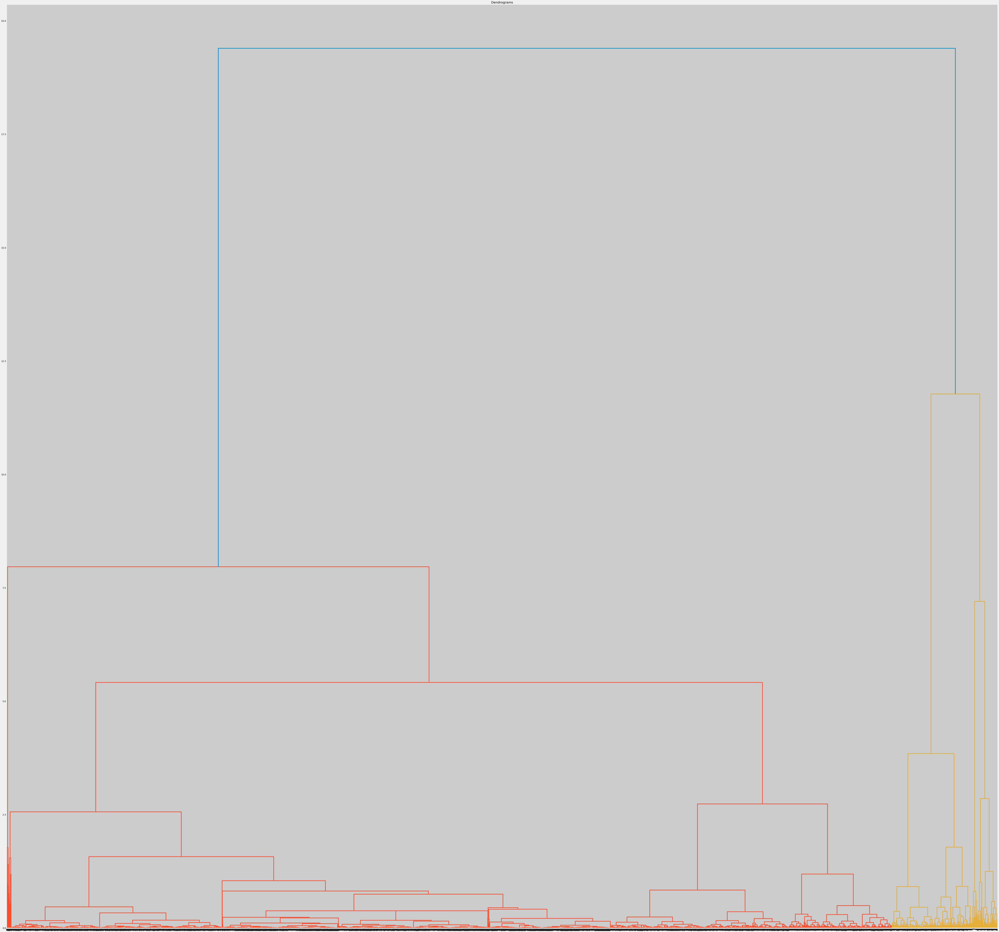

In [199]:
plt.figure(figsize=(100, 100))  
plt.title("Dendrograms")  
dendrogram = sch.dendrogram(sch.linkage(data_scaled, method='ward'))

In [200]:
from sklearn.cluster import AgglomerativeClustering
cluster = AgglomerativeClustering(n_clusters=20, affinity='euclidean', linkage='ward')  
cluster2_array = cluster.fit_predict(data_scaled)

In [204]:
som_shape = (5, 5)
from minisom import MiniSom    
som = MiniSom(som_shape[0], som_shape[1],25, sigma=1.5, learning_rate=.5, activation_distance='euclidean',
            neighborhood_function='gaussian', random_seed=10)
som.pca_weights_init(data_scaled)
som.train_batch(data_scaled, 2000, verbose=True)

 [ 1184 / 2000 ]  59% - 0:00:00 left 

 [ 2000 / 2000 ] 100% - 0:00:00 left 
 quantization error: 0.030080038367890305


In [205]:
# each neuron represents a cluster
winner_coordinates = np.array([som.winner(x) for x in data_scaled]).T
# with np.ravel_multi_index we convert the bidimensional
# coordinates to a monodimensional index
cluster_index = np.ravel_multi_index(winner_coordinates, som_shape)

In [206]:
###get the cluster
def create_cluster_list(cluster_index):
    temp_1 = []
    for i in np.unique(cluster_index):
        temp_2 = []
        for n in range(0,len(cluster_index)):
            if cluster_index[n] == i:
                temp_2.append(n)
        temp_1.append(temp_2)
    return temp_1

In [207]:
clusters = create_cluster_list(cluster_index)

In [208]:
def process_rating_data(data):
    #data = data[data['KeyDate']<=end_date]
    rating = data.groupby('SecurityID',as_index=False).mean()
    rating['RatingSP'] = rating['RatingSP'].apply(lambda x:assign_rating(x))
    return rating

In [209]:
security_data = pd.read_csv("C:/Users/y437l/OneDrive/MMAI/Capstone/Data/SecurityData - Copy-LAPTOP-OAEJRPE8.csv")
rating_data = process_rating_data(pd.read_csv("C:/Users/y437l/OneDrive/MMAI/Capstone/Data/Rating.csv"))

In [210]:
clusters_list = grab_clusters(clusters,bond_spread_list,security_data,rating_data)

In [211]:
clusters_data_list = transfer_to_list_of_pd(clusters_list)

In [212]:
clusters_data_list[0]

,SecurityID,Sector,Industry,Sub_Industry,Seniority,Issuedby,Country,Rating,AmountIssued,Coupon,IssueDate,MaturityDate
0,2875,Energy,Pipeline,Pipelines,Sr Unsecured,ANR PIPELINE CO,US,BBB+,1.250000e+08,7.375,1994,2024-02-15 0:00
1,3543,Industrials,Electrical Equipment Manufacturing,Diversified Manufact Op,Sr Unsecured,GENERAL ELECTRIC CO,US,BBB+,6.350000e+09,5.875,2008,2038-01-14 0:00
2,3647,Energy,Utilities,Electric-Integrated,Sr Unsecured,TALEN ENERGY SUPPLY LLC,US,B,3.000000e+08,6.000,2006,2036-12-15 0:00
3,3869,Communications,Cable & Satellite,Cable/Satellite TV,Sr Unsecured,CABLEVISION SYSTEMS CORP,US,B,5.000000e+08,8.000,2010,2020-04-15 0:00
4,3918,Health Care,Medical Equipment & Devices Manufacturing,Diagnostic Equipment,Sr Unsecured,LIFE TECHNOLOGIES CORP,US,BBB+,7.500000e+08,6.000,2010,2020-03-01 0:00
...,...,...,...,...,...,...,...,...,...,...,...,...
190,52389,Financials,Utilities,Electric-Distribution,Secured,NATIONAL RURAL UTILITIES COOPERATIVE FINANCE CORP,US,A,5.977110e+08,4.023,2013,2032-11-01 0:00
191,52896,Energy,Utilities,Electric-Transmission,1st Lien Secured,ONCOR ELECTRIC DELIVERY CO LLC,US,A+,3.999450e+08,4.100,2012,2022-06-01 0:00
192,53290,Financials,Life Insurance,Life/Health Insurance,Sr Unsecured,UNUM GROUP,US,BBB,2.000000e+08,7.250,1998,2028-03-15 0:00
193,53330,Energy,Utilities,Electric-Integrated,Secured,PUBLIC SERVICE CO OF COLORADO,US,A,3.500000e+08,4.100,2018,2048-06-15 0:00


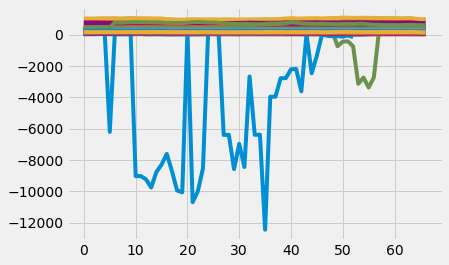

In [213]:
import matplotlib.pyplot as plt
for c in clusters_data_list[0]['SecurityID']:
    plt.plot(new_data[new_data['SecurityID']==c].GSpread.values)
plt.show()

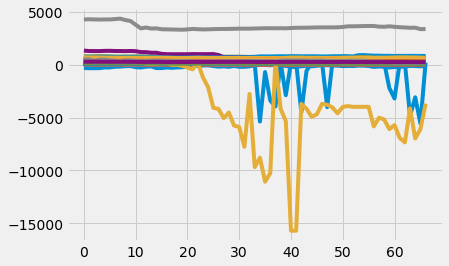

In [214]:
import matplotlib.pyplot as plt
for c in clusters_data_list[1]['SecurityID']:
    plt.plot(new_data[new_data['SecurityID']==c].GSpread.values)
plt.show()

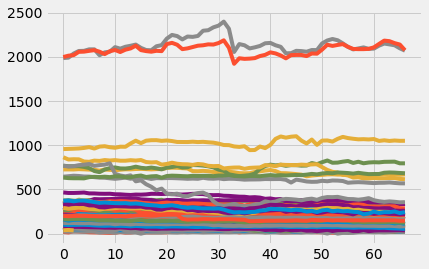

In [215]:
import matplotlib.pyplot as plt
for c in clusters_data_list[2]['SecurityID']:
    plt.plot(new_data[new_data['SecurityID']==c].GSpread.values)
plt.show()

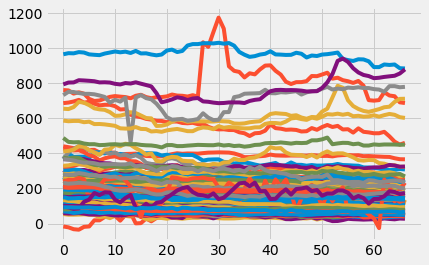

In [216]:
import matplotlib.pyplot as plt
for c in clusters_data_list[3]['SecurityID']:
    plt.plot(new_data[new_data['SecurityID']==c].GSpread.values)
plt.show()

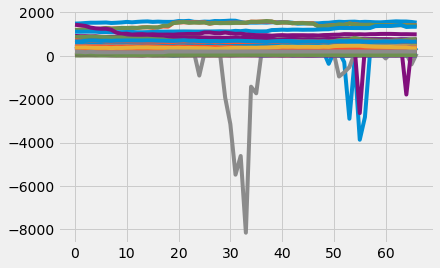

In [217]:
import matplotlib.pyplot as plt
for c in clusters_data_list[5]['SecurityID']:
    plt.plot(new_data[new_data['SecurityID']==c].GSpread.values)
plt.show()

In [220]:
clusters_data_list

[     SecurityID          Sector                                   Industry  \
 0          2875          Energy                                   Pipeline   
 1          3543     Industrials         Electrical Equipment Manufacturing   
 2          3647          Energy                                  Utilities   
 3          3869  Communications                          Cable & Satellite   
 4          3918     Health Care  Medical Equipment & Devices Manufacturing   
 ..          ...             ...                                        ...   
 190       52389      Financials                                  Utilities   
 191       52896          Energy                                  Utilities   
 192       53290      Financials                             Life Insurance   
 193       53330          Energy                                  Utilities   
 194       53391          Energy                                  Utilities   
 
                 Sub_Industry         Seniority  \

In [219]:
from pandas_profiling import ProfileReport
prof = ProfileReport(clusters_data_list[0])
prof

In [ ]:
from pandas_profiling import ProfileReport
prof1 = ProfileReport(clusters_data_list[1])
prof1

In [ ]:
clusters2 = create_cluster_list(cluster2_array)
clusters_list2 = grab_clusters(clusters2,bond_spread_list,security_data,rating_data)

In [ ]:
clusters_data_list2 = transfer_to_list_of_pd(clusters_list2)

In [ ]:
clusters_data_list2[0]

In [ ]:
import matplotlib.pyplot as plt
for c in clusters_data_list2[1]['SecurityID']:
    plt.plot(new_data[new_data['SecurityID']==c].GSpread.values)
plt.show()

In [ ]:
from pandas_profiling import ProfileReport
prof = ProfileReport(clusters_data_list2[1])
prof

In [ ]:
from pyclustering.cluster.somsc import somsc
# load list of points for cluster analysis
sample = data_scaled
# create instance of SOM-SC algorithm to allocated two clusters
somsc_instance = somsc(sample, 9);
# run cluster analysis and obtain results
somsc_instance.process();
somsc_instance.get_clusters();

In [ ]:
clusters_list3 = grab_clusters(somsc_instance.get_clusters(),bond_spread_list,security_data,rating_data)

In [ ]:
clusters_data_list3 = transfer_to_list_of_pd(clusters_list3)

In [ ]:
clusters_data_list3[0]

In [ ]:
from pandas_profiling import ProfileReport
prof1 = ProfileReport(clusters_data_list3[5])
prof1